## Germany & Neighbors Wind Cut Scenario with 130 €/t CO2 price. Transmission Expansion of 50% is allowed

In [1]:
import pypsa 
import matplotlib.pyplot as plt
plt.style.use("bmh")
import pandas as pd
from pypsa.plot import add_legend_patches
import gurobipy
import cartopy.crs as ccrs
from pypsa.optimization import optimize
import matplotlib.cm as cm
import numpy as np
import xarray as xr
import os

pd.set_option("display.max_rows", None)  # Display all rows
pd.set_option("display.max_columns", None)  # Display all columns


# Base Scenario

## Import Network

In [2]:
n = pypsa.Network("C:\\Users\\Jeremy\\Documents\\MasterThesis\\Models\\Model_DE\\20240405_20nodes\\elec_s_20_ec_lv1.5_3h.nc")

INFO:pypsa.io:Imported network elec_s_20_ec_lv1.5_3h.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


In [3]:
# add co2price
co2_price = 130 #€/t

for index in n.generators.index:
    emission = n.carriers.co2_emissions.filter(like= n.generators.carrier[index]) #t/MWh_th
    n.generators.at[index,'marginal_cost'] = n.generators.at[index,'marginal_cost'] + (emission * co2_price/n.generators.at[index,'efficiency']) # €/MWhel

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9840\3184507867.py:6: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  n.generators.at[index,'marginal_cost'] = n.generators.at[index,'marginal_cost'] + (emission * co2_price/n.generators.at[index,'efficiency']) # €/MWhel


In [4]:
for c in n.iterate_components(list(n.components.keys())[2:]):
    print("Component '{}' has {} entries".format(c.name,len(c.df)))

Component 'Bus' has 20 entries
Component 'Carrier' has 21 entries
Component 'GlobalConstraint' has 1 entries
Component 'Line' has 27 entries
Component 'LineType' has 34 entries
Component 'TransformerType' has 14 entries
Component 'Link' has 28 entries
Component 'Load' has 20 entries
Component 'Generator' has 261 entries
Component 'StorageUnit' has 65 entries


In [5]:
#remove nuclear fleet from germany
n.generators.loc[n.generators.index.str.startswith('DE') & n.generators.index.str.endswith('nuclear'), 'p_nom'] = 0


In [6]:
# set marginal cost of load shedding to 3000€/MWh
for bus in n.generators.bus:
    for index in n.generators.index:
        if not bus.endswith('H2') and index.endswith('load'):
            n.generators.loc[index, 'marginal_cost'] = 3000

#edit load shedding's unit from kW to MW
for index in n.generators.index:
    if index.endswith('load') and not index.endswith('H2 load'):
        n.generators.loc[index, 'sign'] = 1

#### Import solved model, if no changes to the model have been made

In [7]:
def import_nc_file(directory, filename):
    # Construct the full path to the .nc file
    file_path = os.path.join(directory, filename)
    
    # Open the NetCDF file using xarray
    ds = pypsa.Network(file_path)
    
    return ds

directory = os.getcwd()
dir = 'c:\\Users\\Jeremy\\Documents\\MasterThesis\\Models\\Model_DE\\20240405_20nodes\\'


In [8]:
#solve network or import
#n.optimize(solver_name='gurobi')
filename = "base_DE_20nodes_1.5_solved.nc"
n = import_nc_file(dir, filename)
n.name = 'base_wind'

INFO:pypsa.io:Imported network base_DE_20nodes_1.5_solved.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


### Export model for later use

In [9]:
#file = "base_DE_20nodes_1.5_solved.nc"
#output_path = os.path.join(dir, file)

#n.export_to_netcdf(output_path)

In [10]:
def system_cost(n): #n.statistics.capex()
    stat = n.statistics()
    tsc = stat['Capital Expenditure'] + stat['Operational Expenditure']
    return tsc.droplevel(0).div(1e6) # million €/a

In [11]:
tot_cos_base=n.objective/1e9
system_cost_base = system_cost(n)
marg_price_region_base = n.buses_t.marginal_price.mean()
stat_base = n.statistics()

## Plot Network

<function matplotlib.pyplot.show(close=None, block=None)>

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '
c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '
c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


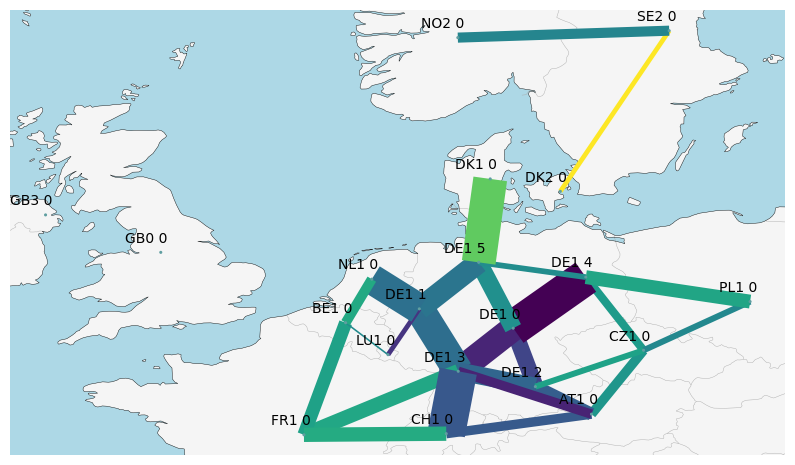

In [12]:
loading = (n.lines_t.p0.abs().mean().sort_index()/(n.lines.s_nom_opt*n.lines.s_max_pu).sort_index()).fillna(0.)

fig, ax = plt.subplots(
    figsize=(10,10),
    subplot_kw={"projection": ccrs.PlateCarree()}
)

n.plot(
    ax=ax,
    branch_components=["Line"],
    line_widths=n.lines.s_nom_opt/1e3, #GW
    line_colors=loading,
    line_cmap=plt.cm.viridis,
    color_geomap=True,
    bus_sizes=0.003
)

bus = n.buses
region = []
for index, row in bus.iterrows():
    x = row['x']
    y = row['y']
    if "H2" in index:
        pass
    else:
        region.append(index)
        ax.annotate(
        index,
        xy=(x, y),
        xytext=(5, 5),  # Adjust the position of the annotation
        textcoords="offset points",
        ha='right', va='bottom'
    )

plt.show

## Installed Capacity Map Plot

In [13]:
#color list for installed cap
tech_list = n.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().unstack().columns.tolist()
tech_list.remove('load')
color_cap = []

for i in range(len(tech_list)):
    for j in range(len(n.carriers.index)):
        if tech_list[i] == n.carriers.index[j]:
            color_cap.append(n.carriers.color[j])
            break  # break the inner loop once a match is found  

cap = n.generators[n.generators['carrier']!='load'].groupby(['bus', 'carrier']).p_nom_opt.sum()

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9840\3847545614.py:9: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  color_cap.append(n.carriers.color[j])


c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


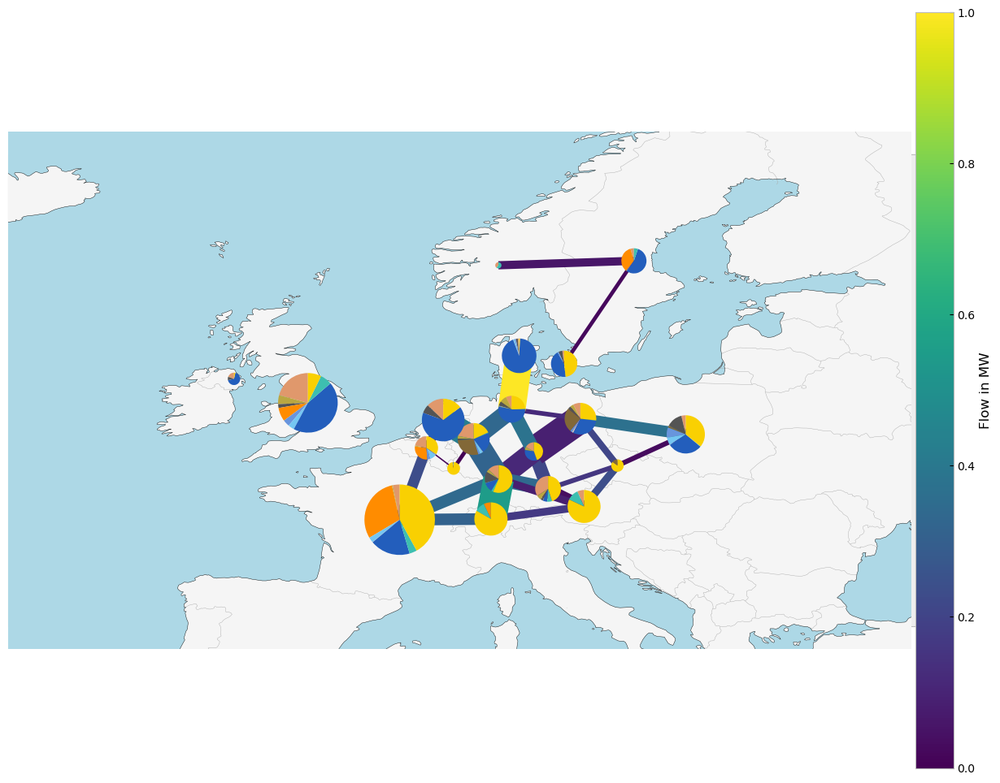

In [14]:
fig, ax = plt.subplots(
    figsize=(15,15),
    subplot_kw={"projection": ccrs.PlateCarree()}
)

collection = n.plot(
    bus_sizes=cap / 5e4,
    bus_colors = color_cap,
    margin=0.5,
    #flow="mean",
    line_widths=n.lines.s_nom_opt/1e3, #GW
    link_widths=0,
    color_geomap=True,
    line_colors=n.lines_t.p0.mean().abs(),
)
        
plt.colorbar(collection[2], fraction=0.04, pad=0.004, label="Flow in MW")
plt.show()

## Generation Map Plot

In [15]:
#color list for energy generated 
tech_list_gen_table = n.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().unstack().columns.tolist()
colors_gen_table = []

for i in range(len(tech_list_gen_table)):
    for j in range(len(n.carriers.index)):
        if tech_list_gen_table[i] == n.carriers.index[j]:
            colors_gen_table.append(n.carriers.color[j])
            break  # break the inner loop once a match is found 

#Adjust Load shedding's unit to MW from kW
#for column in n.generators_t.p.columns:
#    if column.endswith('load') and not column.endswith('H2 load'):
#        n.generators_t.p[column]/=1e3
        

gen = n.generators.assign(g=n.generators_t.p.mean()).groupby(["bus", "carrier"]).g.sum()

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9840\971004373.py:8: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  colors_gen_table.append(n.carriers.color[j])


c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


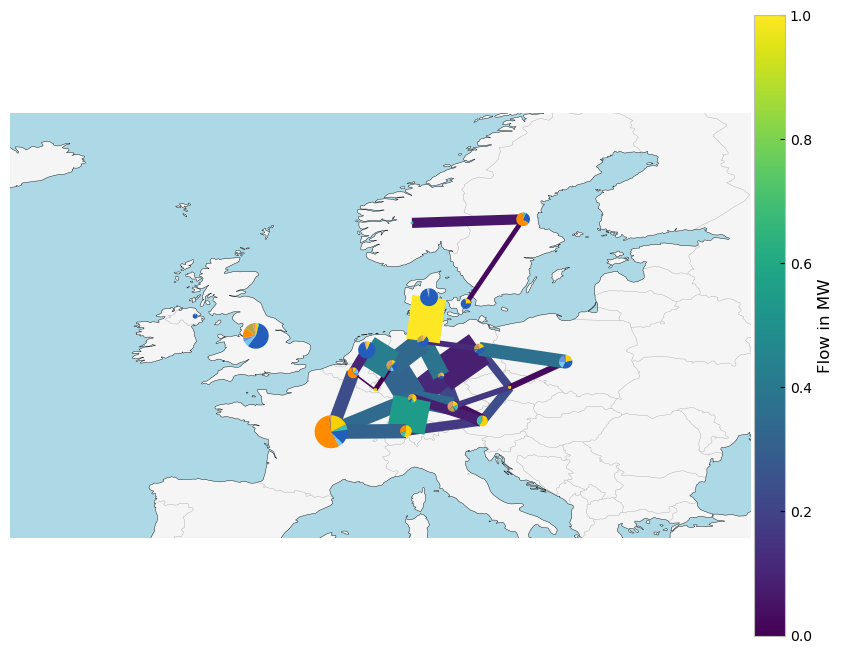

In [16]:
carriers = n.generators.carrier.unique()

plt.figure(figsize =(10,10))

collection = n.plot(
    bus_sizes=gen / 5e4,
    bus_colors = colors_gen_table,
    margin=0.5,
    #flow="mean",
    line_widths=n.lines.s_nom_opt/1e3, #GW
    link_widths=0,
    color_geomap=True,
    line_colors=n.lines_t.p0.mean().abs(),
)
plt.colorbar(collection[2], fraction=0.04, pad=0.004, label="Flow in MW")
plt.show()

## Installed Capacity

<Figure size 640x480 with 0 Axes>

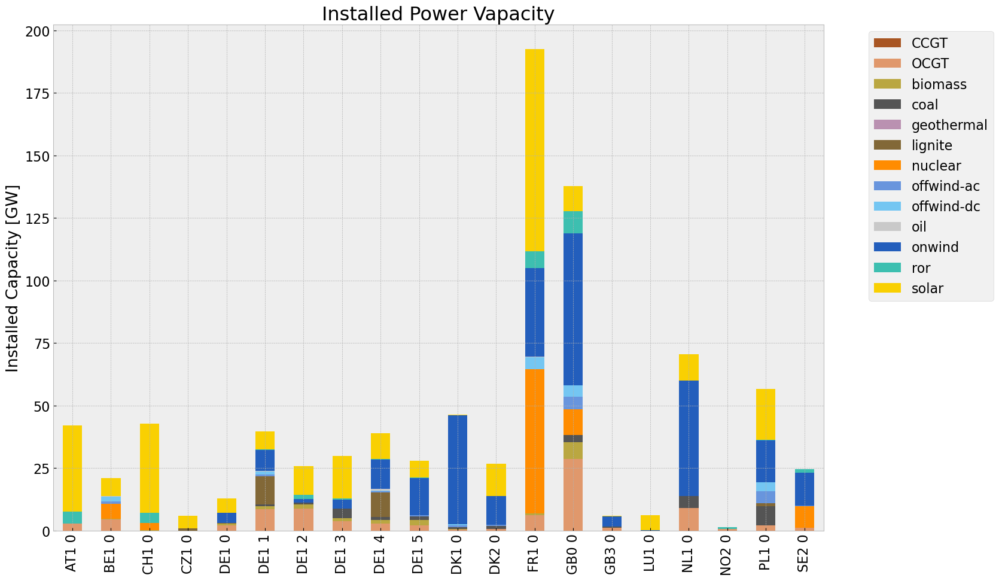

In [17]:
def inst_cap_table(n,colors):

    capacities = n.generators.groupby(['bus', 'carrier']).p_nom_opt.sum()
    capacities.fillna(0, inplace=True)
    gen = (capacities.unstack()/1000).drop(columns=['load'],inplace=False)
    gen.fillna(0, inplace=True)

    plt.figure()
    plt.rcParams.update({'font.size': 16})

    gen.plot.bar(figsize=(17,10),
                                stacked=True,
                                color=colors,
                                grid=True,
                                xlabel="",
                                ylabel="Installed Capacity [GW]",
                                title=f"Installed Power Vapacity"
    )
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.tight_layout()

     # Save plot to the current working directory
    filename = f"{n.name}_installed_cap.png" if hasattr(n, 'name') else "installed_cap.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)
    
    plt.show()

    

    return capacities

# consolidated istalled cap without load_shedding

#capacities_base = n.generators.groupby(['bus', 'carrier']).p_nom_opt.sum()
#capacities_base.fillna(0, inplace=True)
#gen = (capacities_base.unstack()/1000).drop(columns=['load'],inplace=False)

capacities_base = inst_cap_table(n, color_cap)

<Figure size 640x480 with 0 Axes>

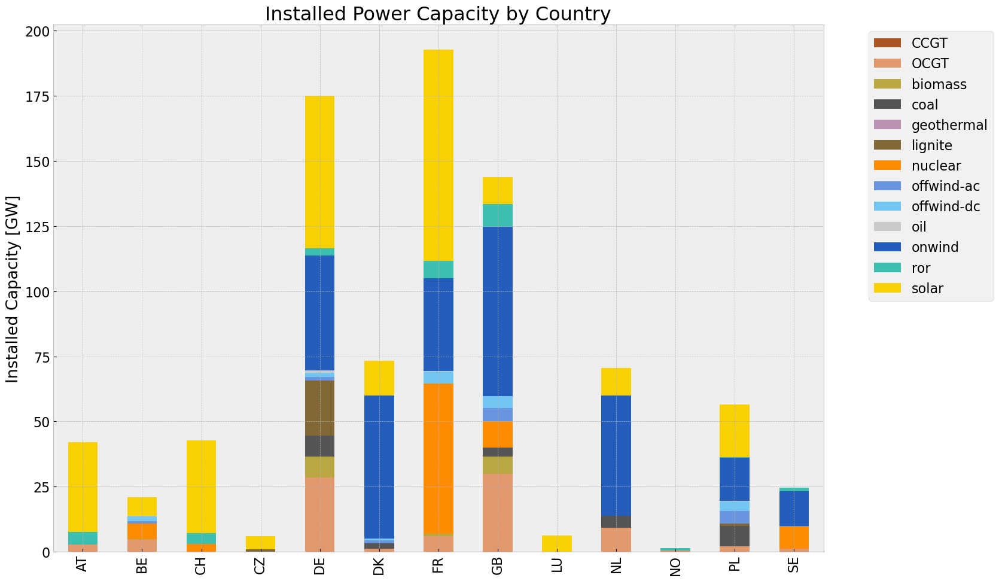

In [18]:
#aggregate installed capacities by country
def inst_cap_table_country(n,colors):
    
    model = n
    capacities = model.generators
    capacities['country'] = capacities['bus'].str[:2]
    capacities = capacities.groupby(['country', 'carrier']).p_nom_opt.sum()
    capacities.fillna(0, inplace=True)
    gen = (capacities.unstack()/1000).drop(columns=['load'],inplace=False)
    gen.fillna(0, inplace=True)

    plt.figure()
    plt.rcParams.update({'font.size': 16})

    gen.plot.bar(figsize=(17,10),
                                stacked=True,
                                color=colors,
                                grid=True,
                                xlabel="",
                                ylabel="Installed Capacity [GW]",
                                title=f"Installed Power Capacity by Country"
    )
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.tight_layout()

    # Save plot to the current working directory
    filename = f"{n.name}_installed_cap_country.png" if hasattr(n, 'name') else "installed_cap.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)

    plt.show()
    
     

    return gen

cap_base_country= inst_cap_table_country(n, color_cap)

## Generation

<Figure size 640x480 with 0 Axes>

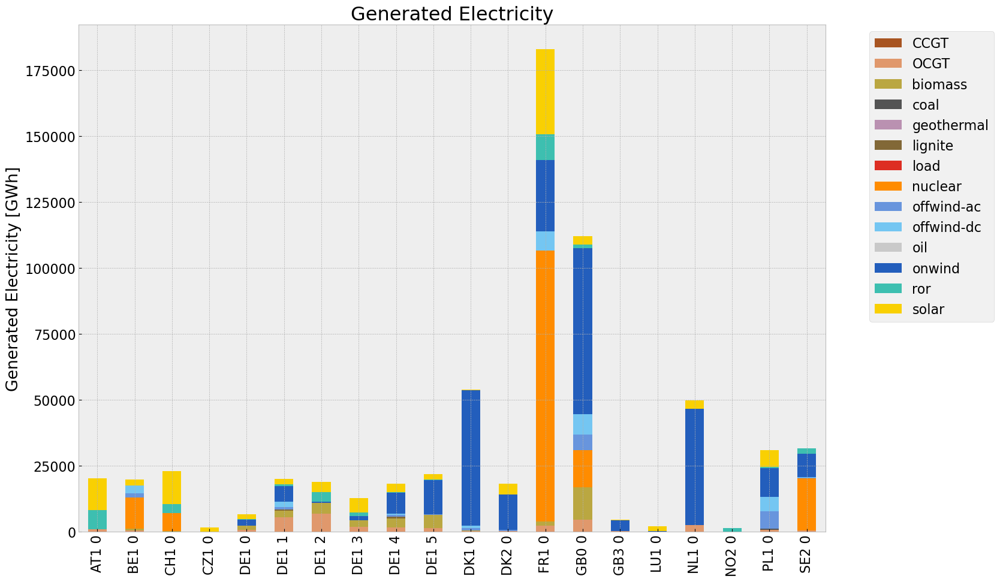

In [19]:
def gen_power_table(n, color):

    carrier = n.generators.carrier.unique()
    df_tot_generation = n.generators_t.p.sum()

    generations = pd.Series(index = n.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().index)

    for r in region:
        for tech in carrier:
            key = f"{r} {tech}"
            if key in df_tot_generation.index:
                try:
                    generations.loc[r, tech] = df_tot_generation[key]
                    #print(generations.loc[r, tech])
                except KeyError:
                    print('error')
    generations.fillna(0, inplace=True)

    generations = (generations.unstack()/1000)#GWh
    #generations['load']/=1e3


    plt.figure()
    plt.rcParams.update({'font.size': 16})

    generations.plot.bar(figsize=(17,10),
                                stacked=True,
                                color=color,
                                grid=True,
                                xlabel="",
                                ylabel="Generated Electricity [GWh]",
                                title=f"Generated Electricity"
    )
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.tight_layout()

     # Save plot to the current working directory
    filename = f"{n.name}_gen_elec.png" if hasattr(n, 'name') else "installed_cap.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)

    plt.show()

    

    return generations

gen_base = gen_power_table(n,colors_gen_table)

<Figure size 640x480 with 0 Axes>

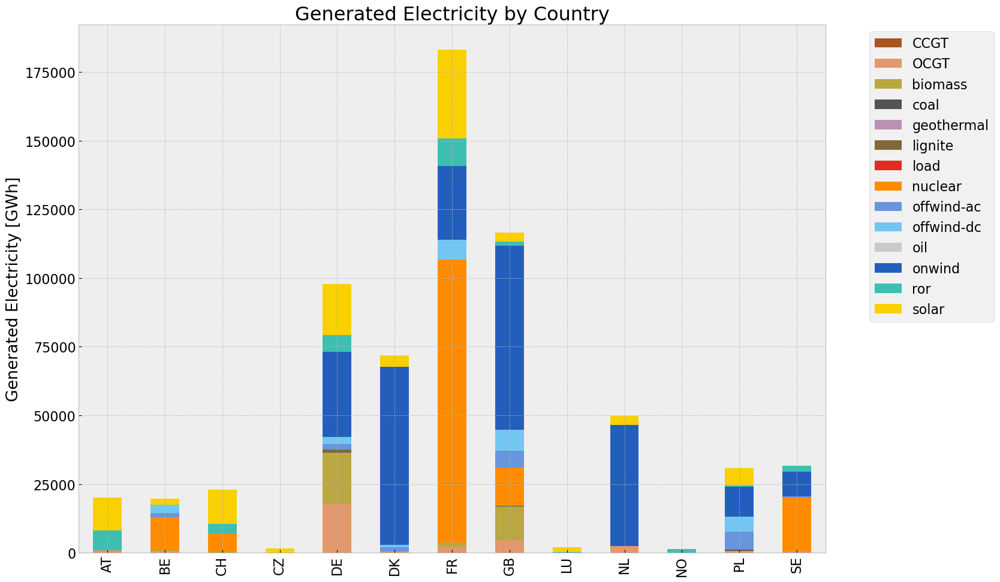

In [20]:
def gen_power_table_country(n, color):

    carrier = n.generators.carrier.unique()
    df_tot_generation = n.generators_t.p.sum()

    generations = pd.Series(index = n.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().index)

    #generations = n.generators
    #generations['country'] = generations['bus'].str[:2]
    #generations = pd.Series(index = n.generators.groupby(['country', 'carrier']).p_nom_opt.sum().index)

    for r in region:
        for tech in carrier:
            key = f"{r} {tech}"
            if key in df_tot_generation.index:
                try:
                    generations.loc[r, tech] = df_tot_generation[key]
                    #print(generations.loc[r, tech])
                except KeyError:
                    print('error')
    generations.fillna(0, inplace=True)

    generations = (generations.unstack()/1000)#GWh
    generations['country'] = generations.index.str[:2]
    generations = generations.groupby(['country']).sum()   
    #generations['load']/=1e3


    plt.figure()
    plt.rcParams.update({'font.size': 16})

    generations.plot.bar(figsize=(17,10),
                                stacked=True,
                                color=color,
                                grid=True,
                                xlabel="",
                                ylabel="Generated Electricity [GWh]",
                                title=f"Generated Electricity by Country"
    )
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.tight_layout()

    # Save plot to the current working directory
    filename = f"{n.name}_gen_elec_country.png" if hasattr(n, 'name') else "installed_cap.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)


    plt.show()
    return generations

gen_base_country = gen_power_table_country(n,colors_gen_table)

## Snapshot

In [21]:
sto = n.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)
tech_list_gen = n.generators_t.p.groupby(n.generators.carrier, axis=1).sum()

#links = n.links_t.p0.groupby(n.links.carrier, axis =1).sum().drop(['DC','H2 electrolysis'], axis=1, inplace =False).head()
tech_list_gen = pd.concat([tech_list_gen, sto], axis=1).columns.tolist()

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9840\318663498.py:1: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = n.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9840\318663498.py:2: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  tech_list_gen = n.generators_t.p.groupby(n.generators.carrier, axis=1).sum()


In [22]:
colors_gen = []

for i in range(len(tech_list_gen)):
    for j in range(len(n.carriers.index)):
        if tech_list_gen[i] == n.carriers.index[j]:
            colors_gen.append(n.carriers.color[j])
            break  # break the inner loop once a match is found  

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9840\4040974225.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  colors_gen.append(n.carriers.color[j])


In [23]:
def gen_curve(n, start, end, colors,ctr):

    plt.rcParams.update({'font.size': 16})

    #import export 
    lines_ctr_bus0 = n.lines[n.lines['bus0'].str.startswith(ctr) & ~n.lines['bus1'].str.startswith(ctr)].index
    lines_ctr_bus1 = n.lines[n.lines['bus1'].str.startswith(ctr) & ~n.lines['bus0'].str.startswith(ctr)].index
    links_ctr_bus0 = n.links[n.links['bus0'].str.startswith(ctr) & ~n.links['bus1'].str.startswith(ctr)].index
    links_ctr_bus1 = n.links[n.links['bus1'].str.startswith(ctr) & ~n.links['bus0'].str.startswith(ctr)].index


    df_lines_ctr_bus0 = n.lines_t.p0[lines_ctr_bus0]
    df_lines_ctr_bus1 = n.lines_t.p1[lines_ctr_bus1]
    df_links_ctr_bus0 = n.links_t.p0[links_ctr_bus0]
    df_links_ctr_bus1 = n.links_t.p1[links_ctr_bus1]


    import_export = pd.concat([df_lines_ctr_bus0, df_lines_ctr_bus1, df_links_ctr_bus0, df_links_ctr_bus1], axis=1).sum(axis=1)*-1 #MW

    columns_gen = [col for col in  n.generators_t.p.columns if col.startswith(ctr)]
    p_country = n.generators_t.p[columns_gen]

    p_by_carrier = p_country.groupby(n.generators.carrier, axis=1).sum() #MW
    

    #add import color
    colors.append('#133337') #for Import

    #p_by_carrier['load'] /= 1e3

    #links fuel cell
    #links = n.links_t.p1.groupby(n.links.carrier, axis=1).sum().div(1e3)
    #links = links.drop(columns='DC', inplace=False)
    #links['H2 fuel cell']*=-1
       
    # join generator, lines, links, and storage unit
    if not n.storage_units.empty:
        col_sto = [col for col in  n.storage_units_t.p.columns if col.startswith(ctr)]
        sto_ctr = n.storage_units_t.p[col_sto]
        sto = sto_ctr.groupby(n.storage_units.carrier, axis=1).sum() #MW     
        p_by_carrier = pd.concat([p_by_carrier, sto], axis=1)
        p_by_carrier['Import/Export'] = import_export 
        p_by_carrier = p_by_carrier.div(1e3) #GW
        
    p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='3H')

    start_date = start
    end_date = end
    
    # Create a date range for the specified time range
    time = pd.date_range(start=start_date, end=end_date, freq='3H')
    
    fig, ax = plt.subplots(figsize=(20, 10))
    
    #p_no_H = p_by_carrier.drop(columns = 'H2 electrolysis', inplace = False)
    p_by_carrier.where(p_by_carrier>0).loc[time].plot.area(
        ax=ax,
        linewidth=0,
        color=colors,
        grid=True,

    )
    
    charge = p_by_carrier.where(p_by_carrier<0).dropna(how='all', axis=1).loc[time]
    
    
    if not charge.empty:

        charge.plot.area(
            ax=ax,
            linewidth=0,
            color=["yellowgreen", "magenta", "purple", "grey"],
            grid=True,
        )
    
    col_load = [col for col in  n.loads_t.p_set.columns if col.startswith(ctr)]
    loads_ctr = n.loads_t.p_set[col_load]
    loads = loads_ctr.sum(axis=1).div(1e3)
    loads.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='3H')
    
    loads.loc[time].plot(ax=ax, c='k',grid=True)


    plt.legend(loc=(1.05,0))
    
    ax.set_ylabel("Power [GW]")
    ax.set_title(f"Hourly Electricity Production")
    ax.set_ylim(-50,150)
    # Save plot to the current working directory
    fig.tight_layout()
    filename = f"{n.name}_gen_{start}_to_{end}.png" if hasattr(n, 'name') else "installed_cap.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)


    
    

In [24]:
#e_balance = n.statistics.energy_balance(aggregate_time=False, aggregate_bus=False).loc[:, :, "AC",:].droplevel(2)
#e_balance.to_excel('energybalance.xlsx', index=True) 


In [25]:
#tes = n.statistics.energy_balance(aggregate_time=False, aggregate_bus=False).loc[:, :, "AC", :].droplevel(2)
#tes.to_csv('energybalance.csv', index=True)

In [26]:
#n.loads_t.p_set.sum(axis=1).loc[pd.date_range(start='2013-01-08', end='2013-01-14', freq='3H')].div(1e3).plot(ax=ax, c='k',grid=True)


In [27]:
#p_by_carrier.where(p_by_carrier>0).loc[pd.date_range(start='2013-01-08', end='2013-01-14', freq='3H')].sum(axis=1)

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9840\3440809909.py:23: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = p_country.groupby(n.generators.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9840\3440809909.py:40: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = sto_ctr.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9840\3440809909.py:45: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='3H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9840\3440809909.py:51: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, freq='3H')
c:\Users\Jere

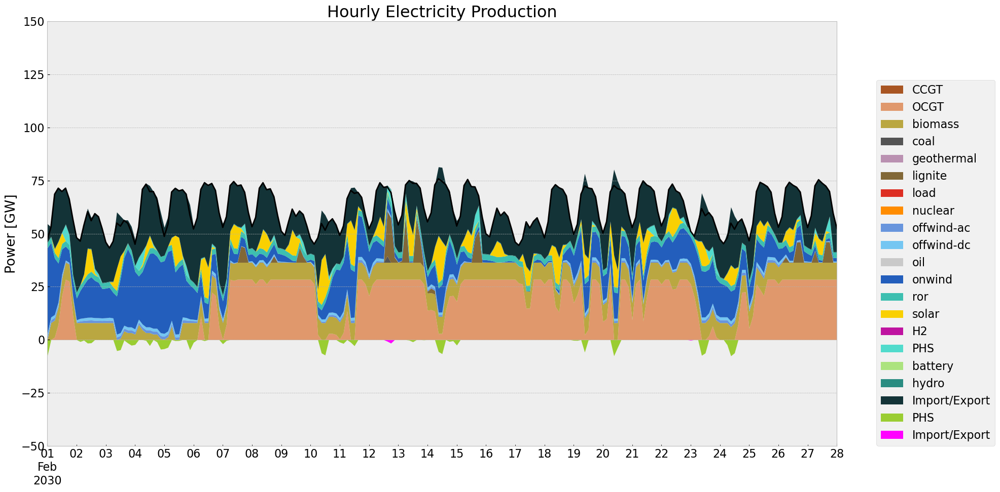

In [28]:
# winter
gen_curve(n, '2030-02-01', '2030-02-28', colors_gen,'DE')

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9840\3440809909.py:23: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = p_country.groupby(n.generators.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9840\3440809909.py:40: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = sto_ctr.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9840\3440809909.py:45: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='3H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9840\3440809909.py:51: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, freq='3H')
c:\Users\Jere

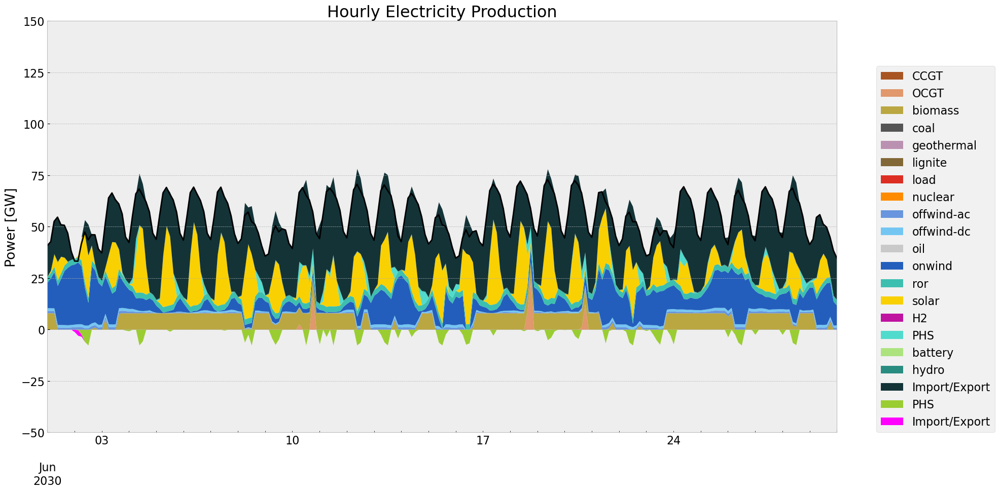

In [29]:
#summer
gen_curve(n, '2030-06-01', '2030-06-30', colors_gen,'DE')

In [30]:
def gen_curve_tot(n, start, end, colors):

    plt.rcParams.update({'font.size': 16})

    p_by_carrier = n.generators_t.p.groupby(n.generators.carrier, axis=1).sum() # MW
    
    # join generator, lines, links, and storage unit
    if not n.storage_units.empty:
        sto = n.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum() #MW     
        p_by_carrier = pd.concat([p_by_carrier, sto], axis=1)
        p_by_carrier = p_by_carrier.div(1e3) #GW
        
    p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='3H')

    start_date = start
    end_date = end
    
    # Create a date range for the specified time range
    time = pd.date_range(start=start_date, end=end_date, freq='3H')
    
    fig, ax = plt.subplots(figsize=(20, 10))
    
    #p_no_H = p_by_carrier.drop(columns = 'H2 electrolysis', inplace = False)
    p_by_carrier.where(p_by_carrier>0).loc[time].plot.area(
        ax=ax,
        linewidth=0,
        color=colors,
        grid=True,

    )
    
    charge = p_by_carrier.where(p_by_carrier<0).dropna(how='all', axis=1).loc[time]
    
    
    if not charge.empty:

        charge.plot.area(
            ax=ax,
            linewidth=0,
            color=["yellowgreen", "magenta", "purple", "grey"],
            grid=True,
        )
    
    loads = n.loads_t.p_set.sum(axis=1).div(1e3)
    loads.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='3H')
    
    loads.loc[time].plot(ax=ax, c='k',grid=True)


    plt.legend(loc=(1.05,0))
    ax.set_ylim(-50,370)
    fig.tight_layout()

    # Adjust the spacing around the plot (add extra space at the top)
    fig.subplots_adjust(top=0.95, right=0.85, left = 0.05)
    
    ax.set_ylabel("Power [GW]")
    ax.set_title(f"Hourly Electricity Production")

    filename = f"{n.name}_gen_{start}_to_{end}_total.png" if hasattr(n, 'name') else "installed_cap.png"
    output_path = os.path.join(os.getcwd(), filename)
    
    plt.savefig(output_path)

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9840\2535220694.py:5: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = n.generators_t.p.groupby(n.generators.carrier, axis=1).sum() # MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9840\2535220694.py:9: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = n.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9840\2535220694.py:13: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='3H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9840\2535220694.py:19: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, freq='

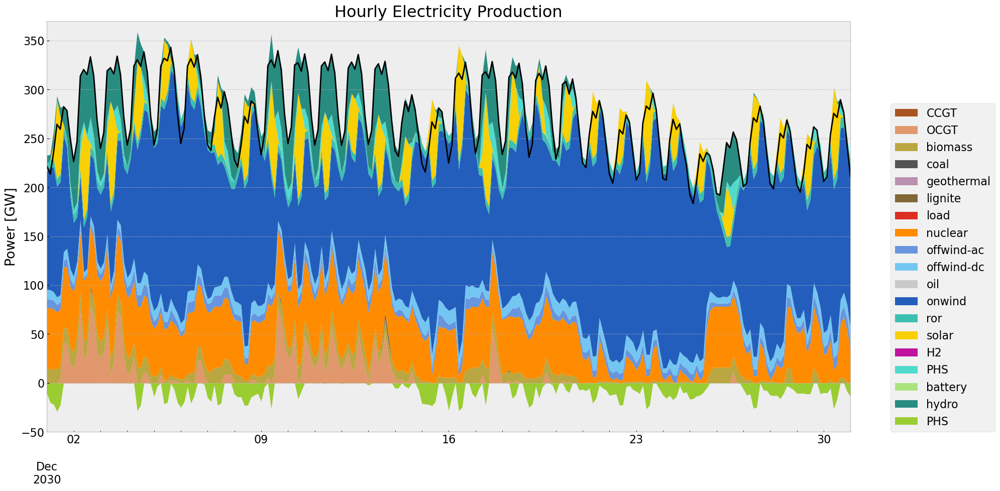

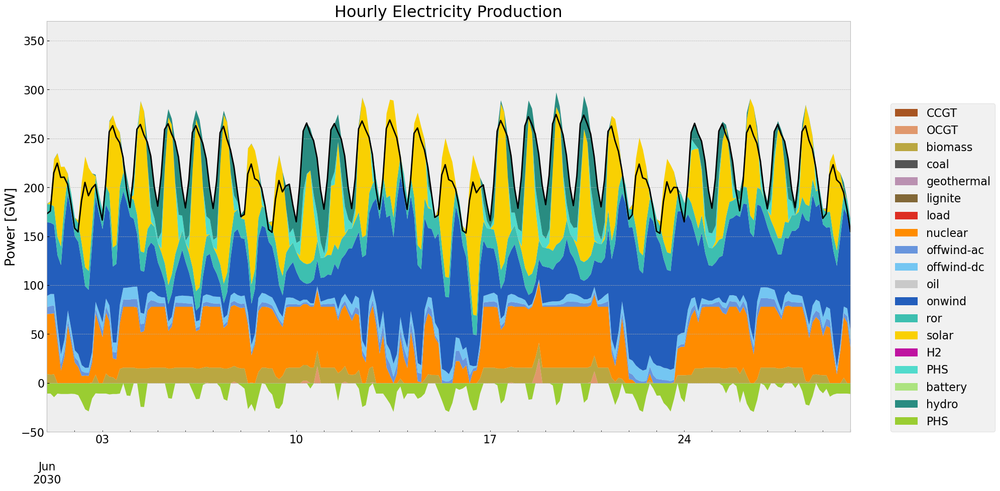

In [31]:
#generation curve all countries
#winter
gen_curve_tot(n, '2030-12-01', '2030-12-31', colors_gen)
#summer
gen_curve_tot(n, '2030-06-01', '2030-06-30', colors_gen)

## Storage

In [32]:
def inst_store_table(n):
    
    plt.rcParams.update({'font.size': 16})
    storage = n.storage_units
    storage['country'] = storage['bus'].str[:2]

    (storage.groupby(['country','carrier']).p_nom_opt.sum().unstack()/1000).plot.bar(figsize=(17,10),
                                stacked=True,
                                color=["#bf13a0","#51dbcc","#ace37f","#298c81"],
                                grid=True,
                                xlabel="",
                                ylabel="Installed capacity [GW]",
                                title=f"Installed Power Capacity of Storage Systems By Country",
                                #ylim=[0,20]
    )
    store = storage.groupby(['country','carrier']).p_nom_opt.sum()/1000 #GW
    store.fillna(0, inplace=True)

    plt.tight_layout()

    filename = f"{n.name}_installed_storage.png" if hasattr(n, 'name') else "installed_storage.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)
    
    return store

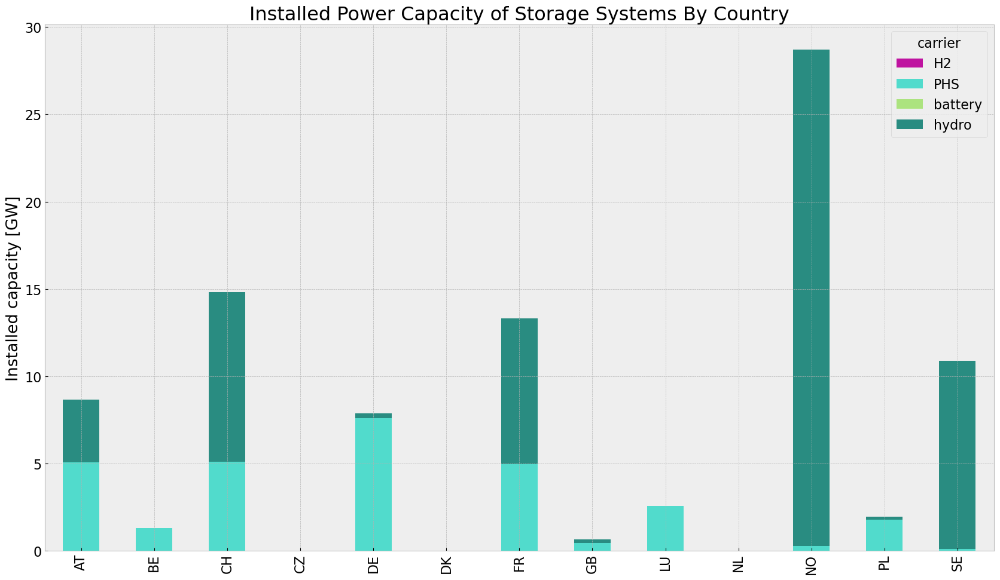

In [33]:
store_base = inst_store_table(n)

In [34]:
def state_of_charge_plot(n):
    
    soc = n.storage_units_t.state_of_charge.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)

    soc.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='3H')

    plt.rcParams.update({'font.size': 16})

    fig, ax = plt.subplots(figsize=(17,10))

    soc.plot(ax=ax,
        grid=True,
        ylabel="State of charge [GWh]",
        xlabel="Time",
        title=f"State of charge of Storage Systems",
        linewidth=1.5,
    )
    plt.tight_layout()
    filename = f"{n.name}_soc.png" if hasattr(n, 'name') else "soc.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)



plt.show(n)

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9840\3576090030.py:3: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  soc = n.storage_units_t.state_of_charge.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9840\3576090030.py:5: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  soc.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='3H')


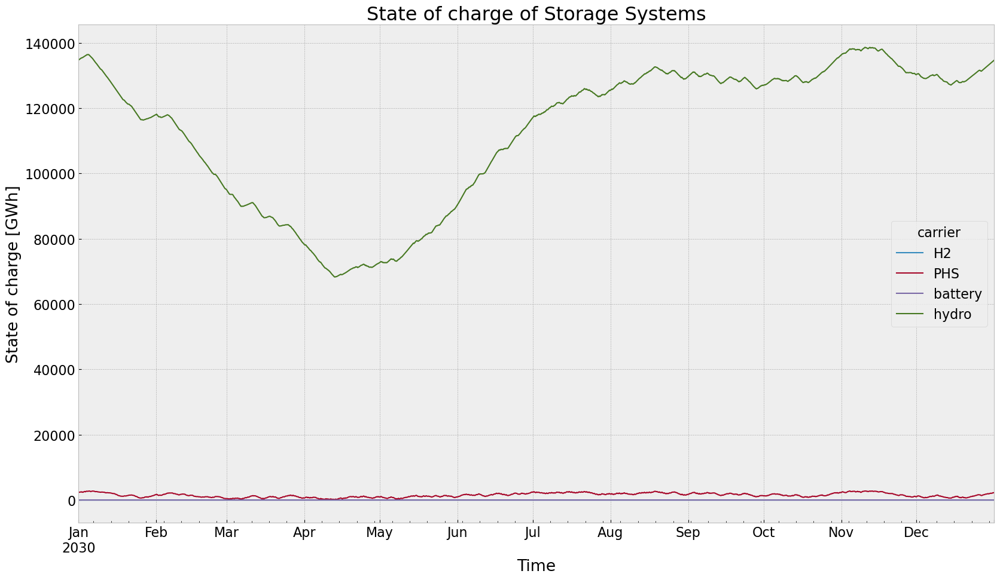

In [35]:
state_of_charge_plot(n)

## Electricity Price

In [36]:
def price_dur_curve_plot(n):

    #buses without store
    columns_to_keep =[]

    for i in n.buses_t.marginal_price.columns.tolist():
        if not i.endswith('H2'):
            columns_to_keep.append(i)
    
    price_dur_curve = pd.DataFrame()
    for region in columns_to_keep:
        price_dur_curve[region] = n.buses_t.marginal_price[region].sort_values(ascending=False).reset_index(drop=True)

    plt.rcParams.update({'font.size': 16})

    fig, ax = plt.subplots(figsize=(17,10))

    price_dur_curve.plot(ax=ax,
                    grid=True,
                    ylabel="Marginal price [€/MWh]",
                    xlabel="Time steps",
                    title=f"Duration curves of the marginal price",
                    linewidth=3,
)
    plt.tight_layout()
    filename = f"{n.name}_pd_curve.png" if hasattr(n, 'name') else "pd_curve.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)
plt.show()

In [37]:
#columns_to_keep =[]

#for i in n.buses_t.marginal_price.columns.tolist():
    #if not i.endswith('H2'):
        #columns_to_keep.append(i)

#buses without store
#columns_to_keep =[]

#price_dur_curve = pd.DataFrame()
#for region in columns_to_keep:
    #price_dur_curve[region] = n.buses_t.marginal_price[region].sort_values(ascending=False).reset_index(drop=True)


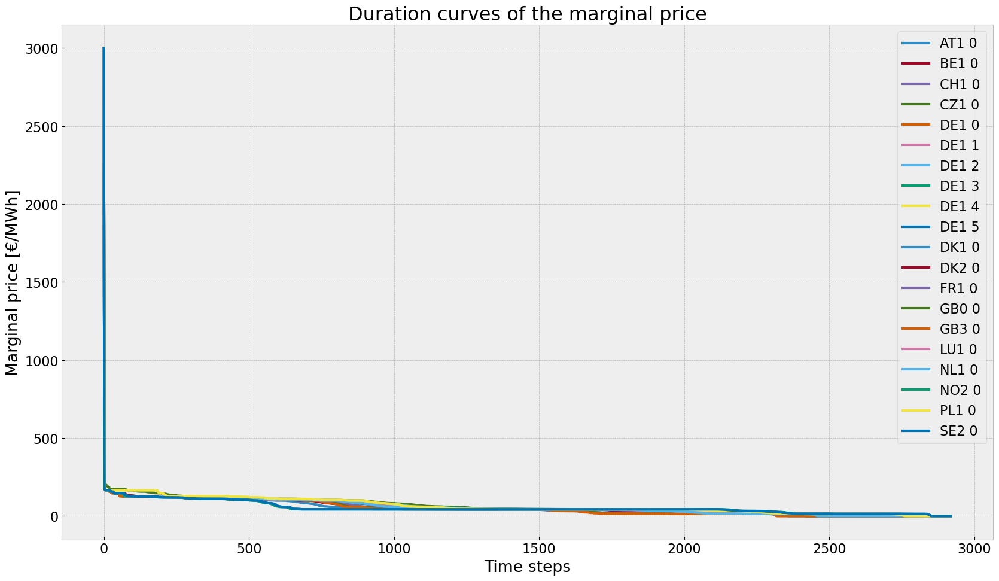

In [38]:
price_dur_curve_plot(n)

In [39]:
#demand weighted average electricity price
def price_regions_table(n):

    plt.rcParams.update({'font.size': 16})

    fig, ax = plt.subplots(figsize=(17,10))
    
    price_df = pd.Series(dtype='float64')

    for price_index in n.buses_t.marginal_price.columns:
        for load_index in  n.loads_t.p_set.columns:
            if price_index == load_index:
                sumweight = (n.buses_t.marginal_price[price_index]*n.loads_t.p_set[load_index]).sum()
                weight = n.loads_t.p_set[load_index].sum()
                weighted_eprice = sumweight/weight
                price_df[price_index] = weighted_eprice

    
    price_df.plot.bar(ax=ax,
                    grid=True,
                    ylabel="Marginal price [€/MWh]",
                    xlabel="Region",
                    title=f"Demand-Weighted Average Marginal Price",
                    linewidth=3,
    )
    fig.tight_layout()                
    filename = f"{n.name}_average_eprice.png" if hasattr(n, 'name') else "pd_curve.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)                                    
    


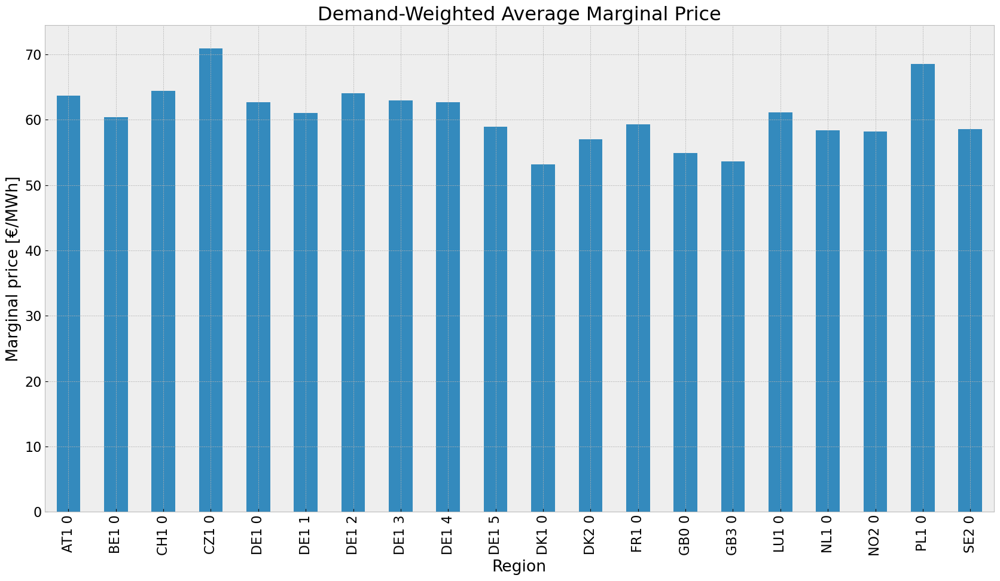

In [40]:
price_regions_table(n)

In [41]:
def price_regions(n):
    # Assuming 'n.buses_t.marginal_price' returns a DataFrame or similar structure with 'mean()' method

    price_df = pd.Series(dtype='float64')

    for price_index in n.buses_t.marginal_price.columns:
        for load_index in  n.loads_t.p_set.columns:
            if price_index == load_index:
                sumweight = (n.buses_t.marginal_price[price_index]*n.loads_t.p_set[load_index]).sum()
                weight = n.loads_t.p_set[load_index].sum()
                weighted_eprice = sumweight/weight
                price_df[price_index] = weighted_eprice

    #hprice = mean_p.filter(like='H2')
    #eprice = mean_p.drop(hprice.index)

    # Setup figure and subplots with 1 row and 2 columns
    fig, ax = plt.subplots(subplot_kw={"projection": ccrs.PlateCarree()}, figsize=(8, 8))

    # Plot for eprice
    hb= plt.hexbin(
        n.buses.x,
        n.buses.y,
        gridsize=20,
        C=price_df,
        cmap=plt.cm.jet,
        zorder=3,
    )

    n.plot(ax=ax, line_widths=pd.Series(0.5, n.lines.index), bus_sizes=0)  # Plot network on the second subplot

    ax.set_title("Demand-Weighted Average Marginal Price")
    
    cb = fig.colorbar(hb, ax=ax, location='bottom')
    cb.set_label("Mean Electricity Marginal Price (EUR/MWh)")

    fig.tight_layout()
    filename = f"{n.name}_price_map.png" if hasattr(n, 'name') else "pd_curve.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)
    

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


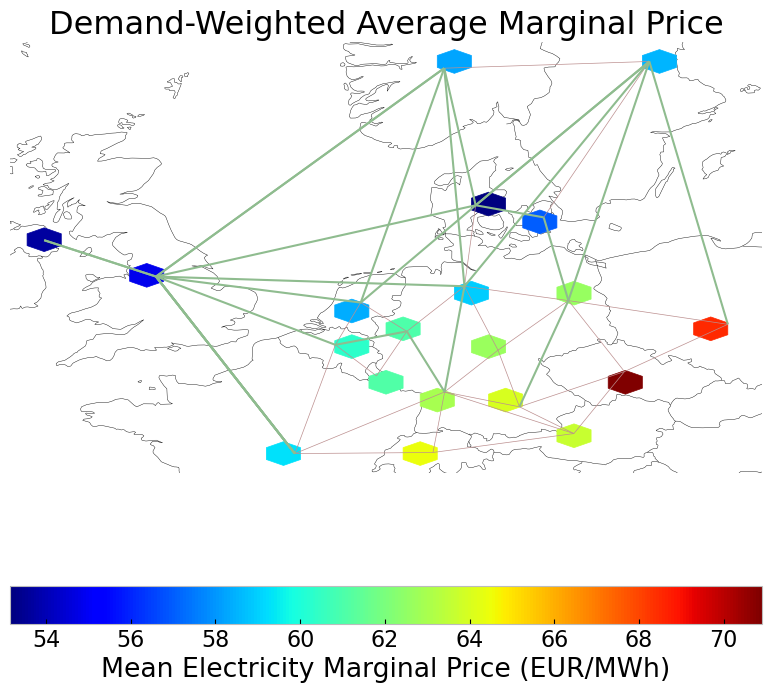

In [42]:
price_regions(n)

## Emission

In [43]:
def em_table(n):
    carrier = n.generators.carrier.unique()
    df_tot_generation = n.generators_t.p.sum()

    generations = pd.Series(index = n.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().index)

    for r in region:
        for tech in carrier:
            key = f"{r} {tech}"
            if key in df_tot_generation.index:
                try:
                    generations.loc[r, tech] = df_tot_generation[key]
                    #print(generations.loc[r, tech])
                except KeyError:
                    print('error')
    generations.fillna(0, inplace=True)

    generations = (generations.unstack())#MWh

    #mean efficiency of each carrier
    eff = n.generators.groupby('carrier').efficiency.mean()

    e = generations.sum()
    emission = []

    for index in e.index:
        for index_c in n.carriers.index:
            for index_eff in eff.index:
                if index == index_c == index_eff:
                    em = n.carriers.loc[index_c,"co2_emissions"]
                    emission.append(em)

    df = e.to_frame()
    df.rename(columns={0: 'Generation in MWh'}, inplace=True)
    df['efficiency'] = eff
    df['emissions in Tonnes CO2/MWh'] = emission
    df['emissions in Tonnes CO2']= df['Generation in MWh']/df['efficiency']*df['emissions in Tonnes CO2/MWh']
    df['emissions in Tonnes CO2'].sum() 
    return df

em_base =em_table(n)
em_base

,Generation in MWh,efficiency,emissions in Tonnes CO2/MWh,emissions in Tonnes CO2
carrier,,,,
CCGT,0.000000e+00,0.580000,0.1980,0.000000e+00
OCGT,2.950103e+07,0.451621,0.1980,1.293387e+07
biomass,3.377481e+07,0.468000,0.0000,0.000000e+00
coal,7.117319e+05,0.329908,0.3361,7.250902e+05
geothermal,0.000000e+00,1.000000,0.1200,0.000000e+00
lignite,9.211707e+05,0.337285,0.4069,1.111300e+06
load,3.775349e+03,1.000000,0.0000,0.000000e+00
nuclear,1.554148e+08,0.326600,0.0000,0.000000e+00
offwind-ac,1.794435e+07,1.000000,0.0000,0.000000e+00


# Wind Cut Scenario in all regions due to wind drought

In [44]:
#p_max_pu of wind generators in selected country are 
cut_start=pd.to_datetime('2013-02-01 00:00:00')
duration = 180 #days
#cut_end = pd.to_datetime('2013-12-31 21:00:00')
reductionto = 0.5 #50% cut


def windscenario(n, cut_start, duration, reduction):
    #copy network
    n_new=n.copy()
    cut_end = cut_start + pd.Timedelta(days= duration)
    #implement wind cut
    for column in n_new.generators_t.p_max_pu.columns:
            if column.endswith('offwind-ac') or column.endswith('offwind-dc') or column.endswith('onwind'):
                    for index,row in n_new.generators_t.p_max_pu[column].items():
                            if index >= cut_start and index <= cut_end:
                                    new_p_max_pu = n_new.generators_t.p_max_pu.at[index, column] * reductionto 
                                    n_new.generators_t.p_max_pu.at[index, column] = new_p_max_pu
                                    if new_p_max_pu<0:
                                        n_new.generators_t.p_max_pu.at[index, column] = 0
    return n_new

n1 = windscenario(n, cut_start, duration, reductionto)
n1.name = 'inv_wind'          

## 1. Model: perfect foresight with allowed additional investment

### Allow investment

In [45]:
def allow_inv(n1,n):
    #set the optimal capacity of generators from the base scenario as the new minimum capacity 
    for index, value in n1.generators.p_nom_extendable.items():
        if value:  
            n1.generators.at[index, 'p_nom_min'] = n.generators.at[index, 'p_nom_opt']


    #set the optimal capacity of storage units from the base scenario as the new minimum capacity 
    for index, value in n1.storage_units.p_nom_extendable.items():
        if value:  
            n1.storage_units.at[index, 'p_nom_min'] = n.storage_units.at[index, 'p_nom_opt']

    #set the optimal capacity of lines from the base scenario as the new minimum capacity 
    for index, value in n1.lines.s_nom_extendable.items():
        if value:  
            n1.lines.at[index, 's_nom_min'] = n.lines.at[index, 's_nom_opt']

    #set the optimal capacity of links from the base scenario as the new minimum capacity 
    for index, value in n1.links.p_nom_extendable.items():
        if value:  
            n1.links.at[index, 'p_nom_min'] = n.links.at[index, 'p_nom_opt'] 

allow_inv(n1,n)

In [46]:
n1.optimize(solver_name= "gurobi")

#filename = 'inv_wind.nc'
#n1 = import_nc_file(directory, filename)
n1.name = 'inv_wind'


Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 12/12 [00:05<00:00,  2.23it/s]
INFO:linopy.io: Writing time: 36.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6q5ryxq1.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6q5ryxq1.lp


Reading time = 11.11 seconds


INFO:gurobipy:Reading time = 11.11 seconds


obj: 3264863 rows, 1521502 columns, 6235954 nonzeros


INFO:gurobipy:obj: 3264863 rows, 1521502 columns, 6235954 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3264863 rows, 1521502 columns and 6235954 nonzeros


INFO:gurobipy:Optimize a model with 3264863 rows, 1521502 columns and 6235954 nonzeros


Model fingerprint: 0xb4f0021b


INFO:gurobipy:Model fingerprint: 0xb4f0021b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [5e-03, 1e+03]


INFO:gurobipy:  Matrix range     [5e-03, 1e+03]


  Objective range  [3e-02, 3e+05]


INFO:gurobipy:  Objective range  [3e-02, 3e+05]


  Bounds range     [1e+00, 2e+10]


INFO:gurobipy:  Bounds range     [1e+00, 2e+10]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


INFO:gurobipy:Warning: Model contains large bounds


         Consider reformulating model or setting NumericFocus parameter


INFO:gurobipy:         Consider reformulating model or setting NumericFocus parameter


         to avoid numerical issues.


INFO:gurobipy:         to avoid numerical issues.


Presolve removed 2150043 rows and 372373 columns (presolve time = 5s) ...


INFO:gurobipy:Presolve removed 2150043 rows and 372373 columns (presolve time = 5s) ...


Presolve removed 2150043 rows and 372373 columns


INFO:gurobipy:Presolve removed 2150043 rows and 372373 columns


Presolve time: 6.03s


INFO:gurobipy:Presolve time: 6.03s


Presolved: 1114820 rows, 1149129 columns, 3737809 nonzeros


INFO:gurobipy:Presolved: 1114820 rows, 1149129 columns, 3737809 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Elapsed ordering time = 8s


INFO:gurobipy:Elapsed ordering time = 8s


Ordering time: 13.19s


INFO:gurobipy:Ordering time: 13.19s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 Dense cols : 172


INFO:gurobipy: Dense cols : 172


 AA' NZ     : 3.970e+06


INFO:gurobipy: AA' NZ     : 3.970e+06


 Factor NZ  : 2.901e+07 (roughly 1.2 GB of memory)


INFO:gurobipy: Factor NZ  : 2.901e+07 (roughly 1.2 GB of memory)


 Factor Ops : 6.172e+09 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 6.172e+09 (less than 1 second per iteration)


 Threads    : 3


INFO:gurobipy: Threads    : 3


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   6.83269159e+17 -8.26127370e+18  2.96e+10 8.67e+04  9.63e+13    24s


INFO:gurobipy:   0   6.83269159e+17 -8.26127370e+18  2.96e+10 8.67e+04  9.63e+13    24s


   1   5.73883110e+17 -3.79192955e+18  2.09e+10 2.91e+04  5.83e+13    25s


INFO:gurobipy:   1   5.73883110e+17 -3.79192955e+18  2.09e+10 2.91e+04  5.83e+13    25s


   2   4.90643032e+17 -1.93611431e+18  1.73e+10 1.04e+04  4.22e+13    27s


INFO:gurobipy:   2   4.90643032e+17 -1.93611431e+18  1.73e+10 1.04e+04  4.22e+13    27s


   3   3.66342325e+17 -1.34564029e+18  7.74e+09 5.46e+03  2.06e+13    30s


INFO:gurobipy:   3   3.66342325e+17 -1.34564029e+18  7.74e+09 5.46e+03  2.06e+13    30s


   4   2.98786592e+17 -5.34834373e+17  3.01e+09 1.27e+03  7.42e+12    32s


INFO:gurobipy:   4   2.98786592e+17 -5.34834373e+17  3.01e+09 1.27e+03  7.42e+12    32s


   5   2.20593959e+17 -1.65295749e+17  1.00e+09 3.57e+02  2.43e+12    33s


INFO:gurobipy:   5   2.20593959e+17 -1.65295749e+17  1.00e+09 3.57e+02  2.43e+12    33s


   6   6.95587803e+16 -2.65434516e+16  9.24e+07 3.26e+01  2.47e+11    35s


INFO:gurobipy:   6   6.95587803e+16 -2.65434516e+16  9.24e+07 3.26e+01  2.47e+11    35s


   7   1.28310860e+16 -4.31477340e+15  3.98e+06 2.00e+00  1.56e+10    37s


INFO:gurobipy:   7   1.28310860e+16 -4.31477340e+15  3.98e+06 2.00e+00  1.56e+10    37s


   8   3.26723275e+15 -7.55930621e+14  7.55e+05 4.38e-03  3.09e+09    39s


INFO:gurobipy:   8   3.26723275e+15 -7.55930621e+14  7.55e+05 4.38e-03  3.09e+09    39s


   9   2.32305551e+15 -3.98348818e+14  5.31e+05 3.59e-04  2.04e+09    41s


INFO:gurobipy:   9   2.32305551e+15 -3.98348818e+14  5.31e+05 3.59e-04  2.04e+09    41s


  10   1.63823345e+15 -2.32499349e+14  3.66e+05 1.49e-05  1.34e+09    43s


INFO:gurobipy:  10   1.63823345e+15 -2.32499349e+14  3.66e+05 1.49e-05  1.34e+09    43s


  11   1.24157034e+15 -1.67718792e+14  2.72e+05 3.37e-06  9.71e+08    45s


INFO:gurobipy:  11   1.24157034e+15 -1.67718792e+14  2.72e+05 3.37e-06  9.71e+08    45s


  12   1.01462341e+15 -1.29742472e+14  2.20e+05 4.59e-06  7.65e+08    46s


INFO:gurobipy:  12   1.01462341e+15 -1.29742472e+14  2.20e+05 4.59e-06  7.65e+08    46s


  13   6.65584708e+14 -8.49691684e+13  1.42e+05 2.60e-05  4.77e+08    48s


INFO:gurobipy:  13   6.65584708e+14 -8.49691684e+13  1.42e+05 2.60e-05  4.77e+08    48s


  14   4.60208230e+14 -5.44507590e+13  9.71e+04 1.71e-05  3.12e+08    51s


INFO:gurobipy:  14   4.60208230e+14 -5.44507590e+13  9.71e+04 1.71e-05  3.12e+08    51s


  15   3.37141843e+14 -3.61142017e+13  7.07e+04 2.50e-05  2.17e+08    53s


INFO:gurobipy:  15   3.37141843e+14 -3.61142017e+13  7.07e+04 2.50e-05  2.17e+08    53s


  16   2.67017534e+14 -2.34948028e+13  5.55e+04 1.98e-05  1.63e+08    54s


INFO:gurobipy:  16   2.67017534e+14 -2.34948028e+13  5.55e+04 1.98e-05  1.63e+08    54s


  17   1.65627117e+14 -1.42092975e+13  3.39e+04 2.33e-05  9.69e+07    56s


INFO:gurobipy:  17   1.65627117e+14 -1.42092975e+13  3.39e+04 2.33e-05  9.69e+07    56s


  18   1.23461252e+14 -1.11804577e+13  2.54e+04 3.90e-05  7.03e+07    58s


INFO:gurobipy:  18   1.23461252e+14 -1.11804577e+13  2.54e+04 3.90e-05  7.03e+07    58s


  19   7.04338418e+13 -8.16245885e+12  1.42e+04 1.95e-05  3.93e+07    60s


INFO:gurobipy:  19   7.04338418e+13 -8.16245885e+12  1.42e+04 1.95e-05  3.93e+07    60s


  20   4.27063284e+13 -7.39348219e+12  8.36e+03 1.80e-05  2.46e+07    62s


INFO:gurobipy:  20   4.27063284e+13 -7.39348219e+12  8.36e+03 1.80e-05  2.46e+07    62s


  21   3.86279396e+13 -6.48169971e+12  7.56e+03 1.57e-05  2.20e+07    64s


INFO:gurobipy:  21   3.86279396e+13 -6.48169971e+12  7.56e+03 1.57e-05  2.20e+07    64s


  22   3.58174548e+13 -6.01365017e+12  7.01e+03 1.35e-05  2.03e+07    66s


INFO:gurobipy:  22   3.58174548e+13 -6.01365017e+12  7.01e+03 1.35e-05  2.03e+07    66s


  23   1.40541765e+13 -4.95157471e+12  2.60e+03 9.76e-06  8.87e+06    68s


INFO:gurobipy:  23   1.40541765e+13 -4.95157471e+12  2.60e+03 9.76e-06  8.87e+06    68s


  24   5.18995603e+12 -4.12005721e+12  8.84e+02 3.81e-06  4.13e+06    70s


INFO:gurobipy:  24   5.18995603e+12 -4.12005721e+12  8.84e+02 3.81e-06  4.13e+06    70s


  25   2.29596187e+12 -2.96802532e+12  3.29e+02 2.55e-06  2.24e+06    73s


INFO:gurobipy:  25   2.29596187e+12 -2.96802532e+12  3.29e+02 2.55e-06  2.24e+06    73s


  26   1.66220833e+12 -2.50920241e+12  2.17e+02 2.04e-06  1.75e+06    75s


INFO:gurobipy:  26   1.66220833e+12 -2.50920241e+12  2.17e+02 2.04e-06  1.75e+06    75s


  27   1.23745874e+12 -2.02095286e+12  1.50e+02 1.82e-06  1.36e+06    77s


INFO:gurobipy:  27   1.23745874e+12 -2.02095286e+12  1.50e+02 1.82e-06  1.36e+06    77s


  28   1.00028961e+12 -1.75574827e+12  1.16e+02 1.47e-06  1.14e+06    79s


INFO:gurobipy:  28   1.00028961e+12 -1.75574827e+12  1.16e+02 1.47e-06  1.14e+06    79s


  29   7.25580484e+11 -1.43788395e+12  7.60e+01 1.17e-06  8.91e+05    80s


INFO:gurobipy:  29   7.25580484e+11 -1.43788395e+12  7.60e+01 1.17e-06  8.91e+05    80s


  30   6.51314326e+11 -1.20823421e+12  6.67e+01 1.45e-06  7.65e+05    82s


INFO:gurobipy:  30   6.51314326e+11 -1.20823421e+12  6.67e+01 1.45e-06  7.65e+05    82s


  31   4.80066206e+11 -8.58161513e+11  4.50e+01 1.01e-06  5.49e+05    85s


INFO:gurobipy:  31   4.80066206e+11 -8.58161513e+11  4.50e+01 1.01e-06  5.49e+05    85s


  32   3.14727247e+11 -3.62574760e+11  2.56e+01 1.31e-06  2.77e+05    88s


INFO:gurobipy:  32   3.14727247e+11 -3.62574760e+11  2.56e+01 1.31e-06  2.77e+05    88s


  33   2.40599825e+11 -1.25926051e+11  1.75e+01 9.83e-07  1.50e+05    91s


INFO:gurobipy:  33   2.40599825e+11 -1.25926051e+11  1.75e+01 9.83e-07  1.50e+05    91s


  34   1.90640577e+11 -3.20922868e+10  1.21e+01 1.37e-06  9.16e+04    93s


INFO:gurobipy:  34   1.90640577e+11 -3.20922868e+10  1.21e+01 1.37e-06  9.16e+04    93s


  35   1.57881175e+11  4.32780521e+09  8.83e+00 1.94e-07  6.33e+04    95s


INFO:gurobipy:  35   1.57881175e+11  4.32780521e+09  8.83e+00 1.94e-07  6.33e+04    95s


  36   1.41212250e+11  2.03418517e+10  7.18e+00 2.61e-08  4.99e+04    97s


INFO:gurobipy:  36   1.41212250e+11  2.03418517e+10  7.18e+00 2.61e-08  4.99e+04    97s


  37   1.27305109e+11  2.82932978e+10  5.85e+00 2.23e-08  4.09e+04    99s


INFO:gurobipy:  37   1.27305109e+11  2.82932978e+10  5.85e+00 2.23e-08  4.09e+04    99s


  38   1.18656978e+11  3.55950137e+10  5.02e+00 1.59e-08  3.43e+04   100s


INFO:gurobipy:  38   1.18656978e+11  3.55950137e+10  5.02e+00 1.59e-08  3.43e+04   100s


  39   1.07313193e+11  4.49900860e+10  3.99e+00 2.38e-07  2.58e+04   102s


INFO:gurobipy:  39   1.07313193e+11  4.49900860e+10  3.99e+00 2.38e-07  2.58e+04   102s


  40   9.49114451e+10  5.05905288e+10  2.84e+00 5.66e-07  1.83e+04   104s


INFO:gurobipy:  40   9.49114451e+10  5.05905288e+10  2.84e+00 5.66e-07  1.83e+04   104s


  41   8.71390418e+10  5.49983039e+10  2.14e+00 9.53e-07  1.33e+04   106s


INFO:gurobipy:  41   8.71390418e+10  5.49983039e+10  2.14e+00 9.53e-07  1.33e+04   106s


  42   8.21419679e+10  5.75043828e+10  1.68e+00 1.38e-07  1.02e+04   109s


INFO:gurobipy:  42   8.21419679e+10  5.75043828e+10  1.68e+00 1.38e-07  1.02e+04   109s


  43   7.77508832e+10  5.97329320e+10  1.27e+00 2.53e-07  7.48e+03   112s


INFO:gurobipy:  43   7.77508832e+10  5.97329320e+10  1.27e+00 2.53e-07  7.48e+03   112s


  44   7.51949912e+10  6.11361097e+10  1.02e+00 1.14e-06  5.84e+03   115s


INFO:gurobipy:  44   7.51949912e+10  6.11361097e+10  1.02e+00 1.14e-06  5.84e+03   115s


  45   7.27668050e+10  6.19915707e+10  7.81e-01 2.83e-06  4.48e+03   118s


INFO:gurobipy:  45   7.27668050e+10  6.19915707e+10  7.81e-01 2.83e-06  4.48e+03   118s


  46   7.14514499e+10  6.28433541e+10  6.45e-01 3.55e-06  3.58e+03   121s


INFO:gurobipy:  46   7.14514499e+10  6.28433541e+10  6.45e-01 3.55e-06  3.58e+03   121s


  47   6.98655136e+10  6.33365016e+10  4.85e-01 3.37e-06  2.71e+03   124s


INFO:gurobipy:  47   6.98655136e+10  6.33365016e+10  4.85e-01 3.37e-06  2.71e+03   124s


  48   6.88252967e+10  6.36671542e+10  3.78e-01 2.09e-07  2.14e+03   127s


INFO:gurobipy:  48   6.88252967e+10  6.36671542e+10  3.78e-01 2.09e-07  2.14e+03   127s


  49   6.82335593e+10  6.40223603e+10  3.17e-01 3.87e-06  1.75e+03   130s


INFO:gurobipy:  49   6.82335593e+10  6.40223603e+10  3.17e-01 3.87e-06  1.75e+03   130s


  50   6.78083427e+10  6.41878532e+10  2.73e-01 4.19e-08  1.50e+03   133s


INFO:gurobipy:  50   6.78083427e+10  6.41878532e+10  2.73e-01 4.19e-08  1.50e+03   133s


  51   6.72728468e+10  6.43640244e+10  2.17e-01 2.38e-07  1.21e+03   136s


INFO:gurobipy:  51   6.72728468e+10  6.43640244e+10  2.17e-01 2.38e-07  1.21e+03   136s


  52   6.67826889e+10  6.44634207e+10  1.67e-01 1.01e-07  9.62e+02   139s


INFO:gurobipy:  52   6.67826889e+10  6.44634207e+10  1.67e-01 1.01e-07  9.62e+02   139s


  53   6.65739740e+10  6.46196911e+10  1.47e-01 1.13e-06  8.11e+02   142s


INFO:gurobipy:  53   6.65739740e+10  6.46196911e+10  1.47e-01 1.13e-06  8.11e+02   142s


  54   6.63922216e+10  6.47211722e+10  1.27e-01 4.08e-06  6.93e+02   144s


INFO:gurobipy:  54   6.63922216e+10  6.47211722e+10  1.27e-01 4.08e-06  6.93e+02   144s


  55   6.62606360e+10  6.47838403e+10  1.14e-01 5.60e-06  6.13e+02   147s


INFO:gurobipy:  55   6.62606360e+10  6.47838403e+10  1.14e-01 5.60e-06  6.13e+02   147s


  56   6.61452366e+10  6.47987957e+10  1.02e-01 5.60e-06  5.58e+02   150s


INFO:gurobipy:  56   6.61452366e+10  6.47987957e+10  1.02e-01 5.60e-06  5.58e+02   150s


  57   6.60098723e+10  6.48417065e+10  8.75e-02 1.49e-06  4.84e+02   153s


INFO:gurobipy:  57   6.60098723e+10  6.48417065e+10  8.75e-02 1.49e-06  4.84e+02   153s


  58   6.59266084e+10  6.49160067e+10  7.90e-02 2.45e-07  4.19e+02   156s


INFO:gurobipy:  58   6.59266084e+10  6.49160067e+10  7.90e-02 2.45e-07  4.19e+02   156s


  59   6.58591400e+10  6.49368527e+10  7.18e-02 2.54e-07  3.82e+02   159s


INFO:gurobipy:  59   6.58591400e+10  6.49368527e+10  7.18e-02 2.54e-07  3.82e+02   159s


  60   6.58281241e+10  6.49784693e+10  6.86e-02 2.69e-07  3.52e+02   161s


INFO:gurobipy:  60   6.58281241e+10  6.49784693e+10  6.86e-02 2.69e-07  3.52e+02   161s


  61   6.58116531e+10  6.49865990e+10  6.69e-02 2.73e-07  3.42e+02   164s


INFO:gurobipy:  61   6.58116531e+10  6.49865990e+10  6.69e-02 2.73e-07  3.42e+02   164s


  62   6.57590677e+10  6.50033656e+10  6.13e-02 2.82e-07  3.13e+02   166s


INFO:gurobipy:  62   6.57590677e+10  6.50033656e+10  6.13e-02 2.82e-07  3.13e+02   166s


  63   6.56976528e+10  6.50148612e+10  5.48e-02 6.85e-07  2.83e+02   169s


INFO:gurobipy:  63   6.56976528e+10  6.50148612e+10  5.48e-02 6.85e-07  2.83e+02   169s


  64   6.56553212e+10  6.50386337e+10  5.04e-02 1.39e-06  2.56e+02   171s


INFO:gurobipy:  64   6.56553212e+10  6.50386337e+10  5.04e-02 1.39e-06  2.56e+02   171s


  65   6.55991296e+10  6.50530311e+10  4.45e-02 1.52e-06  2.26e+02   174s


INFO:gurobipy:  65   6.55991296e+10  6.50530311e+10  4.45e-02 1.52e-06  2.26e+02   174s


  66   6.55599630e+10  6.50699196e+10  4.05e-02 1.03e-06  2.03e+02   177s


INFO:gurobipy:  66   6.55599630e+10  6.50699196e+10  4.05e-02 1.03e-06  2.03e+02   177s


  67   6.55295071e+10  6.50796108e+10  3.73e-02 1.25e-06  1.86e+02   179s


INFO:gurobipy:  67   6.55295071e+10  6.50796108e+10  3.73e-02 1.25e-06  1.86e+02   179s


  68   6.54999336e+10  6.50872841e+10  3.42e-02 1.28e-06  1.71e+02   182s


INFO:gurobipy:  68   6.54999336e+10  6.50872841e+10  3.42e-02 1.28e-06  1.71e+02   182s


  69   6.54716869e+10  6.50993644e+10  3.13e-02 2.53e-06  1.54e+02   185s


INFO:gurobipy:  69   6.54716869e+10  6.50993644e+10  3.13e-02 2.53e-06  1.54e+02   185s


  70   6.54415831e+10  6.51091318e+10  2.80e-02 8.64e-07  1.38e+02   187s


INFO:gurobipy:  70   6.54415831e+10  6.51091318e+10  2.80e-02 8.64e-07  1.38e+02   187s


  71   6.53988017e+10  6.51154576e+10  2.35e-02 2.70e-07  1.17e+02   190s


INFO:gurobipy:  71   6.53988017e+10  6.51154576e+10  2.35e-02 2.70e-07  1.17e+02   190s


  72   6.53745293e+10  6.51202216e+10  2.09e-02 5.64e-07  1.05e+02   193s


INFO:gurobipy:  72   6.53745293e+10  6.51202216e+10  2.09e-02 5.64e-07  1.05e+02   193s


  73   6.53540236e+10  6.51303589e+10  1.87e-02 7.15e-07  9.26e+01   196s


INFO:gurobipy:  73   6.53540236e+10  6.51303589e+10  1.87e-02 7.15e-07  9.26e+01   196s


  74   6.53438790e+10  6.51363700e+10  1.75e-02 1.07e-06  8.59e+01   199s


INFO:gurobipy:  74   6.53438790e+10  6.51363700e+10  1.75e-02 1.07e-06  8.59e+01   199s


  75   6.53370135e+10  6.51375612e+10  1.68e-02 1.12e-06  8.26e+01   201s


INFO:gurobipy:  75   6.53370135e+10  6.51375612e+10  1.68e-02 1.12e-06  8.26e+01   201s


  76   6.53164214e+10  6.51449305e+10  1.45e-02 1.97e-06  7.10e+01   204s


INFO:gurobipy:  76   6.53164214e+10  6.51449305e+10  1.45e-02 1.97e-06  7.10e+01   204s


  77   6.53124977e+10  6.51520182e+10  1.41e-02 3.34e-06  6.65e+01   208s


INFO:gurobipy:  77   6.53124977e+10  6.51520182e+10  1.41e-02 3.34e-06  6.65e+01   208s


  78   6.52929844e+10  6.51551868e+10  1.20e-02 6.00e-07  5.71e+01   210s


INFO:gurobipy:  78   6.52929844e+10  6.51551868e+10  1.20e-02 6.00e-07  5.71e+01   210s


  79   6.52860368e+10  6.51591161e+10  1.12e-02 3.83e-07  5.26e+01   214s


INFO:gurobipy:  79   6.52860368e+10  6.51591161e+10  1.12e-02 3.83e-07  5.26e+01   214s


  80   6.52778414e+10  6.51615737e+10  1.04e-02 3.71e-07  4.82e+01   217s


INFO:gurobipy:  80   6.52778414e+10  6.51615737e+10  1.04e-02 3.71e-07  4.82e+01   217s


  81   6.52676108e+10  6.51642522e+10  9.23e-03 3.80e-07  4.29e+01   219s


INFO:gurobipy:  81   6.52676108e+10  6.51642522e+10  9.23e-03 3.80e-07  4.29e+01   219s


  82   6.52615287e+10  6.51652828e+10  8.57e-03 5.05e-07  3.99e+01   222s


INFO:gurobipy:  82   6.52615287e+10  6.51652828e+10  8.57e-03 5.05e-07  3.99e+01   222s


  83   6.52541635e+10  6.51679590e+10  7.73e-03 7.64e-07  3.57e+01   225s


INFO:gurobipy:  83   6.52541635e+10  6.51679590e+10  7.73e-03 7.64e-07  3.57e+01   225s


  84   6.52481884e+10  6.51694802e+10  7.06e-03 4.73e-07  3.26e+01   228s


INFO:gurobipy:  84   6.52481884e+10  6.51694802e+10  7.06e-03 4.73e-07  3.26e+01   228s


  85   6.52425658e+10  6.51708209e+10  6.44e-03 7.65e-07  2.97e+01   231s


INFO:gurobipy:  85   6.52425658e+10  6.51708209e+10  6.44e-03 7.65e-07  2.97e+01   231s


  86   6.52316779e+10  6.51720016e+10  5.20e-03 6.13e-07  2.47e+01   234s


INFO:gurobipy:  86   6.52316779e+10  6.51720016e+10  5.20e-03 6.13e-07  2.47e+01   234s


  87   6.52263080e+10  6.51733014e+10  4.59e-03 5.96e-07  2.20e+01   236s


INFO:gurobipy:  87   6.52263080e+10  6.51733014e+10  4.59e-03 5.96e-07  2.20e+01   236s


  88   6.52244111e+10  6.51748323e+10  4.37e-03 6.71e-07  2.05e+01   239s


INFO:gurobipy:  88   6.52244111e+10  6.51748323e+10  4.37e-03 6.71e-07  2.05e+01   239s


  89   6.52196872e+10  6.51763398e+10  3.86e-03 7.30e-07  1.80e+01   242s


INFO:gurobipy:  89   6.52196872e+10  6.51763398e+10  3.86e-03 7.30e-07  1.80e+01   242s


  90   6.52189279e+10  6.51766129e+10  3.78e-03 7.75e-07  1.75e+01   244s


INFO:gurobipy:  90   6.52189279e+10  6.51766129e+10  3.78e-03 7.75e-07  1.75e+01   244s


  91   6.52159354e+10  6.51775136e+10  3.46e-03 6.26e-07  1.59e+01   247s


INFO:gurobipy:  91   6.52159354e+10  6.51775136e+10  3.46e-03 6.26e-07  1.59e+01   247s


  92   6.52135451e+10  6.51782852e+10  3.20e-03 7.30e-07  1.46e+01   250s


INFO:gurobipy:  92   6.52135451e+10  6.51782852e+10  3.20e-03 7.30e-07  1.46e+01   250s


  93   6.52105814e+10  6.51792594e+10  2.87e-03 6.56e-07  1.30e+01   253s


INFO:gurobipy:  93   6.52105814e+10  6.51792594e+10  2.87e-03 6.56e-07  1.30e+01   253s


  94   6.52088076e+10  6.51800086e+10  2.66e-03 3.92e-07  1.20e+01   255s


INFO:gurobipy:  94   6.52088076e+10  6.51800086e+10  2.66e-03 3.92e-07  1.20e+01   255s


  95   6.52071211e+10  6.51804657e+10  2.48e-03 1.79e-07  1.11e+01   258s


INFO:gurobipy:  95   6.52071211e+10  6.51804657e+10  2.48e-03 1.79e-07  1.11e+01   258s


  96   6.52064302e+10  6.51807368e+10  2.40e-03 1.98e-07  1.07e+01   261s


INFO:gurobipy:  96   6.52064302e+10  6.51807368e+10  2.40e-03 1.98e-07  1.07e+01   261s


  97   6.52048750e+10  6.51812526e+10  2.22e-03 3.57e-07  9.81e+00   263s


INFO:gurobipy:  97   6.52048750e+10  6.51812526e+10  2.22e-03 3.57e-07  9.81e+00   263s


  98   6.52043729e+10  6.51814553e+10  2.16e-03 2.24e-07  9.52e+00   266s


INFO:gurobipy:  98   6.52043729e+10  6.51814553e+10  2.16e-03 2.24e-07  9.52e+00   266s


  99   6.52024865e+10  6.51816014e+10  1.96e-03 2.98e-07  8.67e+00   268s


INFO:gurobipy:  99   6.52024865e+10  6.51816014e+10  1.96e-03 2.98e-07  8.67e+00   268s


 100   6.52004247e+10  6.51821819e+10  1.73e-03 4.47e-07  7.58e+00   271s


INFO:gurobipy: 100   6.52004247e+10  6.51821819e+10  1.73e-03 4.47e-07  7.58e+00   271s


 101   6.51984248e+10  6.51825236e+10  1.50e-03 5.66e-07  6.60e+00   274s


INFO:gurobipy: 101   6.51984248e+10  6.51825236e+10  1.50e-03 5.66e-07  6.60e+00   274s


 102   6.51976362e+10  6.51826865e+10  1.41e-03 5.36e-07  6.21e+00   277s


INFO:gurobipy: 102   6.51976362e+10  6.51826865e+10  1.41e-03 5.36e-07  6.21e+00   277s


 103   6.51966614e+10  6.51828465e+10  1.29e-03 9.39e-07  5.74e+00   279s


INFO:gurobipy: 103   6.51966614e+10  6.51828465e+10  1.29e-03 9.39e-07  5.74e+00   279s


 104   6.51954714e+10  6.51829508e+10  1.16e-03 1.59e-06  5.20e+00   282s


INFO:gurobipy: 104   6.51954714e+10  6.51829508e+10  1.16e-03 1.59e-06  5.20e+00   282s


 105   6.51942837e+10  6.51834996e+10  1.02e-03 3.90e-06  4.48e+00   285s


INFO:gurobipy: 105   6.51942837e+10  6.51834996e+10  1.02e-03 3.90e-06  4.48e+00   285s


 106   6.51933521e+10  6.51837619e+10  9.10e-04 1.85e-06  3.98e+00   288s


INFO:gurobipy: 106   6.51933521e+10  6.51837619e+10  9.10e-04 1.85e-06  3.98e+00   288s


 107   6.51931759e+10  6.51838343e+10  8.89e-04 1.22e-06  3.88e+00   290s


INFO:gurobipy: 107   6.51931759e+10  6.51838343e+10  8.89e-04 1.22e-06  3.88e+00   290s


 108   6.51918260e+10  6.51839795e+10  7.37e-04 1.97e-07  3.26e+00   293s


INFO:gurobipy: 108   6.51918260e+10  6.51839795e+10  7.37e-04 1.97e-07  3.26e+00   293s


 109   6.51911058e+10  6.51841499e+10  6.52e-04 2.68e-07  2.89e+00   296s


INFO:gurobipy: 109   6.51911058e+10  6.51841499e+10  6.52e-04 2.68e-07  2.89e+00   296s


 110   6.51899099e+10  6.51842825e+10  5.09e-04 3.13e-07  2.33e+00   299s


INFO:gurobipy: 110   6.51899099e+10  6.51842825e+10  5.09e-04 3.13e-07  2.33e+00   299s


 111   6.51892174e+10  6.51845827e+10  4.27e-04 5.66e-07  1.92e+00   301s


INFO:gurobipy: 111   6.51892174e+10  6.51845827e+10  4.27e-04 5.66e-07  1.92e+00   301s


 112   6.51888006e+10  6.51847128e+10  3.77e-04 6.26e-07  1.70e+00   303s


INFO:gurobipy: 112   6.51888006e+10  6.51847128e+10  3.77e-04 6.26e-07  1.70e+00   303s


 113   6.51883727e+10  6.51848815e+10  3.27e-04 5.19e-07  1.45e+00   306s


INFO:gurobipy: 113   6.51883727e+10  6.51848815e+10  3.27e-04 5.19e-07  1.45e+00   306s


 114   6.51881178e+10  6.51850007e+10  2.98e-04 5.96e-07  1.30e+00   309s


INFO:gurobipy: 114   6.51881178e+10  6.51850007e+10  2.98e-04 5.96e-07  1.30e+00   309s


 115   6.51876484e+10  6.51850491e+10  2.44e-04 5.56e-07  1.08e+00   312s


INFO:gurobipy: 115   6.51876484e+10  6.51850491e+10  2.44e-04 5.56e-07  1.08e+00   312s


 116   6.51871713e+10  6.51851803e+10  1.88e-04 4.92e-07  8.27e-01   315s


INFO:gurobipy: 116   6.51871713e+10  6.51851803e+10  1.88e-04 4.92e-07  8.27e-01   315s


 117   6.51869960e+10  6.51852610e+10  1.67e-04 1.52e-06  7.21e-01   317s


INFO:gurobipy: 117   6.51869960e+10  6.51852610e+10  1.67e-04 1.52e-06  7.21e-01   317s


 118   6.51866202e+10  6.51853363e+10  1.24e-04 2.76e-06  5.34e-01   320s


INFO:gurobipy: 118   6.51866202e+10  6.51853363e+10  1.24e-04 2.76e-06  5.34e-01   320s


 119   6.51865865e+10  6.51853525e+10  1.20e-04 2.89e-06  5.13e-01   323s


INFO:gurobipy: 119   6.51865865e+10  6.51853525e+10  1.20e-04 2.89e-06  5.13e-01   323s


 120   6.51863104e+10  6.51854325e+10  8.89e-05 3.59e-06  3.66e-01   326s


INFO:gurobipy: 120   6.51863104e+10  6.51854325e+10  8.89e-05 3.59e-06  3.66e-01   326s


 121   6.51861081e+10  6.51854906e+10  6.50e-05 2.37e-06  2.57e-01   329s


INFO:gurobipy: 121   6.51861081e+10  6.51854906e+10  6.50e-05 2.37e-06  2.57e-01   329s


 122   6.51860122e+10  6.51854997e+10  5.41e-05 1.64e-06  2.14e-01   332s


INFO:gurobipy: 122   6.51860122e+10  6.51854997e+10  5.41e-05 1.64e-06  2.14e-01   332s


 123   6.51859526e+10  6.51855097e+10  4.73e-05 1.07e-06  1.85e-01   335s


INFO:gurobipy: 123   6.51859526e+10  6.51855097e+10  4.73e-05 1.07e-06  1.85e-01   335s


 124   6.51858911e+10  6.51855190e+10  3.99e-05 8.94e-07  1.55e-01   338s


INFO:gurobipy: 124   6.51858911e+10  6.51855190e+10  3.99e-05 8.94e-07  1.55e-01   338s


 125   6.51858634e+10  6.51855220e+10  3.66e-05 7.90e-07  1.42e-01   341s


INFO:gurobipy: 125   6.51858634e+10  6.51855220e+10  3.66e-05 7.90e-07  1.42e-01   341s


 126   6.51857721e+10  6.51855372e+10  2.57e-05 5.52e-07  9.80e-02   344s


INFO:gurobipy: 126   6.51857721e+10  6.51855372e+10  2.57e-05 5.52e-07  9.80e-02   344s


 127   6.51857025e+10  6.51855451e+10  1.73e-05 4.83e-07  6.58e-02   348s


INFO:gurobipy: 127   6.51857025e+10  6.51855451e+10  1.73e-05 4.83e-07  6.58e-02   348s


 128   6.51856664e+10  6.51855521e+10  1.32e-05 4.44e-07  4.78e-02   351s


INFO:gurobipy: 128   6.51856664e+10  6.51855521e+10  1.32e-05 4.44e-07  4.78e-02   351s


 129   6.51856292e+10  6.51855550e+10  8.64e-06 3.08e-07  3.11e-02   354s


INFO:gurobipy: 129   6.51856292e+10  6.51855550e+10  8.64e-06 3.08e-07  3.11e-02   354s


 130   6.51856147e+10  6.51855564e+10  6.87e-06 2.63e-07  2.44e-02   356s


INFO:gurobipy: 130   6.51856147e+10  6.51855564e+10  6.87e-06 2.63e-07  2.44e-02   356s


 131   6.51855960e+10  6.51855573e+10  4.57e-06 4.80e-07  1.62e-02   358s


INFO:gurobipy: 131   6.51855960e+10  6.51855573e+10  4.57e-06 4.80e-07  1.62e-02   358s


 132   6.51855866e+10  6.51855582e+10  3.37e-06 2.92e-07  1.19e-02   360s


INFO:gurobipy: 132   6.51855866e+10  6.51855582e+10  3.37e-06 2.92e-07  1.19e-02   360s


 133   6.51855731e+10  6.51855587e+10  1.69e-06 2.81e-07  6.02e-03   362s


INFO:gurobipy: 133   6.51855731e+10  6.51855587e+10  1.69e-06 2.81e-07  6.02e-03   362s


 134   6.51855666e+10  6.51855590e+10  8.96e-07 5.16e-07  3.16e-03   364s


INFO:gurobipy: 134   6.51855666e+10  6.51855590e+10  8.96e-07 5.16e-07  3.16e-03   364s


 135   6.51855638e+10  6.51855593e+10  5.30e-07 3.36e-07  1.89e-03   366s


INFO:gurobipy: 135   6.51855638e+10  6.51855593e+10  5.30e-07 3.36e-07  1.89e-03   366s


 136   6.51855617e+10  6.51855594e+10  4.83e-07 1.79e-07  9.42e-04   368s


INFO:gurobipy: 136   6.51855617e+10  6.51855594e+10  4.83e-07 1.79e-07  9.42e-04   368s


 137   6.51855616e+10  6.51855594e+10  6.01e-05 3.84e-07  8.99e-04   371s


INFO:gurobipy: 137   6.51855616e+10  6.51855594e+10  6.01e-05 3.84e-07  8.99e-04   371s


 138   6.51855611e+10  6.51855595e+10  2.44e-03 3.43e-07  6.90e-04   373s


INFO:gurobipy: 138   6.51855611e+10  6.51855595e+10  2.44e-03 3.43e-07  6.90e-04   373s


 139   6.51855604e+10  6.51855595e+10  1.15e-03 1.07e-05  3.54e-04   375s


INFO:gurobipy: 139   6.51855604e+10  6.51855595e+10  1.15e-03 1.07e-05  3.54e-04   375s


 140   6.51855599e+10  6.51855596e+10  3.80e-04 2.28e-05  1.30e-04   376s


INFO:gurobipy: 140   6.51855599e+10  6.51855596e+10  3.80e-04 2.28e-05  1.30e-04   376s


 141   6.51855597e+10  6.51855596e+10  1.16e-04 3.51e-05  4.20e-05   378s


INFO:gurobipy: 141   6.51855597e+10  6.51855596e+10  1.16e-04 3.51e-05  4.20e-05   378s


 142   6.51855597e+10  6.51855596e+10  1.08e-04 2.71e-05  3.55e-05   380s


INFO:gurobipy: 142   6.51855597e+10  6.51855596e+10  1.08e-04 2.71e-05  3.55e-05   380s


INFO:gurobipy:


Barrier solved model in 142 iterations and 380.40 seconds (138.94 work units)


INFO:gurobipy:Barrier solved model in 142 iterations and 380.40 seconds (138.94 work units)


Optimal objective 6.51855597e+10


INFO:gurobipy:Optimal objective 6.51855597e+10


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


  559950 DPushes remaining with DInf 0.0000000e+00               384s


INFO:gurobipy:  559950 DPushes remaining with DInf 0.0000000e+00               384s


  139856 DPushes remaining with DInf 0.0000000e+00               526s


INFO:gurobipy:  139856 DPushes remaining with DInf 0.0000000e+00               526s


   59075 DPushes remaining with DInf 0.0000000e+00               605s


INFO:gurobipy:   59075 DPushes remaining with DInf 0.0000000e+00               605s


   20029 DPushes remaining with DInf 0.0000000e+00               681s


INFO:gurobipy:   20029 DPushes remaining with DInf 0.0000000e+00               681s


   15943 DPushes remaining with DInf 0.0000000e+00               694s


INFO:gurobipy:   15943 DPushes remaining with DInf 0.0000000e+00               694s


   15844 DPushes remaining with DInf 0.0000000e+00               695s


INFO:gurobipy:   15844 DPushes remaining with DInf 0.0000000e+00               695s


   14526 DPushes remaining with DInf 0.0000000e+00               701s


INFO:gurobipy:   14526 DPushes remaining with DInf 0.0000000e+00               701s


   12913 DPushes remaining with DInf 0.0000000e+00               706s


INFO:gurobipy:   12913 DPushes remaining with DInf 0.0000000e+00               706s


   11859 DPushes remaining with DInf 0.0000000e+00               710s


INFO:gurobipy:   11859 DPushes remaining with DInf 0.0000000e+00               710s


   10278 DPushes remaining with DInf 0.0000000e+00               716s


INFO:gurobipy:   10278 DPushes remaining with DInf 0.0000000e+00               716s


    8697 DPushes remaining with DInf 0.0000000e+00               722s


INFO:gurobipy:    8697 DPushes remaining with DInf 0.0000000e+00               722s


    7643 DPushes remaining with DInf 0.0000000e+00               728s


INFO:gurobipy:    7643 DPushes remaining with DInf 0.0000000e+00               728s


    7116 DPushes remaining with DInf 0.0000000e+00               732s


INFO:gurobipy:    7116 DPushes remaining with DInf 0.0000000e+00               732s


    6589 DPushes remaining with DInf 0.0000000e+00               736s


INFO:gurobipy:    6589 DPushes remaining with DInf 0.0000000e+00               736s


    5534 DPushes remaining with DInf 0.0000000e+00               740s


INFO:gurobipy:    5534 DPushes remaining with DInf 0.0000000e+00               740s


    3411 DPushes remaining with DInf 0.0000000e+00               746s


INFO:gurobipy:    3411 DPushes remaining with DInf 0.0000000e+00               746s


    2341 DPushes remaining with DInf 0.0000000e+00               750s


INFO:gurobipy:    2341 DPushes remaining with DInf 0.0000000e+00               750s


     760 DPushes remaining with DInf 0.0000000e+00               755s


INFO:gurobipy:     760 DPushes remaining with DInf 0.0000000e+00               755s


       0 DPushes remaining with DInf 0.0000000e+00               758s


INFO:gurobipy:       0 DPushes remaining with DInf 0.0000000e+00               758s


INFO:gurobipy:Warning: Markowitz tolerance tightened to 0.5


INFO:gurobipy:


  375964 PPushes remaining with PInf 1.1045497e-01               758s


INFO:gurobipy:  375964 PPushes remaining with PInf 1.1045497e-01               758s


  184284 PPushes remaining with PInf 8.0385267e-01              1007s


INFO:gurobipy:  184284 PPushes remaining with PInf 8.0385267e-01              1007s


  172535 PPushes remaining with PInf 8.0880983e-01              1018s


INFO:gurobipy:  172535 PPushes remaining with PInf 8.0880983e-01              1018s


  163640 PPushes remaining with PInf 8.1593576e-01              1024s


INFO:gurobipy:  163640 PPushes remaining with PInf 8.1593576e-01              1024s


  157812 PPushes remaining with PInf 8.1861514e-01              1027s


INFO:gurobipy:  157812 PPushes remaining with PInf 8.1861514e-01              1027s


  115971 PPushes remaining with PInf 8.1978728e-01              1036s


INFO:gurobipy:  115971 PPushes remaining with PInf 8.1978728e-01              1036s


  109136 PPushes remaining with PInf 7.5048762e-01              1045s


INFO:gurobipy:  109136 PPushes remaining with PInf 7.5048762e-01              1045s


  107831 PPushes remaining with PInf 7.4915844e-01              1046s


INFO:gurobipy:  107831 PPushes remaining with PInf 7.4915844e-01              1046s


   43511 PPushes remaining with PInf 8.5221997e-01              1642s


INFO:gurobipy:   43511 PPushes remaining with PInf 8.5221997e-01              1642s


   15020 PPushes remaining with PInf 1.1087944e+00              1921s


INFO:gurobipy:   15020 PPushes remaining with PInf 1.1087944e+00              1921s


   12533 PPushes remaining with PInf 1.1596100e+00              1936s


INFO:gurobipy:   12533 PPushes remaining with PInf 1.1596100e+00              1936s


    9108 PPushes remaining with PInf 6.5626339e-01              1940s


INFO:gurobipy:    9108 PPushes remaining with PInf 6.5626339e-01              1940s


    6473 PPushes remaining with PInf 6.5626339e-01              1945s


INFO:gurobipy:    6473 PPushes remaining with PInf 6.5626339e-01              1945s


    3336 PPushes remaining with PInf 6.5626339e-01              1952s


INFO:gurobipy:    3336 PPushes remaining with PInf 6.5626339e-01              1952s


    2282 PPushes remaining with PInf 6.5626339e-01              1957s


INFO:gurobipy:    2282 PPushes remaining with PInf 6.5626339e-01              1957s


    1228 PPushes remaining with PInf 6.5626339e-01              1963s


INFO:gurobipy:    1228 PPushes remaining with PInf 6.5626339e-01              1963s


     701 PPushes remaining with PInf 6.5626339e-01              1965s


INFO:gurobipy:     701 PPushes remaining with PInf 6.5626339e-01              1965s


       0 PPushes remaining with PInf 0.0000000e+00              1970s


INFO:gurobipy:       0 PPushes remaining with PInf 0.0000000e+00              1970s


INFO:gurobipy:


  Push phase complete: Pinf 0.0000000e+00, Dinf 3.7473877e+05   1970s


INFO:gurobipy:  Push phase complete: Pinf 0.0000000e+00, Dinf 3.7473877e+05   1970s


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


  691315    6.5185560e+10   0.000000e+00   3.747388e+05   1971s


INFO:gurobipy:  691315    6.5185560e+10   0.000000e+00   3.747388e+05   1971s


  691885    6.5185560e+10   0.000000e+00   8.694453e+04   1978s


INFO:gurobipy:  691885    6.5185560e+10   0.000000e+00   8.694453e+04   1978s


  692195    6.5185560e+10   0.000000e+00   3.354788e+04   1982s


INFO:gurobipy:  692195    6.5185560e+10   0.000000e+00   3.354788e+04   1982s


  692555    6.5185560e+10   0.000000e+00   2.002426e+04   1986s


INFO:gurobipy:  692555    6.5185560e+10   0.000000e+00   2.002426e+04   1986s


  693385    6.5185560e+10   0.000000e+00   1.698170e+03   1993s


INFO:gurobipy:  693385    6.5185560e+10   0.000000e+00   1.698170e+03   1993s


  693905    6.5185560e+10   0.000000e+00   6.629067e+01   1997s


INFO:gurobipy:  693905    6.5185560e+10   0.000000e+00   6.629067e+01   1997s


  694994    6.5185560e+10   0.000000e+00   1.438562e+00   2000s


INFO:gurobipy:  694994    6.5185560e+10   0.000000e+00   1.438562e+00   2000s


INFO:gurobipy:


Solved with barrier


INFO:gurobipy:Solved with barrier


Extra simplex iterations after uncrush: 1


INFO:gurobipy:Extra simplex iterations after uncrush: 1


  695411    6.5185560e+10   0.000000e+00   0.000000e+00   2005s


INFO:gurobipy:  695411    6.5185560e+10   0.000000e+00   0.000000e+00   2005s


INFO:gurobipy:


Solved in 695411 iterations and 2005.33 seconds (1052.17 work units)


INFO:gurobipy:Solved in 695411 iterations and 2005.33 seconds (1052.17 work units)


Optimal objective  6.518555965e+10


INFO:gurobipy:Optimal objective  6.518555965e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1521502 primals, 3264863 duals
Objective: 6.52e+10
Solver model: available
Solver message: 2

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\pypsa\optimization\optimize.py:357: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  n.df(c)[attr + "_opt"].update(df)
INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-uppe

### Export model for later use

In [47]:
file = f"{n1.name}.nc"
output_path = os.path.join(os.getcwd(), file)
n1.export_to_netcdf(output_path)

INFO:pypsa.io:Exported network inv_wind.nc has storage_units, carriers, links, generators, global_constraints, loads, buses, lines


<xarray.Dataset> Size: 14MB
Dimensions:                               (snapshots: 2920,
                                           investment_periods: 0,
                                           storage_units_i: 65,
                                           storage_units_t_inflow_i: 10,
                                           storage_units_t_p_i: 35,
                                           storage_units_t_p_dispatch_i: 35,
                                           ...
                                           loads_t_p_i: 20, buses_i: 20,
                                           buses_t_p_i: 20,
                                           buses_t_v_ang_i: 18,
                                           buses_t_marginal_price_i: 20,
                                           lines_i: 27, lines_t_p0_i: 27,
                                           lines_t_p1_i: 27, lines_t_loss_i: 27)
Coordinates: (12/27)
  * snapshots                             (snapshots) int64 23kB 0 1 ... 2919
  * investment_periods                    (investment_periods) int64 0B 
  * storage_units_i                       (storage_units_i) object 520B 'AT1 ...
  * storage_units_t_inflow_i              (storage_units_t_inflow_i) object 80B ...
  * storage_units_t_p_i                   (storage_units_t_p_i) object 280B '...
  * storage_units_t_p_dispatch_i          (storage_units_t_p_dispatch_i) object 280B ...
    ...                                    ...
  * buses_t_v_ang_i                       (buses_t_v_ang_i) object 144B 'AT1 ...
  * buses_t_marginal_price_i              (buses_t_marginal_price_i) object 160B ...
  * lines_i                               (lines_i) object 216B '0' '1' ... '9'
  * lines_t_p0_i                          (lines_t_p0_i) object 216B '0' ... '9'
  * lines_t_p1_i                          (lines_t_p1_i) object 216B '0' ... '9'
  * lines_t_loss_i                        (lines_t_loss_i) object 216B '0' .....
Data variables: (12/107)
    snapshots_snapshot                    (snapshots) datetime64[ns] 23kB 201...
    snapshots_objective                   (snapshots) float64 23kB 3.0 ... 3.0
    snapshots_generators                  (snapshots) float64 23kB 3.0 ... 3.0
    snapshots_stores                      (snapshots) float64 23kB 3.0 ... 3.0
    investment_periods_objective          (investment_periods) float64 0B 
    investment_periods_years              (investment_periods) float64 0B 
    ...                                    ...
    lines_r_pu_eff                        (lines_i) float64 216B 2.592e-05 .....
    lines_s_nom_opt                       (lines_i) float64 216B 6.792e+03 .....
    lines_country                         (lines_i) object 216B 'AT' ... 'CZ'
    lines_t_p0                            (snapshots, lines_t_p0_i) float64 631kB ...
    lines_t_p1                            (snapshots, lines_t_p1_i) float64 631kB ...
    lines_t_loss                          (snapshots, lines_t_loss_i) float64 631kB ...
Attributes:
    network__linearized_uc:      0
    network__multi_invest:       0
    network_name:                inv_wind
    network_objective:           65185559651.5028
    network_objective_constant:  22911281891.38211
    network_pypsa_version:       0.27.0
    network_srid:                4326
    crs:                         {"_crs": "GEOGCRS[\"WGS 84\",ENSEMBLE[\"Worl...
    meta:                        {}

In [48]:
tot_cos_inv=n1.objective/1e9 # billion €
system_cost_inv = system_cost(n1) #million€/a
marg_price_region_inv = n1.buses_t.marginal_price.mean()
stat_inv = n1.statistics()

<Figure size 640x480 with 0 Axes>

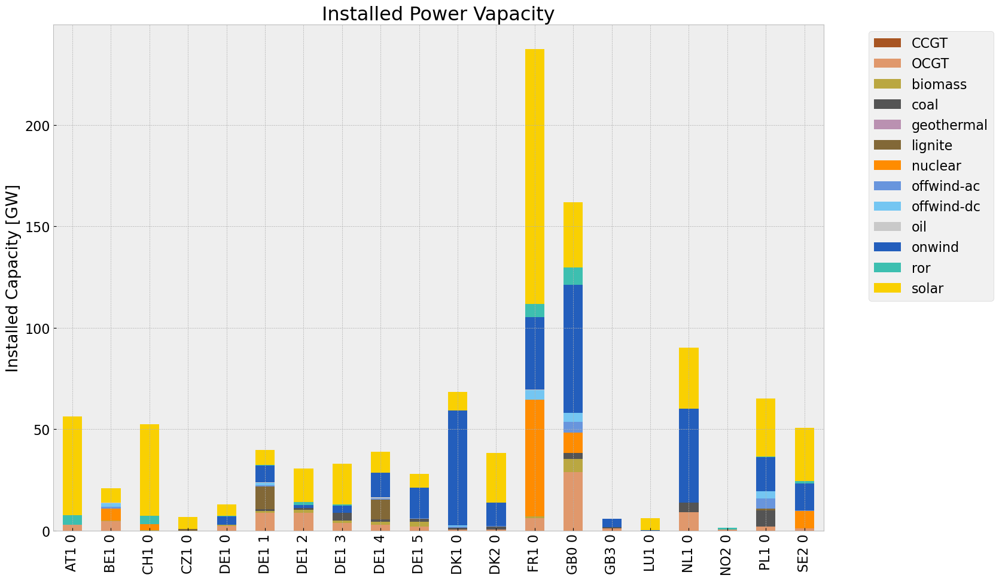

<Figure size 640x480 with 0 Axes>

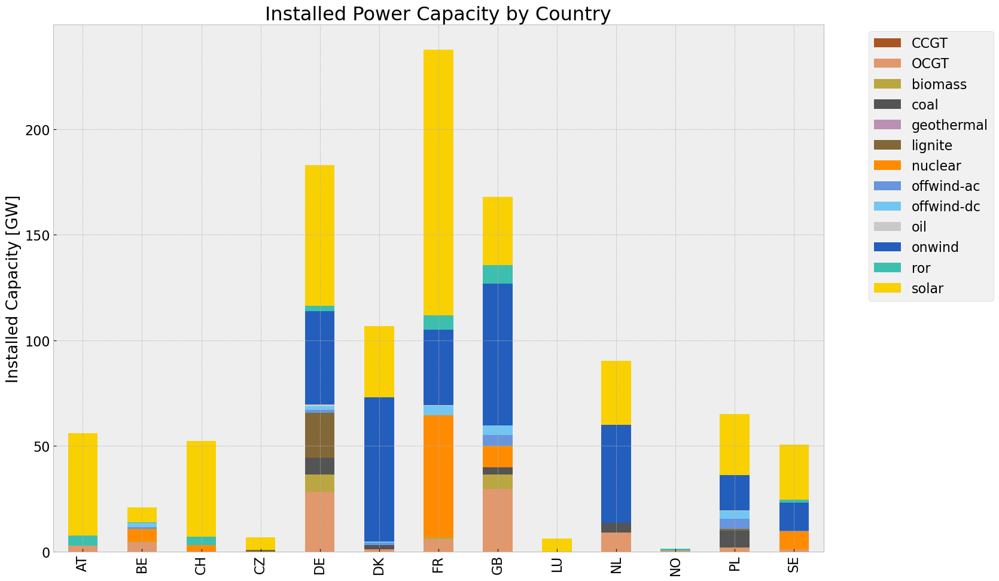

In [49]:
# consolidated istalled cap without load_shedding

#capacities_inv = n1.generators.groupby(['bus', 'carrier']).p_nom_opt.sum()
#capacities_inv.fillna(0, inplace=True)
#gen_1 = (capacities_inv.unstack()/1000).drop(columns=['load'],inplace=False)


capacities_inv = inst_cap_table(n1, color_cap)
cap_inv_country= inst_cap_table_country(n1, color_cap)


### Generation

<Figure size 640x480 with 0 Axes>

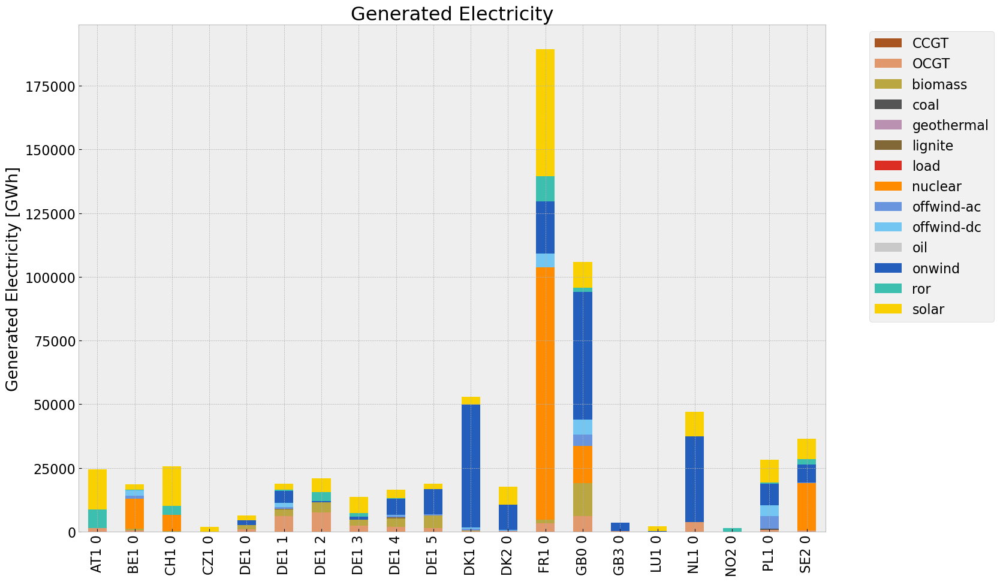

<Figure size 640x480 with 0 Axes>

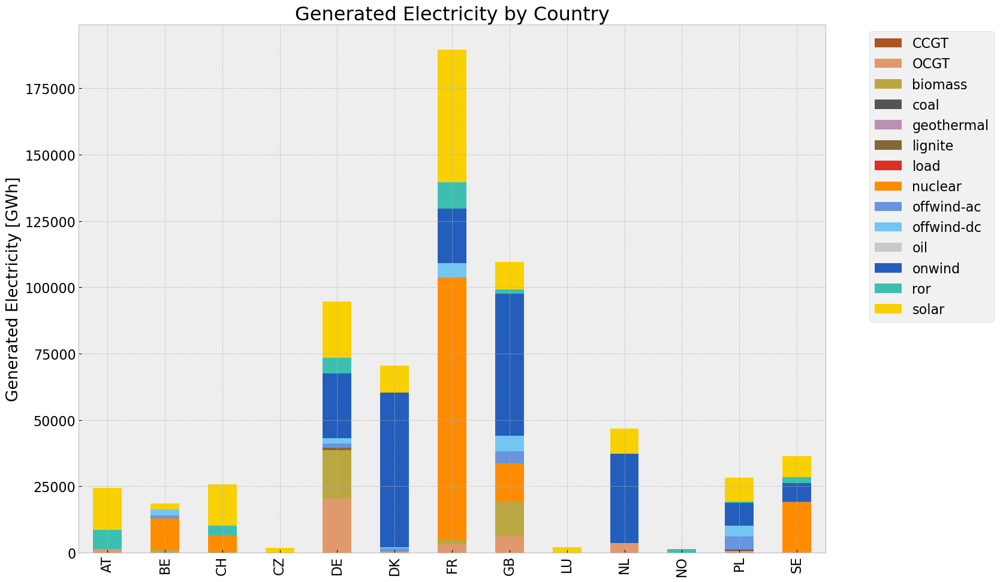

In [50]:
# consolidated generation table
#carrier = n1.generators.carrier.unique()
#df_tot_generation = n1.generators_t.p.sum()

#generations = pd.Series(index = n1.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().index)

#for r in region:
    #for tech in carrier:
        #key = f"{r} {tech}"
        #if key in df_tot_generation.index:
            #try:
               # generations.loc[r, tech] = df_tot_generation[key]
                #print(generations.loc[r, tech])
           # except KeyError:
               # print('error')
                
#generations.fillna(0, inplace=True)
#gen_inv = generations.unstack()/1000#Gwh


gen_inv = gen_power_table(n1,colors_gen_table)
gen_inv_country = gen_power_table_country(n1,colors_gen_table)

### Snapshot

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9840\3440809909.py:23: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = p_country.groupby(n.generators.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9840\3440809909.py:40: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = sto_ctr.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9840\3440809909.py:45: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='3H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9840\3440809909.py:51: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, freq='3H')
c:\Users\Jere

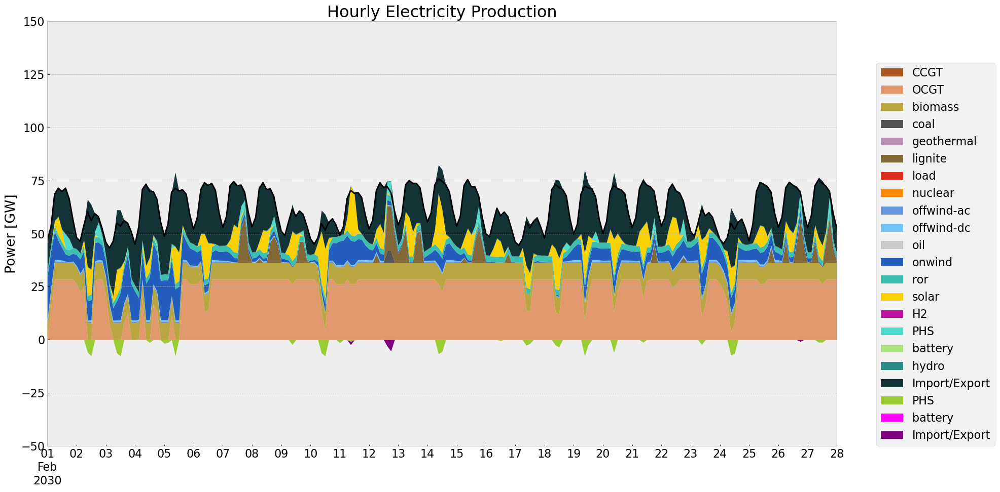

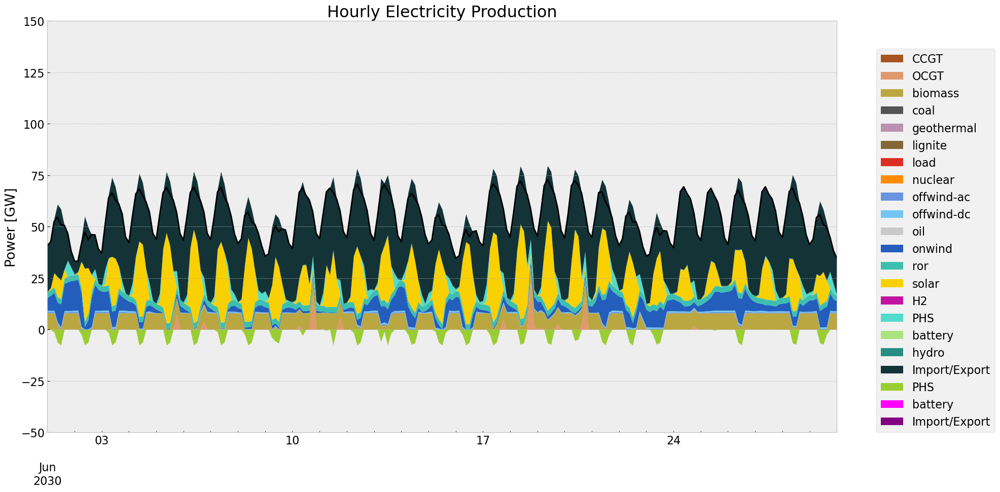

In [51]:
gen_curve(n1, '2030-02-01', '2030-02-28', colors_gen,'DE')
gen_curve(n1, '2030-06-1', '2030-06-30', colors_gen,'DE')


C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9840\2535220694.py:5: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = n.generators_t.p.groupby(n.generators.carrier, axis=1).sum() # MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9840\2535220694.py:9: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = n.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9840\2535220694.py:13: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='3H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9840\2535220694.py:19: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, freq='

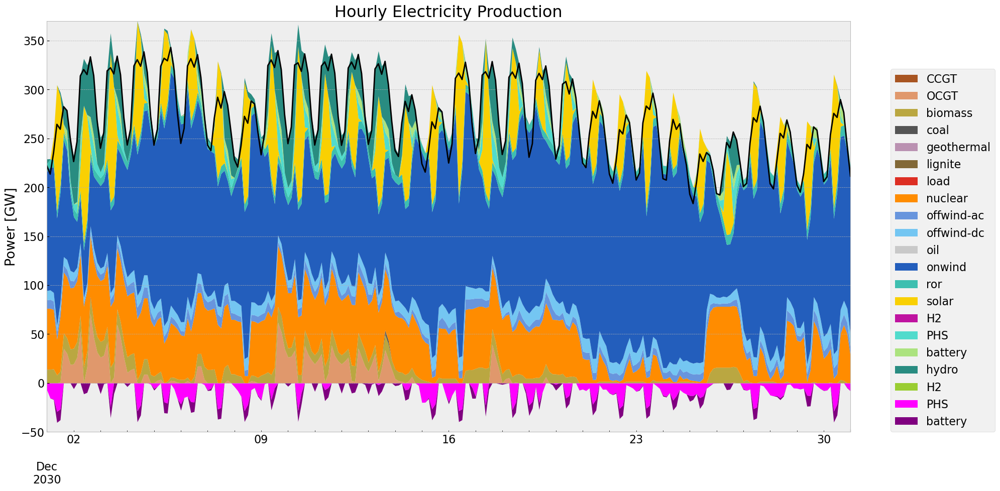

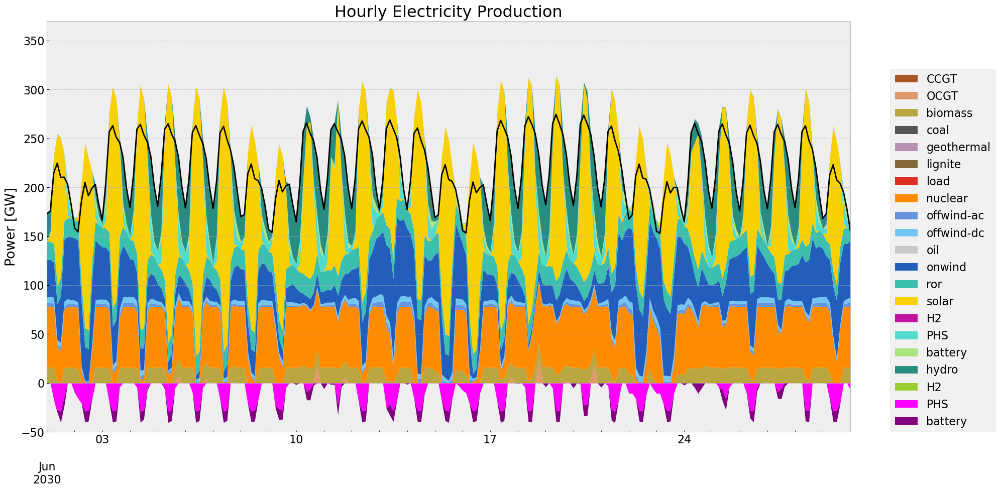

In [52]:
#generation curve all countries
#winter
gen_curve_tot(n1, '2030-12-01', '2030-12-31', colors_gen)
#summer
gen_curve_tot(n1, '2030-06-01', '2030-06-30', colors_gen)

### Storage

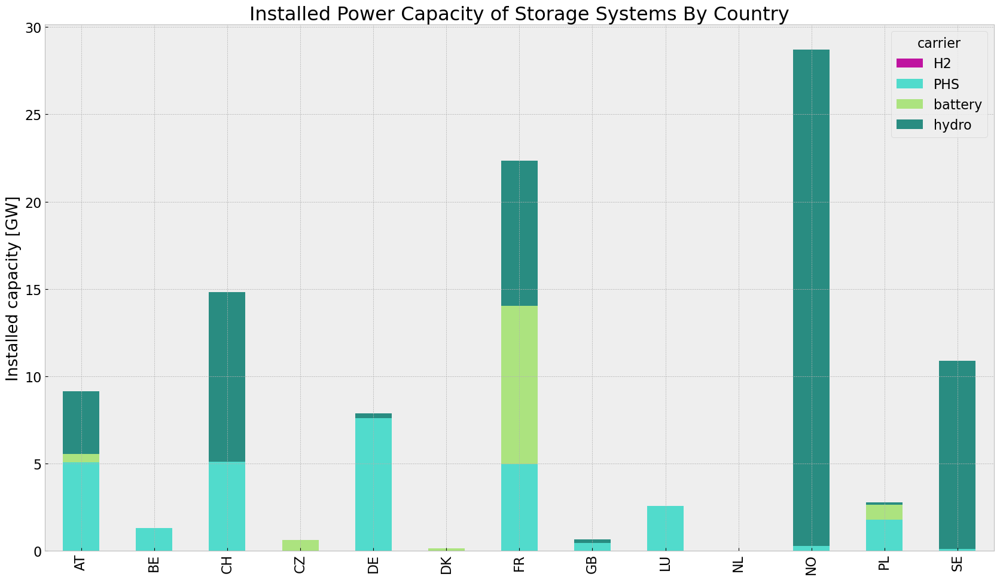

In [53]:
store_inv = inst_store_table(n1)

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9840\3576090030.py:3: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  soc = n.storage_units_t.state_of_charge.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9840\3576090030.py:5: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  soc.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='3H')


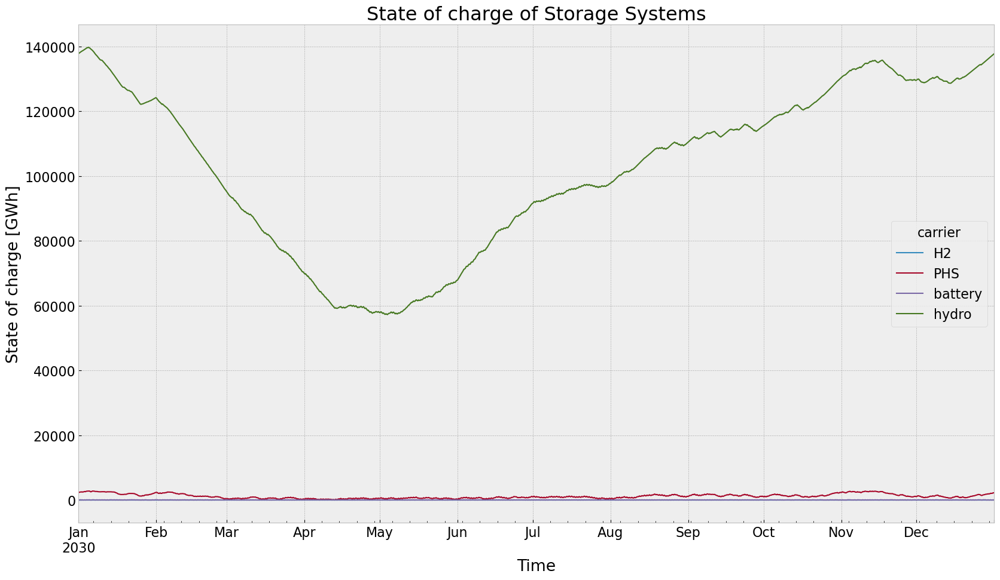

In [54]:
state_of_charge_plot(n1)

### Electricity Price


c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


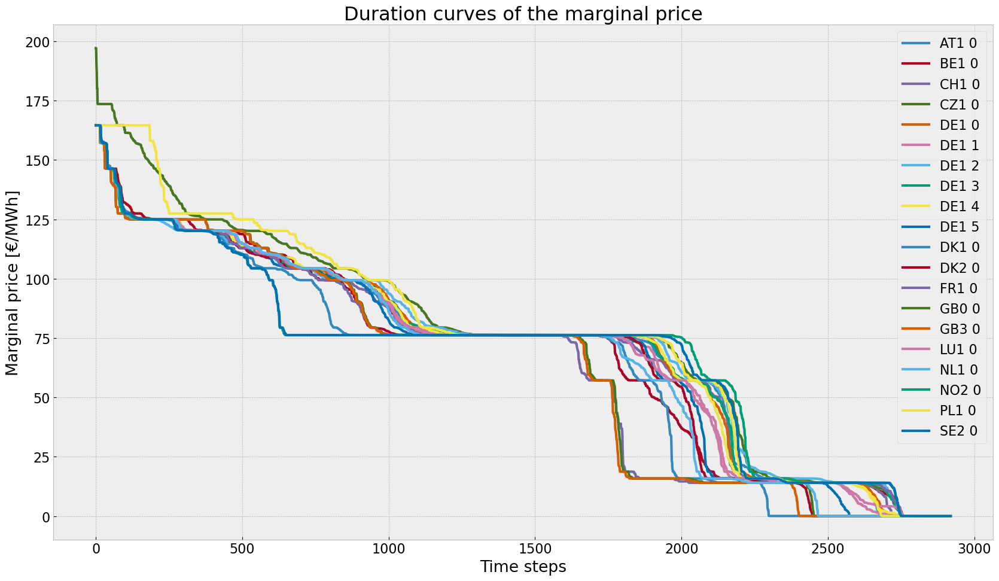

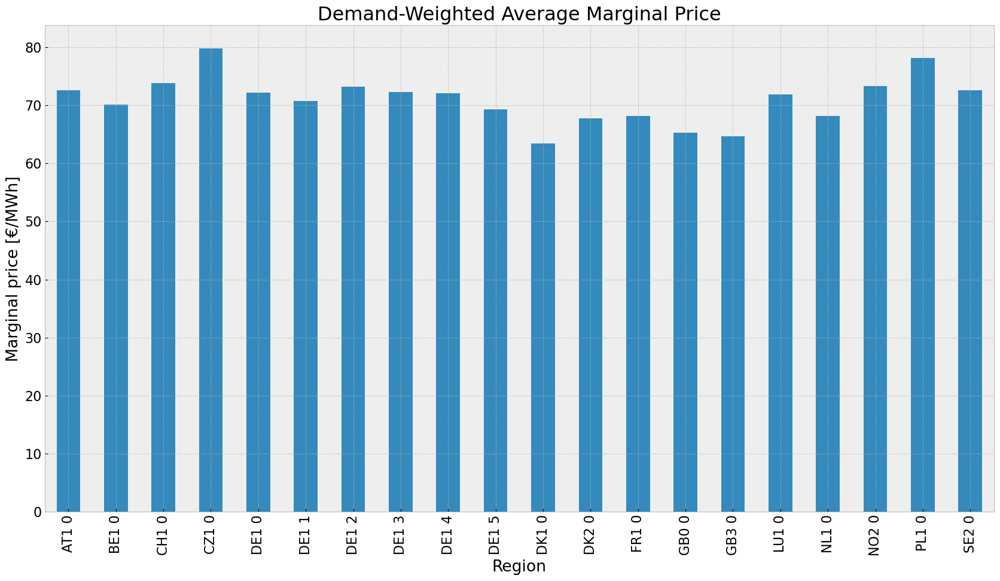

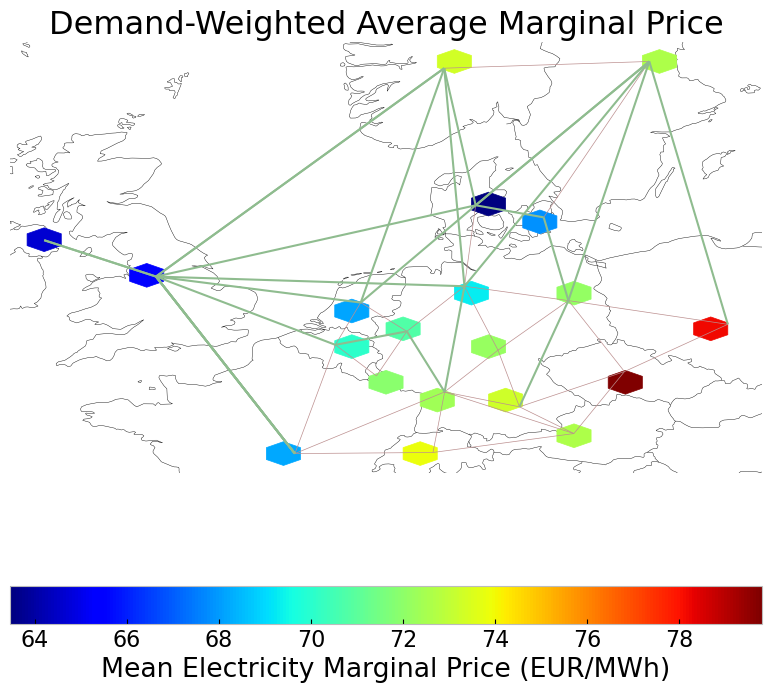

In [55]:
price_dur_curve_plot(n1)
price_regions_table(n1)
price_regions(n1)


### Emission

In [56]:
em_inv =em_table(n1)
em_inv

,Generation in MWh,efficiency,emissions in Tonnes CO2/MWh,emissions in Tonnes CO2
carrier,,,,
CCGT,0.000000e+00,0.580000,0.1980,0.000000e+00
OCGT,3.681320e+07,0.451621,0.1980,1.613967e+07
biomass,3.378468e+07,0.468000,0.0000,0.000000e+00
coal,4.783660e+05,0.329908,0.3361,4.873443e+05
geothermal,0.000000e+00,1.000000,0.1200,0.000000e+00
lignite,8.566591e+05,0.337285,0.4069,1.033473e+06
load,0.000000e+00,1.000000,0.0000,0.000000e+00
nuclear,1.503642e+08,0.326600,0.0000,0.000000e+00
offwind-ac,1.358433e+07,1.000000,0.0000,0.000000e+00


## 2. Model: perfect foresight with no additional investment

In [57]:
n2 = windscenario(n, cut_start, duration, reductionto) 

### No Investment

In [58]:
def no_inv(n2,n):
    #set the optimal capacity of generators from the base scenario as the new minimum capacity 
    for index, value in n2.generators.p_nom_extendable.items():
        if value:  
            n2.generators.at[index, 'p_nom'] = n.generators.at[index, 'p_nom_opt']
            #n2.generators.at[index, 'p_nom_max'] = n.generators.at[index, 'p_nom_opt']
            n2.generators.at[index,'p_nom_extendable'] = False

    #set the optimal capacity of storage units from the base scenario as the new minimum capacity 
    for index, value in n2.storage_units.p_nom_extendable.items():
        if value:  
            n2.storage_units.at[index, 'p_nom'] = n.storage_units.at[index, 'p_nom_opt']
            #n2.storage_units.at[index, 'p_nom_max'] = n.storage_units.at[index, 'p_nom_opt']
            n2.storage_units.at[index,'p_nom_extendable'] = False

    #set the optimal capacity of stores from the base scenario as the new minimum capacity 
    for index, value in n2.stores.e_nom_extendable.items():
        if value:  
            n2.stores.at[index, 'e_nom'] = n.stores.at[index, 'e_nom_opt']
            #n2.stores.at[index, 'e_nom_max'] = n.stores.at[index, 'e_nom_opt']
            n2.stores.at[index, 'e_nom_extendable'] =False

    #set the optimal capacity of lines from the base scenario as the new minimum capacity 
    for index, value in n2.lines.s_nom_extendable.items():
        if value:  
            n2.lines.at[index, 's_nom'] = n.lines.at[index, 's_nom_opt']
            #n2.lines.at[index, 's_nom_max'] = n.lines.at[index, 's_nom_opt']
            n2.lines.at[index, 's_nom_extendable'] =False

    #set the optimal capacity of lines from the base scenario as the new minimum capacity 
    for index, value in n2.links.p_nom_extendable.items():
        if value:  
            n2.links.at[index, 'p_nom'] = n.links.at[index, 'p_nom_opt']
            #n2.lines.at[index, 's_nom_max'] = n.lines.at[index, 's_nom_opt']
            n2.links.at[index, 'p_nom_extendable'] =False

no_inv(n2,n)                 

In [59]:
n2.optimize(solver_name ='gurobi')
#filename = "noinv_wind.nc"
#n2 = import_nc_file(directory, filename)
n2.name = 'noinv_wind'    

INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:05<00:00,  1.25it/s]
INFO:linopy.io: Writing time: 34.74s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6dfcbwq6.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6dfcbwq6.lp


Reading time = 10.82 seconds


INFO:gurobipy:Reading time = 10.82 seconds


obj: 3264560 rows, 1521320 columns, 5349440 nonzeros


INFO:gurobipy:obj: 3264560 rows, 1521320 columns, 5349440 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3264560 rows, 1521320 columns and 5349440 nonzeros


INFO:gurobipy:Optimize a model with 3264560 rows, 1521320 columns and 5349440 nonzeros


Model fingerprint: 0x08184fea


INFO:gurobipy:Model fingerprint: 0x08184fea


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 3e+04]


INFO:gurobipy:  Bounds range     [1e+00, 3e+04]


  RHS range        [1e-01, 1e+09]


INFO:gurobipy:  RHS range        [1e-01, 1e+09]


Presolve removed 3102604 rows and 816404 columns


INFO:gurobipy:Presolve removed 3102604 rows and 816404 columns


Presolve time: 3.91s


INFO:gurobipy:Presolve time: 3.91s


Presolved: 161956 rows, 704916 columns, 1158656 nonzeros


INFO:gurobipy:Presolved: 161956 rows, 704916 columns, 1158656 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.32s


INFO:gurobipy:Ordering time: 0.32s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.771e+05


INFO:gurobipy: AA' NZ     : 4.771e+05


 Factor NZ  : 5.871e+06 (roughly 400 MB of memory)


INFO:gurobipy: Factor NZ  : 5.871e+06 (roughly 400 MB of memory)


 Factor Ops : 4.290e+08 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 4.290e+08 (less than 1 second per iteration)


 Threads    : 3


INFO:gurobipy: Threads    : 3


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.55030345e+13 -1.32584225e+15  7.51e+05 1.36e+03  1.55e+09     6s


INFO:gurobipy:   0   3.55030345e+13 -1.32584225e+15  7.51e+05 1.36e+03  1.55e+09     6s


   1   9.03004365e+12 -4.28476209e+13  6.87e+04 7.28e-12  8.27e+07     6s


INFO:gurobipy:   1   9.03004365e+12 -4.28476209e+13  6.87e+04 7.28e-12  8.27e+07     6s


   2   1.43093829e+12 -9.23208888e+12  3.96e+03 5.91e-12  9.37e+06     6s


INFO:gurobipy:   2   1.43093829e+12 -9.23208888e+12  3.96e+03 5.91e-12  9.37e+06     6s


   3   3.77917389e+11 -3.33097970e+12  7.11e+02 6.28e-11  2.83e+06     7s


INFO:gurobipy:   3   3.77917389e+11 -3.33097970e+12  7.11e+02 6.28e-11  2.83e+06     7s


   4   1.68706563e+11 -1.63857639e+12  2.59e+02 3.00e-11  1.33e+06     7s


INFO:gurobipy:   4   1.68706563e+11 -1.63857639e+12  2.59e+02 3.00e-11  1.33e+06     7s


   5   1.16357046e+11 -6.24847487e+11  9.19e+01 1.64e-11  5.36e+05     8s


INFO:gurobipy:   5   1.16357046e+11 -6.24847487e+11  9.19e+01 1.64e-11  5.36e+05     8s


   6   9.10430778e+10 -1.72260931e+11  4.17e+01 7.73e-12  1.89e+05     8s


INFO:gurobipy:   6   9.10430778e+10 -1.72260931e+11  4.17e+01 7.73e-12  1.89e+05     8s


   7   7.25234906e+10 -5.03716012e+10  2.12e+01 1.27e-11  8.78e+04     8s


INFO:gurobipy:   7   7.25234906e+10 -5.03716012e+10  2.12e+01 1.27e-11  8.78e+04     8s


   8   5.14122586e+10 -5.03331086e+09  6.11e+00 6.37e-12  4.01e+04     9s


INFO:gurobipy:   8   5.14122586e+10 -5.03331086e+09  6.11e+00 6.37e-12  4.01e+04     9s


   9   4.62011474e+10  1.18914902e+10  3.98e+00 6.37e-12  2.44e+04     9s


INFO:gurobipy:   9   4.62011474e+10  1.18914902e+10  3.98e+00 6.37e-12  2.44e+04     9s


  10   3.98910628e+10  2.09622373e+10  1.50e+00 4.09e-12  1.34e+04    10s


INFO:gurobipy:  10   3.98910628e+10  2.09622373e+10  1.50e+00 4.09e-12  1.34e+04    10s


  11   3.84599823e+10  2.68813665e+10  1.05e+00 1.94e-12  8.22e+03    10s


INFO:gurobipy:  11   3.84599823e+10  2.68813665e+10  1.05e+00 1.94e-12  8.22e+03    10s


  12   3.66331536e+10  2.87462824e+10  5.06e-01 1.82e-12  5.60e+03    10s


INFO:gurobipy:  12   3.66331536e+10  2.87462824e+10  5.06e-01 1.82e-12  5.60e+03    10s


  13   3.57289826e+10  3.15740762e+10  2.52e-01 3.64e-12  2.95e+03    11s


INFO:gurobipy:  13   3.57289826e+10  3.15740762e+10  2.52e-01 3.64e-12  2.95e+03    11s


  14   3.53963486e+10  3.29689583e+10  1.67e-01 3.64e-12  1.72e+03    11s


INFO:gurobipy:  14   3.53963486e+10  3.29689583e+10  1.67e-01 3.64e-12  1.72e+03    11s


  15   3.51922580e+10  3.34230672e+10  1.18e-01 3.64e-12  1.26e+03    12s


INFO:gurobipy:  15   3.51922580e+10  3.34230672e+10  1.18e-01 3.64e-12  1.26e+03    12s


  16   3.51035901e+10  3.36437705e+10  9.76e-02 3.64e-12  1.04e+03    12s


INFO:gurobipy:  16   3.51035901e+10  3.36437705e+10  9.76e-02 3.64e-12  1.04e+03    12s


  17   3.50015153e+10  3.39598097e+10  7.41e-02 2.46e-12  7.39e+02    12s


INFO:gurobipy:  17   3.50015153e+10  3.39598097e+10  7.41e-02 2.46e-12  7.39e+02    12s


  18   3.49114000e+10  3.41139067e+10  5.32e-02 2.16e-12  5.66e+02    13s


INFO:gurobipy:  18   3.49114000e+10  3.41139067e+10  5.32e-02 2.16e-12  5.66e+02    13s


  19   3.48179376e+10  3.42517122e+10  3.26e-02 2.44e-12  4.02e+02    13s


INFO:gurobipy:  19   3.48179376e+10  3.42517122e+10  3.26e-02 2.44e-12  4.02e+02    13s


  20   3.48008180e+10  3.43450627e+10  2.89e-02 1.82e-12  3.23e+02    14s


INFO:gurobipy:  20   3.48008180e+10  3.43450627e+10  2.89e-02 1.82e-12  3.23e+02    14s


  21   3.47886751e+10  3.44092816e+10  2.63e-02 1.89e-12  2.69e+02    14s


INFO:gurobipy:  21   3.47886751e+10  3.44092816e+10  2.63e-02 1.89e-12  2.69e+02    14s


  22   3.47387070e+10  3.44555776e+10  1.54e-02 1.88e-12  2.01e+02    14s


INFO:gurobipy:  22   3.47387070e+10  3.44555776e+10  1.54e-02 1.88e-12  2.01e+02    14s


  23   3.47332884e+10  3.44949790e+10  1.43e-02 1.86e-12  1.69e+02    15s


INFO:gurobipy:  23   3.47332884e+10  3.44949790e+10  1.43e-02 1.86e-12  1.69e+02    15s


  24   3.47171219e+10  3.45317917e+10  1.08e-02 2.61e-12  1.31e+02    15s


INFO:gurobipy:  24   3.47171219e+10  3.45317917e+10  1.08e-02 2.61e-12  1.31e+02    15s


  25   3.47085294e+10  3.45582913e+10  9.03e-03 7.79e-09  1.07e+02    16s


INFO:gurobipy:  25   3.47085294e+10  3.45582913e+10  9.03e-03 7.79e-09  1.07e+02    16s


  26   3.46954084e+10  3.45795089e+10  6.28e-03 1.77e-08  8.22e+01    16s


INFO:gurobipy:  26   3.46954084e+10  3.45795089e+10  6.28e-03 1.77e-08  8.22e+01    16s


  27   3.46823913e+10  3.45928258e+10  3.54e-03 2.39e-08  6.35e+01    17s


INFO:gurobipy:  27   3.46823913e+10  3.45928258e+10  3.54e-03 2.39e-08  6.35e+01    17s


  28   3.46776781e+10  3.46183716e+10  2.53e-03 3.35e-08  4.21e+01    17s


INFO:gurobipy:  28   3.46776781e+10  3.46183716e+10  2.53e-03 3.35e-08  4.21e+01    17s


  29   3.46724224e+10  3.46258454e+10  1.48e-03 3.93e-08  3.30e+01    18s


INFO:gurobipy:  29   3.46724224e+10  3.46258454e+10  1.48e-03 3.93e-08  3.30e+01    18s


  30   3.46714934e+10  3.46341279e+10  1.29e-03 3.30e-08  2.65e+01    18s


INFO:gurobipy:  30   3.46714934e+10  3.46341279e+10  1.29e-03 3.30e-08  2.65e+01    18s


  31   3.46709210e+10  3.46377477e+10  1.18e-03 3.13e-08  2.35e+01    19s


INFO:gurobipy:  31   3.46709210e+10  3.46377477e+10  1.18e-03 3.13e-08  2.35e+01    19s


  32   3.46703084e+10  3.46442070e+10  1.06e-03 3.31e-08  1.85e+01    19s


INFO:gurobipy:  32   3.46703084e+10  3.46442070e+10  1.06e-03 3.31e-08  1.85e+01    19s


  33   3.46679616e+10  3.46465375e+10  6.11e-04 3.25e-08  1.52e+01    20s


INFO:gurobipy:  33   3.46679616e+10  3.46465375e+10  6.11e-04 3.25e-08  1.52e+01    20s


  34   3.46674605e+10  3.46521991e+10  5.10e-04 2.86e-08  1.08e+01    20s


INFO:gurobipy:  34   3.46674605e+10  3.46521991e+10  5.10e-04 2.86e-08  1.08e+01    20s


  35   3.46665625e+10  3.46546320e+10  3.45e-04 3.23e-08  8.46e+00    21s


INFO:gurobipy:  35   3.46665625e+10  3.46546320e+10  3.45e-04 3.23e-08  8.46e+00    21s


  36   3.46661069e+10  3.46565367e+10  2.59e-04 4.15e-08  6.79e+00    22s


INFO:gurobipy:  36   3.46661069e+10  3.46565367e+10  2.59e-04 4.15e-08  6.79e+00    22s


  37   3.46657020e+10  3.46581201e+10  1.87e-04 4.66e-08  5.38e+00    22s


INFO:gurobipy:  37   3.46657020e+10  3.46581201e+10  1.87e-04 4.66e-08  5.38e+00    22s


  38   3.46653746e+10  3.46591171e+10  1.31e-04 4.75e-08  4.44e+00    23s


INFO:gurobipy:  38   3.46653746e+10  3.46591171e+10  1.31e-04 4.75e-08  4.44e+00    23s


  39   3.46653242e+10  3.46598335e+10  1.22e-04 4.56e-08  3.89e+00    23s


INFO:gurobipy:  39   3.46653242e+10  3.46598335e+10  1.22e-04 4.56e-08  3.89e+00    23s


  40   3.46651609e+10  3.46604187e+10  9.44e-05 4.51e-08  3.36e+00    24s


INFO:gurobipy:  40   3.46651609e+10  3.46604187e+10  9.44e-05 4.51e-08  3.36e+00    24s


  41   3.46650507e+10  3.46610819e+10  7.60e-05 4.29e-08  2.82e+00    24s


INFO:gurobipy:  41   3.46650507e+10  3.46610819e+10  7.60e-05 4.29e-08  2.82e+00    24s


  42   3.46650255e+10  3.46617084e+10  7.18e-05 3.80e-08  2.35e+00    25s


INFO:gurobipy:  42   3.46650255e+10  3.46617084e+10  7.18e-05 3.80e-08  2.35e+00    25s


  43   3.46648576e+10  3.46625685e+10  4.41e-05 3.39e-08  1.62e+00    25s


INFO:gurobipy:  43   3.46648576e+10  3.46625685e+10  4.41e-05 3.39e-08  1.62e+00    25s


  44   3.46647326e+10  3.46630166e+10  2.40e-05 3.87e-08  1.22e+00    26s


INFO:gurobipy:  44   3.46647326e+10  3.46630166e+10  2.40e-05 3.87e-08  1.22e+00    26s


  45   3.46647220e+10  3.46632972e+10  2.24e-05 3.78e-08  1.01e+00    26s


INFO:gurobipy:  45   3.46647220e+10  3.46632972e+10  2.24e-05 3.78e-08  1.01e+00    26s


  46   3.46646817e+10  3.46637197e+10  1.62e-05 3.81e-08  6.82e-01    27s


INFO:gurobipy:  46   3.46646817e+10  3.46637197e+10  1.62e-05 3.81e-08  6.82e-01    27s


  47   3.46646524e+10  3.46638735e+10  1.19e-05 3.24e-08  5.52e-01    28s


INFO:gurobipy:  47   3.46646524e+10  3.46638735e+10  1.19e-05 3.24e-08  5.52e-01    28s


  48   3.46646351e+10  3.46640045e+10  9.22e-06 2.62e-08  4.47e-01    28s


INFO:gurobipy:  48   3.46646351e+10  3.46640045e+10  9.22e-06 2.62e-08  4.47e-01    28s


  49   3.46646137e+10  3.46641497e+10  6.21e-06 1.98e-08  3.29e-01    29s


INFO:gurobipy:  49   3.46646137e+10  3.46641497e+10  6.21e-06 1.98e-08  3.29e-01    29s


  50   3.46646057e+10  3.46642586e+10  5.08e-06 2.02e-08  2.46e-01    30s


INFO:gurobipy:  50   3.46646057e+10  3.46642586e+10  5.08e-06 2.02e-08  2.46e-01    30s


  51   3.46645922e+10  3.46643592e+10  4.10e-06 1.43e-08  1.65e-01    30s


INFO:gurobipy:  51   3.46645922e+10  3.46643592e+10  4.10e-06 1.43e-08  1.65e-01    30s


  52   3.46645873e+10  3.46644186e+10  3.12e-06 1.11e-08  1.20e-01    31s


INFO:gurobipy:  52   3.46645873e+10  3.46644186e+10  3.12e-06 1.11e-08  1.20e-01    31s


  53   3.46645829e+10  3.46644447e+10  2.22e-06 9.58e-09  9.80e-02    32s


INFO:gurobipy:  53   3.46645829e+10  3.46644447e+10  2.22e-06 9.58e-09  9.80e-02    32s


  54   3.46645806e+10  3.46644846e+10  1.76e-06 7.48e-09  6.81e-02    32s


INFO:gurobipy:  54   3.46645806e+10  3.46644846e+10  1.76e-06 7.48e-09  6.81e-02    32s


  55   3.46645790e+10  3.46644924e+10  1.58e-06 6.81e-09  6.15e-02    33s


INFO:gurobipy:  55   3.46645790e+10  3.46644924e+10  1.58e-06 6.81e-09  6.15e-02    33s


  56   3.46645763e+10  3.46645120e+10  1.34e-06 6.10e-09  4.56e-02    34s


INFO:gurobipy:  56   3.46645763e+10  3.46645120e+10  1.34e-06 6.10e-09  4.56e-02    34s


  57   3.46645725e+10  3.46645273e+10  9.00e-07 5.05e-09  3.21e-02    34s


INFO:gurobipy:  57   3.46645725e+10  3.46645273e+10  9.00e-07 5.05e-09  3.21e-02    34s


  58   3.46645715e+10  3.46645361e+10  9.64e-07 3.71e-09  2.51e-02    35s


INFO:gurobipy:  58   3.46645715e+10  3.46645361e+10  9.64e-07 3.71e-09  2.51e-02    35s


  59   3.46645706e+10  3.46645461e+10  9.34e-07 2.68e-09  1.74e-02    36s


INFO:gurobipy:  59   3.46645706e+10  3.46645461e+10  9.34e-07 2.68e-09  1.74e-02    36s


  60   3.46645695e+10  3.46645507e+10  7.35e-07 2.34e-09  1.34e-02    37s


INFO:gurobipy:  60   3.46645695e+10  3.46645507e+10  7.35e-07 2.34e-09  1.34e-02    37s


  61   3.46645685e+10  3.46645543e+10  5.38e-07 2.05e-09  1.01e-02    37s


INFO:gurobipy:  61   3.46645685e+10  3.46645543e+10  5.38e-07 2.05e-09  1.01e-02    37s


  62   3.46645677e+10  3.46645556e+10  3.86e-07 1.95e-09  8.60e-03    38s


INFO:gurobipy:  62   3.46645677e+10  3.46645556e+10  3.86e-07 1.95e-09  8.60e-03    38s


  63   3.46645673e+10  3.46645595e+10  3.17e-07 1.48e-09  5.60e-03    39s


INFO:gurobipy:  63   3.46645673e+10  3.46645595e+10  3.17e-07 1.48e-09  5.60e-03    39s


  64   3.46645672e+10  3.46645614e+10  2.86e-07 1.50e-09  4.12e-03    39s


INFO:gurobipy:  64   3.46645672e+10  3.46645614e+10  2.86e-07 1.50e-09  4.12e-03    39s


  65   3.46645669e+10  3.46645631e+10  2.48e-07 1.88e-09  2.74e-03    40s


INFO:gurobipy:  65   3.46645669e+10  3.46645631e+10  2.48e-07 1.88e-09  2.74e-03    40s


  66   3.46645664e+10  3.46645638e+10  1.36e-07 1.95e-09  1.84e-03    41s


INFO:gurobipy:  66   3.46645664e+10  3.46645638e+10  1.36e-07 1.95e-09  1.84e-03    41s


  67   3.46645662e+10  3.46645644e+10  1.30e-07 1.49e-09  1.28e-03    41s


INFO:gurobipy:  67   3.46645662e+10  3.46645644e+10  1.30e-07 1.49e-09  1.28e-03    41s


  68   3.46645661e+10  3.46645647e+10  1.01e-07 1.13e-09  9.66e-04    42s


INFO:gurobipy:  68   3.46645661e+10  3.46645647e+10  1.01e-07 1.13e-09  9.66e-04    42s


  69   3.46645659e+10  3.46645649e+10  9.34e-08 1.03e-09  7.47e-04    43s


INFO:gurobipy:  69   3.46645659e+10  3.46645649e+10  9.34e-08 1.03e-09  7.47e-04    43s


  70   3.46645658e+10  3.46645654e+10  1.10e-07 4.82e-10  3.05e-04    44s


INFO:gurobipy:  70   3.46645658e+10  3.46645654e+10  1.10e-07 4.82e-10  3.05e-04    44s


  71   3.46645658e+10  3.46645654e+10  9.80e-08 4.29e-10  2.48e-04    45s


INFO:gurobipy:  71   3.46645658e+10  3.46645654e+10  9.80e-08 4.29e-10  2.48e-04    45s


  72   3.46645657e+10  3.46645656e+10  2.39e-07 1.42e-10  8.83e-05    45s


INFO:gurobipy:  72   3.46645657e+10  3.46645656e+10  2.39e-07 1.42e-10  8.83e-05    45s


  73   3.46645657e+10  3.46645656e+10  9.05e-08 7.46e-11  4.19e-05    46s


INFO:gurobipy:  73   3.46645657e+10  3.46645656e+10  9.05e-08 7.46e-11  4.19e-05    46s


  74   3.46645657e+10  3.46645656e+10  4.11e-08 2.13e-11  1.35e-05    46s


INFO:gurobipy:  74   3.46645657e+10  3.46645656e+10  4.11e-08 2.13e-11  1.35e-05    46s


  75   3.46645657e+10  3.46645656e+10  2.26e-08 1.36e-11  6.93e-06    47s


INFO:gurobipy:  75   3.46645657e+10  3.46645656e+10  2.26e-08 1.36e-11  6.93e-06    47s


INFO:gurobipy:


Barrier solved model in 75 iterations and 46.89 seconds (22.20 work units)


INFO:gurobipy:Barrier solved model in 75 iterations and 46.89 seconds (22.20 work units)


Optimal objective 3.46645657e+10


INFO:gurobipy:Optimal objective 3.46645657e+10


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


   14177 DPushes remaining with DInf 0.0000000e+00                48s


INFO:gurobipy:   14177 DPushes remaining with DInf 0.0000000e+00                48s


       0 DPushes remaining with DInf 0.0000000e+00                49s


INFO:gurobipy:       0 DPushes remaining with DInf 0.0000000e+00                49s


INFO:gurobipy:Warning: Markowitz tolerance tightened to 0.5


INFO:gurobipy:


   84774 PPushes remaining with PInf 1.6246693e-05                49s


INFO:gurobipy:   84774 PPushes remaining with PInf 1.6246693e-05                49s


   39436 PPushes remaining with PInf 7.6067983e-04                51s


INFO:gurobipy:   39436 PPushes remaining with PInf 7.6067983e-04                51s


   14631 PPushes remaining with PInf 7.0929656e-04                55s


INFO:gurobipy:   14631 PPushes remaining with PInf 7.0929656e-04                55s


    3571 PPushes remaining with PInf 7.0929659e-04                60s


INFO:gurobipy:    3571 PPushes remaining with PInf 7.0929659e-04                60s


       0 PPushes remaining with PInf 0.0000000e+00                61s


INFO:gurobipy:       0 PPushes remaining with PInf 0.0000000e+00                61s


INFO:gurobipy:


  Push phase complete: Pinf 0.0000000e+00, Dinf 3.2461982e+00     62s


INFO:gurobipy:  Push phase complete: Pinf 0.0000000e+00, Dinf 3.2461982e+00     62s


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


   98954    3.4664566e+10   0.000000e+00   3.246198e+00     62s


INFO:gurobipy:   98954    3.4664566e+10   0.000000e+00   3.246198e+00     62s


INFO:gurobipy:


Solved with barrier


INFO:gurobipy:Solved with barrier


   99026    3.4664566e+10   0.000000e+00   0.000000e+00     64s


INFO:gurobipy:   99026    3.4664566e+10   0.000000e+00   0.000000e+00     64s


INFO:gurobipy:


Solved in 99026 iterations and 63.99 seconds (27.57 work units)


INFO:gurobipy:Solved in 99026 iterations and 63.99 seconds (27.57 work units)


Optimal objective  3.466456565e+10


INFO:gurobipy:Optimal objective  3.466456565e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1521320 primals, 3264560 duals
Objective: 3.47e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


### Export model for later use

In [60]:
file = f"{n2.name}.nc"
output_path = os.path.join(os.getcwd(), file)
n2.export_to_netcdf(output_path)

INFO:pypsa.io:Exported network noinv_wind.nc has storage_units, carriers, links, generators, global_constraints, loads, buses, lines


<xarray.Dataset> Size: 13MB
Dimensions:                               (snapshots: 2920,
                                           investment_periods: 0,
                                           storage_units_i: 65,
                                           storage_units_t_inflow_i: 10,
                                           storage_units_t_p_i: 25,
                                           storage_units_t_p_dispatch_i: 25,
                                           ...
                                           loads_t_p_i: 20, buses_i: 20,
                                           buses_t_p_i: 20,
                                           buses_t_v_ang_i: 18,
                                           buses_t_marginal_price_i: 20,
                                           lines_i: 27, lines_t_p0_i: 27,
                                           lines_t_p1_i: 27, lines_t_loss_i: 27)
Coordinates: (12/27)
  * snapshots                             (snapshots) int64 23kB 0 1 ... 2919
  * investment_periods                    (investment_periods) int64 0B 
  * storage_units_i                       (storage_units_i) object 520B 'AT1 ...
  * storage_units_t_inflow_i              (storage_units_t_inflow_i) object 80B ...
  * storage_units_t_p_i                   (storage_units_t_p_i) object 200B '...
  * storage_units_t_p_dispatch_i          (storage_units_t_p_dispatch_i) object 200B ...
    ...                                    ...
  * buses_t_v_ang_i                       (buses_t_v_ang_i) object 144B 'AT1 ...
  * buses_t_marginal_price_i              (buses_t_marginal_price_i) object 160B ...
  * lines_i                               (lines_i) object 216B '0' '1' ... '9'
  * lines_t_p0_i                          (lines_t_p0_i) object 216B '0' ... '9'
  * lines_t_p1_i                          (lines_t_p1_i) object 216B '0' ... '9'
  * lines_t_loss_i                        (lines_t_loss_i) object 216B '0' .....
Data variables: (12/103)
    snapshots_snapshot                    (snapshots) datetime64[ns] 23kB 201...
    snapshots_objective                   (snapshots) float64 23kB 3.0 ... 3.0
    snapshots_generators                  (snapshots) float64 23kB 3.0 ... 3.0
    snapshots_stores                      (snapshots) float64 23kB 3.0 ... 3.0
    investment_periods_objective          (investment_periods) float64 0B 
    investment_periods_years              (investment_periods) float64 0B 
    ...                                    ...
    lines_r_pu_eff                        (lines_i) float64 216B 2.592e-05 .....
    lines_s_nom_opt                       (lines_i) float64 216B 6.792e+03 .....
    lines_country                         (lines_i) object 216B 'AT' ... 'CZ'
    lines_t_p0                            (snapshots, lines_t_p0_i) float64 631kB ...
    lines_t_p1                            (snapshots, lines_t_p1_i) float64 631kB ...
    lines_t_loss                          (snapshots, lines_t_loss_i) float64 631kB ...
Attributes:
    network__linearized_uc:  0
    network__multi_invest:   0
    network_name:            noinv_wind
    network_objective:       34664565646.947365
    network_pypsa_version:   0.27.0
    network_srid:            4326
    crs:                     {"_crs": "GEOGCRS[\"WGS 84\",ENSEMBLE[\"World Ge...
    meta:                    {}

In [61]:
tot_cos_noinv=n2.objective/1e9 #billion €
system_cost_noinv = system_cost(n2) #million €/a
marg_price_region_noinv = n2.buses_t.marginal_price.mean()
stat_noinv = n2.statistics()

### Installed Capacity

Since expansion is not allowed in this scenario, the installed capacity will equal to that of the base scenario.

<Figure size 640x480 with 0 Axes>

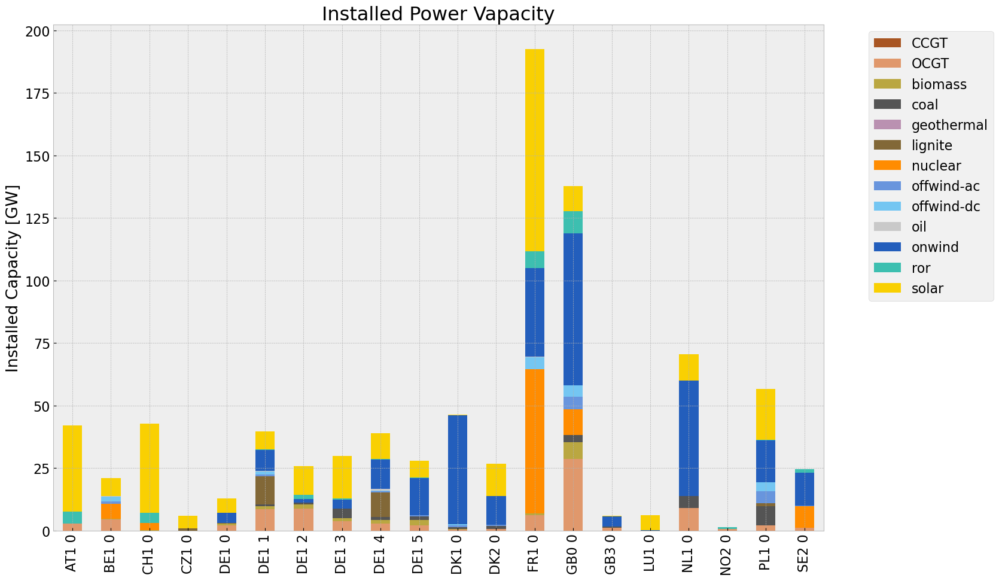

<Figure size 640x480 with 0 Axes>

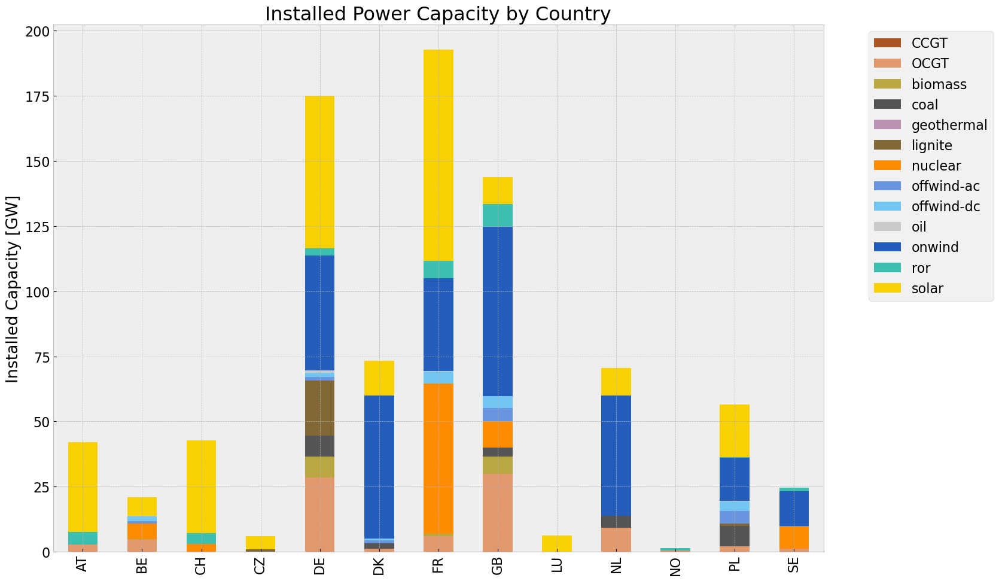

In [62]:
# consolidated istalled cap without load_shedding

#capacities_noinv = n2.generators.groupby(['bus', 'carrier']).p_nom_opt.sum()
#capacities_noinv.fillna(0, inplace=True)
#gen = (capacities_noinv.unstack()/1000).drop(columns=['load'],inplace=False)


capacities_noinv = inst_cap_table(n2, color_cap)
cap_noinv_country= inst_cap_table_country(n2, color_cap)



### Generation

<Figure size 640x480 with 0 Axes>

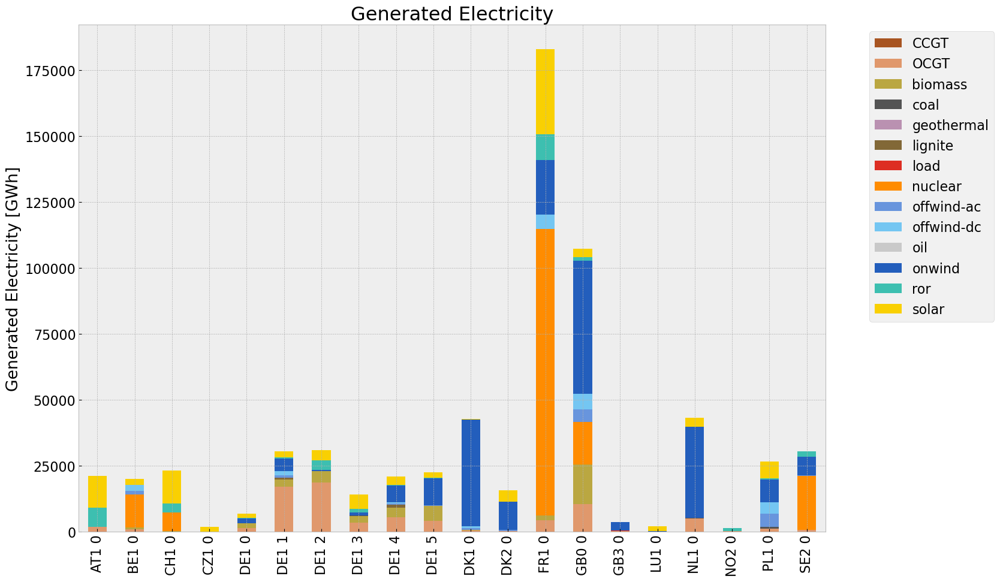

<Figure size 640x480 with 0 Axes>

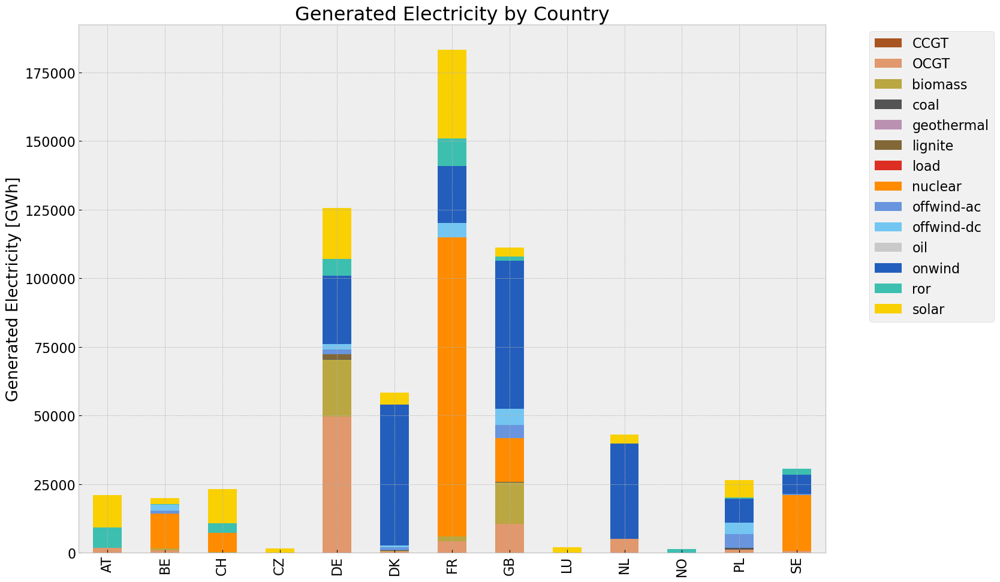

In [63]:
# consolidated generation table
#carrier = n2.generators.carrier.unique()
#df_tot_generation = n2.generators_t.p.sum()

#generations = pd.Series(index = n2.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().index)

#for r in region:
    #for tech in carrier:
        #key = f"{r} {tech}"
        #if key in df_tot_generation.index:
            #try:
                #generations.loc[r, tech] = df_tot_generation[key]
                #print(generations.loc[r, tech])
            #except KeyError:
                #print('error')

#generations.fillna(0, inplace=True)
#gen_noinv = generations.unstack()/1000#GWh

gen_noinv= gen_power_table(n2,colors_gen_table)
gen_noinv_country = gen_power_table_country(n2,colors_gen_table)


### Snapshot

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9840\1288276629.py:1: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p = n2.generators_t.p.groupby(n.generators.carrier, axis=1).sum().div(1e3)
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9840\1288276629.py:2: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = n2.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9840\3440809909.py:23: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = p_country.groupby(n.generators.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9840\3440809909.py:40: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = sto_ctr.groupby(n.storage_units.carrier, axis=1).sum(

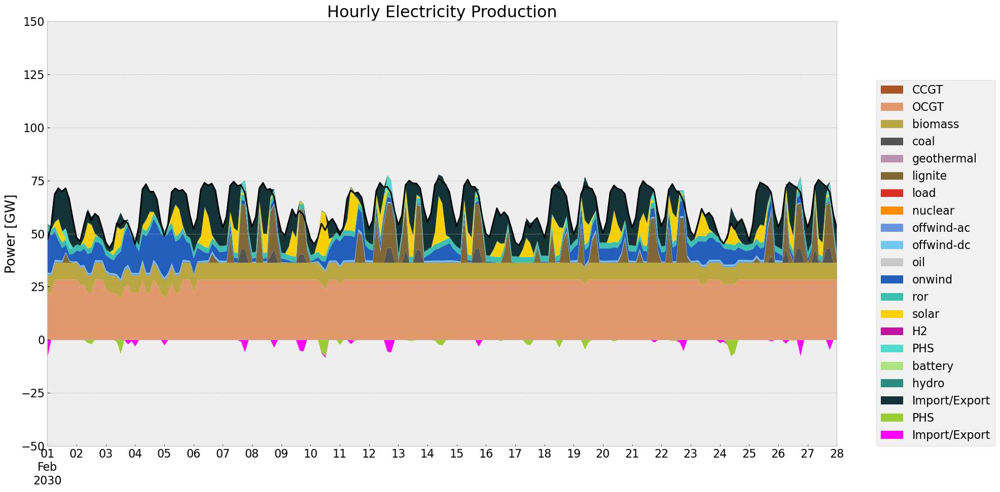

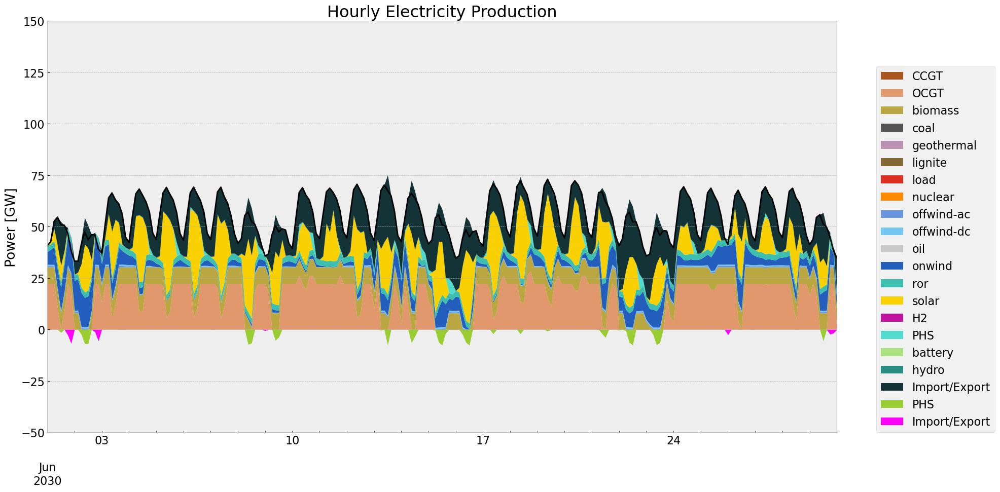

In [64]:
p = n2.generators_t.p.groupby(n.generators.carrier, axis=1).sum().div(1e3)
sto = n2.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)    

gen_curve(n2, '2030-02-01', '2030-02-28', colors_gen,'DE')
gen_curve(n2, '2030-06-01', '2030-06-30', colors_gen,'DE')


C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9840\2535220694.py:5: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = n.generators_t.p.groupby(n.generators.carrier, axis=1).sum() # MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9840\2535220694.py:9: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = n.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9840\2535220694.py:13: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='3H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9840\2535220694.py:19: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, freq='

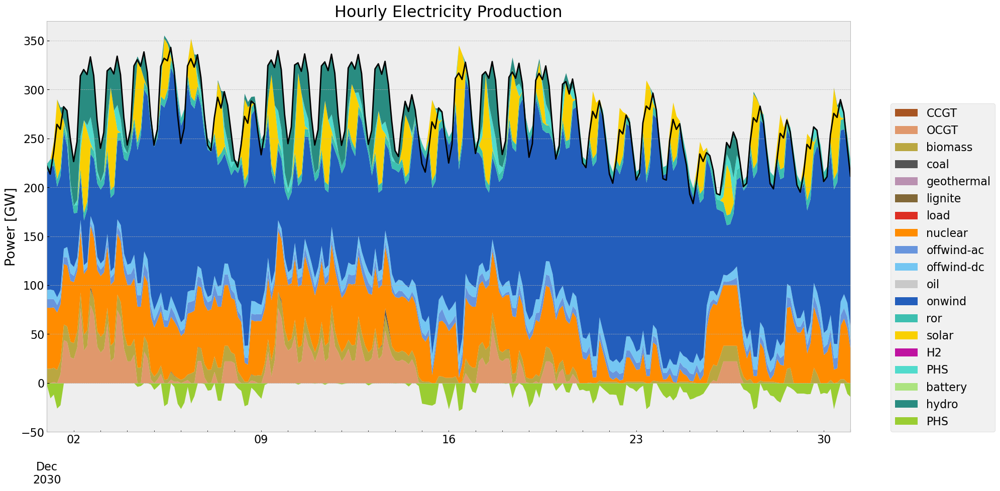

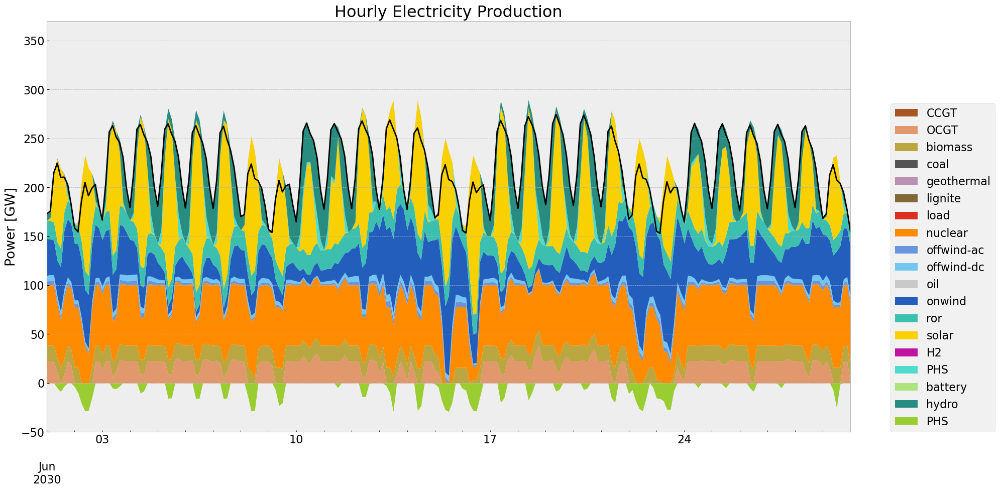

In [65]:
#generation curve all countries
#winter
gen_curve_tot(n2, '2030-12-01', '2030-12-31', colors_gen)
#summer
gen_curve_tot(n2, '2030-06-01', '2030-06-30', colors_gen)

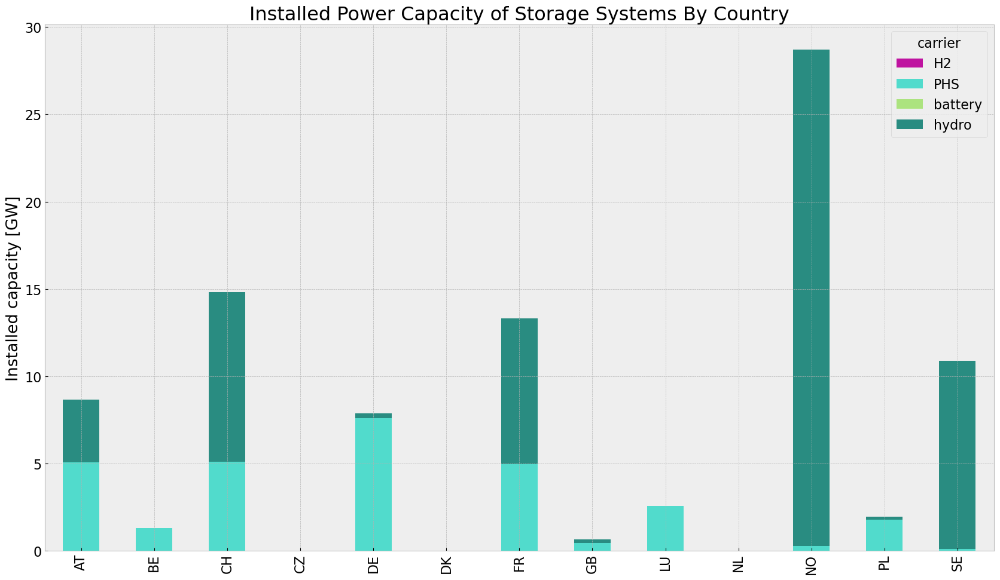

In [66]:
#storage unit capacities
store_noinv = inst_store_table(n2)

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9840\3576090030.py:3: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  soc = n.storage_units_t.state_of_charge.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9840\3576090030.py:5: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  soc.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='3H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9840\1117423567.py:3: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  n2.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3).loc[pd.date_range(start="2013-01-01", end="2013-12-31",freq='3H')].plot(figsize=(20,10))
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9840\1117423567.py:3: FutureWarning: 'H' is deprecated and will be removed in a future v

,Generation in MWh,efficiency,emissions in Tonnes CO2/MWh,emissions in Tonnes CO2
carrier,,,,
CCGT,0.000000e+00,0.580000,0.1980,0.000000e+00
OCGT,7.449408e+07,0.451621,0.1980,3.265976e+07
biomass,3.871769e+07,0.468000,0.0000,0.000000e+00
coal,1.040650e+06,0.329908,0.3361,1.060181e+06
geothermal,0.000000e+00,1.000000,0.1200,0.000000e+00
lignite,1.891793e+06,0.337285,0.4069,2.282257e+06
load,3.775349e+03,1.000000,0.0000,0.000000e+00
nuclear,1.649164e+08,0.326600,0.0000,0.000000e+00
offwind-ac,1.415526e+07,1.000000,0.0000,0.000000e+00


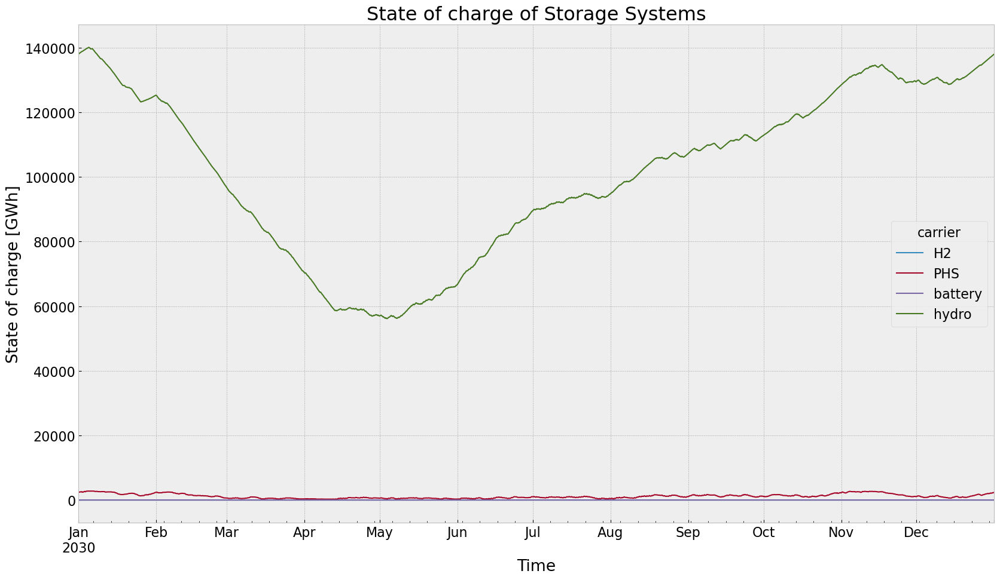

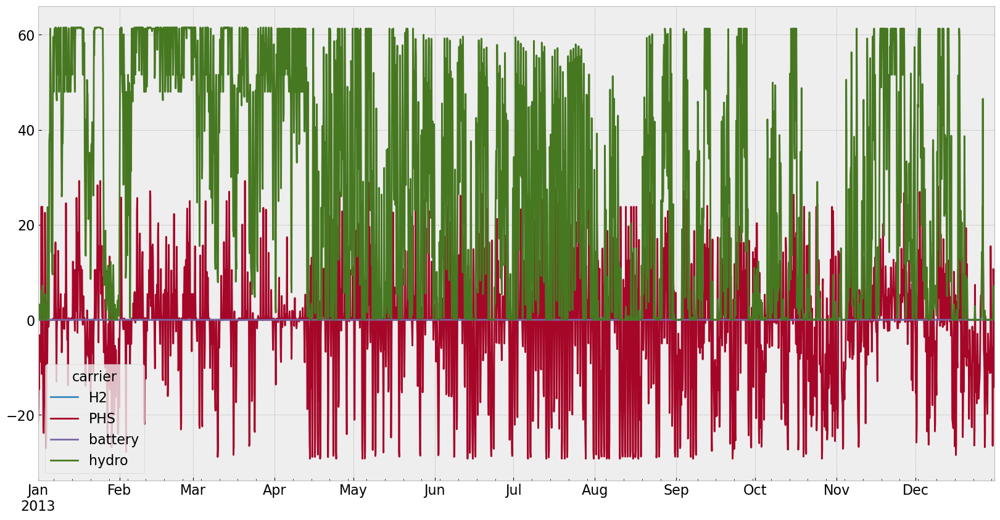

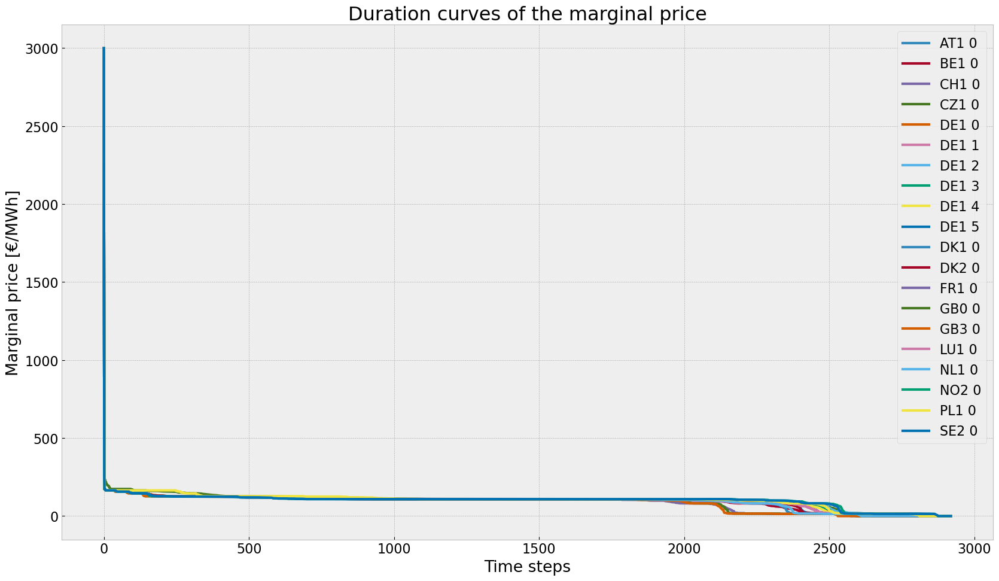

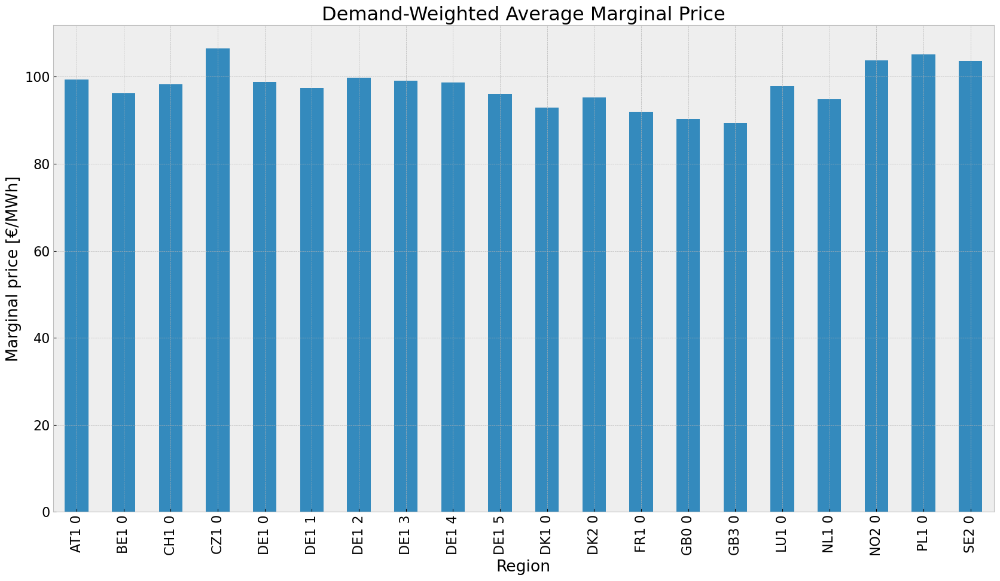

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


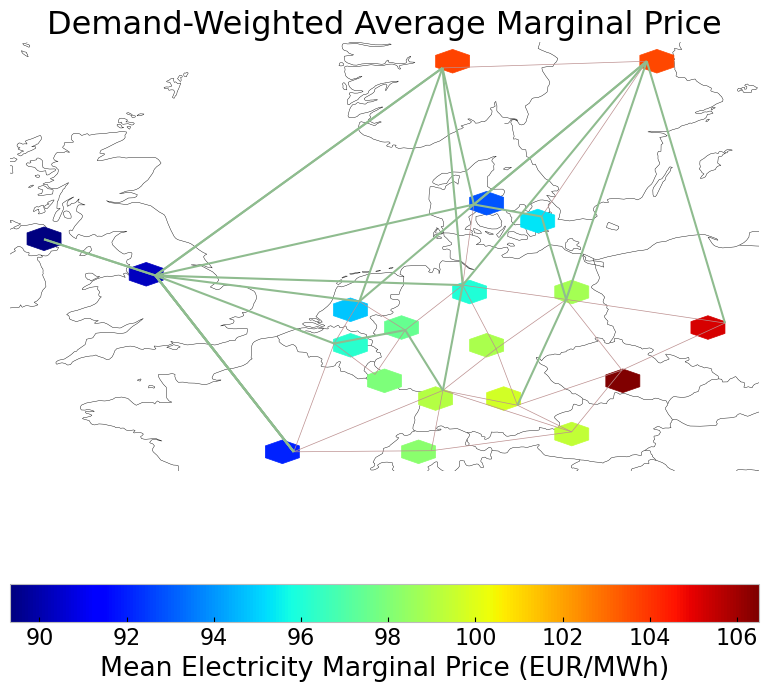

In [67]:
#state of charge
state_of_charge_plot(n2)
n2.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3).loc[pd.date_range(start="2013-01-01", end="2013-12-31",freq='3H')].plot(figsize=(20,10))
#price
price_dur_curve_plot(n2)
price_regions_table(n2)
price_regions(n2)
#emission
em_noinv =em_table(n2)
em_noinv

## 3. Model: rolling horizon foresight with no additional investment

In [68]:
n3= n2.copy()
n3.name = 'noinv_roll_wind'
horizon = 24
n3.storage_units['cyclic_state_of_charge'] = False
n3.storage_units['cyclic_state_of_charge_per_period'] = False


#solve or import
optimize.optimize_with_rolling_horizon(n3, horizon=horizon, overlap=0, solver_name='gurobi')
#filename = "noinv_roll_wind.nc"
#n3 = import_nc_file(directory, filename)
n3.name = 'noinv_roll_wind'

INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-01 00:00:00:2013-01-03 21:00:00] (1/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-djd4dc16.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-djd4dc16.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x284aa941


INFO:gurobipy:Model fingerprint: 0x284aa941


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 25491 rows and 6846 columns


INFO:gurobipy:Presolve removed 25491 rows and 6846 columns


Presolve time: 0.07s


INFO:gurobipy:Presolve time: 0.07s


Presolved: 1341 rows, 5658 columns, 9368 nonzeros


INFO:gurobipy:Presolved: 1341 rows, 5658 columns, 9368 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.903e+03


INFO:gurobipy: AA' NZ     : 3.903e+03


 Factor NZ  : 3.639e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.639e+04 (roughly 3 MB of memory)


 Factor Ops : 1.751e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.751e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.25401787e+11 -1.94722054e+11  9.69e+04 3.64e-12  1.88e+08     0s


INFO:gurobipy:   0   2.25401787e+11 -1.94722054e+11  9.69e+04 3.64e-12  1.88e+08     0s


   1   1.84548525e+10 -9.66357334e+10  6.93e+03 2.91e-11  1.96e+07     0s


INFO:gurobipy:   1   1.84548525e+10 -9.66357334e+10  6.93e+03 2.91e-11  1.96e+07     0s


   2   2.46300922e+09 -2.38652840e+10  4.31e+02 1.20e-10  2.73e+06     0s


INFO:gurobipy:   2   2.46300922e+09 -2.38652840e+10  4.31e+02 1.20e-10  2.73e+06     0s


   3   5.68434276e+08 -2.58182816e+09  1.97e+01 2.40e-10  2.84e+05     0s


INFO:gurobipy:   3   5.68434276e+08 -2.58182816e+09  1.97e+01 2.40e-10  2.84e+05     0s


   4   1.97980447e+08 -1.02454387e+09  1.65e+00 8.78e-11  1.08e+05     0s


INFO:gurobipy:   4   1.97980447e+08 -1.02454387e+09  1.65e+00 8.78e-11  1.08e+05     0s


   5   1.29751340e+08 -4.57547938e+08  8.30e-01 3.73e-11  5.19e+04     0s


INFO:gurobipy:   5   1.29751340e+08 -4.57547938e+08  8.30e-01 3.73e-11  5.19e+04     0s


   6   9.40272325e+07 -1.59449634e+08  4.36e-01 1.46e-11  2.24e+04     0s


INFO:gurobipy:   6   9.40272325e+07 -1.59449634e+08  4.36e-01 1.46e-11  2.24e+04     0s


   7   5.03420375e+07 -3.67687407e+07  3.84e-02 2.91e-11  7.69e+03     0s


INFO:gurobipy:   7   5.03420375e+07 -3.67687407e+07  3.84e-02 2.91e-11  7.69e+03     0s


   8   4.21808543e+07  6.08932726e+06  1.65e-02 2.91e-11  3.19e+03     0s


INFO:gurobipy:   8   4.21808543e+07  6.08932726e+06  1.65e-02 2.91e-11  3.19e+03     0s


   9   3.55690456e+07  2.09703429e+07  4.46e-03 1.46e-11  1.29e+03     0s


INFO:gurobipy:   9   3.55690456e+07  2.09703429e+07  4.46e-03 1.46e-11  1.29e+03     0s


  10   3.33650960e+07  2.79080629e+07  1.19e-03 1.46e-11  4.82e+02     0s


INFO:gurobipy:  10   3.33650960e+07  2.79080629e+07  1.19e-03 1.46e-11  4.82e+02     0s


  11   3.25644652e+07  3.05519022e+07  3.88e-04 1.46e-11  1.78e+02     0s


INFO:gurobipy:  11   3.25644652e+07  3.05519022e+07  3.88e-04 1.46e-11  1.78e+02     0s


  12   3.23610246e+07  3.13897817e+07  1.97e-04 2.91e-11  8.57e+01     0s


INFO:gurobipy:  12   3.23610246e+07  3.13897817e+07  1.97e-04 2.91e-11  8.57e+01     0s


  13   3.22660540e+07  3.18129873e+07  1.09e-04 1.46e-11  4.00e+01     0s


INFO:gurobipy:  13   3.22660540e+07  3.18129873e+07  1.09e-04 1.46e-11  4.00e+01     0s


  14   3.22118686e+07  3.19624270e+07  6.18e-05 1.46e-11  2.20e+01     0s


INFO:gurobipy:  14   3.22118686e+07  3.19624270e+07  6.18e-05 1.46e-11  2.20e+01     0s


  15   3.21637180e+07  3.20845885e+07  2.13e-05 2.91e-11  6.98e+00     0s


INFO:gurobipy:  15   3.21637180e+07  3.20845885e+07  2.13e-05 2.91e-11  6.98e+00     0s


  16   3.21419740e+07  3.21165059e+07  4.91e-06 2.91e-11  2.25e+00     0s


INFO:gurobipy:  16   3.21419740e+07  3.21165059e+07  4.91e-06 2.91e-11  2.25e+00     0s


  17   3.21372807e+07  3.21270758e+07  1.81e-06 2.91e-11  9.01e-01     0s


INFO:gurobipy:  17   3.21372807e+07  3.21270758e+07  1.81e-06 2.91e-11  9.01e-01     0s


INFO:gurobipy:


Barrier performed 17 iterations in 0.25 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 17 iterations in 0.25 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1984    3.2133955e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1984    3.2133955e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1984 iterations and 0.28 seconds (0.05 work units)


INFO:gurobipy:Solved in 1984 iterations and 0.28 seconds (0.05 work units)


Optimal objective  3.213395495e+07


INFO:gurobipy:Optimal objective  3.213395495e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.21e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-04 00:00:00:2013-01-06 21:00:00] (2/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 90.90it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nxjpj71a.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nxjpj71a.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x456fc340


INFO:gurobipy:Model fingerprint: 0x456fc340


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25503 rows and 6808 columns


INFO:gurobipy:Presolve removed 25503 rows and 6808 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1329 rows, 5696 columns, 9400 nonzeros


INFO:gurobipy:Presolved: 1329 rows, 5696 columns, 9400 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.896e+03


INFO:gurobipy: AA' NZ     : 3.896e+03


 Factor NZ  : 3.570e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.570e+04 (roughly 3 MB of memory)


 Factor Ops : 1.659e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.659e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.22980840e+11 -1.92160993e+11  1.03e+05 3.64e-12  1.79e+08     0s


INFO:gurobipy:   0   2.22980840e+11 -1.92160993e+11  1.03e+05 3.64e-12  1.79e+08     0s


   1   2.23767821e+10 -9.84228366e+10  8.93e+03 2.91e-11  2.15e+07     0s


INFO:gurobipy:   1   2.23767821e+10 -9.84228366e+10  8.93e+03 2.91e-11  2.15e+07     0s


   2   4.01046854e+09 -2.42542051e+10  8.75e+02 7.28e-11  3.24e+06     0s


INFO:gurobipy:   2   4.01046854e+09 -2.42542051e+10  8.75e+02 7.28e-11  3.24e+06     0s


   3   9.89545261e+08 -3.34866566e+09  6.81e+01 6.53e-10  4.08e+05     0s


INFO:gurobipy:   3   9.89545261e+08 -3.34866566e+09  6.81e+01 6.53e-10  4.08e+05     0s


   4   5.15275606e+08 -6.48950249e+08  7.77e+00 1.49e-10  1.03e+05     0s


INFO:gurobipy:   4   5.15275606e+08 -6.48950249e+08  7.77e+00 1.49e-10  1.03e+05     0s


   5   4.40143649e+08 -2.22797512e+08  4.82e+00 7.42e-11  5.86e+04     0s


INFO:gurobipy:   5   4.40143649e+08 -2.22797512e+08  4.82e+00 7.42e-11  5.86e+04     0s


   6   3.41115905e+08  8.78474076e+06  1.72e+00 3.50e-11  2.92e+04     0s


INFO:gurobipy:   6   3.41115905e+08  8.78474076e+06  1.72e+00 3.50e-11  2.92e+04     0s


   7   2.70699340e+08  1.65653885e+08  3.97e-01 2.91e-11  9.22e+03     0s


INFO:gurobipy:   7   2.70699340e+08  1.65653885e+08  3.97e-01 2.91e-11  9.22e+03     0s


   8   2.59408006e+08  1.99453455e+08  2.52e-01 1.46e-11  5.26e+03     0s


INFO:gurobipy:   8   2.59408006e+08  1.99453455e+08  2.52e-01 1.46e-11  5.26e+03     0s


   9   2.43306221e+08  2.20370959e+08  6.22e-02 1.46e-11  2.01e+03     0s


INFO:gurobipy:   9   2.43306221e+08  2.20370959e+08  6.22e-02 1.46e-11  2.01e+03     0s


  10   2.39340193e+08  2.27785970e+08  2.41e-02 1.46e-11  1.01e+03     0s


INFO:gurobipy:  10   2.39340193e+08  2.27785970e+08  2.41e-02 1.46e-11  1.01e+03     0s


  11   2.38114865e+08  2.33578417e+08  1.34e-02 2.91e-11  3.98e+02     0s


INFO:gurobipy:  11   2.38114865e+08  2.33578417e+08  1.34e-02 2.91e-11  3.98e+02     0s


  12   2.37293088e+08  2.34795617e+08  6.56e-03 1.46e-11  2.19e+02     0s


INFO:gurobipy:  12   2.37293088e+08  2.34795617e+08  6.56e-03 1.46e-11  2.19e+02     0s


  13   2.36725382e+08  2.35611973e+08  2.19e-03 2.91e-11  9.76e+01     0s


INFO:gurobipy:  13   2.36725382e+08  2.35611973e+08  2.19e-03 2.91e-11  9.76e+01     0s


  14   2.36524889e+08  2.36027877e+08  6.48e-04 1.46e-11  4.36e+01     0s


INFO:gurobipy:  14   2.36524889e+08  2.36027877e+08  6.48e-04 1.46e-11  4.36e+01     0s


  15   2.36431827e+08  2.36344347e+08  2.46e-05 2.91e-11  7.67e+00     0s


INFO:gurobipy:  15   2.36431827e+08  2.36344347e+08  2.46e-05 2.91e-11  7.67e+00     0s


  16   2.36417966e+08  2.36399087e+08  1.77e-06 1.46e-11  1.66e+00     0s


INFO:gurobipy:  16   2.36417966e+08  2.36399087e+08  1.77e-06 1.46e-11  1.66e+00     0s


INFO:gurobipy:


Barrier performed 16 iterations in 0.19 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 16 iterations in 0.19 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1784    2.3641613e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1784    2.3641613e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1784 iterations and 0.22 seconds (0.05 work units)


INFO:gurobipy:Solved in 1784 iterations and 0.22 seconds (0.05 work units)


Optimal objective  2.364161322e+08


INFO:gurobipy:Optimal objective  2.364161322e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.36e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-07 00:00:00:2013-01-09 21:00:00] (3/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.38s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3g0krvjs.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3g0krvjs.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xa669b4fd


INFO:gurobipy:Model fingerprint: 0xa669b4fd


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25509 rows and 6859 columns


INFO:gurobipy:Presolve removed 25509 rows and 6859 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1323 rows, 5645 columns, 9343 nonzeros


INFO:gurobipy:Presolved: 1323 rows, 5645 columns, 9343 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.890e+03


INFO:gurobipy: AA' NZ     : 3.890e+03


 Factor NZ  : 3.759e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.759e+04 (roughly 3 MB of memory)


 Factor Ops : 1.948e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.948e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.60645510e+11 -5.14671044e+11  1.11e+05 9.42e+03  5.01e+08     0s


INFO:gurobipy:   0   2.60645510e+11 -5.14671044e+11  1.11e+05 9.42e+03  5.01e+08     0s


   1   3.81887805e+10 -2.62777862e+11  7.79e+03 7.28e-11  5.30e+07     0s


INFO:gurobipy:   1   3.81887805e+10 -2.62777862e+11  7.79e+03 7.28e-11  5.30e+07     0s


   2   1.01188528e+10 -5.32839216e+10  4.60e+02 1.02e-10  6.66e+06     0s


INFO:gurobipy:   2   1.01188528e+10 -5.32839216e+10  4.60e+02 1.02e-10  6.66e+06     0s


   3   3.21561770e+09 -1.08799087e+10  7.28e+01 2.18e-10  1.33e+06     0s


INFO:gurobipy:   3   3.21561770e+09 -1.08799087e+10  7.28e+01 2.18e-10  1.33e+06     0s


   4   1.92379629e+09 -3.04002171e+09  2.66e+01 2.11e-10  4.55e+05     0s


INFO:gurobipy:   4   1.92379629e+09 -3.04002171e+09  2.66e+01 2.11e-10  4.55e+05     0s


   5   1.36362991e+09 -4.07174334e+08  9.12e+00 5.82e-11  1.59e+05     0s


INFO:gurobipy:   5   1.36362991e+09 -4.07174334e+08  9.12e+00 5.82e-11  1.59e+05     0s


   6   1.13191100e+09  4.35454861e+08  2.43e+00 4.37e-11  6.19e+04     0s


INFO:gurobipy:   6   1.13191100e+09  4.35454861e+08  2.43e+00 4.37e-11  6.19e+04     0s


   7   1.05406239e+09  7.62442951e+08  5.65e-01 2.91e-11  2.58e+04     0s


INFO:gurobipy:   7   1.05406239e+09  7.62442951e+08  5.65e-01 2.91e-11  2.58e+04     0s


   8   1.04282582e+09  8.51452108e+08  4.53e-01 1.46e-11  1.69e+04     0s


INFO:gurobipy:   8   1.04282582e+09  8.51452108e+08  4.53e-01 1.46e-11  1.69e+04     0s


   9   1.02927750e+09  8.86864813e+08  3.36e-01 2.91e-11  1.26e+04     0s


INFO:gurobipy:   9   1.02927750e+09  8.86864813e+08  3.36e-01 2.91e-11  1.26e+04     0s


  10   1.01957656e+09  9.31979005e+08  2.63e-01 2.91e-11  7.75e+03     0s


INFO:gurobipy:  10   1.01957656e+09  9.31979005e+08  2.63e-01 2.91e-11  7.75e+03     0s


  11   1.00933161e+09  9.44182061e+08  1.97e-01 1.46e-11  5.77e+03     0s


INFO:gurobipy:  11   1.00933161e+09  9.44182061e+08  1.97e-01 1.46e-11  5.77e+03     0s


  12   1.00105140e+09  9.48398148e+08  1.47e-01 1.46e-11  4.66e+03     0s


INFO:gurobipy:  12   1.00105140e+09  9.48398148e+08  1.47e-01 1.46e-11  4.66e+03     0s


  13   9.95237375e+08  9.51752929e+08  1.14e-01 2.91e-11  3.85e+03     0s


INFO:gurobipy:  13   9.95237375e+08  9.51752929e+08  1.14e-01 2.91e-11  3.85e+03     0s


INFO:gurobipy:


Barrier performed 13 iterations in 0.21 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 13 iterations in 0.21 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1944    9.7394939e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1944    9.7394939e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1944 iterations and 0.26 seconds (0.06 work units)


INFO:gurobipy:Solved in 1944 iterations and 0.26 seconds (0.06 work units)


Optimal objective  9.739493946e+08


INFO:gurobipy:Optimal objective  9.739493946e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 9.74e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-10 00:00:00:2013-01-12 21:00:00] (4/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 129.63it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-962o1j0r.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-962o1j0r.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xa4b5b29d


INFO:gurobipy:Model fingerprint: 0xa4b5b29d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25499 rows and 6789 columns


INFO:gurobipy:Presolve removed 25499 rows and 6789 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1333 rows, 5715 columns, 9423 nonzeros


INFO:gurobipy:Presolved: 1333 rows, 5715 columns, 9423 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.900e+03


INFO:gurobipy: AA' NZ     : 3.900e+03


 Factor NZ  : 3.665e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.665e+04 (roughly 3 MB of memory)


 Factor Ops : 1.718e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.718e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.70201643e+11 -5.13397042e+11  6.93e+04 9.67e+03  3.24e+08     0s


INFO:gurobipy:   0   1.70201643e+11 -5.13397042e+11  6.93e+04 9.67e+03  3.24e+08     0s


   1   2.66597498e+10 -2.25942743e+11  5.04e+03 5.82e-11  3.82e+07     0s


INFO:gurobipy:   1   2.66597498e+10 -2.25942743e+11  5.04e+03 5.82e-11  3.82e+07     0s


   2   7.66785180e+09 -4.58698620e+10  3.77e+02 3.93e-10  5.45e+06     0s


INFO:gurobipy:   2   7.66785180e+09 -4.58698620e+10  3.77e+02 3.93e-10  5.45e+06     0s


   3   2.67357456e+09 -1.33938715e+10  9.87e+01 1.38e-09  1.52e+06     0s


INFO:gurobipy:   3   2.67357456e+09 -1.33938715e+10  9.87e+01 1.38e-09  1.52e+06     0s


   4   1.47109497e+09 -1.30176850e+09  2.67e+01 2.18e-10  2.53e+05     0s


INFO:gurobipy:   4   1.47109497e+09 -1.30176850e+09  2.67e+01 2.18e-10  2.53e+05     0s


   5   1.20642617e+09 -1.22525809e+07  1.21e+01 8.37e-11  1.09e+05     0s


INFO:gurobipy:   5   1.20642617e+09 -1.22525809e+07  1.21e+01 8.37e-11  1.09e+05     0s


   6   1.08617664e+09  4.48185026e+08  6.83e+00 3.64e-11  5.66e+04     0s


INFO:gurobipy:   6   1.08617664e+09  4.48185026e+08  6.83e+00 3.64e-11  5.66e+04     0s


   7   9.39981170e+08  6.73743230e+08  1.87e+00 4.37e-11  2.34e+04     0s


INFO:gurobipy:   7   9.39981170e+08  6.73743230e+08  1.87e+00 4.37e-11  2.34e+04     0s


   8   9.04777155e+08  7.44948376e+08  1.17e+00 1.46e-11  1.40e+04     0s


INFO:gurobipy:   8   9.04777155e+08  7.44948376e+08  1.17e+00 1.46e-11  1.40e+04     0s


   9   8.54910932e+08  8.00506732e+08  2.70e-01 2.18e-11  4.76e+03     0s


INFO:gurobipy:   9   8.54910932e+08  8.00506732e+08  2.70e-01 2.18e-11  4.76e+03     0s


  10   8.41499975e+08  8.23079999e+08  1.02e-01 9.30e-12  1.61e+03     0s


INFO:gurobipy:  10   8.41499975e+08  8.23079999e+08  1.02e-01 9.30e-12  1.61e+03     0s


  11   8.36067429e+08  8.27239047e+08  4.44e-02 1.69e-11  7.72e+02     0s


INFO:gurobipy:  11   8.36067429e+08  8.27239047e+08  4.44e-02 1.69e-11  7.72e+02     0s


  12   8.33549723e+08  8.29952287e+08  1.81e-02 1.55e-11  3.14e+02     0s


INFO:gurobipy:  12   8.33549723e+08  8.29952287e+08  1.81e-02 1.55e-11  3.14e+02     0s


  13   8.32358915e+08  8.30882527e+08  6.26e-03 5.23e-12  1.29e+02     0s


INFO:gurobipy:  13   8.32358915e+08  8.30882527e+08  6.26e-03 5.23e-12  1.29e+02     0s


INFO:gurobipy:


Barrier performed 13 iterations in 0.22 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 13 iterations in 0.22 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1704    8.3167864e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1704    8.3167864e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1704 iterations and 0.25 seconds (0.05 work units)


INFO:gurobipy:Solved in 1704 iterations and 0.25 seconds (0.05 work units)


Optimal objective  8.316786380e+08


INFO:gurobipy:Optimal objective  8.316786380e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 8.32e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-13 00:00:00:2013-01-15 21:00:00] (5/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 68.62it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zi15t_av.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zi15t_av.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xdc47bef5


INFO:gurobipy:Model fingerprint: 0xdc47bef5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 9e+03]


INFO:gurobipy:  Bounds range     [1e+01, 9e+03]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25506 rows and 6833 columns


INFO:gurobipy:Presolve removed 25506 rows and 6833 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1326 rows, 5671 columns, 9372 nonzeros


INFO:gurobipy:Presolved: 1326 rows, 5671 columns, 9372 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.893e+03


INFO:gurobipy: AA' NZ     : 3.893e+03


 Factor NZ  : 3.551e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.551e+04 (roughly 3 MB of memory)


 Factor Ops : 1.614e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.614e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.54919566e+11 -5.13980340e+11  1.07e+05 9.82e+03  4.88e+08     0s


INFO:gurobipy:   0   2.54919566e+11 -5.13980340e+11  1.07e+05 9.82e+03  4.88e+08     0s


   1   3.71869688e+10 -2.67431869e+11  6.80e+03 7.28e-11  5.01e+07     0s


INFO:gurobipy:   1   3.71869688e+10 -2.67431869e+11  6.80e+03 7.28e-11  5.01e+07     0s


   2   1.06442384e+10 -5.40408495e+10  4.44e+02 1.89e-10  6.71e+06     0s


INFO:gurobipy:   2   1.06442384e+10 -5.40408495e+10  4.44e+02 1.89e-10  6.71e+06     0s


   3   3.74868434e+09 -9.08037750e+09  9.53e+01 3.78e-10  1.24e+06     0s


INFO:gurobipy:   3   3.74868434e+09 -9.08037750e+09  9.53e+01 3.78e-10  1.24e+06     0s


   4   1.86857856e+09 -1.90432950e+09  3.20e+01 1.89e-10  3.53e+05     0s


INFO:gurobipy:   4   1.86857856e+09 -1.90432950e+09  3.20e+01 1.89e-10  3.53e+05     0s


   5   1.43596631e+09  1.35890412e+08  9.75e+00 1.16e-10  1.17e+05     0s


INFO:gurobipy:   5   1.43596631e+09  1.35890412e+08  9.75e+00 1.16e-10  1.17e+05     0s


   6   1.27446020e+09  7.35482129e+08  2.97e+00 5.82e-11  4.79e+04     0s


INFO:gurobipy:   6   1.27446020e+09  7.35482129e+08  2.97e+00 5.82e-11  4.79e+04     0s


   7   1.24101152e+09  9.56479431e+08  1.81e+00 5.82e-11  2.52e+04     0s


INFO:gurobipy:   7   1.24101152e+09  9.56479431e+08  1.81e+00 5.82e-11  2.52e+04     0s


   8   1.21443598e+09  1.04616050e+09  1.16e+00 2.91e-11  1.49e+04     0s


INFO:gurobipy:   8   1.21443598e+09  1.04616050e+09  1.16e+00 2.91e-11  1.49e+04     0s


   9   1.19440812e+09  1.08707020e+09  7.70e-01 2.91e-11  9.47e+03     0s


INFO:gurobipy:   9   1.19440812e+09  1.08707020e+09  7.70e-01 2.91e-11  9.47e+03     0s


  10   1.18033892e+09  1.11597139e+09  5.41e-01 2.91e-11  5.68e+03     0s


INFO:gurobipy:  10   1.18033892e+09  1.11597139e+09  5.41e-01 2.91e-11  5.68e+03     0s


  11   1.17366082e+09  1.12617486e+09  4.45e-01 2.37e-11  4.19e+03     0s


INFO:gurobipy:  11   1.17366082e+09  1.12617486e+09  4.45e-01 2.37e-11  4.19e+03     0s


  12   1.16496852e+09  1.12917829e+09  3.25e-01 1.80e-11  3.16e+03     0s


INFO:gurobipy:  12   1.16496852e+09  1.12917829e+09  3.25e-01 1.80e-11  3.16e+03     0s


  13   1.15727537e+09  1.13289717e+09  2.20e-01 2.31e-11  2.15e+03     0s


INFO:gurobipy:  13   1.15727537e+09  1.13289717e+09  2.20e-01 2.31e-11  2.15e+03     0s


  14   1.15355369e+09  1.13398917e+09  1.70e-01 2.04e-11  1.72e+03     0s


INFO:gurobipy:  14   1.15355369e+09  1.13398917e+09  1.70e-01 2.04e-11  1.72e+03     0s


  15   1.14949585e+09  1.13606693e+09  1.19e-01 1.46e-11  1.18e+03     0s


INFO:gurobipy:  15   1.14949585e+09  1.13606693e+09  1.19e-01 1.46e-11  1.18e+03     0s


  16   1.14615016e+09  1.13763712e+09  7.67e-02 2.91e-11  7.50e+02     0s


INFO:gurobipy:  16   1.14615016e+09  1.13763712e+09  7.67e-02 2.91e-11  7.50e+02     0s


  17   1.14536244e+09  1.13843233e+09  6.72e-02 1.56e-11  6.11e+02     0s


INFO:gurobipy:  17   1.14536244e+09  1.13843233e+09  6.72e-02 1.56e-11  6.11e+02     0s


  18   1.14391007e+09  1.13958591e+09  4.64e-02 2.91e-11  3.81e+02     0s


INFO:gurobipy:  18   1.14391007e+09  1.13958591e+09  4.64e-02 2.91e-11  3.81e+02     0s


  19   1.14305241e+09  1.13993109e+09  3.44e-02 2.91e-11  2.75e+02     0s


INFO:gurobipy:  19   1.14305241e+09  1.13993109e+09  3.44e-02 2.91e-11  2.75e+02     0s


  20   1.14263284e+09  1.14010258e+09  2.87e-02 1.46e-11  2.23e+02     0s


INFO:gurobipy:  20   1.14263284e+09  1.14010258e+09  2.87e-02 1.46e-11  2.23e+02     0s


INFO:gurobipy:


Barrier performed 20 iterations in 0.25 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 20 iterations in 0.25 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1791    1.1405043e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1791    1.1405043e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1791 iterations and 0.29 seconds (0.06 work units)


INFO:gurobipy:Solved in 1791 iterations and 0.29 seconds (0.06 work units)


Optimal objective  1.140504301e+09


INFO:gurobipy:Optimal objective  1.140504301e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.14e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-16 00:00:00:2013-01-18 21:00:00] (6/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 132.06it/s]
INFO:linopy.io: Writing time: 0.38s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-i88r5bdt.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-i88r5bdt.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x385c28dd


INFO:gurobipy:Model fingerprint: 0x385c28dd


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 9e+03]


INFO:gurobipy:  Bounds range     [1e+01, 9e+03]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25513 rows and 6904 columns


INFO:gurobipy:Presolve removed 25513 rows and 6904 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1319 rows, 5600 columns, 9294 nonzeros


INFO:gurobipy:Presolved: 1319 rows, 5600 columns, 9294 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.886e+03


INFO:gurobipy: AA' NZ     : 3.886e+03


 Factor NZ  : 3.806e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.806e+04 (roughly 3 MB of memory)


 Factor Ops : 2.067e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.067e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.57245993e+11 -5.17197115e+11  1.10e+05 1.53e+04  5.04e+08     0s


INFO:gurobipy:   0   2.57245993e+11 -5.17197115e+11  1.10e+05 1.53e+04  5.04e+08     0s


   1   4.19176665e+10 -2.65768632e+11  7.43e+03 7.28e-11  5.31e+07     0s


INFO:gurobipy:   1   4.19176665e+10 -2.65768632e+11  7.43e+03 7.28e-11  5.31e+07     0s


   2   1.40954825e+10 -4.69748608e+10  4.75e+02 4.66e-10  6.55e+06     0s


INFO:gurobipy:   2   1.40954825e+10 -4.69748608e+10  4.75e+02 4.66e-10  6.55e+06     0s


   3   7.46029145e+09 -6.55365342e+09  9.08e+01 1.06e-09  1.38e+06     0s


INFO:gurobipy:   3   7.46029145e+09 -6.55365342e+09  9.08e+01 1.06e-09  1.38e+06     0s


   4   5.52472245e+09  1.56955627e+09  3.28e+01 3.35e-10  3.83e+05     0s


INFO:gurobipy:   4   5.52472245e+09  1.56955627e+09  3.28e+01 3.35e-10  3.83e+05     0s


   5   4.85723048e+09  3.01265481e+09  1.50e+01 2.47e-10  1.76e+05     0s


INFO:gurobipy:   5   4.85723048e+09  3.01265481e+09  1.50e+01 2.47e-10  1.76e+05     0s


   6   4.64981699e+09  3.78712518e+09  8.52e+00 1.16e-10  8.25e+04     0s


INFO:gurobipy:   6   4.64981699e+09  3.78712518e+09  8.52e+00 1.16e-10  8.25e+04     0s


   7   4.45968466e+09  4.12441388e+09  2.63e+00 1.02e-10  3.14e+04     0s


INFO:gurobipy:   7   4.45968466e+09  4.12441388e+09  2.63e+00 1.02e-10  3.14e+04     0s


   8   4.39120172e+09  4.26989278e+09  9.43e-01 1.16e-10  1.13e+04     0s


INFO:gurobipy:   8   4.39120172e+09  4.26989278e+09  9.43e-01 1.16e-10  1.13e+04     0s


   9   4.37945016e+09  4.30159073e+09  7.08e-01 4.37e-11  7.32e+03     0s


INFO:gurobipy:   9   4.37945016e+09  4.30159073e+09  7.08e-01 4.37e-11  7.32e+03     0s


  10   4.36837631e+09  4.31491351e+09  5.04e-01 4.37e-11  5.03e+03     0s


INFO:gurobipy:  10   4.36837631e+09  4.31491351e+09  5.04e-01 4.37e-11  5.03e+03     0s


  11   4.36312855e+09  4.32579027e+09  4.09e-01 2.91e-11  3.54e+03     0s


INFO:gurobipy:  11   4.36312855e+09  4.32579027e+09  4.09e-01 2.91e-11  3.54e+03     0s


  12   4.34708837e+09  4.32934884e+09  1.22e-01 2.91e-11  1.64e+03     0s


INFO:gurobipy:  12   4.34708837e+09  4.32934884e+09  1.22e-01 2.91e-11  1.64e+03     0s


  13   4.34315443e+09  4.33568888e+09  5.08e-02 2.91e-11  6.92e+02     0s


INFO:gurobipy:  13   4.34315443e+09  4.33568888e+09  5.08e-02 2.91e-11  6.92e+02     0s


  14   4.34123351e+09  4.33891264e+09  1.84e-02 2.91e-11  2.16e+02     0s


INFO:gurobipy:  14   4.34123351e+09  4.33891264e+09  1.84e-02 2.91e-11  2.16e+02     0s


  15   4.34031372e+09  4.33974718e+09  2.53e-03 2.91e-11  5.18e+01     0s


INFO:gurobipy:  15   4.34031372e+09  4.33974718e+09  2.53e-03 2.91e-11  5.18e+01     0s


  16   4.34024627e+09  4.33995084e+09  1.59e-03 2.91e-11  2.72e+01     0s


INFO:gurobipy:  16   4.34024627e+09  4.33995084e+09  1.59e-03 2.91e-11  2.72e+01     0s


INFO:gurobipy:


Barrier performed 16 iterations in 0.22 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 16 iterations in 0.22 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1920    4.3401307e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1920    4.3401307e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1920 iterations and 0.25 seconds (0.05 work units)


INFO:gurobipy:Solved in 1920 iterations and 0.25 seconds (0.05 work units)


Optimal objective  4.340130669e+09


INFO:gurobipy:Optimal objective  4.340130669e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.34e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-19 00:00:00:2013-01-21 21:00:00] (7/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 89.74it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-j_pnp05t.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-j_pnp05t.lp


Reading time = 0.11 seconds


INFO:gurobipy:Reading time = 0.11 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xc0f48500


INFO:gurobipy:Model fingerprint: 0xc0f48500


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 9e+03]


INFO:gurobipy:  Bounds range     [1e+01, 9e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25495 rows and 6853 columns


INFO:gurobipy:Presolve removed 25495 rows and 6853 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1337 rows, 5651 columns, 9363 nonzeros


INFO:gurobipy:Presolved: 1337 rows, 5651 columns, 9363 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.904e+03


INFO:gurobipy: AA' NZ     : 3.904e+03


 Factor NZ  : 3.521e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.521e+04 (roughly 3 MB of memory)


 Factor Ops : 1.541e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.541e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.11982182e+11 -1.90309458e+11  9.71e+04 3.64e-12  1.70e+08     0s


INFO:gurobipy:   0   2.11982182e+11 -1.90309458e+11  9.71e+04 3.64e-12  1.70e+08     0s


   1   2.43334780e+10 -9.58777894e+10  9.54e+03 2.91e-11  2.21e+07     0s


INFO:gurobipy:   1   2.43334780e+10 -9.58777894e+10  9.54e+03 2.91e-11  2.21e+07     0s


   2   5.25282414e+09 -2.50416518e+10  1.16e+03 1.82e-10  3.71e+06     0s


INFO:gurobipy:   2   5.25282414e+09 -2.50416518e+10  1.16e+03 1.82e-10  3.71e+06     0s


   3   1.05735653e+09 -3.42490389e+09  6.33e+01 2.86e-10  4.22e+05     0s


INFO:gurobipy:   3   1.05735653e+09 -3.42490389e+09  6.33e+01 2.86e-10  4.22e+05     0s


   4   5.99971507e+08 -6.22768176e+08  5.51e+00 7.46e-11  1.09e+05     0s


INFO:gurobipy:   4   5.99971507e+08 -6.22768176e+08  5.51e+00 7.46e-11  1.09e+05     0s


   5   4.97498831e+08 -7.59593795e+07  2.73e+00 3.07e-11  5.09e+04     0s


INFO:gurobipy:   5   4.97498831e+08 -7.59593795e+07  2.73e+00 3.07e-11  5.09e+04     0s


   6   4.43775877e+08  4.62937012e+07  1.59e+00 2.14e-11  3.52e+04     0s


INFO:gurobipy:   6   4.43775877e+08  4.62937012e+07  1.59e+00 2.14e-11  3.52e+04     0s


   7   3.92393725e+08  1.94959057e+08  7.38e-01 1.46e-11  1.75e+04     0s


INFO:gurobipy:   7   3.92393725e+08  1.94959057e+08  7.38e-01 1.46e-11  1.75e+04     0s


   8   3.62159579e+08  2.70037957e+08  3.37e-01 1.46e-11  8.15e+03     0s


INFO:gurobipy:   8   3.62159579e+08  2.70037957e+08  3.37e-01 1.46e-11  8.15e+03     0s


   9   3.46452258e+08  3.06604330e+08  1.61e-01 2.91e-11  3.52e+03     0s


INFO:gurobipy:   9   3.46452258e+08  3.06604330e+08  1.61e-01 2.91e-11  3.52e+03     0s


  10   3.32896798e+08  3.21906009e+08  2.74e-02 1.46e-11  9.71e+02     0s


INFO:gurobipy:  10   3.32896798e+08  3.21906009e+08  2.74e-02 1.46e-11  9.71e+02     0s


  11   3.30418671e+08  3.26046315e+08  8.70e-03 2.91e-11  3.86e+02     0s


INFO:gurobipy:  11   3.30418671e+08  3.26046315e+08  8.70e-03 2.91e-11  3.86e+02     0s


  12   3.29778422e+08  3.27860553e+08  4.61e-03 1.46e-11  1.69e+02     0s


INFO:gurobipy:  12   3.29778422e+08  3.27860553e+08  4.61e-03 1.46e-11  1.69e+02     0s


  13   3.29349145e+08  3.28372699e+08  1.96e-03 1.46e-11  8.63e+01     0s


INFO:gurobipy:  13   3.29349145e+08  3.28372699e+08  1.96e-03 1.46e-11  8.63e+01     0s


  14   3.29173052e+08  3.28773953e+08  9.25e-04 1.46e-11  3.53e+01     0s


INFO:gurobipy:  14   3.29173052e+08  3.28773953e+08  9.25e-04 1.46e-11  3.53e+01     0s


  15   3.29056966e+08  3.28910381e+08  2.44e-04 1.46e-11  1.30e+01     0s


INFO:gurobipy:  15   3.29056966e+08  3.28910381e+08  2.44e-04 1.46e-11  1.30e+01     0s


INFO:gurobipy:


Barrier performed 15 iterations in 0.16 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 15 iterations in 0.16 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2152    3.2900922e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2152    3.2900922e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2152 iterations and 0.19 seconds (0.06 work units)


INFO:gurobipy:Solved in 2152 iterations and 0.19 seconds (0.06 work units)


Optimal objective  3.290092172e+08


INFO:gurobipy:Optimal objective  3.290092172e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.29e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-22 00:00:00:2013-01-24 21:00:00] (8/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.38s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fjp2c9j5.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fjp2c9j5.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x2cd26133


INFO:gurobipy:Model fingerprint: 0x2cd26133


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 9e+03]


INFO:gurobipy:  Bounds range     [1e+01, 9e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25504 rows and 6897 columns


INFO:gurobipy:Presolve removed 25504 rows and 6897 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1328 rows, 5607 columns, 9310 nonzeros


INFO:gurobipy:Presolved: 1328 rows, 5607 columns, 9310 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.895e+03


INFO:gurobipy: AA' NZ     : 3.895e+03


 Factor NZ  : 3.517e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.517e+04 (roughly 3 MB of memory)


 Factor Ops : 1.542e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.542e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.04785605e+11 -5.00844368e+11  8.31e+04 9.71e+03  3.81e+08     0s


INFO:gurobipy:   0   2.04785605e+11 -5.00844368e+11  8.31e+04 9.71e+03  3.81e+08     0s


   1   3.53752092e+10 -2.33835355e+11  5.93e+03 5.82e-11  4.34e+07     0s


INFO:gurobipy:   1   3.53752092e+10 -2.33835355e+11  5.93e+03 5.82e-11  4.34e+07     0s


   2   1.27643733e+10 -4.40086216e+10  4.09e+02 4.66e-10  5.96e+06     0s


INFO:gurobipy:   2   1.27643733e+10 -4.40086216e+10  4.09e+02 4.66e-10  5.96e+06     0s


   3   7.16357108e+09 -5.27265218e+09  9.21e+01 1.09e-09  1.23e+06     0s


INFO:gurobipy:   3   7.16357108e+09 -5.27265218e+09  9.21e+01 1.09e-09  1.23e+06     0s


   4   5.21741329e+09  2.02856682e+09  2.74e+01 4.07e-10  3.11e+05     0s


INFO:gurobipy:   4   5.21741329e+09  2.02856682e+09  2.74e+01 4.07e-10  3.11e+05     0s


   5   4.68476322e+09  3.36074117e+09  1.20e+01 3.06e-10  1.28e+05     0s


INFO:gurobipy:   5   4.68476322e+09  3.36074117e+09  1.20e+01 3.06e-10  1.28e+05     0s


   6   4.47509517e+09  3.78240819e+09  5.72e+00 1.16e-10  6.61e+04     0s


INFO:gurobipy:   6   4.47509517e+09  3.78240819e+09  5.72e+00 1.16e-10  6.61e+04     0s


   7   4.36468917e+09  4.07448484e+09  2.32e+00 8.73e-11  2.75e+04     0s


INFO:gurobipy:   7   4.36468917e+09  4.07448484e+09  2.32e+00 8.73e-11  2.75e+04     0s


   8   4.34239612e+09  4.18860315e+09  1.67e+00 8.73e-11  1.48e+04     0s


INFO:gurobipy:   8   4.34239612e+09  4.18860315e+09  1.67e+00 8.73e-11  1.48e+04     0s


INFO:gurobipy:


Barrier performed 8 iterations in 0.12 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 8 iterations in 0.12 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1804    4.2832421e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1804    4.2832421e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1804 iterations and 0.17 seconds (0.05 work units)


INFO:gurobipy:Solved in 1804 iterations and 0.17 seconds (0.05 work units)


Optimal objective  4.283242056e+09


INFO:gurobipy:Optimal objective  4.283242056e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.28e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-25 00:00:00:2013-01-27 21:00:00] (9/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 127.27it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wstaglc2.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wstaglc2.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x3e3c0bee


INFO:gurobipy:Model fingerprint: 0x3e3c0bee


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25503 rows and 6948 columns


INFO:gurobipy:Presolve removed 25503 rows and 6948 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1329 rows, 5556 columns, 9260 nonzeros


INFO:gurobipy:Presolved: 1329 rows, 5556 columns, 9260 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.896e+03


INFO:gurobipy: AA' NZ     : 3.896e+03


 Factor NZ  : 3.640e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.640e+04 (roughly 3 MB of memory)


 Factor Ops : 1.722e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.722e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.09347756e+11 -1.85530442e+11  9.29e+04 3.64e-12  1.73e+08     0s


INFO:gurobipy:   0   2.09347756e+11 -1.85530442e+11  9.29e+04 3.64e-12  1.73e+08     0s


   1   2.89167611e+10 -8.91582602e+10  1.12e+04 2.91e-11  2.50e+07     0s


INFO:gurobipy:   1   2.89167611e+10 -8.91582602e+10  1.12e+04 2.91e-11  2.50e+07     0s


   2   6.89383158e+09 -2.55615986e+10  1.72e+03 4.66e-10  4.60e+06     0s


INFO:gurobipy:   2   6.89383158e+09 -2.55615986e+10  1.72e+03 4.66e-10  4.60e+06     0s


   3   3.41555205e+09 -9.67016324e+09  6.20e+02 5.68e-10  1.63e+06     0s


INFO:gurobipy:   3   3.41555205e+09 -9.67016324e+09  6.20e+02 5.68e-10  1.63e+06     0s


   4   2.35698385e+09 -3.19316689e+09  2.85e+02 2.98e-10  6.61e+05     0s


INFO:gurobipy:   4   2.35698385e+09 -3.19316689e+09  2.85e+02 2.98e-10  6.61e+05     0s


   5   1.97119403e+09 -6.60838662e+08  1.71e+02 3.35e-10  3.13e+05     0s


INFO:gurobipy:   5   1.97119403e+09 -6.60838662e+08  1.71e+02 3.35e-10  3.13e+05     0s


   6   1.62677205e+09  4.33949277e+08  7.62e+01 2.47e-10  1.36e+05     0s


INFO:gurobipy:   6   1.62677205e+09  4.33949277e+08  7.62e+01 2.47e-10  1.36e+05     0s


   7   1.40357139e+09  8.76437836e+08  1.17e+01 1.60e-10  5.11e+04     0s


INFO:gurobipy:   7   1.40357139e+09  8.76437836e+08  1.17e+01 1.60e-10  5.11e+04     0s


   8   1.36358377e+09  1.11890034e+09  6.41e+00 1.60e-10  2.37e+04     0s


INFO:gurobipy:   8   1.36358377e+09  1.11890034e+09  6.41e+00 1.60e-10  2.37e+04     0s


   9   1.32302956e+09  1.23620001e+09  1.67e+00 2.62e-10  8.19e+03     0s


INFO:gurobipy:   9   1.32302956e+09  1.23620001e+09  1.67e+00 2.62e-10  8.19e+03     0s


  10   1.30758468e+09  1.27122676e+09  4.23e-01 1.02e-10  3.36e+03     0s


INFO:gurobipy:  10   1.30758468e+09  1.27122676e+09  4.23e-01 1.02e-10  3.36e+03     0s


  11   1.30394066e+09  1.28812484e+09  1.85e-01 7.28e-11  1.46e+03     0s


INFO:gurobipy:  11   1.30394066e+09  1.28812484e+09  1.85e-01 7.28e-11  1.46e+03     0s


  12   1.30301749e+09  1.29149296e+09  1.30e-01 7.28e-11  1.06e+03     0s


INFO:gurobipy:  12   1.30301749e+09  1.29149296e+09  1.30e-01 7.28e-11  1.06e+03     0s


  13   1.30239294e+09  1.29291922e+09  9.66e-02 7.28e-11  8.72e+02     0s


INFO:gurobipy:  13   1.30239294e+09  1.29291922e+09  9.66e-02 7.28e-11  8.72e+02     0s


  14   1.30215394e+09  1.29534330e+09  8.41e-02 4.37e-11  6.30e+02     0s


INFO:gurobipy:  14   1.30215394e+09  1.29534330e+09  8.41e-02 4.37e-11  6.30e+02     0s


  15   1.30110162e+09  1.29813854e+09  2.63e-02 5.82e-11  2.72e+02     0s


INFO:gurobipy:  15   1.30110162e+09  1.29813854e+09  2.63e-02 5.82e-11  2.72e+02     0s


  16   1.30081141e+09  1.29948022e+09  1.35e-02 5.82e-11  1.23e+02     0s


INFO:gurobipy:  16   1.30081141e+09  1.29948022e+09  1.35e-02 5.82e-11  1.23e+02     0s


  17   1.30052664e+09  1.29968485e+09  3.84e-03 4.37e-11  7.65e+01     0s


INFO:gurobipy:  17   1.30052664e+09  1.29968485e+09  3.84e-03 4.37e-11  7.65e+01     0s


  18   1.30047890e+09  1.29990197e+09  2.37e-03 4.37e-11  5.24e+01     0s


INFO:gurobipy:  18   1.30047890e+09  1.29990197e+09  2.37e-03 4.37e-11  5.24e+01     0s


  19   1.30042048e+09  1.30017124e+09  7.04e-04 4.37e-11  2.25e+01     0s


INFO:gurobipy:  19   1.30042048e+09  1.30017124e+09  7.04e-04 4.37e-11  2.25e+01     0s


INFO:gurobipy:


Barrier performed 19 iterations in 0.21 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 19 iterations in 0.21 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2178    1.3003858e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2178    1.3003858e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2178 iterations and 0.24 seconds (0.06 work units)


INFO:gurobipy:Solved in 2178 iterations and 0.24 seconds (0.06 work units)


Optimal objective  1.300385831e+09


INFO:gurobipy:Optimal objective  1.300385831e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.30e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-28 00:00:00:2013-01-30 21:00:00] (10/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-y646p82g.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-y646p82g.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x0a8da94b


INFO:gurobipy:Model fingerprint: 0x0a8da94b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 25506 rows and 7002 columns


INFO:gurobipy:Presolve removed 25506 rows and 7002 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1326 rows, 5502 columns, 9167 nonzeros


INFO:gurobipy:Presolved: 1326 rows, 5502 columns, 9167 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.863e+03


INFO:gurobipy: AA' NZ     : 3.863e+03


 Factor NZ  : 3.501e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.501e+04 (roughly 3 MB of memory)


 Factor Ops : 1.580e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.580e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.36727610e+11 -1.86997130e+11  6.16e+04 9.02e-02  1.24e+08     0s


INFO:gurobipy:   0   1.36727610e+11 -1.86997130e+11  6.16e+04 9.02e-02  1.24e+08     0s


   1   1.50309521e+10 -8.48389747e+10  5.56e+03 2.91e-11  1.63e+07     0s


INFO:gurobipy:   1   1.50309521e+10 -8.48389747e+10  5.56e+03 2.91e-11  1.63e+07     0s


   2   2.80702443e+09 -2.05425500e+10  5.33e+02 6.55e-11  2.60e+06     0s


INFO:gurobipy:   2   2.80702443e+09 -2.05425500e+10  5.33e+02 6.55e-11  2.60e+06     0s


   3   6.14779026e+08 -3.12904800e+09  3.28e+01 2.36e-10  3.52e+05     0s


INFO:gurobipy:   3   6.14779026e+08 -3.12904800e+09  3.28e+01 2.36e-10  3.52e+05     0s


   4   2.46578526e+08 -1.11594810e+09  3.20e+00 8.37e-11  1.24e+05     0s


INFO:gurobipy:   4   2.46578526e+08 -1.11594810e+09  3.20e+00 8.37e-11  1.24e+05     0s


   5   1.65902580e+08 -5.94205008e+08  1.61e+00 4.18e-11  6.92e+04     0s


INFO:gurobipy:   5   1.65902580e+08 -5.94205008e+08  1.61e+00 4.18e-11  6.92e+04     0s


   6   1.08052318e+08 -2.93970093e+08  7.51e-01 2.00e-11  3.65e+04     0s


INFO:gurobipy:   6   1.08052318e+08 -2.93970093e+08  7.51e-01 2.00e-11  3.65e+04     0s


   7   6.39983356e+07 -8.96937092e+07  1.95e-01 1.46e-11  1.40e+04     0s


INFO:gurobipy:   7   6.39983356e+07 -8.96937092e+07  1.95e-01 1.46e-11  1.40e+04     0s


   8   5.20076572e+07 -4.83010035e+07  1.17e-01 1.46e-11  9.11e+03     0s


INFO:gurobipy:   8   5.20076572e+07 -4.83010035e+07  1.17e-01 1.46e-11  9.11e+03     0s


   9   4.10321113e+07 -4.74590422e+06  5.90e-02 2.91e-11  4.16e+03     0s


INFO:gurobipy:   9   4.10321113e+07 -4.74590422e+06  5.90e-02 2.91e-11  4.16e+03     0s


  10   3.30090221e+07  1.59687732e+07  1.95e-02 2.91e-11  1.55e+03     0s


INFO:gurobipy:  10   3.30090221e+07  1.59687732e+07  1.95e-02 2.91e-11  1.55e+03     0s


  11   3.06566187e+07  1.95353065e+07  1.04e-02 1.46e-11  1.01e+03     0s


INFO:gurobipy:  11   3.06566187e+07  1.95353065e+07  1.04e-02 1.46e-11  1.01e+03     0s


  12   2.99352761e+07  2.33934580e+07  7.88e-03 1.46e-11  5.94e+02     0s


INFO:gurobipy:  12   2.99352761e+07  2.33934580e+07  7.88e-03 1.46e-11  5.94e+02     0s


  13   2.91693235e+07  2.50487409e+07  5.40e-03 2.91e-11  3.74e+02     0s


INFO:gurobipy:  13   2.91693235e+07  2.50487409e+07  5.40e-03 2.91e-11  3.74e+02     0s


  14   2.83195345e+07  2.61225230e+07  2.70e-03 1.46e-11  1.99e+02     0s


INFO:gurobipy:  14   2.83195345e+07  2.61225230e+07  2.70e-03 1.46e-11  1.99e+02     0s


  15   2.77855792e+07  2.65913027e+07  1.01e-03 1.46e-11  1.08e+02     0s


INFO:gurobipy:  15   2.77855792e+07  2.65913027e+07  1.01e-03 1.46e-11  1.08e+02     0s


  16   2.75830924e+07  2.70838669e+07  3.90e-04 1.46e-11  4.53e+01     0s


INFO:gurobipy:  16   2.75830924e+07  2.70838669e+07  3.90e-04 1.46e-11  4.53e+01     0s


  17   2.74812147e+07  2.72854723e+07  1.13e-04 1.46e-11  1.78e+01     0s


INFO:gurobipy:  17   2.74812147e+07  2.72854723e+07  1.13e-04 1.46e-11  1.78e+01     0s


  18   2.74582956e+07  2.73454369e+07  5.83e-05 1.46e-11  1.02e+01     0s


INFO:gurobipy:  18   2.74582956e+07  2.73454369e+07  5.83e-05 1.46e-11  1.02e+01     0s


  19   2.74436840e+07  2.73869139e+07  2.67e-05 1.46e-11  5.15e+00     0s


INFO:gurobipy:  19   2.74436840e+07  2.73869139e+07  2.67e-05 1.46e-11  5.15e+00     0s


  20   2.74368479e+07  2.74136839e+07  1.29e-05 1.46e-11  2.10e+00     0s


INFO:gurobipy:  20   2.74368479e+07  2.74136839e+07  1.29e-05 1.46e-11  2.10e+00     0s


  21   2.74321073e+07  2.74231578e+07  3.68e-06 1.46e-11  8.12e-01     0s


INFO:gurobipy:  21   2.74321073e+07  2.74231578e+07  3.68e-06 1.46e-11  8.12e-01     0s


INFO:gurobipy:


Barrier performed 21 iterations in 0.22 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 21 iterations in 0.22 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2265    2.7429734e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2265    2.7429734e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2265 iterations and 0.27 seconds (0.07 work units)


INFO:gurobipy:Solved in 2265 iterations and 0.27 seconds (0.07 work units)


Optimal objective  2.742973406e+07


INFO:gurobipy:Optimal objective  2.742973406e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.74e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-31 00:00:00:2013-02-02 21:00:00] (11/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.38s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1xqj8jpf.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1xqj8jpf.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x16fd305b


INFO:gurobipy:Model fingerprint: 0x16fd305b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25527 rows and 6865 columns


INFO:gurobipy:Presolve removed 25527 rows and 6865 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1305 rows, 5639 columns, 9301 nonzeros


INFO:gurobipy:Presolved: 1305 rows, 5639 columns, 9301 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.854e+03


INFO:gurobipy: AA' NZ     : 3.854e+03


 Factor NZ  : 3.532e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.532e+04 (roughly 3 MB of memory)


 Factor Ops : 1.604e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.604e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.01424218e+11 -5.16485844e+11  9.14e+04 1.14e+04  4.22e+08     0s


INFO:gurobipy:   0   2.01424218e+11 -5.16485844e+11  9.14e+04 1.14e+04  4.22e+08     0s


   1   2.98908123e+10 -2.65923976e+11  6.02e+03 5.82e-11  4.66e+07     0s


INFO:gurobipy:   1   2.98908123e+10 -2.65923976e+11  6.02e+03 5.82e-11  4.66e+07     0s


   2   7.35911453e+09 -5.12028966e+10  4.38e+02 1.46e-10  6.14e+06     0s


INFO:gurobipy:   2   7.35911453e+09 -5.12028966e+10  4.38e+02 1.46e-10  6.14e+06     0s


   3   1.92704230e+09 -1.30182558e+10  8.08e+01 3.64e-10  1.41e+06     0s


INFO:gurobipy:   3   1.92704230e+09 -1.30182558e+10  8.08e+01 3.64e-10  1.41e+06     0s


   4   9.43763396e+08 -1.73513906e+09  5.52e+00 1.16e-10  2.39e+05     0s


INFO:gurobipy:   4   9.43763396e+08 -1.73513906e+09  5.52e+00 1.16e-10  2.39e+05     0s


   5   7.34603966e+08 -3.50853088e+08  1.98e+00 5.09e-11  9.65e+04     0s


INFO:gurobipy:   5   7.34603966e+08 -3.50853088e+08  1.98e+00 5.09e-11  9.65e+04     0s


   6   6.25977924e+08  8.31422355e+07  9.27e-01 2.91e-11  4.82e+04     0s


INFO:gurobipy:   6   6.25977924e+08  8.31422355e+07  9.27e-01 2.91e-11  4.82e+04     0s


   7   5.14551123e+08  3.10931788e+08  1.60e-01 1.46e-11  1.80e+04     0s


INFO:gurobipy:   7   5.14551123e+08  3.10931788e+08  1.60e-01 1.46e-11  1.80e+04     0s


   8   4.94727040e+08  3.85898688e+08  1.01e-01 1.46e-11  9.64e+03     0s


INFO:gurobipy:   8   4.94727040e+08  3.85898688e+08  1.01e-01 1.46e-11  9.64e+03     0s


   9   4.76153531e+08  4.27256947e+08  4.72e-02 1.46e-11  4.33e+03     0s


INFO:gurobipy:   9   4.76153531e+08  4.27256947e+08  4.72e-02 1.46e-11  4.33e+03     0s


  10   4.68435116e+08  4.41216576e+08  2.74e-02 1.46e-11  2.41e+03     0s


INFO:gurobipy:  10   4.68435116e+08  4.41216576e+08  2.74e-02 1.46e-11  2.41e+03     0s


  11   4.64616082e+08  4.49400831e+08  1.79e-02 1.46e-11  1.35e+03     0s


INFO:gurobipy:  11   4.64616082e+08  4.49400831e+08  1.79e-02 1.46e-11  1.35e+03     0s


  12   4.62626355e+08  4.52185050e+08  1.31e-02 1.64e-11  9.25e+02     0s


INFO:gurobipy:  12   4.62626355e+08  4.52185050e+08  1.31e-02 1.64e-11  9.25e+02     0s


  13   4.60114604e+08  4.54157714e+08  7.17e-03 1.46e-11  5.28e+02     0s


INFO:gurobipy:  13   4.60114604e+08  4.54157714e+08  7.17e-03 1.46e-11  5.28e+02     0s


  14   4.58815603e+08  4.55093777e+08  4.02e-03 1.46e-11  3.30e+02     0s


INFO:gurobipy:  14   4.58815603e+08  4.55093777e+08  4.02e-03 1.46e-11  3.30e+02     0s


  15   4.57955407e+08  4.55731612e+08  1.99e-03 1.46e-11  1.97e+02     0s


INFO:gurobipy:  15   4.57955407e+08  4.55731612e+08  1.99e-03 1.46e-11  1.97e+02     0s


  16   4.57546723e+08  4.56812163e+08  1.01e-03 2.91e-11  6.51e+01     0s


INFO:gurobipy:  16   4.57546723e+08  4.56812163e+08  1.01e-03 2.91e-11  6.51e+01     0s


  17   4.57205380e+08  4.56936212e+08  2.72e-04 1.46e-11  2.38e+01     0s


INFO:gurobipy:  17   4.57205380e+08  4.56936212e+08  2.72e-04 1.46e-11  2.38e+01     0s


  18   4.57163842e+08  4.56993001e+08  1.84e-04 1.46e-11  1.51e+01     0s


INFO:gurobipy:  18   4.57163842e+08  4.56993001e+08  1.84e-04 1.46e-11  1.51e+01     0s


  19   4.57123361e+08  4.57024963e+08  9.92e-05 1.46e-11  8.71e+00     0s


INFO:gurobipy:  19   4.57123361e+08  4.57024963e+08  9.92e-05 1.46e-11  8.71e+00     0s


  20   4.57103599e+08  4.57044009e+08  5.97e-05 2.91e-11  5.28e+00     0s


INFO:gurobipy:  20   4.57103599e+08  4.57044009e+08  5.97e-05 2.91e-11  5.28e+00     0s


  21   4.57080055e+08  4.57059175e+08  1.22e-05 2.91e-11  1.85e+00     0s


INFO:gurobipy:  21   4.57080055e+08  4.57059175e+08  1.22e-05 2.91e-11  1.85e+00     0s


  22   4.57076177e+08  4.57069258e+08  5.86e-06 2.91e-11  6.13e-01     0s


INFO:gurobipy:  22   4.57076177e+08  4.57069258e+08  5.86e-06 2.91e-11  6.13e-01     0s


INFO:gurobipy:


Barrier performed 22 iterations in 0.25 seconds (0.06 work units)


INFO:gurobipy:Barrier performed 22 iterations in 0.25 seconds (0.06 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2039    4.5707252e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2039    4.5707252e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2039 iterations and 0.27 seconds (0.07 work units)


INFO:gurobipy:Solved in 2039 iterations and 0.27 seconds (0.07 work units)


Optimal objective  4.570725236e+08


INFO:gurobipy:Optimal objective  4.570725236e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.57e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-03 00:00:00:2013-02-05 21:00:00] (12/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 114.75it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1h79ifnl.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1h79ifnl.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x03bcad16


INFO:gurobipy:Model fingerprint: 0x03bcad16


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25549 rows and 6788 columns


INFO:gurobipy:Presolve removed 25549 rows and 6788 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1283 rows, 5716 columns, 9328 nonzeros


INFO:gurobipy:Presolved: 1283 rows, 5716 columns, 9328 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.804e+03


INFO:gurobipy: AA' NZ     : 3.804e+03


 Factor NZ  : 3.605e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.605e+04 (roughly 3 MB of memory)


 Factor Ops : 1.808e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.808e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.95608682e+11 -1.86418125e+11  8.78e+04 3.64e-12  1.55e+08     0s


INFO:gurobipy:   0   1.95608682e+11 -1.86418125e+11  8.78e+04 3.64e-12  1.55e+08     0s


   1   1.84646529e+10 -8.78253830e+10  6.77e+03 2.91e-11  1.73e+07     0s


INFO:gurobipy:   1   1.84646529e+10 -8.78253830e+10  6.77e+03 2.91e-11  1.73e+07     0s


   2   4.11947078e+09 -2.09079738e+10  8.09e+02 3.86e-10  2.87e+06     0s


INFO:gurobipy:   2   4.11947078e+09 -2.09079738e+10  8.09e+02 3.86e-10  2.87e+06     0s


   3   1.17065938e+09 -2.41391460e+09  8.22e+01 4.49e-10  3.45e+05     0s


INFO:gurobipy:   3   1.17065938e+09 -2.41391460e+09  8.22e+01 4.49e-10  3.45e+05     0s


   4   7.10904712e+08 -4.40145091e+08  1.47e+01 1.27e-10  1.03e+05     0s


INFO:gurobipy:   4   7.10904712e+08 -4.40145091e+08  1.47e+01 1.27e-10  1.03e+05     0s


   5   6.25731904e+08  2.19579325e+07  8.60e+00 5.87e-11  5.36e+04     0s


INFO:gurobipy:   5   6.25731904e+08  2.19579325e+07  8.60e+00 5.87e-11  5.36e+04     0s


   6   5.35724438e+08  1.88644559e+08  3.75e+00 3.50e-11  3.06e+04     0s


INFO:gurobipy:   6   5.35724438e+08  1.88644559e+08  3.75e+00 3.50e-11  3.06e+04     0s


   7   4.79495823e+08  3.08716555e+08  1.40e+00 1.68e-11  1.50e+04     0s


INFO:gurobipy:   7   4.79495823e+08  3.08716555e+08  1.40e+00 1.68e-11  1.50e+04     0s


   8   4.53756173e+08  3.73593480e+08  6.36e-01 1.46e-11  7.02e+03     0s


INFO:gurobipy:   8   4.53756173e+08  3.73593480e+08  6.36e-01 1.46e-11  7.02e+03     0s


   9   4.37557657e+08  4.02606846e+08  2.21e-01 1.46e-11  3.06e+03     0s


INFO:gurobipy:   9   4.37557657e+08  4.02606846e+08  2.21e-01 1.46e-11  3.06e+03     0s


  10   4.28608788e+08  4.18323153e+08  4.06e-02 2.91e-11  8.99e+02     0s


INFO:gurobipy:  10   4.28608788e+08  4.18323153e+08  4.06e-02 2.91e-11  8.99e+02     0s


  11   4.26997540e+08  4.22672656e+08  1.66e-02 1.46e-11  3.78e+02     0s


INFO:gurobipy:  11   4.26997540e+08  4.22672656e+08  1.66e-02 1.46e-11  3.78e+02     0s


  12   4.26540324e+08  4.23908310e+08  1.08e-02 2.91e-11  2.30e+02     0s


INFO:gurobipy:  12   4.26540324e+08  4.23908310e+08  1.08e-02 2.91e-11  2.30e+02     0s


  13   4.26234806e+08  4.24813059e+08  6.73e-03 2.91e-11  1.24e+02     0s


INFO:gurobipy:  13   4.26234806e+08  4.24813059e+08  6.73e-03 2.91e-11  1.24e+02     0s


  14   4.25921804e+08  4.25299896e+08  2.91e-03 2.91e-11  5.44e+01     0s


INFO:gurobipy:  14   4.25921804e+08  4.25299896e+08  2.91e-03 2.91e-11  5.44e+01     0s


  15   4.25762682e+08  4.25480456e+08  9.56e-04 1.46e-11  2.47e+01     0s


INFO:gurobipy:  15   4.25762682e+08  4.25480456e+08  9.56e-04 1.46e-11  2.47e+01     0s


  16   4.25701342e+08  4.25602065e+08  2.61e-04 1.46e-11  8.68e+00     0s


INFO:gurobipy:  16   4.25701342e+08  4.25602065e+08  2.61e-04 1.46e-11  8.68e+00     0s


  17   4.25690071e+08  4.25642157e+08  1.49e-04 2.91e-11  4.19e+00     0s


INFO:gurobipy:  17   4.25690071e+08  4.25642157e+08  1.49e-04 2.91e-11  4.19e+00     0s


  18   4.25682389e+08  4.25654591e+08  7.89e-05 1.46e-11  2.43e+00     0s


INFO:gurobipy:  18   4.25682389e+08  4.25654591e+08  7.89e-05 1.46e-11  2.43e+00     0s


INFO:gurobipy:


Barrier performed 18 iterations in 0.24 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 18 iterations in 0.24 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1855    4.2567302e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1855    4.2567302e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1855 iterations and 0.27 seconds (0.07 work units)


INFO:gurobipy:Solved in 1855 iterations and 0.27 seconds (0.07 work units)


Optimal objective  4.256730220e+08


INFO:gurobipy:Optimal objective  4.256730220e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.26e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-06 00:00:00:2013-02-08 21:00:00] (13/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 129.62it/s]
INFO:linopy.io: Writing time: 0.45s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-c8epos61.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-c8epos61.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xc0d08f49


INFO:gurobipy:Model fingerprint: 0xc0d08f49


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25511 rows and 6773 columns


INFO:gurobipy:Presolve removed 25511 rows and 6773 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1321 rows, 5731 columns, 9427 nonzeros


INFO:gurobipy:Presolved: 1321 rows, 5731 columns, 9427 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.888e+03


INFO:gurobipy: AA' NZ     : 3.888e+03


 Factor NZ  : 3.649e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.649e+04 (roughly 3 MB of memory)


 Factor Ops : 1.718e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.718e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.27941482e+11 -4.93010731e+11  9.50e+04 9.82e+03  4.26e+08     0s


INFO:gurobipy:   0   2.27941482e+11 -4.93010731e+11  9.50e+04 9.82e+03  4.26e+08     0s


   1   3.43596414e+10 -2.39082035e+11  5.90e+03 5.82e-11  4.33e+07     0s


INFO:gurobipy:   1   3.43596414e+10 -2.39082035e+11  5.90e+03 5.82e-11  4.33e+07     0s


   2   1.19547875e+10 -4.48029563e+10  5.57e+02 2.76e-10  6.18e+06     0s


INFO:gurobipy:   2   1.19547875e+10 -4.48029563e+10  5.57e+02 2.76e-10  6.18e+06     0s


   3   4.72891780e+09 -8.55571749e+09  9.48e+01 3.06e-10  1.29e+06     0s


INFO:gurobipy:   3   4.72891780e+09 -8.55571749e+09  9.48e+01 3.06e-10  1.29e+06     0s


   4   2.03819456e+09 -2.73726122e+09  1.90e+01 1.89e-10  4.35e+05     0s


INFO:gurobipy:   4   2.03819456e+09 -2.73726122e+09  1.90e+01 1.89e-10  4.35e+05     0s


   5   1.54343693e+09 -3.04660261e+08  8.85e+00 8.73e-11  1.67e+05     0s


INFO:gurobipy:   5   1.54343693e+09 -3.04660261e+08  8.85e+00 8.73e-11  1.67e+05     0s


   6   1.36402470e+09  7.94044644e+08  2.38e+00 5.82e-11  5.03e+04     0s


INFO:gurobipy:   6   1.36402470e+09  7.94044644e+08  2.38e+00 5.82e-11  5.03e+04     0s


   7   1.30523401e+09  1.07635556e+09  1.93e-01 2.91e-11  2.00e+04     0s


INFO:gurobipy:   7   1.30523401e+09  1.07635556e+09  1.93e-01 2.91e-11  2.00e+04     0s


   8   1.30161301e+09  1.14218969e+09  1.35e-01 2.21e-11  1.39e+04     0s


INFO:gurobipy:   8   1.30161301e+09  1.14218969e+09  1.35e-01 2.21e-11  1.39e+04     0s


   9   1.29912311e+09  1.18713251e+09  1.10e-01 1.46e-11  9.77e+03     0s


INFO:gurobipy:   9   1.29912311e+09  1.18713251e+09  1.10e-01 1.46e-11  9.77e+03     0s


  10   1.28993453e+09  1.22843471e+09  4.29e-02 1.46e-11  5.36e+03     0s


INFO:gurobipy:  10   1.28993453e+09  1.22843471e+09  4.29e-02 1.46e-11  5.36e+03     0s


  11   1.28846419e+09  1.24243107e+09  3.74e-02 2.91e-11  4.01e+03     0s


INFO:gurobipy:  11   1.28846419e+09  1.24243107e+09  3.74e-02 2.91e-11  4.01e+03     0s


  12   1.28524049e+09  1.25732559e+09  2.66e-02 2.91e-11  2.43e+03     0s


INFO:gurobipy:  12   1.28524049e+09  1.25732559e+09  2.66e-02 2.91e-11  2.43e+03     0s


  13   1.28040127e+09  1.26719392e+09  1.17e-02 2.91e-11  1.15e+03     0s


INFO:gurobipy:  13   1.28040127e+09  1.26719392e+09  1.17e-02 2.91e-11  1.15e+03     0s


  14   1.27969045e+09  1.26778223e+09  1.02e-02 1.52e-11  1.04e+03     0s


INFO:gurobipy:  14   1.27969045e+09  1.26778223e+09  1.02e-02 1.52e-11  1.04e+03     0s


  15   1.27703102e+09  1.27178572e+09  4.78e-03 2.91e-11  4.57e+02     0s


INFO:gurobipy:  15   1.27703102e+09  1.27178572e+09  4.78e-03 2.91e-11  4.57e+02     0s


  16   1.27603157e+09  1.27281108e+09  3.21e-03 2.91e-11  2.81e+02     0s


INFO:gurobipy:  16   1.27603157e+09  1.27281108e+09  3.21e-03 2.91e-11  2.81e+02     0s


  17   1.27545039e+09  1.27325156e+09  2.23e-03 1.58e-11  1.92e+02     0s


INFO:gurobipy:  17   1.27545039e+09  1.27325156e+09  2.23e-03 1.58e-11  1.92e+02     0s


  18   1.27502949e+09  1.27356304e+09  1.45e-03 2.49e-11  1.28e+02     0s


INFO:gurobipy:  18   1.27502949e+09  1.27356304e+09  1.45e-03 2.49e-11  1.28e+02     0s


  19   1.27466169e+09  1.27391566e+09  7.32e-04 1.46e-11  6.50e+01     0s


INFO:gurobipy:  19   1.27466169e+09  1.27391566e+09  7.32e-04 1.46e-11  6.50e+01     0s


  20   1.27455422e+09  1.27397577e+09  5.44e-04 1.46e-11  5.04e+01     0s


INFO:gurobipy:  20   1.27455422e+09  1.27397577e+09  5.44e-04 1.46e-11  5.04e+01     0s


  21   1.27445351e+09  1.27412650e+09  3.81e-04 1.62e-11  2.85e+01     0s


INFO:gurobipy:  21   1.27445351e+09  1.27412650e+09  3.81e-04 1.62e-11  2.85e+01     0s


  22   1.27438504e+09  1.27419195e+09  2.50e-04 2.91e-11  1.68e+01     0s


INFO:gurobipy:  22   1.27438504e+09  1.27419195e+09  2.50e-04 2.91e-11  1.68e+01     0s


  23   1.27435497e+09  1.27419899e+09  1.98e-04 2.91e-11  1.36e+01     0s


INFO:gurobipy:  23   1.27435497e+09  1.27419899e+09  1.98e-04 2.91e-11  1.36e+01     0s


  24   1.27434973e+09  1.27421392e+09  1.84e-04 2.91e-11  1.18e+01     0s


INFO:gurobipy:  24   1.27434973e+09  1.27421392e+09  1.84e-04 2.91e-11  1.18e+01     0s


  25   1.27432829e+09  1.27422002e+09  1.49e-04 2.91e-11  9.44e+00     0s


INFO:gurobipy:  25   1.27432829e+09  1.27422002e+09  1.49e-04 2.91e-11  9.44e+00     0s


  26   1.27431612e+09  1.27422069e+09  1.26e-04 2.91e-11  8.32e+00     0s


INFO:gurobipy:  26   1.27431612e+09  1.27422069e+09  1.26e-04 2.91e-11  8.32e+00     0s


  27   1.27428187e+09  1.27422209e+09  7.11e-05 2.91e-11  5.21e+00     0s


INFO:gurobipy:  27   1.27428187e+09  1.27422209e+09  7.11e-05 2.91e-11  5.21e+00     0s


  28   1.27425228e+09  1.27423036e+09  2.50e-05 2.91e-11  1.91e+00     0s


INFO:gurobipy:  28   1.27425228e+09  1.27423036e+09  2.50e-05 2.91e-11  1.91e+00     0s


  29   1.27423911e+09  1.27423397e+09  4.83e-06 1.46e-11  4.48e-01     0s


INFO:gurobipy:  29   1.27423911e+09  1.27423397e+09  4.83e-06 1.46e-11  4.48e-01     0s


  30   1.27423801e+09  1.27423478e+09  3.20e-06 2.91e-11  2.82e-01     0s


INFO:gurobipy:  30   1.27423801e+09  1.27423478e+09  3.20e-06 2.91e-11  2.82e-01     0s


  31   1.27423662e+09  1.27423530e+09  1.19e-06 2.12e-11  1.15e-01     0s


INFO:gurobipy:  31   1.27423662e+09  1.27423530e+09  1.19e-06 2.12e-11  1.15e-01     0s


INFO:gurobipy:


Barrier performed 31 iterations in 0.29 seconds (0.07 work units)


INFO:gurobipy:Barrier performed 31 iterations in 0.29 seconds (0.07 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1837    1.2742357e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1837    1.2742357e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1837 iterations and 0.32 seconds (0.07 work units)


INFO:gurobipy:Solved in 1837 iterations and 0.32 seconds (0.07 work units)


Optimal objective  1.274235745e+09


INFO:gurobipy:Optimal objective  1.274235745e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.27e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-09 00:00:00:2013-02-11 21:00:00] (14/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.38s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-n7flod2x.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-n7flod2x.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xf346f41f


INFO:gurobipy:Model fingerprint: 0xf346f41f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25512 rows and 6814 columns


INFO:gurobipy:Presolve removed 25512 rows and 6814 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1320 rows, 5690 columns, 9385 nonzeros


INFO:gurobipy:Presolved: 1320 rows, 5690 columns, 9385 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.887e+03


INFO:gurobipy: AA' NZ     : 3.887e+03


 Factor NZ  : 3.636e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.636e+04 (roughly 3 MB of memory)


 Factor Ops : 1.743e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.743e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.05459769e+11 -4.86700747e+11  8.49e+04 9.98e+03  3.83e+08     0s


INFO:gurobipy:   0   2.05459769e+11 -4.86700747e+11  8.49e+04 9.98e+03  3.83e+08     0s


   1   3.08832219e+10 -2.31920160e+11  5.54e+03 5.82e-11  4.11e+07     0s


INFO:gurobipy:   1   3.08832219e+10 -2.31920160e+11  5.54e+03 5.82e-11  4.11e+07     0s


   2   9.17251799e+09 -4.33610824e+10  3.63e+02 3.49e-10  5.39e+06     0s


INFO:gurobipy:   2   9.17251799e+09 -4.33610824e+10  3.63e+02 3.49e-10  5.39e+06     0s


   3   3.51469048e+09 -7.64951089e+09  7.59e+01 1.28e-09  1.06e+06     0s


INFO:gurobipy:   3   3.51469048e+09 -7.64951089e+09  7.59e+01 1.28e-09  1.06e+06     0s


   4   1.91947130e+09 -1.67563259e+09  1.79e+01 3.35e-10  3.27e+05     0s


INFO:gurobipy:   4   1.91947130e+09 -1.67563259e+09  1.79e+01 3.35e-10  3.27e+05     0s


   5   1.48734385e+09  3.83161258e+07  7.64e+00 1.46e-10  1.31e+05     0s


INFO:gurobipy:   5   1.48734385e+09  3.83161258e+07  7.64e+00 1.46e-10  1.31e+05     0s


   6   1.34931568e+09  6.28568520e+08  4.46e+00 7.28e-11  6.48e+04     0s


INFO:gurobipy:   6   1.34931568e+09  6.28568520e+08  4.46e+00 7.28e-11  6.48e+04     0s


   7   1.22272556e+09  9.17417822e+08  1.88e+00 5.82e-11  2.74e+04     0s


INFO:gurobipy:   7   1.22272556e+09  9.17417822e+08  1.88e+00 5.82e-11  2.74e+04     0s


   8   1.17279325e+09  1.01870220e+09  9.97e-01 7.28e-11  1.38e+04     0s


INFO:gurobipy:   8   1.17279325e+09  1.01870220e+09  9.97e-01 7.28e-11  1.38e+04     0s


   9   1.13172356e+09  1.06779042e+09  3.14e-01 4.37e-11  5.70e+03     0s


INFO:gurobipy:   9   1.13172356e+09  1.06779042e+09  3.14e-01 4.37e-11  5.70e+03     0s


  10   1.11785588e+09  1.09113258e+09  1.36e-01 2.91e-11  2.38e+03     0s


INFO:gurobipy:  10   1.11785588e+09  1.09113258e+09  1.36e-01 2.91e-11  2.38e+03     0s


  11   1.10974484e+09  1.10085098e+09  4.13e-02 2.91e-11  7.91e+02     0s


INFO:gurobipy:  11   1.10974484e+09  1.10085098e+09  4.13e-02 2.91e-11  7.91e+02     0s


  12   1.10899779e+09  1.10311190e+09  3.34e-02 2.91e-11  5.25e+02     0s


INFO:gurobipy:  12   1.10899779e+09  1.10311190e+09  3.34e-02 2.91e-11  5.25e+02     0s


  13   1.10731327e+09  1.10453466e+09  1.48e-02 2.91e-11  2.48e+02     0s


INFO:gurobipy:  13   1.10731327e+09  1.10453466e+09  1.48e-02 2.91e-11  2.48e+02     0s


  14   1.10678749e+09  1.10492214e+09  9.56e-03 2.94e-11  1.66e+02     0s


INFO:gurobipy:  14   1.10678749e+09  1.10492214e+09  9.56e-03 2.94e-11  1.66e+02     0s


  15   1.10637132e+09  1.10540096e+09  5.31e-03 2.91e-11  8.65e+01     0s


INFO:gurobipy:  15   1.10637132e+09  1.10540096e+09  5.31e-03 2.91e-11  8.65e+01     0s


  16   1.10592843e+09  1.10568702e+09  1.00e-03 2.91e-11  2.14e+01     0s


INFO:gurobipy:  16   1.10592843e+09  1.10568702e+09  1.00e-03 2.91e-11  2.14e+01     0s


  17   1.10586326e+09  1.10573955e+09  4.40e-04 2.91e-11  1.10e+01     0s


INFO:gurobipy:  17   1.10586326e+09  1.10573955e+09  4.40e-04 2.91e-11  1.10e+01     0s


  18   1.10585212e+09  1.10576541e+09  3.44e-04 2.91e-11  7.70e+00     0s


INFO:gurobipy:  18   1.10585212e+09  1.10576541e+09  3.44e-04 2.91e-11  7.70e+00     0s


  19   1.10582501e+09  1.10577585e+09  1.14e-04 2.91e-11  4.34e+00     0s


INFO:gurobipy:  19   1.10582501e+09  1.10577585e+09  1.14e-04 2.91e-11  4.34e+00     0s


  20   1.10581494e+09  1.10579685e+09  3.34e-05 2.91e-11  1.60e+00     0s


INFO:gurobipy:  20   1.10581494e+09  1.10579685e+09  3.34e-05 2.91e-11  1.60e+00     0s


  21   1.10581223e+09  1.10580626e+09  1.42e-05 2.91e-11  5.28e-01     0s


INFO:gurobipy:  21   1.10581223e+09  1.10580626e+09  1.42e-05 2.91e-11  5.28e-01     0s


  22   1.10581058e+09  1.10580919e+09  2.98e-06 2.91e-11  1.23e-01     0s


INFO:gurobipy:  22   1.10581058e+09  1.10580919e+09  2.98e-06 2.91e-11  1.23e-01     0s


  23   1.10581008e+09  1.10580963e+09  5.32e-07 2.91e-11  3.93e-02     0s


INFO:gurobipy:  23   1.10581008e+09  1.10580963e+09  5.32e-07 2.91e-11  3.93e-02     0s


  24   1.10581002e+09  1.10580990e+09  2.73e-07 2.91e-11  1.11e-02     0s


INFO:gurobipy:  24   1.10581002e+09  1.10580990e+09  2.73e-07 2.91e-11  1.11e-02     0s


INFO:gurobipy:


Barrier performed 24 iterations in 0.23 seconds (0.06 work units)


INFO:gurobipy:Barrier performed 24 iterations in 0.23 seconds (0.06 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1862    1.1058100e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1862    1.1058100e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1862 iterations and 0.26 seconds (0.06 work units)


INFO:gurobipy:Solved in 1862 iterations and 0.26 seconds (0.06 work units)


Optimal objective  1.105809964e+09


INFO:gurobipy:Optimal objective  1.105809964e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.11e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-12 00:00:00:2013-02-14 21:00:00] (15/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.38s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-858xg7cu.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-858xg7cu.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x123a2871


INFO:gurobipy:Model fingerprint: 0x123a2871


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [1e-01, 1e+09]


INFO:gurobipy:  RHS range        [1e-01, 1e+09]


Presolve removed 25512 rows and 6848 columns


INFO:gurobipy:Presolve removed 25512 rows and 6848 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1320 rows, 5656 columns, 9351 nonzeros


INFO:gurobipy:Presolved: 1320 rows, 5656 columns, 9351 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.887e+03


INFO:gurobipy: AA' NZ     : 3.887e+03


 Factor NZ  : 3.636e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.636e+04 (roughly 3 MB of memory)


 Factor Ops : 1.743e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.743e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.07085478e+11 -4.94239437e+11  8.42e+04 9.66e+03  3.90e+08     0s


INFO:gurobipy:   0   2.07085478e+11 -4.94239437e+11  8.42e+04 9.66e+03  3.90e+08     0s


   1   3.24706971e+10 -2.32755144e+11  5.88e+03 7.28e-11  4.30e+07     0s


INFO:gurobipy:   1   3.24706971e+10 -2.32755144e+11  5.88e+03 7.28e-11  4.30e+07     0s


   2   1.24561959e+10 -3.89781472e+10  4.75e+02 6.69e-10  5.61e+06     0s


INFO:gurobipy:   2   1.24561959e+10 -3.89781472e+10  4.75e+02 6.69e-10  5.61e+06     0s


   3   6.61725556e+09 -4.32120636e+09  9.24e+01 3.35e-10  1.09e+06     0s


INFO:gurobipy:   3   6.61725556e+09 -4.32120636e+09  9.24e+01 3.35e-10  1.09e+06     0s


   4   4.92195569e+09  1.31133642e+09  2.83e+01 1.60e-10  3.47e+05     0s


INFO:gurobipy:   4   4.92195569e+09  1.31133642e+09  2.83e+01 1.60e-10  3.47e+05     0s


   5   4.54549801e+09  2.94832697e+09  1.47e+01 1.02e-10  1.53e+05     0s


INFO:gurobipy:   5   4.54549801e+09  2.94832697e+09  1.47e+01 1.02e-10  1.53e+05     0s


   6   4.35084067e+09  3.55953497e+09  7.91e+00 8.73e-11  7.53e+04     0s


INFO:gurobipy:   6   4.35084067e+09  3.55953497e+09  7.91e+00 8.73e-11  7.53e+04     0s


   7   4.23690299e+09  3.86867664e+09  4.08e+00 1.02e-10  3.50e+04     0s


INFO:gurobipy:   7   4.23690299e+09  3.86867664e+09  4.08e+00 1.02e-10  3.50e+04     0s


   8   4.20512946e+09  3.96107073e+09  3.09e+00 8.73e-11  2.34e+04     0s


INFO:gurobipy:   8   4.20512946e+09  3.96107073e+09  3.09e+00 8.73e-11  2.34e+04     0s


   9   4.18199184e+09  4.03530264e+09  2.37e+00 5.82e-11  1.43e+04     0s


INFO:gurobipy:   9   4.18199184e+09  4.03530264e+09  2.37e+00 5.82e-11  1.43e+04     0s


  10   4.10980913e+09  4.08041340e+09  2.07e-01 5.82e-11  2.71e+03     0s


INFO:gurobipy:  10   4.10980913e+09  4.08041340e+09  2.07e-01 5.82e-11  2.71e+03     0s


  11   4.10586929e+09  4.09282156e+09  1.26e-01 2.91e-11  1.22e+03     0s


INFO:gurobipy:  11   4.10586929e+09  4.09282156e+09  1.26e-01 2.91e-11  1.22e+03     0s


  12   4.10380930e+09  4.09509583e+09  8.38e-02 2.91e-11  8.14e+02     0s


INFO:gurobipy:  12   4.10380930e+09  4.09509583e+09  8.38e-02 2.91e-11  8.14e+02     0s


  13   4.10280204e+09  4.09630890e+09  6.34e-02 2.91e-11  6.07e+02     0s


INFO:gurobipy:  13   4.10280204e+09  4.09630890e+09  6.34e-02 2.91e-11  6.07e+02     0s


  14   4.10166446e+09  4.09752367e+09  4.10e-02 2.91e-11  3.87e+02     0s


INFO:gurobipy:  14   4.10166446e+09  4.09752367e+09  4.10e-02 2.91e-11  3.87e+02     0s


  15   4.10061478e+09  4.09868315e+09  2.01e-02 2.91e-11  1.81e+02     0s


INFO:gurobipy:  15   4.10061478e+09  4.09868315e+09  2.01e-02 2.91e-11  1.81e+02     0s


  16   4.09960291e+09  4.09932388e+09  1.93e-03 2.91e-11  2.56e+01     0s


INFO:gurobipy:  16   4.09960291e+09  4.09932388e+09  1.93e-03 2.91e-11  2.56e+01     0s


  17   4.09951181e+09  4.09940542e+09  5.40e-04 2.91e-11  9.68e+00     0s


INFO:gurobipy:  17   4.09951181e+09  4.09940542e+09  5.40e-04 2.91e-11  9.68e+00     0s


  18   4.09949505e+09  4.09944844e+09  2.96e-04 2.91e-11  4.27e+00     0s


INFO:gurobipy:  18   4.09949505e+09  4.09944844e+09  2.96e-04 2.91e-11  4.27e+00     0s


  19   4.09948359e+09  4.09946217e+09  1.34e-04 2.91e-11  1.96e+00     0s


INFO:gurobipy:  19   4.09948359e+09  4.09946217e+09  1.34e-04 2.91e-11  1.96e+00     0s


  20   4.09948090e+09  4.09946498e+09  9.61e-05 2.91e-11  1.46e+00     0s


INFO:gurobipy:  20   4.09948090e+09  4.09946498e+09  9.61e-05 2.91e-11  1.46e+00     0s


  21   4.09947807e+09  4.09947033e+09  5.71e-05 2.91e-11  7.14e-01     0s


INFO:gurobipy:  21   4.09947807e+09  4.09947033e+09  5.71e-05 2.91e-11  7.14e-01     0s


  22   4.09947460e+09  4.09947301e+09  1.10e-05 2.91e-11  1.46e-01     0s


INFO:gurobipy:  22   4.09947460e+09  4.09947301e+09  1.10e-05 2.91e-11  1.46e-01     0s


  23   4.09947397e+09  4.09947343e+09  3.28e-06 2.91e-11  4.90e-02     0s


INFO:gurobipy:  23   4.09947397e+09  4.09947343e+09  3.28e-06 2.91e-11  4.90e-02     0s


  24   4.09947385e+09  4.09947360e+09  1.78e-06 2.91e-11  2.27e-02     0s


INFO:gurobipy:  24   4.09947385e+09  4.09947360e+09  1.78e-06 2.91e-11  2.27e-02     0s


  25   4.09947377e+09  4.09947366e+09  8.29e-07 2.91e-11  9.64e-03     0s


INFO:gurobipy:  25   4.09947377e+09  4.09947366e+09  8.29e-07 2.91e-11  9.64e-03     0s


  26   4.09947371e+09  4.09947369e+09  1.40e-07 2.91e-11  1.80e-03     0s


INFO:gurobipy:  26   4.09947371e+09  4.09947369e+09  1.40e-07 2.91e-11  1.80e-03     0s


  27   4.09947370e+09  4.09947370e+09  1.32e-08 2.91e-11  9.11e-05     0s


INFO:gurobipy:  27   4.09947370e+09  4.09947370e+09  1.32e-08 2.91e-11  9.11e-05     0s


INFO:gurobipy:


Barrier performed 27 iterations in 0.29 seconds (0.06 work units)


INFO:gurobipy:Barrier performed 27 iterations in 0.29 seconds (0.06 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2090    4.0994737e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2090    4.0994737e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2090 iterations and 0.31 seconds (0.06 work units)


INFO:gurobipy:Solved in 2090 iterations and 0.31 seconds (0.06 work units)


Optimal objective  4.099473699e+09


INFO:gurobipy:Optimal objective  4.099473699e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.10e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-15 00:00:00:2013-02-17 21:00:00] (16/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-v7x_t91o.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-v7x_t91o.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xcdf4eb18


INFO:gurobipy:Model fingerprint: 0xcdf4eb18


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25512 rows and 6893 columns


INFO:gurobipy:Presolve removed 25512 rows and 6893 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1320 rows, 5611 columns, 9306 nonzeros


INFO:gurobipy:Presolved: 1320 rows, 5611 columns, 9306 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.887e+03


INFO:gurobipy: AA' NZ     : 3.887e+03


 Factor NZ  : 3.636e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.636e+04 (roughly 3 MB of memory)


 Factor Ops : 1.743e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.743e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.87797526e+11 -4.82976406e+11  7.65e+04 9.41e+03  3.50e+08     0s


INFO:gurobipy:   0   1.87797526e+11 -4.82976406e+11  7.65e+04 9.41e+03  3.50e+08     0s


   1   3.05728596e+10 -2.18346783e+11  5.20e+03 6.55e-11  3.89e+07     0s


INFO:gurobipy:   1   3.05728596e+10 -2.18346783e+11  5.20e+03 6.55e-11  3.89e+07     0s


   2   9.96971307e+09 -3.94661085e+10  4.45e+02 4.80e-10  5.35e+06     0s


INFO:gurobipy:   2   9.96971307e+09 -3.94661085e+10  4.45e+02 4.80e-10  5.35e+06     0s


   3   4.22318329e+09 -6.89436814e+09  6.64e+01 1.31e-10  1.07e+06     0s


INFO:gurobipy:   3   4.22318329e+09 -6.89436814e+09  6.64e+01 1.31e-10  1.07e+06     0s


   4   2.76618056e+09 -1.22996557e+09  2.04e+01 1.75e-10  3.73e+05     0s


INFO:gurobipy:   4   2.76618056e+09 -1.22996557e+09  2.04e+01 1.75e-10  3.73e+05     0s


   5   2.35607865e+09  7.40284082e+08  1.00e+01 1.02e-10  1.50e+05     0s


INFO:gurobipy:   5   2.35607865e+09  7.40284082e+08  1.00e+01 1.02e-10  1.50e+05     0s


   6   2.17146609e+09  1.41265356e+09  4.36e+00 5.82e-11  6.95e+04     0s


INFO:gurobipy:   6   2.17146609e+09  1.41265356e+09  4.36e+00 5.82e-11  6.95e+04     0s


   7   2.07314081e+09  1.76284720e+09  1.56e+00 4.37e-11  2.82e+04     0s


INFO:gurobipy:   7   2.07314081e+09  1.76284720e+09  1.56e+00 4.37e-11  2.82e+04     0s


   8   2.04119593e+09  1.86418971e+09  8.46e-01 2.91e-11  1.60e+04     0s


INFO:gurobipy:   8   2.04119593e+09  1.86418971e+09  8.46e-01 2.91e-11  1.60e+04     0s


   9   2.03020671e+09  1.91419435e+09  6.48e-01 2.91e-11  1.05e+04     0s


INFO:gurobipy:   9   2.03020671e+09  1.91419435e+09  6.48e-01 2.91e-11  1.05e+04     0s


  10   2.02375595e+09  1.94716456e+09  5.40e-01 2.91e-11  6.98e+03     0s


INFO:gurobipy:  10   2.02375595e+09  1.94716456e+09  5.40e-01 2.91e-11  6.98e+03     0s


  11   1.99674451e+09  1.96705490e+09  1.06e-01 2.91e-11  2.67e+03     0s


INFO:gurobipy:  11   1.99674451e+09  1.96705490e+09  1.06e-01 2.91e-11  2.67e+03     0s


INFO:gurobipy:


Barrier performed 11 iterations in 0.17 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 11 iterations in 0.17 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1783    1.9859550e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1783    1.9859550e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1783 iterations and 0.19 seconds (0.05 work units)


INFO:gurobipy:Solved in 1783 iterations and 0.19 seconds (0.05 work units)


Optimal objective  1.985954980e+09


INFO:gurobipy:Optimal objective  1.985954980e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.99e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-18 00:00:00:2013-02-20 21:00:00] (17/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 129.62it/s]
INFO:linopy.io: Writing time: 0.37s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-44lhgcad.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-44lhgcad.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x9eb02c92


INFO:gurobipy:Model fingerprint: 0x9eb02c92


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25499 rows and 6788 columns


INFO:gurobipy:Presolve removed 25499 rows and 6788 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1333 rows, 5716 columns, 9424 nonzeros


INFO:gurobipy:Presolved: 1333 rows, 5716 columns, 9424 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.900e+03


INFO:gurobipy: AA' NZ     : 3.900e+03


 Factor NZ  : 3.749e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.749e+04 (roughly 3 MB of memory)


 Factor Ops : 1.888e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.888e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.99629662e+11 -4.98169155e+11  8.06e+04 9.43e+03  3.74e+08     0s


INFO:gurobipy:   0   1.99629662e+11 -4.98169155e+11  8.06e+04 9.43e+03  3.74e+08     0s


   1   3.31756702e+10 -2.32306776e+11  5.64e+03 8.73e-11  4.18e+07     0s


INFO:gurobipy:   1   3.31756702e+10 -2.32306776e+11  5.64e+03 8.73e-11  4.18e+07     0s


   2   9.66610813e+09 -4.13644730e+10  3.74e+02 1.41e-09  5.27e+06     0s


INFO:gurobipy:   2   9.66610813e+09 -4.13644730e+10  3.74e+02 1.41e-09  5.27e+06     0s


   3   3.21191950e+09 -7.82206701e+09  6.03e+01 4.66e-10  1.03e+06     0s


INFO:gurobipy:   3   3.21191950e+09 -7.82206701e+09  6.03e+01 4.66e-10  1.03e+06     0s


   4   1.73883314e+09 -2.29358219e+09  2.20e+01 1.75e-10  3.67e+05     0s


INFO:gurobipy:   4   1.73883314e+09 -2.29358219e+09  2.20e+01 1.75e-10  3.67e+05     0s


   5   1.45252541e+09  2.39286418e+07  8.24e+00 8.00e-11  1.27e+05     0s


INFO:gurobipy:   5   1.45252541e+09  2.39286418e+07  8.24e+00 8.00e-11  1.27e+05     0s


   6   1.27687793e+09  7.36238596e+08  2.60e+00 4.37e-11  4.76e+04     0s


INFO:gurobipy:   6   1.27687793e+09  7.36238596e+08  2.60e+00 4.37e-11  4.76e+04     0s


   7   1.22187726e+09  9.63006059e+08  7.55e-01 2.20e-11  2.27e+04     0s


INFO:gurobipy:   7   1.22187726e+09  9.63006059e+08  7.55e-01 2.20e-11  2.27e+04     0s


   8   1.20613073e+09  1.02477669e+09  4.98e-01 1.46e-11  1.59e+04     0s


INFO:gurobipy:   8   1.20613073e+09  1.02477669e+09  4.98e-01 1.46e-11  1.59e+04     0s


   9   1.19820340e+09  1.07732178e+09  4.06e-01 9.09e-12  1.06e+04     0s


INFO:gurobipy:   9   1.19820340e+09  1.07732178e+09  4.06e-01 9.09e-12  1.06e+04     0s


  10   1.19100597e+09  1.10771780e+09  3.25e-01 1.50e-11  7.28e+03     0s


INFO:gurobipy:  10   1.19100597e+09  1.10771780e+09  3.25e-01 1.50e-11  7.28e+03     0s


  11   1.16859310e+09  1.12600417e+09  9.93e-02 1.40e-11  3.72e+03     0s


INFO:gurobipy:  11   1.16859310e+09  1.12600417e+09  9.93e-02 1.40e-11  3.72e+03     0s


  12   1.16668465e+09  1.13361240e+09  8.64e-02 1.46e-11  2.89e+03     0s


INFO:gurobipy:  12   1.16668465e+09  1.13361240e+09  8.64e-02 1.46e-11  2.89e+03     0s


  13   1.16052290e+09  1.13766234e+09  4.61e-02 1.54e-11  2.00e+03     0s


INFO:gurobipy:  13   1.16052290e+09  1.13766234e+09  4.61e-02 1.54e-11  2.00e+03     0s


  14   1.15720599e+09  1.14661026e+09  2.53e-02 1.82e-11  9.26e+02     0s


INFO:gurobipy:  14   1.15720599e+09  1.14661026e+09  2.53e-02 1.82e-11  9.26e+02     0s


INFO:gurobipy:


Barrier performed 14 iterations in 0.19 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 14 iterations in 0.19 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1850    1.1526377e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1850    1.1526377e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1850 iterations and 0.24 seconds (0.06 work units)


INFO:gurobipy:Solved in 1850 iterations and 0.24 seconds (0.06 work units)


Optimal objective  1.152637673e+09


INFO:gurobipy:Optimal objective  1.152637673e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.15e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-21 00:00:00:2013-02-23 21:00:00] (18/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zb0ih52t.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zb0ih52t.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xe7a18555


INFO:gurobipy:Model fingerprint: 0xe7a18555


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25508 rows and 6742 columns


INFO:gurobipy:Presolve removed 25508 rows and 6742 columns


Presolve time: 0.07s


INFO:gurobipy:Presolve time: 0.07s


Presolved: 1324 rows, 5762 columns, 9461 nonzeros


INFO:gurobipy:Presolved: 1324 rows, 5762 columns, 9461 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.891e+03


INFO:gurobipy: AA' NZ     : 3.891e+03


 Factor NZ  : 3.683e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.683e+04 (roughly 3 MB of memory)


 Factor Ops : 1.819e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.819e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.17645796e+11 -4.84641355e+11  8.80e+04 9.43e+03  3.95e+08     0s


INFO:gurobipy:   0   2.17645796e+11 -4.84641355e+11  8.80e+04 9.43e+03  3.95e+08     0s


   1   3.25893860e+10 -2.35084961e+11  5.45e+03 7.28e-11  4.10e+07     0s


INFO:gurobipy:   1   3.25893860e+10 -2.35084961e+11  5.45e+03 7.28e-11  4.10e+07     0s


   2   1.01399388e+10 -3.84724841e+10  3.88e+02 6.11e-10  5.04e+06     0s


INFO:gurobipy:   2   1.01399388e+10 -3.84724841e+10  3.88e+02 6.11e-10  5.04e+06     0s


   3   3.68698949e+09 -6.93854697e+09  4.84e+01 2.91e-10  9.80e+05     0s


INFO:gurobipy:   3   3.68698949e+09 -6.93854697e+09  4.84e+01 2.91e-10  9.80e+05     0s


   4   2.16406439e+09 -2.03702072e+09  1.59e+01 1.46e-10  3.77e+05     0s


INFO:gurobipy:   4   2.16406439e+09 -2.03702072e+09  1.59e+01 1.46e-10  3.77e+05     0s


   5   1.69845624e+09  1.31274424e+08  7.53e+00 5.82e-11  1.40e+05     0s


INFO:gurobipy:   5   1.69845624e+09  1.31274424e+08  7.53e+00 5.82e-11  1.40e+05     0s


   6   1.44368185e+09  7.71970657e+08  3.34e+00 4.37e-11  5.98e+04     0s


INFO:gurobipy:   6   1.44368185e+09  7.71970657e+08  3.34e+00 4.37e-11  5.98e+04     0s


   7   1.26940365e+09  1.05839552e+09  4.82e-01 4.37e-11  1.85e+04     0s


INFO:gurobipy:   7   1.26940365e+09  1.05839552e+09  4.82e-01 4.37e-11  1.85e+04     0s


   8   1.23797084e+09  1.14121305e+09  1.82e-01 4.37e-11  8.45e+03     0s


INFO:gurobipy:   8   1.23797084e+09  1.14121305e+09  1.82e-01 4.37e-11  8.45e+03     0s


   9   1.22948636e+09  1.17689535e+09  6.80e-02 2.18e-11  4.57e+03     0s


INFO:gurobipy:   9   1.22948636e+09  1.17689535e+09  6.80e-02 2.18e-11  4.57e+03     0s


  10   1.22478140e+09  1.20372659e+09  2.72e-02 1.09e-11  1.83e+03     0s


INFO:gurobipy:  10   1.22478140e+09  1.20372659e+09  2.72e-02 1.09e-11  1.83e+03     0s


  11   1.22287179e+09  1.21049970e+09  1.28e-02 1.32e-11  1.07e+03     0s


INFO:gurobipy:  11   1.22287179e+09  1.21049970e+09  1.28e-02 1.32e-11  1.07e+03     0s


  12   1.22210269e+09  1.21078409e+09  8.38e-03 1.34e-11  9.81e+02     0s


INFO:gurobipy:  12   1.22210269e+09  1.21078409e+09  8.38e-03 1.34e-11  9.81e+02     0s


  13   1.22181981e+09  1.21405539e+09  7.07e-03 1.09e-11  6.73e+02     0s


INFO:gurobipy:  13   1.22181981e+09  1.21405539e+09  7.07e-03 1.09e-11  6.73e+02     0s


  14   1.22150181e+09  1.21624900e+09  5.67e-03 1.81e-11  4.55e+02     0s


INFO:gurobipy:  14   1.22150181e+09  1.21624900e+09  5.67e-03 1.81e-11  4.55e+02     0s


  15   1.22141240e+09  1.21671719e+09  5.29e-03 6.19e-12  4.07e+02     0s


INFO:gurobipy:  15   1.22141240e+09  1.21671719e+09  5.29e-03 6.19e-12  4.07e+02     0s


  16   1.22086101e+09  1.21701098e+09  3.17e-03 1.58e-11  3.34e+02     0s


INFO:gurobipy:  16   1.22086101e+09  1.21701098e+09  3.17e-03 1.58e-11  3.34e+02     0s


INFO:gurobipy:


Barrier performed 16 iterations in 0.26 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 16 iterations in 0.26 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1962    1.2198851e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1962    1.2198851e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1962 iterations and 0.28 seconds (0.06 work units)


INFO:gurobipy:Solved in 1962 iterations and 0.28 seconds (0.06 work units)


Optimal objective  1.219885096e+09


INFO:gurobipy:Optimal objective  1.219885096e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.22e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-24 00:00:00:2013-02-26 21:00:00] (19/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 127.27it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8ugl30d8.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8ugl30d8.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x5980222c


INFO:gurobipy:Model fingerprint: 0x5980222c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25503 rows and 6759 columns


INFO:gurobipy:Presolve removed 25503 rows and 6759 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1329 rows, 5745 columns, 9449 nonzeros


INFO:gurobipy:Presolved: 1329 rows, 5745 columns, 9449 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.896e+03


INFO:gurobipy: AA' NZ     : 3.896e+03


 Factor NZ  : 3.662e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.662e+04 (roughly 3 MB of memory)


 Factor Ops : 1.720e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.720e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.95101419e+11 -4.78260817e+11  7.85e+04 9.43e+03  3.55e+08     0s


INFO:gurobipy:   0   1.95101419e+11 -4.78260817e+11  7.85e+04 9.43e+03  3.55e+08     0s


   1   2.96494796e+10 -2.20422993e+11  5.62e+03 5.82e-11  3.98e+07     0s


INFO:gurobipy:   1   2.96494796e+10 -2.20422993e+11  5.62e+03 5.82e-11  3.98e+07     0s


   2   9.03582141e+09 -4.23250640e+10  4.11e+02 3.49e-10  5.35e+06     0s


INFO:gurobipy:   2   9.03582141e+09 -4.23250640e+10  4.11e+02 3.49e-10  5.35e+06     0s


   3   3.49170560e+09 -6.21979793e+09  7.66e+01 5.82e-10  9.34e+05     0s


INFO:gurobipy:   3   3.49170560e+09 -6.21979793e+09  7.66e+01 5.82e-10  9.34e+05     0s


   4   1.78741854e+09 -1.38966130e+09  2.01e+01 4.07e-10  2.91e+05     0s


INFO:gurobipy:   4   1.78741854e+09 -1.38966130e+09  2.01e+01 4.07e-10  2.91e+05     0s


   5   1.34248091e+09  2.70002073e+08  6.52e+00 3.78e-10  9.53e+04     0s


INFO:gurobipy:   5   1.34248091e+09  2.70002073e+08  6.52e+00 3.78e-10  9.53e+04     0s


   6   1.28183405e+09  8.36630299e+08  2.57e+00 1.60e-10  3.91e+04     0s


INFO:gurobipy:   6   1.28183405e+09  8.36630299e+08  2.57e+00 1.60e-10  3.91e+04     0s


   7   1.24306871e+09  9.91090080e+08  6.31e-01 8.73e-11  2.20e+04     0s


INFO:gurobipy:   7   1.24306871e+09  9.91090080e+08  6.31e-01 8.73e-11  2.20e+04     0s


   8   1.23421596e+09  1.08232973e+09  4.73e-01 5.09e-11  1.32e+04     0s


INFO:gurobipy:   8   1.23421596e+09  1.08232973e+09  4.73e-01 5.09e-11  1.32e+04     0s


   9   1.22715916e+09  1.10266992e+09  3.73e-01 4.00e-11  1.08e+04     0s


INFO:gurobipy:   9   1.22715916e+09  1.10266992e+09  3.73e-01 4.00e-11  1.08e+04     0s


  10   1.20327808e+09  1.14378183e+09  9.45e-02 2.02e-11  5.17e+03     0s


INFO:gurobipy:  10   1.20327808e+09  1.14378183e+09  9.45e-02 2.02e-11  5.17e+03     0s


  11   1.19642984e+09  1.17079729e+09  5.31e-02 2.46e-11  2.23e+03     0s


INFO:gurobipy:  11   1.19642984e+09  1.17079729e+09  5.31e-02 2.46e-11  2.23e+03     0s


  12   1.19335539e+09  1.17827324e+09  3.56e-02 1.48e-11  1.31e+03     0s


INFO:gurobipy:  12   1.19335539e+09  1.17827324e+09  3.56e-02 1.48e-11  1.31e+03     0s


  13   1.19103424e+09  1.18363561e+09  2.26e-02 1.24e-11  6.43e+02     0s


INFO:gurobipy:  13   1.19103424e+09  1.18363561e+09  2.26e-02 1.24e-11  6.43e+02     0s


  14   1.18974019e+09  1.18513811e+09  1.51e-02 9.21e-12  4.00e+02     0s


INFO:gurobipy:  14   1.18974019e+09  1.18513811e+09  1.51e-02 9.21e-12  4.00e+02     0s


  15   1.18850831e+09  1.18615716e+09  8.15e-03 2.48e-11  2.04e+02     0s


INFO:gurobipy:  15   1.18850831e+09  1.18615716e+09  8.15e-03 2.48e-11  2.04e+02     0s


INFO:gurobipy:


Barrier performed 15 iterations in 0.18 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 15 iterations in 0.18 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1769    1.1870085e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1769    1.1870085e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1769 iterations and 0.22 seconds (0.06 work units)


INFO:gurobipy:Solved in 1769 iterations and 0.22 seconds (0.06 work units)


Optimal objective  1.187008484e+09


INFO:gurobipy:Optimal objective  1.187008484e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.19e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-27 00:00:00:2013-03-01 21:00:00] (20/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 129.62it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zw0g7fnw.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zw0g7fnw.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x158afb14


INFO:gurobipy:Model fingerprint: 0x158afb14


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25503 rows and 6782 columns


INFO:gurobipy:Presolve removed 25503 rows and 6782 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1329 rows, 5722 columns, 9426 nonzeros


INFO:gurobipy:Presolved: 1329 rows, 5722 columns, 9426 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.896e+03


INFO:gurobipy: AA' NZ     : 3.896e+03


 Factor NZ  : 3.563e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.563e+04 (roughly 3 MB of memory)


 Factor Ops : 1.621e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.621e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.99282485e+11 -4.76091841e+11  7.98e+04 9.42e+03  3.59e+08     0s


INFO:gurobipy:   0   1.99282485e+11 -4.76091841e+11  7.98e+04 9.42e+03  3.59e+08     0s


   1   3.07965865e+10 -2.20482396e+11  5.63e+03 7.28e-11  4.00e+07     0s


INFO:gurobipy:   1   3.07965865e+10 -2.20482396e+11  5.63e+03 7.28e-11  4.00e+07     0s


   2   1.03467651e+10 -3.84781761e+10  4.32e+02 1.02e-09  5.20e+06     0s


INFO:gurobipy:   2   1.03467651e+10 -3.84781761e+10  4.32e+02 1.02e-09  5.20e+06     0s


   3   5.21572328e+09 -4.51994186e+09  7.62e+01 8.29e-10  9.46e+05     0s


INFO:gurobipy:   3   5.21572328e+09 -4.51994186e+09  7.62e+01 8.29e-10  9.46e+05     0s


   4   3.32907404e+09  6.79303817e+08  2.01e+01 9.02e-10  2.48e+05     0s


INFO:gurobipy:   4   3.32907404e+09  6.79303817e+08  2.01e+01 9.02e-10  2.48e+05     0s


   5   3.00718345e+09  1.84613062e+09  1.09e+01 3.78e-10  1.08e+05     0s


INFO:gurobipy:   5   3.00718345e+09  1.84613062e+09  1.09e+01 3.78e-10  1.08e+05     0s


   6   2.82712020e+09  2.28958778e+09  5.08e+00 1.89e-10  4.94e+04     0s


INFO:gurobipy:   6   2.82712020e+09  2.28958778e+09  5.08e+00 1.89e-10  4.94e+04     0s


   7   2.74968582e+09  2.48115626e+09  2.59e+00 1.46e-10  2.46e+04     0s


INFO:gurobipy:   7   2.74968582e+09  2.48115626e+09  2.59e+00 1.46e-10  2.46e+04     0s


   8   2.72884779e+09  2.54354618e+09  1.99e+00 1.02e-10  1.70e+04     0s


INFO:gurobipy:   8   2.72884779e+09  2.54354618e+09  1.99e+00 1.02e-10  1.70e+04     0s


   9   2.71173190e+09  2.59459411e+09  1.53e+00 1.16e-10  1.09e+04     0s


INFO:gurobipy:   9   2.71173190e+09  2.59459411e+09  1.53e+00 1.16e-10  1.09e+04     0s


  10   2.65518603e+09  2.63220266e+09  8.64e-02 1.02e-10  2.04e+03     0s


INFO:gurobipy:  10   2.65518603e+09  2.63220266e+09  8.64e-02 1.02e-10  2.04e+03     0s


  11   2.64904188e+09  2.63934414e+09  4.05e-02 5.82e-11  8.62e+02     0s


INFO:gurobipy:  11   2.64904188e+09  2.63934414e+09  4.05e-02 5.82e-11  8.62e+02     0s


INFO:gurobipy:


Barrier performed 11 iterations in 0.20 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 11 iterations in 0.20 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1790    2.6435532e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1790    2.6435532e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1790 iterations and 0.23 seconds (0.05 work units)


INFO:gurobipy:Solved in 1790 iterations and 0.23 seconds (0.05 work units)


Optimal objective  2.643553211e+09


INFO:gurobipy:Optimal objective  2.643553211e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.64e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-02 00:00:00:2013-03-04 21:00:00] (21/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.80it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4uj109r5.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4uj109r5.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xb7747bcb


INFO:gurobipy:Model fingerprint: 0xb7747bcb


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [1e-01, 1e+09]


INFO:gurobipy:  RHS range        [1e-01, 1e+09]


Presolve removed 25499 rows and 6741 columns


INFO:gurobipy:Presolve removed 25499 rows and 6741 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1333 rows, 5763 columns, 9471 nonzeros


INFO:gurobipy:Presolved: 1333 rows, 5763 columns, 9471 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.900e+03


INFO:gurobipy: AA' NZ     : 3.900e+03


 Factor NZ  : 3.672e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.672e+04 (roughly 3 MB of memory)


 Factor Ops : 1.807e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.807e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.87543167e+11 -4.92337616e+11  7.59e+04 7.89e+03  3.49e+08     0s


INFO:gurobipy:   0   1.87543167e+11 -4.92337616e+11  7.59e+04 7.89e+03  3.49e+08     0s


   1   2.89821990e+10 -2.26535914e+11  5.02e+03 7.28e-11  3.84e+07     0s


INFO:gurobipy:   1   2.89821990e+10 -2.26535914e+11  5.02e+03 7.28e-11  3.84e+07     0s


   2   6.67119200e+09 -4.53146289e+10  3.24e+02 7.42e-10  5.18e+06     0s


INFO:gurobipy:   2   6.67119200e+09 -4.53146289e+10  3.24e+02 7.42e-10  5.18e+06     0s


   3   2.16004028e+09 -1.36665752e+10  6.72e+01 2.18e-10  1.45e+06     0s


INFO:gurobipy:   3   2.16004028e+09 -1.36665752e+10  6.72e+01 2.18e-10  1.45e+06     0s


   4   1.23077829e+09 -1.69355148e+09  4.93e+00 8.73e-11  2.56e+05     0s


INFO:gurobipy:   4   1.23077829e+09 -1.69355148e+09  4.93e+00 8.73e-11  2.56e+05     0s


   5   1.04885622e+09  6.69482963e+07  1.69e+00 2.91e-11  8.54e+04     0s


INFO:gurobipy:   5   1.04885622e+09  6.69482963e+07  1.69e+00 2.91e-11  8.54e+04     0s


   6   9.57811847e+08  4.86140768e+08  7.91e-01 4.37e-11  4.10e+04     0s


INFO:gurobipy:   6   9.57811847e+08  4.86140768e+08  7.91e-01 4.37e-11  4.10e+04     0s


   7   8.83880685e+08  6.86733506e+08  2.69e-01 2.91e-11  1.71e+04     0s


INFO:gurobipy:   7   8.83880685e+08  6.86733506e+08  2.69e-01 2.91e-11  1.71e+04     0s


   8   8.42926127e+08  7.34849682e+08  1.01e-01 2.70e-11  9.37e+03     0s


INFO:gurobipy:   8   8.42926127e+08  7.34849682e+08  1.01e-01 2.70e-11  9.37e+03     0s


   9   8.19801990e+08  7.72916074e+08  1.89e-02 1.87e-11  4.06e+03     0s


INFO:gurobipy:   9   8.19801990e+08  7.72916074e+08  1.89e-02 1.87e-11  4.06e+03     0s


  10   8.12496558e+08  7.98949419e+08  2.77e-03 2.52e-11  1.17e+03     0s


INFO:gurobipy:  10   8.12496558e+08  7.98949419e+08  2.77e-03 2.52e-11  1.17e+03     0s


  11   8.11319715e+08  8.04925427e+08  1.14e-03 2.08e-11  5.54e+02     0s


INFO:gurobipy:  11   8.11319715e+08  8.04925427e+08  1.14e-03 2.08e-11  5.54e+02     0s


  12   8.10838067e+08  8.07977440e+08  5.45e-04 1.91e-11  2.48e+02     0s


INFO:gurobipy:  12   8.10838067e+08  8.07977440e+08  5.45e-04 1.91e-11  2.48e+02     0s


  13   8.10486131e+08  8.09283069e+08  1.69e-04 1.77e-11  1.04e+02     0s


INFO:gurobipy:  13   8.10486131e+08  8.09283069e+08  1.69e-04 1.77e-11  1.04e+02     0s


INFO:gurobipy:


Barrier performed 13 iterations in 0.15 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 13 iterations in 0.15 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1794    8.1027659e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1794    8.1027659e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1794 iterations and 0.17 seconds (0.06 work units)


INFO:gurobipy:Solved in 1794 iterations and 0.17 seconds (0.06 work units)


Optimal objective  8.102765899e+08


INFO:gurobipy:Optimal objective  8.102765899e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 8.10e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-05 00:00:00:2013-03-07 21:00:00] (22/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 127.26it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fwl6zp8t.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fwl6zp8t.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x592d527f


INFO:gurobipy:Model fingerprint: 0x592d527f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [1e-01, 1e+09]


INFO:gurobipy:  RHS range        [1e-01, 1e+09]


Presolve removed 25499 rows and 6728 columns


INFO:gurobipy:Presolve removed 25499 rows and 6728 columns


Presolve time: 0.08s


INFO:gurobipy:Presolve time: 0.08s


Presolved: 1333 rows, 5776 columns, 9484 nonzeros


INFO:gurobipy:Presolved: 1333 rows, 5776 columns, 9484 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.900e+03


INFO:gurobipy: AA' NZ     : 3.900e+03


 Factor NZ  : 3.522e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.522e+04 (roughly 3 MB of memory)


 Factor Ops : 1.544e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.544e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.97299816e+11 -4.91187825e+11  8.05e+04 9.84e+03  3.69e+08     0s


INFO:gurobipy:   0   1.97299816e+11 -4.91187825e+11  8.05e+04 9.84e+03  3.69e+08     0s


   1   2.97022208e+10 -2.32131421e+11  5.18e+03 7.28e-11  3.96e+07     0s


INFO:gurobipy:   1   2.97022208e+10 -2.32131421e+11  5.18e+03 7.28e-11  3.96e+07     0s


   2   7.83148325e+09 -4.42922271e+10  3.68e+02 1.16e-10  5.29e+06     0s


INFO:gurobipy:   2   7.83148325e+09 -4.42922271e+10  3.68e+02 1.16e-10  5.29e+06     0s


   3   2.79543117e+09 -8.42389839e+09  7.85e+01 2.18e-10  1.05e+06     0s


INFO:gurobipy:   3   2.79543117e+09 -8.42389839e+09  7.85e+01 2.18e-10  1.05e+06     0s


   4   1.49682015e+09 -1.20937442e+09  1.86e+01 1.24e-10  2.42e+05     0s


INFO:gurobipy:   4   1.49682015e+09 -1.20937442e+09  1.86e+01 1.24e-10  2.42e+05     0s


   5   1.15474687e+09  1.24665928e+08  5.55e+00 4.37e-11  9.03e+04     0s


INFO:gurobipy:   5   1.15474687e+09  1.24665928e+08  5.55e+00 4.37e-11  9.03e+04     0s


   6   1.04470360e+09  5.20206780e+08  2.48e+00 3.19e-11  4.57e+04     0s


INFO:gurobipy:   6   1.04470360e+09  5.20206780e+08  2.48e+00 3.19e-11  4.57e+04     0s


   7   9.71440169e+08  7.76249442e+08  8.62e-01 1.67e-11  1.69e+04     0s


INFO:gurobipy:   7   9.71440169e+08  7.76249442e+08  8.62e-01 1.67e-11  1.69e+04     0s


   8   9.45059126e+08  8.44389156e+08  5.17e-01 2.01e-11  8.72e+03     0s


INFO:gurobipy:   8   9.45059126e+08  8.44389156e+08  5.17e-01 2.01e-11  8.72e+03     0s


INFO:gurobipy:


Barrier performed 8 iterations in 0.24 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 8 iterations in 0.24 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1893    8.9718643e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1893    8.9718643e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1893 iterations and 0.27 seconds (0.06 work units)


INFO:gurobipy:Solved in 1893 iterations and 0.27 seconds (0.06 work units)


Optimal objective  8.971864335e+08


INFO:gurobipy:Optimal objective  8.971864335e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 8.97e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-08 00:00:00:2013-03-10 21:00:00] (23/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-imtwofia.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-imtwofia.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xc4ba325c


INFO:gurobipy:Model fingerprint: 0xc4ba325c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25494 rows and 6662 columns


INFO:gurobipy:Presolve removed 25494 rows and 6662 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1338 rows, 5842 columns, 9549 nonzeros


INFO:gurobipy:Presolved: 1338 rows, 5842 columns, 9549 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.899e+03


INFO:gurobipy: AA' NZ     : 3.899e+03


 Factor NZ  : 3.842e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.842e+04 (roughly 3 MB of memory)


 Factor Ops : 2.051e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.051e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.15607102e+11 -5.17637799e+11  8.36e+04 9.92e+03  4.37e+08     0s


INFO:gurobipy:   0   2.15607102e+11 -5.17637799e+11  8.36e+04 9.92e+03  4.37e+08     0s


   1   2.95721833e+10 -2.57755816e+11  5.51e+03 7.28e-11  4.58e+07     0s


INFO:gurobipy:   1   2.95721833e+10 -2.57755816e+11  5.51e+03 7.28e-11  4.58e+07     0s


   2   5.96386446e+09 -4.56168264e+10  3.64e+02 8.73e-11  5.30e+06     0s


INFO:gurobipy:   2   5.96386446e+09 -4.56168264e+10  3.64e+02 8.73e-11  5.30e+06     0s


   3   2.00822224e+09 -1.04281190e+10  8.34e+01 1.75e-10  1.16e+06     0s


INFO:gurobipy:   3   2.00822224e+09 -1.04281190e+10  8.34e+01 1.75e-10  1.16e+06     0s


   4   8.96067796e+08 -1.30175243e+09  7.85e+00 1.02e-10  1.91e+05     0s


INFO:gurobipy:   4   8.96067796e+08 -1.30175243e+09  7.85e+00 1.02e-10  1.91e+05     0s


   5   6.70525557e+08 -3.75316017e+08  3.24e+00 4.18e-11  9.01e+04     0s


INFO:gurobipy:   5   6.70525557e+08 -3.75316017e+08  3.24e+00 4.18e-11  9.01e+04     0s


   6   5.38711282e+08 -1.67086055e+07  1.42e+00 2.91e-11  4.76e+04     0s


INFO:gurobipy:   6   5.38711282e+08 -1.67086055e+07  1.42e+00 2.91e-11  4.76e+04     0s


   7   4.65948048e+08  1.79956048e+08  7.27e-01 1.73e-11  2.45e+04     0s


INFO:gurobipy:   7   4.65948048e+08  1.79956048e+08  7.27e-01 1.73e-11  2.45e+04     0s


   8   4.34932498e+08  2.86215478e+08  4.79e-01 2.91e-11  1.27e+04     0s


INFO:gurobipy:   8   4.34932498e+08  2.86215478e+08  4.79e-01 2.91e-11  1.27e+04     0s


   9   3.88919787e+08  3.33641254e+08  1.34e-01 1.51e-11  4.73e+03     0s


INFO:gurobipy:   9   3.88919787e+08  3.33641254e+08  1.34e-01 1.51e-11  4.73e+03     0s


  10   3.70285802e+08  3.56564304e+08  1.85e-02 2.50e-11  1.17e+03     0s


INFO:gurobipy:  10   3.70285802e+08  3.56564304e+08  1.85e-02 2.50e-11  1.17e+03     0s


  11   3.67378052e+08  3.61786473e+08  5.99e-03 1.46e-11  4.78e+02     0s


INFO:gurobipy:  11   3.67378052e+08  3.61786473e+08  5.99e-03 1.46e-11  4.78e+02     0s


  12   3.66512003e+08  3.63844928e+08  2.75e-03 1.46e-11  2.28e+02     0s


INFO:gurobipy:  12   3.66512003e+08  3.63844928e+08  2.75e-03 1.46e-11  2.28e+02     0s


  13   3.66202416e+08  3.64600796e+08  1.64e-03 1.46e-11  1.37e+02     0s


INFO:gurobipy:  13   3.66202416e+08  3.64600796e+08  1.64e-03 1.46e-11  1.37e+02     0s


  14   3.65974957e+08  3.65205317e+08  8.64e-04 1.46e-11  6.58e+01     0s


INFO:gurobipy:  14   3.65974957e+08  3.65205317e+08  8.64e-04 1.46e-11  6.58e+01     0s


  15   3.65797794e+08  3.65543749e+08  2.79e-04 2.91e-11  2.17e+01     0s


INFO:gurobipy:  15   3.65797794e+08  3.65543749e+08  2.79e-04 2.91e-11  2.17e+01     0s


  16   3.65705867e+08  3.65670894e+08  4.97e-06 2.91e-11  2.99e+00     0s


INFO:gurobipy:  16   3.65705867e+08  3.65670894e+08  4.97e-06 2.91e-11  2.99e+00     0s


INFO:gurobipy:


Barrier performed 16 iterations in 0.22 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 16 iterations in 0.22 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1874    3.6570208e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1874    3.6570208e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1874 iterations and 0.24 seconds (0.06 work units)


INFO:gurobipy:Solved in 1874 iterations and 0.24 seconds (0.06 work units)


Optimal objective  3.657020752e+08


INFO:gurobipy:Optimal objective  3.657020752e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.66e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-11 00:00:00:2013-03-13 21:00:00] (24/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 125.00it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mha4ph_c.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mha4ph_c.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x037da2dc


INFO:gurobipy:Model fingerprint: 0x037da2dc


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [1e-01, 1e+09]


INFO:gurobipy:  RHS range        [1e-01, 1e+09]


Presolve removed 25553 rows and 6871 columns


INFO:gurobipy:Presolve removed 25553 rows and 6871 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1279 rows, 5633 columns, 9241 nonzeros


INFO:gurobipy:Presolved: 1279 rows, 5633 columns, 9241 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.800e+03


INFO:gurobipy: AA' NZ     : 3.800e+03


 Factor NZ  : 3.442e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.442e+04 (roughly 3 MB of memory)


 Factor Ops : 1.549e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.549e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.50304292e+11 -4.92753700e+11  1.03e+05 9.85e+03  4.65e+08     0s


INFO:gurobipy:   0   2.50304292e+11 -4.92753700e+11  1.03e+05 9.85e+03  4.65e+08     0s


   1   3.65053533e+10 -2.39950085e+11  6.70e+03 7.28e-11  4.69e+07     0s


INFO:gurobipy:   1   3.65053533e+10 -2.39950085e+11  6.70e+03 7.28e-11  4.69e+07     0s


   2   1.06080044e+10 -4.37400967e+10  4.64e+02 1.02e-10  5.86e+06     0s


INFO:gurobipy:   2   1.06080044e+10 -4.37400967e+10  4.64e+02 1.02e-10  5.86e+06     0s


   3   4.12582800e+09 -6.64096732e+09  9.87e+01 1.75e-10  1.08e+06     0s


INFO:gurobipy:   3   4.12582800e+09 -6.64096732e+09  9.87e+01 1.75e-10  1.08e+06     0s


   4   2.11014499e+09 -1.09040958e+09  2.63e+01 1.75e-10  3.05e+05     0s


INFO:gurobipy:   4   2.11014499e+09 -1.09040958e+09  2.63e+01 1.75e-10  3.05e+05     0s


   5   1.51708670e+09 -1.06585464e+07  1.16e+01 7.28e-11  1.42e+05     0s


INFO:gurobipy:   5   1.51708670e+09 -1.06585464e+07  1.16e+01 7.28e-11  1.42e+05     0s


   6   1.31722788e+09  7.18830556e+08  4.72e+00 5.82e-11  5.45e+04     0s


INFO:gurobipy:   6   1.31722788e+09  7.18830556e+08  4.72e+00 5.82e-11  5.45e+04     0s


   7   1.25376664e+09  1.00722523e+09  1.20e+00 3.64e-11  2.20e+04     0s


INFO:gurobipy:   7   1.25376664e+09  1.00722523e+09  1.20e+00 3.64e-11  2.20e+04     0s


   8   1.24445059e+09  1.05194193e+09  9.00e-01 2.91e-11  1.72e+04     0s


INFO:gurobipy:   8   1.24445059e+09  1.05194193e+09  9.00e-01 2.91e-11  1.72e+04     0s


   9   1.22095444e+09  1.12739764e+09  3.10e-01 2.91e-11  8.32e+03     0s


INFO:gurobipy:   9   1.22095444e+09  1.12739764e+09  3.10e-01 2.91e-11  8.32e+03     0s


  10   1.21606699e+09  1.15464257e+09  2.37e-01 1.72e-11  5.46e+03     0s


INFO:gurobipy:  10   1.21606699e+09  1.15464257e+09  2.37e-01 1.72e-11  5.46e+03     0s


  11   1.20771644e+09  1.17248070e+09  1.33e-01 1.46e-11  3.13e+03     0s


INFO:gurobipy:  11   1.20771644e+09  1.17248070e+09  1.33e-01 1.46e-11  3.13e+03     0s


  12   1.20202122e+09  1.18340928e+09  7.83e-02 1.46e-11  1.65e+03     0s


INFO:gurobipy:  12   1.20202122e+09  1.18340928e+09  7.83e-02 1.46e-11  1.65e+03     0s


  13   1.19886023e+09  1.18872732e+09  4.99e-02 2.91e-11  9.00e+02     0s


INFO:gurobipy:  13   1.19886023e+09  1.18872732e+09  4.99e-02 2.91e-11  9.00e+02     0s


  14   1.19681451e+09  1.18967338e+09  3.16e-02 1.59e-11  6.34e+02     0s


INFO:gurobipy:  14   1.19681451e+09  1.18967338e+09  3.16e-02 1.59e-11  6.34e+02     0s


INFO:gurobipy:


Barrier performed 14 iterations in 0.15 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 14 iterations in 0.15 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1937    1.1928871e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1937    1.1928871e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1937 iterations and 0.21 seconds (0.08 work units)


INFO:gurobipy:Solved in 1937 iterations and 0.21 seconds (0.08 work units)


Optimal objective  1.192887058e+09


INFO:gurobipy:Optimal objective  1.192887058e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.19e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-14 00:00:00:2013-03-16 21:00:00] (25/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rxdf06so.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rxdf06so.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x1dda29c5


INFO:gurobipy:Model fingerprint: 0x1dda29c5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 5e+03]


INFO:gurobipy:  Bounds range     [1e+01, 5e+03]


  RHS range        [1e-01, 1e+09]


INFO:gurobipy:  RHS range        [1e-01, 1e+09]


Presolve removed 25504 rows and 6777 columns


INFO:gurobipy:Presolve removed 25504 rows and 6777 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1328 rows, 5727 columns, 9430 nonzeros


INFO:gurobipy:Presolved: 1328 rows, 5727 columns, 9430 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.895e+03


INFO:gurobipy: AA' NZ     : 3.895e+03


 Factor NZ  : 3.741e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.741e+04 (roughly 3 MB of memory)


 Factor Ops : 1.913e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.913e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.13753976e+11 -4.91830360e+11  8.74e+04 9.43e+03  3.98e+08     0s


INFO:gurobipy:   0   2.13753976e+11 -4.91830360e+11  8.74e+04 9.43e+03  3.98e+08     0s


   1   3.41415344e+10 -2.35718840e+11  6.21e+03 8.73e-11  4.40e+07     0s


INFO:gurobipy:   1   3.41415344e+10 -2.35718840e+11  6.21e+03 8.73e-11  4.40e+07     0s


   2   9.89451343e+09 -4.21317086e+10  5.64e+02 1.60e-10  5.76e+06     0s


INFO:gurobipy:   2   9.89451343e+09 -4.21317086e+10  5.64e+02 1.60e-10  5.76e+06     0s


   3   4.10566173e+09 -8.07587772e+09  9.84e+01 1.16e-10  1.18e+06     0s


INFO:gurobipy:   3   4.10566173e+09 -8.07587772e+09  9.84e+01 1.16e-10  1.18e+06     0s


   4   2.29998919e+09 -1.20306329e+09  1.78e+01 1.02e-10  3.19e+05     0s


INFO:gurobipy:   4   2.29998919e+09 -1.20306329e+09  1.78e+01 1.02e-10  3.19e+05     0s


   5   1.93968315e+09  5.23865083e+08  8.27e+00 1.16e-10  1.28e+05     0s


INFO:gurobipy:   5   1.93968315e+09  5.23865083e+08  8.27e+00 1.16e-10  1.28e+05     0s


   6   1.73199386e+09  1.10316373e+09  3.33e+00 8.73e-11  5.63e+04     0s


INFO:gurobipy:   6   1.73199386e+09  1.10316373e+09  3.33e+00 8.73e-11  5.63e+04     0s


   7   1.63515010e+09  1.35063247e+09  1.18e+00 1.16e-10  2.52e+04     0s


INFO:gurobipy:   7   1.63515010e+09  1.35063247e+09  1.18e+00 1.16e-10  2.52e+04     0s


   8   1.60167294e+09  1.45318898e+09  6.18e-01 5.82e-11  1.32e+04     0s


INFO:gurobipy:   8   1.60167294e+09  1.45318898e+09  6.18e-01 5.82e-11  1.32e+04     0s


INFO:gurobipy:


Barrier performed 8 iterations in 0.13 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 8 iterations in 0.13 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1998    1.5550772e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1998    1.5550772e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1998 iterations and 0.16 seconds (0.06 work units)


INFO:gurobipy:Solved in 1998 iterations and 0.16 seconds (0.06 work units)


Optimal objective  1.555077180e+09


INFO:gurobipy:Optimal objective  1.555077180e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.56e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-17 00:00:00:2013-03-19 21:00:00] (26/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_zof6xgl.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_zof6xgl.lp


Reading time = 0.13 seconds


INFO:gurobipy:Reading time = 0.13 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x2f6324bd


INFO:gurobipy:Model fingerprint: 0x2f6324bd


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 5e+03]


INFO:gurobipy:  Bounds range     [1e+01, 5e+03]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25490 rows and 6665 columns


INFO:gurobipy:Presolve removed 25490 rows and 6665 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1342 rows, 5839 columns, 9556 nonzeros


INFO:gurobipy:Presolved: 1342 rows, 5839 columns, 9556 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.909e+03


INFO:gurobipy: AA' NZ     : 3.909e+03


 Factor NZ  : 3.834e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.834e+04 (roughly 3 MB of memory)


 Factor Ops : 2.060e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.060e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.97263339e+11 -4.99506414e+11  7.17e+04 9.87e+03  3.75e+08     0s


INFO:gurobipy:   0   1.97263339e+11 -4.99506414e+11  7.17e+04 9.87e+03  3.75e+08     0s


   1   2.97284277e+10 -2.40251021e+11  4.72e+03 7.28e-11  4.08e+07     0s


INFO:gurobipy:   1   2.97284277e+10 -2.40251021e+11  4.72e+03 7.28e-11  4.08e+07     0s


   2   6.78643547e+09 -4.65472330e+10  3.16e+02 1.60e-10  5.32e+06     0s


INFO:gurobipy:   2   6.78643547e+09 -4.65472330e+10  3.16e+02 1.60e-10  5.32e+06     0s


   3   2.15695626e+09 -8.77512286e+09  7.93e+01 1.16e-10  1.02e+06     0s


INFO:gurobipy:   3   2.15695626e+09 -8.77512286e+09  7.93e+01 1.16e-10  1.02e+06     0s


   4   1.11961973e+09 -9.95119792e+08  7.50e+00 8.00e-11  1.84e+05     0s


INFO:gurobipy:   4   1.11961973e+09 -9.95119792e+08  7.50e+00 8.00e-11  1.84e+05     0s


   5   9.79440905e+08  8.42661383e+07  4.10e+00 2.91e-11  7.73e+04     0s


INFO:gurobipy:   5   9.79440905e+08  8.42661383e+07  4.10e+00 2.91e-11  7.73e+04     0s


   6   8.23424555e+08  3.95132715e+08  1.48e+00 2.91e-11  3.68e+04     0s


INFO:gurobipy:   6   8.23424555e+08  3.95132715e+08  1.48e+00 2.91e-11  3.68e+04     0s


   7   7.31647112e+08  5.72104415e+08  4.72e-01 1.73e-11  1.37e+04     0s


INFO:gurobipy:   7   7.31647112e+08  5.72104415e+08  4.72e-01 1.73e-11  1.37e+04     0s


   8   7.10233156e+08  6.26029661e+08  2.96e-01 2.15e-11  7.21e+03     0s


INFO:gurobipy:   8   7.10233156e+08  6.26029661e+08  2.96e-01 2.15e-11  7.21e+03     0s


   9   6.90350667e+08  6.49344084e+08  1.47e-01 1.47e-11  3.51e+03     0s


INFO:gurobipy:   9   6.90350667e+08  6.49344084e+08  1.47e-01 1.47e-11  3.51e+03     0s


  10   6.75791851e+08  6.59566389e+08  4.23e-02 2.23e-11  1.39e+03     0s


INFO:gurobipy:  10   6.75791851e+08  6.59566389e+08  4.23e-02 2.23e-11  1.39e+03     0s


  11   6.72997950e+08  6.63436730e+08  2.36e-02 1.34e-11  8.18e+02     0s


INFO:gurobipy:  11   6.72997950e+08  6.63436730e+08  2.36e-02 1.34e-11  8.18e+02     0s


  12   6.71666955e+08  6.65431535e+08  1.55e-02 1.56e-11  5.33e+02     0s


INFO:gurobipy:  12   6.71666955e+08  6.65431535e+08  1.55e-02 1.56e-11  5.33e+02     0s


  13   6.70425099e+08  6.67114346e+08  8.15e-03 1.06e-11  2.83e+02     0s


INFO:gurobipy:  13   6.70425099e+08  6.67114346e+08  8.15e-03 1.06e-11  2.83e+02     0s


INFO:gurobipy:


Barrier performed 13 iterations in 0.14 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 13 iterations in 0.14 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1779    6.6903401e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1779    6.6903401e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1779 iterations and 0.21 seconds (0.05 work units)


INFO:gurobipy:Solved in 1779 iterations and 0.21 seconds (0.05 work units)


Optimal objective  6.690340063e+08


INFO:gurobipy:Optimal objective  6.690340063e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 6.69e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-20 00:00:00:2013-03-22 21:00:00] (27/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 129.62it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ny8ch3jl.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ny8ch3jl.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xb2d6fd24


INFO:gurobipy:Model fingerprint: 0xb2d6fd24


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 5e+03]


INFO:gurobipy:  Bounds range     [1e+01, 5e+03]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25506 rows and 6749 columns


INFO:gurobipy:Presolve removed 25506 rows and 6749 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1326 rows, 5755 columns, 9456 nonzeros


INFO:gurobipy:Presolved: 1326 rows, 5755 columns, 9456 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.893e+03


INFO:gurobipy: AA' NZ     : 3.893e+03


 Factor NZ  : 3.556e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.556e+04 (roughly 3 MB of memory)


 Factor Ops : 1.617e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.617e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.90779084e+11 -4.96836891e+11  8.14e+04 9.80e+03  3.83e+08     0s


INFO:gurobipy:   0   1.90779084e+11 -4.96836891e+11  8.14e+04 9.80e+03  3.83e+08     0s


   1   2.99715226e+10 -2.20450431e+11  5.21e+03 7.28e-11  3.92e+07     0s


INFO:gurobipy:   1   2.99715226e+10 -2.20450431e+11  5.21e+03 7.28e-11  3.92e+07     0s


   2   8.50651981e+09 -4.27885521e+10  3.33e+02 1.89e-10  5.19e+06     0s


INFO:gurobipy:   2   8.50651981e+09 -4.27885521e+10  3.33e+02 1.89e-10  5.19e+06     0s


   3   2.73304520e+09 -8.48057048e+09  4.73e+01 3.78e-10  1.02e+06     0s


INFO:gurobipy:   3   2.73304520e+09 -8.48057048e+09  4.73e+01 3.78e-10  1.02e+06     0s


   4   1.60833518e+09 -1.95630959e+09  2.08e+01 9.46e-11  3.21e+05     0s


INFO:gurobipy:   4   1.60833518e+09 -1.95630959e+09  2.08e+01 9.46e-11  3.21e+05     0s


   5   1.28056494e+09 -1.76852566e+08  1.06e+01 1.31e-10  1.29e+05     0s


INFO:gurobipy:   5   1.28056494e+09 -1.76852566e+08  1.06e+01 1.31e-10  1.29e+05     0s


   6   1.07494599e+09  3.89560399e+08  3.96e+00 8.00e-11  6.01e+04     0s


INFO:gurobipy:   6   1.07494599e+09  3.89560399e+08  3.96e+00 8.00e-11  6.01e+04     0s


   7   9.84432052e+08  6.47660967e+08  1.66e+00 4.37e-11  2.94e+04     0s


INFO:gurobipy:   7   9.84432052e+08  6.47660967e+08  1.66e+00 4.37e-11  2.94e+04     0s


   8   9.55211329e+08  7.55608645e+08  1.08e+00 2.00e-11  1.74e+04     0s


INFO:gurobipy:   8   9.55211329e+08  7.55608645e+08  1.08e+00 2.00e-11  1.74e+04     0s


   9   9.17964058e+08  8.02570549e+08  4.87e-01 2.18e-11  1.00e+04     0s


INFO:gurobipy:   9   9.17964058e+08  8.02570549e+08  4.87e-01 2.18e-11  1.00e+04     0s


  10   8.94931313e+08  8.43333365e+08  1.73e-01 1.59e-11  4.48e+03     0s


INFO:gurobipy:  10   8.94931313e+08  8.43333365e+08  1.73e-01 1.59e-11  4.48e+03     0s


  11   8.89113092e+08  8.61350600e+08  1.11e-01 1.46e-11  2.41e+03     0s


INFO:gurobipy:  11   8.89113092e+08  8.61350600e+08  1.11e-01 1.46e-11  2.41e+03     0s


  12   8.84321966e+08  8.67016988e+08  6.32e-02 1.50e-11  1.50e+03     0s


INFO:gurobipy:  12   8.84321966e+08  8.67016988e+08  6.32e-02 1.50e-11  1.50e+03     0s


  13   8.80630355e+08  8.72935773e+08  2.78e-02 1.35e-11  6.68e+02     0s


INFO:gurobipy:  13   8.80630355e+08  8.72935773e+08  2.78e-02 1.35e-11  6.68e+02     0s


  14   8.78919451e+08  8.75197917e+08  1.21e-02 1.66e-11  3.23e+02     0s


INFO:gurobipy:  14   8.78919451e+08  8.75197917e+08  1.21e-02 1.66e-11  3.23e+02     0s


  15   8.78464259e+08  8.76231710e+08  8.06e-03 1.39e-11  1.94e+02     0s


INFO:gurobipy:  15   8.78464259e+08  8.76231710e+08  8.06e-03 1.39e-11  1.94e+02     0s


  16   8.77900153e+08  8.76685879e+08  3.23e-03 1.66e-11  1.05e+02     0s


INFO:gurobipy:  16   8.77900153e+08  8.76685879e+08  3.23e-03 1.66e-11  1.05e+02     0s


  17   8.77694032e+08  8.77098296e+08  1.54e-03 1.04e-11  5.17e+01     0s


INFO:gurobipy:  17   8.77694032e+08  8.77098296e+08  1.54e-03 1.04e-11  5.17e+01     0s


  18   8.77637345e+08  8.77223241e+08  1.12e-03 1.50e-11  3.59e+01     0s


INFO:gurobipy:  18   8.77637345e+08  8.77223241e+08  1.12e-03 1.50e-11  3.59e+01     0s


  19   8.77567140e+08  8.77308626e+08  5.77e-04 1.72e-11  2.24e+01     0s


INFO:gurobipy:  19   8.77567140e+08  8.77308626e+08  5.77e-04 1.72e-11  2.24e+01     0s


  20   8.77507987e+08  8.77390331e+08  1.46e-04 1.07e-11  1.02e+01     0s


INFO:gurobipy:  20   8.77507987e+08  8.77390331e+08  1.46e-04 1.07e-11  1.02e+01     0s


  21   8.77487769e+08  8.77460113e+08  9.33e-06 6.56e-12  2.40e+00     0s


INFO:gurobipy:  21   8.77487769e+08  8.77460113e+08  9.33e-06 6.56e-12  2.40e+00     0s


  22   8.77486045e+08  8.77475038e+08  4.35e-06 5.51e-12  9.55e-01     0s


INFO:gurobipy:  22   8.77486045e+08  8.77475038e+08  4.35e-06 5.51e-12  9.55e-01     0s


INFO:gurobipy:


Barrier performed 22 iterations in 0.22 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 22 iterations in 0.22 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1944    8.7748403e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1944    8.7748403e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1944 iterations and 0.26 seconds (0.06 work units)


INFO:gurobipy:Solved in 1944 iterations and 0.26 seconds (0.06 work units)


Optimal objective  8.774840278e+08


INFO:gurobipy:Optimal objective  8.774840278e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 8.77e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-23 00:00:00:2013-03-25 21:00:00] (28/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_74_zzf_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_74_zzf_.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x9e0f38ef


INFO:gurobipy:Model fingerprint: 0x9e0f38ef


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 5e+03]


INFO:gurobipy:  Bounds range     [1e+01, 5e+03]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25501 rows and 6667 columns


INFO:gurobipy:Presolve removed 25501 rows and 6667 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1331 rows, 5837 columns, 9543 nonzeros


INFO:gurobipy:Presolved: 1331 rows, 5837 columns, 9543 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.898e+03


INFO:gurobipy: AA' NZ     : 3.898e+03


 Factor NZ  : 3.534e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.534e+04 (roughly 3 MB of memory)


 Factor Ops : 1.588e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.588e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.81797304e+11 -4.91024540e+11  7.98e+04 9.45e+03  3.65e+08     0s


INFO:gurobipy:   0   1.81797304e+11 -4.91024540e+11  7.98e+04 9.45e+03  3.65e+08     0s


   1   2.57675720e+10 -2.28117814e+11  5.50e+03 7.28e-11  3.97e+07     0s


INFO:gurobipy:   1   2.57675720e+10 -2.28117814e+11  5.50e+03 7.28e-11  3.97e+07     0s


   2   5.75417352e+09 -4.28805492e+10  4.04e+02 7.28e-11  5.00e+06     0s


INFO:gurobipy:   2   5.75417352e+09 -4.28805492e+10  4.04e+02 7.28e-11  5.00e+06     0s


   3   2.00023365e+09 -8.69042011e+09  9.34e+01 1.31e-10  1.00e+06     0s


INFO:gurobipy:   3   2.00023365e+09 -8.69042011e+09  9.34e+01 1.31e-10  1.00e+06     0s


   4   8.44761581e+08 -1.77181199e+09  9.22e+00 1.09e-10  2.28e+05     0s


INFO:gurobipy:   4   8.44761581e+08 -1.77181199e+09  9.22e+00 1.09e-10  2.28e+05     0s


   5   6.69894610e+08 -4.44675865e+08  3.89e+00 4.37e-11  9.61e+04     0s


INFO:gurobipy:   5   6.69894610e+08 -4.44675865e+08  3.89e+00 4.37e-11  9.61e+04     0s


   6   5.60326666e+08  1.97510360e+07  1.92e+00 2.91e-11  4.64e+04     0s


INFO:gurobipy:   6   5.60326666e+08  1.97510360e+07  1.92e+00 2.91e-11  4.64e+04     0s


   7   4.48749364e+08  2.06196056e+08  4.92e-01 2.91e-11  2.08e+04     0s


INFO:gurobipy:   7   4.48749364e+08  2.06196056e+08  4.92e-01 2.91e-11  2.08e+04     0s


   8   4.24476070e+08  2.74249931e+08  3.15e-01 1.46e-11  1.29e+04     0s


INFO:gurobipy:   8   4.24476070e+08  2.74249931e+08  3.15e-01 1.46e-11  1.29e+04     0s


   9   4.04419710e+08  3.33069016e+08  1.78e-01 2.91e-11  6.11e+03     0s


INFO:gurobipy:   9   4.04419710e+08  3.33069016e+08  1.78e-01 2.91e-11  6.11e+03     0s


  10   3.84619603e+08  3.57431851e+08  4.89e-02 1.46e-11  2.33e+03     0s


INFO:gurobipy:  10   3.84619603e+08  3.57431851e+08  4.89e-02 1.46e-11  2.33e+03     0s


  11   3.80577726e+08  3.68345375e+08  2.71e-02 1.46e-11  1.05e+03     0s


INFO:gurobipy:  11   3.80577726e+08  3.68345375e+08  2.71e-02 1.46e-11  1.05e+03     0s


  12   3.78228633e+08  3.71003428e+08  1.50e-02 1.46e-11  6.18e+02     0s


INFO:gurobipy:  12   3.78228633e+08  3.71003428e+08  1.50e-02 1.46e-11  6.18e+02     0s


  13   3.76994539e+08  3.73056096e+08  9.01e-03 1.46e-11  3.37e+02     0s


INFO:gurobipy:  13   3.76994539e+08  3.73056096e+08  9.01e-03 1.46e-11  3.37e+02     0s


  14   3.76072080e+08  3.74219849e+08  4.62e-03 2.91e-11  1.59e+02     0s


INFO:gurobipy:  14   3.76072080e+08  3.74219849e+08  4.62e-03 2.91e-11  1.59e+02     0s


  15   3.75485023e+08  3.74655117e+08  1.97e-03 1.46e-11  7.10e+01     0s


INFO:gurobipy:  15   3.75485023e+08  3.74655117e+08  1.97e-03 1.46e-11  7.10e+01     0s


  16   3.75114350e+08  3.74931021e+08  3.13e-04 2.91e-11  1.57e+01     0s


INFO:gurobipy:  16   3.75114350e+08  3.74931021e+08  3.13e-04 2.91e-11  1.57e+01     0s


  17   3.75061257e+08  3.75001081e+08  1.02e-04 2.91e-11  5.15e+00     0s


INFO:gurobipy:  17   3.75061257e+08  3.75001081e+08  1.02e-04 2.91e-11  5.15e+00     0s


INFO:gurobipy:


Barrier performed 17 iterations in 0.15 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 17 iterations in 0.15 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2133    3.7503317e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2133    3.7503317e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2133 iterations and 0.22 seconds (0.07 work units)


INFO:gurobipy:Solved in 2133 iterations and 0.22 seconds (0.07 work units)


Optimal objective  3.750331710e+08


INFO:gurobipy:Optimal objective  3.750331710e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.75e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-26 00:00:00:2013-03-28 21:00:00] (29/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 129.62it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-63kg77z6.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-63kg77z6.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x0adbeab9


INFO:gurobipy:Model fingerprint: 0x0adbeab9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [9e+00, 5e+03]


INFO:gurobipy:  Bounds range     [9e+00, 5e+03]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25503 rows and 6718 columns


INFO:gurobipy:Presolve removed 25503 rows and 6718 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1329 rows, 5786 columns, 9490 nonzeros


INFO:gurobipy:Presolved: 1329 rows, 5786 columns, 9490 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.896e+03


INFO:gurobipy: AA' NZ     : 3.896e+03


 Factor NZ  : 3.522e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.522e+04 (roughly 3 MB of memory)


 Factor Ops : 1.607e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.607e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.06435524e+11 -4.79497597e+11  8.41e+04 9.42e+03  3.82e+08     0s


INFO:gurobipy:   0   2.06435524e+11 -4.79497597e+11  8.41e+04 9.42e+03  3.82e+08     0s


   1   3.08331951e+10 -2.25145793e+11  5.34e+03 7.28e-11  3.96e+07     0s


INFO:gurobipy:   1   3.08331951e+10 -2.25145793e+11  5.34e+03 7.28e-11  3.96e+07     0s


   2   8.30774568e+09 -3.92816032e+10  3.22e+02 5.38e-10  4.79e+06     0s


INFO:gurobipy:   2   8.30774568e+09 -3.92816032e+10  3.22e+02 5.38e-10  4.79e+06     0s


   3   2.66501254e+09 -1.04523613e+10  7.42e+01 2.04e-10  1.22e+06     0s


INFO:gurobipy:   3   2.66501254e+09 -1.04523613e+10  7.42e+01 2.04e-10  1.22e+06     0s


   4   1.71689643e+09 -3.11521090e+09  3.53e+01 2.91e-10  4.38e+05     0s


INFO:gurobipy:   4   1.71689643e+09 -3.11521090e+09  3.53e+01 2.91e-10  4.38e+05     0s


   5   1.18829633e+09 -3.02106482e+08  7.11e-01 1.16e-10  1.29e+05     0s


INFO:gurobipy:   5   1.18829633e+09 -3.02106482e+08  7.11e-01 1.16e-10  1.29e+05     0s


   6   1.13523933e+09  5.26691841e+08  3.67e-01 5.82e-11  5.26e+04     0s


INFO:gurobipy:   6   1.13523933e+09  5.26691841e+08  3.67e-01 5.82e-11  5.26e+04     0s


   7   1.05848688e+09  7.50030715e+08  9.13e-02 2.91e-11  2.66e+04     0s


INFO:gurobipy:   7   1.05848688e+09  7.50030715e+08  9.13e-02 2.91e-11  2.66e+04     0s


   8   1.02686541e+09  8.87329317e+08  4.63e-02 2.91e-11  1.20e+04     0s


INFO:gurobipy:   8   1.02686541e+09  8.87329317e+08  4.63e-02 2.91e-11  1.20e+04     0s


   9   9.95097628e+08  9.37826452e+08  9.61e-03 1.46e-11  4.94e+03     0s


INFO:gurobipy:   9   9.95097628e+08  9.37826452e+08  9.61e-03 1.46e-11  4.94e+03     0s


  10   9.87674468e+08  9.71767447e+08  4.00e-03 2.46e-11  1.37e+03     0s


INFO:gurobipy:  10   9.87674468e+08  9.71767447e+08  4.00e-03 2.46e-11  1.37e+03     0s


  11   9.83027831e+08  9.75024762e+08  1.03e-03 1.46e-11  6.91e+02     0s


INFO:gurobipy:  11   9.83027831e+08  9.75024762e+08  1.03e-03 1.46e-11  6.91e+02     0s


  12   9.82450316e+08  9.78912219e+08  6.77e-04 7.28e-12  3.05e+02     0s


INFO:gurobipy:  12   9.82450316e+08  9.78912219e+08  6.77e-04 7.28e-12  3.05e+02     0s


  13   9.81781718e+08  9.80155945e+08  2.88e-04 1.73e-11  1.40e+02     0s


INFO:gurobipy:  13   9.81781718e+08  9.80155945e+08  2.88e-04 1.73e-11  1.40e+02     0s


  14   9.81577877e+08  9.80626378e+08  1.78e-04 8.73e-12  8.21e+01     0s


INFO:gurobipy:  14   9.81577877e+08  9.80626378e+08  1.78e-04 8.73e-12  8.21e+01     0s


  15   9.81372858e+08  9.80926781e+08  6.94e-05 1.71e-11  3.85e+01     0s


INFO:gurobipy:  15   9.81372858e+08  9.80926781e+08  6.94e-05 1.71e-11  3.85e+01     0s


  16   9.81268492e+08  9.81133857e+08  1.93e-05 2.97e-11  1.16e+01     0s


INFO:gurobipy:  16   9.81268492e+08  9.81133857e+08  1.93e-05 2.97e-11  1.16e+01     0s


  17   9.81239303e+08  9.81181999e+08  7.35e-06 1.50e-11  4.95e+00     0s


INFO:gurobipy:  17   9.81239303e+08  9.81181999e+08  7.35e-06 1.50e-11  4.95e+00     0s


INFO:gurobipy:


Barrier performed 17 iterations in 0.17 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 17 iterations in 0.17 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1853    9.8121821e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1853    9.8121821e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1853 iterations and 0.22 seconds (0.06 work units)


INFO:gurobipy:Solved in 1853 iterations and 0.22 seconds (0.06 work units)


Optimal objective  9.812182078e+08


INFO:gurobipy:Optimal objective  9.812182078e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 9.81e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-29 00:00:00:2013-03-31 21:00:00] (30/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-o_8xqbml.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-o_8xqbml.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x31568c82


INFO:gurobipy:Model fingerprint: 0x31568c82


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [9e+00, 5e+03]


INFO:gurobipy:  Bounds range     [9e+00, 5e+03]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25508 rows and 6705 columns


INFO:gurobipy:Presolve removed 25508 rows and 6705 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1324 rows, 5799 columns, 9498 nonzeros


INFO:gurobipy:Presolved: 1324 rows, 5799 columns, 9498 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.891e+03


INFO:gurobipy: AA' NZ     : 3.891e+03


 Factor NZ  : 3.514e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.514e+04 (roughly 3 MB of memory)


 Factor Ops : 1.541e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.541e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.91972745e+11 -4.87513193e+11  7.85e+04 9.42e+03  3.64e+08     0s


INFO:gurobipy:   0   1.91972745e+11 -4.87513193e+11  7.85e+04 9.42e+03  3.64e+08     0s


   1   2.87892711e+10 -2.18417849e+11  5.04e+03 7.28e-11  3.79e+07     0s


INFO:gurobipy:   1   2.87892711e+10 -2.18417849e+11  5.04e+03 7.28e-11  3.79e+07     0s


   2   6.94610095e+09 -3.79138629e+10  3.49e+02 1.02e-10  4.60e+06     0s


INFO:gurobipy:   2   6.94610095e+09 -3.79138629e+10  3.49e+02 1.02e-10  4.60e+06     0s


   3   2.19525477e+09 -1.07016586e+10  6.92e+01 1.16e-10  1.19e+06     0s


INFO:gurobipy:   3   2.19525477e+09 -1.07016586e+10  6.92e+01 1.16e-10  1.19e+06     0s


   4   1.29294147e+09 -9.52131618e+08  8.55e+00 1.02e-10  1.97e+05     0s


INFO:gurobipy:   4   1.29294147e+09 -9.52131618e+08  8.55e+00 1.02e-10  1.97e+05     0s


   5   1.12092017e+09  2.53241949e+08  3.54e+00 7.28e-11  7.54e+04     0s


INFO:gurobipy:   5   1.12092017e+09  2.53241949e+08  3.54e+00 7.28e-11  7.54e+04     0s


   6   1.04153571e+09  5.80603422e+08  2.04e+00 4.37e-11  3.99e+04     0s


INFO:gurobipy:   6   1.04153571e+09  5.80603422e+08  2.04e+00 4.37e-11  3.99e+04     0s


   7   9.71085176e+08  7.56036570e+08  1.14e+00 2.91e-11  1.86e+04     0s


INFO:gurobipy:   7   9.71085176e+08  7.56036570e+08  1.14e+00 2.91e-11  1.86e+04     0s


   8   9.27951124e+08  7.97617080e+08  6.55e-01 2.18e-11  1.12e+04     0s


INFO:gurobipy:   8   9.27951124e+08  7.97617080e+08  6.55e-01 2.18e-11  1.12e+04     0s


   9   8.89344404e+08  8.32870118e+08  2.84e-01 2.93e-11  4.87e+03     0s


INFO:gurobipy:   9   8.89344404e+08  8.32870118e+08  2.84e-01 2.93e-11  4.87e+03     0s


  10   8.70539316e+08  8.50900568e+08  1.14e-01 2.18e-11  1.69e+03     0s


INFO:gurobipy:  10   8.70539316e+08  8.50900568e+08  1.14e-01 2.18e-11  1.69e+03     0s


  11   8.61713457e+08  8.53618046e+08  4.00e-02 1.88e-11  6.98e+02     0s


INFO:gurobipy:  11   8.61713457e+08  8.53618046e+08  4.00e-02 1.88e-11  6.98e+02     0s


  12   8.59804373e+08  8.54761513e+08  2.39e-02 2.26e-11  4.34e+02     0s


INFO:gurobipy:  12   8.59804373e+08  8.54761513e+08  2.39e-02 2.26e-11  4.34e+02     0s


  13   8.59415297e+08  8.55179176e+08  2.07e-02 1.65e-11  3.65e+02     0s


INFO:gurobipy:  13   8.59415297e+08  8.55179176e+08  2.07e-02 1.65e-11  3.65e+02     0s


  14   8.58165689e+08  8.55849773e+08  1.04e-02 1.70e-11  2.00e+02     0s


INFO:gurobipy:  14   8.58165689e+08  8.55849773e+08  1.04e-02 1.70e-11  2.00e+02     0s


  15   8.57592766e+08  8.56458901e+08  5.68e-03 1.50e-11  9.77e+01     0s


INFO:gurobipy:  15   8.57592766e+08  8.56458901e+08  5.68e-03 1.50e-11  9.77e+01     0s


  16   8.56938951e+08  8.56731768e+08  6.94e-04 1.47e-11  1.78e+01     0s


INFO:gurobipy:  16   8.56938951e+08  8.56731768e+08  6.94e-04 1.47e-11  1.78e+01     0s


  17   8.56861466e+08  8.56801064e+08  1.68e-04 1.92e-11  5.20e+00     0s


INFO:gurobipy:  17   8.56861466e+08  8.56801064e+08  1.68e-04 1.92e-11  5.20e+00     0s


INFO:gurobipy:


Barrier performed 17 iterations in 0.19 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 17 iterations in 0.19 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1865    8.5683384e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1865    8.5683384e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1865 iterations and 0.24 seconds (0.05 work units)


INFO:gurobipy:Solved in 1865 iterations and 0.24 seconds (0.05 work units)


Optimal objective  8.568338415e+08


INFO:gurobipy:Optimal objective  8.568338415e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 8.57e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-01 00:00:00:2013-04-03 21:00:00] (31/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-75mdl4le.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-75mdl4le.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xb5a3f32b


INFO:gurobipy:Model fingerprint: 0xb5a3f32b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [9e+00, 6e+03]


INFO:gurobipy:  Bounds range     [9e+00, 6e+03]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25504 rows and 6688 columns


INFO:gurobipy:Presolve removed 25504 rows and 6688 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1328 rows, 5816 columns, 9519 nonzeros


INFO:gurobipy:Presolved: 1328 rows, 5816 columns, 9519 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.895e+03


INFO:gurobipy: AA' NZ     : 3.895e+03


 Factor NZ  : 3.457e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.457e+04 (roughly 3 MB of memory)


 Factor Ops : 1.531e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.531e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.94607256e+11 -5.05236740e+11  8.08e+04 9.97e+03  3.84e+08     0s


INFO:gurobipy:   0   1.94607256e+11 -5.05236740e+11  8.08e+04 9.97e+03  3.84e+08     0s


   1   2.94427225e+10 -2.32479020e+11  5.19e+03 7.28e-11  4.01e+07     0s


INFO:gurobipy:   1   2.94427225e+10 -2.32479020e+11  5.19e+03 7.28e-11  4.01e+07     0s


   2   7.26229910e+09 -4.09987694e+10  3.47e+02 8.73e-11  4.90e+06     0s


INFO:gurobipy:   2   7.26229910e+09 -4.09987694e+10  3.47e+02 8.73e-11  4.90e+06     0s


   3   2.19831301e+09 -1.11362765e+10  8.16e+01 1.60e-10  1.24e+06     0s


INFO:gurobipy:   3   2.19831301e+09 -1.11362765e+10  8.16e+01 1.60e-10  1.24e+06     0s


   4   1.20179760e+09 -1.22006753e+09  4.84e+00 1.60e-10  2.10e+05     0s


INFO:gurobipy:   4   1.20179760e+09 -1.22006753e+09  4.84e+00 1.60e-10  2.10e+05     0s


   5   1.03485525e+09  8.66990821e+07  2.24e+00 4.73e-11  8.18e+04     0s


INFO:gurobipy:   5   1.03485525e+09  8.66990821e+07  2.24e+00 4.73e-11  8.18e+04     0s


   6   9.09524202e+08  4.05525877e+08  1.06e+00 2.91e-11  4.34e+04     0s


INFO:gurobipy:   6   9.09524202e+08  4.05525877e+08  1.06e+00 2.91e-11  4.34e+04     0s


   7   8.00641731e+08  6.19884435e+08  2.85e-01 1.58e-11  1.55e+04     0s


INFO:gurobipy:   7   8.00641731e+08  6.19884435e+08  2.85e-01 1.58e-11  1.55e+04     0s


   8   7.72053531e+08  6.63039331e+08  1.65e-01 2.18e-11  9.37e+03     0s


INFO:gurobipy:   8   7.72053531e+08  6.63039331e+08  1.65e-01 2.18e-11  9.37e+03     0s


   9   7.45120069e+08  6.97235164e+08  6.43e-02 2.22e-11  4.11e+03     0s


INFO:gurobipy:   9   7.45120069e+08  6.97235164e+08  6.43e-02 2.22e-11  4.11e+03     0s


  10   7.33288048e+08  7.19127891e+08  2.51e-02 1.38e-11  1.22e+03     0s


INFO:gurobipy:  10   7.33288048e+08  7.19127891e+08  2.51e-02 1.38e-11  1.22e+03     0s


  11   7.28315922e+08  7.22552424e+08  1.04e-02 1.04e-11  4.95e+02     0s


INFO:gurobipy:  11   7.28315922e+08  7.22552424e+08  1.04e-02 1.04e-11  4.95e+02     0s


  12   7.26013485e+08  7.23669817e+08  3.78e-03 1.77e-11  2.01e+02     0s


INFO:gurobipy:  12   7.26013485e+08  7.23669817e+08  3.78e-03 1.77e-11  2.01e+02     0s


  13   7.25061745e+08  7.24193710e+08  1.16e-03 1.84e-11  7.45e+01     0s


INFO:gurobipy:  13   7.25061745e+08  7.24193710e+08  1.16e-03 1.84e-11  7.45e+01     0s


  14   7.24866281e+08  7.24447038e+08  6.36e-04 1.26e-11  3.60e+01     0s


INFO:gurobipy:  14   7.24866281e+08  7.24447038e+08  6.36e-04 1.26e-11  3.60e+01     0s


  15   7.24706984e+08  7.24562526e+08  2.32e-04 1.20e-11  1.24e+01     0s


INFO:gurobipy:  15   7.24706984e+08  7.24562526e+08  2.32e-04 1.20e-11  1.24e+01     0s


  16   7.24636832e+08  7.24594119e+08  5.82e-05 1.07e-11  3.67e+00     0s


INFO:gurobipy:  16   7.24636832e+08  7.24594119e+08  5.82e-05 1.07e-11  3.67e+00     0s


  17   7.24619252e+08  7.24605231e+08  1.88e-05 1.27e-11  1.20e+00     0s


INFO:gurobipy:  17   7.24619252e+08  7.24605231e+08  1.88e-05 1.27e-11  1.20e+00     0s


  18   7.24614681e+08  7.24608390e+08  8.33e-06 1.93e-11  5.40e-01     0s


INFO:gurobipy:  18   7.24614681e+08  7.24608390e+08  8.33e-06 1.93e-11  5.40e-01     0s


  19   7.24613889e+08  7.24609714e+08  6.57e-06 1.65e-11  3.59e-01     0s


INFO:gurobipy:  19   7.24613889e+08  7.24609714e+08  6.57e-06 1.65e-11  3.59e-01     0s


  20   7.24611499e+08  7.24610211e+08  1.34e-06 2.21e-11  1.11e-01     0s


INFO:gurobipy:  20   7.24611499e+08  7.24610211e+08  1.34e-06 2.21e-11  1.11e-01     0s


  21   7.24610993e+08  7.24610680e+08  2.75e-07 2.29e-11  2.69e-02     0s


INFO:gurobipy:  21   7.24610993e+08  7.24610680e+08  2.75e-07 2.29e-11  2.69e-02     0s


INFO:gurobipy:


Barrier performed 21 iterations in 0.27 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 21 iterations in 0.27 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1945    7.2461085e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1945    7.2461085e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1945 iterations and 0.31 seconds (0.07 work units)


INFO:gurobipy:Solved in 1945 iterations and 0.31 seconds (0.07 work units)


Optimal objective  7.246108463e+08


INFO:gurobipy:Optimal objective  7.246108463e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 7.25e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-04 00:00:00:2013-04-06 21:00:00] (32/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.63it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mtqy_fyq.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mtqy_fyq.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xfaa0876a


INFO:gurobipy:Model fingerprint: 0xfaa0876a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [9e+00, 6e+03]


INFO:gurobipy:  Bounds range     [9e+00, 6e+03]


  RHS range        [1e-01, 1e+09]


INFO:gurobipy:  RHS range        [1e-01, 1e+09]


Presolve removed 25517 rows and 6752 columns


INFO:gurobipy:Presolve removed 25517 rows and 6752 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1315 rows, 5752 columns, 9429 nonzeros


INFO:gurobipy:Presolved: 1315 rows, 5752 columns, 9429 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.869e+03


INFO:gurobipy: AA' NZ     : 3.869e+03


 Factor NZ  : 3.430e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.430e+04 (roughly 3 MB of memory)


 Factor Ops : 1.472e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.472e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.32454994e+11 -4.79903687e+11  9.53e+04 9.88e+03  4.29e+08     0s


INFO:gurobipy:   0   2.32454994e+11 -4.79903687e+11  9.53e+04 9.88e+03  4.29e+08     0s


   1   3.39058921e+10 -2.29644376e+11  6.56e+03 6.55e-11  4.46e+07     0s


INFO:gurobipy:   1   3.39058921e+10 -2.29644376e+11  6.56e+03 6.55e-11  4.46e+07     0s


   2   8.68371658e+09 -3.83275009e+10  5.19e+02 8.73e-11  5.20e+06     0s


INFO:gurobipy:   2   8.68371658e+09 -3.83275009e+10  5.19e+02 8.73e-11  5.20e+06     0s


   3   2.46778796e+09 -9.25967198e+09  9.39e+01 4.07e-10  1.13e+06     0s


INFO:gurobipy:   3   2.46778796e+09 -9.25967198e+09  9.39e+01 4.07e-10  1.13e+06     0s


   4   1.55651084e+09 -8.45118046e+08  2.62e+01 2.91e-10  2.21e+05     0s


INFO:gurobipy:   4   1.55651084e+09 -8.45118046e+08  2.62e+01 2.91e-10  2.21e+05     0s


   5   1.32271706e+09  3.15049283e+08  1.30e+01 1.09e-10  9.06e+04     0s


INFO:gurobipy:   5   1.32271706e+09  3.15049283e+08  1.30e+01 1.09e-10  9.06e+04     0s


   6   1.21015140e+09  6.69127914e+08  7.85e+00 4.37e-11  4.81e+04     0s


INFO:gurobipy:   6   1.21015140e+09  6.69127914e+08  7.85e+00 4.37e-11  4.81e+04     0s


   7   1.09756613e+09  8.58867126e+08  3.36e+00 4.37e-11  2.10e+04     0s


INFO:gurobipy:   7   1.09756613e+09  8.58867126e+08  3.36e+00 4.37e-11  2.10e+04     0s


   8   1.05251303e+09  9.07906824e+08  2.11e+00 1.46e-11  1.27e+04     0s


INFO:gurobipy:   8   1.05251303e+09  9.07906824e+08  2.11e+00 1.46e-11  1.27e+04     0s


   9   1.00072676e+09  9.38710667e+08  6.89e-01 2.91e-11  5.41e+03     0s


INFO:gurobipy:   9   1.00072676e+09  9.38710667e+08  6.89e-01 2.91e-11  5.41e+03     0s


  10   9.83791280e+08  9.61043300e+08  3.00e-01 1.96e-11  1.98e+03     0s


INFO:gurobipy:  10   9.83791280e+08  9.61043300e+08  3.00e-01 1.96e-11  1.98e+03     0s


  11   9.75724509e+08  9.66127479e+08  1.23e-01 2.91e-11  8.35e+02     0s


INFO:gurobipy:  11   9.75724509e+08  9.66127479e+08  1.23e-01 2.91e-11  8.35e+02     0s


  12   9.74073750e+08  9.67914486e+08  8.75e-02 2.91e-11  5.36e+02     0s


INFO:gurobipy:  12   9.74073750e+08  9.67914486e+08  8.75e-02 2.91e-11  5.36e+02     0s


  13   9.71893191e+08  9.68898830e+08  4.20e-02 2.78e-11  2.60e+02     0s


INFO:gurobipy:  13   9.71893191e+08  9.68898830e+08  4.20e-02 2.78e-11  2.60e+02     0s


  14   9.70846915e+08  9.69317025e+08  2.06e-02 1.46e-11  1.33e+02     0s


INFO:gurobipy:  14   9.70846915e+08  9.69317025e+08  2.06e-02 1.46e-11  1.33e+02     0s


  15   9.70566750e+08  9.69557747e+08  1.50e-02 2.19e-11  8.77e+01     0s


INFO:gurobipy:  15   9.70566750e+08  9.69557747e+08  1.50e-02 2.19e-11  8.77e+01     0s


  16   9.70024085e+08  9.69652365e+08  4.22e-03 2.91e-11  3.23e+01     0s


INFO:gurobipy:  16   9.70024085e+08  9.69652365e+08  4.22e-03 2.91e-11  3.23e+01     0s


  17   9.69905658e+08  9.69710575e+08  1.99e-03 1.73e-11  1.70e+01     0s


INFO:gurobipy:  17   9.69905658e+08  9.69710575e+08  1.99e-03 1.73e-11  1.70e+01     0s


  18   9.69849685e+08  9.69749587e+08  9.52e-04 2.23e-11  8.70e+00     0s


INFO:gurobipy:  18   9.69849685e+08  9.69749587e+08  9.52e-04 2.23e-11  8.70e+00     0s


  19   9.69828133e+08  9.69770910e+08  5.87e-04 1.46e-11  4.97e+00     0s


INFO:gurobipy:  19   9.69828133e+08  9.69770910e+08  5.87e-04 1.46e-11  4.97e+00     0s


  20   9.69813119e+08  9.69785353e+08  3.37e-04 2.91e-11  2.41e+00     0s


INFO:gurobipy:  20   9.69813119e+08  9.69785353e+08  3.37e-04 2.91e-11  2.41e+00     0s


  21   9.69801696e+08  9.69789153e+08  1.51e-04 2.91e-11  1.09e+00     0s


INFO:gurobipy:  21   9.69801696e+08  9.69789153e+08  1.51e-04 2.91e-11  1.09e+00     0s


  22   9.69795370e+08  9.69791164e+08  4.85e-05 2.91e-11  3.66e-01     0s


INFO:gurobipy:  22   9.69795370e+08  9.69791164e+08  4.85e-05 2.91e-11  3.66e-01     0s


  23   9.69792596e+08  9.69791800e+08  5.43e-06 2.91e-11  6.92e-02     0s


INFO:gurobipy:  23   9.69792596e+08  9.69791800e+08  5.43e-06 2.91e-11  6.92e-02     0s


  24   9.69792263e+08  9.69792207e+08  2.29e-07 3.60e-11  4.94e-03     0s


INFO:gurobipy:  24   9.69792263e+08  9.69792207e+08  2.29e-07 3.60e-11  4.94e-03     0s


  25   9.69792239e+08  9.69792232e+08  3.72e-08 2.91e-11  6.14e-04     0s


INFO:gurobipy:  25   9.69792239e+08  9.69792232e+08  3.72e-08 2.91e-11  6.14e-04     0s


  26   9.69792234e+08  9.69792233e+08  1.93e-08 2.91e-11  4.56e-05     0s


INFO:gurobipy:  26   9.69792234e+08  9.69792233e+08  1.93e-08 2.91e-11  4.56e-05     0s


  27   9.69792234e+08  9.69792234e+08  1.36e-08 2.91e-11  9.79e-07     0s


INFO:gurobipy:  27   9.69792234e+08  9.69792234e+08  1.36e-08 2.91e-11  9.79e-07     0s


  28   9.69792234e+08  9.69792234e+08  7.90e-09 2.91e-11  2.83e-10     0s


INFO:gurobipy:  28   9.69792234e+08  9.69792234e+08  7.90e-09 2.91e-11  2.83e-10     0s


INFO:gurobipy:


Barrier solved model in 28 iterations and 0.26 seconds (0.07 work units)


INFO:gurobipy:Barrier solved model in 28 iterations and 0.26 seconds (0.07 work units)


Optimal objective 9.69792234e+08


INFO:gurobipy:Optimal objective 9.69792234e+08


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


     326 DPushes remaining with DInf 0.0000000e+00                 0s


INFO:gurobipy:     326 DPushes remaining with DInf 0.0000000e+00                 0s


       0 DPushes remaining with DInf 0.0000000e+00                 0s


INFO:gurobipy:       0 DPushes remaining with DInf 0.0000000e+00                 0s


INFO:gurobipy:


      29 PPushes remaining with PInf 0.0000000e+00                 0s


INFO:gurobipy:      29 PPushes remaining with PInf 0.0000000e+00                 0s


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1871    9.6979223e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1871    9.6979223e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1871 iterations and 0.30 seconds (0.06 work units)


INFO:gurobipy:Solved in 1871 iterations and 0.30 seconds (0.06 work units)


Optimal objective  9.697922336e+08


INFO:gurobipy:Optimal objective  9.697922336e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 9.70e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-07 00:00:00:2013-04-09 21:00:00] (33/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.46s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pketi5zt.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pketi5zt.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x9b74043e


INFO:gurobipy:Model fingerprint: 0x9b74043e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [9e+00, 5e+03]


INFO:gurobipy:  Bounds range     [9e+00, 5e+03]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25512 rows and 6734 columns


INFO:gurobipy:Presolve removed 25512 rows and 6734 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1320 rows, 5770 columns, 9452 nonzeros


INFO:gurobipy:Presolved: 1320 rows, 5770 columns, 9452 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.874e+03


INFO:gurobipy: AA' NZ     : 3.874e+03


 Factor NZ  : 3.440e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.440e+04 (roughly 3 MB of memory)


 Factor Ops : 1.475e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.475e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.03320975e+11 -4.81067067e+11  8.46e+04 9.92e+03  3.85e+08     0s


INFO:gurobipy:   0   2.03320975e+11 -4.81067067e+11  8.46e+04 9.92e+03  3.85e+08     0s


   1   2.99847638e+10 -2.18876757e+11  5.87e+03 5.82e-11  4.07e+07     0s


INFO:gurobipy:   1   2.99847638e+10 -2.18876757e+11  5.87e+03 5.82e-11  4.07e+07     0s


   2   6.65381375e+09 -3.91416229e+10  4.16e+02 8.73e-11  4.83e+06     0s


INFO:gurobipy:   2   6.65381375e+09 -3.91416229e+10  4.16e+02 8.73e-11  4.83e+06     0s


   3   2.31528766e+09 -7.64517141e+09  1.18e+02 1.46e-10  9.79e+05     0s


INFO:gurobipy:   3   2.31528766e+09 -7.64517141e+09  1.18e+02 1.46e-10  9.79e+05     0s


   4   1.14210322e+09 -9.69914081e+08  6.28e+00 8.00e-11  1.86e+05     0s


INFO:gurobipy:   4   1.14210322e+09 -9.69914081e+08  6.28e+00 8.00e-11  1.86e+05     0s


   5   1.02121765e+09  1.38690655e+08  3.37e+00 4.37e-11  7.71e+04     0s


INFO:gurobipy:   5   1.02121765e+09  1.38690655e+08  3.37e+00 4.37e-11  7.71e+04     0s


   6   9.39427720e+08  5.29608599e+08  1.92e+00 2.44e-11  3.57e+04     0s


INFO:gurobipy:   6   9.39427720e+08  5.29608599e+08  1.92e+00 2.44e-11  3.57e+04     0s


   7   8.29290855e+08  6.57034510e+08  4.95e-01 1.84e-11  1.49e+04     0s


INFO:gurobipy:   7   8.29290855e+08  6.57034510e+08  4.95e-01 1.84e-11  1.49e+04     0s


   8   8.07579058e+08  7.00311214e+08  3.31e-01 2.16e-11  9.30e+03     0s


INFO:gurobipy:   8   8.07579058e+08  7.00311214e+08  3.31e-01 2.16e-11  9.30e+03     0s


   9   7.80282178e+08  7.32485912e+08  1.30e-01 1.56e-11  4.14e+03     0s


INFO:gurobipy:   9   7.80282178e+08  7.32485912e+08  1.30e-01 1.56e-11  4.14e+03     0s


  10   7.67378370e+08  7.53791463e+08  4.79e-02 7.28e-12  1.18e+03     0s


INFO:gurobipy:  10   7.67378370e+08  7.53791463e+08  4.79e-02 7.28e-12  1.18e+03     0s


  11   7.61648204e+08  7.56838901e+08  1.53e-02 1.62e-11  4.16e+02     0s


INFO:gurobipy:  11   7.61648204e+08  7.56838901e+08  1.53e-02 1.62e-11  4.16e+02     0s


  12   7.60338997e+08  7.57930998e+08  7.83e-03 1.52e-11  2.08e+02     0s


INFO:gurobipy:  12   7.60338997e+08  7.57930998e+08  7.83e-03 1.52e-11  2.08e+02     0s


  13   7.59803888e+08  7.58449742e+08  4.86e-03 2.05e-11  1.17e+02     0s


INFO:gurobipy:  13   7.59803888e+08  7.58449742e+08  4.86e-03 2.05e-11  1.17e+02     0s


  14   7.59232461e+08  7.58738498e+08  1.70e-03 9.64e-12  4.28e+01     0s


INFO:gurobipy:  14   7.59232461e+08  7.58738498e+08  1.70e-03 9.64e-12  4.28e+01     0s


  15   7.59005968e+08  7.58847370e+08  4.36e-04 1.33e-11  1.37e+01     0s


INFO:gurobipy:  15   7.59005968e+08  7.58847370e+08  4.36e-04 1.33e-11  1.37e+01     0s


  16   7.58949357e+08  7.58892088e+08  1.46e-04 2.62e-11  4.96e+00     0s


INFO:gurobipy:  16   7.58949357e+08  7.58892088e+08  1.46e-04 2.62e-11  4.96e+00     0s


  17   7.58931116e+08  7.58913601e+08  5.69e-05 1.30e-11  1.52e+00     0s


INFO:gurobipy:  17   7.58931116e+08  7.58913601e+08  5.69e-05 1.30e-11  1.52e+00     0s


  18   7.58923568e+08  7.58916073e+08  2.10e-05 2.41e-11  6.49e-01     0s


INFO:gurobipy:  18   7.58923568e+08  7.58916073e+08  2.10e-05 2.41e-11  6.49e-01     0s


  19   7.58921355e+08  7.58917978e+08  1.09e-05 9.05e-12  2.92e-01     0s


INFO:gurobipy:  19   7.58921355e+08  7.58917978e+08  1.09e-05 9.05e-12  2.92e-01     0s


INFO:gurobipy:


Barrier performed 19 iterations in 0.22 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 19 iterations in 0.22 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2084    7.5891889e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2084    7.5891889e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2084 iterations and 0.24 seconds (0.08 work units)


INFO:gurobipy:Solved in 2084 iterations and 0.24 seconds (0.08 work units)


Optimal objective  7.589188920e+08


INFO:gurobipy:Optimal objective  7.589188920e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 7.59e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-10 00:00:00:2013-04-12 21:00:00] (34/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.38s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_1me8ieg.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_1me8ieg.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xf36c5abf


INFO:gurobipy:Model fingerprint: 0xf36c5abf


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [9e+00, 6e+03]


INFO:gurobipy:  Bounds range     [9e+00, 6e+03]


  RHS range        [1e-01, 1e+09]


INFO:gurobipy:  RHS range        [1e-01, 1e+09]


Presolve removed 25511 rows and 6723 columns


INFO:gurobipy:Presolve removed 25511 rows and 6723 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1321 rows, 5781 columns, 9464 nonzeros


INFO:gurobipy:Presolved: 1321 rows, 5781 columns, 9464 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.875e+03


INFO:gurobipy: AA' NZ     : 3.875e+03


 Factor NZ  : 3.488e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.488e+04 (roughly 3 MB of memory)


 Factor Ops : 1.528e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.528e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.95422998e+11 -4.85515538e+11  7.96e+04 7.94e+03  3.66e+08     0s


INFO:gurobipy:   0   1.95422998e+11 -4.85515538e+11  7.96e+04 7.94e+03  3.66e+08     0s


   1   3.01091753e+10 -2.22008376e+11  5.54e+03 7.28e-11  3.99e+07     0s


INFO:gurobipy:   1   3.01091753e+10 -2.22008376e+11  5.54e+03 7.28e-11  3.99e+07     0s


   2   7.18095556e+09 -4.05500652e+10  3.39e+02 5.82e-11  4.84e+06     0s


INFO:gurobipy:   2   7.18095556e+09 -4.05500652e+10  3.39e+02 5.82e-11  4.84e+06     0s


   3   2.14236603e+09 -8.86549709e+09  6.99e+01 2.18e-10  1.02e+06     0s


INFO:gurobipy:   3   2.14236603e+09 -8.86549709e+09  6.99e+01 2.18e-10  1.02e+06     0s


   4   1.23242883e+09 -1.31655827e+09  9.47e+00 1.31e-10  2.24e+05     0s


INFO:gurobipy:   4   1.23242883e+09 -1.31655827e+09  9.47e+00 1.31e-10  2.24e+05     0s


   5   1.10863896e+09  1.59521653e+08  4.26e+00 4.37e-11  8.28e+04     0s


INFO:gurobipy:   5   1.10863896e+09  1.59521653e+08  4.26e+00 4.37e-11  8.28e+04     0s


   6   1.01921388e+09  5.01008942e+08  2.31e+00 2.18e-11  4.50e+04     0s


INFO:gurobipy:   6   1.01921388e+09  5.01008942e+08  2.31e+00 2.18e-11  4.50e+04     0s


   7   9.15276244e+08  6.87242763e+08  6.69e-01 1.82e-11  1.97e+04     0s


INFO:gurobipy:   7   9.15276244e+08  6.87242763e+08  6.69e-01 1.82e-11  1.97e+04     0s


   8   8.84414014e+08  7.46006282e+08  3.95e-01 1.56e-11  1.20e+04     0s


INFO:gurobipy:   8   8.84414014e+08  7.46006282e+08  3.95e-01 1.56e-11  1.20e+04     0s


   9   8.59753684e+08  7.77169540e+08  2.02e-01 1.50e-11  7.14e+03     0s


INFO:gurobipy:   9   8.59753684e+08  7.77169540e+08  2.02e-01 1.50e-11  7.14e+03     0s


  10   8.37843102e+08  8.01307821e+08  4.58e-02 2.16e-11  3.16e+03     0s


INFO:gurobipy:  10   8.37843102e+08  8.01307821e+08  4.58e-02 2.16e-11  3.16e+03     0s


  11   8.32416100e+08  8.18879782e+08  1.66e-02 1.99e-11  1.17e+03     0s


INFO:gurobipy:  11   8.32416100e+08  8.18879782e+08  1.66e-02 1.99e-11  1.17e+03     0s


  12   8.31107904e+08  8.23749637e+08  1.09e-02 1.70e-11  6.36e+02     0s


INFO:gurobipy:  12   8.31107904e+08  8.23749637e+08  1.09e-02 1.70e-11  6.36e+02     0s


  13   8.30157978e+08  8.26673923e+08  6.98e-03 1.85e-11  3.01e+02     0s


INFO:gurobipy:  13   8.30157978e+08  8.26673923e+08  6.98e-03 1.85e-11  3.01e+02     0s


  14   8.29172611e+08  8.27726696e+08  3.00e-03 1.31e-11  1.25e+02     0s


INFO:gurobipy:  14   8.29172611e+08  8.27726696e+08  3.00e-03 1.31e-11  1.25e+02     0s


  15   8.28529913e+08  8.28132024e+08  4.77e-04 1.42e-11  3.44e+01     0s


INFO:gurobipy:  15   8.28529913e+08  8.28132024e+08  4.77e-04 1.42e-11  3.44e+01     0s


  16   8.28392770e+08  8.28345551e+08  3.24e-05 2.37e-11  4.08e+00     0s


INFO:gurobipy:  16   8.28392770e+08  8.28345551e+08  3.24e-05 2.37e-11  4.08e+00     0s


  17   8.28380032e+08  8.28366380e+08  4.78e-06 1.76e-11  1.18e+00     0s


INFO:gurobipy:  17   8.28380032e+08  8.28366380e+08  4.78e-06 1.76e-11  1.18e+00     0s


  18   8.28377960e+08  8.28374250e+08  1.19e-06 1.06e-11  3.21e-01     0s


INFO:gurobipy:  18   8.28377960e+08  8.28374250e+08  1.19e-06 1.06e-11  3.21e-01     0s


  19   8.28377388e+08  8.28376003e+08  4.34e-07 1.96e-11  1.20e-01     0s


INFO:gurobipy:  19   8.28377388e+08  8.28376003e+08  4.34e-07 1.96e-11  1.20e-01     0s


  20   8.28377160e+08  8.28376680e+08  1.58e-07 1.98e-11  4.14e-02     0s


INFO:gurobipy:  20   8.28377160e+08  8.28376680e+08  1.58e-07 1.98e-11  4.14e-02     0s


  21   8.28377024e+08  8.28376973e+08  6.44e-09 1.76e-11  4.43e-03     0s


INFO:gurobipy:  21   8.28377024e+08  8.28376973e+08  6.44e-09 1.76e-11  4.43e-03     0s


  22   8.28377018e+08  8.28377005e+08  1.11e-08 1.77e-11  1.07e-03     0s


INFO:gurobipy:  22   8.28377018e+08  8.28377005e+08  1.11e-08 1.77e-11  1.07e-03     0s


  23   8.28377017e+08  8.28377016e+08  6.75e-09 2.91e-11  5.15e-05     0s


INFO:gurobipy:  23   8.28377017e+08  8.28377016e+08  6.75e-09 2.91e-11  5.15e-05     0s


  24   8.28377017e+08  8.28377017e+08  1.35e-08 2.91e-11  2.82e-07     0s


INFO:gurobipy:  24   8.28377017e+08  8.28377017e+08  1.35e-08 2.91e-11  2.82e-07     0s


  25   8.28377017e+08  8.28377017e+08  4.98e-10 2.91e-11  2.32e-09     0s


INFO:gurobipy:  25   8.28377017e+08  8.28377017e+08  4.98e-10 2.91e-11  2.32e-09     0s


INFO:gurobipy:


Barrier solved model in 25 iterations and 0.27 seconds (0.06 work units)


INFO:gurobipy:Barrier solved model in 25 iterations and 0.27 seconds (0.06 work units)


Optimal objective 8.28377017e+08


INFO:gurobipy:Optimal objective 8.28377017e+08


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


     320 DPushes remaining with DInf 0.0000000e+00                 0s


INFO:gurobipy:     320 DPushes remaining with DInf 0.0000000e+00                 0s


       0 DPushes remaining with DInf 0.0000000e+00                 0s


INFO:gurobipy:       0 DPushes remaining with DInf 0.0000000e+00                 0s


INFO:gurobipy:


      52 PPushes remaining with PInf 0.0000000e+00                 0s


INFO:gurobipy:      52 PPushes remaining with PInf 0.0000000e+00                 0s


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1847    8.2837702e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1847    8.2837702e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1847 iterations and 0.32 seconds (0.06 work units)


INFO:gurobipy:Solved in 1847 iterations and 0.32 seconds (0.06 work units)


Optimal objective  8.283770166e+08


INFO:gurobipy:Optimal objective  8.283770166e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 8.28e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-13 00:00:00:2013-04-15 21:00:00] (35/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 76.92it/s]
INFO:linopy.io: Writing time: 0.47s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gnl8scyl.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gnl8scyl.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x0297b9e5


INFO:gurobipy:Model fingerprint: 0x0297b9e5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [8e+00, 7e+03]


INFO:gurobipy:  Bounds range     [8e+00, 7e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25540 rows and 6736 columns


INFO:gurobipy:Presolve removed 25540 rows and 6736 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1292 rows, 5768 columns, 9397 nonzeros


INFO:gurobipy:Presolved: 1292 rows, 5768 columns, 9397 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.821e+03


INFO:gurobipy: AA' NZ     : 3.821e+03


 Factor NZ  : 3.345e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.345e+04 (roughly 3 MB of memory)


 Factor Ops : 1.425e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.425e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.56931027e+11 -5.10136837e+11  7.11e+04 1.00e+04  3.36e+08     0s


INFO:gurobipy:   0   1.56931027e+11 -5.10136837e+11  7.11e+04 1.00e+04  3.36e+08     0s


   1   2.39099809e+10 -2.21854696e+11  5.72e+03 7.28e-11  4.00e+07     0s


INFO:gurobipy:   1   2.39099809e+10 -2.21854696e+11  5.72e+03 7.28e-11  4.00e+07     0s


   2   3.93132706e+09 -4.10707821e+10  2.67e+02 5.82e-11  4.44e+06     0s


INFO:gurobipy:   2   3.93132706e+09 -4.10707821e+10  2.67e+02 5.82e-11  4.44e+06     0s


   3   1.28958624e+09 -4.02531614e+09  3.22e+01 1.02e-09  4.82e+05     0s


INFO:gurobipy:   3   1.28958624e+09 -4.02531614e+09  3.22e+01 1.02e-09  4.82e+05     0s


   4   5.55626933e+08 -1.06933009e+09  2.64e+00 2.62e-10  1.42e+05     0s


INFO:gurobipy:   4   5.55626933e+08 -1.06933009e+09  2.64e+00 2.62e-10  1.42e+05     0s


   5   4.27411151e+08 -3.22582826e+08  1.50e+00 1.13e-10  6.52e+04     0s


INFO:gurobipy:   5   4.27411151e+08 -3.22582826e+08  1.50e+00 1.13e-10  6.52e+04     0s


   6   3.37389061e+08 -1.07085358e+08  8.59e-01 6.18e-11  3.86e+04     0s


INFO:gurobipy:   6   3.37389061e+08 -1.07085358e+08  8.59e-01 6.18e-11  3.86e+04     0s


   7   2.77080672e+08  2.84903225e+07  5.15e-01 2.91e-11  2.16e+04     0s


INFO:gurobipy:   7   2.77080672e+08  2.84903225e+07  5.15e-01 2.91e-11  2.16e+04     0s


   8   2.34883380e+08  1.06957681e+08  2.95e-01 1.36e-11  1.11e+04     0s


INFO:gurobipy:   8   2.34883380e+08  1.06957681e+08  2.95e-01 1.36e-11  1.11e+04     0s


   9   1.89050680e+08  1.46747643e+08  6.07e-02 7.28e-12  3.66e+03     0s


INFO:gurobipy:   9   1.89050680e+08  1.46747643e+08  6.07e-02 7.28e-12  3.66e+03     0s


  10   1.78541783e+08  1.65055276e+08  1.97e-02 9.14e-12  1.17e+03     0s


INFO:gurobipy:  10   1.78541783e+08  1.65055276e+08  1.97e-02 9.14e-12  1.17e+03     0s


  11   1.74039342e+08  1.69866544e+08  4.39e-03 3.08e-12  3.61e+02     0s


INFO:gurobipy:  11   1.74039342e+08  1.69866544e+08  4.39e-03 3.08e-12  3.61e+02     0s


  12   1.73124463e+08  1.71636796e+08  1.61e-03 1.76e-11  1.29e+02     0s


INFO:gurobipy:  12   1.73124463e+08  1.71636796e+08  1.61e-03 1.76e-11  1.29e+02     0s


  13   1.72809668e+08  1.72083717e+08  6.91e-04 1.17e-11  6.29e+01     0s


INFO:gurobipy:  13   1.72809668e+08  1.72083717e+08  6.91e-04 1.17e-11  6.29e+01     0s


  14   1.72652017e+08  1.72399495e+08  2.75e-04 1.60e-12  2.19e+01     0s


INFO:gurobipy:  14   1.72652017e+08  1.72399495e+08  2.75e-04 1.60e-12  2.19e+01     0s


  15   1.72573718e+08  1.72493758e+08  6.86e-05 3.81e-12  6.92e+00     0s


INFO:gurobipy:  15   1.72573718e+08  1.72493758e+08  6.86e-05 3.81e-12  6.92e+00     0s


  16   1.72551834e+08  1.72524729e+08  1.69e-05 1.08e-11  2.35e+00     0s


INFO:gurobipy:  16   1.72551834e+08  1.72524729e+08  1.69e-05 1.08e-11  2.35e+00     0s


  17   1.72546177e+08  1.72539954e+08  4.96e-06 1.61e-11  5.39e-01     0s


INFO:gurobipy:  17   1.72546177e+08  1.72539954e+08  4.96e-06 1.61e-11  5.39e-01     0s


  18   1.72543998e+08  1.72542960e+08  7.84e-07 1.62e-12  8.99e-02     0s


INFO:gurobipy:  18   1.72543998e+08  1.72542960e+08  7.84e-07 1.62e-12  8.99e-02     0s


INFO:gurobipy:


Barrier performed 18 iterations in 0.20 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 18 iterations in 0.20 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1951    1.7254352e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1951    1.7254352e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1951 iterations and 0.23 seconds (0.07 work units)


INFO:gurobipy:Solved in 1951 iterations and 0.23 seconds (0.07 work units)


Optimal objective  1.725435247e+08


INFO:gurobipy:Optimal objective  1.725435247e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.73e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-16 00:00:00:2013-04-18 21:00:00] (36/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 127.26it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1f9qrsig.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1f9qrsig.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x36ff4312


INFO:gurobipy:Model fingerprint: 0x36ff4312


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [8e+00, 8e+03]


INFO:gurobipy:  Bounds range     [8e+00, 8e+03]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25568 rows and 6816 columns


INFO:gurobipy:Presolve removed 25568 rows and 6816 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1264 rows, 5688 columns, 9258 nonzeros


INFO:gurobipy:Presolved: 1264 rows, 5688 columns, 9258 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.762e+03


INFO:gurobipy: AA' NZ     : 3.762e+03


 Factor NZ  : 3.241e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.241e+04 (roughly 3 MB of memory)


 Factor Ops : 1.307e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.307e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.48302125e+11 -1.89566984e+11  1.15e+05 3.64e-12  1.99e+08     0s


INFO:gurobipy:   0   2.48302125e+11 -1.89566984e+11  1.15e+05 3.64e-12  1.99e+08     0s


   1   1.59329667e+10 -9.92450355e+10  6.19e+03 2.91e-11  1.77e+07     0s


INFO:gurobipy:   1   1.59329667e+10 -9.92450355e+10  6.19e+03 2.91e-11  1.77e+07     0s


   2   3.39619452e+09 -2.10097138e+10  7.53e+02 2.91e-11  2.75e+06     0s


INFO:gurobipy:   2   3.39619452e+09 -2.10097138e+10  7.53e+02 2.91e-11  2.75e+06     0s


   3   7.93855794e+08 -2.60846533e+09  4.08e+01 4.29e-10  3.13e+05     0s


INFO:gurobipy:   3   7.93855794e+08 -2.60846533e+09  4.08e+01 4.29e-10  3.13e+05     0s


   4   3.80757827e+08 -9.23564550e+08  2.92e+00 1.42e-10  1.15e+05     0s


INFO:gurobipy:   4   3.80757827e+08 -9.23564550e+08  2.92e+00 1.42e-10  1.15e+05     0s


   5   2.82212399e+08 -3.93131144e+08  1.32e+00 6.91e-11  5.95e+04     0s


INFO:gurobipy:   5   2.82212399e+08 -3.93131144e+08  1.32e+00 6.91e-11  5.95e+04     0s


   6   2.22835752e+08 -1.37148727e+08  6.48e-01 3.27e-11  3.17e+04     0s


INFO:gurobipy:   6   2.22835752e+08 -1.37148727e+08  6.48e-01 3.27e-11  3.17e+04     0s


   7   1.75235895e+08  4.06034942e+07  1.70e-01 1.46e-11  1.18e+04     0s


INFO:gurobipy:   7   1.75235895e+08  4.06034942e+07  1.70e-01 1.46e-11  1.18e+04     0s


   8   1.58849660e+08  8.72274555e+07  6.61e-02 2.91e-11  6.29e+03     0s


INFO:gurobipy:   8   1.58849660e+08  8.72274555e+07  6.61e-02 2.91e-11  6.29e+03     0s


   9   1.50384672e+08  1.32265525e+08  2.07e-02 2.91e-11  1.59e+03     0s


INFO:gurobipy:   9   1.50384672e+08  1.32265525e+08  2.07e-02 2.91e-11  1.59e+03     0s


  10   1.46031319e+08  1.40778005e+08  3.49e-03 2.91e-11  4.61e+02     0s


INFO:gurobipy:  10   1.46031319e+08  1.40778005e+08  3.49e-03 2.91e-11  4.61e+02     0s


  11   1.44911988e+08  1.43202739e+08  3.90e-04 2.91e-11  1.50e+02     0s


INFO:gurobipy:  11   1.44911988e+08  1.43202739e+08  3.90e-04 2.91e-11  1.50e+02     0s


  12   1.44752166e+08  1.44116739e+08  1.29e-04 1.46e-11  5.58e+01     0s


INFO:gurobipy:  12   1.44752166e+08  1.44116739e+08  1.29e-04 1.46e-11  5.58e+01     0s


  13   1.44693135e+08  1.44488451e+08  4.23e-05 1.46e-11  1.80e+01     0s


INFO:gurobipy:  13   1.44693135e+08  1.44488451e+08  4.23e-05 1.46e-11  1.80e+01     0s


  14   1.44672331e+08  1.44597489e+08  2.01e-05 2.91e-11  6.57e+00     0s


INFO:gurobipy:  14   1.44672331e+08  1.44597489e+08  2.01e-05 2.91e-11  6.57e+00     0s


  15   1.44661982e+08  1.44637829e+08  1.01e-05 2.91e-11  2.12e+00     0s


INFO:gurobipy:  15   1.44661982e+08  1.44637829e+08  1.01e-05 2.91e-11  2.12e+00     0s


  16   1.44655104e+08  1.44643770e+08  3.78e-06 2.91e-11  9.95e-01     0s


INFO:gurobipy:  16   1.44655104e+08  1.44643770e+08  3.78e-06 2.91e-11  9.95e-01     0s


  17   1.44651693e+08  1.44648997e+08  9.03e-07 2.91e-11  2.37e-01     0s


INFO:gurobipy:  17   1.44651693e+08  1.44648997e+08  9.03e-07 2.91e-11  2.37e-01     0s


  18   1.44650738e+08  1.44650056e+08  2.20e-07 1.46e-11  5.98e-02     0s


INFO:gurobipy:  18   1.44650738e+08  1.44650056e+08  2.20e-07 1.46e-11  5.98e-02     0s


  19   1.44650545e+08  1.44650236e+08  9.18e-08 1.46e-11  2.72e-02     0s


INFO:gurobipy:  19   1.44650545e+08  1.44650236e+08  9.18e-08 1.46e-11  2.72e-02     0s


  20   1.44650473e+08  1.44650330e+08  4.50e-08 1.46e-11  1.26e-02     0s


INFO:gurobipy:  20   1.44650473e+08  1.44650330e+08  4.50e-08 1.46e-11  1.26e-02     0s


  21   1.44650439e+08  1.44650376e+08  2.28e-08 1.46e-11  5.57e-03     0s


INFO:gurobipy:  21   1.44650439e+08  1.44650376e+08  2.28e-08 1.46e-11  5.57e-03     0s


  22   1.44650406e+08  1.44650391e+08  3.26e-09 2.91e-11  1.25e-03     0s


INFO:gurobipy:  22   1.44650406e+08  1.44650391e+08  3.26e-09 2.91e-11  1.25e-03     0s


  23   1.44650401e+08  1.44650399e+08  1.79e-09 2.91e-11  2.20e-04     0s


INFO:gurobipy:  23   1.44650401e+08  1.44650399e+08  1.79e-09 2.91e-11  2.20e-04     0s


  24   1.44650401e+08  1.44650400e+08  9.13e-10 2.91e-11  4.83e-05     0s


INFO:gurobipy:  24   1.44650401e+08  1.44650400e+08  9.13e-10 2.91e-11  4.83e-05     0s


  25   1.44650401e+08  1.44650401e+08  1.06e-09 2.91e-11  1.87e-06     0s


INFO:gurobipy:  25   1.44650401e+08  1.44650401e+08  1.06e-09 2.91e-11  1.87e-06     0s


INFO:gurobipy:


Barrier performed 25 iterations in 0.29 seconds (0.06 work units)


INFO:gurobipy:Barrier performed 25 iterations in 0.29 seconds (0.06 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1808    1.4465040e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1808    1.4465040e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1808 iterations and 0.33 seconds (0.06 work units)


INFO:gurobipy:Solved in 1808 iterations and 0.33 seconds (0.06 work units)


Optimal objective  1.446504008e+08


INFO:gurobipy:Optimal objective  1.446504008e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.45e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-19 00:00:00:2013-04-21 21:00:00] (37/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-344vriv8.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-344vriv8.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xa457507d


INFO:gurobipy:Model fingerprint: 0xa457507d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [8e+00, 8e+03]


INFO:gurobipy:  Bounds range     [8e+00, 8e+03]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25569 rows and 6792 columns


INFO:gurobipy:Presolve removed 25569 rows and 6792 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1263 rows, 5712 columns, 9281 nonzeros


INFO:gurobipy:Presolved: 1263 rows, 5712 columns, 9281 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.761e+03


INFO:gurobipy: AA' NZ     : 3.761e+03


 Factor NZ  : 3.321e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.321e+04 (roughly 3 MB of memory)


 Factor Ops : 1.411e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.411e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.46618122e+11 -5.36821065e+11  5.62e+04 1.03e+04  3.08e+08     0s


INFO:gurobipy:   0   1.46618122e+11 -5.36821065e+11  5.62e+04 1.03e+04  3.08e+08     0s


   1   2.15191836e+10 -2.26784731e+11  3.60e+03 7.28e-11  3.49e+07     0s


INFO:gurobipy:   1   2.15191836e+10 -2.26784731e+11  3.60e+03 7.28e-11  3.49e+07     0s


   2   3.45565155e+09 -3.74185818e+10  1.75e+02 5.82e-11  3.95e+06     0s


INFO:gurobipy:   2   3.45565155e+09 -3.74185818e+10  1.75e+02 5.82e-11  3.95e+06     0s


   3   1.19663505e+09 -3.12949190e+09  1.20e+01 4.37e-10  3.87e+05     0s


INFO:gurobipy:   3   1.19663505e+09 -3.12949190e+09  1.20e+01 4.37e-10  3.87e+05     0s


   4   6.23364198e+08 -7.40615229e+08  1.37e+00 1.16e-10  1.20e+05     0s


INFO:gurobipy:   4   6.23364198e+08 -7.40615229e+08  1.37e+00 1.16e-10  1.20e+05     0s


   5   5.14231909e+08 -2.09629407e+08  8.66e-01 5.09e-11  6.35e+04     0s


INFO:gurobipy:   5   5.14231909e+08 -2.09629407e+08  8.66e-01 5.09e-11  6.35e+04     0s


   6   4.32076056e+08  7.89785077e+06  5.30e-01 2.91e-11  3.72e+04     0s


INFO:gurobipy:   6   4.32076056e+08  7.89785077e+06  5.30e-01 2.91e-11  3.72e+04     0s


   7   3.47149921e+08  1.56716152e+08  2.41e-01 1.82e-11  1.67e+04     0s


INFO:gurobipy:   7   3.47149921e+08  1.56716152e+08  2.41e-01 1.82e-11  1.67e+04     0s


   8   3.05618519e+08  2.04826620e+08  1.20e-01 1.74e-11  8.82e+03     0s


INFO:gurobipy:   8   3.05618519e+08  2.04826620e+08  1.20e-01 1.74e-11  8.82e+03     0s


INFO:gurobipy:


Barrier performed 8 iterations in 0.14 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 8 iterations in 0.14 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1819    2.6025042e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1819    2.6025042e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1819 iterations and 0.20 seconds (0.06 work units)


INFO:gurobipy:Solved in 1819 iterations and 0.20 seconds (0.06 work units)


Optimal objective  2.602504160e+08


INFO:gurobipy:Optimal objective  2.602504160e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.60e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-22 00:00:00:2013-04-24 21:00:00] (38/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 129.62it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-t0u1l90n.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-t0u1l90n.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xb7e94288


INFO:gurobipy:Model fingerprint: 0xb7e94288


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [7e+00, 7e+03]


INFO:gurobipy:  Bounds range     [7e+00, 7e+03]


  RHS range        [1e-01, 1e+09]


INFO:gurobipy:  RHS range        [1e-01, 1e+09]


Presolve removed 25566 rows and 6815 columns


INFO:gurobipy:Presolve removed 25566 rows and 6815 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1266 rows, 5689 columns, 9261 nonzeros


INFO:gurobipy:Presolved: 1266 rows, 5689 columns, 9261 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.764e+03


INFO:gurobipy: AA' NZ     : 3.764e+03


 Factor NZ  : 3.365e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.365e+04 (roughly 3 MB of memory)


 Factor Ops : 1.533e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.533e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.37491104e+11 -5.29433271e+11  1.05e+05 9.96e+03  4.73e+08     0s


INFO:gurobipy:   0   2.37491104e+11 -5.29433271e+11  1.05e+05 9.96e+03  4.73e+08     0s


   1   3.48160521e+10 -2.69877073e+11  8.03e+03 7.28e-11  5.35e+07     0s


INFO:gurobipy:   1   3.48160521e+10 -2.69877073e+11  8.03e+03 7.28e-11  5.35e+07     0s


   2   5.66317198e+09 -5.28627016e+10  5.46e+02 5.82e-11  6.32e+06     0s


INFO:gurobipy:   2   5.66317198e+09 -5.28627016e+10  5.46e+02 5.82e-11  6.32e+06     0s


   3   1.59960062e+09 -7.92136338e+09  9.75e+01 1.02e-10  9.25e+05     0s


INFO:gurobipy:   3   1.59960062e+09 -7.92136338e+09  9.75e+01 1.02e-10  9.25e+05     0s


   4   6.71034613e+08 -1.27407495e+09  4.99e+00 6.55e-11  1.73e+05     0s


INFO:gurobipy:   4   6.71034613e+08 -1.27407495e+09  4.99e+00 6.55e-11  1.73e+05     0s


   5   5.05211823e+08 -4.23971446e+08  2.12e+00 2.91e-11  8.20e+04     0s


INFO:gurobipy:   5   5.05211823e+08 -4.23971446e+08  2.12e+00 2.91e-11  8.20e+04     0s


   6   4.00896027e+08 -5.75748990e+07  1.01e+00 1.64e-11  4.04e+04     0s


INFO:gurobipy:   6   4.00896027e+08 -5.75748990e+07  1.01e+00 1.64e-11  4.04e+04     0s


   7   3.08223466e+08  1.47743163e+08  3.20e-01 2.91e-11  1.41e+04     0s


INFO:gurobipy:   7   3.08223466e+08  1.47743163e+08  3.20e-01 2.91e-11  1.41e+04     0s


   8   2.84676859e+08  1.84358079e+08  1.97e-01 2.27e-11  8.82e+03     0s


INFO:gurobipy:   8   2.84676859e+08  1.84358079e+08  1.97e-01 2.27e-11  8.82e+03     0s


   9   2.67909573e+08  2.19872276e+08  1.12e-01 1.46e-11  4.22e+03     0s


INFO:gurobipy:   9   2.67909573e+08  2.19872276e+08  1.12e-01 1.46e-11  4.22e+03     0s


  10   2.52989454e+08  2.33742133e+08  3.96e-02 2.91e-11  1.69e+03     0s


INFO:gurobipy:  10   2.52989454e+08  2.33742133e+08  3.96e-02 2.91e-11  1.69e+03     0s


  11   2.46502141e+08  2.39684611e+08  1.13e-02 1.46e-11  5.99e+02     0s


INFO:gurobipy:  11   2.46502141e+08  2.39684611e+08  1.13e-02 1.46e-11  5.99e+02     0s


  12   2.45223253e+08  2.41186334e+08  6.15e-03 1.49e-11  3.55e+02     0s


INFO:gurobipy:  12   2.45223253e+08  2.41186334e+08  6.15e-03 1.49e-11  3.55e+02     0s


  13   2.44413648e+08  2.42306219e+08  2.96e-03 1.46e-11  1.85e+02     0s


INFO:gurobipy:  13   2.44413648e+08  2.42306219e+08  2.96e-03 1.46e-11  1.85e+02     0s


  14   2.43890536e+08  2.43303823e+08  9.45e-04 2.91e-11  5.15e+01     0s


INFO:gurobipy:  14   2.43890536e+08  2.43303823e+08  9.45e-04 2.91e-11  5.15e+01     0s


INFO:gurobipy:


Barrier performed 14 iterations in 0.20 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 14 iterations in 0.20 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1769    2.4359157e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1769    2.4359157e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1769 iterations and 0.24 seconds (0.06 work units)


INFO:gurobipy:Solved in 1769 iterations and 0.24 seconds (0.06 work units)


Optimal objective  2.435915658e+08


INFO:gurobipy:Optimal objective  2.435915658e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.44e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-25 00:00:00:2013-04-27 21:00:00] (39/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 112.89it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8h24zo8h.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8h24zo8h.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xc2f64825


INFO:gurobipy:Model fingerprint: 0xc2f64825


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [7e+00, 8e+03]


INFO:gurobipy:  Bounds range     [7e+00, 8e+03]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25576 rows and 6805 columns


INFO:gurobipy:Presolve removed 25576 rows and 6805 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1256 rows, 5699 columns, 9261 nonzeros


INFO:gurobipy:Presolved: 1256 rows, 5699 columns, 9261 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.754e+03


INFO:gurobipy: AA' NZ     : 3.754e+03


 Factor NZ  : 3.348e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.348e+04 (roughly 3 MB of memory)


 Factor Ops : 1.529e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.529e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.40155026e+11 -5.20050936e+11  1.02e+05 1.02e+04  4.65e+08     0s


INFO:gurobipy:   0   2.40155026e+11 -5.20050936e+11  1.02e+05 1.02e+04  4.65e+08     0s


   1   3.18135012e+10 -2.52267550e+11  6.84e+03 5.82e-11  4.78e+07     0s


INFO:gurobipy:   1   3.18135012e+10 -2.52267550e+11  6.84e+03 5.82e-11  4.78e+07     0s


   2   5.28742741e+09 -4.59579960e+10  3.68e+02 7.28e-11  5.27e+06     0s


INFO:gurobipy:   2   5.28742741e+09 -4.59579960e+10  3.68e+02 7.28e-11  5.27e+06     0s


   3   1.78707879e+09 -6.76322936e+09  6.98e+01 1.60e-10  8.12e+05     0s


INFO:gurobipy:   3   1.78707879e+09 -6.76322936e+09  6.98e+01 1.60e-10  8.12e+05     0s


   4   9.24121650e+08 -9.69916940e+08  8.31e+00 1.31e-10  1.69e+05     0s


INFO:gurobipy:   4   9.24121650e+08 -9.69916940e+08  8.31e+00 1.31e-10  1.69e+05     0s


   5   7.71958056e+08 -7.32197181e+07  4.23e+00 4.37e-11  7.49e+04     0s


INFO:gurobipy:   5   7.71958056e+08 -7.32197181e+07  4.23e+00 4.37e-11  7.49e+04     0s


   6   6.62440660e+08  1.72805788e+08  2.34e+00 2.91e-11  4.32e+04     0s


INFO:gurobipy:   6   6.62440660e+08  1.72805788e+08  2.34e+00 2.91e-11  4.32e+04     0s


   7   5.48758416e+08  3.33887495e+08  7.50e-01 2.91e-11  1.89e+04     0s


INFO:gurobipy:   7   5.48758416e+08  3.33887495e+08  7.50e-01 2.91e-11  1.89e+04     0s


   8   5.22191080e+08  3.84034021e+08  4.82e-01 2.02e-11  1.21e+04     0s


INFO:gurobipy:   8   5.22191080e+08  3.84034021e+08  4.82e-01 2.02e-11  1.21e+04     0s


   9   4.94237352e+08  4.28696117e+08  2.13e-01 1.46e-11  5.75e+03     0s


INFO:gurobipy:   9   4.94237352e+08  4.28696117e+08  2.13e-01 1.46e-11  5.75e+03     0s


  10   4.79154052e+08  4.56410643e+08  8.14e-02 2.91e-11  1.99e+03     0s


INFO:gurobipy:  10   4.79154052e+08  4.56410643e+08  8.14e-02 2.91e-11  1.99e+03     0s


  11   4.72155673e+08  4.61766292e+08  2.81e-02 2.91e-11  9.11e+02     0s


INFO:gurobipy:  11   4.72155673e+08  4.61766292e+08  2.81e-02 2.91e-11  9.11e+02     0s


  12   4.70620363e+08  4.64969180e+08  1.73e-02 1.46e-11  4.96e+02     0s


INFO:gurobipy:  12   4.70620363e+08  4.64969180e+08  1.73e-02 1.46e-11  4.96e+02     0s


  13   4.69275494e+08  4.66806613e+08  8.08e-03 2.91e-11  2.16e+02     0s


INFO:gurobipy:  13   4.69275494e+08  4.66806613e+08  8.08e-03 2.91e-11  2.16e+02     0s


  14   4.68698350e+08  4.67516765e+08  4.39e-03 2.91e-11  1.04e+02     0s


INFO:gurobipy:  14   4.68698350e+08  4.67516765e+08  4.39e-03 2.91e-11  1.04e+02     0s


  15   4.68155190e+08  4.67840223e+08  8.77e-04 2.91e-11  2.76e+01     0s


INFO:gurobipy:  15   4.68155190e+08  4.67840223e+08  8.77e-04 2.91e-11  2.76e+01     0s


  16   4.68027766e+08  4.67956230e+08  1.52e-04 3.05e-11  6.27e+00     0s


INFO:gurobipy:  16   4.68027766e+08  4.67956230e+08  1.52e-04 3.05e-11  6.27e+00     0s


  17   4.68016277e+08  4.67980267e+08  9.17e-05 2.91e-11  3.16e+00     0s


INFO:gurobipy:  17   4.68016277e+08  4.67980267e+08  9.17e-05 2.91e-11  3.16e+00     0s


  18   4.68007662e+08  4.67990433e+08  4.93e-05 1.63e-11  1.51e+00     0s


INFO:gurobipy:  18   4.68007662e+08  4.67990433e+08  4.93e-05 1.63e-11  1.51e+00     0s


  19   4.68004116e+08  4.67993746e+08  3.25e-05 1.46e-11  9.09e-01     0s


INFO:gurobipy:  19   4.68004116e+08  4.67993746e+08  3.25e-05 1.46e-11  9.09e-01     0s


  20   4.68000971e+08  4.67995923e+08  1.76e-05 2.91e-11  4.43e-01     0s


INFO:gurobipy:  20   4.68000971e+08  4.67995923e+08  1.76e-05 2.91e-11  4.43e-01     0s


  21   4.67999179e+08  4.67996905e+08  9.06e-06 2.91e-11  1.99e-01     0s


INFO:gurobipy:  21   4.67999179e+08  4.67996905e+08  9.06e-06 2.91e-11  1.99e-01     0s


  22   4.67998010e+08  4.67997061e+08  3.71e-06 2.91e-11  8.32e-02     0s


INFO:gurobipy:  22   4.67998010e+08  4.67997061e+08  3.71e-06 2.91e-11  8.32e-02     0s


  23   4.67997340e+08  4.67997148e+08  6.39e-07 1.46e-11  1.69e-02     0s


INFO:gurobipy:  23   4.67997340e+08  4.67997148e+08  6.39e-07 1.46e-11  1.69e-02     0s


  24   4.67997223e+08  4.67997186e+08  9.95e-08 2.91e-11  3.21e-03     0s


INFO:gurobipy:  24   4.67997223e+08  4.67997186e+08  9.95e-08 2.91e-11  3.21e-03     0s


  25   4.67997200e+08  4.67997196e+08  5.98e-09 2.91e-11  3.70e-04     0s


INFO:gurobipy:  25   4.67997200e+08  4.67997196e+08  5.98e-09 2.91e-11  3.70e-04     0s


  26   4.67997199e+08  4.67997197e+08  2.31e-09 2.91e-11  1.77e-04     0s


INFO:gurobipy:  26   4.67997199e+08  4.67997197e+08  2.31e-09 2.91e-11  1.77e-04     0s


  27   4.67997199e+08  4.67997198e+08  1.11e-09 2.91e-11  3.40e-05     0s


INFO:gurobipy:  27   4.67997199e+08  4.67997198e+08  1.11e-09 2.91e-11  3.40e-05     0s


  28   4.67997199e+08  4.67997199e+08  2.42e-10 2.91e-11  3.49e-06     0s


INFO:gurobipy:  28   4.67997199e+08  4.67997199e+08  2.42e-10 2.91e-11  3.49e-06     0s


  29   4.67997199e+08  4.67997199e+08  5.40e-10 2.91e-11  7.18e-08     0s


INFO:gurobipy:  29   4.67997199e+08  4.67997199e+08  5.40e-10 2.91e-11  7.18e-08     0s


INFO:gurobipy:


Barrier performed 29 iterations in 0.29 seconds (0.07 work units)


INFO:gurobipy:Barrier performed 29 iterations in 0.29 seconds (0.07 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1904    4.6799720e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1904    4.6799720e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1904 iterations and 0.34 seconds (0.07 work units)


INFO:gurobipy:Solved in 1904 iterations and 0.34 seconds (0.07 work units)


Optimal objective  4.679971987e+08


INFO:gurobipy:Optimal objective  4.679971987e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.68e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-28 00:00:00:2013-04-30 21:00:00] (40/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.59it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zhcpy4_b.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zhcpy4_b.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x24061b8d


INFO:gurobipy:Model fingerprint: 0x24061b8d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25576 rows and 6800 columns


INFO:gurobipy:Presolve removed 25576 rows and 6800 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1256 rows, 5704 columns, 9257 nonzeros


INFO:gurobipy:Presolved: 1256 rows, 5704 columns, 9257 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.745e+03


INFO:gurobipy: AA' NZ     : 3.745e+03


 Factor NZ  : 3.362e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.362e+04 (roughly 3 MB of memory)


 Factor Ops : 1.457e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.457e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.72793232e+11 -5.14046512e+11  7.56e+04 1.01e+04  3.55e+08     0s


INFO:gurobipy:   0   1.72793232e+11 -5.14046512e+11  7.56e+04 1.01e+04  3.55e+08     0s


   1   2.48075804e+10 -2.37850594e+11  5.47e+03 7.28e-11  4.10e+07     0s


INFO:gurobipy:   1   2.48075804e+10 -2.37850594e+11  5.47e+03 7.28e-11  4.10e+07     0s


   2   3.99482586e+09 -4.05122589e+10  2.72e+02 5.82e-11  4.44e+06     0s


INFO:gurobipy:   2   3.99482586e+09 -4.05122589e+10  2.72e+02 5.82e-11  4.44e+06     0s


   3   1.16593262e+09 -3.59251648e+09  2.21e+01 3.49e-10  4.32e+05     0s


INFO:gurobipy:   3   1.16593262e+09 -3.59251648e+09  2.21e+01 3.49e-10  4.32e+05     0s


   4   5.92813592e+08 -9.66284501e+08  2.40e+00 1.02e-10  1.37e+05     0s


INFO:gurobipy:   4   5.92813592e+08 -9.66284501e+08  2.40e+00 1.02e-10  1.37e+05     0s


   5   4.72198547e+08 -2.86081689e+08  1.31e+00 4.37e-11  6.66e+04     0s


INFO:gurobipy:   5   4.72198547e+08 -2.86081689e+08  1.31e+00 4.37e-11  6.66e+04     0s


   6   3.92005124e+08 -3.24615798e+07  7.93e-01 2.18e-11  3.72e+04     0s


INFO:gurobipy:   6   3.92005124e+08 -3.24615798e+07  7.93e-01 2.18e-11  3.72e+04     0s


   7   3.03056879e+08  9.70269579e+07  3.46e-01 2.49e-11  1.81e+04     0s


INFO:gurobipy:   7   3.03056879e+08  9.70269579e+07  3.46e-01 2.49e-11  1.81e+04     0s


   8   2.75119437e+08  1.55839138e+08  2.21e-01 1.72e-11  1.05e+04     0s


INFO:gurobipy:   8   2.75119437e+08  1.55839138e+08  2.21e-01 1.72e-11  1.05e+04     0s


   9   2.45938825e+08  1.87288556e+08  9.70e-02 1.46e-11  5.14e+03     0s


INFO:gurobipy:   9   2.45938825e+08  1.87288556e+08  9.70e-02 1.46e-11  5.14e+03     0s


  10   2.33497781e+08  2.07181647e+08  4.89e-02 8.43e-12  2.31e+03     0s


INFO:gurobipy:  10   2.33497781e+08  2.07181647e+08  4.89e-02 8.43e-12  2.31e+03     0s


  11   2.26622097e+08  2.12897870e+08  2.28e-02 5.46e-12  1.20e+03     0s


INFO:gurobipy:  11   2.26622097e+08  2.12897870e+08  2.28e-02 5.46e-12  1.20e+03     0s


  12   2.23914484e+08  2.15749161e+08  1.27e-02 1.00e-11  7.15e+02     0s


INFO:gurobipy:  12   2.23914484e+08  2.15749161e+08  1.27e-02 1.00e-11  7.15e+02     0s


  13   2.21593244e+08  2.18093133e+08  4.38e-03 1.31e-11  3.07e+02     0s


INFO:gurobipy:  13   2.21593244e+08  2.18093133e+08  4.38e-03 1.31e-11  3.07e+02     0s


  14   2.21072567e+08  2.19228078e+08  2.63e-03 9.05e-12  1.62e+02     0s


INFO:gurobipy:  14   2.21072567e+08  2.19228078e+08  2.63e-03 9.05e-12  1.62e+02     0s


  15   2.20379081e+08  2.20032756e+08  2.06e-04 4.45e-12  3.03e+01     0s


INFO:gurobipy:  15   2.20379081e+08  2.20032756e+08  2.06e-04 4.45e-12  3.03e+01     0s


  16   2.20334801e+08  2.20212342e+08  9.48e-05 1.65e-11  1.07e+01     0s


INFO:gurobipy:  16   2.20334801e+08  2.20212342e+08  9.48e-05 1.65e-11  1.07e+01     0s


  17   2.20308151e+08  2.20259800e+08  3.09e-05 4.98e-12  4.24e+00     0s


INFO:gurobipy:  17   2.20308151e+08  2.20259800e+08  3.09e-05 4.98e-12  4.24e+00     0s


  18   2.20298354e+08  2.20277209e+08  1.26e-05 9.70e-13  1.85e+00     0s


INFO:gurobipy:  18   2.20298354e+08  2.20277209e+08  1.26e-05 9.70e-13  1.85e+00     0s


  19   2.20295672e+08  2.20285417e+08  7.79e-06 1.36e-12  8.98e-01     0s


INFO:gurobipy:  19   2.20295672e+08  2.20285417e+08  7.79e-06 1.36e-12  8.98e-01     0s


  20   2.20293033e+08  2.20288277e+08  3.22e-06 8.65e-12  4.17e-01     0s


INFO:gurobipy:  20   2.20293033e+08  2.20288277e+08  3.22e-06 8.65e-12  4.17e-01     0s


  21   2.20291771e+08  2.20289474e+08  1.13e-06 7.27e-12  2.01e-01     0s


INFO:gurobipy:  21   2.20291771e+08  2.20289474e+08  1.13e-06 7.27e-12  2.01e-01     0s


  22   2.20291418e+08  2.20290568e+08  5.89e-07 1.49e-11  7.44e-02     0s


INFO:gurobipy:  22   2.20291418e+08  2.20290568e+08  5.89e-07 1.49e-11  7.44e-02     0s


INFO:gurobipy:


Barrier performed 22 iterations in 0.27 seconds (0.06 work units)


INFO:gurobipy:Barrier performed 22 iterations in 0.27 seconds (0.06 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1774    2.2029101e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1774    2.2029101e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1774 iterations and 0.30 seconds (0.07 work units)


INFO:gurobipy:Solved in 1774 iterations and 0.30 seconds (0.07 work units)


Optimal objective  2.202910079e+08


INFO:gurobipy:Optimal objective  2.202910079e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.20e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-01 00:00:00:2013-05-03 21:00:00] (41/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 111.11it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-luzk37r2.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-luzk37r2.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x00f3f349


INFO:gurobipy:Model fingerprint: 0x00f3f349


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25599 rows and 6858 columns


INFO:gurobipy:Presolve removed 25599 rows and 6858 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1233 rows, 5646 columns, 9162 nonzeros


INFO:gurobipy:Presolved: 1233 rows, 5646 columns, 9162 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.708e+03


INFO:gurobipy: AA' NZ     : 3.708e+03


 Factor NZ  : 3.317e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.317e+04 (roughly 3 MB of memory)


 Factor Ops : 1.462e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.462e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.65067773e+11 -5.14589468e+11  7.07e+04 1.02e+04  3.43e+08     0s


INFO:gurobipy:   0   1.65067773e+11 -5.14589468e+11  7.07e+04 1.02e+04  3.43e+08     0s


   1   2.47150277e+10 -2.27517962e+11  4.83e+03 8.73e-11  3.85e+07     0s


INFO:gurobipy:   1   2.47150277e+10 -2.27517962e+11  4.83e+03 8.73e-11  3.85e+07     0s


   2   4.27125802e+09 -4.11723880e+10  2.38e+02 5.82e-11  4.52e+06     0s


INFO:gurobipy:   2   4.27125802e+09 -4.11723880e+10  2.38e+02 5.82e-11  4.52e+06     0s


   3   1.53517109e+09 -3.44798589e+09  2.51e+01 2.55e-10  4.58e+05     0s


INFO:gurobipy:   3   1.53517109e+09 -3.44798589e+09  2.51e+01 2.55e-10  4.58e+05     0s


   4   6.97886355e+08 -9.50530708e+08  4.97e-01 7.28e-11  1.46e+05     0s


INFO:gurobipy:   4   6.97886355e+08 -9.50530708e+08  4.97e-01 7.28e-11  1.46e+05     0s


   5   5.83860436e+08 -1.17730340e+08  2.67e-01 2.18e-11  6.21e+04     0s


INFO:gurobipy:   5   5.83860436e+08 -1.17730340e+08  2.67e-01 2.18e-11  6.21e+04     0s


   6   4.87575337e+08  1.11252555e+08  1.21e-01 1.78e-11  3.33e+04     0s


INFO:gurobipy:   6   4.87575337e+08  1.11252555e+08  1.21e-01 1.78e-11  3.33e+04     0s


   7   4.33246870e+08  2.71722472e+08  6.17e-02 2.27e-11  1.43e+04     0s


INFO:gurobipy:   7   4.33246870e+08  2.71722472e+08  6.17e-02 2.27e-11  1.43e+04     0s


   8   4.04520415e+08  3.13694025e+08  3.41e-02 1.30e-11  8.04e+03     0s


INFO:gurobipy:   8   4.04520415e+08  3.13694025e+08  3.41e-02 1.30e-11  8.04e+03     0s


   9   3.87499422e+08  3.41353266e+08  1.87e-02 1.46e-11  4.08e+03     0s


INFO:gurobipy:   9   3.87499422e+08  3.41353266e+08  1.87e-02 1.46e-11  4.08e+03     0s


  10   3.70879354e+08  3.59225473e+08  4.40e-03 1.09e-11  1.03e+03     0s


INFO:gurobipy:  10   3.70879354e+08  3.59225473e+08  4.40e-03 1.09e-11  1.03e+03     0s


  11   3.67217758e+08  3.61372382e+08  1.73e-03 1.56e-11  5.17e+02     0s


INFO:gurobipy:  11   3.67217758e+08  3.61372382e+08  1.73e-03 1.56e-11  5.17e+02     0s


  12   3.66065222e+08  3.63237084e+08  9.44e-04 1.33e-11  2.50e+02     0s


INFO:gurobipy:  12   3.66065222e+08  3.63237084e+08  9.44e-04 1.33e-11  2.50e+02     0s


  13   3.65510587e+08  3.63872690e+08  5.65e-04 1.31e-11  1.45e+02     0s


INFO:gurobipy:  13   3.65510587e+08  3.63872690e+08  5.65e-04 1.31e-11  1.45e+02     0s


  14   3.65084122e+08  3.64233018e+08  2.68e-04 1.91e-11  7.53e+01     0s


INFO:gurobipy:  14   3.65084122e+08  3.64233018e+08  2.68e-04 1.91e-11  7.53e+01     0s


  15   3.64869850e+08  3.64486276e+08  1.21e-04 1.32e-11  3.39e+01     0s


INFO:gurobipy:  15   3.64869850e+08  3.64486276e+08  1.21e-04 1.32e-11  3.39e+01     0s


  16   3.64687718e+08  3.64593039e+08  1.02e-05 1.54e-11  8.38e+00     0s


INFO:gurobipy:  16   3.64687718e+08  3.64593039e+08  1.02e-05 1.54e-11  8.38e+00     0s


  17   3.64675147e+08  3.64639204e+08  4.18e-06 1.33e-11  3.18e+00     0s


INFO:gurobipy:  17   3.64675147e+08  3.64639204e+08  4.18e-06 1.33e-11  3.18e+00     0s


  18   3.64669600e+08  3.64650121e+08  1.92e-06 1.23e-11  1.72e+00     0s


INFO:gurobipy:  18   3.64669600e+08  3.64650121e+08  1.92e-06 1.23e-11  1.72e+00     0s


  19   3.64666352e+08  3.64657686e+08  8.22e-07 1.19e-11  7.67e-01     0s


INFO:gurobipy:  19   3.64666352e+08  3.64657686e+08  8.22e-07 1.19e-11  7.67e-01     0s


  20   3.64665115e+08  3.64660906e+08  4.47e-07 1.67e-11  3.72e-01     0s


INFO:gurobipy:  20   3.64665115e+08  3.64660906e+08  4.47e-07 1.67e-11  3.72e-01     0s


  21   3.64664115e+08  3.64663114e+08  1.31e-07 2.00e-11  8.86e-02     0s


INFO:gurobipy:  21   3.64664115e+08  3.64663114e+08  1.31e-07 2.00e-11  8.86e-02     0s


INFO:gurobipy:


Barrier performed 21 iterations in 0.24 seconds (0.06 work units)


INFO:gurobipy:Barrier performed 21 iterations in 0.24 seconds (0.06 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1753    3.6466362e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1753    3.6466362e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1753 iterations and 0.27 seconds (0.07 work units)


INFO:gurobipy:Solved in 1753 iterations and 0.27 seconds (0.07 work units)


Optimal objective  3.646636164e+08


INFO:gurobipy:Optimal objective  3.646636164e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.65e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-04 00:00:00:2013-05-06 21:00:00] (42/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fifd97b2.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fifd97b2.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x01b47c96


INFO:gurobipy:Model fingerprint: 0x01b47c96


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25607 rows and 6879 columns


INFO:gurobipy:Presolve removed 25607 rows and 6879 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1225 rows, 5625 columns, 9124 nonzeros


INFO:gurobipy:Presolved: 1225 rows, 5625 columns, 9124 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.691e+03


INFO:gurobipy: AA' NZ     : 3.691e+03


 Factor NZ  : 3.370e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.370e+04 (roughly 3 MB of memory)


 Factor Ops : 1.559e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.559e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.37504062e+11 -4.84184329e+11  6.16e+04 1.15e+04  2.88e+08     0s


INFO:gurobipy:   0   1.37504062e+11 -4.84184329e+11  6.16e+04 1.15e+04  2.88e+08     0s


   1   1.94304326e+10 -2.05544206e+11  4.53e+03 5.82e-11  3.42e+07     0s


INFO:gurobipy:   1   1.94304326e+10 -2.05544206e+11  4.53e+03 5.82e-11  3.42e+07     0s


   2   2.96227448e+09 -3.51310020e+10  2.54e+02 5.82e-11  3.87e+06     0s


INFO:gurobipy:   2   2.96227448e+09 -3.51310020e+10  2.54e+02 5.82e-11  3.87e+06     0s


   3   9.77405288e+08 -3.27592850e+09  1.67e+01 2.47e-10  3.90e+05     0s


INFO:gurobipy:   3   9.77405288e+08 -3.27592850e+09  1.67e+01 2.47e-10  3.90e+05     0s


   4   5.32677285e+08 -1.04056076e+09  2.37e+00 8.73e-11  1.41e+05     0s


INFO:gurobipy:   4   5.32677285e+08 -1.04056076e+09  2.37e+00 8.73e-11  1.41e+05     0s


   5   4.27818752e+08 -4.00880470e+08  1.50e+00 5.82e-11  7.39e+04     0s


INFO:gurobipy:   5   4.27818752e+08 -4.00880470e+08  1.50e+00 5.82e-11  7.39e+04     0s


   6   3.37113401e+08 -7.80560877e+07  8.40e-01 4.37e-11  3.70e+04     0s


INFO:gurobipy:   6   3.37113401e+08 -7.80560877e+07  8.40e-01 4.37e-11  3.70e+04     0s


   7   2.49542847e+08  5.68938607e+07  3.47e-01 2.91e-11  1.71e+04     0s


INFO:gurobipy:   7   2.49542847e+08  5.68938607e+07  3.47e-01 2.91e-11  1.71e+04     0s


   8   2.21083074e+08  1.04294372e+08  2.08e-01 1.46e-11  1.04e+04     0s


INFO:gurobipy:   8   2.21083074e+08  1.04294372e+08  2.08e-01 1.46e-11  1.04e+04     0s


   9   1.88669110e+08  1.35638853e+08  5.31e-02 1.46e-11  4.71e+03     0s


INFO:gurobipy:   9   1.88669110e+08  1.35638853e+08  5.31e-02 1.46e-11  4.71e+03     0s


  10   1.80469928e+08  1.57178949e+08  2.07e-02 1.46e-11  2.07e+03     0s


INFO:gurobipy:  10   1.80469928e+08  1.57178949e+08  2.07e-02 1.46e-11  2.07e+03     0s


  11   1.76699069e+08  1.67144483e+08  8.10e-03 7.28e-12  8.49e+02     0s


INFO:gurobipy:  11   1.76699069e+08  1.67144483e+08  8.10e-03 7.28e-12  8.49e+02     0s


  12   1.74845506e+08  1.70861105e+08  2.72e-03 2.00e-12  3.54e+02     0s


INFO:gurobipy:  12   1.74845506e+08  1.70861105e+08  2.72e-03 2.00e-12  3.54e+02     0s


  13   1.74192710e+08  1.72712649e+08  1.03e-03 1.82e-12  1.31e+02     0s


INFO:gurobipy:  13   1.74192710e+08  1.72712649e+08  1.03e-03 1.82e-12  1.31e+02     0s


  14   1.73963834e+08  1.73322747e+08  4.45e-04 1.61e-11  5.69e+01     0s


INFO:gurobipy:  14   1.73963834e+08  1.73322747e+08  4.45e-04 1.61e-11  5.69e+01     0s


  15   1.73815857e+08  1.73660335e+08  1.20e-04 1.08e-11  1.38e+01     0s


INFO:gurobipy:  15   1.73815857e+08  1.73660335e+08  1.20e-04 1.08e-11  1.38e+01     0s


  16   1.73758834e+08  1.73732995e+08  1.63e-05 9.56e-13  2.30e+00     0s


INFO:gurobipy:  16   1.73758834e+08  1.73732995e+08  1.63e-05 9.56e-13  2.30e+00     0s


  17   1.73750117e+08  1.73743783e+08  2.91e-06 5.98e-12  5.63e-01     0s


INFO:gurobipy:  17   1.73750117e+08  1.73743783e+08  2.91e-06 5.98e-12  5.63e-01     0s


INFO:gurobipy:


Barrier performed 17 iterations in 0.17 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 17 iterations in 0.17 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1614    1.7374785e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1614    1.7374785e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1614 iterations and 0.19 seconds (0.06 work units)


INFO:gurobipy:Solved in 1614 iterations and 0.19 seconds (0.06 work units)


Optimal objective  1.737478460e+08


INFO:gurobipy:Optimal objective  1.737478460e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.74e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-07 00:00:00:2013-05-09 21:00:00] (43/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 114.75it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7o61ye9v.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7o61ye9v.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x906255fe


INFO:gurobipy:Model fingerprint: 0x906255fe


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25623 rows and 6907 columns


INFO:gurobipy:Presolve removed 25623 rows and 6907 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1209 rows, 5597 columns, 9066 nonzeros


INFO:gurobipy:Presolved: 1209 rows, 5597 columns, 9066 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.661e+03


INFO:gurobipy: AA' NZ     : 3.661e+03


 Factor NZ  : 3.245e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.245e+04 (roughly 3 MB of memory)


 Factor Ops : 1.433e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.433e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.27088709e+11 -5.05332969e+11  5.60e+04 1.02e+04  2.77e+08     0s


INFO:gurobipy:   0   1.27088709e+11 -5.05332969e+11  5.60e+04 1.02e+04  2.77e+08     0s


   1   1.94608664e+10 -2.00031456e+11  3.72e+03 7.28e-11  3.16e+07     0s


INFO:gurobipy:   1   1.94608664e+10 -2.00031456e+11  3.72e+03 7.28e-11  3.16e+07     0s


   2   3.21422504e+09 -3.70589871e+10  1.89e+02 7.28e-11  3.96e+06     0s


INFO:gurobipy:   2   3.21422504e+09 -3.70589871e+10  1.89e+02 7.28e-11  3.96e+06     0s


   3   1.21369465e+09 -3.64492376e+09  2.36e+01 3.64e-10  4.49e+05     0s


INFO:gurobipy:   3   1.21369465e+09 -3.64492376e+09  2.36e+01 3.64e-10  4.49e+05     0s


   4   5.63631256e+08 -1.00331832e+09  5.85e-01 1.02e-10  1.40e+05     0s


INFO:gurobipy:   4   5.63631256e+08 -1.00331832e+09  5.85e-01 1.02e-10  1.40e+05     0s


   5   4.43450979e+08 -4.54764852e+08  3.11e-01 6.55e-11  8.02e+04     0s


INFO:gurobipy:   5   4.43450979e+08 -4.54764852e+08  3.11e-01 6.55e-11  8.02e+04     0s


   6   3.50124196e+08 -9.27515088e+07  1.50e-01 2.91e-11  3.95e+04     0s


INFO:gurobipy:   6   3.50124196e+08 -9.27515088e+07  1.50e-01 2.91e-11  3.95e+04     0s


   7   2.88943755e+08  8.92061896e+07  6.59e-02 1.22e-11  1.78e+04     0s


INFO:gurobipy:   7   2.88943755e+08  8.92061896e+07  6.59e-02 1.22e-11  1.78e+04     0s


   8   2.71111416e+08  1.57211589e+08  4.64e-02 7.28e-12  1.02e+04     0s


INFO:gurobipy:   8   2.71111416e+08  1.57211589e+08  4.64e-02 7.28e-12  1.02e+04     0s


   9   2.47760055e+08  1.97151322e+08  2.20e-02 1.29e-11  4.52e+03     0s


INFO:gurobipy:   9   2.47760055e+08  1.97151322e+08  2.20e-02 1.29e-11  4.52e+03     0s


  10   2.31281432e+08  2.16629717e+08  4.59e-03 2.74e-11  1.31e+03     0s


INFO:gurobipy:  10   2.31281432e+08  2.16629717e+08  4.59e-03 2.74e-11  1.31e+03     0s


  11   2.27194438e+08  2.21099723e+08  1.07e-03 2.29e-11  5.44e+02     0s


INFO:gurobipy:  11   2.27194438e+08  2.21099723e+08  1.07e-03 2.29e-11  5.44e+02     0s


  12   2.26388262e+08  2.23038829e+08  5.68e-04 3.80e-12  2.99e+02     0s


INFO:gurobipy:  12   2.26388262e+08  2.23038829e+08  5.68e-04 3.80e-12  2.99e+02     0s


  13   2.25918282e+08  2.23973256e+08  2.92e-04 1.57e-11  1.74e+02     0s


INFO:gurobipy:  13   2.25918282e+08  2.23973256e+08  2.92e-04 1.57e-11  1.74e+02     0s


  14   2.25683914e+08  2.24796980e+08  1.62e-04 1.26e-11  7.92e+01     0s


INFO:gurobipy:  14   2.25683914e+08  2.24796980e+08  1.62e-04 1.26e-11  7.92e+01     0s


  15   2.25423239e+08  2.25207463e+08  2.31e-05 6.95e-12  1.93e+01     0s


INFO:gurobipy:  15   2.25423239e+08  2.25207463e+08  2.31e-05 6.95e-12  1.93e+01     0s


INFO:gurobipy:


Barrier performed 15 iterations in 0.18 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 15 iterations in 0.18 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1815    2.2536372e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1815    2.2536372e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1815 iterations and 0.23 seconds (0.07 work units)


INFO:gurobipy:Solved in 1815 iterations and 0.23 seconds (0.07 work units)


Optimal objective  2.253637242e+08


INFO:gurobipy:Optimal objective  2.253637242e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.25e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-10 00:00:00:2013-05-12 21:00:00] (44/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 111.10it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3m72lo9g.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3m72lo9g.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xecf58fe3


INFO:gurobipy:Model fingerprint: 0xecf58fe3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25572 rows and 6772 columns


INFO:gurobipy:Presolve removed 25572 rows and 6772 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1260 rows, 5732 columns, 9300 nonzeros


INFO:gurobipy:Presolved: 1260 rows, 5732 columns, 9300 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.760e+03


INFO:gurobipy: AA' NZ     : 3.760e+03


 Factor NZ  : 3.374e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.374e+04 (roughly 3 MB of memory)


 Factor Ops : 1.495e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.495e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.29157511e+11 -5.34277901e+11  1.06e+05 1.26e+04  4.86e+08     0s


INFO:gurobipy:   0   2.29157511e+11 -5.34277901e+11  1.06e+05 1.26e+04  4.86e+08     0s


   1   3.30623200e+10 -2.76226066e+11  8.14e+03 7.28e-11  5.53e+07     0s


INFO:gurobipy:   1   3.30623200e+10 -2.76226066e+11  8.14e+03 7.28e-11  5.53e+07     0s


   2   3.57948663e+09 -5.13075764e+10  3.17e+02 1.02e-10  5.50e+06     0s


INFO:gurobipy:   2   3.57948663e+09 -5.13075764e+10  3.17e+02 1.02e-10  5.50e+06     0s


   3   1.19461817e+09 -4.64448851e+09  2.79e+01 5.17e-10  5.30e+05     0s


INFO:gurobipy:   3   1.19461817e+09 -4.64448851e+09  2.79e+01 5.17e-10  5.30e+05     0s


   4   4.09218972e+08 -1.28472350e+09  1.43e+00 1.24e-10  1.48e+05     0s


INFO:gurobipy:   4   4.09218972e+08 -1.28472350e+09  1.43e+00 1.24e-10  1.48e+05     0s


   5   2.67524439e+08 -5.27315983e+08  6.34e-01 5.18e-11  6.94e+04     0s


INFO:gurobipy:   5   2.67524439e+08 -5.27315983e+08  6.34e-01 5.18e-11  6.94e+04     0s


   6   1.67199511e+08 -2.25472889e+08  2.90e-01 2.09e-11  3.43e+04     0s


INFO:gurobipy:   6   1.67199511e+08 -2.25472889e+08  2.90e-01 2.09e-11  3.43e+04     0s


   7   1.06575210e+08 -1.18138578e+08  1.23e-01 2.91e-11  1.96e+04     0s


INFO:gurobipy:   7   1.06575210e+08 -1.18138578e+08  1.23e-01 2.91e-11  1.96e+04     0s


   8   9.09830626e+07 -4.84739893e+07  8.29e-02 2.91e-11  1.22e+04     0s


INFO:gurobipy:   8   9.09830626e+07 -4.84739893e+07  8.29e-02 2.91e-11  1.22e+04     0s


   9   7.85593286e+07  7.33702370e+06  4.72e-02 1.46e-11  6.21e+03     0s


INFO:gurobipy:   9   7.85593286e+07  7.33702370e+06  4.72e-02 1.46e-11  6.21e+03     0s


  10   6.84151231e+07  4.77178105e+07  1.45e-02 1.46e-11  1.80e+03     0s


INFO:gurobipy:  10   6.84151231e+07  4.77178105e+07  1.45e-02 1.46e-11  1.80e+03     0s


  11   6.35774015e+07  5.24274314e+07  4.33e-03 1.46e-11  9.72e+02     0s


INFO:gurobipy:  11   6.35774015e+07  5.24274314e+07  4.33e-03 1.46e-11  9.72e+02     0s


  12   6.25453688e+07  5.57849894e+07  2.83e-03 1.46e-11  5.89e+02     0s


INFO:gurobipy:  12   6.25453688e+07  5.57849894e+07  2.83e-03 1.46e-11  5.89e+02     0s


INFO:gurobipy:


Barrier performed 12 iterations in 0.14 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 12 iterations in 0.14 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1827    6.0189527e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1827    6.0189527e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1827 iterations and 0.17 seconds (0.06 work units)


INFO:gurobipy:Solved in 1827 iterations and 0.17 seconds (0.06 work units)


Optimal objective  6.018952729e+07


INFO:gurobipy:Optimal objective  6.018952729e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 6.02e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-13 00:00:00:2013-05-15 21:00:00] (45/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tnstlcub.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tnstlcub.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x2b9bd42e


INFO:gurobipy:Model fingerprint: 0x2b9bd42e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25549 rows and 6727 columns


INFO:gurobipy:Presolve removed 25549 rows and 6727 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1283 rows, 5777 columns, 9389 nonzeros


INFO:gurobipy:Presolved: 1283 rows, 5777 columns, 9389 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.804e+03


INFO:gurobipy: AA' NZ     : 3.804e+03


 Factor NZ  : 3.528e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.528e+04 (roughly 3 MB of memory)


 Factor Ops : 1.709e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.709e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.36562460e+11 -5.62599982e+11  1.05e+05 1.03e+04  4.87e+08     0s


INFO:gurobipy:   0   2.36562460e+11 -5.62599982e+11  1.05e+05 1.03e+04  4.87e+08     0s


   1   3.20569064e+10 -2.85644269e+11  7.74e+03 7.28e-11  5.43e+07     0s


INFO:gurobipy:   1   3.20569064e+10 -2.85644269e+11  7.74e+03 7.28e-11  5.43e+07     0s


   2   4.55411565e+09 -6.23959300e+10  3.53e+02 5.82e-11  6.60e+06     0s


INFO:gurobipy:   2   4.55411565e+09 -6.23959300e+10  3.53e+02 5.82e-11  6.60e+06     0s


   3   1.29038606e+09 -5.28447496e+09  3.94e+01 3.71e-10  6.00e+05     0s


INFO:gurobipy:   3   1.29038606e+09 -5.28447496e+09  3.94e+01 3.71e-10  6.00e+05     0s


   4   5.15313211e+08 -1.40271909e+09  4.65e-01 1.31e-10  1.66e+05     0s


INFO:gurobipy:   4   5.15313211e+08 -1.40271909e+09  4.65e-01 1.31e-10  1.66e+05     0s


   5   3.82465447e+08 -5.01560269e+08  2.28e-01 2.91e-10  7.65e+04     0s


INFO:gurobipy:   5   3.82465447e+08 -5.01560269e+08  2.28e-01 2.91e-10  7.65e+04     0s


   6   2.71958144e+08 -1.66946501e+08  1.11e-01 1.31e-10  3.80e+04     0s


INFO:gurobipy:   6   2.71958144e+08 -1.66946501e+08  1.11e-01 1.31e-10  3.80e+04     0s


   7   1.88691735e+08 -5.87161866e+06  4.93e-02 6.55e-11  1.68e+04     0s


INFO:gurobipy:   7   1.88691735e+08 -5.87161866e+06  4.93e-02 6.55e-11  1.68e+04     0s


   8   1.53707583e+08  6.46148374e+07  2.69e-02 2.18e-11  7.70e+03     0s


INFO:gurobipy:   8   1.53707583e+08  6.46148374e+07  2.69e-02 2.18e-11  7.70e+03     0s


   9   1.26823151e+08  9.69260296e+07  1.04e-02 2.04e-11  2.59e+03     0s


INFO:gurobipy:   9   1.26823151e+08  9.69260296e+07  1.04e-02 2.04e-11  2.59e+03     0s


  10   1.12589257e+08  1.05360817e+08  2.05e-03 2.08e-11  6.25e+02     0s


INFO:gurobipy:  10   1.12589257e+08  1.05360817e+08  2.05e-03 2.08e-11  6.25e+02     0s


  11   1.09777958e+08  1.07074096e+08  6.11e-04 1.91e-11  2.34e+02     0s


INFO:gurobipy:  11   1.09777958e+08  1.07074096e+08  6.11e-04 1.91e-11  2.34e+02     0s


  12   1.09173070e+08  1.07903487e+08  3.17e-04 1.38e-11  1.10e+02     0s


INFO:gurobipy:  12   1.09173070e+08  1.07903487e+08  3.17e-04 1.38e-11  1.10e+02     0s


  13   1.08931940e+08  1.08219410e+08  2.02e-04 6.92e-12  6.16e+01     0s


INFO:gurobipy:  13   1.08931940e+08  1.08219410e+08  2.02e-04 6.92e-12  6.16e+01     0s


  14   1.08665528e+08  1.08381144e+08  7.92e-05 7.38e-12  2.46e+01     0s


INFO:gurobipy:  14   1.08665528e+08  1.08381144e+08  7.92e-05 7.38e-12  2.46e+01     0s


  15   1.08538438e+08  1.08456003e+08  2.12e-05 1.68e-11  7.13e+00     0s


INFO:gurobipy:  15   1.08538438e+08  1.08456003e+08  2.12e-05 1.68e-11  7.13e+00     0s


INFO:gurobipy:


Barrier performed 15 iterations in 0.18 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 15 iterations in 0.18 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1958    1.0848855e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1958    1.0848855e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1958 iterations and 0.20 seconds (0.08 work units)


INFO:gurobipy:Solved in 1958 iterations and 0.20 seconds (0.08 work units)


Optimal objective  1.084885470e+08


INFO:gurobipy:Optimal objective  1.084885470e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.08e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-16 00:00:00:2013-05-18 21:00:00] (46/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.63it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9t5iozrg.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9t5iozrg.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x8afbad08


INFO:gurobipy:Model fingerprint: 0x8afbad08


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25541 rows and 6745 columns


INFO:gurobipy:Presolve removed 25541 rows and 6745 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1291 rows, 5759 columns, 9379 nonzeros


INFO:gurobipy:Presolved: 1291 rows, 5759 columns, 9379 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.812e+03


INFO:gurobipy: AA' NZ     : 3.812e+03


 Factor NZ  : 3.520e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.520e+04 (roughly 3 MB of memory)


 Factor Ops : 1.663e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.663e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.49745242e+11 -5.58326664e+11  1.07e+05 1.01e+04  4.92e+08     0s


INFO:gurobipy:   0   2.49745242e+11 -5.58326664e+11  1.07e+05 1.01e+04  4.92e+08     0s


   1   3.31753706e+10 -2.81849792e+11  7.45e+03 7.28e-11  5.30e+07     0s


INFO:gurobipy:   1   3.31753706e+10 -2.81849792e+11  7.45e+03 7.28e-11  5.30e+07     0s


   2   4.55512127e+09 -5.34999117e+10  4.40e+02 7.28e-11  6.00e+06     0s


INFO:gurobipy:   2   4.55512127e+09 -5.34999117e+10  4.40e+02 7.28e-11  6.00e+06     0s


   3   1.41100480e+09 -4.77030596e+09  4.03e+01 8.73e-11  5.69e+05     0s


INFO:gurobipy:   3   1.41100480e+09 -4.77030596e+09  4.03e+01 8.73e-11  5.69e+05     0s


   4   7.03759963e+08 -9.88888655e+08  5.44e+00 4.37e-11  1.49e+05     0s


INFO:gurobipy:   4   7.03759963e+08 -9.88888655e+08  5.44e+00 4.37e-11  1.49e+05     0s


   5   5.13460404e+08 -3.53611276e+08  2.68e+00 2.18e-11  7.57e+04     0s


INFO:gurobipy:   5   5.13460404e+08 -3.53611276e+08  2.68e+00 2.18e-11  7.57e+04     0s


   6   4.05127411e+08  2.71944721e+07  1.46e+00 1.52e-11  3.29e+04     0s


INFO:gurobipy:   6   4.05127411e+08  2.71944721e+07  1.46e+00 1.52e-11  3.29e+04     0s


   7   3.30502966e+08  1.63468936e+08  7.35e-01 1.46e-11  1.45e+04     0s


INFO:gurobipy:   7   3.30502966e+08  1.63468936e+08  7.35e-01 1.46e-11  1.45e+04     0s


   8   2.90000813e+08  2.06525482e+08  3.58e-01 1.46e-11  7.25e+03     0s


INFO:gurobipy:   8   2.90000813e+08  2.06525482e+08  3.58e-01 1.46e-11  7.25e+03     0s


   9   2.68512494e+08  2.35126136e+08  1.63e-01 2.11e-11  2.90e+03     0s


INFO:gurobipy:   9   2.68512494e+08  2.35126136e+08  1.63e-01 2.11e-11  2.90e+03     0s


  10   2.55952408e+08  2.44450189e+08  5.66e-02 7.28e-12  9.98e+02     0s


INFO:gurobipy:  10   2.55952408e+08  2.44450189e+08  5.66e-02 7.28e-12  9.98e+02     0s


  11   2.51936195e+08  2.46738001e+08  2.59e-02 1.65e-11  4.51e+02     0s


INFO:gurobipy:  11   2.51936195e+08  2.46738001e+08  2.59e-02 1.65e-11  4.51e+02     0s


  12   2.50242626e+08  2.47610593e+08  1.36e-02 1.80e-11  2.28e+02     0s


INFO:gurobipy:  12   2.50242626e+08  2.47610593e+08  1.36e-02 1.80e-11  2.28e+02     0s


  13   2.49016942e+08  2.47940877e+08  4.79e-03 1.05e-11  9.33e+01     0s


INFO:gurobipy:  13   2.49016942e+08  2.47940877e+08  4.79e-03 1.05e-11  9.33e+01     0s


  14   2.48626860e+08  2.48108521e+08  2.01e-03 1.06e-11  4.50e+01     0s


INFO:gurobipy:  14   2.48626860e+08  2.48108521e+08  2.01e-03 1.06e-11  4.50e+01     0s


  15   2.48394971e+08  2.48267622e+08  4.88e-04 2.92e-11  1.10e+01     0s


INFO:gurobipy:  15   2.48394971e+08  2.48267622e+08  4.88e-04 2.92e-11  1.10e+01     0s


  16   2.48325184e+08  2.48299457e+08  6.00e-05 2.46e-11  2.23e+00     0s


INFO:gurobipy:  16   2.48325184e+08  2.48299457e+08  6.00e-05 2.46e-11  2.23e+00     0s


  17   2.48317139e+08  2.48310203e+08  1.59e-05 1.53e-11  6.02e-01     0s


INFO:gurobipy:  17   2.48317139e+08  2.48310203e+08  1.59e-05 1.53e-11  6.02e-01     0s


  18   2.48314937e+08  2.48311706e+08  5.28e-06 8.85e-12  2.80e-01     0s


INFO:gurobipy:  18   2.48314937e+08  2.48311706e+08  5.28e-06 8.85e-12  2.80e-01     0s


  19   2.48314264e+08  2.48312657e+08  2.28e-06 1.51e-11  1.39e-01     0s


INFO:gurobipy:  19   2.48314264e+08  2.48312657e+08  2.28e-06 1.51e-11  1.39e-01     0s


INFO:gurobipy:


Barrier performed 19 iterations in 0.29 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 19 iterations in 0.29 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1791    2.4831371e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1791    2.4831371e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1791 iterations and 0.32 seconds (0.05 work units)


INFO:gurobipy:Solved in 1791 iterations and 0.32 seconds (0.05 work units)


Optimal objective  2.483137083e+08


INFO:gurobipy:Optimal objective  2.483137083e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.48e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-19 00:00:00:2013-05-21 21:00:00] (47/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 60.34it/s]
INFO:linopy.io: Writing time: 0.46s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8u5hq0v5.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8u5hq0v5.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xde5e033b


INFO:gurobipy:Model fingerprint: 0xde5e033b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [1e-01, 1e+09]


INFO:gurobipy:  RHS range        [1e-01, 1e+09]


Presolve removed 25558 rows and 6759 columns


INFO:gurobipy:Presolve removed 25558 rows and 6759 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1274 rows, 5745 columns, 9348 nonzeros


INFO:gurobipy:Presolved: 1274 rows, 5745 columns, 9348 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.795e+03


INFO:gurobipy: AA' NZ     : 3.795e+03


 Factor NZ  : 3.360e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.360e+04 (roughly 3 MB of memory)


 Factor Ops : 1.443e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.443e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.15302462e+11 -5.55150542e+11  9.25e+04 1.41e+04  4.27e+08     0s


INFO:gurobipy:   0   2.15302462e+11 -5.55150542e+11  9.25e+04 1.41e+04  4.27e+08     0s


   1   2.82616426e+10 -2.62216980e+11  6.29e+03 7.28e-11  4.64e+07     0s


INFO:gurobipy:   1   2.82616426e+10 -2.62216980e+11  6.29e+03 7.28e-11  4.64e+07     0s


   2   3.59416267e+09 -5.52399991e+10  3.07e+02 5.82e-11  5.78e+06     0s


INFO:gurobipy:   2   3.59416267e+09 -5.52399991e+10  3.07e+02 5.82e-11  5.78e+06     0s


   3   1.32934973e+09 -3.88855167e+09  3.31e+01 1.09e-10  4.78e+05     0s


INFO:gurobipy:   3   1.32934973e+09 -3.88855167e+09  3.31e+01 1.09e-10  4.78e+05     0s


   4   5.50513918e+08 -1.03157219e+09  5.13e-01 3.64e-11  1.38e+05     0s


INFO:gurobipy:   4   5.50513918e+08 -1.03157219e+09  5.13e-01 3.64e-11  1.38e+05     0s


   5   4.01222996e+08 -2.91113918e+08  2.41e-01 2.91e-11  6.02e+04     0s


INFO:gurobipy:   5   4.01222996e+08 -2.91113918e+08  2.41e-01 2.91e-11  6.02e+04     0s


   6   3.14609355e+08 -5.60097197e+07  1.19e-01 2.91e-11  3.22e+04     0s


INFO:gurobipy:   6   3.14609355e+08 -5.60097197e+07  1.19e-01 2.91e-11  3.22e+04     0s


   7   2.49504126e+08  1.02797318e+08  3.95e-02 2.91e-11  1.28e+04     0s


INFO:gurobipy:   7   2.49504126e+08  1.02797318e+08  3.95e-02 2.91e-11  1.28e+04     0s


   8   2.32528824e+08  1.49098726e+08  2.30e-02 2.14e-11  7.25e+03     0s


INFO:gurobipy:   8   2.32528824e+08  1.49098726e+08  2.30e-02 2.14e-11  7.25e+03     0s


   9   2.12371032e+08  1.77918983e+08  4.61e-03 1.28e-11  3.00e+03     0s


INFO:gurobipy:   9   2.12371032e+08  1.77918983e+08  4.61e-03 1.28e-11  3.00e+03     0s


  10   2.05832139e+08  1.97494341e+08  6.43e-04 1.25e-11  7.25e+02     0s


INFO:gurobipy:  10   2.05832139e+08  1.97494341e+08  6.43e-04 1.25e-11  7.25e+02     0s


  11   2.04532685e+08  2.01649706e+08  1.63e-04 1.42e-11  2.51e+02     0s


INFO:gurobipy:  11   2.04532685e+08  2.01649706e+08  1.63e-04 1.42e-11  2.51e+02     0s


  12   2.04192450e+08  2.03065778e+08  6.21e-05 1.89e-11  9.79e+01     0s


INFO:gurobipy:  12   2.04192450e+08  2.03065778e+08  6.21e-05 1.89e-11  9.79e+01     0s


  13   2.04073223e+08  2.03507955e+08  3.18e-05 1.61e-11  4.91e+01     0s


INFO:gurobipy:  13   2.04073223e+08  2.03507955e+08  3.18e-05 1.61e-11  4.91e+01     0s


INFO:gurobipy:


Barrier performed 13 iterations in 0.16 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 13 iterations in 0.16 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1734    2.0393799e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1734    2.0393799e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1734 iterations and 0.20 seconds (0.06 work units)


INFO:gurobipy:Solved in 1734 iterations and 0.20 seconds (0.06 work units)


Optimal objective  2.039379920e+08


INFO:gurobipy:Optimal objective  2.039379920e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.04e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-22 00:00:00:2013-05-24 21:00:00] (48/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 127.26it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_w3i_04e.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_w3i_04e.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x62d559e6


INFO:gurobipy:Model fingerprint: 0x62d559e6


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [1e-01, 1e+09]


INFO:gurobipy:  RHS range        [1e-01, 1e+09]


Presolve removed 25549 rows and 6786 columns


INFO:gurobipy:Presolve removed 25549 rows and 6786 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1283 rows, 5718 columns, 9330 nonzeros


INFO:gurobipy:Presolved: 1283 rows, 5718 columns, 9330 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.804e+03


INFO:gurobipy: AA' NZ     : 3.804e+03


 Factor NZ  : 3.372e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.372e+04 (roughly 3 MB of memory)


 Factor Ops : 1.446e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.446e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   8.15042467e+10 -5.81867452e+11  3.53e+04 1.00e+04  1.94e+08     0s


INFO:gurobipy:   0   8.15042467e+10 -5.81867452e+11  3.53e+04 1.00e+04  1.94e+08     0s


   1   1.36872230e+10 -1.65443541e+11  2.19e+03 7.28e-11  2.21e+07     0s


INFO:gurobipy:   1   1.36872230e+10 -1.65443541e+11  2.19e+03 7.28e-11  2.21e+07     0s


   2   2.56536571e+09 -2.92808469e+10  1.84e+02 7.28e-11  3.07e+06     0s


INFO:gurobipy:   2   2.56536571e+09 -2.92808469e+10  1.84e+02 7.28e-11  3.07e+06     0s


   3   9.51449147e+08 -2.63585949e+09  1.07e+01 7.28e-11  3.20e+05     0s


INFO:gurobipy:   3   9.51449147e+08 -2.63585949e+09  1.07e+01 7.28e-11  3.20e+05     0s


   4   5.30749390e+08 -9.14303418e+08  2.37e+00 2.91e-11  1.27e+05     0s


INFO:gurobipy:   4   5.30749390e+08 -9.14303418e+08  2.37e+00 2.91e-11  1.27e+05     0s


   5   3.95637567e+08 -4.39332473e+08  1.42e+00 2.91e-11  7.32e+04     0s


INFO:gurobipy:   5   3.95637567e+08 -4.39332473e+08  1.42e+00 2.91e-11  7.32e+04     0s


   6   2.87157889e+08 -1.34373831e+08  7.57e-01 2.18e-11  3.69e+04     0s


INFO:gurobipy:   6   2.87157889e+08 -1.34373831e+08  7.57e-01 2.18e-11  3.69e+04     0s


   7   1.94365281e+08  1.07097528e+07  1.99e-01 1.46e-11  1.61e+04     0s


INFO:gurobipy:   7   1.94365281e+08  1.07097528e+07  1.99e-01 1.46e-11  1.61e+04     0s


   8   1.70347390e+08  7.10605304e+07  1.08e-01 1.46e-11  8.68e+03     0s


INFO:gurobipy:   8   1.70347390e+08  7.10605304e+07  1.08e-01 1.46e-11  8.68e+03     0s


   9   1.48216033e+08  1.10190346e+08  2.83e-02 1.46e-11  3.32e+03     0s


INFO:gurobipy:   9   1.48216033e+08  1.10190346e+08  2.83e-02 1.46e-11  3.32e+03     0s


  10   1.41686529e+08  1.21928322e+08  1.02e-02 3.64e-12  1.73e+03     0s


INFO:gurobipy:  10   1.41686529e+08  1.21928322e+08  1.02e-02 3.64e-12  1.73e+03     0s


  11   1.38600456e+08  1.32363385e+08  3.04e-03 7.28e-12  5.45e+02     0s


INFO:gurobipy:  11   1.38600456e+08  1.32363385e+08  3.04e-03 7.28e-12  5.45e+02     0s


  12   1.37924505e+08  1.35276292e+08  1.66e-03 4.55e-12  2.31e+02     0s


INFO:gurobipy:  12   1.37924505e+08  1.35276292e+08  1.66e-03 4.55e-12  2.31e+02     0s


  13   1.37380978e+08  1.36429980e+08  6.66e-04 1.09e-12  8.31e+01     0s


INFO:gurobipy:  13   1.37380978e+08  1.36429980e+08  6.66e-04 1.09e-12  8.31e+01     0s


  14   1.37093788e+08  1.36776462e+08  1.86e-04 1.20e-12  2.77e+01     0s


INFO:gurobipy:  14   1.37093788e+08  1.36776462e+08  1.86e-04 1.20e-12  2.77e+01     0s


  15   1.37020458e+08  1.36865566e+08  6.14e-05 9.24e-13  1.35e+01     0s


INFO:gurobipy:  15   1.37020458e+08  1.36865566e+08  6.14e-05 9.24e-13  1.35e+01     0s


  16   1.36998702e+08  1.36930857e+08  3.30e-05 9.09e-13  5.93e+00     0s


INFO:gurobipy:  16   1.36998702e+08  1.36930857e+08  3.30e-05 9.09e-13  5.93e+00     0s


  17   1.36979503e+08  1.36965395e+08  8.86e-06 5.50e-12  1.23e+00     0s


INFO:gurobipy:  17   1.36979503e+08  1.36965395e+08  8.86e-06 5.50e-12  1.23e+00     0s


  18   1.36972074e+08  1.36970723e+08  4.17e-07 1.35e-12  1.18e-01     0s


INFO:gurobipy:  18   1.36972074e+08  1.36970723e+08  4.17e-07 1.35e-12  1.18e-01     0s


  19   1.36971635e+08  1.36971388e+08  4.48e-08 7.10e-12  2.16e-02     0s


INFO:gurobipy:  19   1.36971635e+08  1.36971388e+08  4.48e-08 7.10e-12  2.16e-02     0s


  20   1.36971579e+08  1.36971512e+08  6.31e-09 9.61e-13  5.91e-03     0s


INFO:gurobipy:  20   1.36971579e+08  1.36971512e+08  6.31e-09 9.61e-13  5.91e-03     0s


  21   1.36971570e+08  1.36971561e+08  8.17e-09 1.55e-11  8.25e-04     0s


INFO:gurobipy:  21   1.36971570e+08  1.36971561e+08  8.17e-09 1.55e-11  8.25e-04     0s


  22   1.36971569e+08  1.36971568e+08  8.29e-09 2.91e-11  3.60e-05     0s


INFO:gurobipy:  22   1.36971569e+08  1.36971568e+08  8.29e-09 2.91e-11  3.60e-05     0s


  23   1.36971569e+08  1.36971569e+08  2.04e-09 2.91e-11  7.04e-07     0s


INFO:gurobipy:  23   1.36971569e+08  1.36971569e+08  2.04e-09 2.91e-11  7.04e-07     0s


  24   1.36971569e+08  1.36971569e+08  1.79e-10 2.91e-11  7.04e-10     0s


INFO:gurobipy:  24   1.36971569e+08  1.36971569e+08  1.79e-10 2.91e-11  7.04e-10     0s


INFO:gurobipy:


Barrier solved model in 24 iterations and 0.28 seconds (0.05 work units)


INFO:gurobipy:Barrier solved model in 24 iterations and 0.28 seconds (0.05 work units)


Optimal objective 1.36971569e+08


INFO:gurobipy:Optimal objective 1.36971569e+08


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2080    1.3697157e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2080    1.3697157e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2080 iterations and 0.32 seconds (0.07 work units)


INFO:gurobipy:Solved in 2080 iterations and 0.32 seconds (0.07 work units)


Optimal objective  1.369715686e+08


INFO:gurobipy:Optimal objective  1.369715686e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.37e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-25 00:00:00:2013-05-27 21:00:00] (49/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 94.59it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-78wo0274.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-78wo0274.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x9a0e7185


INFO:gurobipy:Model fingerprint: 0x9a0e7185


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25552 rows and 6725 columns


INFO:gurobipy:Presolve removed 25552 rows and 6725 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1280 rows, 5779 columns, 9388 nonzeros


INFO:gurobipy:Presolved: 1280 rows, 5779 columns, 9388 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.801e+03


INFO:gurobipy: AA' NZ     : 3.801e+03


 Factor NZ  : 3.525e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.525e+04 (roughly 3 MB of memory)


 Factor Ops : 1.659e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.659e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   6.50968596e+11 -6.10446164e+11  2.93e+05 1.15e+04  1.27e+09     0s


INFO:gurobipy:   0   6.50968596e+11 -6.10446164e+11  2.93e+05 1.15e+04  1.27e+09     0s


   1   8.33050290e+10 -3.90526735e+11  2.26e+04 7.28e-11  1.24e+08     0s


INFO:gurobipy:   1   8.33050290e+10 -3.90526735e+11  2.26e+04 7.28e-11  1.24e+08     0s


   2   7.82597062e+09 -1.03163260e+11  1.19e+03 8.73e-11  1.29e+07     0s


INFO:gurobipy:   2   7.82597062e+09 -1.03163260e+11  1.19e+03 8.73e-11  1.29e+07     0s


   3   1.42027286e+09 -1.30607930e+10  1.38e+02 7.28e-11  1.42e+06     0s


INFO:gurobipy:   3   1.42027286e+09 -1.30607930e+10  1.38e+02 7.28e-11  1.42e+06     0s


   4   6.17894292e+08 -2.23274555e+09  1.08e+01 4.37e-11  2.52e+05     0s


INFO:gurobipy:   4   6.17894292e+08 -2.23274555e+09  1.08e+01 4.37e-11  2.52e+05     0s


   5   4.29304183e+08 -9.37388132e+08  5.39e+00 2.91e-11  1.20e+05     0s


INFO:gurobipy:   5   4.29304183e+08 -9.37388132e+08  5.39e+00 2.91e-11  1.20e+05     0s


   6   2.79118812e+08 -3.55908804e+08  2.70e+00 2.91e-11  5.52e+04     0s


INFO:gurobipy:   6   2.79118812e+08 -3.55908804e+08  2.70e+00 2.91e-11  5.52e+04     0s


   7   1.49663087e+08 -1.50708766e+08  9.08e-01 2.91e-11  2.60e+04     0s


INFO:gurobipy:   7   1.49663087e+08 -1.50708766e+08  9.08e-01 2.91e-11  2.60e+04     0s


   8   1.34963074e+08 -6.78774501e+07  7.38e-01 2.91e-11  1.76e+04     0s


INFO:gurobipy:   8   1.34963074e+08 -6.78774501e+07  7.38e-01 2.91e-11  1.76e+04     0s


   9   9.96333072e+07  1.19056426e+07  2.68e-01 2.91e-11  7.59e+03     0s


INFO:gurobipy:   9   9.96333072e+07  1.19056426e+07  2.68e-01 2.91e-11  7.59e+03     0s


  10   8.58581232e+07  5.76615151e+07  1.07e-01 2.91e-11  2.44e+03     0s


INFO:gurobipy:  10   8.58581232e+07  5.76615151e+07  1.07e-01 2.91e-11  2.44e+03     0s


  11   8.14792921e+07  6.58672500e+07  6.88e-02 1.61e-11  1.35e+03     0s


INFO:gurobipy:  11   8.14792921e+07  6.58672500e+07  6.88e-02 1.61e-11  1.35e+03     0s


  12   7.78489342e+07  6.91573467e+07  3.80e-02 1.46e-11  7.51e+02     0s


INFO:gurobipy:  12   7.78489342e+07  6.91573467e+07  3.80e-02 1.46e-11  7.51e+02     0s


  13   7.57284382e+07  7.13951266e+07  2.10e-02 2.91e-11  3.75e+02     0s


INFO:gurobipy:  13   7.57284382e+07  7.13951266e+07  2.10e-02 2.91e-11  3.75e+02     0s


  14   7.44043250e+07  7.22609303e+07  1.07e-02 1.46e-11  1.85e+02     0s


INFO:gurobipy:  14   7.44043250e+07  7.22609303e+07  1.07e-02 1.46e-11  1.85e+02     0s


  15   7.33832960e+07  7.27973101e+07  2.74e-03 2.91e-11  5.06e+01     0s


INFO:gurobipy:  15   7.33832960e+07  7.27973101e+07  2.74e-03 2.91e-11  5.06e+01     0s


  16   7.30442577e+07  7.29415479e+07  2.79e-04 2.91e-11  8.88e+00     0s


INFO:gurobipy:  16   7.30442577e+07  7.29415479e+07  2.79e-04 2.91e-11  8.88e+00     0s


  17   7.30204372e+07  7.29814064e+07  1.32e-04 2.91e-11  3.37e+00     0s


INFO:gurobipy:  17   7.30204372e+07  7.29814064e+07  1.32e-04 2.91e-11  3.37e+00     0s


  18   7.30064622e+07  7.29917010e+07  4.89e-05 2.91e-11  1.28e+00     0s


INFO:gurobipy:  18   7.30064622e+07  7.29917010e+07  4.89e-05 2.91e-11  1.28e+00     0s


  19   7.30009583e+07  7.29947670e+07  1.74e-05 2.91e-11  5.35e-01     0s


INFO:gurobipy:  19   7.30009583e+07  7.29947670e+07  1.74e-05 2.91e-11  5.35e-01     0s


  20   7.29995661e+07  7.29960749e+07  9.84e-06 1.46e-11  3.02e-01     0s


INFO:gurobipy:  20   7.29995661e+07  7.29960749e+07  9.84e-06 1.46e-11  3.02e-01     0s


  21   7.29981822e+07  7.29971179e+07  2.53e-06 2.91e-11  9.20e-02     0s


INFO:gurobipy:  21   7.29981822e+07  7.29971179e+07  2.53e-06 2.91e-11  9.20e-02     0s


  22   7.29978646e+07  7.29975261e+07  1.02e-06 2.91e-11  2.93e-02     0s


INFO:gurobipy:  22   7.29978646e+07  7.29975261e+07  1.02e-06 2.91e-11  2.93e-02     0s


  23   7.29977517e+07  7.29975937e+07  4.96e-07 1.46e-11  1.37e-02     0s


INFO:gurobipy:  23   7.29977517e+07  7.29975937e+07  4.96e-07 1.46e-11  1.37e-02     0s


  24   7.29977132e+07  7.29976211e+07  3.14e-07 1.46e-11  7.96e-03     0s


INFO:gurobipy:  24   7.29977132e+07  7.29976211e+07  3.14e-07 1.46e-11  7.96e-03     0s


  25   7.29976827e+07  7.29976356e+07  1.71e-07 2.91e-11  4.07e-03     0s


INFO:gurobipy:  25   7.29976827e+07  7.29976356e+07  1.71e-07 2.91e-11  4.07e-03     0s


  26   7.29976673e+07  7.29976371e+07  1.01e-07 1.46e-11  2.61e-03     0s


INFO:gurobipy:  26   7.29976673e+07  7.29976371e+07  1.01e-07 1.46e-11  2.61e-03     0s


  27   7.29976547e+07  7.29976426e+07  4.34e-08 2.91e-11  1.05e-03     0s


INFO:gurobipy:  27   7.29976547e+07  7.29976426e+07  4.34e-08 2.91e-11  1.05e-03     0s


  28   7.29976480e+07  7.29976447e+07  1.38e-08 2.91e-11  2.79e-04     0s


INFO:gurobipy:  28   7.29976480e+07  7.29976447e+07  1.38e-08 2.91e-11  2.79e-04     0s


  29   7.29976455e+07  7.29976449e+07  5.52e-09 2.91e-11  5.17e-05     0s


INFO:gurobipy:  29   7.29976455e+07  7.29976449e+07  5.52e-09 2.91e-11  5.17e-05     0s


  30   7.29976450e+07  7.29976450e+07  3.41e-09 2.91e-11  3.75e-06     0s


INFO:gurobipy:  30   7.29976450e+07  7.29976450e+07  3.41e-09 2.91e-11  3.75e-06     0s


INFO:gurobipy:


Barrier performed 30 iterations in 0.32 seconds (0.06 work units)


INFO:gurobipy:Barrier performed 30 iterations in 0.32 seconds (0.06 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1862    7.2997645e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1862    7.2997645e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1862 iterations and 0.35 seconds (0.06 work units)


INFO:gurobipy:Solved in 1862 iterations and 0.35 seconds (0.06 work units)


Optimal objective  7.299764504e+07


INFO:gurobipy:Optimal objective  7.299764504e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 7.30e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-28 00:00:00:2013-05-30 21:00:00] (50/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 114.75it/s]
INFO:linopy.io: Writing time: 0.44s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hg7pqb_c.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hg7pqb_c.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x9fd29b5e


INFO:gurobipy:Model fingerprint: 0x9fd29b5e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25550 rows and 6750 columns


INFO:gurobipy:Presolve removed 25550 rows and 6750 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1282 rows, 5754 columns, 9365 nonzeros


INFO:gurobipy:Presolved: 1282 rows, 5754 columns, 9365 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.803e+03


INFO:gurobipy: AA' NZ     : 3.803e+03


 Factor NZ  : 3.532e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.532e+04 (roughly 3 MB of memory)


 Factor Ops : 1.671e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.671e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   9.40163323e+10 -6.03585312e+11  3.80e+04 1.08e+04  2.10e+08     0s


INFO:gurobipy:   0   9.40163323e+10 -6.03585312e+11  3.80e+04 1.08e+04  2.10e+08     0s


   1   1.54643135e+10 -1.73399863e+11  2.13e+03 7.28e-11  2.29e+07     0s


INFO:gurobipy:   1   1.54643135e+10 -1.73399863e+11  2.13e+03 7.28e-11  2.29e+07     0s


   2   2.57481265e+09 -2.72596430e+10  1.67e+02 8.73e-11  2.85e+06     0s


INFO:gurobipy:   2   2.57481265e+09 -2.72596430e+10  1.67e+02 8.73e-11  2.85e+06     0s


   3   9.79471776e+08 -2.76311159e+09  9.78e+00 8.73e-11  3.31e+05     0s


INFO:gurobipy:   3   9.79471776e+08 -2.76311159e+09  9.78e+00 8.73e-11  3.31e+05     0s


   4   6.19906412e+08 -8.51518867e+08  2.74e+00 2.91e-11  1.29e+05     0s


INFO:gurobipy:   4   6.19906412e+08 -8.51518867e+08  2.74e+00 2.91e-11  1.29e+05     0s


   5   5.16954402e+08 -3.24988507e+08  1.95e+00 2.18e-11  7.34e+04     0s


INFO:gurobipy:   5   5.16954402e+08 -3.24988507e+08  1.95e+00 2.18e-11  7.34e+04     0s


   6   4.40761398e+08 -4.54794824e+07  1.38e+00 1.46e-11  4.23e+04     0s


INFO:gurobipy:   6   4.40761398e+08 -4.54794824e+07  1.38e+00 1.46e-11  4.23e+04     0s


   7   3.17026573e+08  8.92377898e+07  5.77e-01 1.46e-11  1.98e+04     0s


INFO:gurobipy:   7   3.17026573e+08  8.92377898e+07  5.77e-01 1.46e-11  1.98e+04     0s


   8   2.81930828e+08  1.41590243e+08  3.76e-01 1.63e-11  1.22e+04     0s


INFO:gurobipy:   8   2.81930828e+08  1.41590243e+08  3.76e-01 1.63e-11  1.22e+04     0s


   9   2.39046168e+08  1.74664242e+08  1.35e-01 1.59e-11  5.59e+03     0s


INFO:gurobipy:   9   2.39046168e+08  1.74664242e+08  1.35e-01 1.59e-11  5.59e+03     0s


  10   2.23669612e+08  1.95095340e+08  5.44e-02 1.97e-11  2.48e+03     0s


INFO:gurobipy:  10   2.23669612e+08  1.95095340e+08  5.44e-02 1.97e-11  2.48e+03     0s


  11   2.19769026e+08  2.03343648e+08  3.66e-02 2.13e-11  1.43e+03     0s


INFO:gurobipy:  11   2.19769026e+08  2.03343648e+08  3.66e-02 2.13e-11  1.43e+03     0s


  12   2.16052634e+08  2.07198352e+08  2.03e-02 1.20e-11  7.69e+02     0s


INFO:gurobipy:  12   2.16052634e+08  2.07198352e+08  2.03e-02 1.20e-11  7.69e+02     0s


  13   2.13706494e+08  2.09487556e+08  1.03e-02 2.23e-11  3.66e+02     0s


INFO:gurobipy:  13   2.13706494e+08  2.09487556e+08  1.03e-02 2.23e-11  3.66e+02     0s


  14   2.12699019e+08  2.10478041e+08  6.05e-03 1.01e-11  1.93e+02     0s


INFO:gurobipy:  14   2.12699019e+08  2.10478041e+08  6.05e-03 1.01e-11  1.93e+02     0s


INFO:gurobipy:


Barrier performed 14 iterations in 0.14 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 14 iterations in 0.14 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1679    2.1120677e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1679    2.1120677e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1679 iterations and 0.18 seconds (0.05 work units)


INFO:gurobipy:Solved in 1679 iterations and 0.18 seconds (0.05 work units)


Optimal objective  2.112067749e+08


INFO:gurobipy:Optimal objective  2.112067749e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.11e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-31 00:00:00:2013-06-02 21:00:00] (51/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6z3urfgv.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6z3urfgv.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x4bad4601


INFO:gurobipy:Model fingerprint: 0x4bad4601


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 3e+04]


INFO:gurobipy:  Bounds range     [5e+00, 3e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25603 rows and 6777 columns


INFO:gurobipy:Presolve removed 25603 rows and 6777 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1229 rows, 5727 columns, 9230 nonzeros


INFO:gurobipy:Presolved: 1229 rows, 5727 columns, 9230 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.695e+03


INFO:gurobipy: AA' NZ     : 3.695e+03


 Factor NZ  : 3.376e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.376e+04 (roughly 3 MB of memory)


 Factor Ops : 1.560e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.560e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.72176612e+11 -6.18219457e+11  1.65e+05 1.15e+04  7.47e+08     0s


INFO:gurobipy:   0   3.72176612e+11 -6.18219457e+11  1.65e+05 1.15e+04  7.47e+08     0s


   1   4.63969761e+10 -3.40408392e+11  1.26e+04 7.28e-11  7.95e+07     0s


INFO:gurobipy:   1   4.63969761e+10 -3.40408392e+11  1.26e+04 7.28e-11  7.95e+07     0s


   2   4.46865202e+09 -7.04143581e+10  6.26e+02 1.31e-10  8.08e+06     0s


INFO:gurobipy:   2   4.46865202e+09 -7.04143581e+10  6.26e+02 1.31e-10  8.08e+06     0s


   3   1.04449581e+09 -5.59445911e+09  4.43e+01 1.24e-10  6.20e+05     0s


INFO:gurobipy:   3   1.04449581e+09 -5.59445911e+09  4.43e+01 1.24e-10  6.20e+05     0s


   4   3.86264618e+08 -1.20126725e+09  2.67e+00 2.91e-11  1.39e+05     0s


INFO:gurobipy:   4   3.86264618e+08 -1.20126725e+09  2.67e+00 2.91e-11  1.39e+05     0s


   5   2.35946444e+08 -5.22036365e+08  1.30e+00 2.91e-11  6.63e+04     0s


INFO:gurobipy:   5   2.35946444e+08 -5.22036365e+08  1.30e+00 2.91e-11  6.63e+04     0s


   6   1.50930020e+08 -1.79420511e+08  6.19e-01 1.56e-11  2.89e+04     0s


INFO:gurobipy:   6   1.50930020e+08 -1.79420511e+08  6.19e-01 1.56e-11  2.89e+04     0s


   7   1.04451362e+08 -1.96213179e+07  2.98e-01 2.91e-11  1.08e+04     0s


INFO:gurobipy:   7   1.04451362e+08 -1.96213179e+07  2.98e-01 2.91e-11  1.08e+04     0s


   8   8.04369785e+07  1.48083005e+07  1.61e-01 1.46e-11  5.73e+03     0s


INFO:gurobipy:   8   8.04369785e+07  1.48083005e+07  1.61e-01 1.46e-11  5.73e+03     0s


   9   5.85585004e+07  3.65809040e+07  2.39e-02 1.61e-11  1.92e+03     0s


INFO:gurobipy:   9   5.85585004e+07  3.65809040e+07  2.39e-02 1.61e-11  1.92e+03     0s


  10   5.42723773e+07  4.56888722e+07  9.19e-03 1.46e-11  7.49e+02     0s


INFO:gurobipy:  10   5.42723773e+07  4.56888722e+07  9.19e-03 1.46e-11  7.49e+02     0s


  11   5.25953850e+07  4.75919004e+07  4.69e-03 2.29e-11  4.36e+02     0s


INFO:gurobipy:  11   5.25953850e+07  4.75919004e+07  4.69e-03 2.29e-11  4.36e+02     0s


  12   5.16366040e+07  4.86053112e+07  2.26e-03 1.46e-11  2.64e+02     0s


INFO:gurobipy:  12   5.16366040e+07  4.86053112e+07  2.26e-03 1.46e-11  2.64e+02     0s


  13   5.13585897e+07  4.98119972e+07  1.60e-03 1.46e-11  1.35e+02     0s


INFO:gurobipy:  13   5.13585897e+07  4.98119972e+07  1.60e-03 1.46e-11  1.35e+02     0s


INFO:gurobipy:


Barrier performed 13 iterations in 0.20 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 13 iterations in 0.20 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1743    5.0626192e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1743    5.0626192e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1743 iterations and 0.24 seconds (0.06 work units)


INFO:gurobipy:Solved in 1743 iterations and 0.24 seconds (0.06 work units)


Optimal objective  5.062619189e+07


INFO:gurobipy:Optimal objective  5.062619189e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.06e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-03 00:00:00:2013-06-05 21:00:00] (52/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 128.46it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-84qf4cdo.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-84qf4cdo.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x77c50b70


INFO:gurobipy:Model fingerprint: 0x77c50b70


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 3e+04]


INFO:gurobipy:  Bounds range     [5e+00, 3e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25614 rows and 6878 columns


INFO:gurobipy:Presolve removed 25614 rows and 6878 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1218 rows, 5626 columns, 9104 nonzeros


INFO:gurobipy:Presolved: 1218 rows, 5626 columns, 9104 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.670e+03


INFO:gurobipy: AA' NZ     : 3.670e+03


 Factor NZ  : 3.252e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.252e+04 (roughly 3 MB of memory)


 Factor Ops : 1.432e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.432e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   9.56587847e+10 -6.31857735e+11  3.50e+04 1.03e+04  2.21e+08     0s


INFO:gurobipy:   0   9.56587847e+10 -6.31857735e+11  3.50e+04 1.03e+04  2.21e+08     0s


   1   1.58688347e+10 -1.77466243e+11  2.10e+03 7.28e-11  2.45e+07     0s


INFO:gurobipy:   1   1.58688347e+10 -1.77466243e+11  2.10e+03 7.28e-11  2.45e+07     0s


   2   2.38370836e+09 -2.83959419e+10  2.10e+02 7.28e-11  3.12e+06     0s


INFO:gurobipy:   2   2.38370836e+09 -2.83959419e+10  2.10e+02 7.28e-11  3.12e+06     0s


   3   9.47503936e+08 -3.07833019e+09  1.40e+01 5.82e-11  3.69e+05     0s


INFO:gurobipy:   3   9.47503936e+08 -3.07833019e+09  1.40e+01 5.82e-11  3.69e+05     0s


   4   5.98972763e+08 -1.26889471e+09  5.42e+00 2.91e-11  1.68e+05     0s


INFO:gurobipy:   4   5.98972763e+08 -1.26889471e+09  5.42e+00 2.91e-11  1.68e+05     0s


   5   4.64264948e+08 -6.87752776e+08  3.78e+00 2.91e-11  1.03e+05     0s


INFO:gurobipy:   5   4.64264948e+08 -6.87752776e+08  3.78e+00 2.91e-11  1.03e+05     0s


   6   3.34439320e+08 -3.53077298e+08  2.38e+00 2.91e-11  6.15e+04     0s


INFO:gurobipy:   6   3.34439320e+08 -3.53077298e+08  2.38e+00 2.91e-11  6.15e+04     0s


   7   2.23835542e+08 -1.06285651e+08  1.32e+00 1.95e-11  2.94e+04     0s


INFO:gurobipy:   7   2.23835542e+08 -1.06285651e+08  1.32e+00 1.95e-11  2.94e+04     0s


   8   1.77348213e+08 -3.44926704e+07  8.99e-01 1.52e-11  1.89e+04     0s


INFO:gurobipy:   8   1.77348213e+08 -3.44926704e+07  8.99e-01 1.52e-11  1.89e+04     0s


   9   1.41668385e+08  1.80728407e+07  5.74e-01 2.01e-11  1.10e+04     0s


INFO:gurobipy:   9   1.41668385e+08  1.80728407e+07  5.74e-01 2.01e-11  1.10e+04     0s


  10   1.06679826e+08  5.34384738e+07  2.31e-01 2.27e-11  4.73e+03     0s


INFO:gurobipy:  10   1.06679826e+08  5.34384738e+07  2.31e-01 2.27e-11  4.73e+03     0s


  11   9.49092085e+07  6.02415592e+07  1.23e-01 2.10e-11  3.08e+03     0s


INFO:gurobipy:  11   9.49092085e+07  6.02415592e+07  1.23e-01 2.10e-11  3.08e+03     0s


  12   9.23458004e+07  6.56441125e+07  9.75e-02 1.51e-11  2.37e+03     0s


INFO:gurobipy:  12   9.23458004e+07  6.56441125e+07  9.75e-02 1.51e-11  2.37e+03     0s


  13   8.98337095e+07  6.97792351e+07  7.17e-02 1.14e-11  1.78e+03     0s


INFO:gurobipy:  13   8.98337095e+07  6.97792351e+07  7.17e-02 1.14e-11  1.78e+03     0s


  14   8.85894524e+07  7.52833836e+07  5.85e-02 1.42e-11  1.18e+03     0s


INFO:gurobipy:  14   8.85894524e+07  7.52833836e+07  5.85e-02 1.42e-11  1.18e+03     0s


  15   8.58149645e+07  7.90090382e+07  3.21e-02 1.09e-11  6.05e+02     0s


INFO:gurobipy:  15   8.58149645e+07  7.90090382e+07  3.21e-02 1.09e-11  6.05e+02     0s


  16   8.42659210e+07  8.05229873e+07  1.84e-02 8.86e-12  3.33e+02     0s


INFO:gurobipy:  16   8.42659210e+07  8.05229873e+07  1.84e-02 8.86e-12  3.33e+02     0s


  17   8.33888816e+07  8.11745051e+07  1.12e-02 2.98e-11  1.97e+02     0s


INFO:gurobipy:  17   8.33888816e+07  8.11745051e+07  1.12e-02 2.98e-11  1.97e+02     0s


  18   8.26468572e+07  8.17061688e+07  5.32e-03 8.04e-12  8.36e+01     0s


INFO:gurobipy:  18   8.26468572e+07  8.17061688e+07  5.32e-03 8.04e-12  8.36e+01     0s


  19   8.21139267e+07  8.18878429e+07  1.17e-03 2.02e-11  2.01e+01     0s


INFO:gurobipy:  19   8.21139267e+07  8.18878429e+07  1.17e-03 2.02e-11  2.01e+01     0s


  20   8.20343828e+07  8.19139637e+07  5.59e-04 1.84e-11  1.07e+01     0s


INFO:gurobipy:  20   8.20343828e+07  8.19139637e+07  5.59e-04 1.84e-11  1.07e+01     0s


  21   8.19909228e+07  8.19395042e+07  2.36e-04 1.93e-11  4.57e+00     0s


INFO:gurobipy:  21   8.19909228e+07  8.19395042e+07  2.36e-04 1.93e-11  4.57e+00     0s


  22   8.19785417e+07  8.19501048e+07  1.48e-04 3.35e-12  2.53e+00     0s


INFO:gurobipy:  22   8.19785417e+07  8.19501048e+07  1.48e-04 3.35e-12  2.53e+00     0s


INFO:gurobipy:


Barrier performed 22 iterations in 0.27 seconds (0.06 work units)


INFO:gurobipy:Barrier performed 22 iterations in 0.27 seconds (0.06 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1923    8.1957399e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1923    8.1957399e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1923 iterations and 0.30 seconds (0.08 work units)


INFO:gurobipy:Solved in 1923 iterations and 0.30 seconds (0.08 work units)


Optimal objective  8.195739948e+07


INFO:gurobipy:Optimal objective  8.195739948e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 8.20e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-06 00:00:00:2013-06-08 21:00:00] (53/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-g6adbq7w.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-g6adbq7w.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xeb3f66a7


INFO:gurobipy:Model fingerprint: 0xeb3f66a7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [1e-01, 1e+09]


INFO:gurobipy:  RHS range        [1e-01, 1e+09]


Presolve removed 25623 rows and 6934 columns


INFO:gurobipy:Presolve removed 25623 rows and 6934 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1209 rows, 5570 columns, 9039 nonzeros


INFO:gurobipy:Presolved: 1209 rows, 5570 columns, 9039 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.661e+03


INFO:gurobipy: AA' NZ     : 3.661e+03


 Factor NZ  : 3.148e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.148e+04 (roughly 3 MB of memory)


 Factor Ops : 1.317e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.317e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   9.48532509e+11 -6.25574531e+11  4.20e+05 1.56e+04  1.81e+09     0s


INFO:gurobipy:   0   9.48532509e+11 -6.25574531e+11  4.20e+05 1.56e+04  1.81e+09     0s


   1   1.23939428e+11 -4.25309053e+11  3.40e+04 7.28e-11  1.77e+08     0s


INFO:gurobipy:   1   1.23939428e+11 -4.25309053e+11  3.40e+04 7.28e-11  1.77e+08     0s


   2   1.06596436e+10 -1.37597992e+11  1.85e+03 7.28e-11  1.88e+07     0s


INFO:gurobipy:   2   1.06596436e+10 -1.37597992e+11  1.85e+03 7.28e-11  1.88e+07     0s


   3   1.73491789e+09 -1.96037431e+10  1.35e+02 7.28e-11  2.12e+06     0s


INFO:gurobipy:   3   1.73491789e+09 -1.96037431e+10  1.35e+02 7.28e-11  2.12e+06     0s


   4   8.18466696e+08 -2.66342646e+09  6.00e+00 5.82e-11  3.16e+05     0s


INFO:gurobipy:   4   8.18466696e+08 -2.66342646e+09  6.00e+00 5.82e-11  3.16e+05     0s


   5   5.59077031e+08 -1.13566830e+09  2.86e+00 4.37e-11  1.53e+05     0s


INFO:gurobipy:   5   5.59077031e+08 -1.13566830e+09  2.86e+00 4.37e-11  1.53e+05     0s


   6   3.99042377e+08 -6.05265581e+08  1.61e+00 2.91e-11  9.04e+04     0s


INFO:gurobipy:   6   3.99042377e+08 -6.05265581e+08  1.61e+00 2.91e-11  9.04e+04     0s


   7   2.27733557e+08 -2.11576944e+08  6.14e-01 2.91e-11  3.95e+04     0s


INFO:gurobipy:   7   2.27733557e+08 -2.11576944e+08  6.14e-01 2.91e-11  3.95e+04     0s


   8   1.60352316e+08 -4.98229773e+07  2.96e-01 2.91e-11  1.89e+04     0s


INFO:gurobipy:   8   1.60352316e+08 -4.98229773e+07  2.96e-01 2.91e-11  1.89e+04     0s


   9   1.26195900e+08  3.94877525e+07  1.43e-01 2.91e-11  7.78e+03     0s


INFO:gurobipy:   9   1.26195900e+08  3.94877525e+07  1.43e-01 2.91e-11  7.78e+03     0s


  10   1.00500500e+08  7.80935630e+07  2.57e-02 2.91e-11  2.01e+03     0s


INFO:gurobipy:  10   1.00500500e+08  7.80935630e+07  2.57e-02 2.91e-11  2.01e+03     0s


INFO:gurobipy:


Barrier performed 10 iterations in 0.13 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 10 iterations in 0.13 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1755    9.0985983e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1755    9.0985983e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1755 iterations and 0.16 seconds (0.06 work units)


INFO:gurobipy:Solved in 1755 iterations and 0.16 seconds (0.06 work units)


Optimal objective  9.098598250e+07


INFO:gurobipy:Optimal objective  9.098598250e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 9.10e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-09 00:00:00:2013-06-11 21:00:00] (54/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wm26zejo.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wm26zejo.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x736e8a7b


INFO:gurobipy:Model fingerprint: 0x736e8a7b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25625 rows and 6881 columns


INFO:gurobipy:Presolve removed 25625 rows and 6881 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1207 rows, 5623 columns, 9090 nonzeros


INFO:gurobipy:Presolved: 1207 rows, 5623 columns, 9090 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.659e+03


INFO:gurobipy: AA' NZ     : 3.659e+03


 Factor NZ  : 3.148e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.148e+04 (roughly 3 MB of memory)


 Factor Ops : 1.319e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.319e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.98812112e+11 -6.17132963e+11  1.31e+05 1.25e+04  5.97e+08     0s


INFO:gurobipy:   0   2.98812112e+11 -6.17132963e+11  1.31e+05 1.25e+04  5.97e+08     0s


   1   3.98524775e+10 -3.01995042e+11  1.01e+04 7.28e-11  6.56e+07     0s


INFO:gurobipy:   1   3.98524775e+10 -3.01995042e+11  1.01e+04 7.28e-11  6.56e+07     0s


   2   4.99709425e+09 -6.81326471e+10  4.75e+02 5.82e-11  7.65e+06     0s


INFO:gurobipy:   2   4.99709425e+09 -6.81326471e+10  4.75e+02 5.82e-11  7.65e+06     0s


   3   1.32103589e+09 -6.07621934e+09  5.27e+01 3.86e-10  7.08e+05     0s


INFO:gurobipy:   3   1.32103589e+09 -6.07621934e+09  5.27e+01 3.86e-10  7.08e+05     0s


   4   6.09165194e+08 -1.28961731e+09  1.69e+00 8.00e-11  1.69e+05     0s


INFO:gurobipy:   4   6.09165194e+08 -1.28961731e+09  1.69e+00 8.00e-11  1.69e+05     0s


   5   4.16668563e+08 -3.94474241e+08  6.43e-01 2.91e-11  7.22e+04     0s


INFO:gurobipy:   5   4.16668563e+08 -3.94474241e+08  6.43e-01 2.91e-11  7.22e+04     0s


   6   2.95421088e+08 -8.93437143e+07  2.82e-01 2.91e-11  3.42e+04     0s


INFO:gurobipy:   6   2.95421088e+08 -8.93437143e+07  2.82e-01 2.91e-11  3.42e+04     0s


   7   2.05953552e+08  4.12370507e+07  7.86e-02 1.46e-11  1.46e+04     0s


INFO:gurobipy:   7   2.05953552e+08  4.12370507e+07  7.86e-02 1.46e-11  1.46e+04     0s


   8   1.82159228e+08  9.67297627e+07  3.94e-02 1.10e-11  7.59e+03     0s


INFO:gurobipy:   8   1.82159228e+08  9.67297627e+07  3.94e-02 1.10e-11  7.59e+03     0s


   9   1.64973281e+08  1.34735483e+08  1.46e-02 1.46e-11  2.69e+03     0s


INFO:gurobipy:   9   1.64973281e+08  1.34735483e+08  1.46e-02 1.46e-11  2.69e+03     0s


  10   1.57909246e+08  1.49132202e+08  5.09e-03 1.11e-11  7.80e+02     0s


INFO:gurobipy:  10   1.57909246e+08  1.49132202e+08  5.09e-03 1.11e-11  7.80e+02     0s


  11   1.54805312e+08  1.51409279e+08  1.23e-03 1.92e-11  3.02e+02     0s


INFO:gurobipy:  11   1.54805312e+08  1.51409279e+08  1.23e-03 1.92e-11  3.02e+02     0s


  12   1.54195003e+08  1.52445709e+08  5.97e-04 1.51e-11  1.55e+02     0s


INFO:gurobipy:  12   1.54195003e+08  1.52445709e+08  5.97e-04 1.51e-11  1.55e+02     0s


  13   1.53918710e+08  1.52913333e+08  3.28e-04 1.45e-11  8.93e+01     0s


INFO:gurobipy:  13   1.53918710e+08  1.52913333e+08  3.28e-04 1.45e-11  8.93e+01     0s


  14   1.53777886e+08  1.53242881e+08  1.94e-04 1.09e-11  4.75e+01     0s


INFO:gurobipy:  14   1.53777886e+08  1.53242881e+08  1.94e-04 1.09e-11  4.75e+01     0s


  15   1.53716785e+08  1.53402566e+08  1.40e-04 1.95e-11  2.79e+01     0s


INFO:gurobipy:  15   1.53716785e+08  1.53402566e+08  1.40e-04 1.95e-11  2.79e+01     0s


  16   1.53661754e+08  1.53468593e+08  8.90e-05 1.95e-11  1.72e+01     0s


INFO:gurobipy:  16   1.53661754e+08  1.53468593e+08  8.90e-05 1.95e-11  1.72e+01     0s


  17   1.53611993e+08  1.53508431e+08  4.53e-05 1.27e-11  9.20e+00     0s


INFO:gurobipy:  17   1.53611993e+08  1.53508431e+08  4.53e-05 1.27e-11  9.20e+00     0s


  18   1.53582618e+08  1.53541587e+08  2.04e-05 1.36e-11  3.65e+00     0s


INFO:gurobipy:  18   1.53582618e+08  1.53541587e+08  2.04e-05 1.36e-11  3.65e+00     0s


  19   1.53563081e+08  1.53552846e+08  4.34e-06 1.77e-11  9.10e-01     0s


INFO:gurobipy:  19   1.53563081e+08  1.53552846e+08  4.34e-06 1.77e-11  9.10e-01     0s


INFO:gurobipy:


Barrier performed 19 iterations in 0.23 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 19 iterations in 0.23 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1748    1.5355711e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1748    1.5355711e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1748 iterations and 0.26 seconds (0.06 work units)


INFO:gurobipy:Solved in 1748 iterations and 0.26 seconds (0.06 work units)


Optimal objective  1.535571074e+08


INFO:gurobipy:Optimal objective  1.535571074e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.54e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-12 00:00:00:2013-06-14 21:00:00] (55/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 127.26it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cy40q0f_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cy40q0f_.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x91f92579


INFO:gurobipy:Model fingerprint: 0x91f92579


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25619 rows and 6883 columns


INFO:gurobipy:Presolve removed 25619 rows and 6883 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1213 rows, 5621 columns, 9094 nonzeros


INFO:gurobipy:Presolved: 1213 rows, 5621 columns, 9094 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.665e+03


INFO:gurobipy: AA' NZ     : 3.665e+03


 Factor NZ  : 3.220e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.220e+04 (roughly 3 MB of memory)


 Factor Ops : 1.384e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.384e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   7.74290672e+11 -6.16321149e+11  3.50e+05 1.10e+04  1.51e+09     0s


INFO:gurobipy:   0   7.74290672e+11 -6.16321149e+11  3.50e+05 1.10e+04  1.51e+09     0s


   1   9.65969988e+10 -4.07171078e+11  2.70e+04 7.28e-11  1.45e+08     0s


INFO:gurobipy:   1   9.65969988e+10 -4.07171078e+11  2.70e+04 7.28e-11  1.45e+08     0s


   2   8.31577132e+09 -1.15390580e+11  1.32e+03 8.73e-11  1.47e+07     0s


INFO:gurobipy:   2   8.31577132e+09 -1.15390580e+11  1.32e+03 8.73e-11  1.47e+07     0s


   3   1.38308582e+09 -1.50376095e+10  1.24e+02 7.28e-11  1.62e+06     0s


INFO:gurobipy:   3   1.38308582e+09 -1.50376095e+10  1.24e+02 7.28e-11  1.62e+06     0s


   4   6.36458129e+08 -2.31661603e+09  9.67e+00 5.82e-11  2.67e+05     0s


INFO:gurobipy:   4   6.36458129e+08 -2.31661603e+09  9.67e+00 5.82e-11  2.67e+05     0s


   5   4.16681694e+08 -1.08706088e+09  4.78e+00 4.37e-11  1.35e+05     0s


INFO:gurobipy:   5   4.16681694e+08 -1.08706088e+09  4.78e+00 4.37e-11  1.35e+05     0s


   6   2.67451244e+08 -5.33992680e+08  2.54e+00 2.18e-11  7.16e+04     0s


INFO:gurobipy:   6   2.67451244e+08 -5.33992680e+08  2.54e+00 2.18e-11  7.16e+04     0s


   7   1.28669203e+08 -2.64954343e+08  7.11e-01 2.18e-11  3.51e+04     0s


INFO:gurobipy:   7   1.28669203e+08 -2.64954343e+08  7.11e-01 2.18e-11  3.51e+04     0s


INFO:gurobipy:


Barrier performed 7 iterations in 0.13 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 7 iterations in 0.13 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1743    5.0109106e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1743    5.0109106e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1743 iterations and 0.16 seconds (0.05 work units)


INFO:gurobipy:Solved in 1743 iterations and 0.16 seconds (0.05 work units)


Optimal objective  5.010910556e+07


INFO:gurobipy:Optimal objective  5.010910556e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.01e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-15 00:00:00:2013-06-17 21:00:00] (56/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-inyspdmb.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-inyspdmb.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xa8003cb9


INFO:gurobipy:Model fingerprint: 0xa8003cb9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [1e-01, 1e+09]


INFO:gurobipy:  RHS range        [1e-01, 1e+09]


Presolve removed 25618 rows and 6847 columns


INFO:gurobipy:Presolve removed 25618 rows and 6847 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1214 rows, 5657 columns, 9131 nonzeros


INFO:gurobipy:Presolved: 1214 rows, 5657 columns, 9131 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.666e+03


INFO:gurobipy: AA' NZ     : 3.666e+03


 Factor NZ  : 3.241e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.241e+04 (roughly 3 MB of memory)


 Factor Ops : 1.403e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.403e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   7.34736750e+11 -6.07490542e+11  3.32e+05 1.37e+04  1.41e+09     0s


INFO:gurobipy:   0   7.34736750e+11 -6.07490542e+11  3.32e+05 1.37e+04  1.41e+09     0s


   1   9.36889707e+10 -3.96649352e+11  2.76e+04 7.28e-11  1.44e+08     0s


INFO:gurobipy:   1   9.36889707e+10 -3.96649352e+11  2.76e+04 7.28e-11  1.44e+08     0s


   2   7.07041500e+09 -1.18647586e+11  1.38e+03 5.82e-11  1.50e+07     0s


INFO:gurobipy:   2   7.07041500e+09 -1.18647586e+11  1.38e+03 5.82e-11  1.50e+07     0s


   3   1.22345445e+09 -1.45536199e+10  1.28e+02 5.82e-11  1.56e+06     0s


INFO:gurobipy:   3   1.22345445e+09 -1.45536199e+10  1.28e+02 5.82e-11  1.56e+06     0s


   4   5.48917158e+08 -2.36786614e+09  1.11e+01 5.82e-11  2.63e+05     0s


INFO:gurobipy:   4   5.48917158e+08 -2.36786614e+09  1.11e+01 5.82e-11  2.63e+05     0s


   5   3.65964266e+08 -1.04438969e+09  5.70e+00 4.37e-11  1.26e+05     0s


INFO:gurobipy:   5   3.65964266e+08 -1.04438969e+09  5.70e+00 4.37e-11  1.26e+05     0s


   6   2.46551290e+08 -4.91700994e+08  3.31e+00 2.91e-11  6.57e+04     0s


INFO:gurobipy:   6   2.46551290e+08 -4.91700994e+08  3.31e+00 2.91e-11  6.57e+04     0s


   7   1.30613889e+08 -2.44517085e+08  1.24e+00 2.91e-11  3.33e+04     0s


INFO:gurobipy:   7   1.30613889e+08 -2.44517085e+08  1.24e+00 2.91e-11  3.33e+04     0s


   8   1.02916543e+08 -9.18844102e+07  8.32e-01 2.91e-11  1.73e+04     0s


INFO:gurobipy:   8   1.02916543e+08 -9.18844102e+07  8.32e-01 2.91e-11  1.73e+04     0s


   9   6.36582394e+07 -8.97036773e+06  2.67e-01 2.91e-11  6.42e+03     0s


INFO:gurobipy:   9   6.36582394e+07 -8.97036773e+06  2.67e-01 2.91e-11  6.42e+03     0s


  10   4.81095964e+07  1.85004200e+07  8.07e-02 2.91e-11  2.62e+03     0s


INFO:gurobipy:  10   4.81095964e+07  1.85004200e+07  8.07e-02 2.91e-11  2.62e+03     0s


  11   4.35068359e+07  3.22365677e+07  4.03e-02 2.91e-11  9.96e+02     0s


INFO:gurobipy:  11   4.35068359e+07  3.22365677e+07  4.03e-02 2.91e-11  9.96e+02     0s


INFO:gurobipy:


Barrier performed 11 iterations in 0.12 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 11 iterations in 0.12 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1634    3.8159387e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1634    3.8159387e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1634 iterations and 0.15 seconds (0.05 work units)


INFO:gurobipy:Solved in 1634 iterations and 0.15 seconds (0.05 work units)


Optimal objective  3.815938743e+07


INFO:gurobipy:Optimal objective  3.815938743e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.82e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-18 00:00:00:2013-06-20 21:00:00] (57/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xa0qfbon.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xa0qfbon.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xd33d575c


INFO:gurobipy:Model fingerprint: 0xd33d575c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [1e-01, 1e+09]


INFO:gurobipy:  RHS range        [1e-01, 1e+09]


Presolve removed 25624 rows and 6897 columns


INFO:gurobipy:Presolve removed 25624 rows and 6897 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1208 rows, 5607 columns, 9075 nonzeros


INFO:gurobipy:Presolved: 1208 rows, 5607 columns, 9075 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.660e+03


INFO:gurobipy: AA' NZ     : 3.660e+03


 Factor NZ  : 3.157e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.157e+04 (roughly 3 MB of memory)


 Factor Ops : 1.295e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.295e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.64673678e+11 -5.99596594e+11  1.12e+05 1.08e+04  5.17e+08     0s


INFO:gurobipy:   0   2.64673678e+11 -5.99596594e+11  1.12e+05 1.08e+04  5.17e+08     0s


   1   3.57745956e+10 -2.84621250e+11  7.94e+03 7.28e-11  5.59e+07     0s


INFO:gurobipy:   1   3.57745956e+10 -2.84621250e+11  7.94e+03 7.28e-11  5.59e+07     0s


   2   5.11222619e+09 -5.93299492e+10  4.26e+02 5.82e-11  6.72e+06     0s


INFO:gurobipy:   2   5.11222619e+09 -5.93299492e+10  4.26e+02 5.82e-11  6.72e+06     0s


   3   1.57022476e+09 -5.74570213e+09  6.48e+01 1.67e-10  7.10e+05     0s


INFO:gurobipy:   3   1.57022476e+09 -5.74570213e+09  6.48e+01 1.67e-10  7.10e+05     0s


   4   6.95731559e+08 -9.84770930e+08  5.09e+00 4.37e-11  1.52e+05     0s


INFO:gurobipy:   4   6.95731559e+08 -9.84770930e+08  5.09e+00 4.37e-11  1.52e+05     0s


   5   5.08557553e+08 -2.57149052e+08  2.31e+00 2.91e-11  6.87e+04     0s


INFO:gurobipy:   5   5.08557553e+08 -2.57149052e+08  2.31e+00 2.91e-11  6.87e+04     0s


   6   3.72160718e+08  8.22685766e+06  1.04e+00 1.46e-11  3.26e+04     0s


INFO:gurobipy:   6   3.72160718e+08  8.22685766e+06  1.04e+00 1.46e-11  3.26e+04     0s


   7   3.02279240e+08  1.44993409e+08  4.32e-01 2.91e-11  1.40e+04     0s


INFO:gurobipy:   7   3.02279240e+08  1.44993409e+08  4.32e-01 2.91e-11  1.40e+04     0s


   8   2.72853146e+08  1.89809366e+08  2.08e-01 2.91e-11  7.41e+03     0s


INFO:gurobipy:   8   2.72853146e+08  1.89809366e+08  2.08e-01 2.91e-11  7.41e+03     0s


   9   2.56024904e+08  2.13858226e+08  9.63e-02 1.65e-11  3.76e+03     0s


INFO:gurobipy:   9   2.56024904e+08  2.13858226e+08  9.63e-02 1.65e-11  3.76e+03     0s


  10   2.43272486e+08  2.30125130e+08  1.86e-02 2.35e-11  1.17e+03     0s


INFO:gurobipy:  10   2.43272486e+08  2.30125130e+08  1.86e-02 2.35e-11  1.17e+03     0s


  11   2.40358523e+08  2.36749546e+08  4.96e-03 2.64e-11  3.22e+02     0s


INFO:gurobipy:  11   2.40358523e+08  2.36749546e+08  4.96e-03 2.64e-11  3.22e+02     0s


  12   2.39624056e+08  2.38020626e+08  2.07e-03 2.57e-11  1.43e+02     0s


INFO:gurobipy:  12   2.39624056e+08  2.38020626e+08  2.07e-03 2.57e-11  1.43e+02     0s


  13   2.39259421e+08  2.38752197e+08  6.52e-04 1.59e-11  4.52e+01     0s


INFO:gurobipy:  13   2.39259421e+08  2.38752197e+08  6.52e-04 1.59e-11  4.52e+01     0s


  14   2.39117038e+08  2.38987821e+08  1.74e-04 1.46e-11  1.15e+01     0s


INFO:gurobipy:  14   2.39117038e+08  2.38987821e+08  1.74e-04 1.46e-11  1.15e+01     0s


  15   2.39068821e+08  2.39047104e+08  2.20e-05 1.34e-11  1.94e+00     0s


INFO:gurobipy:  15   2.39068821e+08  2.39047104e+08  2.20e-05 1.34e-11  1.94e+00     0s


  16   2.39062930e+08  2.39056860e+08  4.47e-06 2.06e-11  5.41e-01     0s


INFO:gurobipy:  16   2.39062930e+08  2.39056860e+08  4.47e-06 2.06e-11  5.41e-01     0s


  17   2.39061658e+08  2.39060363e+08  9.06e-07 1.52e-11  1.15e-01     0s


INFO:gurobipy:  17   2.39061658e+08  2.39060363e+08  9.06e-07 1.52e-11  1.15e-01     0s


  18   2.39061325e+08  2.39061182e+08  8.90e-08 2.03e-11  1.28e-02     0s


INFO:gurobipy:  18   2.39061325e+08  2.39061182e+08  8.90e-08 2.03e-11  1.28e-02     0s


  19   2.39061285e+08  2.39061276e+08  1.04e-08 2.91e-11  7.51e-04     0s


INFO:gurobipy:  19   2.39061285e+08  2.39061276e+08  1.04e-08 2.91e-11  7.51e-04     0s


  20   2.39061278e+08  2.39061278e+08  4.13e-09 2.91e-11  3.38e-05     0s


INFO:gurobipy:  20   2.39061278e+08  2.39061278e+08  4.13e-09 2.91e-11  3.38e-05     0s


INFO:gurobipy:


Barrier performed 20 iterations in 0.22 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 20 iterations in 0.22 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1808    2.3906128e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1808    2.3906128e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1808 iterations and 0.25 seconds (0.06 work units)


INFO:gurobipy:Solved in 1808 iterations and 0.25 seconds (0.06 work units)


Optimal objective  2.390612779e+08


INFO:gurobipy:Optimal objective  2.390612779e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.39e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-21 00:00:00:2013-06-23 21:00:00] (58/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.47s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rp41szev.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rp41szev.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xa246a380


INFO:gurobipy:Model fingerprint: 0xa246a380


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25613 rows and 6794 columns


INFO:gurobipy:Presolve removed 25613 rows and 6794 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1219 rows, 5710 columns, 9212 nonzeros


INFO:gurobipy:Presolved: 1219 rows, 5710 columns, 9212 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.694e+03


INFO:gurobipy: AA' NZ     : 3.694e+03


 Factor NZ  : 3.188e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.188e+04 (roughly 3 MB of memory)


 Factor Ops : 1.303e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.303e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   7.34427180e+11 -6.13550879e+11  4.13e+05 1.14e+04  1.42e+09     0s


INFO:gurobipy:   0   7.34427180e+11 -6.13550879e+11  4.13e+05 1.14e+04  1.42e+09     0s


   1   9.07364303e+10 -3.97819043e+11  3.35e+04 6.55e-11  1.41e+08     0s


INFO:gurobipy:   1   9.07364303e+10 -3.97819043e+11  3.35e+04 6.55e-11  1.41e+08     0s


   2   7.20012147e+09 -1.18745777e+11  1.78e+03 6.55e-11  1.51e+07     0s


INFO:gurobipy:   2   7.20012147e+09 -1.18745777e+11  1.78e+03 6.55e-11  1.51e+07     0s


   3   1.19884514e+09 -1.65636050e+10  1.58e+02 5.82e-11  1.73e+06     0s


INFO:gurobipy:   3   1.19884514e+09 -1.65636050e+10  1.58e+02 5.82e-11  1.73e+06     0s


   4   5.13887145e+08 -2.40858182e+09  9.71e+00 6.55e-11  2.60e+05     0s


INFO:gurobipy:   4   5.13887145e+08 -2.40858182e+09  9.71e+00 6.55e-11  2.60e+05     0s


   5   3.38501179e+08 -1.12469930e+09  4.80e+00 2.91e-11  1.29e+05     0s


INFO:gurobipy:   5   3.38501179e+08 -1.12469930e+09  4.80e+00 2.91e-11  1.29e+05     0s


   6   2.11045744e+08 -5.05191806e+08  2.38e+00 1.82e-11  6.30e+04     0s


INFO:gurobipy:   6   2.11045744e+08 -5.05191806e+08  2.38e+00 1.82e-11  6.30e+04     0s


   7   1.41674618e+08 -1.68061712e+08  1.33e+00 2.91e-11  2.72e+04     0s


INFO:gurobipy:   7   1.41674618e+08 -1.68061712e+08  1.33e+00 2.91e-11  2.72e+04     0s


   8   9.23987660e+07 -5.58695730e+07  6.27e-01 1.46e-11  1.30e+04     0s


INFO:gurobipy:   8   9.23987660e+07 -5.58695730e+07  6.27e-01 1.46e-11  1.30e+04     0s


   9   5.63619159e+07  2.02731208e+06  1.34e-01 2.91e-11  4.76e+03     0s


INFO:gurobipy:   9   5.63619159e+07  2.02731208e+06  1.34e-01 2.91e-11  4.76e+03     0s


  10   4.68640969e+07  2.65240580e+07  5.43e-02 2.91e-11  1.78e+03     0s


INFO:gurobipy:  10   4.68640969e+07  2.65240580e+07  5.43e-02 2.91e-11  1.78e+03     0s


  11   4.25026313e+07  3.45955556e+07  2.09e-02 2.91e-11  6.92e+02     0s


INFO:gurobipy:  11   4.25026313e+07  3.45955556e+07  2.09e-02 2.91e-11  6.92e+02     0s


  12   4.13158887e+07  3.63842250e+07  1.13e-02 1.46e-11  4.32e+02     0s


INFO:gurobipy:  12   4.13158887e+07  3.63842250e+07  1.13e-02 1.46e-11  4.32e+02     0s


  13   4.04696717e+07  3.82820928e+07  5.00e-03 1.46e-11  1.91e+02     0s


INFO:gurobipy:  13   4.04696717e+07  3.82820928e+07  5.00e-03 1.46e-11  1.91e+02     0s


  14   4.01947604e+07  3.89946407e+07  2.99e-03 2.91e-11  1.05e+02     0s


INFO:gurobipy:  14   4.01947604e+07  3.89946407e+07  2.99e-03 2.91e-11  1.05e+02     0s


INFO:gurobipy:


Barrier performed 14 iterations in 0.16 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 14 iterations in 0.16 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1689    3.9769799e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1689    3.9769799e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1689 iterations and 0.19 seconds (0.05 work units)


INFO:gurobipy:Solved in 1689 iterations and 0.19 seconds (0.05 work units)


Optimal objective  3.976979940e+07


INFO:gurobipy:Optimal objective  3.976979940e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.98e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-24 00:00:00:2013-06-26 21:00:00] (59/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9rylij9h.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9rylij9h.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xcc6a2292


INFO:gurobipy:Model fingerprint: 0xcc6a2292


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [1e-01, 1e+09]


INFO:gurobipy:  RHS range        [1e-01, 1e+09]


Presolve removed 25596 rows and 6780 columns


INFO:gurobipy:Presolve removed 25596 rows and 6780 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1236 rows, 5724 columns, 9243 nonzeros


INFO:gurobipy:Presolved: 1236 rows, 5724 columns, 9243 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.711e+03


INFO:gurobipy: AA' NZ     : 3.711e+03


 Factor NZ  : 3.306e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.306e+04 (roughly 3 MB of memory)


 Factor Ops : 1.479e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.479e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.02536558e+11 -6.25536200e+11  8.53e+04 1.14e+04  4.06e+08     0s


INFO:gurobipy:   0   2.02536558e+11 -6.25536200e+11  8.53e+04 1.14e+04  4.06e+08     0s


   1   3.06490024e+10 -2.63003851e+11  6.84e+03 7.28e-11  4.84e+07     0s


INFO:gurobipy:   1   3.06490024e+10 -2.63003851e+11  6.84e+03 7.28e-11  4.84e+07     0s


   2   4.39926436e+09 -5.73039804e+10  3.36e+02 1.31e-10  6.12e+06     0s


INFO:gurobipy:   2   4.39926436e+09 -5.73039804e+10  3.36e+02 1.31e-10  6.12e+06     0s


   3   1.27123238e+09 -4.29213039e+09  2.84e+01 3.13e-10  5.07e+05     0s


INFO:gurobipy:   3   1.27123238e+09 -4.29213039e+09  2.84e+01 3.13e-10  5.07e+05     0s


   4   5.45902677e+08 -1.10334306e+09  1.22e+00 8.73e-11  1.44e+05     0s


INFO:gurobipy:   4   5.45902677e+08 -1.10334306e+09  1.22e+00 8.73e-11  1.44e+05     0s


   5   3.68987938e+08 -4.66499034e+08  5.51e-01 4.00e-11  7.30e+04     0s


INFO:gurobipy:   5   3.68987938e+08 -4.66499034e+08  5.51e-01 4.00e-11  7.30e+04     0s


   6   2.64648387e+08 -1.16347521e+08  2.51e-01 1.55e-11  3.33e+04     0s


INFO:gurobipy:   6   2.64648387e+08 -1.16347521e+08  2.51e-01 1.55e-11  3.33e+04     0s


   7   1.92536049e+08  3.74289223e+07  7.42e-02 2.91e-11  1.35e+04     0s


INFO:gurobipy:   7   1.92536049e+08  3.74289223e+07  7.42e-02 2.91e-11  1.35e+04     0s


   8   1.75350824e+08  8.60794141e+07  3.99e-02 2.18e-11  7.79e+03     0s


INFO:gurobipy:   8   1.75350824e+08  8.60794141e+07  3.99e-02 2.18e-11  7.79e+03     0s


   9   1.61905913e+08  1.24492729e+08  1.33e-02 1.33e-11  3.27e+03     0s


INFO:gurobipy:   9   1.61905913e+08  1.24492729e+08  1.33e-02 1.33e-11  3.27e+03     0s


  10   1.54377315e+08  1.44993398e+08  1.68e-03 2.56e-11  8.19e+02     0s


INFO:gurobipy:  10   1.54377315e+08  1.44993398e+08  1.68e-03 2.56e-11  8.19e+02     0s


  11   1.52799920e+08  1.49743550e+08  3.64e-04 1.14e-11  2.67e+02     0s


INFO:gurobipy:  11   1.52799920e+08  1.49743550e+08  3.64e-04 1.14e-11  2.67e+02     0s


  12   1.52481940e+08  1.50734592e+08  1.93e-04 1.45e-11  1.53e+02     0s


INFO:gurobipy:  12   1.52481940e+08  1.50734592e+08  1.93e-04 1.45e-11  1.53e+02     0s


  13   1.52308278e+08  1.51581801e+08  1.08e-04 1.64e-11  6.34e+01     0s


INFO:gurobipy:  13   1.52308278e+08  1.51581801e+08  1.08e-04 1.64e-11  6.34e+01     0s


  14   1.52164634e+08  1.51915554e+08  4.29e-05 2.13e-11  2.17e+01     0s


INFO:gurobipy:  14   1.52164634e+08  1.51915554e+08  4.29e-05 2.13e-11  2.17e+01     0s


  15   1.52075162e+08  1.52028363e+08  3.17e-06 2.13e-11  4.09e+00     0s


INFO:gurobipy:  15   1.52075162e+08  1.52028363e+08  3.17e-06 2.13e-11  4.09e+00     0s


  16   1.52066580e+08  1.52052541e+08  8.74e-07 1.79e-11  1.23e+00     0s


INFO:gurobipy:  16   1.52066580e+08  1.52052541e+08  8.74e-07 1.79e-11  1.23e+00     0s


  17   1.52063957e+08  1.52059376e+08  2.56e-07 2.74e-11  4.00e-01     0s


INFO:gurobipy:  17   1.52063957e+08  1.52059376e+08  2.56e-07 2.74e-11  4.00e-01     0s


  18   1.52063161e+08  1.52062415e+08  7.75e-08 1.53e-11  6.52e-02     0s


INFO:gurobipy:  18   1.52063161e+08  1.52062415e+08  7.75e-08 1.53e-11  6.52e-02     0s


  19   1.52062805e+08  1.52062694e+08  7.96e-09 1.91e-11  9.65e-03     0s


INFO:gurobipy:  19   1.52062805e+08  1.52062694e+08  7.96e-09 1.91e-11  9.65e-03     0s


INFO:gurobipy:


Barrier performed 19 iterations in 0.26 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 19 iterations in 0.26 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1798    1.5206276e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1798    1.5206276e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1798 iterations and 0.30 seconds (0.06 work units)


INFO:gurobipy:Solved in 1798 iterations and 0.30 seconds (0.06 work units)


Optimal objective  1.520627557e+08


INFO:gurobipy:Optimal objective  1.520627557e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.52e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-27 00:00:00:2013-06-29 21:00:00] (60/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jw_sduz_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jw_sduz_.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xdade1c0d


INFO:gurobipy:Model fingerprint: 0xdade1c0d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25593 rows and 6757 columns


INFO:gurobipy:Presolve removed 25593 rows and 6757 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1239 rows, 5747 columns, 9292 nonzeros


INFO:gurobipy:Presolved: 1239 rows, 5747 columns, 9292 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.737e+03


INFO:gurobipy: AA' NZ     : 3.737e+03


 Factor NZ  : 3.300e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.300e+04 (roughly 3 MB of memory)


 Factor Ops : 1.437e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.437e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.90104984e+11 -6.16900561e+11  1.10e+05 1.20e+04  3.91e+08     0s


INFO:gurobipy:   0   1.90104984e+11 -6.16900561e+11  1.10e+05 1.20e+04  3.91e+08     0s


   1   2.66315742e+10 -2.58560404e+11  8.30e+03 7.28e-11  4.54e+07     0s


INFO:gurobipy:   1   2.66315742e+10 -2.58560404e+11  8.30e+03 7.28e-11  4.54e+07     0s


   2   3.40834840e+09 -5.01073209e+10  4.21e+02 5.82e-11  5.32e+06     0s


INFO:gurobipy:   2   3.40834840e+09 -5.01073209e+10  4.21e+02 5.82e-11  5.32e+06     0s


   3   1.31476736e+09 -4.26125453e+09  4.16e+01 8.73e-11  5.08e+05     0s


INFO:gurobipy:   3   1.31476736e+09 -4.26125453e+09  4.16e+01 8.73e-11  5.08e+05     0s


   4   4.99359179e+08 -1.52116430e+09  1.92e+00 4.37e-11  1.76e+05     0s


INFO:gurobipy:   4   4.99359179e+08 -1.52116430e+09  1.92e+00 4.37e-11  1.76e+05     0s


   5   3.44059541e+08 -5.42860849e+08  8.16e-01 2.18e-11  7.72e+04     0s


INFO:gurobipy:   5   3.44059541e+08 -5.42860849e+08  8.16e-01 2.18e-11  7.72e+04     0s


   6   2.42592260e+08 -1.78330876e+08  3.77e-01 1.46e-11  3.66e+04     0s


INFO:gurobipy:   6   2.42592260e+08 -1.78330876e+08  3.77e-01 1.46e-11  3.66e+04     0s


   7   1.76086196e+08 -9.46212133e+06  1.63e-01 1.46e-11  1.61e+04     0s


INFO:gurobipy:   7   1.76086196e+08 -9.46212133e+06  1.63e-01 1.46e-11  1.61e+04     0s


   8   1.50285684e+08  6.18473473e+07  8.60e-02 8.31e-12  7.69e+03     0s


INFO:gurobipy:   8   1.50285684e+08  6.18473473e+07  8.60e-02 8.31e-12  7.69e+03     0s


   9   1.32293926e+08  9.45681786e+07  3.36e-02 7.28e-12  3.28e+03     0s


INFO:gurobipy:   9   1.32293926e+08  9.45681786e+07  3.36e-02 7.28e-12  3.28e+03     0s


  10   1.23901782e+08  1.10369550e+08  1.17e-02 7.31e-12  1.18e+03     0s


INFO:gurobipy:  10   1.23901782e+08  1.10369550e+08  1.17e-02 7.31e-12  1.18e+03     0s


  11   1.20824475e+08  1.13898982e+08  5.45e-03 2.36e-11  6.02e+02     0s


INFO:gurobipy:  11   1.20824475e+08  1.13898982e+08  5.45e-03 2.36e-11  6.02e+02     0s


  12   1.19421961e+08  1.16417229e+08  2.86e-03 9.34e-12  2.61e+02     0s


INFO:gurobipy:  12   1.19421961e+08  1.16417229e+08  2.86e-03 9.34e-12  2.61e+02     0s


  13   1.18369076e+08  1.17234863e+08  1.01e-03 5.38e-12  9.86e+01     0s


INFO:gurobipy:  13   1.18369076e+08  1.17234863e+08  1.01e-03 5.38e-12  9.86e+01     0s


INFO:gurobipy:


Barrier performed 13 iterations in 0.16 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 13 iterations in 0.16 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1939    1.1776517e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1939    1.1776517e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1939 iterations and 0.19 seconds (0.06 work units)


INFO:gurobipy:Solved in 1939 iterations and 0.19 seconds (0.06 work units)


Optimal objective  1.177651726e+08


INFO:gurobipy:Optimal objective  1.177651726e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.18e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-30 00:00:00:2013-07-02 21:00:00] (61/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ncypnm6k.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ncypnm6k.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xd320e103


INFO:gurobipy:Model fingerprint: 0xd320e103


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25574 rows and 6743 columns


INFO:gurobipy:Presolve removed 25574 rows and 6743 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1258 rows, 5761 columns, 9325 nonzeros


INFO:gurobipy:Presolved: 1258 rows, 5761 columns, 9325 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.756e+03


INFO:gurobipy: AA' NZ     : 3.756e+03


 Factor NZ  : 3.355e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.355e+04 (roughly 3 MB of memory)


 Factor Ops : 1.531e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.531e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.18567870e+11 -6.09659013e+11  9.80e+04 1.17e+04  4.52e+08     0s


INFO:gurobipy:   0   2.18567870e+11 -6.09659013e+11  9.80e+04 1.17e+04  4.52e+08     0s


   1   3.21908415e+10 -2.82844538e+11  7.62e+03 6.55e-11  5.29e+07     0s


INFO:gurobipy:   1   3.21908415e+10 -2.82844538e+11  7.62e+03 6.55e-11  5.29e+07     0s


   2   3.75000133e+09 -6.18139614e+10  4.05e+02 5.82e-11  6.59e+06     0s


INFO:gurobipy:   2   3.75000133e+09 -6.18139614e+10  4.05e+02 5.82e-11  6.59e+06     0s


   3   1.13461591e+09 -5.00542831e+09  3.53e+01 1.02e-10  5.62e+05     0s


INFO:gurobipy:   3   1.13461591e+09 -5.00542831e+09  3.53e+01 1.02e-10  5.62e+05     0s


   4   4.27285706e+08 -1.16006683e+09  7.54e-01 4.37e-11  1.38e+05     0s


INFO:gurobipy:   4   4.27285706e+08 -1.16006683e+09  7.54e-01 4.37e-11  1.38e+05     0s


   5   2.80322693e+08 -4.25933305e+08  3.46e-01 2.91e-11  6.13e+04     0s


INFO:gurobipy:   5   2.80322693e+08 -4.25933305e+08  3.46e-01 2.91e-11  6.13e+04     0s


   6   1.86180202e+08 -1.81166117e+08  1.74e-01 1.46e-11  3.19e+04     0s


INFO:gurobipy:   6   1.86180202e+08 -1.81166117e+08  1.74e-01 1.46e-11  3.19e+04     0s


   7   1.28913909e+08 -2.96002405e+07  8.17e-02 1.46e-11  1.38e+04     0s


INFO:gurobipy:   7   1.28913909e+08 -2.96002405e+07  8.17e-02 1.46e-11  1.38e+04     0s


   8   9.93775231e+07  2.33763933e+07  3.33e-02 1.46e-11  6.59e+03     0s


INFO:gurobipy:   8   9.93775231e+07  2.33763933e+07  3.33e-02 1.46e-11  6.59e+03     0s


   9   8.70450451e+07  6.03720014e+07  1.22e-02 7.28e-12  2.31e+03     0s


INFO:gurobipy:   9   8.70450451e+07  6.03720014e+07  1.22e-02 7.28e-12  2.31e+03     0s


  10   8.26931167e+07  7.22334512e+07  6.61e-03 1.73e-11  9.07e+02     0s


INFO:gurobipy:  10   8.26931167e+07  7.22334512e+07  6.61e-03 1.73e-11  9.07e+02     0s


  11   7.88614628e+07  7.39446164e+07  2.31e-03 1.77e-11  4.26e+02     0s


INFO:gurobipy:  11   7.88614628e+07  7.39446164e+07  2.31e-03 1.77e-11  4.26e+02     0s


  12   7.80084227e+07  7.49536990e+07  1.45e-03 1.52e-11  2.65e+02     0s


INFO:gurobipy:  12   7.80084227e+07  7.49536990e+07  1.45e-03 1.52e-11  2.65e+02     0s


  13   7.73356792e+07  7.55176584e+07  8.06e-04 1.20e-11  1.58e+02     0s


INFO:gurobipy:  13   7.73356792e+07  7.55176584e+07  8.06e-04 1.20e-11  1.58e+02     0s


  14   7.69729388e+07  7.59901111e+07  4.62e-04 1.20e-11  8.52e+01     0s


INFO:gurobipy:  14   7.69729388e+07  7.59901111e+07  4.62e-04 1.20e-11  8.52e+01     0s


  15   7.67100465e+07  7.62454259e+07  2.22e-04 1.83e-12  4.03e+01     0s


INFO:gurobipy:  15   7.67100465e+07  7.62454259e+07  2.22e-04 1.83e-12  4.03e+01     0s


  16   7.66464959e+07  7.63763454e+07  1.63e-04 1.63e-12  2.34e+01     0s


INFO:gurobipy:  16   7.66464959e+07  7.63763454e+07  1.63e-04 1.63e-12  2.34e+01     0s


  17   7.65242051e+07  7.64232757e+07  5.09e-05 1.53e-12  8.75e+00     0s


INFO:gurobipy:  17   7.65242051e+07  7.64232757e+07  5.09e-05 1.53e-12  8.75e+00     0s


  18   7.64827032e+07  7.64458305e+07  1.38e-05 1.99e-12  3.20e+00     0s


INFO:gurobipy:  18   7.64827032e+07  7.64458305e+07  1.38e-05 1.99e-12  3.20e+00     0s


INFO:gurobipy:


Barrier performed 18 iterations in 0.22 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 18 iterations in 0.22 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1812    7.6465357e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1812    7.6465357e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1812 iterations and 0.24 seconds (0.06 work units)


INFO:gurobipy:Solved in 1812 iterations and 0.24 seconds (0.06 work units)


Optimal objective  7.646535729e+07


INFO:gurobipy:Optimal objective  7.646535729e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 7.65e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-03 00:00:00:2013-07-05 21:00:00] (62/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.69it/s]
INFO:linopy.io: Writing time: 0.45s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2slehd10.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2slehd10.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xb48d0458


INFO:gurobipy:Model fingerprint: 0xb48d0458


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [1e-01, 1e+09]


INFO:gurobipy:  RHS range        [1e-01, 1e+09]


Presolve removed 25575 rows and 6742 columns


INFO:gurobipy:Presolve removed 25575 rows and 6742 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1257 rows, 5762 columns, 9325 nonzeros


INFO:gurobipy:Presolved: 1257 rows, 5762 columns, 9325 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.755e+03


INFO:gurobipy: AA' NZ     : 3.755e+03


 Factor NZ  : 3.309e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.309e+04 (roughly 3 MB of memory)


 Factor Ops : 1.409e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.409e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   6.59556435e+11 -6.11945790e+11  2.90e+05 1.11e+04  1.26e+09     0s


INFO:gurobipy:   0   6.59556435e+11 -6.11945790e+11  2.90e+05 1.11e+04  1.26e+09     0s


   1   8.56520469e+10 -3.95265712e+11  2.24e+04 7.28e-11  1.24e+08     0s


INFO:gurobipy:   1   8.56520469e+10 -3.95265712e+11  2.24e+04 7.28e-11  1.24e+08     0s


   2   8.66103489e+09 -1.01049963e+11  1.01e+03 6.55e-11  1.23e+07     0s


INFO:gurobipy:   2   8.66103489e+09 -1.01049963e+11  1.01e+03 6.55e-11  1.23e+07     0s


   3   1.47222481e+09 -1.38151587e+10  8.20e+01 8.73e-11  1.43e+06     0s


INFO:gurobipy:   3   1.47222481e+09 -1.38151587e+10  8.20e+01 8.73e-11  1.43e+06     0s


   4   7.89419493e+08 -1.75815277e+09  2.03e+00 6.91e-11  2.22e+05     0s


INFO:gurobipy:   4   7.89419493e+08 -1.75815277e+09  2.03e+00 6.91e-11  2.22e+05     0s


   5   5.92839006e+08 -8.58416393e+08  9.27e-01 4.00e-11  1.26e+05     0s


INFO:gurobipy:   5   5.92839006e+08 -8.58416393e+08  9.27e-01 4.00e-11  1.26e+05     0s


   6   4.53368592e+08 -3.06128911e+08  4.86e-01 4.37e-11  6.59e+04     0s


INFO:gurobipy:   6   4.53368592e+08 -3.06128911e+08  4.86e-01 4.37e-11  6.59e+04     0s


   7   3.08235176e+08 -8.29128581e+07  7.38e-02 2.91e-11  3.39e+04     0s


INFO:gurobipy:   7   3.08235176e+08 -8.29128581e+07  7.38e-02 2.91e-11  3.39e+04     0s


   8   2.71823731e+08  1.06781854e+08  3.11e-02 2.91e-11  1.43e+04     0s


INFO:gurobipy:   8   2.71823731e+08  1.06781854e+08  3.11e-02 2.91e-11  1.43e+04     0s


   9   2.50732192e+08  1.83168619e+08  1.20e-02 2.91e-11  5.86e+03     0s


INFO:gurobipy:   9   2.50732192e+08  1.83168619e+08  1.20e-02 2.91e-11  5.86e+03     0s


  10   2.38805538e+08  2.12392239e+08  4.27e-03 2.91e-11  2.29e+03     0s


INFO:gurobipy:  10   2.38805538e+08  2.12392239e+08  4.27e-03 2.91e-11  2.29e+03     0s


  11   2.33550800e+08  2.23222577e+08  1.37e-03 1.46e-11  8.96e+02     0s


INFO:gurobipy:  11   2.33550800e+08  2.23222577e+08  1.37e-03 1.46e-11  8.96e+02     0s


  12   2.32290727e+08  2.27623081e+08  7.99e-04 1.46e-11  4.05e+02     0s


INFO:gurobipy:  12   2.32290727e+08  2.27623081e+08  7.99e-04 1.46e-11  4.05e+02     0s


  13   2.31261023e+08  2.29364240e+08  3.42e-04 1.46e-11  1.64e+02     0s


INFO:gurobipy:  13   2.31261023e+08  2.29364240e+08  3.42e-04 1.46e-11  1.64e+02     0s


  14   2.30831009e+08  2.30037521e+08  1.69e-04 2.91e-11  6.88e+01     0s


INFO:gurobipy:  14   2.30831009e+08  2.30037521e+08  1.69e-04 2.91e-11  6.88e+01     0s


  15   2.30497603e+08  2.30263210e+08  3.91e-05 1.46e-11  2.03e+01     0s


INFO:gurobipy:  15   2.30497603e+08  2.30263210e+08  3.91e-05 1.46e-11  2.03e+01     0s


  16   2.30423801e+08  2.30331699e+08  1.19e-05 1.46e-11  7.99e+00     0s


INFO:gurobipy:  16   2.30423801e+08  2.30331699e+08  1.19e-05 1.46e-11  7.99e+00     0s


  17   2.30400524e+08  2.30358242e+08  3.97e-06 1.46e-11  3.67e+00     0s


INFO:gurobipy:  17   2.30400524e+08  2.30358242e+08  3.97e-06 1.46e-11  3.67e+00     0s


INFO:gurobipy:


Barrier performed 17 iterations in 0.19 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 17 iterations in 0.19 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1993    2.3038807e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1993    2.3038807e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1993 iterations and 0.22 seconds (0.06 work units)


INFO:gurobipy:Solved in 1993 iterations and 0.22 seconds (0.06 work units)


Optimal objective  2.303880722e+08


INFO:gurobipy:Optimal objective  2.303880722e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.30e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-06 00:00:00:2013-07-08 21:00:00] (63/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-guaqgtt8.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-guaqgtt8.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x3d463a8c


INFO:gurobipy:Model fingerprint: 0x3d463a8c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [1e-01, 1e+09]


INFO:gurobipy:  RHS range        [1e-01, 1e+09]


Presolve removed 25575 rows and 6736 columns


INFO:gurobipy:Presolve removed 25575 rows and 6736 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1257 rows, 5768 columns, 9331 nonzeros


INFO:gurobipy:Presolved: 1257 rows, 5768 columns, 9331 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.755e+03


INFO:gurobipy: AA' NZ     : 3.755e+03


 Factor NZ  : 3.438e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.438e+04 (roughly 3 MB of memory)


 Factor Ops : 1.565e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.565e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   6.23093252e+11 -6.02586142e+11  2.76e+05 1.45e+04  1.19e+09     0s


INFO:gurobipy:   0   6.23093252e+11 -6.02586142e+11  2.76e+05 1.45e+04  1.19e+09     0s


   1   8.03378346e+10 -3.89105699e+11  2.18e+04 7.28e-11  1.20e+08     0s


INFO:gurobipy:   1   8.03378346e+10 -3.89105699e+11  2.18e+04 7.28e-11  1.20e+08     0s


   2   6.99217317e+09 -9.95731333e+10  1.09e+03 6.55e-11  1.22e+07     0s


INFO:gurobipy:   2   6.99217317e+09 -9.95731333e+10  1.09e+03 6.55e-11  1.22e+07     0s


   3   1.32570354e+09 -1.18860404e+10  1.13e+02 6.55e-11  1.29e+06     0s


INFO:gurobipy:   3   1.32570354e+09 -1.18860404e+10  1.13e+02 6.55e-11  1.29e+06     0s


   4   5.86856852e+08 -1.72793377e+09  5.56e+00 5.09e-11  2.03e+05     0s


INFO:gurobipy:   4   5.86856852e+08 -1.72793377e+09  5.56e+00 5.09e-11  2.03e+05     0s


   5   3.98453466e+08 -6.36072926e+08  2.69e+00 3.64e-11  9.03e+04     0s


INFO:gurobipy:   5   3.98453466e+08 -6.36072926e+08  2.69e+00 3.64e-11  9.03e+04     0s


   6   2.62043201e+08 -2.82721727e+08  1.38e+00 2.91e-11  4.74e+04     0s


INFO:gurobipy:   6   2.62043201e+08 -2.82721727e+08  1.38e+00 2.91e-11  4.74e+04     0s


   7   1.32692676e+08 -1.00274191e+08  3.33e-01 2.91e-11  2.02e+04     0s


INFO:gurobipy:   7   1.32692676e+08 -1.00274191e+08  3.33e-01 2.91e-11  2.02e+04     0s


   8   1.18306570e+08 -2.39522474e+07  2.55e-01 2.91e-11  1.23e+04     0s


INFO:gurobipy:   8   1.18306570e+08 -2.39522474e+07  2.55e-01 2.91e-11  1.23e+04     0s


   9   9.57327678e+07  4.46225967e+07  1.03e-01 2.91e-11  4.43e+03     0s


INFO:gurobipy:   9   9.57327678e+07  4.46225967e+07  1.03e-01 2.91e-11  4.43e+03     0s


  10   8.64015461e+07  6.66508831e+07  4.83e-02 1.46e-11  1.71e+03     0s


INFO:gurobipy:  10   8.64015461e+07  6.66508831e+07  4.83e-02 1.46e-11  1.71e+03     0s


  11   8.03819536e+07  7.21279631e+07  1.68e-02 2.64e-11  7.15e+02     0s


INFO:gurobipy:  11   8.03819536e+07  7.21279631e+07  1.68e-02 2.64e-11  7.15e+02     0s


  12   7.96735033e+07  7.26460325e+07  1.38e-02 2.91e-11  6.09e+02     0s


INFO:gurobipy:  12   7.96735033e+07  7.26460325e+07  1.38e-02 2.91e-11  6.09e+02     0s


  13   7.85575708e+07  7.39010944e+07  9.31e-03 1.46e-11  4.03e+02     0s


INFO:gurobipy:  13   7.85575708e+07  7.39010944e+07  9.31e-03 1.46e-11  4.03e+02     0s


  14   7.78810689e+07  7.51616675e+07  6.67e-03 1.46e-11  2.36e+02     0s


INFO:gurobipy:  14   7.78810689e+07  7.51616675e+07  6.67e-03 1.46e-11  2.36e+02     0s


INFO:gurobipy:


Barrier performed 14 iterations in 0.17 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 14 iterations in 0.17 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1876    7.6143033e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1876    7.6143033e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1876 iterations and 0.20 seconds (0.06 work units)


INFO:gurobipy:Solved in 1876 iterations and 0.20 seconds (0.06 work units)


Optimal objective  7.614303317e+07


INFO:gurobipy:Optimal objective  7.614303317e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 7.61e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-09 00:00:00:2013-07-11 21:00:00] (64/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 57.85it/s]
INFO:linopy.io: Writing time: 0.46s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ukoa6__p.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ukoa6__p.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xcae5514a


INFO:gurobipy:Model fingerprint: 0xcae5514a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25572 rows and 6757 columns


INFO:gurobipy:Presolve removed 25572 rows and 6757 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1260 rows, 5747 columns, 9313 nonzeros


INFO:gurobipy:Presolved: 1260 rows, 5747 columns, 9313 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.758e+03


INFO:gurobipy: AA' NZ     : 3.758e+03


 Factor NZ  : 3.427e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.427e+04 (roughly 3 MB of memory)


 Factor Ops : 1.570e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.570e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.59802988e+11 -6.02296839e+11  6.65e+04 1.31e+04  3.28e+08     0s


INFO:gurobipy:   0   1.59802988e+11 -6.02296839e+11  6.65e+04 1.31e+04  3.28e+08     0s


   1   2.50854464e+10 -2.39393217e+11  4.83e+03 8.73e-11  3.88e+07     0s


INFO:gurobipy:   1   2.50854464e+10 -2.39393217e+11  4.83e+03 8.73e-11  3.88e+07     0s


   2   3.55972476e+09 -4.68699272e+10  3.14e+02 5.09e-11  5.01e+06     0s


INFO:gurobipy:   2   3.55972476e+09 -4.68699272e+10  3.14e+02 5.09e-11  5.01e+06     0s


   3   1.46090865e+09 -4.36634529e+09  3.83e+01 8.73e-11  5.35e+05     0s


INFO:gurobipy:   3   1.46090865e+09 -4.36634529e+09  3.83e+01 8.73e-11  5.35e+05     0s


   4   5.68214522e+08 -1.10422284e+09  2.47e-01 4.37e-11  1.45e+05     0s


INFO:gurobipy:   4   5.68214522e+08 -1.10422284e+09  2.47e-01 4.37e-11  1.45e+05     0s


   5   3.97205057e+08 -2.66920073e+08  1.10e-01 2.91e-11  5.78e+04     0s


INFO:gurobipy:   5   3.97205057e+08 -2.66920073e+08  1.10e-01 2.91e-11  5.78e+04     0s


   6   3.02253776e+08 -3.56318700e+07  5.45e-02 1.46e-11  2.94e+04     0s


INFO:gurobipy:   6   3.02253776e+08 -3.56318700e+07  5.45e-02 1.46e-11  2.94e+04     0s


   7   2.45270904e+08  9.26294905e+07  2.45e-02 2.06e-11  1.33e+04     0s


INFO:gurobipy:   7   2.45270904e+08  9.26294905e+07  2.45e-02 2.06e-11  1.33e+04     0s


   8   2.18773114e+08  1.39610326e+08  1.19e-02 2.18e-11  6.88e+03     0s


INFO:gurobipy:   8   2.18773114e+08  1.39610326e+08  1.19e-02 2.18e-11  6.88e+03     0s


   9   1.97475325e+08  1.66741446e+08  3.02e-03 1.07e-11  2.67e+03     0s


INFO:gurobipy:   9   1.97475325e+08  1.66741446e+08  3.02e-03 1.07e-11  2.67e+03     0s


  10   1.91556157e+08  1.85570654e+08  9.83e-04 3.16e-11  5.20e+02     0s


INFO:gurobipy:  10   1.91556157e+08  1.85570654e+08  9.83e-04 3.16e-11  5.20e+02     0s


  11   1.89296856e+08  1.87408812e+08  3.43e-04 1.89e-11  1.64e+02     0s


INFO:gurobipy:  11   1.89296856e+08  1.87408812e+08  3.43e-04 1.89e-11  1.64e+02     0s


  12   1.88533085e+08  1.87735099e+08  1.37e-04 1.76e-11  6.94e+01     0s


INFO:gurobipy:  12   1.88533085e+08  1.87735099e+08  1.37e-04 1.76e-11  6.94e+01     0s


  13   1.88168607e+08  1.87932450e+08  4.02e-05 2.01e-11  2.05e+01     0s


INFO:gurobipy:  13   1.88168607e+08  1.87932450e+08  4.02e-05 2.01e-11  2.05e+01     0s


  14   1.88076872e+08  1.87981545e+08  1.65e-05 1.63e-11  8.29e+00     0s


INFO:gurobipy:  14   1.88076872e+08  1.87981545e+08  1.65e-05 1.63e-11  8.29e+00     0s


INFO:gurobipy:


Barrier performed 14 iterations in 0.15 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 14 iterations in 0.15 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1754    1.8801259e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1754    1.8801259e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1754 iterations and 0.18 seconds (0.06 work units)


INFO:gurobipy:Solved in 1754 iterations and 0.18 seconds (0.06 work units)


Optimal objective  1.880125946e+08


INFO:gurobipy:Optimal objective  1.880125946e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.88e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-12 00:00:00:2013-07-14 21:00:00] (65/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cx826cym.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cx826cym.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xf5197b2f


INFO:gurobipy:Model fingerprint: 0xf5197b2f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25568 rows and 6738 columns


INFO:gurobipy:Presolve removed 25568 rows and 6738 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1264 rows, 5766 columns, 9336 nonzeros


INFO:gurobipy:Presolved: 1264 rows, 5766 columns, 9336 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.762e+03


INFO:gurobipy: AA' NZ     : 3.762e+03


 Factor NZ  : 3.497e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.497e+04 (roughly 3 MB of memory)


 Factor Ops : 1.682e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.682e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   5.90850987e+11 -5.98793272e+11  2.58e+05 1.45e+04  1.13e+09     0s


INFO:gurobipy:   0   5.90850987e+11 -5.98793272e+11  2.58e+05 1.45e+04  1.13e+09     0s


   1   7.90139924e+10 -3.84074681e+11  2.06e+04 7.28e-11  1.16e+08     0s


INFO:gurobipy:   1   7.90139924e+10 -3.84074681e+11  2.06e+04 7.28e-11  1.16e+08     0s


   2   6.85529600e+09 -9.69199157e+10  9.85e+02 5.82e-11  1.17e+07     0s


INFO:gurobipy:   2   6.85529600e+09 -9.69199157e+10  9.85e+02 5.82e-11  1.17e+07     0s


   3   1.38717656e+09 -1.34952843e+10  1.11e+02 7.28e-11  1.43e+06     0s


INFO:gurobipy:   3   1.38717656e+09 -1.34952843e+10  1.11e+02 7.28e-11  1.43e+06     0s


   4   6.26070815e+08 -1.92253988e+09  4.54e+00 5.82e-11  2.23e+05     0s


INFO:gurobipy:   4   6.26070815e+08 -1.92253988e+09  4.54e+00 5.82e-11  2.23e+05     0s


   5   4.36043546e+08 -5.85174697e+08  1.94e+00 2.91e-11  8.89e+04     0s


INFO:gurobipy:   5   4.36043546e+08 -5.85174697e+08  1.94e+00 2.91e-11  8.89e+04     0s


   6   3.30781614e+08 -1.85819213e+08  1.13e+00 2.91e-11  4.49e+04     0s


INFO:gurobipy:   6   3.30781614e+08 -1.85819213e+08  1.13e+00 2.91e-11  4.49e+04     0s


   7   2.18497676e+08 -5.48395571e+06  3.90e-01 2.91e-11  1.94e+04     0s


INFO:gurobipy:   7   2.18497676e+08 -5.48395571e+06  3.90e-01 2.91e-11  1.94e+04     0s


   8   1.84454673e+08  7.65906092e+07  1.87e-01 2.91e-11  9.35e+03     0s


INFO:gurobipy:   8   1.84454673e+08  7.65906092e+07  1.87e-01 2.91e-11  9.35e+03     0s


   9   1.61201151e+08  1.20513170e+08  6.09e-02 2.91e-11  3.53e+03     0s


INFO:gurobipy:   9   1.61201151e+08  1.20513170e+08  6.09e-02 2.91e-11  3.53e+03     0s


  10   1.50662580e+08  1.38260341e+08  1.54e-02 2.91e-11  1.07e+03     0s


INFO:gurobipy:  10   1.50662580e+08  1.38260341e+08  1.54e-02 2.91e-11  1.07e+03     0s


  11   1.48647227e+08  1.42683369e+08  9.23e-03 2.91e-11  5.17e+02     0s


INFO:gurobipy:  11   1.48647227e+08  1.42683369e+08  9.23e-03 2.91e-11  5.17e+02     0s


  12   1.46907878e+08  1.43950012e+08  4.20e-03 1.53e-11  2.56e+02     0s


INFO:gurobipy:  12   1.46907878e+08  1.43950012e+08  4.20e-03 1.53e-11  2.56e+02     0s


INFO:gurobipy:


Barrier performed 12 iterations in 0.14 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 12 iterations in 0.14 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1724    1.4534152e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1724    1.4534152e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1724 iterations and 0.18 seconds (0.05 work units)


INFO:gurobipy:Solved in 1724 iterations and 0.18 seconds (0.05 work units)


Optimal objective  1.453415233e+08


INFO:gurobipy:Optimal objective  1.453415233e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.45e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-15 00:00:00:2013-07-17 21:00:00] (66/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-anszl2ef.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-anszl2ef.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x4ba576c1


INFO:gurobipy:Model fingerprint: 0x4ba576c1


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25569 rows and 6811 columns


INFO:gurobipy:Presolve removed 25569 rows and 6811 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1263 rows, 5693 columns, 9262 nonzeros


INFO:gurobipy:Presolved: 1263 rows, 5693 columns, 9262 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.761e+03


INFO:gurobipy: AA' NZ     : 3.761e+03


 Factor NZ  : 3.441e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.441e+04 (roughly 3 MB of memory)


 Factor Ops : 1.618e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.618e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   6.12784995e+11 -5.90335316e+11  2.65e+05 1.30e+04  1.15e+09     0s


INFO:gurobipy:   0   6.12784995e+11 -5.90335316e+11  2.65e+05 1.30e+04  1.15e+09     0s


   1   8.10354382e+10 -3.80249608e+11  2.06e+04 8.00e-11  1.16e+08     0s


INFO:gurobipy:   1   8.10354382e+10 -3.80249608e+11  2.06e+04 8.00e-11  1.16e+08     0s


   2   8.11634286e+09 -9.39155959e+10  9.98e+02 5.82e-11  1.16e+07     0s


INFO:gurobipy:   2   8.11634286e+09 -9.39155959e+10  9.98e+02 5.82e-11  1.16e+07     0s


   3   1.51637512e+09 -1.15147357e+10  1.06e+02 8.73e-11  1.27e+06     0s


INFO:gurobipy:   3   1.51637512e+09 -1.15147357e+10  1.06e+02 8.73e-11  1.27e+06     0s


   4   7.59061146e+08 -1.48194894e+09  7.33e+00 4.37e-11  2.00e+05     0s


INFO:gurobipy:   4   7.59061146e+08 -1.48194894e+09  7.33e+00 4.37e-11  2.00e+05     0s


   5   5.49312726e+08 -4.31559277e+08  3.46e+00 2.91e-11  8.69e+04     0s


INFO:gurobipy:   5   5.49312726e+08 -4.31559277e+08  3.46e+00 2.91e-11  8.69e+04     0s


   6   4.15195925e+08 -9.89545351e+07  2.00e+00 2.32e-11  4.54e+04     0s


INFO:gurobipy:   6   4.15195925e+08 -9.89545351e+07  2.00e+00 2.32e-11  4.54e+04     0s


   7   2.99568536e+08  9.63231696e+07  7.97e-01 2.91e-11  1.79e+04     0s


INFO:gurobipy:   7   2.99568536e+08  9.63231696e+07  7.97e-01 2.91e-11  1.79e+04     0s


   8   2.62418087e+08  1.48769911e+08  4.77e-01 2.91e-11  9.99e+03     0s


INFO:gurobipy:   8   2.62418087e+08  1.48769911e+08  4.77e-01 2.91e-11  9.99e+03     0s


   9   2.29544463e+08  1.76009872e+08  2.04e-01 1.50e-11  4.70e+03     0s


INFO:gurobipy:   9   2.29544463e+08  1.76009872e+08  2.04e-01 1.50e-11  4.70e+03     0s


  10   2.15604540e+08  1.90768864e+08  9.56e-02 2.91e-11  2.18e+03     0s


INFO:gurobipy:  10   2.15604540e+08  1.90768864e+08  9.56e-02 2.91e-11  2.18e+03     0s


  11   2.09026304e+08  1.96754093e+08  4.81e-02 2.91e-11  1.08e+03     0s


INFO:gurobipy:  11   2.09026304e+08  1.96754093e+08  4.81e-02 2.91e-11  1.08e+03     0s


  12   2.05744659e+08  1.98903790e+08  2.42e-02 2.91e-11  6.00e+02     0s


INFO:gurobipy:  12   2.05744659e+08  1.98903790e+08  2.42e-02 2.91e-11  6.00e+02     0s


  13   2.04325765e+08  2.00929072e+08  1.43e-02 2.91e-11  2.98e+02     0s


INFO:gurobipy:  13   2.04325765e+08  2.00929072e+08  1.43e-02 2.91e-11  2.98e+02     0s


  14   2.03635063e+08  2.01388491e+08  9.42e-03 2.56e-11  1.97e+02     0s


INFO:gurobipy:  14   2.03635063e+08  2.01388491e+08  9.42e-03 2.56e-11  1.97e+02     0s


  15   2.02808712e+08  2.01960462e+08  3.76e-03 2.91e-11  7.44e+01     0s


INFO:gurobipy:  15   2.02808712e+08  2.01960462e+08  3.76e-03 2.91e-11  7.44e+01     0s


  16   2.02447183e+08  2.02141424e+08  1.33e-03 1.46e-11  2.68e+01     0s


INFO:gurobipy:  16   2.02447183e+08  2.02141424e+08  1.33e-03 1.46e-11  2.68e+01     0s


  17   2.02312199e+08  2.02215744e+08  4.49e-04 2.91e-11  8.47e+00     0s


INFO:gurobipy:  17   2.02312199e+08  2.02215744e+08  4.49e-04 2.91e-11  8.47e+00     0s


  18   2.02259353e+08  2.02228117e+08  1.33e-04 2.91e-11  2.74e+00     0s


INFO:gurobipy:  18   2.02259353e+08  2.02228117e+08  1.33e-04 2.91e-11  2.74e+00     0s


  19   2.02251072e+08  2.02232143e+08  8.48e-05 2.91e-11  1.66e+00     0s


INFO:gurobipy:  19   2.02251072e+08  2.02232143e+08  8.48e-05 2.91e-11  1.66e+00     0s


  20   2.02242632e+08  2.02235279e+08  3.62e-05 2.91e-11  6.45e-01     0s


INFO:gurobipy:  20   2.02242632e+08  2.02235279e+08  3.62e-05 2.91e-11  6.45e-01     0s


  21   2.02237012e+08  2.02236048e+08  4.04e-06 2.91e-11  8.46e-02     0s


INFO:gurobipy:  21   2.02237012e+08  2.02236048e+08  4.04e-06 2.91e-11  8.46e-02     0s


INFO:gurobipy:


Barrier performed 21 iterations in 0.18 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 21 iterations in 0.18 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1929    2.0223621e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1929    2.0223621e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1929 iterations and 0.23 seconds (0.06 work units)


INFO:gurobipy:Solved in 1929 iterations and 0.23 seconds (0.06 work units)


Optimal objective  2.022362111e+08


INFO:gurobipy:Optimal objective  2.022362111e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.02e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-18 00:00:00:2013-07-20 21:00:00] (67/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 127.27it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qxwyr0k7.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qxwyr0k7.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x53d754d3


INFO:gurobipy:Model fingerprint: 0x53d754d3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [1e-01, 1e+09]


INFO:gurobipy:  RHS range        [1e-01, 1e+09]


Presolve removed 25569 rows and 6750 columns


INFO:gurobipy:Presolve removed 25569 rows and 6750 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1263 rows, 5754 columns, 9323 nonzeros


INFO:gurobipy:Presolved: 1263 rows, 5754 columns, 9323 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.761e+03


INFO:gurobipy: AA' NZ     : 3.761e+03


 Factor NZ  : 3.395e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.395e+04 (roughly 3 MB of memory)


 Factor Ops : 1.508e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.508e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.05669962e+11 -5.90967982e+11  4.36e+04 1.31e+04  2.32e+08     0s


INFO:gurobipy:   0   1.05669962e+11 -5.90967982e+11  4.36e+04 1.31e+04  2.32e+08     0s


   1   1.56198677e+10 -1.92008372e+11  2.53e+03 5.82e-11  2.59e+07     0s


INFO:gurobipy:   1   1.56198677e+10 -1.92008372e+11  2.53e+03 5.82e-11  2.59e+07     0s


   2   2.25410748e+09 -3.21794125e+10  2.35e+02 5.82e-11  3.39e+06     0s


INFO:gurobipy:   2   2.25410748e+09 -3.21794125e+10  2.35e+02 5.82e-11  3.39e+06     0s


   3   9.13188484e+08 -3.28189844e+09  1.49e+01 8.73e-11  3.75e+05     0s


INFO:gurobipy:   3   9.13188484e+08 -3.28189844e+09  1.49e+01 8.73e-11  3.75e+05     0s


   4   5.27972724e+08 -1.03313175e+09  3.38e+00 2.91e-11  1.37e+05     0s


INFO:gurobipy:   4   5.27972724e+08 -1.03313175e+09  3.38e+00 2.91e-11  1.37e+05     0s


   5   4.22799433e+08 -4.50630797e+08  2.21e+00 2.91e-11  7.62e+04     0s


INFO:gurobipy:   5   4.22799433e+08 -4.50630797e+08  2.21e+00 2.91e-11  7.62e+04     0s


   6   3.02696839e+08 -1.59254341e+08  1.13e+00 2.91e-11  4.02e+04     0s


INFO:gurobipy:   6   3.02696839e+08 -1.59254341e+08  1.13e+00 2.91e-11  4.02e+04     0s


   7   2.36489419e+08 -1.20476660e+07  6.91e-01 1.46e-11  2.16e+04     0s


INFO:gurobipy:   7   2.36489419e+08 -1.20476660e+07  6.91e-01 1.46e-11  2.16e+04     0s


   8   1.91130779e+08  4.71596605e+07  3.98e-01 1.87e-11  1.25e+04     0s


INFO:gurobipy:   8   1.91130779e+08  4.71596605e+07  3.98e-01 1.87e-11  1.25e+04     0s


   9   1.63126276e+08  8.53205211e+07  2.19e-01 2.91e-11  6.76e+03     0s


INFO:gurobipy:   9   1.63126276e+08  8.53205211e+07  2.19e-01 2.91e-11  6.76e+03     0s


  10   1.38639667e+08  1.11229374e+08  6.12e-02 1.85e-11  2.38e+03     0s


INFO:gurobipy:  10   1.38639667e+08  1.11229374e+08  6.12e-02 1.85e-11  2.38e+03     0s


  11   1.32506230e+08  1.17775448e+08  2.82e-02 1.76e-11  1.28e+03     0s


INFO:gurobipy:  11   1.32506230e+08  1.17775448e+08  2.82e-02 1.76e-11  1.28e+03     0s


  12   1.29808468e+08  1.21119032e+08  1.45e-02 1.97e-11  7.55e+02     0s


INFO:gurobipy:  12   1.29808468e+08  1.21119032e+08  1.45e-02 1.97e-11  7.55e+02     0s


  13   1.28783036e+08  1.24086152e+08  9.54e-03 1.44e-11  4.08e+02     0s


INFO:gurobipy:  13   1.28783036e+08  1.24086152e+08  9.54e-03 1.44e-11  4.08e+02     0s


  14   1.27957318e+08  1.25229781e+08  5.74e-03 2.08e-11  2.37e+02     0s


INFO:gurobipy:  14   1.27957318e+08  1.25229781e+08  5.74e-03 2.08e-11  2.37e+02     0s


  15   1.27322763e+08  1.25872869e+08  2.92e-03 2.25e-11  1.26e+02     0s


INFO:gurobipy:  15   1.27322763e+08  1.25872869e+08  2.92e-03 2.25e-11  1.26e+02     0s


  16   1.26831729e+08  1.26152533e+08  8.16e-04 2.02e-11  5.90e+01     0s


INFO:gurobipy:  16   1.26831729e+08  1.26152533e+08  8.16e-04 2.02e-11  5.90e+01     0s


  17   1.26752679e+08  1.26418092e+08  5.06e-04 1.42e-11  2.91e+01     0s


INFO:gurobipy:  17   1.26752679e+08  1.26418092e+08  5.06e-04 1.42e-11  2.91e+01     0s


  18   1.26658326e+08  1.26587251e+08  1.48e-04 1.45e-11  6.17e+00     0s


INFO:gurobipy:  18   1.26658326e+08  1.26587251e+08  1.48e-04 1.45e-11  6.17e+00     0s


  19   1.26638938e+08  1.26603011e+08  7.71e-05 1.18e-11  3.12e+00     0s


INFO:gurobipy:  19   1.26638938e+08  1.26603011e+08  7.71e-05 1.18e-11  3.12e+00     0s


  20   1.26629714e+08  1.26607889e+08  4.52e-05 9.11e-12  1.90e+00     0s


INFO:gurobipy:  20   1.26629714e+08  1.26607889e+08  4.52e-05 9.11e-12  1.90e+00     0s


  21   1.26621066e+08  1.26612435e+08  1.65e-05 1.05e-11  7.49e-01     0s


INFO:gurobipy:  21   1.26621066e+08  1.26612435e+08  1.65e-05 1.05e-11  7.49e-01     0s


  22   1.26619062e+08  1.26614250e+08  9.91e-06 1.74e-11  4.18e-01     0s


INFO:gurobipy:  22   1.26619062e+08  1.26614250e+08  9.91e-06 1.74e-11  4.18e-01     0s


  23   1.26616985e+08  1.26615497e+08  3.71e-06 1.99e-11  1.29e-01     0s


INFO:gurobipy:  23   1.26616985e+08  1.26615497e+08  3.71e-06 1.99e-11  1.29e-01     0s


  24   1.26616076e+08  1.26615819e+08  5.01e-07 9.43e-12  2.23e-02     0s


INFO:gurobipy:  24   1.26616076e+08  1.26615819e+08  5.01e-07 9.43e-12  2.23e-02     0s


  25   1.26615990e+08  1.26615894e+08  2.03e-07 1.16e-11  8.32e-03     0s


INFO:gurobipy:  25   1.26615990e+08  1.26615894e+08  2.03e-07 1.16e-11  8.32e-03     0s


INFO:gurobipy:


Barrier performed 25 iterations in 0.26 seconds (0.06 work units)


INFO:gurobipy:Barrier performed 25 iterations in 0.26 seconds (0.06 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1973    1.2661593e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1973    1.2661593e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1973 iterations and 0.29 seconds (0.06 work units)


INFO:gurobipy:Solved in 1973 iterations and 0.29 seconds (0.06 work units)


Optimal objective  1.266159264e+08


INFO:gurobipy:Optimal objective  1.266159264e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.27e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-21 00:00:00:2013-07-23 21:00:00] (68/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 125.15it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dnpcmy4r.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dnpcmy4r.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x0a83d07b


INFO:gurobipy:Model fingerprint: 0x0a83d07b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25575 rows and 6849 columns


INFO:gurobipy:Presolve removed 25575 rows and 6849 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1257 rows, 5655 columns, 9218 nonzeros


INFO:gurobipy:Presolved: 1257 rows, 5655 columns, 9218 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.755e+03


INFO:gurobipy: AA' NZ     : 3.755e+03


 Factor NZ  : 3.438e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.438e+04 (roughly 3 MB of memory)


 Factor Ops : 1.565e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.565e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   5.48930973e+11 -5.79479539e+11  2.39e+05 1.14e+04  1.04e+09     0s


INFO:gurobipy:   0   5.48930973e+11 -5.79479539e+11  2.39e+05 1.14e+04  1.04e+09     0s


   1   7.27135026e+10 -3.63018163e+11  1.85e+04 7.28e-11  1.05e+08     0s


INFO:gurobipy:   1   7.27135026e+10 -3.63018163e+11  1.85e+04 7.28e-11  1.05e+08     0s


   2   7.61087752e+09 -8.62431294e+10  1.00e+03 7.28e-11  1.09e+07     0s


INFO:gurobipy:   2   7.61087752e+09 -8.62431294e+10  1.00e+03 7.28e-11  1.09e+07     0s


   3   1.43142220e+09 -1.10686668e+10  9.80e+01 7.28e-11  1.22e+06     0s


INFO:gurobipy:   3   1.43142220e+09 -1.10686668e+10  9.80e+01 7.28e-11  1.22e+06     0s


   4   7.06004210e+08 -1.37178642e+09  4.10e+00 4.37e-11  1.86e+05     0s


INFO:gurobipy:   4   7.06004210e+08 -1.37178642e+09  4.10e+00 4.37e-11  1.86e+05     0s


   5   5.21352515e+08 -3.32739301e+08  1.92e+00 2.55e-11  7.58e+04     0s


INFO:gurobipy:   5   5.21352515e+08 -3.32739301e+08  1.92e+00 2.55e-11  7.58e+04     0s


   6   3.98689404e+08 -7.97743673e+07  1.02e+00 2.91e-11  4.24e+04     0s


INFO:gurobipy:   6   3.98689404e+08 -7.97743673e+07  1.02e+00 2.91e-11  4.24e+04     0s


   7   2.69973072e+08  8.79511238e+07  1.81e-01 1.46e-11  1.61e+04     0s


INFO:gurobipy:   7   2.69973072e+08  8.79511238e+07  1.81e-01 1.46e-11  1.61e+04     0s


   8   2.45338551e+08  1.51009728e+08  9.37e-02 1.46e-11  8.34e+03     0s


INFO:gurobipy:   8   2.45338551e+08  1.51009728e+08  9.37e-02 1.46e-11  8.34e+03     0s


   9   2.29632659e+08  1.87091950e+08  4.42e-02 1.68e-11  3.76e+03     0s


INFO:gurobipy:   9   2.29632659e+08  1.87091950e+08  4.42e-02 1.68e-11  3.76e+03     0s


  10   2.18412904e+08  2.05175149e+08  1.29e-02 2.91e-11  1.17e+03     0s


INFO:gurobipy:  10   2.18412904e+08  2.05175149e+08  1.29e-02 2.91e-11  1.17e+03     0s


  11   2.14949804e+08  2.10426530e+08  4.81e-03 1.60e-11  4.00e+02     0s


INFO:gurobipy:  11   2.14949804e+08  2.10426530e+08  4.81e-03 1.60e-11  4.00e+02     0s


  12   2.13762441e+08  2.11110606e+08  2.22e-03 2.43e-11  2.34e+02     0s


INFO:gurobipy:  12   2.13762441e+08  2.11110606e+08  2.22e-03 2.43e-11  2.34e+02     0s


  13   2.13239327e+08  2.12133294e+08  1.11e-03 2.91e-11  9.77e+01     0s


INFO:gurobipy:  13   2.13239327e+08  2.12133294e+08  1.11e-03 2.91e-11  9.77e+01     0s


  14   2.13195346e+08  2.12301023e+08  1.01e-03 2.91e-11  7.90e+01     0s


INFO:gurobipy:  14   2.13195346e+08  2.12301023e+08  1.01e-03 2.91e-11  7.90e+01     0s


  15   2.12767514e+08  2.12491385e+08  1.43e-04 1.80e-11  2.44e+01     0s


INFO:gurobipy:  15   2.12767514e+08  2.12491385e+08  1.43e-04 1.80e-11  2.44e+01     0s


  16   2.12729203e+08  2.12632076e+08  8.35e-05 2.29e-11  8.58e+00     0s


INFO:gurobipy:  16   2.12729203e+08  2.12632076e+08  8.35e-05 2.29e-11  8.58e+00     0s


  17   2.12684610e+08  2.12659717e+08  1.54e-05 2.21e-11  2.20e+00     0s


INFO:gurobipy:  17   2.12684610e+08  2.12659717e+08  1.54e-05 2.21e-11  2.20e+00     0s


  18   2.12676459e+08  2.12668505e+08  3.59e-06 1.46e-11  7.03e-01     0s


INFO:gurobipy:  18   2.12676459e+08  2.12668505e+08  3.59e-06 1.46e-11  7.03e-01     0s


INFO:gurobipy:


Barrier performed 18 iterations in 0.19 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 18 iterations in 0.19 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1724    2.1267369e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1724    2.1267369e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1724 iterations and 0.22 seconds (0.06 work units)


INFO:gurobipy:Solved in 1724 iterations and 0.22 seconds (0.06 work units)


Optimal objective  2.126736882e+08


INFO:gurobipy:Optimal objective  2.126736882e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.13e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-24 00:00:00:2013-07-26 21:00:00] (69/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-b2v45v26.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-b2v45v26.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xa3e23942


INFO:gurobipy:Model fingerprint: 0xa3e23942


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [1e-01, 1e+09]


INFO:gurobipy:  RHS range        [1e-01, 1e+09]


Presolve removed 25579 rows and 6966 columns


INFO:gurobipy:Presolve removed 25579 rows and 6966 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1253 rows, 5538 columns, 9097 nonzeros


INFO:gurobipy:Presolved: 1253 rows, 5538 columns, 9097 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.751e+03


INFO:gurobipy: AA' NZ     : 3.751e+03


 Factor NZ  : 3.505e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.505e+04 (roughly 3 MB of memory)


 Factor Ops : 1.694e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.694e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   4.83104658e+11 -5.67291977e+11  2.08e+05 1.30e+04  9.10e+08     0s


INFO:gurobipy:   0   4.83104658e+11 -5.67291977e+11  2.08e+05 1.30e+04  9.10e+08     0s


   1   6.01536701e+10 -3.41678151e+11  1.56e+04 7.28e-11  9.17e+07     0s


INFO:gurobipy:   1   6.01536701e+10 -3.41678151e+11  1.56e+04 7.28e-11  9.17e+07     0s


   2   7.66054908e+09 -7.45255621e+10  7.39e+02 7.28e-11  9.28e+06     0s


INFO:gurobipy:   2   7.66054908e+09 -7.45255621e+10  7.39e+02 7.28e-11  9.28e+06     0s


   3   1.67273887e+09 -1.06470181e+10  8.51e+01 2.76e-10  1.21e+06     0s


INFO:gurobipy:   3   1.67273887e+09 -1.06470181e+10  8.51e+01 2.76e-10  1.21e+06     0s


   4   9.13190796e+08 -1.22249270e+09  3.48e+00 9.09e-11  1.94e+05     0s


INFO:gurobipy:   4   9.13190796e+08 -1.22249270e+09  3.48e+00 9.09e-11  1.94e+05     0s


   5   7.50171481e+08 -2.63263607e+08  1.76e+00 3.82e-11  9.19e+04     0s


INFO:gurobipy:   5   7.50171481e+08 -2.63263607e+08  1.76e+00 3.82e-11  9.19e+04     0s


   6   6.56679558e+08  9.53578878e+07  1.03e+00 2.91e-11  5.08e+04     0s


INFO:gurobipy:   6   6.56679558e+08  9.53578878e+07  1.03e+00 2.91e-11  5.08e+04     0s


   7   5.69111159e+08  2.95149714e+08  4.89e-01 2.28e-11  2.48e+04     0s


INFO:gurobipy:   7   5.69111159e+08  2.95149714e+08  4.89e-01 2.28e-11  2.48e+04     0s


   8   5.16478010e+08  3.25361177e+08  2.17e-01 2.91e-11  1.73e+04     0s


INFO:gurobipy:   8   5.16478010e+08  3.25361177e+08  2.17e-01 2.91e-11  1.73e+04     0s


   9   4.83531642e+08  4.23834357e+08  5.62e-02 2.91e-11  5.39e+03     0s


INFO:gurobipy:   9   4.83531642e+08  4.23834357e+08  5.62e-02 2.91e-11  5.39e+03     0s


  10   4.71129199e+08  4.51016920e+08  1.49e-02 2.91e-11  1.81e+03     0s


INFO:gurobipy:  10   4.71129199e+08  4.51016920e+08  1.49e-02 2.91e-11  1.81e+03     0s


  11   4.67097746e+08  4.58794742e+08  4.66e-03 2.91e-11  7.49e+02     0s


INFO:gurobipy:  11   4.67097746e+08  4.58794742e+08  4.66e-03 2.91e-11  7.49e+02     0s


  12   4.65980468e+08  4.62326431e+08  2.26e-03 2.91e-11  3.30e+02     0s


INFO:gurobipy:  12   4.65980468e+08  4.62326431e+08  2.26e-03 2.91e-11  3.30e+02     0s


  13   4.65391502e+08  4.63725228e+08  1.06e-03 2.91e-11  1.50e+02     0s


INFO:gurobipy:  13   4.65391502e+08  4.63725228e+08  1.06e-03 2.91e-11  1.50e+02     0s


  14   4.64996696e+08  4.64353643e+08  3.23e-04 2.91e-11  5.80e+01     0s


INFO:gurobipy:  14   4.64996696e+08  4.64353643e+08  3.23e-04 2.91e-11  5.80e+01     0s


  15   4.64860988e+08  4.64710768e+08  7.97e-05 2.91e-11  1.36e+01     0s


INFO:gurobipy:  15   4.64860988e+08  4.64710768e+08  7.97e-05 2.91e-11  1.36e+01     0s


  16   4.64820858e+08  4.64786602e+08  1.66e-05 2.91e-11  3.09e+00     0s


INFO:gurobipy:  16   4.64820858e+08  4.64786602e+08  1.66e-05 2.91e-11  3.09e+00     0s


INFO:gurobipy:


Barrier performed 16 iterations in 0.22 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 16 iterations in 0.22 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1862    4.6480841e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1862    4.6480841e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1862 iterations and 0.26 seconds (0.06 work units)


INFO:gurobipy:Solved in 1862 iterations and 0.26 seconds (0.06 work units)


Optimal objective  4.648084092e+08


INFO:gurobipy:Optimal objective  4.648084092e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.65e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-27 00:00:00:2013-07-29 21:00:00] (70/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 129.62it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-72neesc2.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-72neesc2.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x7f0704b2


INFO:gurobipy:Model fingerprint: 0x7f0704b2


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25576 rows and 6782 columns


INFO:gurobipy:Presolve removed 25576 rows and 6782 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1256 rows, 5722 columns, 9284 nonzeros


INFO:gurobipy:Presolved: 1256 rows, 5722 columns, 9284 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.754e+03


INFO:gurobipy: AA' NZ     : 3.754e+03


 Factor NZ  : 3.494e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.494e+04 (roughly 3 MB of memory)


 Factor Ops : 1.683e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.683e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   4.39514244e+11 -5.62103852e+11  1.93e+05 1.18e+04  8.47e+08     0s


INFO:gurobipy:   0   4.39514244e+11 -5.62103852e+11  1.93e+05 1.18e+04  8.47e+08     0s


   1   5.83613253e+10 -3.34626283e+11  1.49e+04 7.28e-11  8.75e+07     0s


INFO:gurobipy:   1   5.83613253e+10 -3.34626283e+11  1.49e+04 7.28e-11  8.75e+07     0s


   2   5.95165269e+09 -7.11386136e+10  7.21e+02 8.73e-11  8.53e+06     0s


INFO:gurobipy:   2   5.95165269e+09 -7.11386136e+10  7.21e+02 8.73e-11  8.53e+06     0s


   3   1.32395499e+09 -8.02490641e+09  7.13e+01 1.60e-10  8.93e+05     0s


INFO:gurobipy:   3   1.32395499e+09 -8.02490641e+09  7.13e+01 1.60e-10  8.93e+05     0s


   4   6.04399667e+08 -1.29041540e+09  3.36e+00 5.09e-11  1.67e+05     0s


INFO:gurobipy:   4   6.04399667e+08 -1.29041540e+09  3.36e+00 5.09e-11  1.67e+05     0s


   5   4.15151856e+08 -4.66384550e+08  1.45e+00 2.91e-11  7.73e+04     0s


INFO:gurobipy:   5   4.15151856e+08 -4.66384550e+08  1.45e+00 2.91e-11  7.73e+04     0s


   6   3.13736762e+08 -1.57671873e+08  7.32e-01 2.91e-11  4.13e+04     0s


INFO:gurobipy:   6   3.13736762e+08 -1.57671873e+08  7.32e-01 2.91e-11  4.13e+04     0s


   7   2.31309944e+08  6.49027212e+07  2.16e-01 2.91e-11  1.45e+04     0s


INFO:gurobipy:   7   2.31309944e+08  6.49027212e+07  2.16e-01 2.91e-11  1.45e+04     0s


   8   2.09971782e+08  1.21359946e+08  1.18e-01 2.91e-11  7.74e+03     0s


INFO:gurobipy:   8   2.09971782e+08  1.21359946e+08  1.18e-01 2.91e-11  7.74e+03     0s


   9   1.92629482e+08  1.51070055e+08  4.84e-02 1.46e-11  3.63e+03     0s


INFO:gurobipy:   9   1.92629482e+08  1.51070055e+08  4.84e-02 1.46e-11  3.63e+03     0s


  10   1.84077522e+08  1.73119853e+08  1.77e-02 2.91e-11  9.57e+02     0s


INFO:gurobipy:  10   1.84077522e+08  1.73119853e+08  1.77e-02 2.91e-11  9.57e+02     0s


  11   1.80485860e+08  1.76630531e+08  6.31e-03 2.91e-11  3.37e+02     0s


INFO:gurobipy:  11   1.80485860e+08  1.76630531e+08  6.31e-03 2.91e-11  3.37e+02     0s


  12   1.79561987e+08  1.77416034e+08  3.62e-03 2.91e-11  1.87e+02     0s


INFO:gurobipy:  12   1.79561987e+08  1.77416034e+08  3.62e-03 2.91e-11  1.87e+02     0s


  13   1.79177850e+08  1.77805766e+08  2.52e-03 2.91e-11  1.20e+02     0s


INFO:gurobipy:  13   1.79177850e+08  1.77805766e+08  2.52e-03 2.91e-11  1.20e+02     0s


  14   1.78644724e+08  1.78095084e+08  9.54e-04 2.91e-11  4.80e+01     0s


INFO:gurobipy:  14   1.78644724e+08  1.78095084e+08  9.54e-04 2.91e-11  4.80e+01     0s


  15   1.78388005e+08  1.78210566e+08  2.75e-04 2.91e-11  1.55e+01     0s


INFO:gurobipy:  15   1.78388005e+08  1.78210566e+08  2.75e-04 2.91e-11  1.55e+01     0s


  16   1.78299816e+08  1.78258809e+08  4.15e-05 2.91e-11  3.58e+00     0s


INFO:gurobipy:  16   1.78299816e+08  1.78258809e+08  4.15e-05 2.91e-11  3.58e+00     0s


  17   1.78287216e+08  1.78273213e+08  9.90e-06 2.91e-11  1.22e+00     0s


INFO:gurobipy:  17   1.78287216e+08  1.78273213e+08  9.90e-06 2.91e-11  1.22e+00     0s


  18   1.78284573e+08  1.78280355e+08  4.22e-06 2.91e-11  3.68e-01     0s


INFO:gurobipy:  18   1.78284573e+08  1.78280355e+08  4.22e-06 2.91e-11  3.68e-01     0s


  19   1.78283312e+08  1.78281581e+08  1.66e-06 1.46e-11  1.51e-01     0s


INFO:gurobipy:  19   1.78283312e+08  1.78281581e+08  1.66e-06 1.46e-11  1.51e-01     0s


  20   1.78282914e+08  1.78282088e+08  8.73e-07 1.51e-11  7.21e-02     0s


INFO:gurobipy:  20   1.78282914e+08  1.78282088e+08  8.73e-07 1.51e-11  7.21e-02     0s


  21   1.78282669e+08  1.78282320e+08  4.02e-07 2.91e-11  3.05e-02     0s


INFO:gurobipy:  21   1.78282669e+08  1.78282320e+08  4.02e-07 2.91e-11  3.05e-02     0s


  22   1.78282483e+08  1.78282414e+08  5.26e-08 2.91e-11  6.04e-03     0s


INFO:gurobipy:  22   1.78282483e+08  1.78282414e+08  5.26e-08 2.91e-11  6.04e-03     0s


  23   1.78282462e+08  1.78282439e+08  1.59e-08 2.91e-11  1.96e-03     0s


INFO:gurobipy:  23   1.78282462e+08  1.78282439e+08  1.59e-08 2.91e-11  1.96e-03     0s


  24   1.78282455e+08  1.78282448e+08  5.13e-09 1.46e-11  6.03e-04     0s


INFO:gurobipy:  24   1.78282455e+08  1.78282448e+08  5.13e-09 1.46e-11  6.03e-04     0s


  25   1.78282453e+08  1.78282450e+08  2.51e-09 2.91e-11  2.31e-04     0s


INFO:gurobipy:  25   1.78282453e+08  1.78282450e+08  2.51e-09 2.91e-11  2.31e-04     0s


  26   1.78282452e+08  1.78282451e+08  2.70e-09 2.91e-11  6.94e-05     0s


INFO:gurobipy:  26   1.78282452e+08  1.78282451e+08  2.70e-09 2.91e-11  6.94e-05     0s


  27   1.78282451e+08  1.78282451e+08  9.19e-10 2.91e-11  2.67e-06     0s


INFO:gurobipy:  27   1.78282451e+08  1.78282451e+08  9.19e-10 2.91e-11  2.67e-06     0s


  28   1.78282451e+08  1.78282451e+08  1.73e-09 2.91e-11  2.59e-08     0s


INFO:gurobipy:  28   1.78282451e+08  1.78282451e+08  1.73e-09 2.91e-11  2.59e-08     0s


  29   1.78282451e+08  1.78282451e+08  5.00e-12 2.91e-11  2.59e-11     0s


INFO:gurobipy:  29   1.78282451e+08  1.78282451e+08  5.00e-12 2.91e-11  2.59e-11     0s


INFO:gurobipy:


Barrier solved model in 29 iterations and 0.33 seconds (0.06 work units)


INFO:gurobipy:Barrier solved model in 29 iterations and 0.33 seconds (0.06 work units)


Optimal objective 1.78282451e+08


INFO:gurobipy:Optimal objective 1.78282451e+08


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1854    1.7828245e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1854    1.7828245e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1854 iterations and 0.35 seconds (0.07 work units)


INFO:gurobipy:Solved in 1854 iterations and 0.35 seconds (0.07 work units)


Optimal objective  1.782824512e+08


INFO:gurobipy:Optimal objective  1.782824512e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.78e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-30 00:00:00:2013-08-01 21:00:00] (71/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-t65vok1c.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-t65vok1c.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x76429edb


INFO:gurobipy:Model fingerprint: 0x76429edb


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25576 rows and 6780 columns


INFO:gurobipy:Presolve removed 25576 rows and 6780 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1256 rows, 5724 columns, 9286 nonzeros


INFO:gurobipy:Presolved: 1256 rows, 5724 columns, 9286 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.754e+03


INFO:gurobipy: AA' NZ     : 3.754e+03


 Factor NZ  : 3.398e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.398e+04 (roughly 3 MB of memory)


 Factor Ops : 1.549e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.549e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   4.56532063e+11 -5.71444753e+11  2.05e+05 1.36e+04  8.90e+08     0s


INFO:gurobipy:   0   4.56532063e+11 -5.71444753e+11  2.05e+05 1.36e+04  8.90e+08     0s


   1   5.98351089e+10 -3.47968645e+11  1.59e+04 5.82e-11  9.21e+07     0s


INFO:gurobipy:   1   5.98351089e+10 -3.47968645e+11  1.59e+04 5.82e-11  9.21e+07     0s


   2   5.79509301e+09 -7.96699486e+10  7.52e+02 5.82e-11  9.34e+06     0s


INFO:gurobipy:   2   5.79509301e+09 -7.96699486e+10  7.52e+02 5.82e-11  9.34e+06     0s


   3   1.43751787e+09 -8.03824698e+09  1.02e+02 1.60e-10  9.28e+05     0s


INFO:gurobipy:   3   1.43751787e+09 -8.03824698e+09  1.02e+02 1.60e-10  9.28e+05     0s


   4   5.59052596e+08 -1.51938195e+09  8.96e+00 5.82e-11  1.85e+05     0s


INFO:gurobipy:   4   5.59052596e+08 -1.51938195e+09  8.96e+00 5.82e-11  1.85e+05     0s


   5   3.81824377e+08 -5.77455997e+08  4.42e+00 2.91e-11  8.47e+04     0s


INFO:gurobipy:   5   3.81824377e+08 -5.77455997e+08  4.42e+00 2.91e-11  8.47e+04     0s


   6   2.30684226e+08 -2.48106312e+08  1.87e+00 2.91e-11  4.20e+04     0s


INFO:gurobipy:   6   2.30684226e+08 -2.48106312e+08  1.87e+00 2.91e-11  4.20e+04     0s


   7   1.44994501e+08 -5.99891611e+07  7.07e-01 1.46e-11  1.79e+04     0s


INFO:gurobipy:   7   1.44994501e+08 -5.99891611e+07  7.07e-01 1.46e-11  1.79e+04     0s


   8   1.19931621e+08  1.86152724e+06  4.37e-01 1.46e-11  1.03e+04     0s


INFO:gurobipy:   8   1.19931621e+08  1.86152724e+06  4.37e-01 1.46e-11  1.03e+04     0s


   9   9.63954247e+07  4.59997741e+07  1.80e-01 1.46e-11  4.40e+03     0s


INFO:gurobipy:   9   9.63954247e+07  4.59997741e+07  1.80e-01 1.46e-11  4.40e+03     0s


  10   8.49288478e+07  6.57861472e+07  6.27e-02 2.91e-11  1.67e+03     0s


INFO:gurobipy:  10   8.49288478e+07  6.57861472e+07  6.27e-02 2.91e-11  1.67e+03     0s


  11   8.05351628e+07  7.04077962e+07  2.71e-02 1.46e-11  8.84e+02     0s


INFO:gurobipy:  11   8.05351628e+07  7.04077962e+07  2.71e-02 1.46e-11  8.84e+02     0s


  12   7.89775299e+07  7.31956458e+07  1.53e-02 2.91e-11  5.05e+02     0s


INFO:gurobipy:  12   7.89775299e+07  7.31956458e+07  1.53e-02 2.91e-11  5.05e+02     0s


  13   7.80752115e+07  7.53967618e+07  8.97e-03 1.88e-11  2.34e+02     0s


INFO:gurobipy:  13   7.80752115e+07  7.53967618e+07  8.97e-03 1.88e-11  2.34e+02     0s


  14   7.73979879e+07  7.60024281e+07  4.53e-03 2.91e-11  1.22e+02     0s


INFO:gurobipy:  14   7.73979879e+07  7.60024281e+07  4.53e-03 2.91e-11  1.22e+02     0s


  15   7.68444762e+07  7.64787078e+07  1.02e-03 2.91e-11  3.19e+01     0s


INFO:gurobipy:  15   7.68444762e+07  7.64787078e+07  1.02e-03 2.91e-11  3.19e+01     0s


  16   7.66916496e+07  7.66137956e+07  1.44e-04 2.91e-11  6.79e+00     0s


INFO:gurobipy:  16   7.66916496e+07  7.66137956e+07  1.44e-04 2.91e-11  6.79e+00     0s


INFO:gurobipy:


Barrier performed 16 iterations in 0.16 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 16 iterations in 0.16 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1946    7.6658473e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1946    7.6658473e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1946 iterations and 0.18 seconds (0.06 work units)


INFO:gurobipy:Solved in 1946 iterations and 0.18 seconds (0.06 work units)


Optimal objective  7.665847310e+07


INFO:gurobipy:Optimal objective  7.665847310e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 7.67e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-02 00:00:00:2013-08-04 21:00:00] (72/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nkiht79q.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nkiht79q.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xba936104


INFO:gurobipy:Model fingerprint: 0xba936104


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25572 rows and 6871 columns


INFO:gurobipy:Presolve removed 25572 rows and 6871 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1260 rows, 5633 columns, 9199 nonzeros


INFO:gurobipy:Presolved: 1260 rows, 5633 columns, 9199 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.758e+03


INFO:gurobipy: AA' NZ     : 3.758e+03


 Factor NZ  : 3.395e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.395e+04 (roughly 3 MB of memory)


 Factor Ops : 1.498e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.498e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.93518186e+11 -2.06351484e+11  9.16e+04 3.64e-12  1.62e+08     0s


INFO:gurobipy:   0   1.93518186e+11 -2.06351484e+11  9.16e+04 3.64e-12  1.62e+08     0s


   1   1.68340028e+10 -9.95959010e+10  7.17e+03 2.91e-11  1.90e+07     0s


INFO:gurobipy:   1   1.68340028e+10 -9.95959010e+10  7.17e+03 2.91e-11  1.90e+07     0s


   2   2.62930303e+09 -1.97668650e+10  6.92e+02 2.91e-11  2.52e+06     0s


INFO:gurobipy:   2   2.62930303e+09 -1.97668650e+10  6.92e+02 2.91e-11  2.52e+06     0s


   3   5.40005721e+08 -2.80285920e+09  2.33e+01 3.60e-10  3.05e+05     0s


INFO:gurobipy:   3   5.40005721e+08 -2.80285920e+09  2.33e+01 3.60e-10  3.05e+05     0s


   4   2.03587847e+08 -8.95742210e+08  2.15e+00 1.06e-10  9.78e+04     0s


INFO:gurobipy:   4   2.03587847e+08 -8.95742210e+08  2.15e+00 1.06e-10  9.78e+04     0s


   5   1.25110649e+08 -4.73946141e+08  1.08e+00 5.82e-11  5.32e+04     0s


INFO:gurobipy:   5   1.25110649e+08 -4.73946141e+08  1.08e+00 5.82e-11  5.32e+04     0s


   6   8.21362608e+07 -2.13441847e+08  5.57e-01 2.64e-11  2.62e+04     0s


INFO:gurobipy:   6   8.21362608e+07 -2.13441847e+08  5.57e-01 2.64e-11  2.62e+04     0s


   7   4.34412597e+07 -3.52882097e+07  1.34e-01 2.91e-11  6.98e+03     0s


INFO:gurobipy:   7   4.34412597e+07 -3.52882097e+07  1.34e-01 2.91e-11  6.98e+03     0s


   8   3.32211634e+07 -2.78002184e+06  7.25e-02 2.91e-11  3.19e+03     0s


INFO:gurobipy:   8   3.32211634e+07 -2.78002184e+06  7.25e-02 2.91e-11  3.19e+03     0s


   9   2.34216846e+07  1.43327428e+07  1.24e-02 2.91e-11  8.06e+02     0s


INFO:gurobipy:   9   2.34216846e+07  1.43327428e+07  1.24e-02 2.91e-11  8.06e+02     0s


  10   2.16209526e+07  1.89954642e+07  3.66e-03 2.91e-11  2.33e+02     0s


INFO:gurobipy:  10   2.16209526e+07  1.89954642e+07  3.66e-03 2.91e-11  2.33e+02     0s


  11   2.10794799e+07  1.98512719e+07  1.47e-03 2.91e-11  1.09e+02     0s


INFO:gurobipy:  11   2.10794799e+07  1.98512719e+07  1.47e-03 2.91e-11  1.09e+02     0s


  12   2.08477616e+07  2.03672687e+07  5.41e-04 2.91e-11  4.26e+01     0s


INFO:gurobipy:  12   2.08477616e+07  2.03672687e+07  5.41e-04 2.91e-11  4.26e+01     0s


  13   2.08290023e+07  2.05623333e+07  4.70e-04 1.46e-11  2.36e+01     0s


INFO:gurobipy:  13   2.08290023e+07  2.05623333e+07  4.70e-04 1.46e-11  2.36e+01     0s


INFO:gurobipy:


Barrier performed 13 iterations in 0.15 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 13 iterations in 0.15 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1603    2.0692021e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1603    2.0692021e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1603 iterations and 0.20 seconds (0.04 work units)


INFO:gurobipy:Solved in 1603 iterations and 0.20 seconds (0.04 work units)


Optimal objective  2.069202055e+07


INFO:gurobipy:Optimal objective  2.069202055e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.07e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-05 00:00:00:2013-08-07 21:00:00] (73/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-f4vx4fu8.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-f4vx4fu8.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x20fa8b42


INFO:gurobipy:Model fingerprint: 0x20fa8b42


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25568 rows and 6822 columns


INFO:gurobipy:Presolve removed 25568 rows and 6822 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1264 rows, 5682 columns, 9252 nonzeros


INFO:gurobipy:Presolved: 1264 rows, 5682 columns, 9252 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.762e+03


INFO:gurobipy: AA' NZ     : 3.762e+03


 Factor NZ  : 3.331e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.331e+04 (roughly 3 MB of memory)


 Factor Ops : 1.427e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.427e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   5.06090702e+11 -5.66403349e+11  2.23e+05 1.37e+04  9.64e+08     0s


INFO:gurobipy:   0   5.06090702e+11 -5.66403349e+11  2.23e+05 1.37e+04  9.64e+08     0s


   1   6.71835245e+10 -3.53079826e+11  1.76e+04 7.28e-11  1.00e+08     0s


INFO:gurobipy:   1   6.71835245e+10 -3.53079826e+11  1.76e+04 7.28e-11  1.00e+08     0s


   2   6.93748456e+09 -8.63445192e+10  8.94e+02 5.82e-11  1.05e+07     0s


INFO:gurobipy:   2   6.93748456e+09 -8.63445192e+10  8.94e+02 5.82e-11  1.05e+07     0s


   3   1.49615295e+09 -1.07575519e+10  1.25e+02 8.73e-11  1.22e+06     0s


INFO:gurobipy:   3   1.49615295e+09 -1.07575519e+10  1.25e+02 8.73e-11  1.22e+06     0s


   4   6.94342188e+08 -1.70880177e+09  1.92e+01 4.37e-11  2.20e+05     0s


INFO:gurobipy:   4   6.94342188e+08 -1.70880177e+09  1.92e+01 4.37e-11  2.20e+05     0s


   5   4.92024675e+08 -7.09248457e+08  1.02e+01 2.91e-11  1.08e+05     0s


INFO:gurobipy:   5   4.92024675e+08 -7.09248457e+08  1.02e+01 2.91e-11  1.08e+05     0s


   6   3.30474500e+08 -2.94473228e+08  5.06e+00 2.18e-11  5.57e+04     0s


INFO:gurobipy:   6   3.30474500e+08 -2.94473228e+08  5.06e+00 2.18e-11  5.57e+04     0s


   7   1.92104582e+08 -9.50419109e+07  1.49e+00 1.46e-11  2.54e+04     0s


INFO:gurobipy:   7   1.92104582e+08 -9.50419109e+07  1.49e+00 1.46e-11  2.54e+04     0s


   8   1.57124772e+08  6.47211805e+06  8.86e-01 2.91e-11  1.33e+04     0s


INFO:gurobipy:   8   1.57124772e+08  6.47211805e+06  8.86e-01 2.91e-11  1.33e+04     0s


   9   1.25979076e+08  5.90168617e+07  3.81e-01 2.91e-11  5.90e+03     0s


INFO:gurobipy:   9   1.25979076e+08  5.90168617e+07  3.81e-01 2.91e-11  5.90e+03     0s


  10   1.11490998e+08  9.04431783e+07  1.48e-01 2.91e-11  1.85e+03     0s


INFO:gurobipy:  10   1.11490998e+08  9.04431783e+07  1.48e-01 2.91e-11  1.85e+03     0s


  11   1.03925250e+08  9.51927078e+07  4.47e-02 1.46e-11  7.68e+02     0s


INFO:gurobipy:  11   1.03925250e+08  9.51927078e+07  4.47e-02 1.46e-11  7.68e+02     0s


  12   1.02254895e+08  9.79181875e+07  2.45e-02 1.46e-11  3.81e+02     0s


INFO:gurobipy:  12   1.02254895e+08  9.79181875e+07  2.45e-02 1.46e-11  3.81e+02     0s


  13   1.01118076e+08  9.90924160e+07  1.15e-02 2.17e-11  1.78e+02     0s


INFO:gurobipy:  13   1.01118076e+08  9.90924160e+07  1.15e-02 2.17e-11  1.78e+02     0s


  14   1.00584321e+08  9.96566792e+07  5.59e-03 1.46e-11  8.16e+01     0s


INFO:gurobipy:  14   1.00584321e+08  9.96566792e+07  5.59e-03 1.46e-11  8.16e+01     0s


  15   1.00172243e+08  9.99612159e+07  1.15e-03 1.46e-11  1.86e+01     0s


INFO:gurobipy:  15   1.00172243e+08  9.99612159e+07  1.15e-03 1.46e-11  1.86e+01     0s


  16   1.00106043e+08  1.00026772e+08  4.93e-04 1.46e-11  6.97e+00     0s


INFO:gurobipy:  16   1.00106043e+08  1.00026772e+08  4.93e-04 1.46e-11  6.97e+00     0s


  17   1.00071891e+08  1.00039664e+08  1.64e-04 2.91e-11  2.83e+00     0s


INFO:gurobipy:  17   1.00071891e+08  1.00039664e+08  1.64e-04 2.91e-11  2.83e+00     0s


  18   1.00056541e+08  1.00050972e+08  2.20e-05 2.91e-11  4.90e-01     0s


INFO:gurobipy:  18   1.00056541e+08  1.00050972e+08  2.20e-05 2.91e-11  4.90e-01     0s


  19   1.00054274e+08  1.00052887e+08  3.36e-06 2.91e-11  1.22e-01     0s


INFO:gurobipy:  19   1.00054274e+08  1.00052887e+08  3.36e-06 2.91e-11  1.22e-01     0s


  20   1.00053945e+08  1.00053480e+08  9.20e-07 2.91e-11  4.09e-02     0s


INFO:gurobipy:  20   1.00053945e+08  1.00053480e+08  9.20e-07 2.91e-11  4.09e-02     0s


  21   1.00053849e+08  1.00053695e+08  2.94e-07 1.72e-11  1.35e-02     0s


INFO:gurobipy:  21   1.00053849e+08  1.00053695e+08  2.94e-07 1.72e-11  1.35e-02     0s


  22   1.00053827e+08  1.00053765e+08  1.62e-07 2.91e-11  5.49e-03     0s


INFO:gurobipy:  22   1.00053827e+08  1.00053765e+08  1.62e-07 2.91e-11  5.49e-03     0s


  23   1.00053806e+08  1.00053792e+08  3.28e-08 2.91e-11  1.22e-03     0s


INFO:gurobipy:  23   1.00053806e+08  1.00053792e+08  3.28e-08 2.91e-11  1.22e-03     0s


  24   1.00053801e+08  1.00053800e+08  1.09e-09 2.91e-11  5.63e-05     0s


INFO:gurobipy:  24   1.00053801e+08  1.00053800e+08  1.09e-09 2.91e-11  5.63e-05     0s


  25   1.00053800e+08  1.00053800e+08  2.99e-10 2.91e-11  8.94e-06     0s


INFO:gurobipy:  25   1.00053800e+08  1.00053800e+08  2.99e-10 2.91e-11  8.94e-06     0s


  26   1.00053800e+08  1.00053800e+08  3.84e-10 2.91e-11  7.52e-07     0s


INFO:gurobipy:  26   1.00053800e+08  1.00053800e+08  3.84e-10 2.91e-11  7.52e-07     0s


  27   1.00053800e+08  1.00053800e+08  6.62e-11 2.91e-11  2.43e-08     0s


INFO:gurobipy:  27   1.00053800e+08  1.00053800e+08  6.62e-11 2.91e-11  2.43e-08     0s


INFO:gurobipy:


Barrier performed 27 iterations in 0.24 seconds (0.06 work units)


INFO:gurobipy:Barrier performed 27 iterations in 0.24 seconds (0.06 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1813    1.0005380e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1813    1.0005380e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1813 iterations and 0.31 seconds (0.05 work units)


INFO:gurobipy:Solved in 1813 iterations and 0.31 seconds (0.05 work units)


Optimal objective  1.000538003e+08


INFO:gurobipy:Optimal objective  1.000538003e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.00e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-08 00:00:00:2013-08-10 21:00:00] (74/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 127.26it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-92qljc8c.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-92qljc8c.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xc9bf56df


INFO:gurobipy:Model fingerprint: 0xc9bf56df


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25571 rows and 6805 columns


INFO:gurobipy:Presolve removed 25571 rows and 6805 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1261 rows, 5699 columns, 9266 nonzeros


INFO:gurobipy:Presolved: 1261 rows, 5699 columns, 9266 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.759e+03


INFO:gurobipy: AA' NZ     : 3.759e+03


 Factor NZ  : 3.452e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.452e+04 (roughly 3 MB of memory)


 Factor Ops : 1.614e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.614e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.85797062e+11 -5.79449641e+11  8.21e+04 1.14e+04  3.94e+08     0s


INFO:gurobipy:   0   1.85797062e+11 -5.79449641e+11  8.21e+04 1.14e+04  3.94e+08     0s


   1   2.67722425e+10 -2.62523155e+11  6.26e+03 7.28e-11  4.66e+07     0s


INFO:gurobipy:   1   2.67722425e+10 -2.62523155e+11  6.26e+03 7.28e-11  4.66e+07     0s


   2   3.54715222e+09 -5.30990939e+10  2.71e+02 5.82e-11  5.54e+06     0s


INFO:gurobipy:   2   3.54715222e+09 -5.30990939e+10  2.71e+02 5.82e-11  5.54e+06     0s


   3   1.31833115e+09 -4.39515317e+09  2.86e+01 4.22e-10  5.21e+05     0s


INFO:gurobipy:   3   1.31833115e+09 -4.39515317e+09  2.86e+01 4.22e-10  5.21e+05     0s


   4   5.20704742e+08 -1.35572673e+09  1.88e+00 1.38e-10  1.65e+05     0s


INFO:gurobipy:   4   5.20704742e+08 -1.35572673e+09  1.88e+00 1.38e-10  1.65e+05     0s


   5   3.40530261e+08 -5.18669923e+08  7.94e-01 5.09e-11  7.55e+04     0s


INFO:gurobipy:   5   3.40530261e+08 -5.18669923e+08  7.94e-01 5.09e-11  7.55e+04     0s


   6   2.49960185e+08 -2.27255979e+08  4.15e-01 3.09e-11  4.19e+04     0s


INFO:gurobipy:   6   2.49960185e+08 -2.27255979e+08  4.15e-01 3.09e-11  4.19e+04     0s


   7   1.86494419e+08 -1.17696782e+07  1.79e-01 2.61e-11  1.74e+04     0s


INFO:gurobipy:   7   1.86494419e+08 -1.17696782e+07  1.79e-01 2.61e-11  1.74e+04     0s


   8   1.57751673e+08  6.68961727e+07  8.89e-02 7.28e-12  7.97e+03     0s


INFO:gurobipy:   8   1.57751673e+08  6.68961727e+07  8.89e-02 7.28e-12  7.97e+03     0s


   9   1.38999356e+08  1.03782739e+08  3.82e-02 1.07e-11  3.09e+03     0s


INFO:gurobipy:   9   1.38999356e+08  1.03782739e+08  3.82e-02 1.07e-11  3.09e+03     0s


  10   1.26980474e+08  1.17695324e+08  8.41e-03 1.11e-11  8.14e+02     0s


INFO:gurobipy:  10   1.26980474e+08  1.17695324e+08  8.41e-03 1.11e-11  8.14e+02     0s


  11   1.24155477e+08  1.20911392e+08  2.69e-03 1.71e-11  2.84e+02     0s


INFO:gurobipy:  11   1.24155477e+08  1.20911392e+08  2.69e-03 1.71e-11  2.84e+02     0s


  12   1.23441449e+08  1.21901819e+08  1.38e-03 1.36e-12  1.35e+02     0s


INFO:gurobipy:  12   1.23441449e+08  1.21901819e+08  1.38e-03 1.36e-12  1.35e+02     0s


  13   1.23051677e+08  1.22348918e+08  6.58e-04 5.95e-12  6.16e+01     0s


INFO:gurobipy:  13   1.23051677e+08  1.22348918e+08  6.58e-04 5.95e-12  6.16e+01     0s


  14   1.22795153e+08  1.22530711e+08  1.96e-04 2.74e-11  2.32e+01     0s


INFO:gurobipy:  14   1.22795153e+08  1.22530711e+08  1.96e-04 2.74e-11  2.32e+01     0s


  15   1.22693864e+08  1.22622102e+08  3.24e-05 8.23e-12  6.29e+00     0s


INFO:gurobipy:  15   1.22693864e+08  1.22622102e+08  3.24e-05 8.23e-12  6.29e+00     0s


  16   1.22677500e+08  1.22663961e+08  7.58e-06 5.67e-12  1.19e+00     0s


INFO:gurobipy:  16   1.22677500e+08  1.22663961e+08  7.58e-06 5.67e-12  1.19e+00     0s


  17   1.22672407e+08  1.22669283e+08  1.51e-06 9.02e-12  2.74e-01     0s


INFO:gurobipy:  17   1.22672407e+08  1.22669283e+08  1.51e-06 9.02e-12  2.74e-01     0s


  18   1.22671632e+08  1.22670423e+08  6.94e-07 1.30e-11  1.06e-01     0s


INFO:gurobipy:  18   1.22671632e+08  1.22670423e+08  6.94e-07 1.30e-11  1.06e-01     0s


  19   1.22671194e+08  1.22670695e+08  2.56e-07 2.76e-12  4.37e-02     0s


INFO:gurobipy:  19   1.22671194e+08  1.22670695e+08  2.56e-07 2.76e-12  4.37e-02     0s


  20   1.22671040e+08  1.22670877e+08  9.89e-08 1.57e-11  1.42e-02     0s


INFO:gurobipy:  20   1.22671040e+08  1.22670877e+08  9.89e-08 1.57e-11  1.42e-02     0s


  21   1.22670940e+08  1.22670923e+08  5.01e-09 1.01e-11  1.48e-03     0s


INFO:gurobipy:  21   1.22670940e+08  1.22670923e+08  5.01e-09 1.01e-11  1.48e-03     0s


  22   1.22670936e+08  1.22670934e+08  2.11e-09 1.39e-11  2.02e-04     0s


INFO:gurobipy:  22   1.22670936e+08  1.22670934e+08  2.11e-09 1.39e-11  2.02e-04     0s


  23   1.22670936e+08  1.22670936e+08  1.19e-09 2.91e-11  2.62e-05     0s


INFO:gurobipy:  23   1.22670936e+08  1.22670936e+08  1.19e-09 2.91e-11  2.62e-05     0s


  24   1.22670936e+08  1.22670936e+08  4.90e-08 2.91e-11  4.01e-07     0s


INFO:gurobipy:  24   1.22670936e+08  1.22670936e+08  4.90e-08 2.91e-11  4.01e-07     0s


  25   1.22670936e+08  1.22670936e+08  1.07e-09 2.91e-11  2.81e-09     0s


INFO:gurobipy:  25   1.22670936e+08  1.22670936e+08  1.07e-09 2.91e-11  2.81e-09     0s


INFO:gurobipy:


Barrier solved model in 25 iterations and 0.20 seconds (0.06 work units)


INFO:gurobipy:Barrier solved model in 25 iterations and 0.20 seconds (0.06 work units)


Optimal objective 1.22670936e+08


INFO:gurobipy:Optimal objective 1.22670936e+08


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


     280 DPushes remaining with DInf 0.0000000e+00                 0s


INFO:gurobipy:     280 DPushes remaining with DInf 0.0000000e+00                 0s


       0 DPushes remaining with DInf 0.0000000e+00                 0s


INFO:gurobipy:       0 DPushes remaining with DInf 0.0000000e+00                 0s


INFO:gurobipy:


      84 PPushes remaining with PInf 0.0000000e+00                 0s


INFO:gurobipy:      84 PPushes remaining with PInf 0.0000000e+00                 0s


       0 PPushes remaining with PInf 0.0000000e+00                 0s


INFO:gurobipy:       0 PPushes remaining with PInf 0.0000000e+00                 0s


INFO:gurobipy:


  Push phase complete: Pinf 0.0000000e+00, Dinf 8.4283381e-11      0s


INFO:gurobipy:  Push phase complete: Pinf 0.0000000e+00, Dinf 8.4283381e-11      0s


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2038    1.2267094e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2038    1.2267094e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2038 iterations and 0.26 seconds (0.06 work units)


INFO:gurobipy:Solved in 2038 iterations and 0.26 seconds (0.06 work units)


Optimal objective  1.226709358e+08


INFO:gurobipy:Optimal objective  1.226709358e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.23e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-11 00:00:00:2013-08-13 21:00:00] (75/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.46s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6uqzcgrl.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6uqzcgrl.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x23a27fd6


INFO:gurobipy:Model fingerprint: 0x23a27fd6


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 25560 rows and 6765 columns


INFO:gurobipy:Presolve removed 25560 rows and 6765 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1272 rows, 5739 columns, 9317 nonzeros


INFO:gurobipy:Presolved: 1272 rows, 5739 columns, 9317 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.770e+03


INFO:gurobipy: AA' NZ     : 3.770e+03


 Factor NZ  : 3.370e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.370e+04 (roughly 3 MB of memory)


 Factor Ops : 1.486e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.486e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   8.64781572e+10 -5.88689197e+11  3.51e+04 1.14e+04  2.15e+08     0s


INFO:gurobipy:   0   8.64781572e+10 -5.88689197e+11  3.51e+04 1.14e+04  2.15e+08     0s


   1   1.35911193e+10 -1.89006634e+11  2.54e+03 7.28e-11  2.64e+07     0s


INFO:gurobipy:   1   1.35911193e+10 -1.89006634e+11  2.54e+03 7.28e-11  2.64e+07     0s


   2   1.84316826e+09 -3.32928736e+10  1.64e+02 5.82e-11  3.36e+06     0s


INFO:gurobipy:   2   1.84316826e+09 -3.32928736e+10  1.64e+02 5.82e-11  3.36e+06     0s


   3   6.40110863e+08 -3.67489538e+09  5.24e+00 9.46e-11  3.79e+05     0s


INFO:gurobipy:   3   6.40110863e+08 -3.67489538e+09  5.24e+00 9.46e-11  3.79e+05     0s


   4   2.50915591e+08 -1.72816721e+09  5.80e-01 4.37e-11  1.73e+05     0s


INFO:gurobipy:   4   2.50915591e+08 -1.72816721e+09  5.80e-01 4.37e-11  1.73e+05     0s


   5   1.76586493e+08 -8.52795078e+08  3.68e-01 2.18e-11  8.97e+04     0s


INFO:gurobipy:   5   1.76586493e+08 -8.52795078e+08  3.68e-01 2.18e-11  8.97e+04     0s


   6   1.23283625e+08 -4.48557491e+08  2.27e-01 1.59e-11  4.98e+04     0s


INFO:gurobipy:   6   1.23283625e+08 -4.48557491e+08  2.27e-01 1.59e-11  4.98e+04     0s


   7   6.33532775e+07 -7.65203257e+07  5.66e-02 1.46e-11  1.22e+04     0s


INFO:gurobipy:   7   6.33532775e+07 -7.65203257e+07  5.66e-02 1.46e-11  1.22e+04     0s


   8   4.35125354e+07 -1.54943082e+07  2.52e-02 2.19e-11  5.14e+03     0s


INFO:gurobipy:   8   4.35125354e+07 -1.54943082e+07  2.52e-02 2.19e-11  5.14e+03     0s


   9   2.93151144e+07  1.36452766e+07  6.32e-03 4.92e-12  1.36e+03     0s


INFO:gurobipy:   9   2.93151144e+07  1.36452766e+07  6.32e-03 4.92e-12  1.36e+03     0s


  10   2.44964139e+07  2.12625889e+07  1.24e-03 3.10e-12  2.82e+02     0s


INFO:gurobipy:  10   2.44964139e+07  2.12625889e+07  1.24e-03 3.10e-12  2.82e+02     0s


  11   2.33641414e+07  2.24997931e+07  2.62e-04 1.32e-11  7.53e+01     0s


INFO:gurobipy:  11   2.33641414e+07  2.24997931e+07  2.62e-04 1.32e-11  7.53e+01     0s


  12   2.31841345e+07  2.28058126e+07  1.23e-04 1.45e-11  3.29e+01     0s


INFO:gurobipy:  12   2.31841345e+07  2.28058126e+07  1.23e-04 1.45e-11  3.29e+01     0s


  13   2.30680064e+07  2.29345094e+07  3.65e-05 1.75e-11  1.16e+01     0s


INFO:gurobipy:  13   2.30680064e+07  2.29345094e+07  3.65e-05 1.75e-11  1.16e+01     0s


  14   2.30471367e+07  2.29813546e+07  2.20e-05 1.33e-11  5.73e+00     0s


INFO:gurobipy:  14   2.30471367e+07  2.29813546e+07  2.20e-05 1.33e-11  5.73e+00     0s


  15   2.30230718e+07  2.30036067e+07  5.42e-06 1.48e-11  1.69e+00     0s


INFO:gurobipy:  15   2.30230718e+07  2.30036067e+07  5.42e-06 1.48e-11  1.69e+00     0s


  16   2.30193065e+07  2.30084610e+07  2.97e-06 1.27e-11  9.44e-01     0s


INFO:gurobipy:  16   2.30193065e+07  2.30084610e+07  2.97e-06 1.27e-11  9.44e-01     0s


  17   2.30152877e+07  2.30128550e+07  5.03e-07 2.86e-12  2.12e-01     0s


INFO:gurobipy:  17   2.30152877e+07  2.30128550e+07  5.03e-07 2.86e-12  2.12e-01     0s


  18   2.30145097e+07  2.30138891e+07  9.82e-08 9.80e-12  5.40e-02     0s


INFO:gurobipy:  18   2.30145097e+07  2.30138891e+07  9.82e-08 9.80e-12  5.40e-02     0s


  19   2.30143362e+07  2.30141497e+07  1.96e-08 7.57e-12  1.62e-02     0s


INFO:gurobipy:  19   2.30143362e+07  2.30141497e+07  1.96e-08 7.57e-12  1.62e-02     0s


  20   2.30143065e+07  2.30142328e+07  7.96e-09 5.90e-12  6.41e-03     0s


INFO:gurobipy:  20   2.30143065e+07  2.30142328e+07  7.96e-09 5.90e-12  6.41e-03     0s


  21   2.30142906e+07  2.30142579e+07  2.25e-09 1.44e-11  2.85e-03     0s


INFO:gurobipy:  21   2.30142906e+07  2.30142579e+07  2.25e-09 1.44e-11  2.85e-03     0s


  22   2.30142869e+07  2.30142732e+07  2.26e-09 1.23e-11  1.19e-03     0s


INFO:gurobipy:  22   2.30142869e+07  2.30142732e+07  2.26e-09 1.23e-11  1.19e-03     0s


INFO:gurobipy:


Barrier performed 22 iterations in 0.19 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 22 iterations in 0.19 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1735    2.3014284e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1735    2.3014284e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1735 iterations and 0.21 seconds (0.06 work units)


INFO:gurobipy:Solved in 1735 iterations and 0.21 seconds (0.06 work units)


Optimal objective  2.301428368e+07


INFO:gurobipy:Optimal objective  2.301428368e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.30e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-14 00:00:00:2013-08-16 21:00:00] (76/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 112.90it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hemrd2ka.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hemrd2ka.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x5cb5a14b


INFO:gurobipy:Model fingerprint: 0x5cb5a14b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25567 rows and 6803 columns


INFO:gurobipy:Presolve removed 25567 rows and 6803 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1265 rows, 5701 columns, 9272 nonzeros


INFO:gurobipy:Presolved: 1265 rows, 5701 columns, 9272 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.763e+03


INFO:gurobipy: AA' NZ     : 3.763e+03


 Factor NZ  : 3.400e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.400e+04 (roughly 3 MB of memory)


 Factor Ops : 1.498e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.498e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   9.81828677e+10 -5.64232464e+11  4.08e+04 1.07e+04  2.27e+08     0s


INFO:gurobipy:   0   9.81828677e+10 -5.64232464e+11  4.08e+04 1.07e+04  2.27e+08     0s


   1   1.66045639e+10 -1.92067260e+11  3.22e+03 7.28e-11  2.88e+07     0s


INFO:gurobipy:   1   1.66045639e+10 -1.92067260e+11  3.22e+03 7.28e-11  2.88e+07     0s


   2   2.28792758e+09 -3.64065426e+10  2.57e+02 5.09e-11  3.87e+06     0s


INFO:gurobipy:   2   2.28792758e+09 -3.64065426e+10  2.57e+02 5.09e-11  3.87e+06     0s


   3   8.26899028e+08 -3.52284890e+09  1.72e+01 7.28e-11  3.93e+05     0s


INFO:gurobipy:   3   8.26899028e+08 -3.52284890e+09  1.72e+01 7.28e-11  3.93e+05     0s


   4   3.67246111e+08 -1.37570352e+09  2.96e+00 2.91e-11  1.54e+05     0s


INFO:gurobipy:   4   3.67246111e+08 -1.37570352e+09  2.96e+00 2.91e-11  1.54e+05     0s


   5   2.46908445e+08 -6.49857987e+08  1.73e+00 2.18e-11  7.89e+04     0s


INFO:gurobipy:   5   2.46908445e+08 -6.49857987e+08  1.73e+00 2.18e-11  7.89e+04     0s


   6   1.82569596e+08 -3.37835201e+08  1.18e+00 1.46e-11  4.57e+04     0s


INFO:gurobipy:   6   1.82569596e+08 -3.37835201e+08  1.18e+00 1.46e-11  4.57e+04     0s


   7   1.30342341e+08 -1.57089695e+08  7.52e-01 1.46e-11  2.52e+04     0s


INFO:gurobipy:   7   1.30342341e+08 -1.57089695e+08  7.52e-01 1.46e-11  2.52e+04     0s


   8   9.13564901e+07 -4.01812980e+07  3.97e-01 1.46e-11  1.15e+04     0s


INFO:gurobipy:   8   9.13564901e+07 -4.01812980e+07  3.97e-01 1.46e-11  1.15e+04     0s


   9   5.84110440e+07  1.40721194e+07  7.34e-02 1.46e-11  3.89e+03     0s


INFO:gurobipy:   9   5.84110440e+07  1.40721194e+07  7.34e-02 1.46e-11  3.89e+03     0s


  10   5.00194042e+07  3.58258624e+07  1.92e-02 5.46e-12  1.24e+03     0s


INFO:gurobipy:  10   5.00194042e+07  3.58258624e+07  1.92e-02 5.46e-12  1.24e+03     0s


  11   4.71787370e+07  4.20864609e+07  7.87e-03 4.69e-12  4.46e+02     0s


INFO:gurobipy:  11   4.71787370e+07  4.20864609e+07  7.87e-03 4.69e-12  4.46e+02     0s


  12   4.62282916e+07  4.33315322e+07  4.46e-03 7.32e-12  2.54e+02     0s


INFO:gurobipy:  12   4.62282916e+07  4.33315322e+07  4.46e-03 7.32e-12  2.54e+02     0s


  13   4.56374570e+07  4.43314839e+07  2.40e-03 1.74e-12  1.14e+02     0s


INFO:gurobipy:  13   4.56374570e+07  4.43314839e+07  2.40e-03 1.74e-12  1.14e+02     0s


  14   4.53492173e+07  4.46786411e+07  1.43e-03 2.56e-12  5.88e+01     0s


INFO:gurobipy:  14   4.53492173e+07  4.46786411e+07  1.43e-03 2.56e-12  5.88e+01     0s


  15   4.51479197e+07  4.47559051e+07  7.52e-04 4.20e-12  3.44e+01     0s


INFO:gurobipy:  15   4.51479197e+07  4.47559051e+07  7.52e-04 4.20e-12  3.44e+01     0s


INFO:gurobipy:


Barrier performed 15 iterations in 0.14 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 15 iterations in 0.14 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1746    4.4924215e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1746    4.4924215e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1746 iterations and 0.17 seconds (0.05 work units)


INFO:gurobipy:Solved in 1746 iterations and 0.17 seconds (0.05 work units)


Optimal objective  4.492421550e+07


INFO:gurobipy:Optimal objective  4.492421550e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.49e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-17 00:00:00:2013-08-19 21:00:00] (77/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-48el6bcm.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-48el6bcm.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xd96e0856


INFO:gurobipy:Model fingerprint: 0xd96e0856


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25578 rows and 6890 columns


INFO:gurobipy:Presolve removed 25578 rows and 6890 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1254 rows, 5614 columns, 9168 nonzeros


INFO:gurobipy:Presolved: 1254 rows, 5614 columns, 9168 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.747e+03


INFO:gurobipy: AA' NZ     : 3.747e+03


 Factor NZ  : 3.275e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.275e+04 (roughly 3 MB of memory)


 Factor Ops : 1.404e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.404e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.71057121e+11 -1.99982879e+11  8.19e+04 3.64e-12  1.46e+08     0s


INFO:gurobipy:   0   1.71057121e+11 -1.99982879e+11  8.19e+04 3.64e-12  1.46e+08     0s


   1   1.13743724e+10 -9.22377488e+10  4.52e+03 2.91e-11  1.46e+07     0s


INFO:gurobipy:   1   1.13743724e+10 -9.22377488e+10  4.52e+03 2.91e-11  1.46e+07     0s


   2   2.17223960e+09 -2.03491605e+10  4.86e+02 3.64e-11  2.38e+06     0s


INFO:gurobipy:   2   2.17223960e+09 -2.03491605e+10  4.86e+02 3.64e-11  2.38e+06     0s


   3   5.57413632e+08 -2.65071927e+09  1.25e+01 3.64e-11  2.89e+05     0s


INFO:gurobipy:   3   5.57413632e+08 -2.65071927e+09  1.25e+01 3.64e-11  2.89e+05     0s


   4   2.31204527e+08 -1.27704315e+09  7.54e-01 2.91e-11  1.34e+05     0s


INFO:gurobipy:   4   2.31204527e+08 -1.27704315e+09  7.54e-01 2.91e-11  1.34e+05     0s


   5   1.58649078e+08 -5.55735841e+08  3.88e-01 1.46e-11  6.36e+04     0s


INFO:gurobipy:   5   1.58649078e+08 -5.55735841e+08  3.88e-01 1.46e-11  6.36e+04     0s


   6   1.00053462e+08 -2.22084207e+08  1.77e-01 2.91e-11  2.87e+04     0s


INFO:gurobipy:   6   1.00053462e+08 -2.22084207e+08  1.77e-01 2.91e-11  2.87e+04     0s


   7   6.81457839e+07 -9.90089853e+07  7.82e-02 1.46e-11  1.49e+04     0s


INFO:gurobipy:   7   6.81457839e+07 -9.90089853e+07  7.82e-02 1.46e-11  1.49e+04     0s


   8   5.36176933e+07 -1.22254539e+07  3.69e-02 2.91e-11  5.86e+03     0s


INFO:gurobipy:   8   5.36176933e+07 -1.22254539e+07  3.69e-02 2.91e-11  5.86e+03     0s


   9   4.39546056e+07  1.47286666e+07  1.12e-02 1.46e-11  2.60e+03     0s


INFO:gurobipy:   9   4.39546056e+07  1.47286666e+07  1.12e-02 1.46e-11  2.60e+03     0s


  10   3.91666013e+07  3.15142062e+07  9.80e-04 2.91e-11  6.81e+02     0s


INFO:gurobipy:  10   3.91666013e+07  3.15142062e+07  9.80e-04 2.91e-11  6.81e+02     0s


  11   3.85691465e+07  3.53410097e+07  5.87e-04 1.46e-11  2.87e+02     0s


INFO:gurobipy:  11   3.85691465e+07  3.53410097e+07  5.87e-04 1.46e-11  2.87e+02     0s


  12   3.82223812e+07  3.64917103e+07  3.78e-04 2.91e-11  1.54e+02     0s


INFO:gurobipy:  12   3.82223812e+07  3.64917103e+07  3.78e-04 2.91e-11  1.54e+02     0s


  13   3.80732521e+07  3.66675366e+07  2.89e-04 2.91e-11  1.25e+02     0s


INFO:gurobipy:  13   3.80732521e+07  3.66675366e+07  2.89e-04 2.91e-11  1.25e+02     0s


INFO:gurobipy:


Barrier performed 13 iterations in 0.15 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 13 iterations in 0.15 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1745    3.7560928e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1745    3.7560928e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1745 iterations and 0.17 seconds (0.05 work units)


INFO:gurobipy:Solved in 1745 iterations and 0.17 seconds (0.05 work units)


Optimal objective  3.756092775e+07


INFO:gurobipy:Optimal objective  3.756092775e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.76e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-20 00:00:00:2013-08-22 21:00:00] (78/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-kipfd_k3.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-kipfd_k3.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x38efe8b0


INFO:gurobipy:Model fingerprint: 0x38efe8b0


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25577 rows and 6919 columns


INFO:gurobipy:Presolve removed 25577 rows and 6919 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1255 rows, 5585 columns, 9146 nonzeros


INFO:gurobipy:Presolved: 1255 rows, 5585 columns, 9146 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.753e+03


INFO:gurobipy: AA' NZ     : 3.753e+03


 Factor NZ  : 3.367e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.367e+04 (roughly 3 MB of memory)


 Factor Ops : 1.495e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.495e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   5.64563373e+11 -5.54994748e+11  2.51e+05 1.28e+04  1.08e+09     0s


INFO:gurobipy:   0   5.64563373e+11 -5.54994748e+11  2.51e+05 1.28e+04  1.08e+09     0s


   1   7.41989257e+10 -3.56428798e+11  1.93e+04 7.28e-11  1.08e+08     0s


INFO:gurobipy:   1   7.41989257e+10 -3.56428798e+11  1.93e+04 7.28e-11  1.08e+08     0s


   2   8.04137640e+09 -8.65781205e+10  7.89e+02 6.55e-11  1.05e+07     0s


INFO:gurobipy:   2   8.04137640e+09 -8.65781205e+10  7.89e+02 6.55e-11  1.05e+07     0s


   3   1.53707400e+09 -1.09795132e+10  8.10e+01 1.16e-10  1.21e+06     0s


INFO:gurobipy:   3   1.53707400e+09 -1.09795132e+10  8.10e+01 1.16e-10  1.21e+06     0s


   4   8.37006277e+08 -1.75780515e+09  4.96e+00 9.09e-11  2.34e+05     0s


INFO:gurobipy:   4   8.37006277e+08 -1.75780515e+09  4.96e+00 9.09e-11  2.34e+05     0s


   5   6.34419797e+08 -7.06943424e+08  1.81e+00 4.55e-11  1.21e+05     0s


INFO:gurobipy:   5   6.34419797e+08 -7.06943424e+08  1.81e+00 4.55e-11  1.21e+05     0s


   6   4.92708133e+08 -2.22548427e+08  8.26e-01 2.36e-11  6.41e+04     0s


INFO:gurobipy:   6   4.92708133e+08 -2.22548427e+08  8.26e-01 2.36e-11  6.41e+04     0s


   7   4.06152236e+08  9.53974044e+07  3.46e-01 2.91e-11  2.78e+04     0s


INFO:gurobipy:   7   4.06152236e+08  9.53974044e+07  3.46e-01 2.91e-11  2.78e+04     0s


   8   3.66359564e+08  2.16012861e+08  1.83e-01 1.46e-11  1.35e+04     0s


INFO:gurobipy:   8   3.66359564e+08  2.16012861e+08  1.83e-01 1.46e-11  1.35e+04     0s


   9   3.28422837e+08  2.69981347e+08  4.22e-02 1.46e-11  5.23e+03     0s


INFO:gurobipy:   9   3.28422837e+08  2.69981347e+08  4.22e-02 1.46e-11  5.23e+03     0s


  10   3.18098192e+08  2.95414052e+08  1.50e-02 2.91e-11  2.03e+03     0s


INFO:gurobipy:  10   3.18098192e+08  2.95414052e+08  1.50e-02 2.91e-11  2.03e+03     0s


  11   3.12157649e+08  3.05943769e+08  2.46e-03 2.91e-11  5.56e+02     0s


INFO:gurobipy:  11   3.12157649e+08  3.05943769e+08  2.46e-03 2.91e-11  5.56e+02     0s


  12   3.11147510e+08  3.08423894e+08  9.73e-04 1.46e-11  2.44e+02     0s


INFO:gurobipy:  12   3.11147510e+08  3.08423894e+08  9.73e-04 1.46e-11  2.44e+02     0s


  13   3.10689040e+08  3.09744680e+08  3.34e-04 2.91e-11  8.45e+01     0s


INFO:gurobipy:  13   3.10689040e+08  3.09744680e+08  3.34e-04 2.91e-11  8.45e+01     0s


  14   3.10483771e+08  3.10209843e+08  8.58e-05 2.91e-11  2.45e+01     0s


INFO:gurobipy:  14   3.10483771e+08  3.10209843e+08  8.58e-05 2.91e-11  2.45e+01     0s


  15   3.10432146e+08  3.10343774e+08  2.97e-05 2.49e-11  7.90e+00     0s


INFO:gurobipy:  15   3.10432146e+08  3.10343774e+08  2.97e-05 2.49e-11  7.90e+00     0s


  16   3.10407908e+08  3.10396569e+08  4.64e-06 2.91e-11  1.01e+00     0s


INFO:gurobipy:  16   3.10407908e+08  3.10396569e+08  4.64e-06 2.91e-11  1.01e+00     0s


  17   3.10401963e+08  3.10399790e+08  5.86e-07 2.91e-11  1.94e-01     0s


INFO:gurobipy:  17   3.10401963e+08  3.10399790e+08  5.86e-07 2.91e-11  1.94e-01     0s


  18   3.10401300e+08  3.10400696e+08  1.44e-07 1.46e-11  5.41e-02     0s


INFO:gurobipy:  18   3.10401300e+08  3.10400696e+08  1.44e-07 1.46e-11  5.41e-02     0s


  19   3.10401153e+08  3.10401010e+08  5.53e-08 2.91e-11  1.28e-02     0s


INFO:gurobipy:  19   3.10401153e+08  3.10401010e+08  5.53e-08 2.91e-11  1.28e-02     0s


  20   3.10401089e+08  3.10401046e+08  1.68e-08 2.91e-11  3.81e-03     0s


INFO:gurobipy:  20   3.10401089e+08  3.10401046e+08  1.68e-08 2.91e-11  3.81e-03     0s


  21   3.10401058e+08  3.10401057e+08  7.13e-09 2.91e-11  1.22e-04     0s


INFO:gurobipy:  21   3.10401058e+08  3.10401057e+08  7.13e-09 2.91e-11  1.22e-04     0s


  22   3.10401057e+08  3.10401057e+08  1.23e-07 2.91e-11  1.92e-06     0s


INFO:gurobipy:  22   3.10401057e+08  3.10401057e+08  1.23e-07 2.91e-11  1.92e-06     0s


INFO:gurobipy:


Barrier performed 22 iterations in 0.21 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 22 iterations in 0.21 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1782    3.1040106e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1782    3.1040106e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1782 iterations and 0.23 seconds (0.05 work units)


INFO:gurobipy:Solved in 1782 iterations and 0.23 seconds (0.05 work units)


Optimal objective  3.104010570e+08


INFO:gurobipy:Optimal objective  3.104010570e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.10e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-23 00:00:00:2013-08-25 21:00:00] (79/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 127.27it/s]
INFO:linopy.io: Writing time: 0.44s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ommrsrcj.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ommrsrcj.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x91282d39


INFO:gurobipy:Model fingerprint: 0x91282d39


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 25563 rows and 6752 columns


INFO:gurobipy:Presolve removed 25563 rows and 6752 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1269 rows, 5752 columns, 9327 nonzeros


INFO:gurobipy:Presolved: 1269 rows, 5752 columns, 9327 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.767e+03


INFO:gurobipy: AA' NZ     : 3.767e+03


 Factor NZ  : 3.447e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.447e+04 (roughly 3 MB of memory)


 Factor Ops : 1.562e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.562e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.02871227e+11 -5.76773582e+11  4.20e+04 1.41e+04  2.37e+08     0s


INFO:gurobipy:   0   1.02871227e+11 -5.76773582e+11  4.20e+04 1.41e+04  2.37e+08     0s


   1   1.69516887e+10 -1.98090960e+11  2.89e+03 7.28e-11  2.85e+07     0s


INFO:gurobipy:   1   1.69516887e+10 -1.98090960e+11  2.89e+03 7.28e-11  2.85e+07     0s


   2   2.31098085e+09 -3.64187523e+10  1.66e+02 5.82e-11  3.68e+06     0s


INFO:gurobipy:   2   2.31098085e+09 -3.64187523e+10  1.66e+02 5.82e-11  3.68e+06     0s


   3   1.02618773e+09 -3.91154159e+09  8.84e+00 2.26e-10  4.35e+05     0s


INFO:gurobipy:   3   1.02618773e+09 -3.91154159e+09  8.84e+00 2.26e-10  4.35e+05     0s


   4   3.85409658e+08 -1.06993574e+09  8.85e-01 6.55e-11  1.27e+05     0s


INFO:gurobipy:   4   3.85409658e+08 -1.06993574e+09  8.85e-01 6.55e-11  1.27e+05     0s


   5   2.60592725e+08 -4.30463783e+08  4.78e-01 2.91e-11  6.01e+04     0s


INFO:gurobipy:   5   2.60592725e+08 -4.30463783e+08  4.78e-01 2.91e-11  6.01e+04     0s


   6   1.87398046e+08 -1.99965472e+08  2.71e-01 1.82e-11  3.37e+04     0s


INFO:gurobipy:   6   1.87398046e+08 -1.99965472e+08  2.71e-01 1.82e-11  3.37e+04     0s


   7   1.21205968e+08 -3.42500988e+07  6.73e-02 1.70e-11  1.35e+04     0s


INFO:gurobipy:   7   1.21205968e+08 -3.42500988e+07  6.73e-02 1.70e-11  1.35e+04     0s


   8   1.08066290e+08  3.76058582e+07  3.63e-02 1.24e-11  6.12e+03     0s


INFO:gurobipy:   8   1.08066290e+08  3.76058582e+07  3.63e-02 1.24e-11  6.12e+03     0s


   9   9.42942068e+07  7.12119008e+07  1.04e-02 1.73e-11  2.00e+03     0s


INFO:gurobipy:   9   9.42942068e+07  7.12119008e+07  1.04e-02 1.73e-11  2.00e+03     0s


  10   9.01235705e+07  7.96891781e+07  4.65e-03 1.82e-11  9.06e+02     0s


INFO:gurobipy:  10   9.01235705e+07  7.96891781e+07  4.65e-03 1.82e-11  9.06e+02     0s


  11   8.76626231e+07  8.38287078e+07  1.63e-03 8.55e-12  3.33e+02     0s


INFO:gurobipy:  11   8.76626231e+07  8.38287078e+07  1.63e-03 8.55e-12  3.33e+02     0s


INFO:gurobipy:


Barrier performed 11 iterations in 0.13 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 11 iterations in 0.13 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1918    8.6069445e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1918    8.6069445e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1918 iterations and 0.15 seconds (0.06 work units)


INFO:gurobipy:Solved in 1918 iterations and 0.15 seconds (0.06 work units)


Optimal objective  8.606944538e+07


INFO:gurobipy:Optimal objective  8.606944538e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 8.61e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-26 00:00:00:2013-08-28 21:00:00] (80/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rh0472zd.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rh0472zd.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xd923af2f


INFO:gurobipy:Model fingerprint: 0xd923af2f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25570 rows and 6813 columns


INFO:gurobipy:Presolve removed 25570 rows and 6813 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1262 rows, 5691 columns, 9282 nonzeros


INFO:gurobipy:Presolved: 1262 rows, 5691 columns, 9282 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.783e+03


INFO:gurobipy: AA' NZ     : 3.783e+03


 Factor NZ  : 3.705e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.705e+04 (roughly 3 MB of memory)


 Factor Ops : 2.003e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.003e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.09279836e+11 -5.65069199e+11  5.71e+04 1.41e+04  2.38e+08     0s


INFO:gurobipy:   0   1.09279836e+11 -5.65069199e+11  5.71e+04 1.41e+04  2.38e+08     0s


   1   1.78858623e+10 -1.94047378e+11  3.59e+03 5.82e-11  2.76e+07     0s


INFO:gurobipy:   1   1.78858623e+10 -1.94047378e+11  3.59e+03 5.82e-11  2.76e+07     0s


   2   3.38897764e+09 -3.46537539e+10  2.13e+02 8.73e-11  3.63e+06     0s


INFO:gurobipy:   2   3.38897764e+09 -3.46537539e+10  2.13e+02 8.73e-11  3.63e+06     0s


   3   1.55547477e+09 -2.88928873e+09  1.20e+01 1.02e-10  3.96e+05     0s


INFO:gurobipy:   3   1.55547477e+09 -2.88928873e+09  1.20e+01 1.02e-10  3.96e+05     0s


   4   7.50219500e+08 -8.86871634e+08  1.39e+00 5.09e-11  1.44e+05     0s


INFO:gurobipy:   4   7.50219500e+08 -8.86871634e+08  1.39e+00 5.09e-11  1.44e+05     0s


   5   6.26906779e+08 -1.12536301e+08  7.99e-01 2.18e-11  6.50e+04     0s


INFO:gurobipy:   5   6.26906779e+08 -1.12536301e+08  7.99e-01 2.18e-11  6.50e+04     0s


   6   5.29332758e+08  1.15404506e+08  4.30e-01 1.46e-11  3.64e+04     0s


INFO:gurobipy:   6   5.29332758e+08  1.15404506e+08  4.30e-01 1.46e-11  3.64e+04     0s


   7   4.55476283e+08  2.33882023e+08  2.03e-01 2.01e-11  1.95e+04     0s


INFO:gurobipy:   7   4.55476283e+08  2.33882023e+08  2.03e-01 2.01e-11  1.95e+04     0s


   8   4.26967788e+08  2.72803382e+08  1.25e-01 2.38e-11  1.35e+04     0s


INFO:gurobipy:   8   4.26967788e+08  2.72803382e+08  1.25e-01 2.38e-11  1.35e+04     0s


   9   4.03260893e+08  3.38872746e+08  6.37e-02 1.59e-11  5.65e+03     0s


INFO:gurobipy:   9   4.03260893e+08  3.38872746e+08  6.37e-02 1.59e-11  5.65e+03     0s


  10   3.88394749e+08  3.59745648e+08  2.89e-02 2.41e-11  2.52e+03     0s


INFO:gurobipy:  10   3.88394749e+08  3.59745648e+08  2.89e-02 2.41e-11  2.52e+03     0s


  11   3.78595610e+08  3.66784532e+08  7.72e-03 2.26e-11  1.04e+03     0s


INFO:gurobipy:  11   3.78595610e+08  3.66784532e+08  7.72e-03 2.26e-11  1.04e+03     0s


  12   3.77004369e+08  3.70549410e+08  4.52e-03 1.53e-11  5.67e+02     0s


INFO:gurobipy:  12   3.77004369e+08  3.70549410e+08  4.52e-03 1.53e-11  5.67e+02     0s


  13   3.76187729e+08  3.71720726e+08  2.98e-03 1.32e-11  3.92e+02     0s


INFO:gurobipy:  13   3.76187729e+08  3.71720726e+08  2.98e-03 1.32e-11  3.92e+02     0s


  14   3.75646507e+08  3.72880776e+08  1.98e-03 1.88e-11  2.43e+02     0s


INFO:gurobipy:  14   3.75646507e+08  3.72880776e+08  1.98e-03 1.88e-11  2.43e+02     0s


  15   3.75200151e+08  3.73763035e+08  1.14e-03 1.67e-11  1.26e+02     0s


INFO:gurobipy:  15   3.75200151e+08  3.73763035e+08  1.14e-03 1.67e-11  1.26e+02     0s


  16   3.74736419e+08  3.74400464e+08  3.17e-04 1.75e-11  2.95e+01     0s


INFO:gurobipy:  16   3.74736419e+08  3.74400464e+08  3.17e-04 1.75e-11  2.95e+01     0s


  17   3.74679631e+08  3.74477064e+08  2.18e-04 2.83e-11  1.78e+01     0s


INFO:gurobipy:  17   3.74679631e+08  3.74477064e+08  2.18e-04 2.83e-11  1.78e+01     0s


  18   3.74631489e+08  3.74501973e+08  1.40e-04 2.48e-11  1.14e+01     0s


INFO:gurobipy:  18   3.74631489e+08  3.74501973e+08  1.40e-04 2.48e-11  1.14e+01     0s


INFO:gurobipy:


Barrier performed 18 iterations in 0.16 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 18 iterations in 0.16 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1829    3.7453975e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1829    3.7453975e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1829 iterations and 0.18 seconds (0.06 work units)


INFO:gurobipy:Solved in 1829 iterations and 0.18 seconds (0.06 work units)


Optimal objective  3.745397533e+08


INFO:gurobipy:Optimal objective  3.745397533e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.75e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-29 00:00:00:2013-08-31 21:00:00] (81/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-q74y1ace.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-q74y1ace.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x3941f97f


INFO:gurobipy:Model fingerprint: 0x3941f97f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25530 rows and 6800 columns


INFO:gurobipy:Presolve removed 25530 rows and 6800 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1302 rows, 5704 columns, 9381 nonzeros


INFO:gurobipy:Presolved: 1302 rows, 5704 columns, 9381 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.869e+03


INFO:gurobipy: AA' NZ     : 3.869e+03


 Factor NZ  : 3.579e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.579e+04 (roughly 3 MB of memory)


 Factor Ops : 1.705e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.705e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   4.22720988e+11 -5.55308956e+11  2.07e+05 1.12e+04  8.49e+08     0s


INFO:gurobipy:   0   4.22720988e+11 -5.55308956e+11  2.07e+05 1.12e+04  8.49e+08     0s


   1   5.16261652e+10 -3.36632961e+11  1.63e+04 7.28e-11  8.85e+07     0s


INFO:gurobipy:   1   5.16261652e+10 -3.36632961e+11  1.63e+04 7.28e-11  8.85e+07     0s


   2   6.30781416e+09 -9.35743404e+10  9.50e+02 5.82e-11  1.11e+07     0s


INFO:gurobipy:   2   6.30781416e+09 -9.35743404e+10  9.50e+02 5.82e-11  1.11e+07     0s


   3   1.30087151e+09 -1.31554673e+10  1.14e+02 1.16e-10  1.39e+06     0s


INFO:gurobipy:   3   1.30087151e+09 -1.31554673e+10  1.14e+02 1.16e-10  1.39e+06     0s


   4   6.42024983e+08 -1.94079997e+09  8.18e+00 4.37e-11  2.30e+05     0s


INFO:gurobipy:   4   6.42024983e+08 -1.94079997e+09  8.18e+00 4.37e-11  2.30e+05     0s


   5   4.59334565e+08 -6.86681506e+08  4.16e+00 2.91e-11  1.01e+05     0s


INFO:gurobipy:   5   4.59334565e+08 -6.86681506e+08  4.16e+00 2.91e-11  1.01e+05     0s


   6   3.48222984e+08 -2.80710319e+08  2.50e+00 1.46e-11  5.54e+04     0s


INFO:gurobipy:   6   3.48222984e+08 -2.80710319e+08  2.50e+00 1.46e-11  5.54e+04     0s


   7   2.25940048e+08 -3.36472884e+07  6.78e-01 2.18e-11  2.28e+04     0s


INFO:gurobipy:   7   2.25940048e+08 -3.36472884e+07  6.78e-01 2.18e-11  2.28e+04     0s


   8   1.90830036e+08  5.86561659e+07  3.53e-01 2.91e-11  1.16e+04     0s


INFO:gurobipy:   8   1.90830036e+08  5.86561659e+07  3.53e-01 2.91e-11  1.16e+04     0s


   9   1.68679453e+08  1.11501499e+08  1.45e-01 1.46e-11  5.01e+03     0s


INFO:gurobipy:   9   1.68679453e+08  1.11501499e+08  1.45e-01 1.46e-11  5.01e+03     0s


  10   1.58449963e+08  1.30901009e+08  6.48e-02 2.91e-11  2.41e+03     0s


INFO:gurobipy:  10   1.58449963e+08  1.30901009e+08  6.48e-02 2.91e-11  2.41e+03     0s


  11   1.52969243e+08  1.41519154e+08  2.55e-02 1.46e-11  1.00e+03     0s


INFO:gurobipy:  11   1.52969243e+08  1.41519154e+08  2.55e-02 1.46e-11  1.00e+03     0s


  12   1.51334604e+08  1.45006738e+08  1.53e-02 1.46e-11  5.54e+02     0s


INFO:gurobipy:  12   1.51334604e+08  1.45006738e+08  1.53e-02 1.46e-11  5.54e+02     0s


  13   1.50253544e+08  1.46920525e+08  8.90e-03 1.46e-11  2.92e+02     0s


INFO:gurobipy:  13   1.50253544e+08  1.46920525e+08  8.90e-03 1.46e-11  2.92e+02     0s


  14   1.49726597e+08  1.47680256e+08  5.82e-03 1.46e-11  1.79e+02     0s


INFO:gurobipy:  14   1.49726597e+08  1.47680256e+08  5.82e-03 1.46e-11  1.79e+02     0s


  15   1.49407876e+08  1.48060804e+08  3.97e-03 1.46e-11  1.18e+02     0s


INFO:gurobipy:  15   1.49407876e+08  1.48060804e+08  3.97e-03 1.46e-11  1.18e+02     0s


INFO:gurobipy:


Barrier performed 15 iterations in 0.15 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 15 iterations in 0.15 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1899    1.4869997e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1899    1.4869997e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1899 iterations and 0.20 seconds (0.06 work units)


INFO:gurobipy:Solved in 1899 iterations and 0.20 seconds (0.06 work units)


Optimal objective  1.486999727e+08


INFO:gurobipy:Optimal objective  1.486999727e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.49e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-01 00:00:00:2013-09-03 21:00:00] (82/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 129.62it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6d86l8hq.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6d86l8hq.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x0beab888


INFO:gurobipy:Model fingerprint: 0x0beab888


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25498 rows and 6789 columns


INFO:gurobipy:Presolve removed 25498 rows and 6789 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1334 rows, 5715 columns, 9424 nonzeros


INFO:gurobipy:Presolved: 1334 rows, 5715 columns, 9424 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.901e+03


INFO:gurobipy: AA' NZ     : 3.901e+03


 Factor NZ  : 3.766e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.766e+04 (roughly 3 MB of memory)


 Factor Ops : 1.947e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.947e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   9.90214955e+10 -5.64288698e+11  4.79e+04 1.37e+04  2.47e+08     0s


INFO:gurobipy:   0   9.90214955e+10 -5.64288698e+11  4.79e+04 1.37e+04  2.47e+08     0s


   1   1.45516014e+10 -2.11113691e+11  3.42e+03 6.55e-11  3.07e+07     0s


INFO:gurobipy:   1   1.45516014e+10 -2.11113691e+11  3.42e+03 6.55e-11  3.07e+07     0s


   2   2.31923184e+09 -3.88064872e+10  2.40e+02 4.37e-11  4.03e+06     0s


INFO:gurobipy:   2   2.31923184e+09 -3.88064872e+10  2.40e+02 4.37e-11  4.03e+06     0s


   3   7.44107223e+08 -3.92837564e+09  1.16e+01 3.20e-10  4.16e+05     0s


INFO:gurobipy:   3   7.44107223e+08 -3.92837564e+09  1.16e+01 3.20e-10  4.16e+05     0s


   4   2.94952441e+08 -1.56096474e+09  1.31e+00 1.16e-10  1.63e+05     0s


INFO:gurobipy:   4   2.94952441e+08 -1.56096474e+09  1.31e+00 1.16e-10  1.63e+05     0s


   5   2.22010677e+08 -6.59468010e+08  8.43e-01 5.09e-11  7.72e+04     0s


INFO:gurobipy:   5   2.22010677e+08 -6.59468010e+08  8.43e-01 5.09e-11  7.72e+04     0s


   6   1.53526661e+08 -2.48328415e+08  4.78e-01 1.91e-11  3.51e+04     0s


INFO:gurobipy:   6   1.53526661e+08 -2.48328415e+08  4.78e-01 1.91e-11  3.51e+04     0s


   7   9.78493409e+07 -6.80961715e+07  2.16e-01 9.09e-12  1.45e+04     0s


INFO:gurobipy:   7   9.78493409e+07 -6.80961715e+07  2.16e-01 9.09e-12  1.45e+04     0s


   8   7.10549960e+07 -7.95904446e+06  1.17e-01 7.28e-12  6.90e+03     0s


INFO:gurobipy:   8   7.10549960e+07 -7.95904446e+06  1.17e-01 7.28e-12  6.90e+03     0s


   9   5.18936227e+07  1.43151800e+07  4.65e-02 7.28e-12  3.28e+03     0s


INFO:gurobipy:   9   5.18936227e+07  1.43151800e+07  4.65e-02 7.28e-12  3.28e+03     0s


  10   4.30468841e+07  2.59680220e+07  1.63e-02 3.29e-12  1.49e+03     0s


INFO:gurobipy:  10   4.30468841e+07  2.59680220e+07  1.63e-02 3.29e-12  1.49e+03     0s


  11   4.03686938e+07  3.38124792e+07  7.69e-03 1.22e-11  5.73e+02     0s


INFO:gurobipy:  11   4.03686938e+07  3.38124792e+07  7.69e-03 1.22e-11  5.73e+02     0s


  12   3.93090822e+07  3.57890924e+07  4.71e-03 4.00e-12  3.08e+02     0s


INFO:gurobipy:  12   3.93090822e+07  3.57890924e+07  4.71e-03 4.00e-12  3.08e+02     0s


INFO:gurobipy:


Barrier performed 12 iterations in 0.15 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 12 iterations in 0.15 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1762    3.7540095e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1762    3.7540095e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1762 iterations and 0.17 seconds (0.05 work units)


INFO:gurobipy:Solved in 1762 iterations and 0.17 seconds (0.05 work units)


Optimal objective  3.754009542e+07


INFO:gurobipy:Optimal objective  3.754009542e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.75e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-04 00:00:00:2013-09-06 21:00:00] (83/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.63it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-p1qc4yxp.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-p1qc4yxp.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x7554fd06


INFO:gurobipy:Model fingerprint: 0x7554fd06


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25498 rows and 6750 columns


INFO:gurobipy:Presolve removed 25498 rows and 6750 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1334 rows, 5754 columns, 9463 nonzeros


INFO:gurobipy:Presolved: 1334 rows, 5754 columns, 9463 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.901e+03


INFO:gurobipy: AA' NZ     : 3.901e+03


 Factor NZ  : 3.561e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.561e+04 (roughly 3 MB of memory)


 Factor Ops : 1.619e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.619e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.15979610e+11 -5.48185611e+11  4.70e+04 1.37e+04  2.54e+08     0s


INFO:gurobipy:   0   1.15979610e+11 -5.48185611e+11  4.70e+04 1.37e+04  2.54e+08     0s


   1   1.78494673e+10 -2.02372209e+11  3.40e+03 6.55e-11  3.06e+07     0s


INFO:gurobipy:   1   1.78494673e+10 -2.02372209e+11  3.40e+03 6.55e-11  3.06e+07     0s


   2   3.30038497e+09 -4.20352833e+10  2.40e+02 1.02e-10  4.43e+06     0s


INFO:gurobipy:   2   3.30038497e+09 -4.20352833e+10  2.40e+02 1.02e-10  4.43e+06     0s


   3   1.44569414e+09 -4.46555366e+09  2.82e+01 1.16e-10  5.35e+05     0s


INFO:gurobipy:   3   1.44569414e+09 -4.46555366e+09  2.82e+01 1.16e-10  5.35e+05     0s


   4   5.76453238e+08 -1.13705513e+09  1.08e+00 7.28e-11  1.49e+05     0s


INFO:gurobipy:   4   5.76453238e+08 -1.13705513e+09  1.08e+00 7.28e-11  1.49e+05     0s


   5   4.57655340e+08 -3.10488915e+08  5.63e-01 2.91e-11  6.68e+04     0s


INFO:gurobipy:   5   4.57655340e+08 -3.10488915e+08  5.63e-01 2.91e-11  6.68e+04     0s


   6   3.69716635e+08 -2.78301040e+07  3.06e-01 1.09e-11  3.45e+04     0s


INFO:gurobipy:   6   3.69716635e+08 -2.78301040e+07  3.06e-01 1.09e-11  3.45e+04     0s


   7   2.85826356e+08  1.00124348e+08  1.05e-01 2.91e-11  1.61e+04     0s


INFO:gurobipy:   7   2.85826356e+08  1.00124348e+08  1.05e-01 2.91e-11  1.61e+04     0s


   8   2.61319238e+08  1.54367547e+08  6.21e-02 1.46e-11  9.29e+03     0s


INFO:gurobipy:   8   2.61319238e+08  1.54367547e+08  6.21e-02 1.46e-11  9.29e+03     0s


   9   2.46589614e+08  1.85419858e+08  3.61e-02 1.70e-11  5.31e+03     0s


INFO:gurobipy:   9   2.46589614e+08  1.85419858e+08  3.61e-02 1.70e-11  5.31e+03     0s


  10   2.37717914e+08  2.03632123e+08  2.11e-02 1.05e-11  2.96e+03     0s


INFO:gurobipy:  10   2.37717914e+08  2.03632123e+08  2.11e-02 1.05e-11  2.96e+03     0s


  11   2.32288528e+08  2.12321948e+08  1.24e-02 1.25e-11  1.73e+03     0s


INFO:gurobipy:  11   2.32288528e+08  2.12321948e+08  1.24e-02 1.25e-11  1.73e+03     0s


  12   2.27910897e+08  2.19654143e+08  5.67e-03 8.73e-12  7.17e+02     0s


INFO:gurobipy:  12   2.27910897e+08  2.19654143e+08  5.67e-03 8.73e-12  7.17e+02     0s


  13   2.26577696e+08  2.20887298e+08  3.78e-03 3.64e-12  4.94e+02     0s


INFO:gurobipy:  13   2.26577696e+08  2.20887298e+08  3.78e-03 3.64e-12  4.94e+02     0s


INFO:gurobipy:


Barrier performed 13 iterations in 0.15 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 13 iterations in 0.15 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2084    2.2384334e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2084    2.2384334e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2084 iterations and 0.17 seconds (0.06 work units)


INFO:gurobipy:Solved in 2084 iterations and 0.17 seconds (0.06 work units)


Optimal objective  2.238433435e+08


INFO:gurobipy:Optimal objective  2.238433435e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.24e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-07 00:00:00:2013-09-09 21:00:00] (84/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.44s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wkqjbd7q.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wkqjbd7q.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x97043865


INFO:gurobipy:Model fingerprint: 0x97043865


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 25493 rows and 6641 columns


INFO:gurobipy:Presolve removed 25493 rows and 6641 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1339 rows, 5863 columns, 9577 nonzeros


INFO:gurobipy:Presolved: 1339 rows, 5863 columns, 9577 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.906e+03


INFO:gurobipy: AA' NZ     : 3.906e+03


 Factor NZ  : 3.696e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.696e+04 (roughly 3 MB of memory)


 Factor Ops : 1.841e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.841e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.88863469e+11 -5.48213757e+11  1.74e+05 1.43e+04  7.67e+08     0s


INFO:gurobipy:   0   3.88863469e+11 -5.48213757e+11  1.74e+05 1.43e+04  7.67e+08     0s


   1   5.34760207e+10 -3.21757026e+11  1.38e+04 7.28e-11  8.11e+07     0s


INFO:gurobipy:   1   5.34760207e+10 -3.21757026e+11  1.38e+04 7.28e-11  8.11e+07     0s


   2   5.76852349e+09 -8.06587782e+10  7.56e+02 5.82e-11  9.29e+06     0s


INFO:gurobipy:   2   5.76852349e+09 -8.06587782e+10  7.56e+02 5.82e-11  9.29e+06     0s


   3   1.51972210e+09 -9.04234346e+09  1.21e+02 8.00e-11  1.03e+06     0s


INFO:gurobipy:   3   1.51972210e+09 -9.04234346e+09  1.21e+02 8.00e-11  1.03e+06     0s


   4   6.25355405e+08 -1.76392688e+09  1.75e+01 4.37e-11  2.12e+05     0s


INFO:gurobipy:   4   6.25355405e+08 -1.76392688e+09  1.75e+01 4.37e-11  2.12e+05     0s


   5   4.36753224e+08 -8.35997469e+08  9.33e+00 3.10e-11  1.11e+05     0s


INFO:gurobipy:   5   4.36753224e+08 -8.35997469e+08  9.33e+00 3.10e-11  1.11e+05     0s


   6   2.82245403e+08 -2.96914514e+08  4.25e+00 2.22e-11  5.00e+04     0s


INFO:gurobipy:   6   2.82245403e+08 -2.96914514e+08  4.25e+00 2.22e-11  5.00e+04     0s


   7   1.73690313e+08 -8.55025972e+07  1.82e+00 2.91e-11  2.22e+04     0s


INFO:gurobipy:   7   1.73690313e+08 -8.55025972e+07  1.82e+00 2.91e-11  2.22e+04     0s


   8   1.40639475e+08 -1.71478460e+06  1.21e+00 8.90e-12  1.22e+04     0s


INFO:gurobipy:   8   1.40639475e+08 -1.71478460e+06  1.21e+00 8.90e-12  1.22e+04     0s


   9   1.12598994e+08  4.39049276e+07  7.24e-01 1.68e-11  5.86e+03     0s


INFO:gurobipy:   9   1.12598994e+08  4.39049276e+07  7.24e-01 1.68e-11  5.86e+03     0s


  10   8.86159204e+07  5.74752448e+07  3.08e-01 1.05e-11  2.65e+03     0s


INFO:gurobipy:  10   8.86159204e+07  5.74752448e+07  3.08e-01 1.05e-11  2.65e+03     0s


  11   8.25208314e+07  6.58412749e+07  2.02e-01 1.12e-11  1.42e+03     0s


INFO:gurobipy:  11   8.25208314e+07  6.58412749e+07  2.02e-01 1.12e-11  1.42e+03     0s


  12   7.75612296e+07  6.93332419e+07  9.24e-02 1.56e-11  7.01e+02     0s


INFO:gurobipy:  12   7.75612296e+07  6.93332419e+07  9.24e-02 1.56e-11  7.01e+02     0s


  13   7.65489125e+07  7.03672707e+07  6.59e-02 8.62e-12  5.27e+02     0s


INFO:gurobipy:  13   7.65489125e+07  7.03672707e+07  6.59e-02 8.62e-12  5.27e+02     0s


  14   7.64286171e+07  7.09480668e+07  6.30e-02 1.49e-11  4.67e+02     0s


INFO:gurobipy:  14   7.64286171e+07  7.09480668e+07  6.30e-02 1.49e-11  4.67e+02     0s


  15   7.61418479e+07  7.13578243e+07  5.64e-02 1.74e-11  4.07e+02     0s


INFO:gurobipy:  15   7.61418479e+07  7.13578243e+07  5.64e-02 1.74e-11  4.07e+02     0s


  16   7.51131444e+07  7.22382374e+07  3.14e-02 8.73e-12  2.45e+02     0s


INFO:gurobipy:  16   7.51131444e+07  7.22382374e+07  3.14e-02 8.73e-12  2.45e+02     0s


  17   7.46786143e+07  7.27672600e+07  2.19e-02 7.08e-12  1.63e+02     0s


INFO:gurobipy:  17   7.46786143e+07  7.27672600e+07  2.19e-02 7.08e-12  1.63e+02     0s


INFO:gurobipy:


Barrier performed 17 iterations in 0.18 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 17 iterations in 0.18 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1899    7.3438894e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1899    7.3438894e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1899 iterations and 0.22 seconds (0.06 work units)


INFO:gurobipy:Solved in 1899 iterations and 0.22 seconds (0.06 work units)


Optimal objective  7.343889404e+07


INFO:gurobipy:Optimal objective  7.343889404e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 7.34e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-10 00:00:00:2013-09-12 21:00:00] (85/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 62.50it/s]
INFO:linopy.io: Writing time: 0.47s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dcshrh6u.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dcshrh6u.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x85c38572


INFO:gurobipy:Model fingerprint: 0x85c38572


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25505 rows and 6698 columns


INFO:gurobipy:Presolve removed 25505 rows and 6698 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1327 rows, 5806 columns, 9508 nonzeros


INFO:gurobipy:Presolved: 1327 rows, 5806 columns, 9508 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.894e+03


INFO:gurobipy: AA' NZ     : 3.894e+03


 Factor NZ  : 3.742e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.742e+04 (roughly 3 MB of memory)


 Factor Ops : 1.902e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.902e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.71608037e+11 -5.64129941e+11  7.40e+04 1.07e+04  3.63e+08     0s


INFO:gurobipy:   0   1.71608037e+11 -5.64129941e+11  7.40e+04 1.07e+04  3.63e+08     0s


   1   2.78821101e+10 -2.51434957e+11  5.75e+03 8.73e-11  4.38e+07     0s


INFO:gurobipy:   1   2.78821101e+10 -2.51434957e+11  5.75e+03 8.73e-11  4.38e+07     0s


   2   5.40973957e+09 -5.54755326e+10  2.83e+02 4.37e-11  5.87e+06     0s


INFO:gurobipy:   2   5.40973957e+09 -5.54755326e+10  2.83e+02 4.37e-11  5.87e+06     0s


   3   1.93015413e+09 -6.25870926e+09  6.18e+01 1.50e-09  7.55e+05     0s


INFO:gurobipy:   3   1.93015413e+09 -6.25870926e+09  6.18e+01 1.50e-09  7.55e+05     0s


   4   8.08504776e+08 -1.06151989e+09  5.25e+00 1.38e-10  1.63e+05     0s


INFO:gurobipy:   4   8.08504776e+08 -1.06151989e+09  5.25e+00 1.38e-10  1.63e+05     0s


   5   6.41551989e+08 -2.14169927e+08  2.45e+00 5.82e-11  7.41e+04     0s


INFO:gurobipy:   5   6.41551989e+08 -2.14169927e+08  2.45e+00 5.82e-11  7.41e+04     0s


   6   5.07173686e+08  6.92379760e+07  9.73e-01 2.91e-11  3.78e+04     0s


INFO:gurobipy:   6   5.07173686e+08  6.92379760e+07  9.73e-01 2.91e-11  3.78e+04     0s


   7   4.14963041e+08  2.36687237e+08  2.12e-01 2.59e-11  1.53e+04     0s


INFO:gurobipy:   7   4.14963041e+08  2.36687237e+08  2.12e-01 2.59e-11  1.53e+04     0s


   8   3.93312467e+08  3.02124279e+08  1.12e-01 1.11e-11  7.85e+03     0s


INFO:gurobipy:   8   3.93312467e+08  3.02124279e+08  1.12e-01 1.11e-11  7.85e+03     0s


   9   3.79245163e+08  3.29120638e+08  5.55e-02 1.60e-11  4.31e+03     0s


INFO:gurobipy:   9   3.79245163e+08  3.29120638e+08  5.55e-02 1.60e-11  4.31e+03     0s


  10   3.69353262e+08  3.53542768e+08  1.66e-02 5.46e-12  1.36e+03     0s


INFO:gurobipy:  10   3.69353262e+08  3.53542768e+08  1.66e-02 5.46e-12  1.36e+03     0s


  11   3.66013922e+08  3.57950941e+08  6.06e-03 1.34e-11  6.94e+02     0s


INFO:gurobipy:  11   3.66013922e+08  3.57950941e+08  6.06e-03 1.34e-11  6.94e+02     0s


  12   3.64692659e+08  3.60482574e+08  2.21e-03 9.78e-12  3.62e+02     0s


INFO:gurobipy:  12   3.64692659e+08  3.60482574e+08  2.21e-03 9.78e-12  3.62e+02     0s


  13   3.64256696e+08  3.62388082e+08  1.13e-03 1.36e-12  1.61e+02     0s


INFO:gurobipy:  13   3.64256696e+08  3.62388082e+08  1.13e-03 1.36e-12  1.61e+02     0s


  14   3.63998707e+08  3.63176067e+08  5.26e-04 1.37e-11  7.08e+01     0s


INFO:gurobipy:  14   3.63998707e+08  3.63176067e+08  5.26e-04 1.37e-11  7.08e+01     0s


  15   3.63872312e+08  3.63583552e+08  2.40e-04 1.26e-11  2.48e+01     0s


INFO:gurobipy:  15   3.63872312e+08  3.63583552e+08  2.40e-04 1.26e-11  2.48e+01     0s


  16   3.63777085e+08  3.63696799e+08  4.76e-05 1.33e-11  6.91e+00     0s


INFO:gurobipy:  16   3.63777085e+08  3.63696799e+08  4.76e-05 1.33e-11  6.91e+00     0s


  17   3.63753934e+08  3.63730373e+08  5.69e-06 1.76e-11  2.03e+00     0s


INFO:gurobipy:  17   3.63753934e+08  3.63730373e+08  5.69e-06 1.76e-11  2.03e+00     0s


  18   3.63752014e+08  3.63743074e+08  3.01e-06 1.28e-11  7.69e-01     0s


INFO:gurobipy:  18   3.63752014e+08  3.63743074e+08  3.01e-06 1.28e-11  7.69e-01     0s


  19   3.63750429e+08  3.63747319e+08  9.73e-07 1.36e-12  2.67e-01     0s


INFO:gurobipy:  19   3.63750429e+08  3.63747319e+08  9.73e-07 1.36e-12  2.67e-01     0s


  20   3.63750000e+08  3.63748166e+08  5.10e-07 1.14e-11  1.58e-01     0s


INFO:gurobipy:  20   3.63750000e+08  3.63748166e+08  5.10e-07 1.14e-11  1.58e-01     0s


  21   3.63749538e+08  3.63749213e+08  4.22e-08 5.63e-12  2.80e-02     0s


INFO:gurobipy:  21   3.63749538e+08  3.63749213e+08  4.22e-08 5.63e-12  2.80e-02     0s


  22   3.63749492e+08  3.63749464e+08  7.47e-09 6.22e-12  2.45e-03     0s


INFO:gurobipy:  22   3.63749492e+08  3.63749464e+08  7.47e-09 6.22e-12  2.45e-03     0s


  23   3.63749488e+08  3.63749488e+08  5.78e-09 2.91e-11  4.60e-05     0s


INFO:gurobipy:  23   3.63749488e+08  3.63749488e+08  5.78e-09 2.91e-11  4.60e-05     0s


  24   3.63749488e+08  3.63749488e+08  4.32e-09 2.91e-11  5.66e-08     0s


INFO:gurobipy:  24   3.63749488e+08  3.63749488e+08  4.32e-09 2.91e-11  5.66e-08     0s


  25   3.63749488e+08  3.63749488e+08  1.96e-11 2.91e-11  3.86e-12     0s


INFO:gurobipy:  25   3.63749488e+08  3.63749488e+08  1.96e-11 2.91e-11  3.86e-12     0s


INFO:gurobipy:


Barrier solved model in 25 iterations and 0.21 seconds (0.06 work units)


INFO:gurobipy:Barrier solved model in 25 iterations and 0.21 seconds (0.06 work units)


Optimal objective 3.63749488e+08


INFO:gurobipy:Optimal objective 3.63749488e+08


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1889    3.6374949e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1889    3.6374949e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1889 iterations and 0.24 seconds (0.06 work units)


INFO:gurobipy:Solved in 1889 iterations and 0.24 seconds (0.06 work units)


Optimal objective  3.637494878e+08


INFO:gurobipy:Optimal objective  3.637494878e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.64e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-13 00:00:00:2013-09-15 21:00:00] (86/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 129.62it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-637j24kh.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-637j24kh.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x8950396f


INFO:gurobipy:Model fingerprint: 0x8950396f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25505 rows and 6755 columns


INFO:gurobipy:Presolve removed 25505 rows and 6755 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1327 rows, 5749 columns, 9439 nonzeros


INFO:gurobipy:Presolved: 1327 rows, 5749 columns, 9439 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.884e+03


INFO:gurobipy: AA' NZ     : 3.884e+03


 Factor NZ  : 3.769e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.769e+04 (roughly 3 MB of memory)


 Factor Ops : 1.952e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.952e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   9.58480505e+10 -5.41585042e+11  4.26e+04 1.09e+04  2.20e+08     0s


INFO:gurobipy:   0   9.58480505e+10 -5.41585042e+11  4.26e+04 1.09e+04  2.20e+08     0s


   1   1.49247366e+10 -1.90746894e+11  2.95e+03 5.82e-11  2.70e+07     0s


INFO:gurobipy:   1   1.49247366e+10 -1.90746894e+11  2.95e+03 5.82e-11  2.70e+07     0s


   2   2.66933490e+09 -3.86172853e+10  2.19e+02 5.82e-11  3.98e+06     0s


INFO:gurobipy:   2   2.66933490e+09 -3.86172853e+10  2.19e+02 5.82e-11  3.98e+06     0s


   3   1.29129930e+09 -3.73023377e+09  3.35e+01 2.04e-10  4.58e+05     0s


INFO:gurobipy:   3   1.29129930e+09 -3.73023377e+09  3.35e+01 2.04e-10  4.58e+05     0s


   4   5.50236624e+08 -1.14828265e+09  3.34e+00 1.46e-10  1.49e+05     0s


INFO:gurobipy:   4   5.50236624e+08 -1.14828265e+09  3.34e+00 1.46e-10  1.49e+05     0s


   5   4.06681224e+08 -4.57564297e+08  1.66e+00 5.82e-11  7.54e+04     0s


INFO:gurobipy:   5   4.06681224e+08 -4.57564297e+08  1.66e+00 5.82e-11  7.54e+04     0s


   6   3.27225654e+08 -1.44139430e+08  9.40e-01 2.91e-11  4.11e+04     0s


INFO:gurobipy:   6   3.27225654e+08 -1.44139430e+08  9.40e-01 2.91e-11  4.11e+04     0s


   7   2.76773644e+08  5.00543979e+07  5.13e-01 1.46e-11  1.97e+04     0s


INFO:gurobipy:   7   2.76773644e+08  5.00543979e+07  5.13e-01 1.46e-11  1.97e+04     0s


   8   2.44545540e+08  1.27024804e+08  2.66e-01 1.81e-11  1.02e+04     0s


INFO:gurobipy:   8   2.44545540e+08  1.27024804e+08  2.66e-01 1.81e-11  1.02e+04     0s


   9   2.25259944e+08  1.59163319e+08  1.29e-01 1.81e-11  5.74e+03     0s


INFO:gurobipy:   9   2.25259944e+08  1.59163319e+08  1.29e-01 1.81e-11  5.74e+03     0s


  10   2.14572030e+08  1.90242317e+08  6.49e-02 1.86e-11  2.11e+03     0s


INFO:gurobipy:  10   2.14572030e+08  1.90242317e+08  6.49e-02 1.86e-11  2.11e+03     0s


  11   2.10525905e+08  1.97930897e+08  3.98e-02 1.36e-11  1.09e+03     0s


INFO:gurobipy:  11   2.10525905e+08  1.97930897e+08  3.98e-02 1.36e-11  1.09e+03     0s


  12   2.08107679e+08  2.00590421e+08  2.50e-02 2.25e-11  6.53e+02     0s


INFO:gurobipy:  12   2.08107679e+08  2.00590421e+08  2.50e-02 2.25e-11  6.53e+02     0s


  13   2.06906103e+08  2.01806219e+08  1.77e-02 1.05e-11  4.43e+02     0s


INFO:gurobipy:  13   2.06906103e+08  2.01806219e+08  1.77e-02 1.05e-11  4.43e+02     0s


  14   2.05621128e+08  2.02726304e+08  9.82e-03 3.35e-12  2.51e+02     0s


INFO:gurobipy:  14   2.05621128e+08  2.02726304e+08  9.82e-03 3.35e-12  2.51e+02     0s


  15   2.04923818e+08  2.03517213e+08  5.63e-03 7.07e-12  1.22e+02     0s


INFO:gurobipy:  15   2.04923818e+08  2.03517213e+08  5.63e-03 7.07e-12  1.22e+02     0s


  16   2.04360145e+08  2.03820096e+08  2.25e-03 6.67e-12  4.69e+01     0s


INFO:gurobipy:  16   2.04360145e+08  2.03820096e+08  2.25e-03 6.67e-12  4.69e+01     0s


  17   2.04090076e+08  2.03905694e+08  6.74e-04 1.87e-12  1.60e+01     0s


INFO:gurobipy:  17   2.04090076e+08  2.03905694e+08  6.74e-04 1.87e-12  1.60e+01     0s


INFO:gurobipy:


Barrier performed 17 iterations in 0.21 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 17 iterations in 0.21 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1909    2.0396490e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1909    2.0396490e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1909 iterations and 0.23 seconds (0.05 work units)


INFO:gurobipy:Solved in 1909 iterations and 0.23 seconds (0.05 work units)


Optimal objective  2.039648985e+08


INFO:gurobipy:Optimal objective  2.039648985e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.04e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-16 00:00:00:2013-09-18 21:00:00] (87/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gt1s3iqu.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gt1s3iqu.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x0386c70c


INFO:gurobipy:Model fingerprint: 0x0386c70c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25503 rows and 6804 columns


INFO:gurobipy:Presolve removed 25503 rows and 6804 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1329 rows, 5700 columns, 9392 nonzeros


INFO:gurobipy:Presolved: 1329 rows, 5700 columns, 9392 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.886e+03


INFO:gurobipy: AA' NZ     : 3.886e+03


 Factor NZ  : 3.642e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.642e+04 (roughly 3 MB of memory)


 Factor Ops : 1.787e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.787e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.66684777e+11 -5.44522460e+11  7.47e+04 1.10e+04  3.69e+08     0s


INFO:gurobipy:   0   1.66684777e+11 -5.44522460e+11  7.47e+04 1.10e+04  3.69e+08     0s


   1   2.39633990e+10 -2.57325940e+11  5.31e+03 5.82e-11  4.33e+07     0s


INFO:gurobipy:   1   2.39633990e+10 -2.57325940e+11  5.31e+03 5.82e-11  4.33e+07     0s


   2   3.78605073e+09 -5.71405264e+10  2.08e+02 5.82e-11  5.80e+06     0s


INFO:gurobipy:   2   3.78605073e+09 -5.71405264e+10  2.08e+02 5.82e-11  5.80e+06     0s


   3   9.92418439e+08 -5.17566360e+09  1.81e+01 6.11e-10  5.53e+05     0s


INFO:gurobipy:   3   9.92418439e+08 -5.17566360e+09  1.81e+01 6.11e-10  5.53e+05     0s


   4   4.21174797e+08 -1.63707397e+09  7.47e-01 1.89e-10  1.81e+05     0s


INFO:gurobipy:   4   4.21174797e+08 -1.63707397e+09  7.47e-01 1.89e-10  1.81e+05     0s


   5   2.53112037e+08 -7.23233993e+08  3.08e-01 8.00e-11  8.56e+04     0s


INFO:gurobipy:   5   2.53112037e+08 -7.23233993e+08  3.08e-01 8.00e-11  8.56e+04     0s


   6   1.74338864e+08 -3.56749742e+08  1.56e-01 4.09e-11  4.65e+04     0s


INFO:gurobipy:   6   1.74338864e+08 -3.56749742e+08  1.56e-01 4.09e-11  4.65e+04     0s


   7   1.05835239e+08 -1.44724506e+08  4.25e-02 1.86e-11  2.20e+04     0s


INFO:gurobipy:   7   1.05835239e+08 -1.44724506e+08  4.25e-02 1.86e-11  2.20e+04     0s


   8   8.75356210e+07 -6.96261017e+07  2.39e-02 1.46e-11  1.38e+04     0s


INFO:gurobipy:   8   8.75356210e+07 -6.96261017e+07  2.39e-02 1.46e-11  1.38e+04     0s


   9   7.43654630e+07  2.17312189e+07  1.18e-02 1.46e-11  4.61e+03     0s


INFO:gurobipy:   9   7.43654630e+07  2.17312189e+07  1.18e-02 1.46e-11  4.61e+03     0s


  10   6.37545105e+07  4.25990987e+07  3.40e-03 4.84e-12  1.85e+03     0s


INFO:gurobipy:  10   6.37545105e+07  4.25990987e+07  3.40e-03 4.84e-12  1.85e+03     0s


  11   6.00646015e+07  4.83437851e+07  1.07e-03 3.64e-12  1.03e+03     0s


INFO:gurobipy:  11   6.00646015e+07  4.83437851e+07  1.07e-03 3.64e-12  1.03e+03     0s


  12   5.91661549e+07  5.05687348e+07  6.45e-04 1.82e-12  7.53e+02     0s


INFO:gurobipy:  12   5.91661549e+07  5.05687348e+07  6.45e-04 1.82e-12  7.53e+02     0s


  13   5.87956124e+07  5.35503053e+07  4.70e-04 1.57e-12  4.59e+02     0s


INFO:gurobipy:  13   5.87956124e+07  5.35503053e+07  4.70e-04 1.57e-12  4.59e+02     0s


  14   5.83612580e+07  5.53692939e+07  2.85e-04 1.46e-12  2.62e+02     0s


INFO:gurobipy:  14   5.83612580e+07  5.53692939e+07  2.85e-04 1.46e-12  2.62e+02     0s


  15   5.80115862e+07  5.63793787e+07  1.56e-04 5.09e-12  1.43e+02     0s


INFO:gurobipy:  15   5.80115862e+07  5.63793787e+07  1.56e-04 5.09e-12  1.43e+02     0s


  16   5.76227260e+07  5.73808754e+07  2.09e-05 2.32e-12  2.12e+01     0s


INFO:gurobipy:  16   5.76227260e+07  5.73808754e+07  2.09e-05 2.32e-12  2.12e+01     0s


  17   5.75674649e+07  5.74592863e+07  6.84e-06 2.01e-12  9.48e+00     0s


INFO:gurobipy:  17   5.75674649e+07  5.74592863e+07  6.84e-06 2.01e-12  9.48e+00     0s


  18   5.75499435e+07  5.74987289e+07  2.93e-06 2.07e-12  4.49e+00     0s


INFO:gurobipy:  18   5.75499435e+07  5.74987289e+07  2.93e-06 2.07e-12  4.49e+00     0s


  19   5.75403972e+07  5.75184558e+07  8.58e-07 1.26e-12  1.92e+00     0s


INFO:gurobipy:  19   5.75403972e+07  5.75184558e+07  8.58e-07 1.26e-12  1.92e+00     0s


  20   5.75384420e+07  5.75321610e+07  5.07e-07 2.17e-12  5.50e-01     0s


INFO:gurobipy:  20   5.75384420e+07  5.75321610e+07  5.07e-07 2.17e-12  5.50e-01     0s


  21   5.75360028e+07  5.75346832e+07  7.52e-08 1.65e-12  1.16e-01     0s


INFO:gurobipy:  21   5.75360028e+07  5.75346832e+07  7.52e-08 1.65e-12  1.16e-01     0s


  22   5.75355956e+07  5.75354963e+07  5.95e-09 1.78e-11  8.70e-03     0s


INFO:gurobipy:  22   5.75355956e+07  5.75354963e+07  5.95e-09 1.78e-11  8.70e-03     0s


  23   5.75355500e+07  5.75355450e+07  4.49e-10 9.26e-12  4.41e-04     0s


INFO:gurobipy:  23   5.75355500e+07  5.75355450e+07  4.49e-10 9.26e-12  4.41e-04     0s


INFO:gurobipy:


Barrier performed 23 iterations in 0.25 seconds (0.06 work units)


INFO:gurobipy:Barrier performed 23 iterations in 0.25 seconds (0.06 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2007    5.7535548e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2007    5.7535548e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2007 iterations and 0.29 seconds (0.07 work units)


INFO:gurobipy:Solved in 2007 iterations and 0.29 seconds (0.07 work units)


Optimal objective  5.753554775e+07


INFO:gurobipy:Optimal objective  5.753554775e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.75e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-19 00:00:00:2013-09-21 21:00:00] (88/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 127.27it/s]
INFO:linopy.io: Writing time: 0.44s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ayc9phka.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ayc9phka.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x3191746b


INFO:gurobipy:Model fingerprint: 0x3191746b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25505 rows and 6716 columns


INFO:gurobipy:Presolve removed 25505 rows and 6716 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1327 rows, 5788 columns, 9490 nonzeros


INFO:gurobipy:Presolved: 1327 rows, 5788 columns, 9490 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.894e+03


INFO:gurobipy: AA' NZ     : 3.894e+03


 Factor NZ  : 3.519e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.519e+04 (roughly 3 MB of memory)


 Factor Ops : 1.542e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.542e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.37070090e+11 -5.66441745e+11  6.14e+04 1.10e+04  3.03e+08     0s


INFO:gurobipy:   0   1.37070090e+11 -5.66441745e+11  6.14e+04 1.10e+04  3.03e+08     0s


   1   2.29154935e+10 -2.34768737e+11  4.70e+03 5.82e-11  3.77e+07     0s


INFO:gurobipy:   1   2.29154935e+10 -2.34768737e+11  4.70e+03 5.82e-11  3.77e+07     0s


   2   4.01333917e+09 -5.02642030e+10  2.52e+02 5.82e-11  5.20e+06     0s


INFO:gurobipy:   2   4.01333917e+09 -5.02642030e+10  2.52e+02 5.82e-11  5.20e+06     0s


   3   1.39235052e+09 -4.19708077e+09  3.22e+01 1.60e-10  5.04e+05     0s


INFO:gurobipy:   3   1.39235052e+09 -4.19708077e+09  3.22e+01 1.60e-10  5.04e+05     0s


   4   5.79871147e+08 -1.09277920e+09  2.17e+00 1.02e-10  1.45e+05     0s


INFO:gurobipy:   4   5.79871147e+08 -1.09277920e+09  2.17e+00 1.02e-10  1.45e+05     0s


   5   4.57202238e+08 -3.82695260e+08  1.23e+00 5.09e-11  7.27e+04     0s


INFO:gurobipy:   5   4.57202238e+08 -3.82695260e+08  1.23e+00 5.09e-11  7.27e+04     0s


   6   3.45569001e+08 -8.96043202e+07  6.03e-01 3.64e-11  3.76e+04     0s


INFO:gurobipy:   6   3.45569001e+08 -8.96043202e+07  6.03e-01 3.64e-11  3.76e+04     0s


   7   2.63147436e+08  3.49260484e+07  2.31e-01 1.09e-11  1.97e+04     0s


INFO:gurobipy:   7   2.63147436e+08  3.49260484e+07  2.31e-01 1.09e-11  1.97e+04     0s


   8   2.41711262e+08  1.24357071e+08  1.49e-01 7.28e-12  1.01e+04     0s


INFO:gurobipy:   8   2.41711262e+08  1.24357071e+08  1.49e-01 7.28e-12  1.01e+04     0s


   9   2.16642037e+08  1.57771047e+08  5.89e-02 7.28e-12  5.08e+03     0s


INFO:gurobipy:   9   2.16642037e+08  1.57771047e+08  5.89e-02 7.28e-12  5.08e+03     0s


  10   2.07314634e+08  1.81754977e+08  3.01e-02 7.28e-12  2.21e+03     0s


INFO:gurobipy:  10   2.07314634e+08  1.81754977e+08  3.01e-02 7.28e-12  2.21e+03     0s


  11   2.02656263e+08  1.90135187e+08  1.72e-02 6.02e-12  1.08e+03     0s


INFO:gurobipy:  11   2.02656263e+08  1.90135187e+08  1.72e-02 6.02e-12  1.08e+03     0s


  12   1.99403243e+08  1.93162308e+08  8.64e-03 1.38e-12  5.38e+02     0s


INFO:gurobipy:  12   1.99403243e+08  1.93162308e+08  8.64e-03 1.38e-12  5.38e+02     0s


  13   1.98449242e+08  1.94636143e+08  6.24e-03 3.36e-12  3.29e+02     0s


INFO:gurobipy:  13   1.98449242e+08  1.94636143e+08  6.24e-03 3.36e-12  3.29e+02     0s


  14   1.97029785e+08  1.95422354e+08  2.71e-03 1.98e-11  1.39e+02     0s


INFO:gurobipy:  14   1.97029785e+08  1.95422354e+08  2.71e-03 1.98e-11  1.39e+02     0s


  15   1.96202197e+08  1.95694716e+08  6.64e-04 1.09e-12  4.38e+01     0s


INFO:gurobipy:  15   1.96202197e+08  1.95694716e+08  6.64e-04 1.09e-12  4.38e+01     0s


  16   1.95992121e+08  1.95844429e+08  1.91e-04 1.19e-12  1.27e+01     0s


INFO:gurobipy:  16   1.95992121e+08  1.95844429e+08  1.91e-04 1.19e-12  1.27e+01     0s


  17   1.95936953e+08  1.95887977e+08  6.89e-05 1.28e-11  4.22e+00     0s


INFO:gurobipy:  17   1.95936953e+08  1.95887977e+08  6.89e-05 1.28e-11  4.22e+00     0s


  18   1.95911591e+08  1.95896996e+08  1.49e-05 8.07e-12  1.26e+00     0s


INFO:gurobipy:  18   1.95911591e+08  1.95896996e+08  1.49e-05 8.07e-12  1.26e+00     0s


INFO:gurobipy:


Barrier performed 18 iterations in 0.22 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 18 iterations in 0.22 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1907    1.9590399e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1907    1.9590399e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1907 iterations and 0.24 seconds (0.06 work units)


INFO:gurobipy:Solved in 1907 iterations and 0.24 seconds (0.06 work units)


Optimal objective  1.959039884e+08


INFO:gurobipy:Optimal objective  1.959039884e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.96e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-22 00:00:00:2013-09-24 21:00:00] (89/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 127.26it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xm_69ufy.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xm_69ufy.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xe96f18f2


INFO:gurobipy:Model fingerprint: 0xe96f18f2


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25496 rows and 6780 columns


INFO:gurobipy:Presolve removed 25496 rows and 6780 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1336 rows, 5724 columns, 9435 nonzeros


INFO:gurobipy:Presolved: 1336 rows, 5724 columns, 9435 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.903e+03


INFO:gurobipy: AA' NZ     : 3.903e+03


 Factor NZ  : 3.539e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.539e+04 (roughly 3 MB of memory)


 Factor Ops : 1.612e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.612e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   4.07408180e+11 -5.71681571e+11  1.84e+05 1.40e+04  8.08e+08     0s


INFO:gurobipy:   0   4.07408180e+11 -5.71681571e+11  1.84e+05 1.40e+04  8.08e+08     0s


   1   5.01650700e+10 -3.34485135e+11  1.41e+04 7.28e-11  8.36e+07     0s


INFO:gurobipy:   1   5.01650700e+10 -3.34485135e+11  1.41e+04 7.28e-11  8.36e+07     0s


   2   5.15658420e+09 -7.67961890e+10  6.52e+02 6.55e-11  8.75e+06     0s


INFO:gurobipy:   2   5.15658420e+09 -7.67961890e+10  6.52e+02 6.55e-11  8.75e+06     0s


   3   1.36927282e+09 -6.87296555e+09  9.03e+01 1.53e-10  8.03e+05     0s


INFO:gurobipy:   3   1.36927282e+09 -6.87296555e+09  9.03e+01 1.53e-10  8.03e+05     0s


   4   5.25733170e+08 -1.25831889e+09  8.52e+00 4.37e-11  1.59e+05     0s


INFO:gurobipy:   4   5.25733170e+08 -1.25831889e+09  8.52e+00 4.37e-11  1.59e+05     0s


   5   3.57686097e+08 -4.66128531e+08  3.89e+00 2.91e-11  7.26e+04     0s


INFO:gurobipy:   5   3.57686097e+08 -4.66128531e+08  3.89e+00 2.91e-11  7.26e+04     0s


   6   2.43240667e+08 -1.84435983e+08  1.69e+00 2.18e-11  3.75e+04     0s


INFO:gurobipy:   6   2.43240667e+08 -1.84435983e+08  1.69e+00 2.18e-11  3.75e+04     0s


   7   1.53399666e+08 -1.32952945e+07  3.03e-01 2.91e-11  1.46e+04     0s


INFO:gurobipy:   7   1.53399666e+08 -1.32952945e+07  3.03e-01 2.91e-11  1.46e+04     0s


   8   1.31530361e+08  4.26506902e+07  1.28e-01 2.73e-11  7.76e+03     0s


INFO:gurobipy:   8   1.31530361e+08  4.26506902e+07  1.28e-01 2.73e-11  7.76e+03     0s


   9   1.21050856e+08  9.26057377e+07  5.86e-02 2.40e-11  2.48e+03     0s


INFO:gurobipy:   9   1.21050856e+08  9.26057377e+07  5.86e-02 2.40e-11  2.48e+03     0s


  10   1.14582717e+08  1.00056094e+08  2.12e-02 1.46e-11  1.27e+03     0s


INFO:gurobipy:  10   1.14582717e+08  1.00056094e+08  2.12e-02 1.46e-11  1.27e+03     0s


  11   1.12736487e+08  1.05689818e+08  1.19e-02 2.91e-11  6.15e+02     0s


INFO:gurobipy:  11   1.12736487e+08  1.05689818e+08  1.19e-02 2.91e-11  6.15e+02     0s


  12   1.12037950e+08  1.07368999e+08  8.60e-03 1.69e-11  4.07e+02     0s


INFO:gurobipy:  12   1.12037950e+08  1.07368999e+08  8.60e-03 1.69e-11  4.07e+02     0s


  13   1.11620696e+08  1.08637085e+08  6.70e-03 2.91e-11  2.60e+02     0s


INFO:gurobipy:  13   1.11620696e+08  1.08637085e+08  6.70e-03 2.91e-11  2.60e+02     0s


  14   1.11122593e+08  1.09246534e+08  4.44e-03 1.94e-11  1.64e+02     0s


INFO:gurobipy:  14   1.11122593e+08  1.09246534e+08  4.44e-03 1.94e-11  1.64e+02     0s


  15   1.10451025e+08  1.09673121e+08  1.45e-03 2.02e-11  6.78e+01     0s


INFO:gurobipy:  15   1.10451025e+08  1.09673121e+08  1.45e-03 2.02e-11  6.78e+01     0s


  16   1.10128257e+08  1.09942115e+08  1.52e-04 2.91e-11  1.62e+01     0s


INFO:gurobipy:  16   1.10128257e+08  1.09942115e+08  1.52e-04 2.91e-11  1.62e+01     0s


  17   1.10096950e+08  1.10039038e+08  4.44e-05 3.09e-11  5.05e+00     0s


INFO:gurobipy:  17   1.10096950e+08  1.10039038e+08  4.44e-05 3.09e-11  5.05e+00     0s


  18   1.10090252e+08  1.10066169e+08  2.36e-05 1.46e-11  2.10e+00     0s


INFO:gurobipy:  18   1.10090252e+08  1.10066169e+08  2.36e-05 1.46e-11  2.10e+00     0s


INFO:gurobipy:


Barrier performed 18 iterations in 0.17 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 18 iterations in 0.17 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1778    1.1008168e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1778    1.1008168e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1778 iterations and 0.20 seconds (0.05 work units)


INFO:gurobipy:Solved in 1778 iterations and 0.20 seconds (0.05 work units)


Optimal objective  1.100816805e+08


INFO:gurobipy:Optimal objective  1.100816805e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.10e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-25 00:00:00:2013-09-27 21:00:00] (90/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4_l0p4nq.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4_l0p4nq.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xf710d937


INFO:gurobipy:Model fingerprint: 0xf710d937


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25504 rows and 6701 columns


INFO:gurobipy:Presolve removed 25504 rows and 6701 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1328 rows, 5803 columns, 9506 nonzeros


INFO:gurobipy:Presolved: 1328 rows, 5803 columns, 9506 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.895e+03


INFO:gurobipy: AA' NZ     : 3.895e+03


 Factor NZ  : 3.823e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.823e+04 (roughly 3 MB of memory)


 Factor Ops : 2.051e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.051e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.18873790e+11 -5.52555975e+11  4.85e+04 1.31e+04  2.48e+08     0s


INFO:gurobipy:   0   1.18873790e+11 -5.52555975e+11  4.85e+04 1.31e+04  2.48e+08     0s


   1   2.05991835e+10 -1.97696577e+11  3.74e+03 7.28e-11  3.07e+07     0s


INFO:gurobipy:   1   2.05991835e+10 -1.97696577e+11  3.74e+03 7.28e-11  3.07e+07     0s


   2   4.69097772e+09 -3.77118527e+10  2.67e+02 7.28e-11  4.17e+06     0s


INFO:gurobipy:   2   4.69097772e+09 -3.77118527e+10  2.67e+02 7.28e-11  4.17e+06     0s


   3   1.85785740e+09 -4.26945657e+09  4.03e+01 4.66e-10  5.58e+05     0s


INFO:gurobipy:   3   1.85785740e+09 -4.26945657e+09  4.03e+01 4.66e-10  5.58e+05     0s


   4   8.58525383e+08 -8.01925372e+08  6.35e-01 1.46e-10  1.43e+05     0s


INFO:gurobipy:   4   8.58525383e+08 -8.01925372e+08  6.35e-01 1.46e-10  1.43e+05     0s


   5   7.61378549e+08  8.46376555e+06  3.60e-01 6.91e-11  6.49e+04     0s


INFO:gurobipy:   5   7.61378549e+08  8.46376555e+06  3.60e-01 6.91e-11  6.49e+04     0s


   6   6.76279894e+08  2.65644140e+08  2.04e-01 5.46e-11  3.54e+04     0s


INFO:gurobipy:   6   6.76279894e+08  2.65644140e+08  2.04e-01 5.46e-11  3.54e+04     0s


   7   5.90754810e+08  4.02130065e+08  7.83e-02 1.82e-11  1.62e+04     0s


INFO:gurobipy:   7   5.90754810e+08  4.02130065e+08  7.83e-02 1.82e-11  1.62e+04     0s


   8   5.70413388e+08  4.48242726e+08  5.65e-02 1.53e-11  1.05e+04     0s


INFO:gurobipy:   8   5.70413388e+08  4.48242726e+08  5.65e-02 1.53e-11  1.05e+04     0s


   9   5.47963090e+08  4.80727595e+08  3.18e-02 2.10e-11  5.79e+03     0s


INFO:gurobipy:   9   5.47963090e+08  4.80727595e+08  3.18e-02 2.10e-11  5.79e+03     0s


  10   5.33985016e+08  5.00643210e+08  1.79e-02 1.89e-11  2.87e+03     0s


INFO:gurobipy:  10   5.33985016e+08  5.00643210e+08  1.79e-02 1.89e-11  2.87e+03     0s


  11   5.25370824e+08  5.06393949e+08  9.22e-03 1.03e-11  1.63e+03     0s


INFO:gurobipy:  11   5.25370824e+08  5.06393949e+08  9.22e-03 1.03e-11  1.63e+03     0s


  12   5.22783480e+08  5.10371616e+08  6.59e-03 1.16e-11  1.07e+03     0s


INFO:gurobipy:  12   5.22783480e+08  5.10371616e+08  6.59e-03 1.16e-11  1.07e+03     0s


  13   5.20834430e+08  5.12262353e+08  4.66e-03 1.43e-11  7.38e+02     0s


INFO:gurobipy:  13   5.20834430e+08  5.12262353e+08  4.66e-03 1.43e-11  7.38e+02     0s


  14   5.18350818e+08  5.13623313e+08  2.25e-03 9.67e-12  4.07e+02     0s


INFO:gurobipy:  14   5.18350818e+08  5.13623313e+08  2.25e-03 9.67e-12  4.07e+02     0s


  15   5.17392705e+08  5.14899340e+08  1.33e-03 1.91e-11  2.15e+02     0s


INFO:gurobipy:  15   5.17392705e+08  5.14899340e+08  1.33e-03 1.91e-11  2.15e+02     0s


  16   5.16493737e+08  5.15737908e+08  5.09e-04 1.02e-11  6.50e+01     0s


INFO:gurobipy:  16   5.16493737e+08  5.15737908e+08  5.09e-04 1.02e-11  6.50e+01     0s


  17   5.15986862e+08  5.15850109e+08  6.85e-05 1.35e-11  1.18e+01     0s


INFO:gurobipy:  17   5.15986862e+08  5.15850109e+08  6.85e-05 1.35e-11  1.18e+01     0s


  18   5.15955264e+08  5.15880554e+08  4.16e-05 7.71e-12  6.43e+00     0s


INFO:gurobipy:  18   5.15955264e+08  5.15880554e+08  4.16e-05 7.71e-12  6.43e+00     0s


  19   5.15940748e+08  5.15894672e+08  2.95e-05 5.87e-12  3.97e+00     0s


INFO:gurobipy:  19   5.15940748e+08  5.15894672e+08  2.95e-05 5.87e-12  3.97e+00     0s


  20   5.15920153e+08  5.15900015e+08  1.29e-05 7.41e-12  1.73e+00     0s


INFO:gurobipy:  20   5.15920153e+08  5.15900015e+08  1.29e-05 7.41e-12  1.73e+00     0s


  21   5.15906069e+08  5.15902486e+08  1.68e-06 1.51e-11  3.08e-01     0s


INFO:gurobipy:  21   5.15906069e+08  5.15902486e+08  1.68e-06 1.51e-11  3.08e-01     0s


  22   5.15904165e+08  5.15903486e+08  2.65e-07 1.67e-11  5.84e-02     0s


INFO:gurobipy:  22   5.15904165e+08  5.15903486e+08  2.65e-07 1.67e-11  5.84e-02     0s


  23   5.15903825e+08  5.15903718e+08  3.67e-08 2.67e-11  9.21e-03     0s


INFO:gurobipy:  23   5.15903825e+08  5.15903718e+08  3.67e-08 2.67e-11  9.21e-03     0s


  24   5.15903776e+08  5.15903748e+08  8.90e-09 1.86e-11  2.45e-03     0s


INFO:gurobipy:  24   5.15903776e+08  5.15903748e+08  8.90e-09 1.86e-11  2.45e-03     0s


  25   5.15903763e+08  5.15903756e+08  1.27e-09 1.12e-11  6.34e-04     0s


INFO:gurobipy:  25   5.15903763e+08  5.15903756e+08  1.27e-09 1.12e-11  6.34e-04     0s


INFO:gurobipy:


Barrier performed 25 iterations in 0.21 seconds (0.06 work units)


INFO:gurobipy:Barrier performed 25 iterations in 0.21 seconds (0.06 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2111    5.1590376e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2111    5.1590376e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2111 iterations and 0.27 seconds (0.07 work units)


INFO:gurobipy:Solved in 2111 iterations and 0.27 seconds (0.07 work units)


Optimal objective  5.159037606e+08


INFO:gurobipy:Optimal objective  5.159037606e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.16e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-28 00:00:00:2013-09-30 21:00:00] (91/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 127.26it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zth9348p.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zth9348p.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x13a62908


INFO:gurobipy:Model fingerprint: 0x13a62908


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25505 rows and 6684 columns


INFO:gurobipy:Presolve removed 25505 rows and 6684 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1327 rows, 5820 columns, 9522 nonzeros


INFO:gurobipy:Presolved: 1327 rows, 5820 columns, 9522 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.894e+03


INFO:gurobipy: AA' NZ     : 3.894e+03


 Factor NZ  : 3.559e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.559e+04 (roughly 3 MB of memory)


 Factor Ops : 1.617e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.617e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.74891799e+11 -1.95844660e+11  1.32e+05 3.64e-12  2.24e+08     0s


INFO:gurobipy:   0   2.74891799e+11 -1.95844660e+11  1.32e+05 3.64e-12  2.24e+08     0s


   1   1.84458891e+10 -1.06481382e+11  7.76e+03 2.91e-11  2.04e+07     0s


INFO:gurobipy:   1   1.84458891e+10 -1.06481382e+11  7.76e+03 2.91e-11  2.04e+07     0s


   2   3.07388134e+09 -2.45664573e+10  7.14e+02 2.91e-11  2.98e+06     0s


INFO:gurobipy:   2   3.07388134e+09 -2.45664573e+10  7.14e+02 2.91e-11  2.98e+06     0s


   3   6.79773230e+08 -2.78994818e+09  3.35e+01 6.55e-11  3.09e+05     0s


INFO:gurobipy:   3   6.79773230e+08 -2.78994818e+09  3.35e+01 6.55e-11  3.09e+05     0s


   4   2.69121838e+08 -9.64465897e+08  3.33e+00 2.55e-11  1.06e+05     0s


INFO:gurobipy:   4   2.69121838e+08 -9.64465897e+08  3.33e+00 2.55e-11  1.06e+05     0s


   5   1.85308448e+08 -6.67707310e+08  1.85e+00 2.91e-11  7.34e+04     0s


INFO:gurobipy:   5   1.85308448e+08 -6.67707310e+08  1.85e+00 2.91e-11  7.34e+04     0s


   6   1.44796961e+08 -3.61757984e+08  1.17e+00 1.46e-11  4.36e+04     0s


INFO:gurobipy:   6   1.44796961e+08 -3.61757984e+08  1.17e+00 1.46e-11  4.36e+04     0s


   7   9.98442018e+07 -5.78685011e+07  4.17e-01 1.46e-11  1.35e+04     0s


INFO:gurobipy:   7   9.98442018e+07 -5.78685011e+07  4.17e-01 1.46e-11  1.35e+04     0s


   8   7.81547417e+07  1.77103560e+07  1.57e-01 2.91e-11  5.19e+03     0s


INFO:gurobipy:   8   7.81547417e+07  1.77103560e+07  1.57e-01 2.91e-11  5.19e+03     0s


   9   6.53157398e+07  4.53117982e+07  2.95e-02 1.46e-11  1.72e+03     0s


INFO:gurobipy:   9   6.53157398e+07  4.53117982e+07  2.95e-02 1.46e-11  1.72e+03     0s


  10   6.18346398e+07  5.44091802e+07  1.01e-02 2.91e-11  6.37e+02     0s


INFO:gurobipy:  10   6.18346398e+07  5.44091802e+07  1.01e-02 2.91e-11  6.37e+02     0s


  11   6.00087890e+07  5.80123221e+07  1.81e-03 1.46e-11  1.71e+02     0s


INFO:gurobipy:  11   6.00087890e+07  5.80123221e+07  1.81e-03 1.46e-11  1.71e+02     0s


  12   5.96919852e+07  5.89444027e+07  7.40e-04 2.91e-11  6.41e+01     0s


INFO:gurobipy:  12   5.96919852e+07  5.89444027e+07  7.40e-04 2.91e-11  6.41e+01     0s


  13   5.95330317e+07  5.93013150e+07  2.38e-04 2.91e-11  1.99e+01     0s


INFO:gurobipy:  13   5.95330317e+07  5.93013150e+07  2.38e-04 2.91e-11  1.99e+01     0s


  14   5.94811390e+07  5.93905173e+07  9.00e-05 1.46e-11  7.78e+00     0s


INFO:gurobipy:  14   5.94811390e+07  5.93905173e+07  9.00e-05 1.46e-11  7.78e+00     0s


  15   5.94571274e+07  5.94232532e+07  2.57e-05 2.91e-11  2.91e+00     0s


INFO:gurobipy:  15   5.94571274e+07  5.94232532e+07  2.57e-05 2.91e-11  2.91e+00     0s


  16   5.94488653e+07  5.94389960e+07  5.53e-06 1.46e-11  8.47e-01     0s


INFO:gurobipy:  16   5.94488653e+07  5.94389960e+07  5.53e-06 1.46e-11  8.47e-01     0s


  17   5.94476874e+07  5.94437841e+07  2.90e-06 1.46e-11  3.35e-01     0s


INFO:gurobipy:  17   5.94476874e+07  5.94437841e+07  2.90e-06 1.46e-11  3.35e-01     0s


  18   5.94468115e+07  5.94447407e+07  1.09e-06 1.46e-11  1.78e-01     0s


INFO:gurobipy:  18   5.94468115e+07  5.94447407e+07  1.09e-06 1.46e-11  1.78e-01     0s


  19   5.94464026e+07  5.94454178e+07  3.27e-07 1.46e-11  8.45e-02     0s


INFO:gurobipy:  19   5.94464026e+07  5.94454178e+07  3.27e-07 1.46e-11  8.45e-02     0s


  20   5.94462921e+07  5.94459472e+07  1.53e-07 2.91e-11  2.96e-02     0s


INFO:gurobipy:  20   5.94462921e+07  5.94459472e+07  1.53e-07 2.91e-11  2.96e-02     0s


INFO:gurobipy:


Barrier performed 20 iterations in 0.17 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 20 iterations in 0.17 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1986    5.9446185e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1986    5.9446185e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1986 iterations and 0.20 seconds (0.06 work units)


INFO:gurobipy:Solved in 1986 iterations and 0.20 seconds (0.06 work units)


Optimal objective  5.944618543e+07


INFO:gurobipy:Optimal objective  5.944618543e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.94e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-01 00:00:00:2013-10-03 21:00:00] (92/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.43s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zha8y0tv.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zha8y0tv.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x3277dd39


INFO:gurobipy:Model fingerprint: 0x3277dd39


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 1e+04]


INFO:gurobipy:  Bounds range     [1e+00, 1e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25492 rows and 6749 columns


INFO:gurobipy:Presolve removed 25492 rows and 6749 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1340 rows, 5755 columns, 9470 nonzeros


INFO:gurobipy:Presolved: 1340 rows, 5755 columns, 9470 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.907e+03


INFO:gurobipy: AA' NZ     : 3.907e+03


 Factor NZ  : 3.614e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.614e+04 (roughly 3 MB of memory)


 Factor Ops : 1.696e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.696e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.49115110e+11 -2.00996022e+11  1.23e+05 3.64e-12  2.10e+08     0s


INFO:gurobipy:   0   2.49115110e+11 -2.00996022e+11  1.23e+05 3.64e-12  2.10e+08     0s


   1   1.61382173e+10 -1.07987077e+11  6.69e+03 2.91e-11  1.91e+07     0s


INFO:gurobipy:   1   1.61382173e+10 -1.07987077e+11  6.69e+03 2.91e-11  1.91e+07     0s


   2   2.83840859e+09 -2.17407936e+10  6.07e+02 2.91e-11  2.61e+06     0s


INFO:gurobipy:   2   2.83840859e+09 -2.17407936e+10  6.07e+02 2.91e-11  2.61e+06     0s


   3   6.87917619e+08 -2.80276206e+09  4.18e+01 1.13e-10  3.17e+05     0s


INFO:gurobipy:   3   6.87917619e+08 -2.80276206e+09  4.18e+01 1.13e-10  3.17e+05     0s


   4   2.86111855e+08 -1.36988393e+09  3.93e+00 5.46e-11  1.45e+05     0s


INFO:gurobipy:   4   2.86111855e+08 -1.36988393e+09  3.93e+00 5.46e-11  1.45e+05     0s


   5   2.13852471e+08 -7.48459707e+08  2.43e+00 3.64e-11  8.38e+04     0s


INFO:gurobipy:   5   2.13852471e+08 -7.48459707e+08  2.43e+00 3.64e-11  8.38e+04     0s


   6   1.66662757e+08 -3.97192011e+08  1.68e+00 1.64e-11  4.91e+04     0s


INFO:gurobipy:   6   1.66662757e+08 -3.97192011e+08  1.68e+00 1.64e-11  4.91e+04     0s


   7   1.21085129e+08 -2.06432924e+08  1.02e+00 1.46e-11  2.85e+04     0s


INFO:gurobipy:   7   1.21085129e+08 -2.06432924e+08  1.02e+00 1.46e-11  2.85e+04     0s


   8   8.35005954e+07 -9.98369222e+07  5.26e-01 1.46e-11  1.59e+04     0s


INFO:gurobipy:   8   8.35005954e+07 -9.98369222e+07  5.26e-01 1.46e-11  1.59e+04     0s


   9   5.22333774e+07 -4.47965260e+06  1.17e-01 1.46e-11  4.92e+03     0s


INFO:gurobipy:   9   5.22333774e+07 -4.47965260e+06  1.17e-01 1.46e-11  4.92e+03     0s


  10   4.14684877e+07  2.59482060e+07  2.59e-02 2.91e-11  1.35e+03     0s


INFO:gurobipy:  10   4.14684877e+07  2.59482060e+07  2.59e-02 2.91e-11  1.35e+03     0s


  11   3.92878553e+07  3.22431336e+07  1.36e-02 2.91e-11  6.11e+02     0s


INFO:gurobipy:  11   3.92878553e+07  3.22431336e+07  1.36e-02 2.91e-11  6.11e+02     0s


  12   3.82673698e+07  3.44378612e+07  8.38e-03 1.46e-11  3.32e+02     0s


INFO:gurobipy:  12   3.82673698e+07  3.44378612e+07  8.38e-03 1.46e-11  3.32e+02     0s


  13   3.74987285e+07  3.52580973e+07  4.63e-03 2.91e-11  1.94e+02     0s


INFO:gurobipy:  13   3.74987285e+07  3.52580973e+07  4.63e-03 2.91e-11  1.94e+02     0s


  14   3.69658438e+07  3.60907191e+07  2.07e-03 2.91e-11  7.59e+01     0s


INFO:gurobipy:  14   3.69658438e+07  3.60907191e+07  2.07e-03 2.91e-11  7.59e+01     0s


  15   3.66053447e+07  3.63744306e+07  3.95e-04 2.91e-11  2.00e+01     0s


INFO:gurobipy:  15   3.66053447e+07  3.63744306e+07  3.95e-04 2.91e-11  2.00e+01     0s


  16   3.65359579e+07  3.64629847e+07  1.05e-04 2.91e-11  6.33e+00     0s


INFO:gurobipy:  16   3.65359579e+07  3.64629847e+07  1.05e-04 2.91e-11  6.33e+00     0s


INFO:gurobipy:


Barrier performed 16 iterations in 0.17 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 16 iterations in 0.17 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2063    3.6506998e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2063    3.6506998e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2063 iterations and 0.22 seconds (0.06 work units)


INFO:gurobipy:Solved in 2063 iterations and 0.22 seconds (0.06 work units)


Optimal objective  3.650699795e+07


INFO:gurobipy:Optimal objective  3.650699795e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.65e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-04 00:00:00:2013-10-06 21:00:00] (93/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xlqtblf7.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xlqtblf7.lp


Reading time = 0.12 seconds


INFO:gurobipy:Reading time = 0.12 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xbcac42d4


INFO:gurobipy:Model fingerprint: 0xbcac42d4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 25495 rows and 6667 columns


INFO:gurobipy:Presolve removed 25495 rows and 6667 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1337 rows, 5837 columns, 9549 nonzeros


INFO:gurobipy:Presolved: 1337 rows, 5837 columns, 9549 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.904e+03


INFO:gurobipy: AA' NZ     : 3.904e+03


 Factor NZ  : 3.674e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.674e+04 (roughly 3 MB of memory)


 Factor Ops : 1.720e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.720e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.84710788e+11 -1.99762582e+11  1.31e+05 3.64e-12  2.24e+08     0s


INFO:gurobipy:   0   2.84710788e+11 -1.99762582e+11  1.31e+05 3.64e-12  2.24e+08     0s


   1   1.78668740e+10 -1.07710054e+11  7.25e+03 2.91e-11  1.98e+07     0s


INFO:gurobipy:   1   1.78668740e+10 -1.07710054e+11  7.25e+03 2.91e-11  1.98e+07     0s


   2   2.87265733e+09 -2.55477840e+10  5.96e+02 3.27e-11  2.94e+06     0s


INFO:gurobipy:   2   2.87265733e+09 -2.55477840e+10  5.96e+02 3.27e-11  2.94e+06     0s


   3   7.43027290e+08 -2.74946364e+09  3.61e+01 1.86e-10  3.11e+05     0s


INFO:gurobipy:   3   7.43027290e+08 -2.74946364e+09  3.61e+01 1.86e-10  3.11e+05     0s


   4   3.11170113e+08 -1.04624215e+09  5.24e+00 7.28e-11  1.17e+05     0s


INFO:gurobipy:   4   3.11170113e+08 -1.04624215e+09  5.24e+00 7.28e-11  1.17e+05     0s


   5   2.13387104e+08 -6.97503880e+08  2.96e+00 5.09e-11  7.83e+04     0s


INFO:gurobipy:   5   2.13387104e+08 -6.97503880e+08  2.96e+00 5.09e-11  7.83e+04     0s


   6   1.33294980e+08 -3.02275331e+08  1.24e+00 2.18e-11  3.74e+04     0s


INFO:gurobipy:   6   1.33294980e+08 -3.02275331e+08  1.24e+00 2.18e-11  3.74e+04     0s


   7   9.16227118e+07 -4.70456755e+07  4.84e-01 2.91e-11  1.19e+04     0s


INFO:gurobipy:   7   9.16227118e+07 -4.70456755e+07  4.84e-01 2.91e-11  1.19e+04     0s


   8   7.06871478e+07  2.11385643e+07  1.06e-01 2.91e-11  4.24e+03     0s


INFO:gurobipy:   8   7.06871478e+07  2.11385643e+07  1.06e-01 2.91e-11  4.24e+03     0s


   9   6.50947782e+07  4.18512366e+07  3.13e-02 2.91e-11  1.99e+03     0s


INFO:gurobipy:   9   6.50947782e+07  4.18512366e+07  3.13e-02 2.91e-11  1.99e+03     0s


  10   6.17321717e+07  5.61451202e+07  3.14e-03 1.46e-11  4.78e+02     0s


INFO:gurobipy:  10   6.17321717e+07  5.61451202e+07  3.14e-03 1.46e-11  4.78e+02     0s


  11   6.05451533e+07  5.88377594e+07  4.15e-04 2.91e-11  1.46e+02     0s


INFO:gurobipy:  11   6.05451533e+07  5.88377594e+07  4.15e-04 2.91e-11  1.46e+02     0s


  12   6.03574171e+07  5.97815903e+07  1.74e-04 2.91e-11  4.93e+01     0s


INFO:gurobipy:  12   6.03574171e+07  5.97815903e+07  1.74e-04 2.91e-11  4.93e+01     0s


  13   6.02536113e+07  6.00144454e+07  4.75e-05 2.91e-11  2.05e+01     0s


INFO:gurobipy:  13   6.02536113e+07  6.00144454e+07  4.75e-05 2.91e-11  2.05e+01     0s


  14   6.02361034e+07  6.01564721e+07  2.84e-05 2.91e-11  6.81e+00     0s


INFO:gurobipy:  14   6.02361034e+07  6.01564721e+07  2.84e-05 2.91e-11  6.81e+00     0s


INFO:gurobipy:


Barrier performed 14 iterations in 0.13 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 14 iterations in 0.13 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1853    6.0207446e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1853    6.0207446e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1853 iterations and 0.16 seconds (0.05 work units)


INFO:gurobipy:Solved in 1853 iterations and 0.16 seconds (0.05 work units)


Optimal objective  6.020744604e+07


INFO:gurobipy:Optimal objective  6.020744604e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 6.02e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-07 00:00:00:2013-10-09 21:00:00] (94/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 129.62it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-y8oe3mi0.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-y8oe3mi0.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xa832856e


INFO:gurobipy:Model fingerprint: 0xa832856e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25494 rows and 6733 columns


INFO:gurobipy:Presolve removed 25494 rows and 6733 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1338 rows, 5771 columns, 9484 nonzeros


INFO:gurobipy:Presolved: 1338 rows, 5771 columns, 9484 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.905e+03


INFO:gurobipy: AA' NZ     : 3.905e+03


 Factor NZ  : 3.525e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.525e+04 (roughly 3 MB of memory)


 Factor Ops : 1.542e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.542e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.02361795e+11 -1.99319380e+11  4.54e+04 3.64e-12  8.74e+07     0s


INFO:gurobipy:   0   1.02361795e+11 -1.99319380e+11  4.54e+04 3.64e-12  8.74e+07     0s


   1   1.24659810e+10 -7.12338260e+10  4.36e+03 4.46e+02  1.20e+07     0s


INFO:gurobipy:   1   1.24659810e+10 -7.12338260e+10  4.36e+03 4.46e+02  1.20e+07     0s


   2   2.52885639e+09 -1.54718922e+10  4.90e+02 3.98e+00  1.91e+06     0s


INFO:gurobipy:   2   2.52885639e+09 -1.54718922e+10  4.90e+02 3.98e+00  1.91e+06     0s


   3   7.43392386e+08 -2.40260167e+09  2.22e+01 4.91e-10  2.80e+05     0s


INFO:gurobipy:   3   7.43392386e+08 -2.40260167e+09  2.22e+01 4.91e-10  2.80e+05     0s


   4   4.72359323e+08 -8.34796183e+08  4.67e+00 1.93e-10  1.14e+05     0s


INFO:gurobipy:   4   4.72359323e+08 -8.34796183e+08  4.67e+00 1.93e-10  1.14e+05     0s


   5   3.89831522e+08 -3.65998698e+08  3.21e+00 9.82e-11  6.57e+04     0s


INFO:gurobipy:   5   3.89831522e+08 -3.65998698e+08  3.21e+00 9.82e-11  6.57e+04     0s


   6   3.11148099e+08 -9.16891269e+07  1.85e+00 5.09e-11  3.50e+04     0s


INFO:gurobipy:   6   3.11148099e+08 -9.16891269e+07  1.85e+00 5.09e-11  3.50e+04     0s


   7   2.27915501e+08  7.62292804e+07  5.64e-01 2.91e-11  1.31e+04     0s


INFO:gurobipy:   7   2.27915501e+08  7.62292804e+07  5.64e-01 2.91e-11  1.31e+04     0s


   8   2.06972376e+08  1.35608246e+08  3.20e-01 1.46e-11  6.18e+03     0s


INFO:gurobipy:   8   2.06972376e+08  1.35608246e+08  3.20e-01 1.46e-11  6.18e+03     0s


   9   1.89561576e+08  1.55401065e+08  1.26e-01 1.46e-11  2.96e+03     0s


INFO:gurobipy:   9   1.89561576e+08  1.55401065e+08  1.26e-01 1.46e-11  2.96e+03     0s


  10   1.81160798e+08  1.71266266e+08  3.66e-02 1.46e-11  8.56e+02     0s


INFO:gurobipy:  10   1.81160798e+08  1.71266266e+08  3.66e-02 1.46e-11  8.56e+02     0s


  11   1.78141541e+08  1.73711461e+08  1.11e-02 1.46e-11  3.83e+02     0s


INFO:gurobipy:  11   1.78141541e+08  1.73711461e+08  1.11e-02 1.46e-11  3.83e+02     0s


  12   1.77568035e+08  1.75149171e+08  6.84e-03 2.91e-11  2.09e+02     0s


INFO:gurobipy:  12   1.77568035e+08  1.75149171e+08  6.84e-03 2.91e-11  2.09e+02     0s


  13   1.77000740e+08  1.75864466e+08  2.85e-03 1.46e-11  9.83e+01     0s


INFO:gurobipy:  13   1.77000740e+08  1.75864466e+08  2.85e-03 1.46e-11  9.83e+01     0s


  14   1.76754380e+08  1.76275323e+08  1.20e-03 2.91e-11  4.15e+01     0s


INFO:gurobipy:  14   1.76754380e+08  1.76275323e+08  1.20e-03 2.91e-11  4.15e+01     0s


  15   1.76632401e+08  1.76496280e+08  4.22e-04 2.91e-11  1.18e+01     0s


INFO:gurobipy:  15   1.76632401e+08  1.76496280e+08  4.22e-04 2.91e-11  1.18e+01     0s


  16   1.76575341e+08  1.76551348e+08  8.53e-05 1.46e-11  2.08e+00     0s


INFO:gurobipy:  16   1.76575341e+08  1.76551348e+08  8.53e-05 1.46e-11  2.08e+00     0s


  17   1.76563227e+08  1.76556769e+08  1.97e-05 2.91e-11  5.59e-01     0s


INFO:gurobipy:  17   1.76563227e+08  1.76556769e+08  1.97e-05 2.91e-11  5.59e-01     0s


  18   1.76560387e+08  1.76558535e+08  5.49e-06 2.91e-11  1.60e-01     0s


INFO:gurobipy:  18   1.76560387e+08  1.76558535e+08  5.49e-06 2.91e-11  1.60e-01     0s


  19   1.76559732e+08  1.76559106e+08  2.33e-06 2.91e-11  5.41e-02     0s


INFO:gurobipy:  19   1.76559732e+08  1.76559106e+08  2.33e-06 2.91e-11  5.41e-02     0s


  20   1.76559358e+08  1.76559197e+08  5.00e-07 2.91e-11  1.39e-02     0s


INFO:gurobipy:  20   1.76559358e+08  1.76559197e+08  5.00e-07 2.91e-11  1.39e-02     0s


  21   1.76559279e+08  1.76559243e+08  1.37e-07 2.91e-11  3.13e-03     0s


INFO:gurobipy:  21   1.76559279e+08  1.76559243e+08  1.37e-07 2.91e-11  3.13e-03     0s


  22   1.76559247e+08  1.76559246e+08  1.85e-09 2.91e-11  8.05e-05     0s


INFO:gurobipy:  22   1.76559247e+08  1.76559246e+08  1.85e-09 2.91e-11  8.05e-05     0s


  23   1.76559247e+08  1.76559247e+08  7.52e-10 2.91e-11  1.08e-05     0s


INFO:gurobipy:  23   1.76559247e+08  1.76559247e+08  7.52e-10 2.91e-11  1.08e-05     0s


  24   1.76559247e+08  1.76559247e+08  1.24e-09 2.91e-11  5.39e-07     0s


INFO:gurobipy:  24   1.76559247e+08  1.76559247e+08  1.24e-09 2.91e-11  5.39e-07     0s


  25   1.76559247e+08  1.76559247e+08  1.73e-09 4.37e-11  1.73e-09     0s


INFO:gurobipy:  25   1.76559247e+08  1.76559247e+08  1.73e-09 4.37e-11  1.73e-09     0s


INFO:gurobipy:


Barrier solved model in 25 iterations and 0.23 seconds (0.06 work units)


INFO:gurobipy:Barrier solved model in 25 iterations and 0.23 seconds (0.06 work units)


Optimal objective 1.76559247e+08


INFO:gurobipy:Optimal objective 1.76559247e+08


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2014    1.7655925e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2014    1.7655925e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2014 iterations and 0.28 seconds (0.06 work units)


INFO:gurobipy:Solved in 2014 iterations and 0.28 seconds (0.06 work units)


Optimal objective  1.765592469e+08


INFO:gurobipy:Optimal objective  1.765592469e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.77e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-10 00:00:00:2013-10-12 21:00:00] (95/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.63it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gz9fr9n2.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gz9fr9n2.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x9f0dd2ec


INFO:gurobipy:Model fingerprint: 0x9f0dd2ec


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25495 rows and 6697 columns


INFO:gurobipy:Presolve removed 25495 rows and 6697 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1337 rows, 5807 columns, 9519 nonzeros


INFO:gurobipy:Presolved: 1337 rows, 5807 columns, 9519 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.904e+03


INFO:gurobipy: AA' NZ     : 3.904e+03


 Factor NZ  : 3.530e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.530e+04 (roughly 3 MB of memory)


 Factor Ops : 1.545e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.545e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.01303360e+11 -2.03110163e+11  4.41e+04 0.00e+00  8.54e+07     0s


INFO:gurobipy:   0   1.01303360e+11 -2.03110163e+11  4.41e+04 0.00e+00  8.54e+07     0s


   1   1.27540211e+10 -6.71684589e+10  4.57e+03 2.91e-11  1.18e+07     0s


INFO:gurobipy:   1   1.27540211e+10 -6.71684589e+10  4.57e+03 2.91e-11  1.18e+07     0s


   2   2.67617169e+09 -1.68043364e+10  5.49e+02 6.55e-11  2.07e+06     0s


INFO:gurobipy:   2   2.67617169e+09 -1.68043364e+10  5.49e+02 6.55e-11  2.07e+06     0s


   3   7.08828917e+08 -2.57193321e+09  2.73e+01 7.79e-10  2.91e+05     0s


INFO:gurobipy:   3   7.08828917e+08 -2.57193321e+09  2.73e+01 7.79e-10  2.91e+05     0s


   4   3.71220305e+08 -7.61549510e+08  3.65e+00 2.29e-10  9.80e+04     0s


INFO:gurobipy:   4   3.71220305e+08 -7.61549510e+08  3.65e+00 2.29e-10  9.80e+04     0s


   5   2.85156500e+08 -2.74208296e+08  2.10e+00 9.28e-11  4.83e+04     0s


INFO:gurobipy:   5   2.85156500e+08 -2.74208296e+08  2.10e+00 9.28e-11  4.83e+04     0s


   6   2.21242879e+08 -6.68136261e+07  1.20e+00 4.18e-11  2.48e+04     0s


INFO:gurobipy:   6   2.21242879e+08 -6.68136261e+07  1.20e+00 4.18e-11  2.48e+04     0s


   7   1.66520870e+08  3.43269250e+07  4.51e-01 2.91e-11  1.14e+04     0s


INFO:gurobipy:   7   1.66520870e+08  3.43269250e+07  4.51e-01 2.91e-11  1.14e+04     0s


   8   1.45944931e+08  8.26349927e+07  2.03e-01 1.46e-11  5.45e+03     0s


INFO:gurobipy:   8   1.45944931e+08  8.26349927e+07  2.03e-01 1.46e-11  5.45e+03     0s


   9   1.33118385e+08  1.06552864e+08  6.21e-02 1.46e-11  2.28e+03     0s


INFO:gurobipy:   9   1.33118385e+08  1.06552864e+08  6.21e-02 1.46e-11  2.28e+03     0s


  10   1.29887160e+08  1.18130442e+08  3.45e-02 2.91e-11  1.01e+03     0s


INFO:gurobipy:  10   1.29887160e+08  1.18130442e+08  3.45e-02 2.91e-11  1.01e+03     0s


  11   1.28811852e+08  1.21881802e+08  2.69e-02 2.91e-11  5.96e+02     0s


INFO:gurobipy:  11   1.28811852e+08  1.21881802e+08  2.69e-02 2.91e-11  5.96e+02     0s


  12   1.27273411e+08  1.23478035e+08  1.63e-02 1.46e-11  3.26e+02     0s


INFO:gurobipy:  12   1.27273411e+08  1.23478035e+08  1.63e-02 1.46e-11  3.26e+02     0s


  13   1.25855138e+08  1.24134396e+08  6.78e-03 1.46e-11  1.48e+02     0s


INFO:gurobipy:  13   1.25855138e+08  1.24134396e+08  6.78e-03 1.46e-11  1.48e+02     0s


INFO:gurobipy:


Barrier performed 13 iterations in 0.15 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 13 iterations in 0.15 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1832    1.2479361e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1832    1.2479361e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1832 iterations and 0.21 seconds (0.05 work units)


INFO:gurobipy:Solved in 1832 iterations and 0.21 seconds (0.05 work units)


Optimal objective  1.247936091e+08


INFO:gurobipy:Optimal objective  1.247936091e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.25e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-13 00:00:00:2013-10-15 21:00:00] (96/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tiea6231.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tiea6231.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x92270930


INFO:gurobipy:Model fingerprint: 0x92270930


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25503 rows and 6690 columns


INFO:gurobipy:Presolve removed 25503 rows and 6690 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1329 rows, 5814 columns, 9518 nonzeros


INFO:gurobipy:Presolved: 1329 rows, 5814 columns, 9518 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.896e+03


INFO:gurobipy: AA' NZ     : 3.896e+03


 Factor NZ  : 3.522e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.522e+04 (roughly 3 MB of memory)


 Factor Ops : 1.542e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.542e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.48372743e+11 -5.56465409e+11  1.10e+05 1.19e+04  4.94e+08     0s


INFO:gurobipy:   0   2.48372743e+11 -5.56465409e+11  1.10e+05 1.19e+04  4.94e+08     0s


   1   3.65120461e+10 -2.83899462e+11  8.57e+03 7.28e-11  5.65e+07     0s


INFO:gurobipy:   1   3.65120461e+10 -2.83899462e+11  8.57e+03 7.28e-11  5.65e+07     0s


   2   5.72697470e+09 -6.36875145e+10  4.93e+02 1.02e-10  7.10e+06     0s


INFO:gurobipy:   2   5.72697470e+09 -6.36875145e+10  4.93e+02 1.02e-10  7.10e+06     0s


   3   1.62987494e+09 -6.16490846e+09  8.27e+01 1.31e-10  7.43e+05     0s


INFO:gurobipy:   3   1.62987494e+09 -6.16490846e+09  8.27e+01 1.31e-10  7.43e+05     0s


   4   6.65902497e+08 -1.11646866e+09  7.30e+00 4.37e-11  1.56e+05     0s


INFO:gurobipy:   4   6.65902497e+08 -1.11646866e+09  7.30e+00 4.37e-11  1.56e+05     0s


   5   4.94516839e+08 -3.28581658e+08  3.27e+00 3.64e-11  7.14e+04     0s


INFO:gurobipy:   5   4.94516839e+08 -3.28581658e+08  3.27e+00 3.64e-11  7.14e+04     0s


   6   3.90866290e+08 -2.75831763e+07  1.71e+00 2.91e-11  3.61e+04     0s


INFO:gurobipy:   6   3.90866290e+08 -2.75831763e+07  1.71e+00 2.91e-11  3.61e+04     0s


   7   3.01162222e+08  9.68037613e+07  6.30e-01 1.46e-11  1.76e+04     0s


INFO:gurobipy:   7   3.01162222e+08  9.68037613e+07  6.30e-01 1.46e-11  1.76e+04     0s


   8   2.68188269e+08  1.77758113e+08  3.12e-01 2.18e-11  7.77e+03     0s


INFO:gurobipy:   8   2.68188269e+08  1.77758113e+08  3.12e-01 2.18e-11  7.77e+03     0s


   9   2.47517325e+08  2.08655891e+08  1.24e-01 1.20e-11  3.34e+03     0s


INFO:gurobipy:   9   2.47517325e+08  2.08655891e+08  1.24e-01 1.20e-11  3.34e+03     0s


  10   2.36744912e+08  2.22675009e+08  3.80e-02 2.49e-11  1.21e+03     0s


INFO:gurobipy:  10   2.36744912e+08  2.22675009e+08  3.80e-02 2.49e-11  1.21e+03     0s


  11   2.34027984e+08  2.27911305e+08  1.96e-02 1.20e-11  5.25e+02     0s


INFO:gurobipy:  11   2.34027984e+08  2.27911305e+08  1.96e-02 1.20e-11  5.25e+02     0s


  12   2.33095894e+08  2.29468456e+08  1.36e-02 3.62e-12  3.12e+02     0s


INFO:gurobipy:  12   2.33095894e+08  2.29468456e+08  1.36e-02 3.62e-12  3.12e+02     0s


  13   2.31968141e+08  2.30110492e+08  6.40e-03 8.99e-12  1.60e+02     0s


INFO:gurobipy:  13   2.31968141e+08  2.30110492e+08  6.40e-03 8.99e-12  1.60e+02     0s


  14   2.31457219e+08  2.30632891e+08  3.26e-03 2.13e-11  7.08e+01     0s


INFO:gurobipy:  14   2.31457219e+08  2.30632891e+08  3.26e-03 2.13e-11  7.08e+01     0s


  15   2.31095809e+08  2.30790125e+08  1.07e-03 8.55e-12  2.62e+01     0s


INFO:gurobipy:  15   2.31095809e+08  2.30790125e+08  1.07e-03 8.55e-12  2.62e+01     0s


  16   2.30917302e+08  2.30886019e+08  7.48e-05 1.41e-11  2.69e+00     0s


INFO:gurobipy:  16   2.30917302e+08  2.30886019e+08  7.48e-05 1.41e-11  2.69e+00     0s


INFO:gurobipy:


Barrier performed 16 iterations in 0.17 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 16 iterations in 0.17 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1843    2.3090120e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1843    2.3090120e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1843 iterations and 0.22 seconds (0.06 work units)


INFO:gurobipy:Solved in 1843 iterations and 0.22 seconds (0.06 work units)


Optimal objective  2.309011984e+08


INFO:gurobipy:Optimal objective  2.309011984e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.31e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-16 00:00:00:2013-10-18 21:00:00] (97/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 127.26it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rlp9esf8.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rlp9esf8.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x059c73d1


INFO:gurobipy:Model fingerprint: 0x059c73d1


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25501 rows and 6782 columns


INFO:gurobipy:Presolve removed 25501 rows and 6782 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1331 rows, 5722 columns, 9428 nonzeros


INFO:gurobipy:Presolved: 1331 rows, 5722 columns, 9428 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.898e+03


INFO:gurobipy: AA' NZ     : 3.898e+03


 Factor NZ  : 3.642e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.642e+04 (roughly 3 MB of memory)


 Factor Ops : 1.723e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.723e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.36371339e+11 -5.68894492e+11  1.08e+05 1.42e+04  4.98e+08     0s


INFO:gurobipy:   0   2.36371339e+11 -5.68894492e+11  1.08e+05 1.42e+04  4.98e+08     0s


   1   3.50492708e+10 -2.96687620e+11  8.03e+03 7.28e-11  5.69e+07     0s


INFO:gurobipy:   1   3.50492708e+10 -2.96687620e+11  8.03e+03 7.28e-11  5.69e+07     0s


   2   6.51226072e+09 -6.37038760e+10  4.74e+02 7.28e-11  7.23e+06     0s


INFO:gurobipy:   2   6.51226072e+09 -6.37038760e+10  4.74e+02 7.28e-11  7.23e+06     0s


   3   1.75714061e+09 -1.15538158e+10  8.09e+01 2.18e-10  1.25e+06     0s


INFO:gurobipy:   3   1.75714061e+09 -1.15538158e+10  8.09e+01 2.18e-10  1.25e+06     0s


   4   9.20125023e+08 -1.69341759e+09  1.17e+01 1.24e-10  2.33e+05     0s


INFO:gurobipy:   4   9.20125023e+08 -1.69341759e+09  1.17e+01 1.24e-10  2.33e+05     0s


   5   7.12775806e+08 -5.41478428e+08  6.58e+00 4.73e-11  1.11e+05     0s


INFO:gurobipy:   5   7.12775806e+08 -5.41478428e+08  6.58e+00 4.73e-11  1.11e+05     0s


   6   5.45778303e+08 -1.40436921e+08  3.70e+00 1.82e-11  6.04e+04     0s


INFO:gurobipy:   6   5.45778303e+08 -1.40436921e+08  3.70e+00 1.82e-11  6.04e+04     0s


   7   3.64986324e+08  4.64663669e+07  1.16e+00 2.91e-11  2.79e+04     0s


INFO:gurobipy:   7   3.64986324e+08  4.64663669e+07  1.16e+00 2.91e-11  2.79e+04     0s


   8   3.12476377e+08  1.47281045e+08  6.37e-01 2.18e-11  1.44e+04     0s


INFO:gurobipy:   8   3.12476377e+08  1.47281045e+08  6.37e-01 2.18e-11  1.44e+04     0s


   9   2.61159588e+08  1.98127997e+08  1.76e-01 1.46e-11  5.51e+03     0s


INFO:gurobipy:   9   2.61159588e+08  1.98127997e+08  1.76e-01 1.46e-11  5.51e+03     0s


  10   2.45347057e+08  2.21853100e+08  5.77e-02 2.39e-11  2.05e+03     0s


INFO:gurobipy:  10   2.45347057e+08  2.21853100e+08  5.77e-02 2.39e-11  2.05e+03     0s


  11   2.38886585e+08  2.30425203e+08  1.56e-02 1.25e-11  7.39e+02     0s


INFO:gurobipy:  11   2.38886585e+08  2.30425203e+08  1.56e-02 1.25e-11  7.39e+02     0s


  12   2.37575910e+08  2.33991193e+08  8.22e-03 3.27e-12  3.13e+02     0s


INFO:gurobipy:  12   2.37575910e+08  2.33991193e+08  8.22e-03 3.27e-12  3.13e+02     0s


  13   2.36558173e+08  2.35047177e+08  2.79e-03 8.50e-12  1.32e+02     0s


INFO:gurobipy:  13   2.36558173e+08  2.35047177e+08  2.79e-03 8.50e-12  1.32e+02     0s


  14   2.36213741e+08  2.35679891e+08  1.01e-03 1.18e-11  4.66e+01     0s


INFO:gurobipy:  14   2.36213741e+08  2.35679891e+08  1.01e-03 1.18e-11  4.66e+01     0s


  15   2.36075983e+08  2.35925852e+08  3.34e-04 1.57e-12  1.31e+01     0s


INFO:gurobipy:  15   2.36075983e+08  2.35925852e+08  3.34e-04 1.57e-12  1.31e+01     0s


  16   2.36014156e+08  2.35989210e+08  5.63e-05 9.11e-12  2.18e+00     0s


INFO:gurobipy:  16   2.36014156e+08  2.35989210e+08  5.63e-05 9.11e-12  2.18e+00     0s


  17   2.36001866e+08  2.35997102e+08  5.00e-06 8.16e-12  4.16e-01     0s


INFO:gurobipy:  17   2.36001866e+08  2.35997102e+08  5.00e-06 8.16e-12  4.16e-01     0s


  18   2.36000812e+08  2.35999322e+08  1.58e-06 5.49e-12  1.30e-01     0s


INFO:gurobipy:  18   2.36000812e+08  2.35999322e+08  1.58e-06 5.49e-12  1.30e-01     0s


INFO:gurobipy:


Barrier performed 18 iterations in 0.25 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 18 iterations in 0.25 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2103    2.3600027e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2103    2.3600027e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2103 iterations and 0.27 seconds (0.07 work units)


INFO:gurobipy:Solved in 2103 iterations and 0.27 seconds (0.07 work units)


Optimal objective  2.360002729e+08


INFO:gurobipy:Optimal objective  2.360002729e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.36e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-19 00:00:00:2013-10-21 21:00:00] (98/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.67it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jxkeurlh.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jxkeurlh.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xdc158e3f


INFO:gurobipy:Model fingerprint: 0xdc158e3f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25500 rows and 6654 columns


INFO:gurobipy:Presolve removed 25500 rows and 6654 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1332 rows, 5850 columns, 9557 nonzeros


INFO:gurobipy:Presolved: 1332 rows, 5850 columns, 9557 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.899e+03


INFO:gurobipy: AA' NZ     : 3.899e+03


 Factor NZ  : 3.619e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.619e+04 (roughly 3 MB of memory)


 Factor Ops : 1.701e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.701e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.12892618e+11 -2.00755977e+11  1.44e+05 3.64e-12  2.44e+08     0s


INFO:gurobipy:   0   3.12892618e+11 -2.00755977e+11  1.44e+05 3.64e-12  2.44e+08     0s


   1   2.05647229e+10 -1.09646344e+11  8.53e+03 2.91e-11  2.17e+07     0s


INFO:gurobipy:   1   2.05647229e+10 -1.09646344e+11  8.53e+03 2.91e-11  2.17e+07     0s


   2   3.51757733e+09 -2.61667618e+10  8.64e+02 2.91e-11  3.28e+06     0s


INFO:gurobipy:   2   3.51757733e+09 -2.61667618e+10  8.64e+02 2.91e-11  3.28e+06     0s


   3   7.29327523e+08 -3.45152419e+09  4.70e+01 8.00e-11  3.74e+05     0s


INFO:gurobipy:   3   7.29327523e+08 -3.45152419e+09  4.70e+01 8.00e-11  3.74e+05     0s


   4   2.54619302e+08 -1.14883966e+09  3.34e+00 2.91e-11  1.20e+05     0s


INFO:gurobipy:   4   2.54619302e+08 -1.14883966e+09  3.34e+00 2.91e-11  1.20e+05     0s


   5   1.57010188e+08 -8.03462167e+08  1.61e+00 2.91e-11  8.22e+04     0s


INFO:gurobipy:   5   1.57010188e+08 -8.03462167e+08  1.61e+00 2.91e-11  8.22e+04     0s


   6   1.20709647e+08 -4.27150495e+08  1.00e+00 1.46e-11  4.68e+04     0s


INFO:gurobipy:   6   1.20709647e+08 -4.27150495e+08  1.00e+00 1.46e-11  4.68e+04     0s


   7   6.84279737e+07 -7.96470270e+07  1.37e-01 2.91e-11  1.26e+04     0s


INFO:gurobipy:   7   6.84279737e+07 -7.96470270e+07  1.37e-01 2.91e-11  1.26e+04     0s


   8   5.26403958e+07  3.01288760e+06  3.22e-02 2.91e-11  4.24e+03     0s


INFO:gurobipy:   8   5.26403958e+07  3.01288760e+06  3.22e-02 2.91e-11  4.24e+03     0s


   9   4.59401112e+07  2.94440960e+07  7.21e-03 1.46e-11  1.41e+03     0s


INFO:gurobipy:   9   4.59401112e+07  2.94440960e+07  7.21e-03 1.46e-11  1.41e+03     0s


  10   4.32915728e+07  3.87463748e+07  1.38e-03 2.91e-11  3.88e+02     0s


INFO:gurobipy:  10   4.32915728e+07  3.87463748e+07  1.38e-03 2.91e-11  3.88e+02     0s


  11   4.24386364e+07  4.09524060e+07  2.42e-04 1.46e-11  1.27e+02     0s


INFO:gurobipy:  11   4.24386364e+07  4.09524060e+07  2.42e-04 1.46e-11  1.27e+02     0s


  12   4.23081336e+07  4.14665941e+07  1.24e-04 1.46e-11  7.18e+01     0s


INFO:gurobipy:  12   4.23081336e+07  4.14665941e+07  1.24e-04 1.46e-11  7.18e+01     0s


  13   4.22470965e+07  4.18771006e+07  6.82e-05 1.46e-11  3.16e+01     0s


INFO:gurobipy:  13   4.22470965e+07  4.18771006e+07  6.82e-05 1.46e-11  3.16e+01     0s


  14   4.21977995e+07  4.20485260e+07  2.66e-05 2.91e-11  1.27e+01     0s


INFO:gurobipy:  14   4.21977995e+07  4.20485260e+07  2.66e-05 2.91e-11  1.27e+01     0s


  15   4.21778214e+07  4.21012444e+07  1.12e-05 1.46e-11  6.54e+00     0s


INFO:gurobipy:  15   4.21778214e+07  4.21012444e+07  1.12e-05 1.46e-11  6.54e+00     0s


  16   4.21686313e+07  4.21405107e+07  4.38e-06 1.46e-11  2.40e+00     0s


INFO:gurobipy:  16   4.21686313e+07  4.21405107e+07  4.38e-06 1.46e-11  2.40e+00     0s


  17   4.21642692e+07  4.21509358e+07  1.37e-06 2.91e-11  1.14e+00     0s


INFO:gurobipy:  17   4.21642692e+07  4.21509358e+07  1.37e-06 2.91e-11  1.14e+00     0s


  18   4.21636694e+07  4.21556356e+07  1.03e-06 1.46e-11  6.86e-01     0s


INFO:gurobipy:  18   4.21636694e+07  4.21556356e+07  1.03e-06 1.46e-11  6.86e-01     0s


INFO:gurobipy:


Barrier performed 18 iterations in 0.24 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 18 iterations in 0.24 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1865    4.2161688e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1865    4.2161688e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1865 iterations and 0.26 seconds (0.06 work units)


INFO:gurobipy:Solved in 1865 iterations and 0.26 seconds (0.06 work units)


Optimal objective  4.216168755e+07


INFO:gurobipy:Optimal objective  4.216168755e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.22e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-22 00:00:00:2013-10-24 21:00:00] (99/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 129.62it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fzcoef7a.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fzcoef7a.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x79c231d5


INFO:gurobipy:Model fingerprint: 0x79c231d5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25488 rows and 6778 columns


INFO:gurobipy:Presolve removed 25488 rows and 6778 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1344 rows, 5726 columns, 9445 nonzeros


INFO:gurobipy:Presolved: 1344 rows, 5726 columns, 9445 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.911e+03


INFO:gurobipy: AA' NZ     : 3.911e+03


 Factor NZ  : 3.598e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.598e+04 (roughly 3 MB of memory)


 Factor Ops : 1.643e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.643e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   9.54944907e+10 -5.74484954e+11  4.01e+04 1.38e+04  2.36e+08     0s


INFO:gurobipy:   0   9.54944907e+10 -5.74484954e+11  4.01e+04 1.38e+04  2.36e+08     0s


   1   1.68805744e+10 -2.01902290e+11  3.04e+03 7.28e-11  2.98e+07     0s


INFO:gurobipy:   1   1.68805744e+10 -2.01902290e+11  3.04e+03 7.28e-11  2.98e+07     0s


   2   2.70200681e+09 -3.67595611e+10  1.92e+02 7.28e-11  3.83e+06     0s


INFO:gurobipy:   2   2.70200681e+09 -3.67595611e+10  1.92e+02 7.28e-11  3.83e+06     0s


   3   1.15582934e+09 -5.27664503e+09  9.38e+00 7.28e-11  5.68e+05     0s


INFO:gurobipy:   3   1.15582934e+09 -5.27664503e+09  9.38e+00 7.28e-11  5.68e+05     0s


   4   4.19563519e+08 -1.65265389e+09  1.66e+00 3.64e-11  1.81e+05     0s


INFO:gurobipy:   4   4.19563519e+08 -1.65265389e+09  1.66e+00 3.64e-11  1.81e+05     0s


   5   2.63024405e+08 -8.48872532e+08  8.20e-01 2.91e-11  9.71e+04     0s


INFO:gurobipy:   5   2.63024405e+08 -8.48872532e+08  8.20e-01 2.91e-11  9.71e+04     0s


   6   1.89918732e+08 -4.48465751e+08  5.36e-01 1.46e-11  5.57e+04     0s


INFO:gurobipy:   6   1.89918732e+08 -4.48465751e+08  5.36e-01 1.46e-11  5.57e+04     0s


   7   9.44504640e+07 -2.32171848e+08  1.79e-01 1.46e-11  2.85e+04     0s


INFO:gurobipy:   7   9.44504640e+07 -2.32171848e+08  1.79e-01 1.46e-11  2.85e+04     0s


   8   8.02863983e+07 -6.14606358e+07  1.33e-01 1.09e-11  1.24e+04     0s


INFO:gurobipy:   8   8.02863983e+07 -6.14606358e+07  1.33e-01 1.09e-11  1.24e+04     0s


   9   4.81982410e+07 -5.17717710e+06  3.84e-02 1.46e-11  4.66e+03     0s


INFO:gurobipy:   9   4.81982410e+07 -5.17717710e+06  3.84e-02 1.46e-11  4.66e+03     0s


  10   3.77642738e+07  1.85975817e+07  1.60e-02 2.73e-12  1.67e+03     0s


INFO:gurobipy:  10   3.77642738e+07  1.85975817e+07  1.60e-02 2.73e-12  1.67e+03     0s


  11   3.23632915e+07  2.43538341e+07  5.59e-03 2.28e-12  6.99e+02     0s


INFO:gurobipy:  11   3.23632915e+07  2.43538341e+07  5.59e-03 2.28e-12  6.99e+02     0s


  12   3.09186523e+07  2.66601311e+07  3.04e-03 2.25e-12  3.71e+02     0s


INFO:gurobipy:  12   3.09186523e+07  2.66601311e+07  3.04e-03 2.25e-12  3.71e+02     0s


  13   3.00145773e+07  2.80898065e+07  1.44e-03 1.71e-12  1.68e+02     0s


INFO:gurobipy:  13   3.00145773e+07  2.80898065e+07  1.44e-03 1.71e-12  1.68e+02     0s


  14   2.95431754e+07  2.86421286e+07  6.61e-04 1.62e-12  7.86e+01     0s


INFO:gurobipy:  14   2.95431754e+07  2.86421286e+07  6.61e-04 1.62e-12  7.86e+01     0s


  15   2.93662140e+07  2.90187202e+07  3.69e-04 6.21e-12  3.03e+01     0s


INFO:gurobipy:  15   2.93662140e+07  2.90187202e+07  3.69e-04 6.21e-12  3.03e+01     0s


  16   2.91601959e+07  2.90857262e+07  4.92e-05 1.98e-11  6.50e+00     0s


INFO:gurobipy:  16   2.91601959e+07  2.90857262e+07  4.92e-05 1.98e-11  6.50e+00     0s


  17   2.91369295e+07  2.91097253e+07  1.86e-05 1.50e-12  2.37e+00     0s


INFO:gurobipy:  17   2.91369295e+07  2.91097253e+07  1.86e-05 1.50e-12  2.37e+00     0s


INFO:gurobipy:


Barrier performed 17 iterations in 0.18 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 17 iterations in 0.18 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1973    2.9121477e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1973    2.9121477e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1973 iterations and 0.20 seconds (0.06 work units)


INFO:gurobipy:Solved in 1973 iterations and 0.20 seconds (0.06 work units)


Optimal objective  2.912147654e+07


INFO:gurobipy:Optimal objective  2.912147654e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.91e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-25 00:00:00:2013-10-27 21:00:00] (100/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 109.37it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yby5rtbu.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yby5rtbu.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xb9717b96


INFO:gurobipy:Model fingerprint: 0xb9717b96


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25491 rows and 6881 columns


INFO:gurobipy:Presolve removed 25491 rows and 6881 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1341 rows, 5623 columns, 9339 nonzeros


INFO:gurobipy:Presolved: 1341 rows, 5623 columns, 9339 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.908e+03


INFO:gurobipy: AA' NZ     : 3.908e+03


 Factor NZ  : 3.823e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.823e+04 (roughly 3 MB of memory)


 Factor Ops : 2.016e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.016e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.53697183e+11 -2.07440644e+11  1.88e+05 3.64e-12  3.12e+08     0s


INFO:gurobipy:   0   3.53697183e+11 -2.07440644e+11  1.88e+05 3.64e-12  3.12e+08     0s


   1   2.23456693e+10 -1.23320522e+11  1.08e+04 2.91e-11  2.67e+07     0s


INFO:gurobipy:   1   2.23456693e+10 -1.23320522e+11  1.08e+04 2.91e-11  2.67e+07     0s


   2   3.92192677e+09 -2.94538549e+10  1.31e+03 3.27e-11  4.11e+06     0s


INFO:gurobipy:   2   3.92192677e+09 -2.94538549e+10  1.31e+03 3.27e-11  4.11e+06     0s


   3   6.22822262e+08 -3.89385308e+09  5.36e+01 1.93e-10  4.23e+05     0s


INFO:gurobipy:   3   6.22822262e+08 -3.89385308e+09  5.36e+01 1.93e-10  4.23e+05     0s


   4   2.30841586e+08 -1.16998080e+09  6.29e+00 4.82e-11  1.26e+05     0s


INFO:gurobipy:   4   2.30841586e+08 -1.16998080e+09  6.29e+00 4.82e-11  1.26e+05     0s


   5   1.59141976e+08 -7.28117583e+08  3.58e+00 2.91e-11  7.92e+04     0s


INFO:gurobipy:   5   1.59141976e+08 -7.28117583e+08  3.58e+00 2.91e-11  7.92e+04     0s


   6   9.81072567e+07 -5.31616622e+08  1.65e+00 2.02e-11  5.61e+04     0s


INFO:gurobipy:   6   9.81072567e+07 -5.31616622e+08  1.65e+00 2.02e-11  5.61e+04     0s


   7   7.09383518e+07 -1.45502578e+08  9.61e-01 2.91e-11  1.93e+04     0s


INFO:gurobipy:   7   7.09383518e+07 -1.45502578e+08  9.61e-01 2.91e-11  1.93e+04     0s


   8   3.50152862e+07 -2.40389342e+07  2.94e-01 2.91e-11  5.25e+03     0s


INFO:gurobipy:   8   3.50152862e+07 -2.40389342e+07  2.94e-01 2.91e-11  5.25e+03     0s


   9   2.22728262e+07 -3.28648983e+06  1.20e-01 1.46e-11  2.27e+03     0s


INFO:gurobipy:   9   2.22728262e+07 -3.28648983e+06  1.20e-01 1.46e-11  2.27e+03     0s


  10   1.86830064e+07  5.83636102e+06  7.33e-02 2.91e-11  1.14e+03     0s


INFO:gurobipy:  10   1.86830064e+07  5.83636102e+06  7.33e-02 2.91e-11  1.14e+03     0s


  11   1.55138168e+07  9.48709669e+06  3.04e-02 2.91e-11  5.35e+02     0s


INFO:gurobipy:  11   1.55138168e+07  9.48709669e+06  3.04e-02 2.91e-11  5.35e+02     0s


  12   1.45164470e+07  1.09707133e+07  1.65e-02 1.46e-11  3.15e+02     0s


INFO:gurobipy:  12   1.45164470e+07  1.09707133e+07  1.65e-02 1.46e-11  3.15e+02     0s


  13   1.39739829e+07  1.21534042e+07  8.53e-03 1.46e-11  1.62e+02     0s


INFO:gurobipy:  13   1.39739829e+07  1.21534042e+07  8.53e-03 1.46e-11  1.62e+02     0s


INFO:gurobipy:


Barrier performed 13 iterations in 0.15 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 13 iterations in 0.15 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1944    1.3298682e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1944    1.3298682e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1944 iterations and 0.18 seconds (0.05 work units)


INFO:gurobipy:Solved in 1944 iterations and 0.18 seconds (0.05 work units)


Optimal objective  1.329868214e+07


INFO:gurobipy:Optimal objective  1.329868214e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.33e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-28 00:00:00:2013-10-30 21:00:00] (101/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.44s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wycbw_at.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wycbw_at.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x3aaca746


INFO:gurobipy:Model fingerprint: 0x3aaca746


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 25489 rows and 6833 columns


INFO:gurobipy:Presolve removed 25489 rows and 6833 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1343 rows, 5671 columns, 9389 nonzeros


INFO:gurobipy:Presolved: 1343 rows, 5671 columns, 9389 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.910e+03


INFO:gurobipy: AA' NZ     : 3.910e+03


 Factor NZ  : 3.697e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.697e+04 (roughly 3 MB of memory)


 Factor Ops : 1.850e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.850e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.19668642e+11 -2.07681062e+11  5.33e+04 0.00e+00  1.11e+08     0s


INFO:gurobipy:   0   1.19668642e+11 -2.07681062e+11  5.33e+04 0.00e+00  1.11e+08     0s


   1   1.26164177e+10 -8.41609551e+10  4.71e+03 2.91e-11  1.45e+07     0s


INFO:gurobipy:   1   1.26164177e+10 -8.41609551e+10  4.71e+03 2.91e-11  1.45e+07     0s


   2   1.97940089e+09 -1.79060223e+10  3.85e+02 8.73e-11  2.07e+06     0s


INFO:gurobipy:   2   1.97940089e+09 -1.79060223e+10  3.85e+02 8.73e-11  2.07e+06     0s


   3   4.77515473e+08 -2.94518325e+09  1.48e+01 2.07e-10  3.07e+05     0s


INFO:gurobipy:   3   4.77515473e+08 -2.94518325e+09  1.48e+01 2.07e-10  3.07e+05     0s


   4   2.00762540e+08 -1.27575973e+09  2.36e+00 9.09e-11  1.30e+05     0s


INFO:gurobipy:   4   2.00762540e+08 -1.27575973e+09  2.36e+00 9.09e-11  1.30e+05     0s


   5   1.44546046e+08 -6.94142232e+08  1.44e+00 4.55e-11  7.40e+04     0s


INFO:gurobipy:   5   1.44546046e+08 -6.94142232e+08  1.44e+00 4.55e-11  7.40e+04     0s


   6   9.16934270e+07 -2.15998340e+08  7.10e-01 1.46e-11  2.71e+04     0s


INFO:gurobipy:   6   9.16934270e+07 -2.15998340e+08  7.10e-01 1.46e-11  2.71e+04     0s


   7   4.09495684e+07 -5.87994132e+07  1.48e-01 2.91e-11  8.79e+03     0s


INFO:gurobipy:   7   4.09495684e+07 -5.87994132e+07  1.48e-01 2.91e-11  8.79e+03     0s


   8   2.58132715e+07 -2.03271036e+07  6.54e-02 1.46e-11  4.06e+03     0s


INFO:gurobipy:   8   2.58132715e+07 -2.03271036e+07  6.54e-02 1.46e-11  4.06e+03     0s


   9   1.63644380e+07  8.01292732e+05  1.82e-02 2.91e-11  1.37e+03     0s


INFO:gurobipy:   9   1.63644380e+07  8.01292732e+05  1.82e-02 2.91e-11  1.37e+03     0s


  10   1.23542486e+07  8.36944822e+06  1.24e-03 1.46e-11  3.51e+02     0s


INFO:gurobipy:  10   1.23542486e+07  8.36944822e+06  1.24e-03 1.46e-11  3.51e+02     0s


  11   1.19195301e+07  1.06840317e+07  3.52e-04 1.46e-11  1.09e+02     0s


INFO:gurobipy:  11   1.19195301e+07  1.06840317e+07  3.52e-04 1.46e-11  1.09e+02     0s


  12   1.17779200e+07  1.13301536e+07  1.19e-04 1.46e-11  3.94e+01     0s


INFO:gurobipy:  12   1.17779200e+07  1.13301536e+07  1.19e-04 1.46e-11  3.94e+01     0s


  13   1.17282805e+07  1.15507027e+07  4.60e-05 2.91e-11  1.56e+01     0s


INFO:gurobipy:  13   1.17282805e+07  1.15507027e+07  4.60e-05 2.91e-11  1.56e+01     0s


  14   1.17133266e+07  1.16190286e+07  2.71e-05 1.46e-11  8.30e+00     0s


INFO:gurobipy:  14   1.17133266e+07  1.16190286e+07  2.71e-05 1.46e-11  8.30e+00     0s


  15   1.16971862e+07  1.16675107e+07  8.14e-06 2.91e-11  2.61e+00     0s


INFO:gurobipy:  15   1.16971862e+07  1.16675107e+07  8.14e-06 2.91e-11  2.61e+00     0s


  16   1.16911924e+07  1.16799257e+07  2.29e-06 2.91e-11  9.92e-01     0s


INFO:gurobipy:  16   1.16911924e+07  1.16799257e+07  2.29e-06 2.91e-11  9.92e-01     0s


  17   1.16896085e+07  1.16839422e+07  9.96e-07 1.46e-11  4.99e-01     0s


INFO:gurobipy:  17   1.16896085e+07  1.16839422e+07  9.96e-07 1.46e-11  4.99e-01     0s


  18   1.16886315e+07  1.16865625e+07  2.66e-07 1.46e-11  1.82e-01     0s


INFO:gurobipy:  18   1.16886315e+07  1.16865625e+07  2.66e-07 1.46e-11  1.82e-01     0s


INFO:gurobipy:


Barrier performed 18 iterations in 0.19 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 18 iterations in 0.19 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1971    1.1688164e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1971    1.1688164e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1971 iterations and 0.21 seconds (0.06 work units)


INFO:gurobipy:Solved in 1971 iterations and 0.21 seconds (0.06 work units)


Optimal objective  1.168816412e+07


INFO:gurobipy:Optimal objective  1.168816412e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.17e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-31 00:00:00:2013-11-02 21:00:00] (102/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 111.10it/s]
INFO:linopy.io: Writing time: 0.43s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-u97zu5nc.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-u97zu5nc.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xe0a72429


INFO:gurobipy:Model fingerprint: 0xe0a72429


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25499 rows and 6785 columns


INFO:gurobipy:Presolve removed 25499 rows and 6785 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1333 rows, 5719 columns, 9427 nonzeros


INFO:gurobipy:Presolved: 1333 rows, 5719 columns, 9427 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.900e+03


INFO:gurobipy: AA' NZ     : 3.900e+03


 Factor NZ  : 3.698e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.698e+04 (roughly 3 MB of memory)


 Factor Ops : 1.829e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.829e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.62347670e+11 -2.03141573e+11  1.77e+05 3.64e-12  2.97e+08     0s


INFO:gurobipy:   0   3.62347670e+11 -2.03141573e+11  1.77e+05 3.64e-12  2.97e+08     0s


   1   3.62224764e+10 -1.19026284e+11  1.65e+04 2.91e-11  3.45e+07     0s


INFO:gurobipy:   1   3.62224764e+10 -1.19026284e+11  1.65e+04 2.91e-11  3.45e+07     0s


   2   5.94988693e+09 -3.42679719e+10  1.95e+03 2.91e-11  5.36e+06     0s


INFO:gurobipy:   2   5.94988693e+09 -3.42679719e+10  1.95e+03 2.91e-11  5.36e+06     0s


   3   8.23057451e+08 -5.63861449e+09  8.05e+01 1.18e-09  6.04e+05     0s


INFO:gurobipy:   3   8.23057451e+08 -5.63861449e+09  8.05e+01 1.18e-09  6.04e+05     0s


   4   3.38117386e+08 -1.27145774e+09  1.08e+01 2.13e-10  1.43e+05     0s


INFO:gurobipy:   4   3.38117386e+08 -1.27145774e+09  1.08e+01 2.13e-10  1.43e+05     0s


   5   2.34180586e+08 -7.37458082e+08  6.26e+00 1.18e-10  8.56e+04     0s


INFO:gurobipy:   5   2.34180586e+08 -7.37458082e+08  6.26e+00 1.18e-10  8.56e+04     0s


   6   1.56870552e+08 -4.58985919e+08  3.53e+00 7.28e-11  5.41e+04     0s


INFO:gurobipy:   6   1.56870552e+08 -4.58985919e+08  3.53e+00 7.28e-11  5.41e+04     0s


   7   1.02813893e+08 -1.06913229e+08  1.68e+00 1.73e-11  1.84e+04     0s


INFO:gurobipy:   7   1.02813893e+08 -1.06913229e+08  1.68e+00 1.73e-11  1.84e+04     0s


   8   7.43895079e+07 -7.22455463e+07  9.09e-01 1.46e-11  1.28e+04     0s


INFO:gurobipy:   8   7.43895079e+07 -7.22455463e+07  9.09e-01 1.46e-11  1.28e+04     0s


   9   5.13581523e+07 -1.96009269e+07  3.72e-01 1.50e-11  6.20e+03     0s


INFO:gurobipy:   9   5.13581523e+07 -1.96009269e+07  3.72e-01 1.50e-11  6.20e+03     0s


  10   3.67662961e+07  2.00837077e+07  9.20e-02 1.46e-11  1.46e+03     0s


INFO:gurobipy:  10   3.67662961e+07  2.00837077e+07  9.20e-02 1.46e-11  1.46e+03     0s


  11   3.19223594e+07  2.59328591e+07  2.07e-02 1.46e-11  5.23e+02     0s


INFO:gurobipy:  11   3.19223594e+07  2.59328591e+07  2.07e-02 1.46e-11  5.23e+02     0s


  12   3.12418254e+07  2.79184190e+07  1.33e-02 1.46e-11  2.90e+02     0s


INFO:gurobipy:  12   3.12418254e+07  2.79184190e+07  1.33e-02 1.46e-11  2.90e+02     0s


  13   3.07168596e+07  2.91272682e+07  7.73e-03 1.46e-11  1.39e+02     0s


INFO:gurobipy:  13   3.07168596e+07  2.91272682e+07  7.73e-03 1.46e-11  1.39e+02     0s


  14   3.02408241e+07  2.95699869e+07  2.55e-03 1.46e-11  5.86e+01     0s


INFO:gurobipy:  14   3.02408241e+07  2.95699869e+07  2.55e-03 1.46e-11  5.86e+01     0s


  15   3.01070263e+07  2.97906454e+07  1.16e-03 1.46e-11  2.76e+01     0s


INFO:gurobipy:  15   3.01070263e+07  2.97906454e+07  1.16e-03 1.46e-11  2.76e+01     0s


  16   3.00496770e+07  2.98983477e+07  5.65e-04 1.46e-11  1.32e+01     0s


INFO:gurobipy:  16   3.00496770e+07  2.98983477e+07  5.65e-04 1.46e-11  1.32e+01     0s


  17   3.00196120e+07  2.99451756e+07  2.65e-04 1.46e-11  6.50e+00     0s


INFO:gurobipy:  17   3.00196120e+07  2.99451756e+07  2.65e-04 1.46e-11  6.50e+00     0s


INFO:gurobipy:


Barrier performed 17 iterations in 0.18 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 17 iterations in 0.18 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1909    2.9987914e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1909    2.9987914e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1909 iterations and 0.21 seconds (0.06 work units)


INFO:gurobipy:Solved in 1909 iterations and 0.21 seconds (0.06 work units)


Optimal objective  2.998791362e+07


INFO:gurobipy:Optimal objective  2.998791362e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.00e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-03 00:00:00:2013-11-05 21:00:00] (103/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5kzuj3et.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5kzuj3et.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xaa556165


INFO:gurobipy:Model fingerprint: 0xaa556165


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25495 rows and 6826 columns


INFO:gurobipy:Presolve removed 25495 rows and 6826 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1337 rows, 5678 columns, 9390 nonzeros


INFO:gurobipy:Presolved: 1337 rows, 5678 columns, 9390 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.904e+03


INFO:gurobipy: AA' NZ     : 3.904e+03


 Factor NZ  : 3.598e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.598e+04 (roughly 3 MB of memory)


 Factor Ops : 1.684e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.684e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.14798505e+11 -5.67227067e+11  5.40e+04 1.29e+04  2.69e+08     0s


INFO:gurobipy:   0   1.14798505e+11 -5.67227067e+11  5.40e+04 1.29e+04  2.69e+08     0s


   1   1.83635227e+10 -2.17133169e+11  4.03e+03 5.82e-11  3.34e+07     0s


INFO:gurobipy:   1   1.83635227e+10 -2.17133169e+11  4.03e+03 5.82e-11  3.34e+07     0s


   2   3.29924649e+09 -5.05210887e+10  2.88e+02 5.82e-11  5.28e+06     0s


INFO:gurobipy:   2   3.29924649e+09 -5.05210887e+10  2.88e+02 5.82e-11  5.28e+06     0s


   3   1.10074176e+09 -6.60503839e+09  3.12e+01 8.00e-11  6.99e+05     0s


INFO:gurobipy:   3   1.10074176e+09 -6.60503839e+09  3.12e+01 8.00e-11  6.99e+05     0s


   4   4.00458750e+08 -1.60598053e+09  2.87e+00 3.27e-11  1.77e+05     0s


INFO:gurobipy:   4   4.00458750e+08 -1.60598053e+09  2.87e+00 3.27e-11  1.77e+05     0s


   5   2.39479545e+08 -7.98133818e+08  1.33e+00 2.18e-11  9.15e+04     0s


INFO:gurobipy:   5   2.39479545e+08 -7.98133818e+08  1.33e+00 2.18e-11  9.15e+04     0s


   6   1.70620003e+08 -4.76720501e+08  8.69e-01 1.46e-11  5.70e+04     0s


INFO:gurobipy:   6   1.70620003e+08 -4.76720501e+08  8.69e-01 1.46e-11  5.70e+04     0s


   7   9.31424036e+07 -3.11514901e+08  3.29e-01 1.46e-11  3.56e+04     0s


INFO:gurobipy:   7   9.31424036e+07 -3.11514901e+08  3.29e-01 1.46e-11  3.56e+04     0s


   8   7.87548263e+07 -1.58986321e+08  2.37e-01 1.71e-11  2.09e+04     0s


INFO:gurobipy:   8   7.87548263e+07 -1.58986321e+08  2.37e-01 1.71e-11  2.09e+04     0s


   9   5.11733048e+07 -2.97701501e+07  5.69e-02 1.67e-11  7.12e+03     0s


INFO:gurobipy:   9   5.11733048e+07 -2.97701501e+07  5.69e-02 1.67e-11  7.12e+03     0s


  10   3.75584242e+07  1.92171477e+07  1.06e-02 7.28e-12  1.61e+03     0s


INFO:gurobipy:  10   3.75584242e+07  1.92171477e+07  1.06e-02 7.28e-12  1.61e+03     0s


  11   3.42050641e+07  2.71338372e+07  4.22e-03 1.34e-11  6.22e+02     0s


INFO:gurobipy:  11   3.42050641e+07  2.71338372e+07  4.22e-03 1.34e-11  6.22e+02     0s


  12   3.30320273e+07  2.94040802e+07  2.28e-03 2.22e-11  3.19e+02     0s


INFO:gurobipy:  12   3.30320273e+07  2.94040802e+07  2.28e-03 2.22e-11  3.19e+02     0s


  13   3.25808982e+07  3.04995181e+07  1.56e-03 1.18e-11  1.83e+02     0s


INFO:gurobipy:  13   3.25808982e+07  3.04995181e+07  1.56e-03 1.18e-11  1.83e+02     0s


  14   3.20450144e+07  3.10665746e+07  7.31e-04 3.55e-12  8.60e+01     0s


INFO:gurobipy:  14   3.20450144e+07  3.10665746e+07  7.31e-04 3.55e-12  8.60e+01     0s


  15   3.18240746e+07  3.13562277e+07  3.98e-04 5.04e-12  4.11e+01     0s


INFO:gurobipy:  15   3.18240746e+07  3.13562277e+07  3.98e-04 5.04e-12  4.11e+01     0s


INFO:gurobipy:


Barrier performed 15 iterations in 0.15 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 15 iterations in 0.15 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1919    3.1555915e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1919    3.1555915e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1919 iterations and 0.19 seconds (0.06 work units)


INFO:gurobipy:Solved in 1919 iterations and 0.19 seconds (0.06 work units)


Optimal objective  3.155591486e+07


INFO:gurobipy:Optimal objective  3.155591486e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.16e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-06 00:00:00:2013-11-08 21:00:00] (104/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hkmhjfvc.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hkmhjfvc.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xe346c88a


INFO:gurobipy:Model fingerprint: 0xe346c88a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 25502 rows and 6758 columns


INFO:gurobipy:Presolve removed 25502 rows and 6758 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1330 rows, 5746 columns, 9451 nonzeros


INFO:gurobipy:Presolved: 1330 rows, 5746 columns, 9451 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.897e+03


INFO:gurobipy: AA' NZ     : 3.897e+03


 Factor NZ  : 3.644e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.644e+04 (roughly 3 MB of memory)


 Factor Ops : 1.731e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.731e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.65422494e+11 -5.62502063e+11  1.68e+05 1.04e+04  7.30e+08     0s


INFO:gurobipy:   0   3.65422494e+11 -5.62502063e+11  1.68e+05 1.04e+04  7.30e+08     0s


   1   4.53281172e+10 -3.20532402e+11  1.13e+04 7.28e-11  7.10e+07     0s


INFO:gurobipy:   1   4.53281172e+10 -3.20532402e+11  1.13e+04 7.28e-11  7.10e+07     0s


   2   6.98174873e+09 -6.47580784e+10  5.89e+02 1.89e-10  7.62e+06     0s


INFO:gurobipy:   2   6.98174873e+09 -6.47580784e+10  5.89e+02 1.89e-10  7.62e+06     0s


   3   1.73349036e+09 -1.01651099e+10  1.10e+02 3.49e-10  1.14e+06     0s


INFO:gurobipy:   3   1.73349036e+09 -1.01651099e+10  1.10e+02 3.49e-10  1.14e+06     0s


   4   7.60616222e+08 -1.62368280e+09  1.35e+01 2.33e-10  2.13e+05     0s


INFO:gurobipy:   4   7.60616222e+08 -1.62368280e+09  1.35e+01 2.33e-10  2.13e+05     0s


   5   5.48817560e+08 -7.32558204e+08  6.71e+00 1.16e-10  1.13e+05     0s


INFO:gurobipy:   5   5.48817560e+08 -7.32558204e+08  6.71e+00 1.16e-10  1.13e+05     0s


   6   3.79101339e+08 -3.03036469e+08  2.86e+00 6.18e-11  5.97e+04     0s


INFO:gurobipy:   6   3.79101339e+08 -3.03036469e+08  2.86e+00 6.18e-11  5.97e+04     0s


   7   2.54329171e+08 -7.67008128e+07  8.92e-01 2.73e-11  2.88e+04     0s


INFO:gurobipy:   7   2.54329171e+08 -7.67008128e+07  8.92e-01 2.73e-11  2.88e+04     0s


   8   2.23553777e+08  3.69672091e+07  5.45e-01 2.91e-11  1.62e+04     0s


INFO:gurobipy:   8   2.23553777e+08  3.69672091e+07  5.45e-01 2.91e-11  1.62e+04     0s


   9   1.79623922e+08  1.08166568e+08  9.99e-02 2.30e-11  6.21e+03     0s


INFO:gurobipy:   9   1.79623922e+08  1.08166568e+08  9.99e-02 2.30e-11  6.21e+03     0s


  10   1.65008122e+08  1.41264647e+08  1.27e-02 1.46e-11  2.06e+03     0s


INFO:gurobipy:  10   1.65008122e+08  1.41264647e+08  1.27e-02 1.46e-11  2.06e+03     0s


  11   1.62918398e+08  1.50439519e+08  6.05e-03 1.46e-11  1.08e+03     0s


INFO:gurobipy:  11   1.62918398e+08  1.50439519e+08  6.05e-03 1.46e-11  1.08e+03     0s


  12   1.61588099e+08  1.54942698e+08  2.41e-03 2.91e-11  5.78e+02     0s


INFO:gurobipy:  12   1.61588099e+08  1.54942698e+08  2.41e-03 2.91e-11  5.78e+02     0s


  13   1.60918513e+08  1.57456678e+08  8.92e-04 1.46e-11  3.01e+02     0s


INFO:gurobipy:  13   1.60918513e+08  1.57456678e+08  8.92e-04 1.46e-11  3.01e+02     0s


  14   1.60679759e+08  1.58908366e+08  4.05e-04 1.46e-11  1.54e+02     0s


INFO:gurobipy:  14   1.60679759e+08  1.58908366e+08  4.05e-04 1.46e-11  1.54e+02     0s


  15   1.60500025e+08  1.60048237e+08  8.00e-05 2.91e-11  3.93e+01     0s


INFO:gurobipy:  15   1.60500025e+08  1.60048237e+08  8.00e-05 2.91e-11  3.93e+01     0s


  16   1.60467657e+08  1.60323779e+08  3.84e-05 2.91e-11  1.25e+01     0s


INFO:gurobipy:  16   1.60467657e+08  1.60323779e+08  3.84e-05 2.91e-11  1.25e+01     0s


  17   1.60437423e+08  1.60392388e+08  9.37e-06 2.91e-11  3.91e+00     0s


INFO:gurobipy:  17   1.60437423e+08  1.60392388e+08  9.37e-06 2.91e-11  3.91e+00     0s


  18   1.60431646e+08  1.60413302e+08  4.55e-06 2.91e-11  1.59e+00     0s


INFO:gurobipy:  18   1.60431646e+08  1.60413302e+08  4.55e-06 2.91e-11  1.59e+00     0s


  19   1.60429458e+08  1.60417041e+08  2.91e-06 1.46e-11  1.08e+00     0s


INFO:gurobipy:  19   1.60429458e+08  1.60417041e+08  2.91e-06 1.46e-11  1.08e+00     0s


  20   1.60426740e+08  1.60423001e+08  9.50e-07 2.91e-11  3.25e-01     0s


INFO:gurobipy:  20   1.60426740e+08  1.60423001e+08  9.50e-07 2.91e-11  3.25e-01     0s


  21   1.60425414e+08  1.60424857e+08  4.15e-08 2.91e-11  4.85e-02     0s


INFO:gurobipy:  21   1.60425414e+08  1.60424857e+08  4.15e-08 2.91e-11  4.85e-02     0s


  22   1.60425318e+08  1.60425300e+08  2.12e-09 2.91e-11  1.49e-03     0s


INFO:gurobipy:  22   1.60425318e+08  1.60425300e+08  2.12e-09 2.91e-11  1.49e-03     0s


  23   1.60425313e+08  1.60425313e+08  1.99e-09 1.46e-11  5.37e-05     0s


INFO:gurobipy:  23   1.60425313e+08  1.60425313e+08  1.99e-09 1.46e-11  5.37e-05     0s


  24   1.60425313e+08  1.60425313e+08  1.20e-09 2.91e-11  2.33e-07     0s


INFO:gurobipy:  24   1.60425313e+08  1.60425313e+08  1.20e-09 2.91e-11  2.33e-07     0s


  25   1.60425313e+08  1.60425313e+08  1.64e-11 2.91e-11  1.51e-11     0s


INFO:gurobipy:  25   1.60425313e+08  1.60425313e+08  1.64e-11 2.91e-11  1.51e-11     0s


INFO:gurobipy:


Barrier solved model in 25 iterations and 0.21 seconds (0.06 work units)


INFO:gurobipy:Barrier solved model in 25 iterations and 0.21 seconds (0.06 work units)


Optimal objective 1.60425313e+08


INFO:gurobipy:Optimal objective 1.60425313e+08


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2080    1.6042531e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2080    1.6042531e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2080 iterations and 0.25 seconds (0.07 work units)


INFO:gurobipy:Solved in 2080 iterations and 0.25 seconds (0.07 work units)


Optimal objective  1.604253130e+08


INFO:gurobipy:Optimal objective  1.604253130e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.60e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-09 00:00:00:2013-11-11 21:00:00] (105/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-prh7ez_1.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-prh7ez_1.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x34edcde2


INFO:gurobipy:Model fingerprint: 0x34edcde2


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 25500 rows and 6741 columns


INFO:gurobipy:Presolve removed 25500 rows and 6741 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1332 rows, 5763 columns, 9464 nonzeros


INFO:gurobipy:Presolved: 1332 rows, 5763 columns, 9464 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.894e+03


INFO:gurobipy: AA' NZ     : 3.894e+03


 Factor NZ  : 3.452e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.452e+04 (roughly 3 MB of memory)


 Factor Ops : 1.511e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.511e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.47817597e+11 -5.73766297e+11  1.61e+05 1.18e+04  7.12e+08     0s


INFO:gurobipy:   0   3.47817597e+11 -5.73766297e+11  1.61e+05 1.18e+04  7.12e+08     0s


   1   4.93804546e+10 -3.22295800e+11  1.34e+04 7.28e-11  7.89e+07     0s


INFO:gurobipy:   1   4.93804546e+10 -3.22295800e+11  1.34e+04 7.28e-11  7.89e+07     0s


   2   6.19679725e+09 -8.49545900e+10  6.81e+02 7.28e-11  9.60e+06     0s


INFO:gurobipy:   2   6.19679725e+09 -8.49545900e+10  6.81e+02 7.28e-11  9.60e+06     0s


   3   1.37837184e+09 -8.20616253e+09  1.04e+02 2.76e-10  9.28e+05     0s


INFO:gurobipy:   3   1.37837184e+09 -8.20616253e+09  1.04e+02 2.76e-10  9.28e+05     0s


   4   6.31539129e+08 -1.87162464e+09  2.17e+01 8.00e-11  2.26e+05     0s


INFO:gurobipy:   4   6.31539129e+08 -1.87162464e+09  2.17e+01 8.00e-11  2.26e+05     0s


   5   4.04798147e+08 -8.16605934e+08  1.04e+01 3.27e-11  1.08e+05     0s


INFO:gurobipy:   5   4.04798147e+08 -8.16605934e+08  1.04e+01 3.27e-11  1.08e+05     0s


   6   2.56805011e+08 -3.95594333e+08  5.42e+00 1.46e-11  5.72e+04     0s


INFO:gurobipy:   6   2.56805011e+08 -3.95594333e+08  5.42e+00 1.46e-11  5.72e+04     0s


   7   1.35720058e+08 -2.40845475e+08  1.93e+00 1.46e-11  3.28e+04     0s


INFO:gurobipy:   7   1.35720058e+08 -2.40845475e+08  1.93e+00 1.46e-11  3.28e+04     0s


   8   1.13390092e+08 -1.07661241e+08  1.40e+00 1.46e-11  1.92e+04     0s


INFO:gurobipy:   8   1.13390092e+08 -1.07661241e+08  1.40e+00 1.46e-11  1.92e+04     0s


   9   8.99084330e+07 -3.22040834e+07  7.77e-01 1.46e-11  1.06e+04     0s


INFO:gurobipy:   9   8.99084330e+07 -3.22040834e+07  7.77e-01 1.46e-11  1.06e+04     0s


  10   7.09368793e+07  3.18877181e+07  2.83e-01 2.91e-11  3.39e+03     0s


INFO:gurobipy:  10   7.09368793e+07  3.18877181e+07  2.83e-01 2.91e-11  3.39e+03     0s


  11   6.34975662e+07  4.62582519e+07  1.34e-01 2.91e-11  1.49e+03     0s


INFO:gurobipy:  11   6.34975662e+07  4.62582519e+07  1.34e-01 2.91e-11  1.49e+03     0s


  12   6.17429111e+07  5.02312555e+07  1.03e-01 1.46e-11  9.98e+02     0s


INFO:gurobipy:  12   6.17429111e+07  5.02312555e+07  1.03e-01 1.46e-11  9.98e+02     0s


  13   5.88636829e+07  5.27122977e+07  5.53e-02 2.91e-11  5.33e+02     0s


INFO:gurobipy:  13   5.88636829e+07  5.27122977e+07  5.53e-02 2.91e-11  5.33e+02     0s


  14   5.80418819e+07  5.39000263e+07  4.21e-02 2.91e-11  3.59e+02     0s


INFO:gurobipy:  14   5.80418819e+07  5.39000263e+07  4.21e-02 2.91e-11  3.59e+02     0s


  15   5.62739783e+07  5.47119948e+07  1.39e-02 2.91e-11  1.35e+02     0s


INFO:gurobipy:  15   5.62739783e+07  5.47119948e+07  1.39e-02 2.91e-11  1.35e+02     0s


  16   5.59520640e+07  5.50984445e+07  9.20e-03 2.01e-11  7.40e+01     0s


INFO:gurobipy:  16   5.59520640e+07  5.50984445e+07  9.20e-03 2.01e-11  7.40e+01     0s


  17   5.54560304e+07  5.52136725e+07  2.07e-03 1.46e-11  2.10e+01     0s


INFO:gurobipy:  17   5.54560304e+07  5.52136725e+07  2.07e-03 1.46e-11  2.10e+01     0s


  18   5.53618557e+07  5.52482901e+07  7.32e-04 1.46e-11  9.84e+00     0s


INFO:gurobipy:  18   5.53618557e+07  5.52482901e+07  7.32e-04 1.46e-11  9.84e+00     0s


  19   5.53247817e+07  5.52865573e+07  2.53e-04 2.91e-11  3.31e+00     0s


INFO:gurobipy:  19   5.53247817e+07  5.52865573e+07  2.53e-04 2.91e-11  3.31e+00     0s


  20   5.53140092e+07  5.52948274e+07  1.21e-04 1.46e-11  1.66e+00     0s


INFO:gurobipy:  20   5.53140092e+07  5.52948274e+07  1.21e-04 1.46e-11  1.66e+00     0s


  21   5.53100193e+07  5.52978289e+07  7.23e-05 2.91e-11  1.06e+00     0s


INFO:gurobipy:  21   5.53100193e+07  5.52978289e+07  7.23e-05 2.91e-11  1.06e+00     0s


  22   5.53068601e+07  5.53014379e+07  3.53e-05 2.91e-11  4.70e-01     0s


INFO:gurobipy:  22   5.53068601e+07  5.53014379e+07  3.53e-05 2.91e-11  4.70e-01     0s


INFO:gurobipy:


Barrier performed 22 iterations in 0.25 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 22 iterations in 0.25 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1950    5.5303826e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1950    5.5303826e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1950 iterations and 0.28 seconds (0.06 work units)


INFO:gurobipy:Solved in 1950 iterations and 0.28 seconds (0.06 work units)


Optimal objective  5.530382615e+07


INFO:gurobipy:Optimal objective  5.530382615e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.53e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-12 00:00:00:2013-11-14 21:00:00] (106/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pxk1n2_g.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pxk1n2_g.lp


Reading time = 0.15 seconds


INFO:gurobipy:Reading time = 0.15 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x5355e118


INFO:gurobipy:Model fingerprint: 0x5355e118


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 25497 rows and 6838 columns


INFO:gurobipy:Presolve removed 25497 rows and 6838 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1335 rows, 5666 columns, 9370 nonzeros


INFO:gurobipy:Presolved: 1335 rows, 5666 columns, 9370 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.897e+03


INFO:gurobipy: AA' NZ     : 3.897e+03


 Factor NZ  : 3.428e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.428e+04 (roughly 3 MB of memory)


 Factor Ops : 1.466e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.466e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.14680305e+11 -2.03991926e+11  8.74e+04 3.64e-12  1.73e+08     0s


INFO:gurobipy:   0   2.14680305e+11 -2.03991926e+11  8.74e+04 3.64e-12  1.73e+08     0s


   1   1.94500914e+10 -1.02186302e+11  6.53e+03 2.91e-11  1.96e+07     0s


INFO:gurobipy:   1   1.94500914e+10 -1.02186302e+11  6.53e+03 2.91e-11  1.96e+07     0s


   2   3.79750550e+09 -2.38417306e+10  6.17e+02 2.51e-10  3.02e+06     0s


INFO:gurobipy:   2   3.79750550e+09 -2.38417306e+10  6.17e+02 2.51e-10  3.02e+06     0s


   3   9.41107098e+08 -3.33146051e+09  4.83e+01 1.17e-10  3.97e+05     0s


INFO:gurobipy:   3   9.41107098e+08 -3.33146051e+09  4.83e+01 1.17e-10  3.97e+05     0s


   4   4.47419716e+08 -9.76262033e+08  2.66e+00 3.68e-11  1.26e+05     0s


INFO:gurobipy:   4   4.47419716e+08 -9.76262033e+08  2.66e+00 3.68e-11  1.26e+05     0s


   5   3.42635396e+08 -5.45543884e+08  1.38e+00 2.25e-11  7.84e+04     0s


INFO:gurobipy:   5   3.42635396e+08 -5.45543884e+08  1.38e+00 2.25e-11  7.84e+04     0s


   6   2.73456288e+08 -1.96063429e+08  7.13e-01 2.91e-11  4.14e+04     0s


INFO:gurobipy:   6   2.73456288e+08 -1.96063429e+08  7.13e-01 2.91e-11  4.14e+04     0s


   7   1.89248145e+08  4.45878430e+07  7.31e-02 2.91e-11  1.27e+04     0s


INFO:gurobipy:   7   1.89248145e+08  4.45878430e+07  7.31e-02 2.91e-11  1.27e+04     0s


   8   1.76653142e+08  1.00573085e+08  3.64e-02 1.46e-11  6.70e+03     0s


INFO:gurobipy:   8   1.76653142e+08  1.00573085e+08  3.64e-02 1.46e-11  6.70e+03     0s


   9   1.65508199e+08  1.40229785e+08  7.77e-03 2.91e-11  2.23e+03     0s


INFO:gurobipy:   9   1.65508199e+08  1.40229785e+08  7.77e-03 2.91e-11  2.23e+03     0s


  10   1.61095581e+08  1.55276424e+08  9.73e-04 2.91e-11  5.13e+02     0s


INFO:gurobipy:  10   1.61095581e+08  1.55276424e+08  9.73e-04 2.91e-11  5.13e+02     0s


  11   1.60300030e+08  1.58869505e+08  2.62e-04 2.91e-11  1.26e+02     0s


INFO:gurobipy:  11   1.60300030e+08  1.58869505e+08  2.62e-04 2.91e-11  1.26e+02     0s


  12   1.60094174e+08  1.59500146e+08  1.13e-04 2.91e-11  5.23e+01     0s


INFO:gurobipy:  12   1.60094174e+08  1.59500146e+08  1.13e-04 2.91e-11  5.23e+01     0s


  13   1.59983829e+08  1.59728743e+08  4.45e-05 1.46e-11  2.25e+01     0s


INFO:gurobipy:  13   1.59983829e+08  1.59728743e+08  4.45e-05 1.46e-11  2.25e+01     0s


  14   1.59923199e+08  1.59839045e+08  1.05e-05 2.91e-11  7.42e+00     0s


INFO:gurobipy:  14   1.59923199e+08  1.59839045e+08  1.05e-05 2.91e-11  7.42e+00     0s


  15   1.59908473e+08  1.59889271e+08  2.75e-06 2.91e-11  1.69e+00     0s


INFO:gurobipy:  15   1.59908473e+08  1.59889271e+08  2.75e-06 2.91e-11  1.69e+00     0s


  16   1.59902734e+08  1.59899854e+08  2.39e-07 2.91e-11  2.54e-01     0s


INFO:gurobipy:  16   1.59902734e+08  1.59899854e+08  2.39e-07 2.91e-11  2.54e-01     0s


  17   1.59902310e+08  1.59900891e+08  8.67e-08 1.46e-11  1.25e-01     0s


INFO:gurobipy:  17   1.59902310e+08  1.59900891e+08  8.67e-08 1.46e-11  1.25e-01     0s


  18   1.59902134e+08  1.59901603e+08  3.62e-08 1.46e-11  4.68e-02     0s


INFO:gurobipy:  18   1.59902134e+08  1.59901603e+08  3.62e-08 1.46e-11  4.68e-02     0s


  19   1.59902041e+08  1.59901851e+08  1.00e-08 1.46e-11  1.67e-02     0s


INFO:gurobipy:  19   1.59902041e+08  1.59901851e+08  1.00e-08 1.46e-11  1.67e-02     0s


  20   1.59902016e+08  1.59901956e+08  3.88e-09 1.46e-11  5.34e-03     0s


INFO:gurobipy:  20   1.59902016e+08  1.59901956e+08  3.88e-09 1.46e-11  5.34e-03     0s


  21   1.59901998e+08  1.59901992e+08  2.99e-10 2.91e-11  5.01e-04     0s


INFO:gurobipy:  21   1.59901998e+08  1.59901992e+08  2.99e-10 2.91e-11  5.01e-04     0s


  22   1.59901997e+08  1.59901997e+08  1.01e-09 2.91e-11  1.23e-05     0s


INFO:gurobipy:  22   1.59901997e+08  1.59901997e+08  1.01e-09 2.91e-11  1.23e-05     0s


INFO:gurobipy:


Barrier performed 22 iterations in 0.20 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 22 iterations in 0.20 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1950    1.5990200e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1950    1.5990200e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1950 iterations and 0.24 seconds (0.06 work units)


INFO:gurobipy:Solved in 1950 iterations and 0.24 seconds (0.06 work units)


Optimal objective  1.599019968e+08


INFO:gurobipy:Optimal objective  1.599019968e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.60e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-15 00:00:00:2013-11-17 21:00:00] (107/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.45s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-igf42kdo.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-igf42kdo.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x675e21bd


INFO:gurobipy:Model fingerprint: 0x675e21bd


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25496 rows and 6812 columns


INFO:gurobipy:Presolve removed 25496 rows and 6812 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1336 rows, 5692 columns, 9403 nonzeros


INFO:gurobipy:Presolved: 1336 rows, 5692 columns, 9403 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.903e+03


INFO:gurobipy: AA' NZ     : 3.903e+03


 Factor NZ  : 3.773e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.773e+04 (roughly 3 MB of memory)


 Factor Ops : 1.930e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.930e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.18431385e+11 -5.42063838e+11  9.04e+04 1.39e+04  4.32e+08     0s


INFO:gurobipy:   0   2.18431385e+11 -5.42063838e+11  9.04e+04 1.39e+04  4.32e+08     0s


   1   3.35714255e+10 -2.64864691e+11  6.98e+03 5.82e-11  5.06e+07     0s


INFO:gurobipy:   1   3.35714255e+10 -2.64864691e+11  6.98e+03 5.82e-11  5.06e+07     0s


   2   6.07921264e+09 -5.81450684e+10  4.21e+02 5.82e-11  6.62e+06     0s


INFO:gurobipy:   2   6.07921264e+09 -5.81450684e+10  4.21e+02 5.82e-11  6.62e+06     0s


   3   1.77022767e+09 -1.24581435e+10  8.29e+01 1.46e-10  1.34e+06     0s


INFO:gurobipy:   3   1.77022767e+09 -1.24581435e+10  8.29e+01 1.46e-10  1.34e+06     0s


   4   8.70242150e+08 -1.66772813e+09  4.45e+00 7.28e-11  2.25e+05     0s


INFO:gurobipy:   4   8.70242150e+08 -1.66772813e+09  4.45e+00 7.28e-11  2.25e+05     0s


   5   6.60503194e+08 -3.70485203e+08  1.68e+00 2.91e-11  9.08e+04     0s


INFO:gurobipy:   5   6.60503194e+08 -3.70485203e+08  1.68e+00 2.91e-11  9.08e+04     0s


   6   5.42784775e+08  3.28382906e+07  8.90e-01 2.18e-11  4.48e+04     0s


INFO:gurobipy:   6   5.42784775e+08  3.28382906e+07  8.90e-01 2.18e-11  4.48e+04     0s


   7   4.39901514e+08  2.40192906e+08  2.80e-01 1.46e-11  1.75e+04     0s


INFO:gurobipy:   7   4.39901514e+08  2.40192906e+08  2.80e-01 1.46e-11  1.75e+04     0s


   8   4.00564904e+08  3.08078538e+08  1.12e-01 2.18e-11  8.12e+03     0s


INFO:gurobipy:   8   4.00564904e+08  3.08078538e+08  1.12e-01 2.18e-11  8.12e+03     0s


INFO:gurobipy:


Barrier performed 8 iterations in 0.14 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 8 iterations in 0.14 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1963    3.6814991e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1963    3.6814991e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1963 iterations and 0.19 seconds (0.05 work units)


INFO:gurobipy:Solved in 1963 iterations and 0.19 seconds (0.05 work units)


Optimal objective  3.681499131e+08


INFO:gurobipy:Optimal objective  3.681499131e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.68e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-18 00:00:00:2013-11-20 21:00:00] (108/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-s5zqmg_f.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-s5zqmg_f.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xb6b550f0


INFO:gurobipy:Model fingerprint: 0xb6b550f0


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25515 rows and 6872 columns


INFO:gurobipy:Presolve removed 25515 rows and 6872 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1317 rows, 5632 columns, 9318 nonzeros


INFO:gurobipy:Presolved: 1317 rows, 5632 columns, 9318 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.879e+03


INFO:gurobipy: AA' NZ     : 3.879e+03


 Factor NZ  : 3.604e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.604e+04 (roughly 3 MB of memory)


 Factor Ops : 1.665e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.665e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.96529726e+11 -5.44286186e+11  1.79e+05 1.46e+04  7.77e+08     0s


INFO:gurobipy:   0   3.96529726e+11 -5.44286186e+11  1.79e+05 1.46e+04  7.77e+08     0s


   1   4.79561350e+10 -3.15333226e+11  1.35e+04 7.28e-11  7.95e+07     0s


INFO:gurobipy:   1   4.79561350e+10 -3.15333226e+11  1.35e+04 7.28e-11  7.95e+07     0s


   2   9.34783450e+09 -7.65840169e+10  7.31e+02 5.82e-11  9.47e+06     0s


INFO:gurobipy:   2   9.34783450e+09 -7.65840169e+10  7.31e+02 5.82e-11  9.47e+06     0s


   3   2.36843573e+09 -1.90275298e+10  1.01e+02 1.98e-09  2.04e+06     0s


INFO:gurobipy:   3   2.36843573e+09 -1.90275298e+10  1.01e+02 1.98e-09  2.04e+06     0s


   4   1.59843245e+09 -4.33874857e+09  3.55e+01 5.17e-10  5.49e+05     0s


INFO:gurobipy:   4   1.59843245e+09 -4.33874857e+09  3.55e+01 5.17e-10  5.49e+05     0s


   5   1.01550843e+09 -1.28526128e+09  7.66e+00 1.93e-10  2.07e+05     0s


INFO:gurobipy:   5   1.01550843e+09 -1.28526128e+09  7.66e+00 1.93e-10  2.07e+05     0s


   6   8.74559948e+08 -6.24780964e+07  3.24e+00 7.09e-11  8.36e+04     0s


INFO:gurobipy:   6   8.74559948e+08 -6.24780964e+07  3.24e+00 7.09e-11  8.36e+04     0s


   7   7.39587248e+08  3.70928055e+08  7.99e-01 2.91e-11  3.27e+04     0s


INFO:gurobipy:   7   7.39587248e+08  3.70928055e+08  7.99e-01 2.91e-11  3.27e+04     0s


   8   6.85462113e+08  4.89653789e+08  3.52e-01 1.98e-11  1.74e+04     0s


INFO:gurobipy:   8   6.85462113e+08  4.89653789e+08  3.52e-01 1.98e-11  1.74e+04     0s


   9   6.45217037e+08  5.47696264e+08  9.24e-02 1.46e-11  8.65e+03     0s


INFO:gurobipy:   9   6.45217037e+08  5.47696264e+08  9.24e-02 1.46e-11  8.65e+03     0s


  10   6.34429324e+08  5.87215316e+08  4.58e-02 1.46e-11  4.19e+03     0s


INFO:gurobipy:  10   6.34429324e+08  5.87215316e+08  4.58e-02 1.46e-11  4.19e+03     0s


  11   6.25028252e+08  6.00443779e+08  1.03e-02 1.46e-11  2.18e+03     0s


INFO:gurobipy:  11   6.25028252e+08  6.00443779e+08  1.03e-02 1.46e-11  2.18e+03     0s


  12   6.22861842e+08  6.11431331e+08  4.01e-03 1.63e-11  1.01e+03     0s


INFO:gurobipy:  12   6.22861842e+08  6.11431331e+08  4.01e-03 1.63e-11  1.01e+03     0s


  13   6.21822175e+08  6.17402587e+08  1.56e-03 1.46e-11  3.92e+02     0s


INFO:gurobipy:  13   6.21822175e+08  6.17402587e+08  1.56e-03 1.46e-11  3.92e+02     0s


  14   6.21334285e+08  6.19716738e+08  5.44e-04 1.46e-11  1.43e+02     0s


INFO:gurobipy:  14   6.21334285e+08  6.19716738e+08  5.44e-04 1.46e-11  1.43e+02     0s


  15   6.21027333e+08  6.20665541e+08  4.65e-05 2.91e-11  3.21e+01     0s


INFO:gurobipy:  15   6.21027333e+08  6.20665541e+08  4.65e-05 2.91e-11  3.21e+01     0s


  16   6.20992143e+08  6.20928504e+08  5.73e-06 2.91e-11  5.64e+00     0s


INFO:gurobipy:  16   6.20992143e+08  6.20928504e+08  5.73e-06 2.91e-11  5.64e+00     0s


  17   6.20986390e+08  6.20975621e+08  9.48e-07 2.91e-11  9.55e-01     0s


INFO:gurobipy:  17   6.20986390e+08  6.20975621e+08  9.48e-07 2.91e-11  9.55e-01     0s


  18   6.20985257e+08  6.20981850e+08  4.33e-07 2.91e-11  3.02e-01     0s


INFO:gurobipy:  18   6.20985257e+08  6.20981850e+08  4.33e-07 2.91e-11  3.02e-01     0s


  19   6.20984508e+08  6.20983675e+08  9.95e-08 2.91e-11  7.39e-02     0s


INFO:gurobipy:  19   6.20984508e+08  6.20983675e+08  9.95e-08 2.91e-11  7.39e-02     0s


  20   6.20984323e+08  6.20984011e+08  2.74e-08 1.46e-11  2.76e-02     0s


INFO:gurobipy:  20   6.20984323e+08  6.20984011e+08  2.74e-08 1.46e-11  2.76e-02     0s


  21   6.20984249e+08  6.20984188e+08  4.22e-10 2.91e-11  5.40e-03     0s


INFO:gurobipy:  21   6.20984249e+08  6.20984188e+08  4.22e-10 2.91e-11  5.40e-03     0s


  22   6.20984244e+08  6.20984239e+08  6.43e-10 2.91e-11  4.17e-04     0s


INFO:gurobipy:  22   6.20984244e+08  6.20984239e+08  6.43e-10 2.91e-11  4.17e-04     0s


  23   6.20984244e+08  6.20984243e+08  3.46e-10 2.91e-11  4.21e-05     0s


INFO:gurobipy:  23   6.20984244e+08  6.20984243e+08  3.46e-10 2.91e-11  4.21e-05     0s


  24   6.20984244e+08  6.20984244e+08  4.28e-10 2.91e-11  7.49e-06     0s


INFO:gurobipy:  24   6.20984244e+08  6.20984244e+08  4.28e-10 2.91e-11  7.49e-06     0s


  25   6.20984244e+08  6.20984244e+08  2.21e-10 2.91e-11  3.12e-07     0s


INFO:gurobipy:  25   6.20984244e+08  6.20984244e+08  2.21e-10 2.91e-11  3.12e-07     0s


  26   6.20984244e+08  6.20984244e+08  6.48e-11 2.91e-11  3.59e-08     0s


INFO:gurobipy:  26   6.20984244e+08  6.20984244e+08  6.48e-11 2.91e-11  3.59e-08     0s


INFO:gurobipy:


Barrier performed 26 iterations in 0.20 seconds (0.06 work units)


INFO:gurobipy:Barrier performed 26 iterations in 0.20 seconds (0.06 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2021    6.2098424e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2021    6.2098424e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2021 iterations and 0.23 seconds (0.06 work units)


INFO:gurobipy:Solved in 2021 iterations and 0.23 seconds (0.06 work units)


Optimal objective  6.209842436e+08


INFO:gurobipy:Optimal objective  6.209842436e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 6.21e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-21 00:00:00:2013-11-23 21:00:00] (109/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 75.26it/s]
INFO:linopy.io: Writing time: 0.48s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7pekfskh.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7pekfskh.lp


Reading time = 0.10 seconds


INFO:gurobipy:Reading time = 0.10 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xcfaead1b


INFO:gurobipy:Model fingerprint: 0xcfaead1b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25513 rows and 6812 columns


INFO:gurobipy:Presolve removed 25513 rows and 6812 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1319 rows, 5692 columns, 9386 nonzeros


INFO:gurobipy:Presolved: 1319 rows, 5692 columns, 9386 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.886e+03


INFO:gurobipy: AA' NZ     : 3.886e+03


 Factor NZ  : 3.444e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.444e+04 (roughly 3 MB of memory)


 Factor Ops : 1.530e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.530e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.36691651e+11 -5.46490171e+11  5.62e+04 1.55e+04  2.78e+08     0s


INFO:gurobipy:   0   1.36691651e+11 -5.46490171e+11  5.62e+04 1.55e+04  2.78e+08     0s


   1   2.37681290e+10 -2.08345071e+11  3.59e+03 7.28e-11  3.18e+07     0s


INFO:gurobipy:   1   2.37681290e+10 -2.08345071e+11  3.59e+03 7.28e-11  3.18e+07     0s


   2   6.72055424e+09 -4.41417768e+10  2.30e+02 3.64e-10  4.93e+06     0s


INFO:gurobipy:   2   6.72055424e+09 -4.41417768e+10  2.30e+02 3.64e-10  4.93e+06     0s


   3   2.17864024e+09 -1.12902232e+10  6.02e+01 7.71e-10  1.24e+06     0s


INFO:gurobipy:   3   2.17864024e+09 -1.12902232e+10  6.02e+01 7.71e-10  1.24e+06     0s


   4   1.28653688e+09 -1.21327620e+09  7.80e+00 1.60e-10  2.22e+05     0s


INFO:gurobipy:   4   1.28653688e+09 -1.21327620e+09  7.80e+00 1.60e-10  2.22e+05     0s


   5   1.06930516e+09  7.54596887e+07  3.48e+00 5.09e-11  8.78e+04     0s


INFO:gurobipy:   5   1.06930516e+09  7.54596887e+07  3.48e+00 5.09e-11  8.78e+04     0s


   6   9.43893948e+08  4.18552861e+08  1.76e+00 2.75e-11  4.63e+04     0s


INFO:gurobipy:   6   9.43893948e+08  4.18552861e+08  1.76e+00 2.75e-11  4.63e+04     0s


   7   8.51807527e+08  5.45386278e+08  8.08e-01 3.02e-11  2.69e+04     0s


INFO:gurobipy:   7   8.51807527e+08  5.45386278e+08  8.08e-01 3.02e-11  2.69e+04     0s


   8   8.23994161e+08  5.71988938e+08  5.87e-01 1.85e-11  2.21e+04     0s


INFO:gurobipy:   8   8.23994161e+08  5.71988938e+08  5.87e-01 1.85e-11  2.21e+04     0s


   9   7.90510674e+08  6.44637832e+08  3.51e-01 2.82e-11  1.28e+04     0s


INFO:gurobipy:   9   7.90510674e+08  6.44637832e+08  3.51e-01 2.82e-11  1.28e+04     0s


  10   7.68523322e+08  6.82072260e+08  2.07e-01 1.76e-11  7.59e+03     0s


INFO:gurobipy:  10   7.68523322e+08  6.82072260e+08  2.07e-01 1.76e-11  7.59e+03     0s


  11   7.49775740e+08  7.04408836e+08  9.20e-02 2.46e-11  3.98e+03     0s


INFO:gurobipy:  11   7.49775740e+08  7.04408836e+08  9.20e-02 2.46e-11  3.98e+03     0s


  12   7.42972330e+08  7.17008949e+08  5.33e-02 1.25e-11  2.28e+03     0s


INFO:gurobipy:  12   7.42972330e+08  7.17008949e+08  5.33e-02 1.25e-11  2.28e+03     0s


  13   7.39340553e+08  7.21831394e+08  3.34e-02 1.57e-11  1.54e+03     0s


INFO:gurobipy:  13   7.39340553e+08  7.21831394e+08  3.34e-02 1.57e-11  1.54e+03     0s


  14   7.37211863e+08  7.27268965e+08  2.23e-02 7.07e-12  8.73e+02     0s


INFO:gurobipy:  14   7.37211863e+08  7.27268965e+08  2.23e-02 7.07e-12  8.73e+02     0s


  15   7.35127067e+08  7.29352577e+08  1.13e-02 2.30e-11  5.07e+02     0s


INFO:gurobipy:  15   7.35127067e+08  7.29352577e+08  1.13e-02 2.30e-11  5.07e+02     0s


  16   7.33978143e+08  7.32168742e+08  5.15e-03 1.95e-11  1.59e+02     0s


INFO:gurobipy:  16   7.33978143e+08  7.32168742e+08  5.15e-03 1.95e-11  1.59e+02     0s


  17   7.33480123e+08  7.32628105e+08  2.78e-03 1.21e-11  7.48e+01     0s


INFO:gurobipy:  17   7.33480123e+08  7.32628105e+08  2.78e-03 1.21e-11  7.48e+01     0s


  18   7.33167871e+08  7.32725041e+08  1.32e-03 1.43e-11  3.89e+01     0s


INFO:gurobipy:  18   7.33167871e+08  7.32725041e+08  1.32e-03 1.43e-11  3.89e+01     0s


  19   7.32970206e+08  7.32809159e+08  4.38e-04 2.16e-11  1.41e+01     0s


INFO:gurobipy:  19   7.32970206e+08  7.32809159e+08  4.38e-04 2.16e-11  1.41e+01     0s


  20   7.32911100e+08  7.32841402e+08  1.79e-04 1.08e-11  6.12e+00     0s


INFO:gurobipy:  20   7.32911100e+08  7.32841402e+08  1.79e-04 1.08e-11  6.12e+00     0s


  21   7.32876640e+08  7.32859654e+08  3.41e-05 1.55e-11  1.49e+00     0s


INFO:gurobipy:  21   7.32876640e+08  7.32859654e+08  3.41e-05 1.55e-11  1.49e+00     0s


  22   7.32869482e+08  7.32866227e+08  4.55e-06 2.36e-11  2.86e-01     0s


INFO:gurobipy:  22   7.32869482e+08  7.32866227e+08  4.55e-06 2.36e-11  2.86e-01     0s


  23   7.32868609e+08  7.32867303e+08  1.38e-06 2.09e-11  1.15e-01     0s


INFO:gurobipy:  23   7.32868609e+08  7.32867303e+08  1.38e-06 2.09e-11  1.15e-01     0s


  24   7.32868493e+08  7.32867807e+08  9.90e-07 2.00e-11  6.02e-02     0s


INFO:gurobipy:  24   7.32868493e+08  7.32867807e+08  9.90e-07 2.00e-11  6.02e-02     0s


  25   7.32868312e+08  7.32868094e+08  4.00e-07 1.42e-11  1.92e-02     0s


INFO:gurobipy:  25   7.32868312e+08  7.32868094e+08  4.00e-07 1.42e-11  1.92e-02     0s


  26   7.32868212e+08  7.32868157e+08  9.43e-08 8.10e-12  4.88e-03     0s


INFO:gurobipy:  26   7.32868212e+08  7.32868157e+08  9.43e-08 8.10e-12  4.88e-03     0s


  27   7.32868191e+08  7.32868177e+08  2.94e-08 1.42e-11  1.21e-03     0s


INFO:gurobipy:  27   7.32868191e+08  7.32868177e+08  2.94e-08 1.42e-11  1.21e-03     0s


  28   7.32868180e+08  7.32868180e+08  1.61e-08 2.25e-11  6.20e-05     0s


INFO:gurobipy:  28   7.32868180e+08  7.32868180e+08  1.61e-08 2.25e-11  6.20e-05     0s


  29   7.32868180e+08  7.32868180e+08  2.44e-09 2.91e-11  4.12e-07     0s


INFO:gurobipy:  29   7.32868180e+08  7.32868180e+08  2.44e-09 2.91e-11  4.12e-07     0s


INFO:gurobipy:


Barrier performed 29 iterations in 0.22 seconds (0.06 work units)


INFO:gurobipy:Barrier performed 29 iterations in 0.22 seconds (0.06 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2367    7.3286818e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2367    7.3286818e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2367 iterations and 0.28 seconds (0.07 work units)


INFO:gurobipy:Solved in 2367 iterations and 0.28 seconds (0.07 work units)


Optimal objective  7.328681802e+08


INFO:gurobipy:Optimal objective  7.328681802e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 7.33e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-24 00:00:00:2013-11-26 21:00:00] (110/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 114.75it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yhuoniyg.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yhuoniyg.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x13aac0a1


INFO:gurobipy:Model fingerprint: 0x13aac0a1


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 1e+04]


INFO:gurobipy:  Bounds range     [5e+00, 1e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25498 rows and 6754 columns


INFO:gurobipy:Presolve removed 25498 rows and 6754 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1334 rows, 5750 columns, 9459 nonzeros


INFO:gurobipy:Presolved: 1334 rows, 5750 columns, 9459 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.901e+03


INFO:gurobipy: AA' NZ     : 3.901e+03


 Factor NZ  : 3.532e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.532e+04 (roughly 3 MB of memory)


 Factor Ops : 1.608e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.608e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.57022892e+11 -5.52628966e+11  6.56e+04 1.38e+04  3.18e+08     0s


INFO:gurobipy:   0   1.57022892e+11 -5.52628966e+11  6.56e+04 1.38e+04  3.18e+08     0s


   1   2.51656810e+10 -2.32755989e+11  4.23e+03 6.55e-11  3.62e+07     0s


INFO:gurobipy:   1   2.51656810e+10 -2.32755989e+11  4.23e+03 6.55e-11  3.62e+07     0s


   2   5.98288952e+09 -5.09863711e+10  2.61e+02 7.28e-10  5.48e+06     0s


INFO:gurobipy:   2   5.98288952e+09 -5.09863711e+10  2.61e+02 7.28e-10  5.48e+06     0s


   3   2.15024375e+09 -9.63918929e+09  7.53e+01 7.57e-10  1.09e+06     0s


INFO:gurobipy:   3   2.15024375e+09 -9.63918929e+09  7.53e+01 7.57e-10  1.09e+06     0s


   4   9.94820426e+08 -1.25281526e+09  3.00e+00 1.75e-10  1.96e+05     0s


INFO:gurobipy:   4   9.94820426e+08 -1.25281526e+09  3.00e+00 1.75e-10  1.96e+05     0s


   5   8.39995026e+08 -1.08651437e+08  1.50e+00 5.82e-11  8.26e+04     0s


INFO:gurobipy:   5   8.39995026e+08 -1.08651437e+08  1.50e+00 5.82e-11  8.26e+04     0s


   6   7.47599075e+08  2.20797912e+08  9.38e-01 2.91e-11  4.58e+04     0s


INFO:gurobipy:   6   7.47599075e+08  2.20797912e+08  9.38e-01 2.91e-11  4.58e+04     0s


   7   6.62267306e+08  3.72771009e+08  4.93e-01 1.09e-11  2.52e+04     0s


INFO:gurobipy:   7   6.62267306e+08  3.72771009e+08  4.93e-01 1.09e-11  2.52e+04     0s


   8   6.25147827e+08  4.35806038e+08  3.34e-01 2.01e-11  1.65e+04     0s


INFO:gurobipy:   8   6.25147827e+08  4.35806038e+08  3.34e-01 2.01e-11  1.65e+04     0s


   9   5.86990921e+08  4.89071781e+08  1.83e-01 3.64e-12  8.51e+03     0s


INFO:gurobipy:   9   5.86990921e+08  4.89071781e+08  1.83e-01 3.64e-12  8.51e+03     0s


  10   5.65571274e+08  5.11875326e+08  1.07e-01 1.27e-11  4.66e+03     0s


INFO:gurobipy:  10   5.65571274e+08  5.11875326e+08  1.07e-01 1.27e-11  4.66e+03     0s


  11   5.46667238e+08  5.22628501e+08  4.34e-02 1.37e-11  2.09e+03     0s


INFO:gurobipy:  11   5.46667238e+08  5.22628501e+08  4.34e-02 1.37e-11  2.09e+03     0s


  12   5.40231654e+08  5.26339204e+08  2.19e-02 1.26e-11  1.21e+03     0s


INFO:gurobipy:  12   5.40231654e+08  5.26339204e+08  2.19e-02 1.26e-11  1.21e+03     0s


  13   5.36102888e+08  5.30273372e+08  8.67e-03 1.59e-11  5.06e+02     0s


INFO:gurobipy:  13   5.36102888e+08  5.30273372e+08  8.67e-03 1.59e-11  5.06e+02     0s


  14   5.34830242e+08  5.31870483e+08  4.76e-03 9.09e-13  2.57e+02     0s


INFO:gurobipy:  14   5.34830242e+08  5.31870483e+08  4.76e-03 9.09e-13  2.57e+02     0s


  15   5.33830431e+08  5.32731987e+08  1.72e-03 1.47e-11  9.54e+01     0s


INFO:gurobipy:  15   5.33830431e+08  5.32731987e+08  1.72e-03 1.47e-11  9.54e+01     0s


  16   5.33354528e+08  5.33092710e+08  3.68e-04 2.61e-11  2.27e+01     0s


INFO:gurobipy:  16   5.33354528e+08  5.33092710e+08  3.68e-04 2.61e-11  2.27e+01     0s


  17   5.33245674e+08  5.33182413e+08  8.31e-05 6.03e-12  5.49e+00     0s


INFO:gurobipy:  17   5.33245674e+08  5.33182413e+08  8.31e-05 6.03e-12  5.49e+00     0s


INFO:gurobipy:


Barrier performed 17 iterations in 0.24 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 17 iterations in 0.24 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1828    5.3321105e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1828    5.3321105e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1828 iterations and 0.27 seconds (0.05 work units)


INFO:gurobipy:Solved in 1828 iterations and 0.27 seconds (0.05 work units)


Optimal objective  5.332110474e+08


INFO:gurobipy:Optimal objective  5.332110474e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.33e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-27 00:00:00:2013-11-29 21:00:00] (111/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8dcuw98m.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8dcuw98m.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xfe442414


INFO:gurobipy:Model fingerprint: 0xfe442414


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25493 rows and 6925 columns


INFO:gurobipy:Presolve removed 25493 rows and 6925 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1339 rows, 5579 columns, 9293 nonzeros


INFO:gurobipy:Presolved: 1339 rows, 5579 columns, 9293 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.906e+03


INFO:gurobipy: AA' NZ     : 3.906e+03


 Factor NZ  : 3.670e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.670e+04 (roughly 3 MB of memory)


 Factor Ops : 1.800e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.800e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.20799448e+11 -5.37379353e+11  9.43e+04 1.53e+04  4.53e+08     0s


INFO:gurobipy:   0   2.20799448e+11 -5.37379353e+11  9.43e+04 1.53e+04  4.53e+08     0s


   1   3.29730279e+10 -2.75773909e+11  6.73e+03 5.82e-11  5.16e+07     0s


INFO:gurobipy:   1   3.29730279e+10 -2.75773909e+11  6.73e+03 5.82e-11  5.16e+07     0s


   2   7.72430444e+09 -6.05578700e+10  3.96e+02 3.06e-10  7.04e+06     0s


INFO:gurobipy:   2   7.72430444e+09 -6.05578700e+10  3.96e+02 3.06e-10  7.04e+06     0s


   3   2.07547929e+09 -1.80813969e+10  9.10e+01 1.75e-10  1.92e+06     0s


INFO:gurobipy:   3   2.07547929e+09 -1.80813969e+10  9.10e+01 1.75e-10  1.92e+06     0s


   4   1.31890783e+09 -3.14504429e+09  3.39e+01 1.82e-10  4.18e+05     0s


INFO:gurobipy:   4   1.31890783e+09 -3.14504429e+09  3.39e+01 1.82e-10  4.18e+05     0s


   5   9.04526905e+08 -1.14079843e+09  1.48e+01 1.16e-10  1.88e+05     0s


INFO:gurobipy:   5   9.04526905e+08 -1.14079843e+09  1.48e+01 1.16e-10  1.88e+05     0s


   6   7.40290546e+08 -3.97421530e+08  8.86e+00 5.82e-11  1.03e+05     0s


INFO:gurobipy:   6   7.40290546e+08 -3.97421530e+08  8.86e+00 5.82e-11  1.03e+05     0s


   7   5.41305844e+08 -1.27342022e+07  2.81e+00 2.55e-11  4.99e+04     0s


INFO:gurobipy:   7   5.41305844e+08 -1.27342022e+07  2.81e+00 2.55e-11  4.99e+04     0s


   8   4.99062732e+08  1.57795930e+08  1.94e+00 1.46e-11  3.07e+04     0s


INFO:gurobipy:   8   4.99062732e+08  1.57795930e+08  1.94e+00 1.46e-11  3.07e+04     0s


   9   4.44989183e+08  2.36140423e+08  9.77e-01 1.46e-11  1.87e+04     0s


INFO:gurobipy:   9   4.44989183e+08  2.36140423e+08  9.77e-01 1.46e-11  1.87e+04     0s


  10   4.09623289e+08  2.96156685e+08  4.38e-01 1.16e-11  1.02e+04     0s


INFO:gurobipy:  10   4.09623289e+08  2.96156685e+08  4.38e-01 1.16e-11  1.02e+04     0s


  11   3.95124610e+08  3.38984205e+08  2.42e-01 7.28e-12  5.03e+03     0s


INFO:gurobipy:  11   3.95124610e+08  3.38984205e+08  2.42e-01 7.28e-12  5.03e+03     0s


  12   3.87072576e+08  3.45169210e+08  1.46e-01 1.17e-11  3.75e+03     0s


INFO:gurobipy:  12   3.87072576e+08  3.45169210e+08  1.46e-01 1.17e-11  3.75e+03     0s


  13   3.82614278e+08  3.58985119e+08  9.40e-02 1.53e-11  2.12e+03     0s


INFO:gurobipy:  13   3.82614278e+08  3.58985119e+08  9.40e-02 1.53e-11  2.12e+03     0s


  14   3.77377077e+08  3.65281047e+08  3.72e-02 4.20e-12  1.08e+03     0s


INFO:gurobipy:  14   3.77377077e+08  3.65281047e+08  3.72e-02 4.20e-12  1.08e+03     0s


INFO:gurobipy:


Barrier performed 14 iterations in 0.19 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 14 iterations in 0.19 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1946    3.7347505e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1946    3.7347505e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1946 iterations and 0.24 seconds (0.05 work units)


INFO:gurobipy:Solved in 1946 iterations and 0.24 seconds (0.05 work units)


Optimal objective  3.734750548e+08


INFO:gurobipy:Optimal objective  3.734750548e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.73e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-30 00:00:00:2013-12-02 21:00:00] (112/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 127.27it/s]
INFO:linopy.io: Writing time: 0.44s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-i635oigq.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-i635oigq.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x57fa9910


INFO:gurobipy:Model fingerprint: 0x57fa9910


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 25499 rows and 6806 columns


INFO:gurobipy:Presolve removed 25499 rows and 6806 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1333 rows, 5698 columns, 9406 nonzeros


INFO:gurobipy:Presolved: 1333 rows, 5698 columns, 9406 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.900e+03


INFO:gurobipy: AA' NZ     : 3.900e+03


 Factor NZ  : 3.724e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.724e+04 (roughly 3 MB of memory)


 Factor Ops : 1.837e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.837e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.36694780e+11 -5.39755901e+11  5.81e+04 1.41e+04  2.84e+08     0s


INFO:gurobipy:   0   1.36694780e+11 -5.39755901e+11  5.81e+04 1.41e+04  2.84e+08     0s


   1   2.28152808e+10 -2.16364067e+11  4.06e+03 7.28e-11  3.39e+07     0s


INFO:gurobipy:   1   2.28152808e+10 -2.16364067e+11  4.06e+03 7.28e-11  3.39e+07     0s


   2   4.96998656e+09 -5.20294162e+10  2.80e+02 1.46e-10  5.56e+06     0s


INFO:gurobipy:   2   4.96998656e+09 -5.20294162e+10  2.80e+02 1.46e-10  5.56e+06     0s


   3   1.58927499e+09 -9.53073983e+09  7.04e+01 1.31e-10  1.03e+06     0s


INFO:gurobipy:   3   1.58927499e+09 -9.53073983e+09  7.04e+01 1.31e-10  1.03e+06     0s


   4   8.27981851e+08 -1.37816605e+09  4.46e+00 5.82e-11  1.95e+05     0s


INFO:gurobipy:   4   8.27981851e+08 -1.37816605e+09  4.46e+00 5.82e-11  1.95e+05     0s


   5   6.70283534e+08 -2.73231906e+08  2.19e+00 2.91e-11  8.30e+04     0s


INFO:gurobipy:   5   6.70283534e+08 -2.73231906e+08  2.19e+00 2.91e-11  8.30e+04     0s


   6   5.36389647e+08  1.55758957e+07  1.01e+00 1.92e-11  4.57e+04     0s


INFO:gurobipy:   6   5.36389647e+08  1.55758957e+07  1.01e+00 1.92e-11  4.57e+04     0s


   7   4.50391874e+08  2.09747646e+08  4.44e-01 2.08e-11  2.11e+04     0s


INFO:gurobipy:   7   4.50391874e+08  2.09747646e+08  4.44e-01 2.08e-11  2.11e+04     0s


   8   4.15978095e+08  2.88000001e+08  2.47e-01 2.09e-11  1.12e+04     0s


INFO:gurobipy:   8   4.15978095e+08  2.88000001e+08  2.47e-01 2.09e-11  1.12e+04     0s


   9   3.78957696e+08  3.31257413e+08  3.82e-02 1.80e-11  4.18e+03     0s


INFO:gurobipy:   9   3.78957696e+08  3.31257413e+08  3.82e-02 1.80e-11  4.18e+03     0s


  10   3.72033741e+08  3.55738571e+08  1.25e-02 1.00e-11  1.43e+03     0s


INFO:gurobipy:  10   3.72033741e+08  3.55738571e+08  1.25e-02 1.00e-11  1.43e+03     0s


  11   3.69942294e+08  3.62102526e+08  6.45e-03 1.11e-11  6.87e+02     0s


INFO:gurobipy:  11   3.69942294e+08  3.62102526e+08  6.45e-03 1.11e-11  6.87e+02     0s


  12   3.68916882e+08  3.65149733e+08  3.70e-03 9.52e-12  3.30e+02     0s


INFO:gurobipy:  12   3.68916882e+08  3.65149733e+08  3.70e-03 9.52e-12  3.30e+02     0s


  13   3.68047109e+08  3.66586746e+08  1.49e-03 1.81e-11  1.28e+02     0s


INFO:gurobipy:  13   3.68047109e+08  3.66586746e+08  1.49e-03 1.81e-11  1.28e+02     0s


  14   3.67705864e+08  3.67003343e+08  6.50e-04 1.19e-11  6.16e+01     0s


INFO:gurobipy:  14   3.67705864e+08  3.67003343e+08  6.50e-04 1.19e-11  6.16e+01     0s


  15   3.67563137e+08  3.67232047e+08  3.09e-04 1.19e-11  2.90e+01     0s


INFO:gurobipy:  15   3.67563137e+08  3.67232047e+08  3.09e-04 1.19e-11  2.90e+01     0s


  16   3.67432873e+08  3.67374093e+08  1.52e-05 1.49e-11  5.15e+00     0s


INFO:gurobipy:  16   3.67432873e+08  3.67374093e+08  1.52e-05 1.49e-11  5.15e+00     0s


  17   3.67423925e+08  3.67405572e+08  2.61e-06 2.52e-12  1.61e+00     0s


INFO:gurobipy:  17   3.67423925e+08  3.67405572e+08  2.61e-06 2.52e-12  1.61e+00     0s


  18   3.67422750e+08  3.67416128e+08  1.25e-06 1.23e-11  5.80e-01     0s


INFO:gurobipy:  18   3.67422750e+08  3.67416128e+08  1.25e-06 1.23e-11  5.80e-01     0s


INFO:gurobipy:


Barrier performed 18 iterations in 0.22 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 18 iterations in 0.22 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1946    3.6742153e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1946    3.6742153e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1946 iterations and 0.26 seconds (0.06 work units)


INFO:gurobipy:Solved in 1946 iterations and 0.26 seconds (0.06 work units)


Optimal objective  3.674215276e+08


INFO:gurobipy:Optimal objective  3.674215276e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.67e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-03 00:00:00:2013-12-05 21:00:00] (113/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-i2m565gy.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-i2m565gy.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xb6afe21e


INFO:gurobipy:Model fingerprint: 0xb6afe21e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 25494 rows and 6896 columns


INFO:gurobipy:Presolve removed 25494 rows and 6896 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1338 rows, 5608 columns, 9309 nonzeros


INFO:gurobipy:Presolved: 1338 rows, 5608 columns, 9309 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.895e+03


INFO:gurobipy: AA' NZ     : 3.895e+03


 Factor NZ  : 3.666e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.666e+04 (roughly 3 MB of memory)


 Factor Ops : 1.807e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.807e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.66355807e+11 -5.53104522e+11  6.71e+04 1.39e+04  3.61e+08     0s


INFO:gurobipy:   0   1.66355807e+11 -5.53104522e+11  6.71e+04 1.39e+04  3.61e+08     0s


   1   2.59472701e+10 -2.53865560e+11  5.29e+03 7.28e-11  4.47e+07     0s


INFO:gurobipy:   1   2.59472701e+10 -2.53865560e+11  5.29e+03 7.28e-11  4.47e+07     0s


   2   6.74783861e+09 -4.80719392e+10  3.54e+02 5.09e-10  5.72e+06     0s


INFO:gurobipy:   2   6.74783861e+09 -4.80719392e+10  3.54e+02 5.09e-10  5.72e+06     0s


   3   1.93440654e+09 -1.25023321e+10  8.46e+01 5.97e-10  1.38e+06     0s


INFO:gurobipy:   3   1.93440654e+09 -1.25023321e+10  8.46e+01 5.97e-10  1.38e+06     0s


   4   9.36928479e+08 -2.06853271e+09  1.55e+01 1.38e-10  2.75e+05     0s


INFO:gurobipy:   4   9.36928479e+08 -2.06853271e+09  1.55e+01 1.38e-10  2.75e+05     0s


   5   6.71527233e+08 -7.83335396e+08  6.70e+00 5.82e-11  1.31e+05     0s


INFO:gurobipy:   5   6.71527233e+08 -7.83335396e+08  6.70e+00 5.82e-11  1.31e+05     0s


   6   5.47888472e+08 -2.82017473e+08  3.80e+00 3.64e-11  7.45e+04     0s


INFO:gurobipy:   6   5.47888472e+08 -2.82017473e+08  3.80e+00 3.64e-11  7.45e+04     0s


   7   4.38608260e+08 -2.69519175e+07  1.99e+00 1.64e-11  4.16e+04     0s


INFO:gurobipy:   7   4.38608260e+08 -2.69519175e+07  1.99e+00 1.64e-11  4.16e+04     0s


   8   3.92966658e+08  6.73223357e+07  1.31e+00 1.48e-11  2.91e+04     0s


INFO:gurobipy:   8   3.92966658e+08  6.73223357e+07  1.31e+00 1.48e-11  2.91e+04     0s


   9   3.30614697e+08  2.01288805e+08  4.40e-01 1.01e-11  1.15e+04     0s


INFO:gurobipy:   9   3.30614697e+08  2.01288805e+08  4.40e-01 1.01e-11  1.15e+04     0s


  10   2.98820164e+08  2.57372489e+08  9.10e-02 7.28e-12  3.69e+03     0s


INFO:gurobipy:  10   2.98820164e+08  2.57372489e+08  9.10e-02 7.28e-12  3.69e+03     0s


  11   2.90223605e+08  2.73501061e+08  3.07e-02 1.66e-11  1.49e+03     0s


INFO:gurobipy:  11   2.90223605e+08  2.73501061e+08  3.07e-02 1.66e-11  1.49e+03     0s


  12   2.88295150e+08  2.79458525e+08  1.86e-02 1.50e-11  7.87e+02     0s


INFO:gurobipy:  12   2.88295150e+08  2.79458525e+08  1.86e-02 1.50e-11  7.87e+02     0s


  13   2.86505513e+08  2.81824922e+08  8.12e-03 5.09e-12  4.17e+02     0s


INFO:gurobipy:  13   2.86505513e+08  2.81824922e+08  8.12e-03 5.09e-12  4.17e+02     0s


  14   2.85469758e+08  2.83723957e+08  2.46e-03 1.02e-11  1.55e+02     0s


INFO:gurobipy:  14   2.85469758e+08  2.83723957e+08  2.46e-03 1.02e-11  1.55e+02     0s


  15   2.85147422e+08  2.84549804e+08  7.88e-04 1.41e-12  5.32e+01     0s


INFO:gurobipy:  15   2.85147422e+08  2.84549804e+08  7.88e-04 1.41e-12  5.32e+01     0s


  16   2.85016007e+08  2.84847942e+08  1.98e-04 1.10e-11  1.50e+01     0s


INFO:gurobipy:  16   2.85016007e+08  2.84847942e+08  1.98e-04 1.10e-11  1.50e+01     0s


  17   2.84972131e+08  2.84935280e+08  2.06e-05 1.11e-11  3.28e+00     0s


INFO:gurobipy:  17   2.84972131e+08  2.84935280e+08  2.06e-05 1.11e-11  3.28e+00     0s


  18   2.84968299e+08  2.84956674e+08  1.04e-05 1.62e-11  1.04e+00     0s


INFO:gurobipy:  18   2.84968299e+08  2.84956674e+08  1.04e-05 1.62e-11  1.04e+00     0s


INFO:gurobipy:


Barrier performed 18 iterations in 0.20 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 18 iterations in 0.20 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2024    2.8496398e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2024    2.8496398e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2024 iterations and 0.26 seconds (0.05 work units)


INFO:gurobipy:Solved in 2024 iterations and 0.26 seconds (0.05 work units)


Optimal objective  2.849639834e+08


INFO:gurobipy:Optimal objective  2.849639834e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.85e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-06 00:00:00:2013-12-08 21:00:00] (114/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qv9yaoqx.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qv9yaoqx.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xb22f20a9


INFO:gurobipy:Model fingerprint: 0xb22f20a9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 1e+04]


INFO:gurobipy:  Bounds range     [5e+00, 1e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 25495 rows and 6937 columns


INFO:gurobipy:Presolve removed 25495 rows and 6937 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1337 rows, 5567 columns, 9279 nonzeros


INFO:gurobipy:Presolved: 1337 rows, 5567 columns, 9279 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.904e+03


INFO:gurobipy: AA' NZ     : 3.904e+03


 Factor NZ  : 3.534e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.534e+04 (roughly 3 MB of memory)


 Factor Ops : 1.547e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.547e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.29948796e+11 -5.31931678e+11  5.51e+04 1.39e+04  2.95e+08     0s


INFO:gurobipy:   0   1.29948796e+11 -5.31931678e+11  5.51e+04 1.39e+04  2.95e+08     0s


   1   2.02660570e+10 -2.32844590e+11  4.64e+03 1.32e+03  3.93e+07     0s


INFO:gurobipy:   1   2.02660570e+10 -2.32844590e+11  4.64e+03 1.32e+03  3.93e+07     0s


   2   4.36359966e+09 -5.56195610e+10  3.31e+02 1.39e+02  6.13e+06     0s


INFO:gurobipy:   2   4.36359966e+09 -5.56195610e+10  3.31e+02 1.39e+02  6.13e+06     0s


   3   1.51551195e+09 -8.66655470e+09  8.32e+01 3.78e-10  9.86e+05     0s


INFO:gurobipy:   3   1.51551195e+09 -8.66655470e+09  8.32e+01 3.78e-10  9.86e+05     0s


   4   5.31277401e+08 -2.01847752e+09  7.50e+00 1.31e-10  2.32e+05     0s


INFO:gurobipy:   4   5.31277401e+08 -2.01847752e+09  7.50e+00 1.31e-10  2.32e+05     0s


   5   3.58818204e+08 -9.50319044e+08  3.41e+00 5.46e-11  1.18e+05     0s


INFO:gurobipy:   5   3.58818204e+08 -9.50319044e+08  3.41e+00 5.46e-11  1.18e+05     0s


   6   2.50961370e+08 -4.88864817e+08  1.78e+00 4.37e-11  6.66e+04     0s


INFO:gurobipy:   6   2.50961370e+08 -4.88864817e+08  1.78e+00 4.37e-11  6.66e+04     0s


   7   1.38775696e+08 -2.39442156e+08  4.59e-01 2.91e-11  3.40e+04     0s


INFO:gurobipy:   7   1.38775696e+08 -2.39442156e+08  4.59e-01 2.91e-11  3.40e+04     0s


   8   1.14596420e+08 -8.66826950e+07  2.83e-01 2.18e-11  1.81e+04     0s


INFO:gurobipy:   8   1.14596420e+08 -8.66826950e+07  2.83e-01 2.18e-11  1.81e+04     0s


   9   9.49985718e+07  1.26492009e+07  1.53e-01 7.28e-12  7.39e+03     0s


INFO:gurobipy:   9   9.49985718e+07  1.26492009e+07  1.53e-01 7.28e-12  7.39e+03     0s


  10   8.02520067e+07  3.99280382e+07  6.37e-02 3.64e-12  3.62e+03     0s


INFO:gurobipy:  10   8.02520067e+07  3.99280382e+07  6.37e-02 3.64e-12  3.62e+03     0s


  11   7.25911635e+07  5.15400785e+07  2.83e-02 1.82e-12  1.89e+03     0s


INFO:gurobipy:  11   7.25911635e+07  5.15400785e+07  2.83e-02 1.82e-12  1.89e+03     0s


  12   7.02532690e+07  5.67658261e+07  1.84e-02 1.56e-12  1.21e+03     0s


INFO:gurobipy:  12   7.02532690e+07  5.67658261e+07  1.84e-02 1.56e-12  1.21e+03     0s


  13   6.90507726e+07  5.95933360e+07  1.33e-02 1.49e-11  8.48e+02     0s


INFO:gurobipy:  13   6.90507726e+07  5.95933360e+07  1.33e-02 1.49e-11  8.48e+02     0s


  14   6.82308783e+07  6.17610405e+07  9.94e-03 1.29e-11  5.80e+02     0s


INFO:gurobipy:  14   6.82308783e+07  6.17610405e+07  9.94e-03 1.29e-11  5.80e+02     0s


  15   6.76720575e+07  6.30612878e+07  7.75e-03 6.82e-12  4.14e+02     0s


INFO:gurobipy:  15   6.76720575e+07  6.30612878e+07  7.75e-03 6.82e-12  4.14e+02     0s


  16   6.71889062e+07  6.38997586e+07  5.62e-03 1.51e-11  2.95e+02     0s


INFO:gurobipy:  16   6.71889062e+07  6.38997586e+07  5.62e-03 1.51e-11  2.95e+02     0s


  17   6.68803488e+07  6.47906221e+07  4.28e-03 1.18e-11  1.87e+02     0s


INFO:gurobipy:  17   6.68803488e+07  6.47906221e+07  4.28e-03 1.18e-11  1.87e+02     0s


  18   6.65990518e+07  6.48379190e+07  3.12e-03 1.61e-11  1.58e+02     0s


INFO:gurobipy:  18   6.65990518e+07  6.48379190e+07  3.12e-03 1.61e-11  1.58e+02     0s


INFO:gurobipy:


Barrier performed 18 iterations in 0.24 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 18 iterations in 0.24 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2156    6.5797057e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2156    6.5797057e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2156 iterations and 0.30 seconds (0.06 work units)


INFO:gurobipy:Solved in 2156 iterations and 0.30 seconds (0.06 work units)


Optimal objective  6.579705715e+07


INFO:gurobipy:Optimal objective  6.579705715e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 6.58e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-09 00:00:00:2013-12-11 21:00:00] (115/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-z1402xhw.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-z1402xhw.lp


Reading time = 0.13 seconds


INFO:gurobipy:Reading time = 0.13 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xea500fcb


INFO:gurobipy:Model fingerprint: 0xea500fcb


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25510 rows and 6914 columns


INFO:gurobipy:Presolve removed 25510 rows and 6914 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1322 rows, 5590 columns, 9287 nonzeros


INFO:gurobipy:Presolved: 1322 rows, 5590 columns, 9287 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.889e+03


INFO:gurobipy: AA' NZ     : 3.889e+03


 Factor NZ  : 3.743e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.743e+04 (roughly 3 MB of memory)


 Factor Ops : 1.910e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.910e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.61307537e+11 -1.93249726e+11  7.33e+04 3.64e-12  1.32e+08     0s


INFO:gurobipy:   0   1.61307537e+11 -1.93249726e+11  7.33e+04 3.64e-12  1.32e+08     0s


   1   2.56630919e+10 -8.45499994e+10  9.89e+03 2.91e-11  2.14e+07     0s


INFO:gurobipy:   1   2.56630919e+10 -8.45499994e+10  9.89e+03 2.91e-11  2.14e+07     0s


   2   6.17680982e+09 -2.25926800e+10  1.39e+03 1.16e-10  3.79e+06     0s


INFO:gurobipy:   2   6.17680982e+09 -2.25926800e+10  1.39e+03 1.16e-10  3.79e+06     0s


   3   1.32594265e+09 -5.83525031e+09  9.41e+01 3.97e-10  6.92e+05     0s


INFO:gurobipy:   3   1.32594265e+09 -5.83525031e+09  9.41e+01 3.97e-10  6.92e+05     0s


   4   8.69392415e+08 -1.02232182e+09  1.09e+01 9.82e-11  1.71e+05     0s


INFO:gurobipy:   4   8.69392415e+08 -1.02232182e+09  1.09e+01 9.82e-11  1.71e+05     0s


   5   7.61233721e+08  2.51043605e+07  4.66e+00 3.27e-11  6.62e+04     0s


INFO:gurobipy:   5   7.61233721e+08  2.51043605e+07  4.66e+00 3.27e-11  6.62e+04     0s


   6   6.80185810e+08  3.38343036e+08  1.85e+00 1.46e-11  3.06e+04     0s


INFO:gurobipy:   6   6.80185810e+08  3.38343036e+08  1.85e+00 1.46e-11  3.06e+04     0s


   7   6.12009392e+08  4.89972608e+08  4.01e-01 1.46e-11  1.09e+04     0s


INFO:gurobipy:   7   6.12009392e+08  4.89972608e+08  4.01e-01 1.46e-11  1.09e+04     0s


   8   5.85899351e+08  5.36140802e+08  1.06e-01 2.91e-11  4.45e+03     0s


INFO:gurobipy:   8   5.85899351e+08  5.36140802e+08  1.06e-01 2.91e-11  4.45e+03     0s


   9   5.76738032e+08  5.56903736e+08  3.04e-02 1.46e-11  1.77e+03     0s


INFO:gurobipy:   9   5.76738032e+08  5.56903736e+08  3.04e-02 1.46e-11  1.77e+03     0s


  10   5.74074562e+08  5.65660686e+08  1.21e-02 2.91e-11  7.52e+02     0s


INFO:gurobipy:  10   5.74074562e+08  5.65660686e+08  1.21e-02 2.91e-11  7.52e+02     0s


  11   5.73013183e+08  5.69576570e+08  5.76e-03 1.46e-11  3.07e+02     0s


INFO:gurobipy:  11   5.73013183e+08  5.69576570e+08  5.76e-03 1.46e-11  3.07e+02     0s


  12   5.72493849e+08  5.70788262e+08  2.93e-03 1.46e-11  1.52e+02     0s


INFO:gurobipy:  12   5.72493849e+08  5.70788262e+08  2.93e-03 1.46e-11  1.52e+02     0s


  13   5.72070170e+08  5.71392534e+08  7.14e-04 2.91e-11  6.05e+01     0s


INFO:gurobipy:  13   5.72070170e+08  5.71392534e+08  7.14e-04 2.91e-11  6.05e+01     0s


  14   5.71958872e+08  5.71779816e+08  1.51e-04 2.91e-11  1.60e+01     0s


INFO:gurobipy:  14   5.71958872e+08  5.71779816e+08  1.51e-04 2.91e-11  1.60e+01     0s


  15   5.71930201e+08  5.71860513e+08  2.96e-05 2.91e-11  6.23e+00     0s


INFO:gurobipy:  15   5.71930201e+08  5.71860513e+08  2.96e-05 2.91e-11  6.23e+00     0s


  16   5.71924980e+08  5.71902433e+08  1.25e-05 1.46e-11  2.01e+00     0s


INFO:gurobipy:  16   5.71924980e+08  5.71902433e+08  1.25e-05 1.46e-11  2.01e+00     0s


  17   5.71921659e+08  5.71916532e+08  3.32e-06 1.46e-11  4.58e-01     0s


INFO:gurobipy:  17   5.71921659e+08  5.71916532e+08  3.32e-06 1.46e-11  4.58e-01     0s


INFO:gurobipy:


Barrier performed 17 iterations in 0.18 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 17 iterations in 0.18 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2170    5.7192027e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2170    5.7192027e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2170 iterations and 0.21 seconds (0.07 work units)


INFO:gurobipy:Solved in 2170 iterations and 0.21 seconds (0.07 work units)


Optimal objective  5.719202670e+08


INFO:gurobipy:Optimal objective  5.719202670e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.72e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-12 00:00:00:2013-12-14 21:00:00] (116/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.63it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dsqfzicw.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dsqfzicw.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x29e6a622


INFO:gurobipy:Model fingerprint: 0x29e6a622


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 25510 rows and 6954 columns


INFO:gurobipy:Presolve removed 25510 rows and 6954 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1322 rows, 5550 columns, 9247 nonzeros


INFO:gurobipy:Presolved: 1322 rows, 5550 columns, 9247 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.889e+03


INFO:gurobipy: AA' NZ     : 3.889e+03


 Factor NZ  : 3.668e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.668e+04 (roughly 3 MB of memory)


 Factor Ops : 1.790e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.790e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.50785283e+11 -1.94390548e+11  6.91e+04 3.64e-12  1.26e+08     0s


INFO:gurobipy:   0   1.50785283e+11 -1.94390548e+11  6.91e+04 3.64e-12  1.26e+08     0s


   1   2.39107261e+10 -8.39985292e+10  9.33e+03 2.91e-11  2.06e+07     0s


INFO:gurobipy:   1   2.39107261e+10 -8.39985292e+10  9.33e+03 2.91e-11  2.06e+07     0s


   2   4.94545880e+09 -2.50100997e+10  1.05e+03 2.11e-10  3.62e+06     0s


INFO:gurobipy:   2   4.94545880e+09 -2.50100997e+10  1.05e+03 2.11e-10  3.62e+06     0s


   3   9.82340289e+08 -3.31423596e+09  3.97e+01 2.55e-10  4.03e+05     0s


INFO:gurobipy:   3   9.82340289e+08 -3.31423596e+09  3.97e+01 2.55e-10  4.03e+05     0s


   4   6.58805874e+08 -5.76293318e+08  4.26e+00 5.50e-11  1.12e+05     0s


INFO:gurobipy:   4   6.58805874e+08 -5.76293318e+08  4.26e+00 5.50e-11  1.12e+05     0s


   5   5.58626642e+08 -8.10750037e+07  2.06e+00 2.34e-11  5.77e+04     0s


INFO:gurobipy:   5   5.58626642e+08 -8.10750037e+07  2.06e+00 2.34e-11  5.77e+04     0s


   6   4.75648881e+08  1.39810951e+08  8.72e-01 2.91e-11  3.03e+04     0s


INFO:gurobipy:   6   4.75648881e+08  1.39810951e+08  8.72e-01 2.91e-11  3.03e+04     0s


   7   4.07536386e+08  2.45481421e+08  2.01e-01 1.46e-11  1.46e+04     0s


INFO:gurobipy:   7   4.07536386e+08  2.45481421e+08  2.01e-01 1.46e-11  1.46e+04     0s


   8   3.88523671e+08  3.00815408e+08  9.76e-02 1.46e-11  7.89e+03     0s


INFO:gurobipy:   8   3.88523671e+08  3.00815408e+08  9.76e-02 1.46e-11  7.89e+03     0s


   9   3.77969169e+08  3.41548208e+08  4.89e-02 2.91e-11  3.28e+03     0s


INFO:gurobipy:   9   3.77969169e+08  3.41548208e+08  4.89e-02 2.91e-11  3.28e+03     0s


  10   3.68836881e+08  3.57086884e+08  1.20e-02 2.91e-11  1.06e+03     0s


INFO:gurobipy:  10   3.68836881e+08  3.57086884e+08  1.20e-02 2.91e-11  1.06e+03     0s


  11   3.66356720e+08  3.61905585e+08  4.11e-03 1.46e-11  4.00e+02     0s


INFO:gurobipy:  11   3.66356720e+08  3.61905585e+08  4.11e-03 1.46e-11  4.00e+02     0s


  12   3.65420312e+08  3.63446104e+08  1.54e-03 1.46e-11  1.78e+02     0s


INFO:gurobipy:  12   3.65420312e+08  3.63446104e+08  1.54e-03 1.46e-11  1.78e+02     0s


  13   3.65023636e+08  3.64221331e+08  5.23e-04 2.91e-11  7.22e+01     0s


INFO:gurobipy:  13   3.65023636e+08  3.64221331e+08  5.23e-04 2.91e-11  7.22e+01     0s


  14   3.64895685e+08  3.64549635e+08  2.11e-04 1.46e-11  3.11e+01     0s


INFO:gurobipy:  14   3.64895685e+08  3.64549635e+08  2.11e-04 1.46e-11  3.11e+01     0s


  15   3.64819658e+08  3.64737727e+08  3.69e-05 2.91e-11  7.37e+00     0s


INFO:gurobipy:  15   3.64819658e+08  3.64737727e+08  3.69e-05 2.91e-11  7.37e+00     0s


  16   3.64800605e+08  3.64788664e+08  2.42e-06 2.91e-11  1.07e+00     0s


INFO:gurobipy:  16   3.64800605e+08  3.64788664e+08  2.42e-06 2.91e-11  1.07e+00     0s


  17   3.64799151e+08  3.64796320e+08  7.05e-07 2.91e-11  2.55e-01     0s


INFO:gurobipy:  17   3.64799151e+08  3.64796320e+08  7.05e-07 2.91e-11  2.55e-01     0s


  18   3.64798691e+08  3.64797750e+08  2.59e-07 1.46e-11  8.46e-02     0s


INFO:gurobipy:  18   3.64798691e+08  3.64797750e+08  2.59e-07 1.46e-11  8.46e-02     0s


INFO:gurobipy:


Barrier performed 18 iterations in 0.25 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 18 iterations in 0.25 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1976    3.6479840e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1976    3.6479840e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1976 iterations and 0.28 seconds (0.06 work units)


INFO:gurobipy:Solved in 1976 iterations and 0.28 seconds (0.06 work units)


Optimal objective  3.647984040e+08


INFO:gurobipy:Optimal objective  3.647984040e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.65e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-15 00:00:00:2013-12-17 21:00:00] (117/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0iuruwsa.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0iuruwsa.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x788d2239


INFO:gurobipy:Model fingerprint: 0x788d2239


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 25504 rows and 6927 columns


INFO:gurobipy:Presolve removed 25504 rows and 6927 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1328 rows, 5577 columns, 9268 nonzeros


INFO:gurobipy:Presolved: 1328 rows, 5577 columns, 9268 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.885e+03


INFO:gurobipy: AA' NZ     : 3.885e+03


 Factor NZ  : 3.653e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.653e+04 (roughly 3 MB of memory)


 Factor Ops : 1.805e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.805e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.24082472e+11 -1.96114144e+11  6.02e+04 9.02e-02  1.11e+08     0s


INFO:gurobipy:   0   1.24082472e+11 -1.96114144e+11  6.02e+04 9.02e-02  1.11e+08     0s


   1   1.51475636e+10 -8.11003169e+10  6.03e+03 2.91e-11  1.55e+07     0s


INFO:gurobipy:   1   1.51475636e+10 -8.11003169e+10  6.03e+03 2.91e-11  1.55e+07     0s


   2   2.63007467e+09 -2.15711054e+10  5.34e+02 6.55e-11  2.59e+06     0s


INFO:gurobipy:   2   2.63007467e+09 -2.15711054e+10  5.34e+02 6.55e-11  2.59e+06     0s


   3   6.76895975e+08 -2.43080101e+09  2.57e+01 3.13e-10  2.86e+05     0s


INFO:gurobipy:   3   6.76895975e+08 -2.43080101e+09  2.57e+01 3.13e-10  2.86e+05     0s


   4   2.86606242e+08 -8.98644694e+08  1.69e+00 1.13e-10  1.06e+05     0s


INFO:gurobipy:   4   2.86606242e+08 -8.98644694e+08  1.69e+00 1.13e-10  1.06e+05     0s


   5   2.04782197e+08 -3.07930574e+08  8.19e-01 4.27e-11  4.60e+04     0s


INFO:gurobipy:   5   2.04782197e+08 -3.07930574e+08  8.19e-01 4.27e-11  4.60e+04     0s


   6   1.47631124e+08 -1.06709364e+08  3.83e-01 2.91e-11  2.28e+04     0s


INFO:gurobipy:   6   1.47631124e+08 -1.06709364e+08  3.83e-01 2.91e-11  2.28e+04     0s


   7   1.06919276e+08  7.08811223e+06  1.44e-01 1.46e-11  8.94e+03     0s


INFO:gurobipy:   7   1.06919276e+08  7.08811223e+06  1.44e-01 1.46e-11  8.94e+03     0s


   8   9.20259658e+07  5.06834962e+07  6.25e-02 2.91e-11  3.70e+03     0s


INFO:gurobipy:   8   9.20259658e+07  5.06834962e+07  6.25e-02 2.91e-11  3.70e+03     0s


   9   8.24285161e+07  6.43848042e+07  1.35e-02 1.46e-11  1.62e+03     0s


INFO:gurobipy:   9   8.24285161e+07  6.43848042e+07  1.35e-02 1.46e-11  1.62e+03     0s


  10   7.94269725e+07  7.48057819e+07  3.21e-03 2.91e-11  4.14e+02     0s


INFO:gurobipy:  10   7.94269725e+07  7.48057819e+07  3.21e-03 2.91e-11  4.14e+02     0s


  11   7.85189290e+07  7.67890530e+07  1.02e-03 1.46e-11  1.55e+02     0s


INFO:gurobipy:  11   7.85189290e+07  7.67890530e+07  1.02e-03 1.46e-11  1.55e+02     0s


  12   7.82741403e+07  7.74748085e+07  5.22e-04 2.91e-11  7.16e+01     0s


INFO:gurobipy:  12   7.82741403e+07  7.74748085e+07  5.22e-04 2.91e-11  7.16e+01     0s


  13   7.81512863e+07  7.77621086e+07  2.78e-04 2.91e-11  3.48e+01     0s


INFO:gurobipy:  13   7.81512863e+07  7.77621086e+07  2.78e-04 2.91e-11  3.48e+01     0s


  14   7.80933009e+07  7.79025428e+07  1.67e-04 1.46e-11  1.71e+01     0s


INFO:gurobipy:  14   7.80933009e+07  7.79025428e+07  1.67e-04 1.46e-11  1.71e+01     0s


  15   7.80102444e+07  7.79638940e+07  1.36e-05 1.46e-11  4.15e+00     0s


INFO:gurobipy:  15   7.80102444e+07  7.79638940e+07  1.36e-05 1.46e-11  4.15e+00     0s


  16   7.80011711e+07  7.79913550e+07  1.02e-06 2.91e-11  8.79e-01     0s


INFO:gurobipy:  16   7.80011711e+07  7.79913550e+07  1.02e-06 2.91e-11  8.79e-01     0s


  17   7.80003414e+07  7.79970130e+07  3.89e-07 2.91e-11  2.98e-01     0s


INFO:gurobipy:  17   7.80003414e+07  7.79970130e+07  3.89e-07 2.91e-11  2.98e-01     0s


  18   7.80001058e+07  7.79981766e+07  2.39e-07 2.91e-11  1.73e-01     0s


INFO:gurobipy:  18   7.80001058e+07  7.79981766e+07  2.39e-07 2.91e-11  1.73e-01     0s


INFO:gurobipy:


Barrier performed 18 iterations in 0.22 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 18 iterations in 0.22 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Extra simplex iterations after uncrush: 1


INFO:gurobipy:Extra simplex iterations after uncrush: 1


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1956    7.7999666e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1956    7.7999666e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1956 iterations and 0.26 seconds (0.06 work units)


INFO:gurobipy:Solved in 1956 iterations and 0.26 seconds (0.06 work units)


Optimal objective  7.799966568e+07


INFO:gurobipy:Optimal objective  7.799966568e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 7.80e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-18 00:00:00:2013-12-20 21:00:00] (118/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.46s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-sip5j13m.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-sip5j13m.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x245ab93a


INFO:gurobipy:Model fingerprint: 0x245ab93a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25504 rows and 6957 columns


INFO:gurobipy:Presolve removed 25504 rows and 6957 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1328 rows, 5547 columns, 9226 nonzeros


INFO:gurobipy:Presolved: 1328 rows, 5547 columns, 9226 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.875e+03


INFO:gurobipy: AA' NZ     : 3.875e+03


 Factor NZ  : 3.434e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.434e+04 (roughly 3 MB of memory)


 Factor Ops : 1.496e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.496e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.79153562e+11 -1.95879092e+11  7.71e+04 3.64e-12  1.54e+08     0s


INFO:gurobipy:   0   1.79153562e+11 -1.95879092e+11  7.71e+04 3.64e-12  1.54e+08     0s


   1   1.94234834e+10 -9.41582636e+10  7.01e+03 2.91e-11  1.97e+07     0s


INFO:gurobipy:   1   1.94234834e+10 -9.41582636e+10  7.01e+03 2.91e-11  1.97e+07     0s


   2   3.81061212e+09 -2.30667252e+10  7.11e+02 4.58e-10  3.10e+06     0s


INFO:gurobipy:   2   3.81061212e+09 -2.30667252e+10  7.11e+02 4.58e-10  3.10e+06     0s


   3   8.71781354e+08 -3.19815501e+09  5.53e+01 1.04e-10  3.89e+05     0s


INFO:gurobipy:   3   8.71781354e+08 -3.19815501e+09  5.53e+01 1.04e-10  3.89e+05     0s


   4   3.43460741e+08 -1.10587418e+09  1.54e+00 3.55e-11  1.31e+05     0s


INFO:gurobipy:   4   3.43460741e+08 -1.10587418e+09  1.54e+00 3.55e-11  1.31e+05     0s


   5   2.65661620e+08 -5.94962912e+08  7.94e-01 2.00e-11  7.76e+04     0s


INFO:gurobipy:   5   2.65661620e+08 -5.94962912e+08  7.94e-01 2.00e-11  7.76e+04     0s


   6   1.83200699e+08 -3.59172184e+08  2.69e-01 1.46e-11  4.89e+04     0s


INFO:gurobipy:   6   1.83200699e+08 -3.59172184e+08  2.69e-01 1.46e-11  4.89e+04     0s


   7   1.25756069e+08 -6.70688399e+07  6.91e-02 2.91e-11  1.74e+04     0s


INFO:gurobipy:   7   1.25756069e+08 -6.70688399e+07  6.91e-02 2.91e-11  1.74e+04     0s


   8   1.09779997e+08 -5.19131855e+06  3.70e-02 2.91e-11  1.04e+04     0s


INFO:gurobipy:   8   1.09779997e+08 -5.19131855e+06  3.70e-02 2.91e-11  1.04e+04     0s


   9   9.53141335e+07  4.37978316e+07  1.15e-02 1.46e-11  4.64e+03     0s


INFO:gurobipy:   9   9.53141335e+07  4.37978316e+07  1.15e-02 1.46e-11  4.64e+03     0s


  10   8.80831781e+07  7.06703417e+07  1.89e-03 1.46e-11  1.57e+03     0s


INFO:gurobipy:  10   8.80831781e+07  7.06703417e+07  1.89e-03 1.46e-11  1.57e+03     0s


  11   8.63286777e+07  8.01918680e+07  5.38e-04 1.46e-11  5.52e+02     0s


INFO:gurobipy:  11   8.63286777e+07  8.01918680e+07  5.38e-04 1.46e-11  5.52e+02     0s


  12   8.57213790e+07  8.31810050e+07  1.93e-04 1.46e-11  2.29e+02     0s


INFO:gurobipy:  12   8.57213790e+07  8.31810050e+07  1.93e-04 1.46e-11  2.29e+02     0s


  13   8.54859698e+07  8.47267076e+07  8.33e-05 1.46e-11  6.84e+01     0s


INFO:gurobipy:  13   8.54859698e+07  8.47267076e+07  8.33e-05 1.46e-11  6.84e+01     0s


  14   8.53616945e+07  8.51037275e+07  3.07e-05 2.91e-11  2.32e+01     0s


INFO:gurobipy:  14   8.53616945e+07  8.51037275e+07  3.07e-05 2.91e-11  2.32e+01     0s


  15   8.52941425e+07  8.52344962e+07  3.93e-06 2.91e-11  5.37e+00     0s


INFO:gurobipy:  15   8.52941425e+07  8.52344962e+07  3.93e-06 2.91e-11  5.37e+00     0s


  16   8.52828685e+07  8.52714186e+07  5.03e-07 2.91e-11  1.03e+00     0s


INFO:gurobipy:  16   8.52828685e+07  8.52714186e+07  5.03e-07 2.91e-11  1.03e+00     0s


  17   8.52809450e+07  8.52772076e+07  5.99e-08 1.46e-11  3.36e-01     0s


INFO:gurobipy:  17   8.52809450e+07  8.52772076e+07  5.99e-08 1.46e-11  3.36e-01     0s


  18   8.52807165e+07  8.52792009e+07  2.60e-08 1.46e-11  1.36e-01     0s


INFO:gurobipy:  18   8.52807165e+07  8.52792009e+07  2.60e-08 1.46e-11  1.36e-01     0s


  19   8.52805502e+07  8.52801289e+07  5.72e-09 2.91e-11  3.79e-02     0s


INFO:gurobipy:  19   8.52805502e+07  8.52801289e+07  5.72e-09 2.91e-11  3.79e-02     0s


  20   8.52804995e+07  8.52804664e+07  8.39e-10 2.91e-11  2.99e-03     0s


INFO:gurobipy:  20   8.52804995e+07  8.52804664e+07  8.39e-10 2.91e-11  2.99e-03     0s


INFO:gurobipy:


Barrier performed 20 iterations in 0.20 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 20 iterations in 0.20 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2322    8.5280492e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2322    8.5280492e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2322 iterations and 0.22 seconds (0.08 work units)


INFO:gurobipy:Solved in 2322 iterations and 0.22 seconds (0.08 work units)


Optimal objective  8.528049155e+07


INFO:gurobipy:Optimal objective  8.528049155e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 8.53e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-21 00:00:00:2013-12-23 21:00:00] (119/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 132.07it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-am_eit5x.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-am_eit5x.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x68ae9b0a


INFO:gurobipy:Model fingerprint: 0x68ae9b0a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 1e+04]


INFO:gurobipy:  Bounds range     [5e+00, 1e+04]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 25503 rows and 7129 columns


INFO:gurobipy:Presolve removed 25503 rows and 7129 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1329 rows, 5375 columns, 9049 nonzeros


INFO:gurobipy:Presolved: 1329 rows, 5375 columns, 9049 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.871e+03


INFO:gurobipy: AA' NZ     : 3.871e+03


 Factor NZ  : 3.549e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.549e+04 (roughly 3 MB of memory)


 Factor Ops : 1.629e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.629e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.54074716e+11 -1.92668344e+11  6.87e+04 9.02e-02  1.49e+08     0s


INFO:gurobipy:   0   1.54074716e+11 -1.92668344e+11  6.87e+04 9.02e-02  1.49e+08     0s


   1   1.45711047e+10 -9.34057041e+10  5.66e+03 2.91e-11  1.83e+07     0s


INFO:gurobipy:   1   1.45711047e+10 -9.34057041e+10  5.66e+03 2.91e-11  1.83e+07     0s


   2   2.18213948e+09 -2.07897285e+10  4.81e+02 2.91e-11  2.60e+06     0s


INFO:gurobipy:   2   2.18213948e+09 -2.07897285e+10  4.81e+02 2.91e-11  2.60e+06     0s


   3   4.39949367e+08 -2.79607387e+09  2.76e+01 1.16e-10  3.12e+05     0s


INFO:gurobipy:   3   4.39949367e+08 -2.79607387e+09  2.76e+01 1.16e-10  3.12e+05     0s


   4   1.54589676e+08 -1.22912960e+09  3.41e+00 4.73e-11  1.29e+05     0s


INFO:gurobipy:   4   1.54589676e+08 -1.22912960e+09  3.41e+00 4.73e-11  1.29e+05     0s


   5   9.89296240e+07 -6.34981435e+08  1.81e+00 2.91e-11  6.84e+04     0s


INFO:gurobipy:   5   9.89296240e+07 -6.34981435e+08  1.81e+00 2.91e-11  6.84e+04     0s


   6   4.79107042e+07 -1.92588529e+08  5.45e-01 2.91e-11  2.24e+04     0s


INFO:gurobipy:   6   4.79107042e+07 -1.92588529e+08  5.45e-01 2.91e-11  2.24e+04     0s


   7   2.30882273e+07 -6.93986127e+07  1.89e-01 1.46e-11  8.59e+03     0s


INFO:gurobipy:   7   2.30882273e+07 -6.93986127e+07  1.89e-01 1.46e-11  8.59e+03     0s


   8   1.55352269e+07 -3.18479848e+07  1.09e-01 1.46e-11  4.40e+03     0s


INFO:gurobipy:   8   1.55352269e+07 -3.18479848e+07  1.09e-01 1.46e-11  4.40e+03     0s


INFO:gurobipy:


Barrier performed 8 iterations in 0.13 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 8 iterations in 0.13 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1981    3.9597872e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1981    3.9597872e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1981 iterations and 0.16 seconds (0.06 work units)


INFO:gurobipy:Solved in 1981 iterations and 0.16 seconds (0.06 work units)


Optimal objective  3.959787246e+06


INFO:gurobipy:Optimal objective  3.959787246e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.96e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-24 00:00:00:2013-12-26 21:00:00] (120/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.44s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-d6jbgk5h.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-d6jbgk5h.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xc15f32db


INFO:gurobipy:Model fingerprint: 0xc15f32db


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25511 rows and 6972 columns


INFO:gurobipy:Presolve removed 25511 rows and 6972 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1321 rows, 5532 columns, 9198 nonzeros


INFO:gurobipy:Presolved: 1321 rows, 5532 columns, 9198 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.863e+03


INFO:gurobipy: AA' NZ     : 3.863e+03


 Factor NZ  : 3.606e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.606e+04 (roughly 3 MB of memory)


 Factor Ops : 1.739e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.739e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.64345061e+11 -5.55694504e+11  8.40e+04 1.14e+04  4.01e+08     0s


INFO:gurobipy:   0   1.64345061e+11 -5.55694504e+11  8.40e+04 1.14e+04  4.01e+08     0s


   1   2.37761378e+10 -2.70677050e+11  5.99e+03 7.28e-11  4.72e+07     0s


INFO:gurobipy:   1   2.37761378e+10 -2.70677050e+11  5.99e+03 7.28e-11  4.72e+07     0s


   2   3.11017028e+09 -5.56334175e+10  2.93e+02 5.82e-11  5.93e+06     0s


INFO:gurobipy:   2   3.11017028e+09 -5.56334175e+10  2.93e+02 5.82e-11  5.93e+06     0s


   3   8.55254978e+08 -5.48129435e+09  2.61e+01 8.73e-11  5.92e+05     0s


INFO:gurobipy:   3   8.55254978e+08 -5.48129435e+09  2.61e+01 8.73e-11  5.92e+05     0s


   4   3.08382286e+08 -1.46428148e+09  2.68e+00 4.37e-11  1.61e+05     0s


INFO:gurobipy:   4   3.08382286e+08 -1.46428148e+09  2.68e+00 4.37e-11  1.61e+05     0s


   5   2.00134467e+08 -6.69879018e+08  1.40e+00 2.18e-11  7.88e+04     0s


INFO:gurobipy:   5   2.00134467e+08 -6.69879018e+08  1.40e+00 2.18e-11  7.88e+04     0s


   6   1.29141143e+08 -2.35344088e+08  7.69e-01 2.91e-11  3.30e+04     0s


INFO:gurobipy:   6   1.29141143e+08 -2.35344088e+08  7.69e-01 2.91e-11  3.30e+04     0s


   7   5.83059676e+07 -8.19059593e+07  1.72e-01 9.09e-12  1.27e+04     0s


INFO:gurobipy:   7   5.83059676e+07 -8.19059593e+07  1.72e-01 9.09e-12  1.27e+04     0s


INFO:gurobipy:


Barrier performed 7 iterations in 0.12 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 7 iterations in 0.12 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1892    2.4870077e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1892    2.4870077e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1892 iterations and 0.14 seconds (0.05 work units)


INFO:gurobipy:Solved in 1892 iterations and 0.14 seconds (0.05 work units)


Optimal objective  2.487007678e+07


INFO:gurobipy:Optimal objective  2.487007678e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.49e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-27 00:00:00:2013-12-29 21:00:00] (121/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3lzjfeyu.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3lzjfeyu.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xbe8eace4


INFO:gurobipy:Model fingerprint: 0xbe8eace4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 25503 rows and 6951 columns


INFO:gurobipy:Presolve removed 25503 rows and 6951 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1329 rows, 5553 columns, 9233 nonzeros


INFO:gurobipy:Presolved: 1329 rows, 5553 columns, 9233 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.876e+03


INFO:gurobipy: AA' NZ     : 3.876e+03


 Factor NZ  : 3.618e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.618e+04 (roughly 3 MB of memory)


 Factor Ops : 1.705e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.705e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.02831250e+11 -1.95036800e+11  4.58e+04 9.02e-02  9.65e+07     0s


INFO:gurobipy:   0   1.02831250e+11 -1.95036800e+11  4.58e+04 9.02e-02  9.65e+07     0s


   1   1.02814278e+10 -7.53548712e+10  3.77e+03 2.91e-11  1.24e+07     0s


INFO:gurobipy:   1   1.02814278e+10 -7.53548712e+10  3.77e+03 2.91e-11  1.24e+07     0s


   2   1.68545809e+09 -1.39115990e+10  3.65e+02 5.24e-10  1.68e+06     0s


INFO:gurobipy:   2   1.68545809e+09 -1.39115990e+10  3.65e+02 5.24e-10  1.68e+06     0s


   3   4.31995984e+08 -2.56627999e+09  1.71e+01 3.06e-10  2.76e+05     0s


INFO:gurobipy:   3   4.31995984e+08 -2.56627999e+09  1.71e+01 3.06e-10  2.76e+05     0s


   4   1.86284731e+08 -1.13118542e+09  3.61e+00 1.29e-10  1.19e+05     0s


INFO:gurobipy:   4   1.86284731e+08 -1.13118542e+09  3.61e+00 1.29e-10  1.19e+05     0s


   5   1.16814884e+08 -5.90705913e+08  1.82e+00 6.55e-11  6.38e+04     0s


INFO:gurobipy:   5   1.16814884e+08 -5.90705913e+08  1.82e+00 6.55e-11  6.38e+04     0s


   6   6.47394417e+07 -1.81824361e+08  6.02e-01 2.18e-11  2.22e+04     0s


INFO:gurobipy:   6   6.47394417e+07 -1.81824361e+08  6.02e-01 2.18e-11  2.22e+04     0s


   7   3.61243469e+07 -5.65654735e+07  1.82e-01 2.91e-11  8.34e+03     0s


INFO:gurobipy:   7   3.61243469e+07 -5.65654735e+07  1.82e-01 2.91e-11  8.34e+03     0s


   8   2.41516378e+07 -1.62191213e+07  8.73e-02 2.91e-11  3.63e+03     0s


INFO:gurobipy:   8   2.41516378e+07 -1.62191213e+07  8.73e-02 2.91e-11  3.63e+03     0s


   9   1.61003787e+07  4.04136299e+06  3.44e-02 2.91e-11  1.08e+03     0s


INFO:gurobipy:   9   1.61003787e+07  4.04136299e+06  3.44e-02 2.91e-11  1.08e+03     0s


  10   1.19957998e+07  8.86635508e+06  7.73e-03 2.91e-11  2.81e+02     0s


INFO:gurobipy:  10   1.19957998e+07  8.86635508e+06  7.73e-03 2.91e-11  2.81e+02     0s


  11   1.11704220e+07  1.01255824e+07  2.96e-03 2.91e-11  9.40e+01     0s


INFO:gurobipy:  11   1.11704220e+07  1.01255824e+07  2.96e-03 2.91e-11  9.40e+01     0s


  12   1.08689267e+07  1.03900951e+07  1.38e-03 1.46e-11  4.31e+01     0s


INFO:gurobipy:  12   1.08689267e+07  1.03900951e+07  1.38e-03 1.46e-11  4.31e+01     0s


  13   1.07538070e+07  1.05069108e+07  7.63e-04 2.91e-11  2.22e+01     0s


INFO:gurobipy:  13   1.07538070e+07  1.05069108e+07  7.63e-04 2.91e-11  2.22e+01     0s


  14   1.06982852e+07  1.05706711e+07  4.63e-04 2.91e-11  1.15e+01     0s


INFO:gurobipy:  14   1.06982852e+07  1.05706711e+07  4.63e-04 2.91e-11  1.15e+01     0s


  15   1.06451290e+07  1.05916696e+07  1.78e-04 2.91e-11  4.81e+00     0s


INFO:gurobipy:  15   1.06451290e+07  1.05916696e+07  1.78e-04 2.91e-11  4.81e+00     0s


INFO:gurobipy:


Barrier performed 15 iterations in 0.15 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 15 iterations in 0.15 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2120    1.0609948e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2120    1.0609948e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2120 iterations and 0.18 seconds (0.06 work units)


INFO:gurobipy:Solved in 2120 iterations and 0.18 seconds (0.06 work units)


Optimal objective  1.060994768e+07


INFO:gurobipy:Optimal objective  1.060994768e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.06e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-30 00:00:00:2013-12-31 21:00:00] (122/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nqtx4_kr.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nqtx4_kr.lp


Reading time = 0.06 seconds


INFO:gurobipy:Reading time = 0.06 seconds


obj: 17888 rows, 8336 columns, 29247 nonzeros


INFO:gurobipy:obj: 17888 rows, 8336 columns, 29247 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 17888 rows, 8336 columns and 29247 nonzeros


INFO:gurobipy:Optimize a model with 17888 rows, 8336 columns and 29247 nonzeros


Model fingerprint: 0x72ad3be5


INFO:gurobipy:Model fingerprint: 0x72ad3be5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 16998 rows and 4616 columns


INFO:gurobipy:Presolve removed 16998 rows and 4616 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 890 rows, 3720 columns, 6179 nonzeros


INFO:gurobipy:Presolved: 890 rows, 3720 columns, 6179 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -9.8213902e+03   1.195905e+06   0.000000e+00      0s


INFO:gurobipy:       0   -9.8213902e+03   1.195905e+06   0.000000e+00      0s


    1406    7.5197022e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1406    7.5197022e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1406 iterations and 0.08 seconds (0.04 work units)


INFO:gurobipy:Solved in 1406 iterations and 0.08 seconds (0.04 work units)


Optimal objective  7.519702211e+06


INFO:gurobipy:Optimal objective  7.519702211e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 8336 primals, 17888 duals
Objective: 7.52e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


### Export Model for later use

In [69]:
file = f"{n3.name}.nc"
output_path = os.path.join(os.getcwd(), file)
n3.export_to_netcdf(output_path)

INFO:pypsa.io:Exported network noinv_roll_wind.nc has storage_units, carriers, links, generators, global_constraints, loads, buses, lines


<xarray.Dataset> Size: 14MB
Dimensions:                                          (snapshots: 2920,
                                                      investment_periods: 0,
                                                      storage_units_i: 65,
                                                      storage_units_t_inflow_i: 10,
                                                      storage_units_t_p_i: 25,
                                                      storage_units_t_p_dispatch_i: 25,
                                                      ...
                                                      buses_t_v_ang_i: 18,
                                                      buses_t_marginal_price_i: 20,
                                                      lines_i: 27,
                                                      lines_t_p0_i: 27,
                                                      lines_t_p1_i: 27,
                                                      lines_t_loss_i: 27)
Coordinates: (12/28)
  * snapshots                                        (snapshots) int64 23kB 0...
  * investment_periods                               (investment_periods) int64 0B ...
  * storage_units_i                                  (storage_units_i) object 520B ...
  * storage_units_t_inflow_i                         (storage_units_t_inflow_i) object 80B ...
  * storage_units_t_p_i                              (storage_units_t_p_i) object 200B ...
  * storage_units_t_p_dispatch_i                     (storage_units_t_p_dispatch_i) object 200B ...
    ...                                               ...
  * buses_t_v_ang_i                                  (buses_t_v_ang_i) object 144B ...
  * buses_t_marginal_price_i                         (buses_t_marginal_price_i) object 160B ...
  * lines_i                                          (lines_i) object 216B '0...
  * lines_t_p0_i                                     (lines_t_p0_i) object 216B ...
  * lines_t_p1_i                                     (lines_t_p1_i) object 216B ...
  * lines_t_loss_i                                   (lines_t_loss_i) object 216B ...
Data variables: (12/104)
    snapshots_snapshot                               (snapshots) datetime64[ns] 23kB ...
    snapshots_objective                              (snapshots) float64 23kB ...
    snapshots_generators                             (snapshots) float64 23kB ...
    snapshots_stores                                 (snapshots) float64 23kB ...
    investment_periods_objective                     (investment_periods) float64 0B ...
    investment_periods_years                         (investment_periods) float64 0B ...
    ...                                               ...
    lines_r_pu_eff                                   (lines_i) float64 216B 2...
    lines_s_nom_opt                                  (lines_i) float64 216B 6...
    lines_country                                    (lines_i) object 216B 'A...
    lines_t_p0                                       (snapshots, lines_t_p0_i) float64 631kB ...
    lines_t_p1                                       (snapshots, lines_t_p1_i) float64 631kB ...
    lines_t_loss                                     (snapshots, lines_t_loss_i) float64 631kB ...
Attributes:
    network__linearized_uc:  0
    network__multi_invest:   0
    network_name:            noinv_roll_wind
    network_objective:       7519702.211359304
    network_pypsa_version:   0.27.0
    network_srid:            4326
    crs:                     {"_crs": "GEOGCRS[\"WGS 84\",ENSEMBLE[\"World Ge...
    meta:                    {}

In [70]:
tot_cos_noinv_roll=n3.objective/1e9 #billion €
system_cost_noinv_roll = system_cost(n3) #million €/a
marg_price_region_noinv_roll = n3.buses_t.marginal_price.mean()
stat_noinv_roll = n3.statistics()

<Figure size 640x480 with 0 Axes>

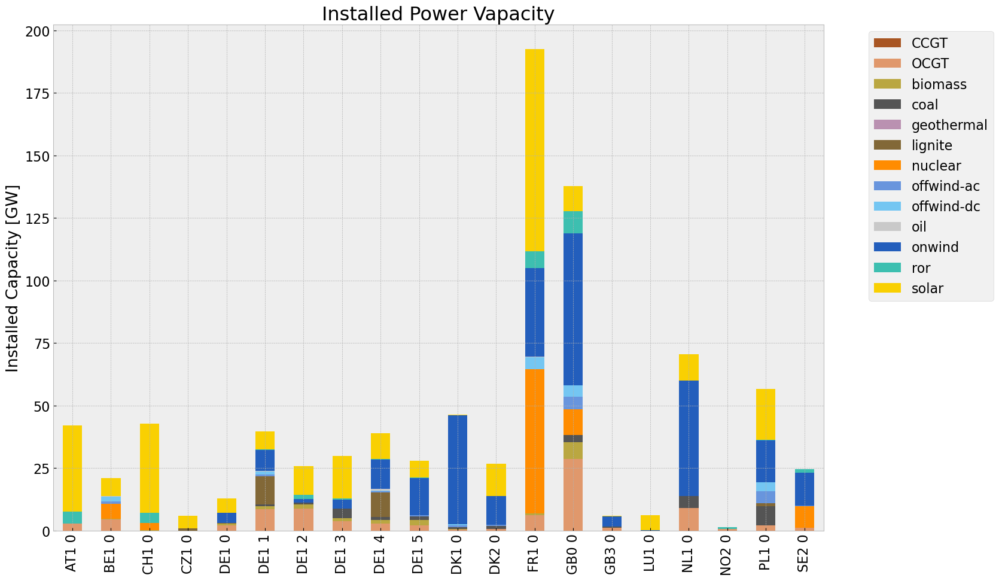

<Figure size 640x480 with 0 Axes>

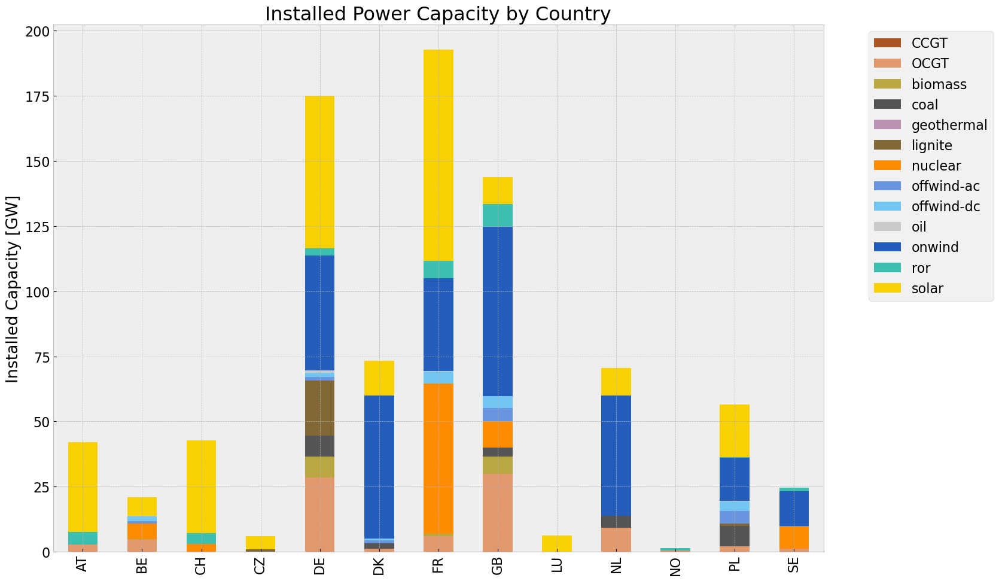

<Figure size 640x480 with 0 Axes>

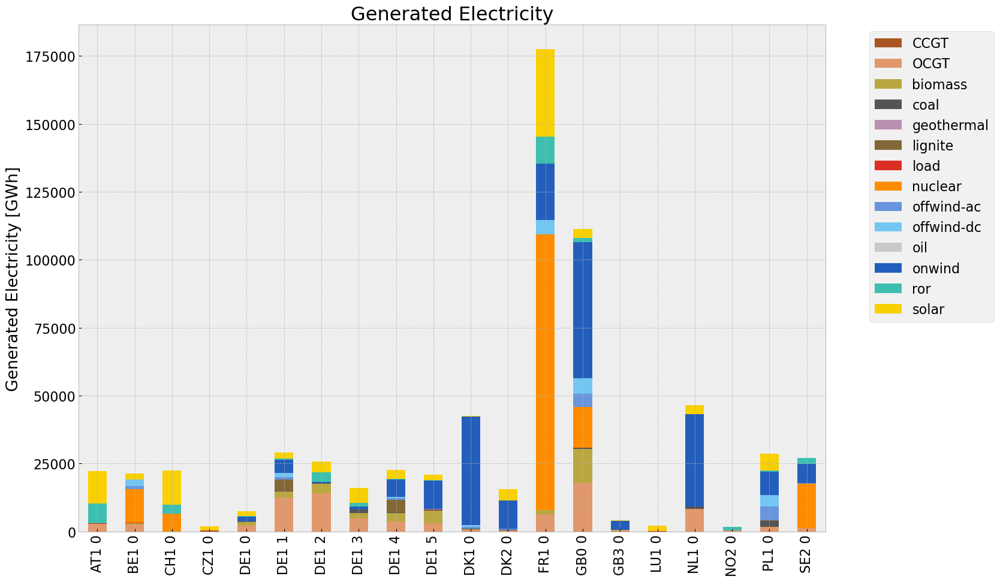

<Figure size 640x480 with 0 Axes>

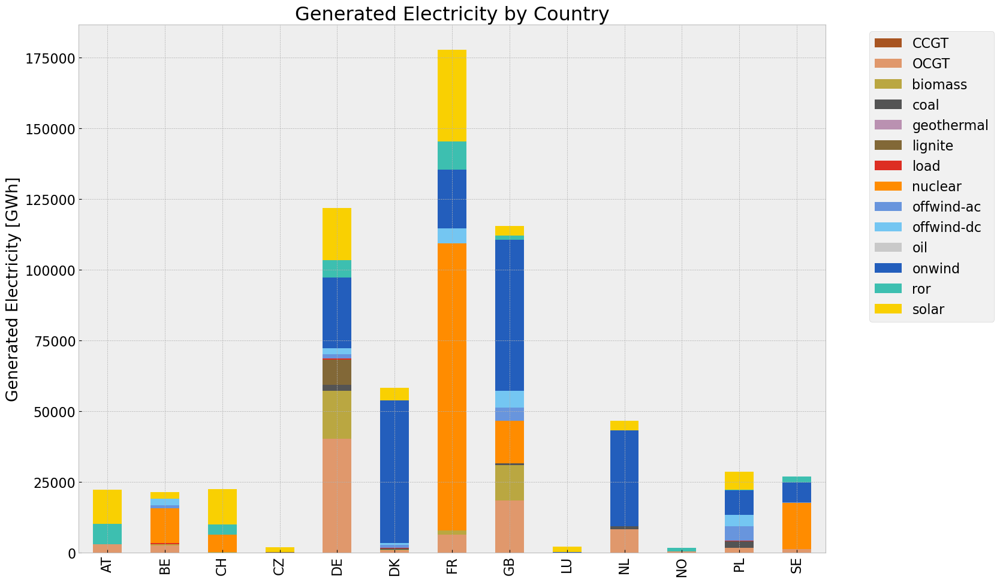

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9840\3440809909.py:23: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = p_country.groupby(n.generators.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9840\3440809909.py:40: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = sto_ctr.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9840\3440809909.py:45: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='3H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9840\3440809909.py:51: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, freq='3H')
c:\Users\Jere

,Generation in MWh,efficiency,emissions in Tonnes CO2/MWh,emissions in Tonnes CO2
carrier,,,,
CCGT,0.000000e+00,0.580000,0.1980,0.000000e+00
OCGT,8.287090e+07,0.451621,0.1980,3.633233e+07
biomass,3.203886e+07,0.468000,0.0000,0.000000e+00
coal,6.408091e+06,0.329908,0.3361,6.528363e+06
geothermal,0.000000e+00,1.000000,0.1200,0.000000e+00
lignite,9.180882e+06,0.337285,0.4069,1.107581e+07
load,1.415102e+06,1.000000,0.0000,0.000000e+00
nuclear,1.511685e+08,0.326600,0.0000,0.000000e+00
offwind-ac,1.401346e+07,1.000000,0.0000,0.000000e+00


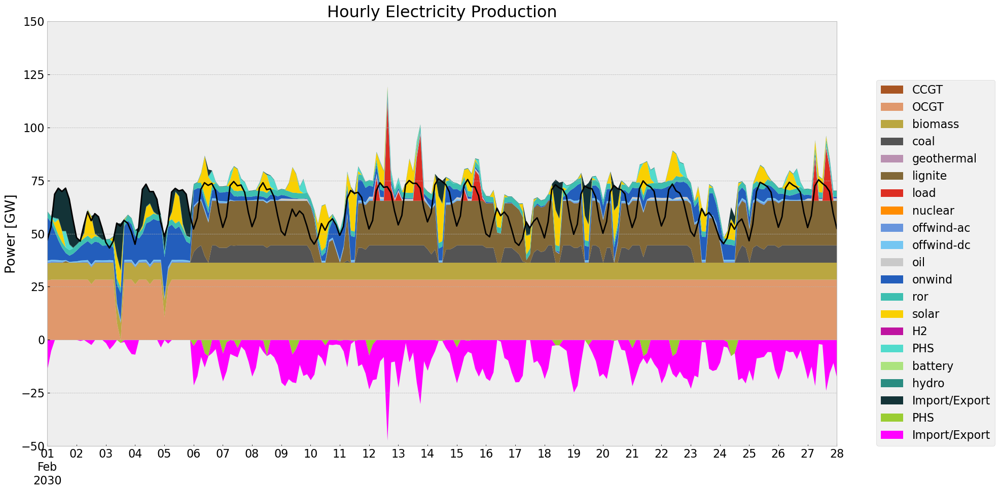

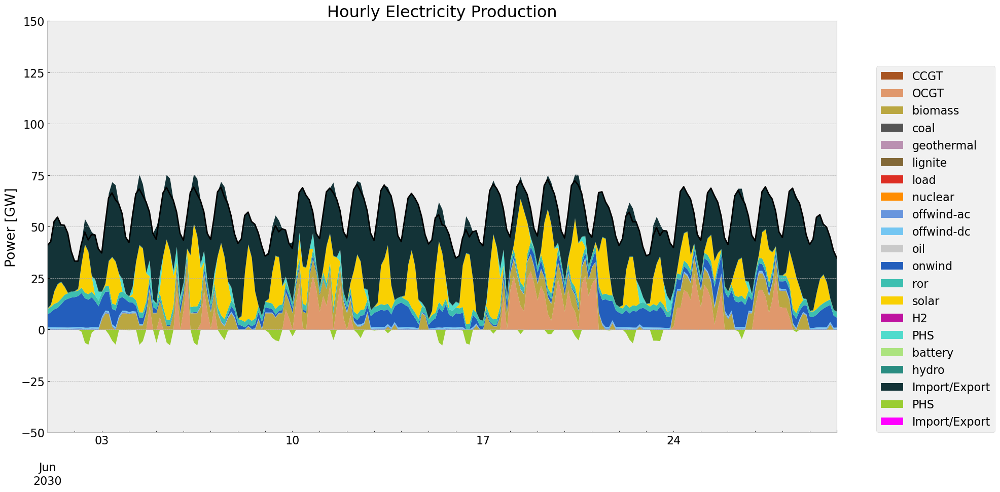

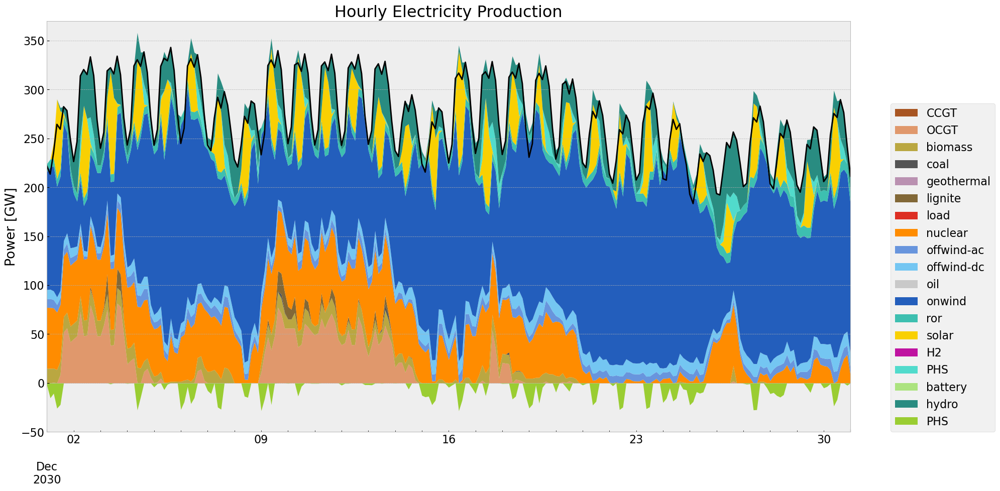

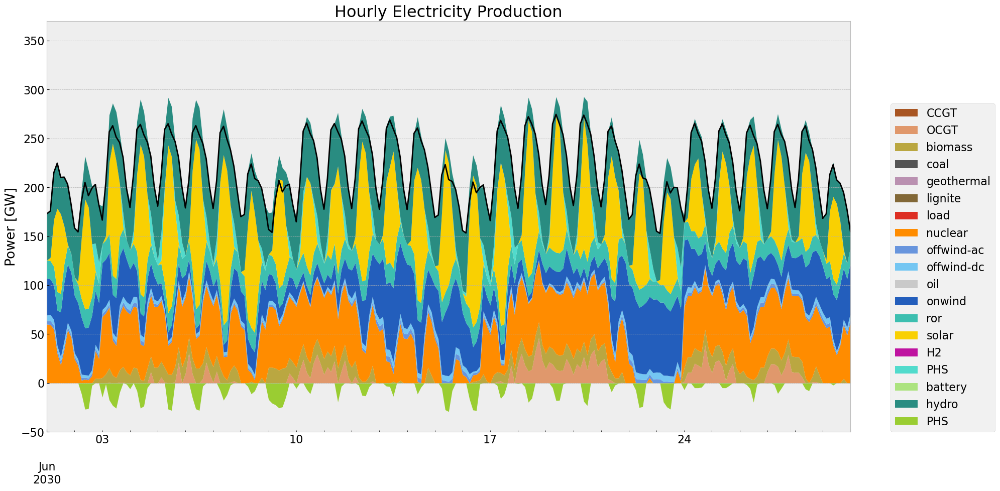

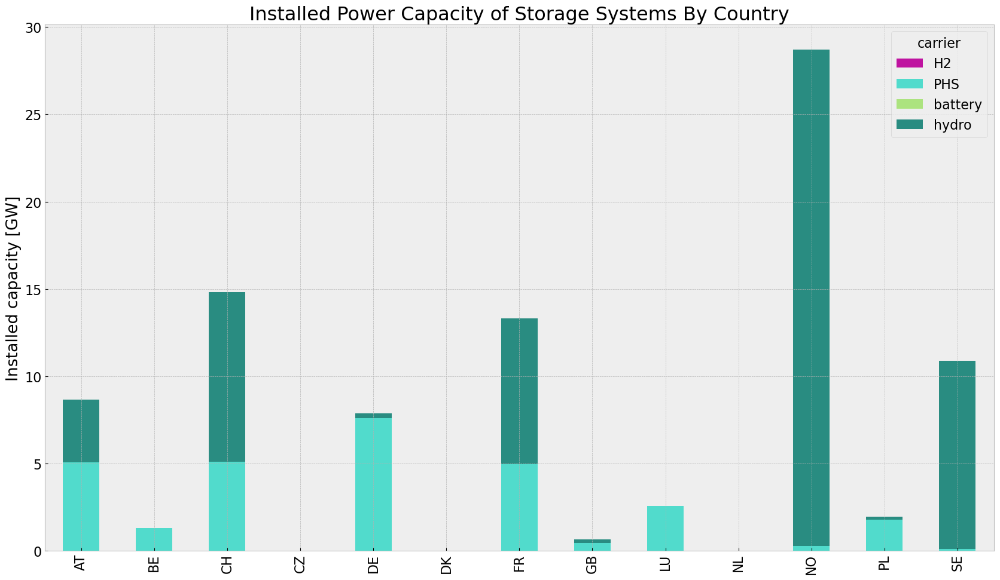

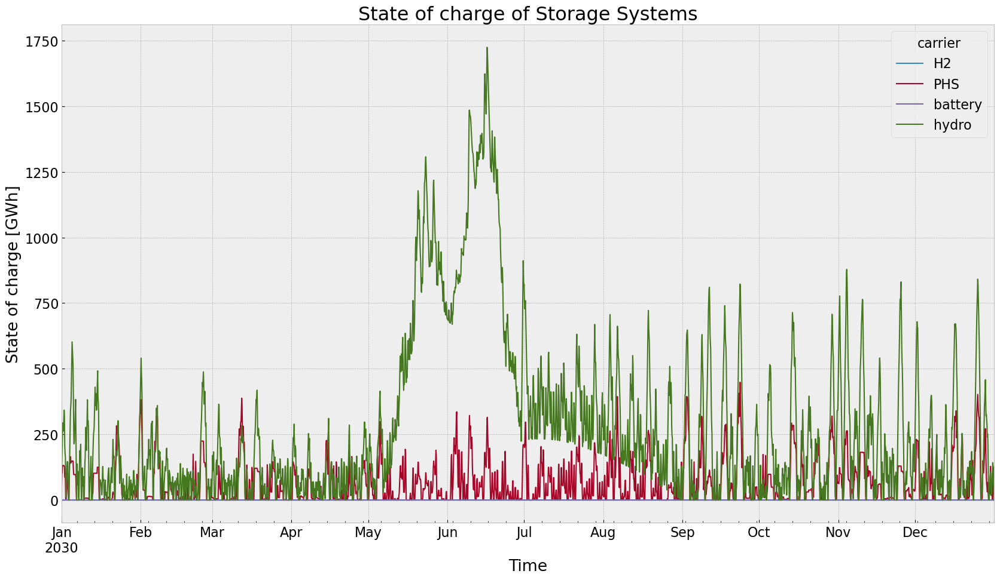

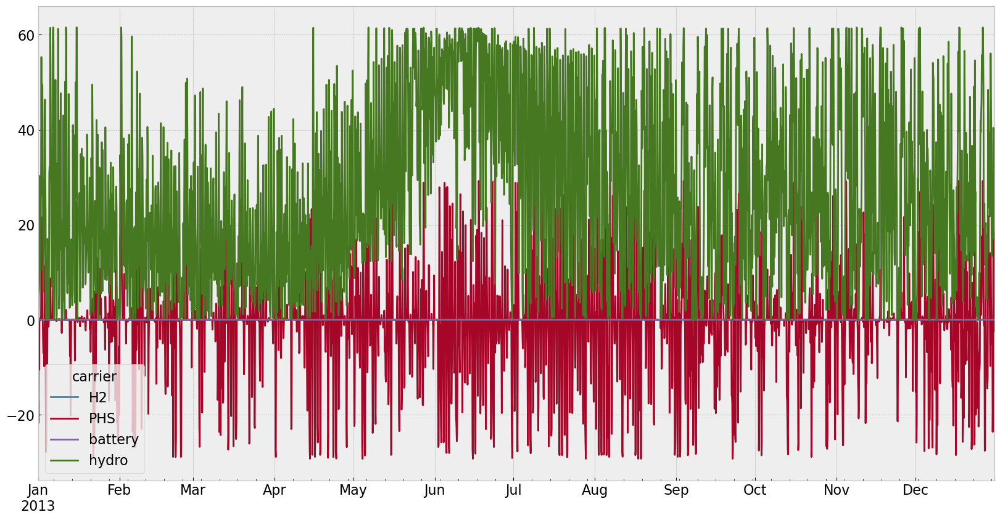

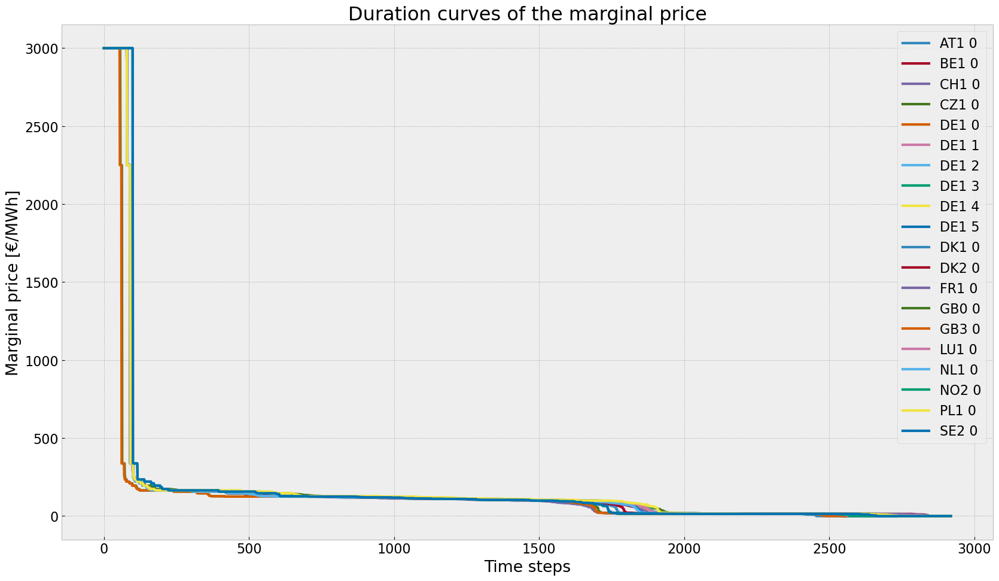

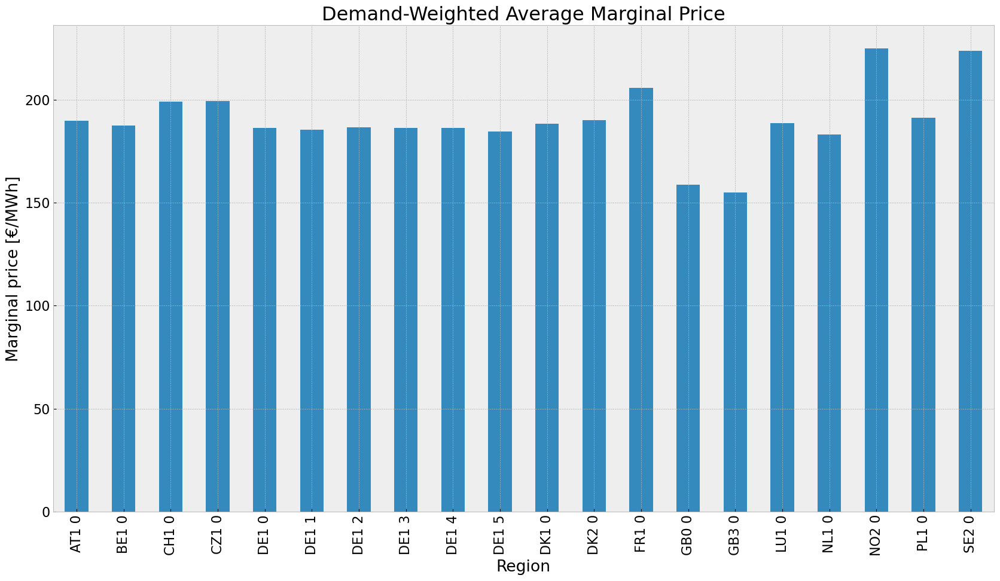

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


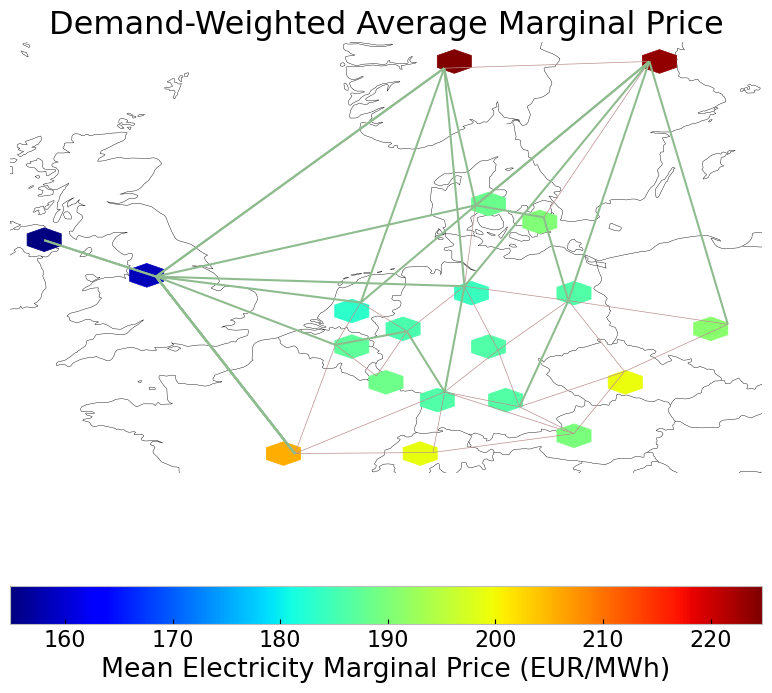

In [71]:
# Plotting
#installed cap
#capacities_noinv_roll = n3.generators.groupby(['bus', 'carrier']).p_nom_opt.sum()
#capacities_noinv_roll.fillna(0, inplace=True)
#gen = (capacities_noinv_roll.unstack()/1000).drop(columns=['load'],inplace=False)


capacities_noinv_roll = inst_cap_table(n3, color_cap)
cap_noinv_roll_country = inst_cap_table_country(n3, color_cap)

#Generation table
# consolidated generation table
#carrier = n3.generators.carrier.unique()
#df_tot_generation = n3.generators_t.p.sum()

#generations = pd.Series(index = n3.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().index)

#for r in region:
    #for tech in carrier:
       # key = f"{r} {tech}"
        #if key in df_tot_generation.index:
            #try:
               # generations.loc[r, tech] = df_tot_generation[key]
                #print(generations.loc[r, tech])
            #except KeyError:
                #print('error')
#generations.fillna(0, inplace=True)

#gen_noinv_roll =(generations.unstack()/1000)#GWh

gen_noinv_roll  = gen_power_table(n3,colors_gen_table)
gen_noinv_roll_country = gen_power_table_country(n3,colors_gen_table)

#Snapshot Summer and Winter
#p = n3.generators_t.p.groupby(n.generators.carrier, axis=1).sum().div(1e3)
#sto = n3.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)    

gen_curve(n3, '2030-02-01', '2030-02-28', colors_gen,'DE')
gen_curve(n3, '2030-06-01', '2030-06-30', colors_gen,'DE')
#generation curve all countries
#winter
gen_curve_tot(n3, '2030-12-01', '2030-12-31', colors_gen)
#summer
gen_curve_tot(n3, '2030-06-01', '2030-06-30', colors_gen)

#installed storage unit & stores
store_noinv_roll = inst_store_table(n3)

#State of Charge Storage unit
state_of_charge_plot(n3)
n3.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3).loc[pd.date_range(start="2013-01-01", end="2013-12-31",freq='3H')].plot(figsize=(20,10))


#Electricitty Price duration curve
price_dur_curve_plot(n3)

#avg electricity price
price_regions_table(n3)
price_regions(n3)

#Emission
em_noinv_roll =em_table(n3)
em_noinv_roll

## 4. Model: rolling horizon foresight with allowed additional investment

In [72]:
n4 = n1.copy()
n4.name = 'inv_roll_wind'
horizon = 24

no_inv(n4,n1)

n4.storage_units['cyclic_state_of_charge'] = False
n4.storage_units['cyclic_state_of_charge_per_period'] = False
optimize.optimize_with_rolling_horizon(n4, horizon=horizon, overlap=0, solver_name='gurobi')
#filename = "inv_roll_wind.nc"
#n4 = import_nc_file(directory, filename)
n4.name = 'inv_roll_wind'

INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-01 00:00:00:2013-01-03 21:00:00] (1/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nnn59kiy.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nnn59kiy.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x40012196


INFO:gurobipy:Model fingerprint: 0x40012196


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 25373 rows and 6505 columns


INFO:gurobipy:Presolve removed 25373 rows and 6505 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1459 rows, 5999 columns, 10056 nonzeros


INFO:gurobipy:Presolved: 1459 rows, 5999 columns, 10056 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.131e+03


INFO:gurobipy: AA' NZ     : 4.131e+03


 Factor NZ  : 4.228e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.228e+04 (roughly 3 MB of memory)


 Factor Ops : 2.261e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.261e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.24980861e+11 -1.99453451e+11  9.84e+04 3.64e-12  1.89e+08     0s


INFO:gurobipy:   0   2.24980861e+11 -1.99453451e+11  9.84e+04 3.64e-12  1.89e+08     0s


   1   1.97061711e+10 -1.01278869e+11  7.68e+03 2.91e-11  2.05e+07     0s


INFO:gurobipy:   1   1.97061711e+10 -1.01278869e+11  7.68e+03 2.91e-11  2.05e+07     0s


   2   2.74026864e+09 -2.58831160e+10  5.66e+02 4.37e-11  2.92e+06     0s


INFO:gurobipy:   2   2.74026864e+09 -2.58831160e+10  5.66e+02 4.37e-11  2.92e+06     0s


   3   5.74524853e+08 -3.01659612e+09  2.70e+01 8.37e-11  3.08e+05     0s


INFO:gurobipy:   3   5.74524853e+08 -3.01659612e+09  2.70e+01 8.37e-11  3.08e+05     0s


   4   1.65139528e+08 -1.24620625e+09  7.73e-01 3.09e-11  1.18e+05     0s


INFO:gurobipy:   4   1.65139528e+08 -1.24620625e+09  7.73e-01 3.09e-11  1.18e+05     0s


   5   1.19790610e+08 -4.41571264e+08  4.39e-01 2.91e-11  4.68e+04     0s


INFO:gurobipy:   5   1.19790610e+08 -4.41571264e+08  4.39e-01 2.91e-11  4.68e+04     0s


   6   7.21563382e+07 -1.55594908e+08  1.61e-01 2.91e-11  1.90e+04     0s


INFO:gurobipy:   6   7.21563382e+07 -1.55594908e+08  1.61e-01 2.91e-11  1.90e+04     0s


   7   4.03426655e+07 -1.85688129e+07  3.72e-02 2.91e-11  4.90e+03     0s


INFO:gurobipy:   7   4.03426655e+07 -1.85688129e+07  3.72e-02 2.91e-11  4.90e+03     0s


   8   2.63746987e+07  7.97144434e+06  5.60e-03 2.91e-11  1.53e+03     0s


INFO:gurobipy:   8   2.63746987e+07  7.97144434e+06  5.60e-03 2.91e-11  1.53e+03     0s


   9   2.32604147e+07  1.47885194e+07  1.51e-03 1.46e-11  7.05e+02     0s


INFO:gurobipy:   9   2.32604147e+07  1.47885194e+07  1.51e-03 1.46e-11  7.05e+02     0s


  10   2.26835962e+07  1.88258360e+07  9.45e-04 1.46e-11  3.21e+02     0s


INFO:gurobipy:  10   2.26835962e+07  1.88258360e+07  9.45e-04 1.46e-11  3.21e+02     0s


  11   2.21817948e+07  2.03828165e+07  4.90e-04 2.91e-11  1.50e+02     0s


INFO:gurobipy:  11   2.21817948e+07  2.03828165e+07  4.90e-04 2.91e-11  1.50e+02     0s


  12   2.18673196e+07  2.11964135e+07  2.08e-04 2.91e-11  5.58e+01     0s


INFO:gurobipy:  12   2.18673196e+07  2.11964135e+07  2.08e-04 2.91e-11  5.58e+01     0s


  13   2.16985376e+07  2.14931913e+07  6.19e-05 2.91e-11  1.71e+01     0s


INFO:gurobipy:  13   2.16985376e+07  2.14931913e+07  6.19e-05 2.91e-11  1.71e+01     0s


  14   2.16386974e+07  2.15814849e+07  1.46e-05 2.91e-11  4.76e+00     0s


INFO:gurobipy:  14   2.16386974e+07  2.15814849e+07  1.46e-05 2.91e-11  4.76e+00     0s


  15   2.16201540e+07  2.16018314e+07  1.98e-06 2.91e-11  1.53e+00     0s


INFO:gurobipy:  15   2.16201540e+07  2.16018314e+07  1.98e-06 2.91e-11  1.53e+00     0s


  16   2.16176118e+07  2.16096756e+07  7.19e-07 2.91e-11  6.61e-01     0s


INFO:gurobipy:  16   2.16176118e+07  2.16096756e+07  7.19e-07 2.91e-11  6.61e-01     0s


  17   2.16166196e+07  2.16125959e+07  3.00e-07 1.46e-11  3.35e-01     0s


INFO:gurobipy:  17   2.16166196e+07  2.16125959e+07  3.00e-07 1.46e-11  3.35e-01     0s


  18   2.16161716e+07  2.16146905e+07  1.35e-07 1.46e-11  1.23e-01     0s


INFO:gurobipy:  18   2.16161716e+07  2.16146905e+07  1.35e-07 1.46e-11  1.23e-01     0s


  19   2.16159009e+07  2.16154932e+07  4.21e-08 2.91e-11  3.39e-02     0s


INFO:gurobipy:  19   2.16159009e+07  2.16154932e+07  4.21e-08 2.91e-11  3.39e-02     0s


  20   2.16158212e+07  2.16157225e+07  1.73e-08 2.91e-11  8.21e-03     0s


INFO:gurobipy:  20   2.16158212e+07  2.16157225e+07  1.73e-08 2.91e-11  8.21e-03     0s


  21   2.16157825e+07  2.16157506e+07  6.61e-09 2.91e-11  2.65e-03     0s


INFO:gurobipy:  21   2.16157825e+07  2.16157506e+07  6.61e-09 2.91e-11  2.65e-03     0s


  22   2.16157648e+07  2.16157545e+07  1.33e-08 1.46e-11  8.58e-04     0s


INFO:gurobipy:  22   2.16157648e+07  2.16157545e+07  1.33e-08 1.46e-11  8.58e-04     0s


  23   2.16157589e+07  2.16157565e+07  1.17e-08 2.91e-11  1.98e-04     0s


INFO:gurobipy:  23   2.16157589e+07  2.16157565e+07  1.17e-08 2.91e-11  1.98e-04     0s


  24   2.16157578e+07  2.16157574e+07  1.15e-08 2.91e-11  3.12e-05     0s


INFO:gurobipy:  24   2.16157578e+07  2.16157574e+07  1.15e-08 2.91e-11  3.12e-05     0s


INFO:gurobipy:


Barrier performed 24 iterations in 0.29 seconds (0.06 work units)


INFO:gurobipy:Barrier performed 24 iterations in 0.29 seconds (0.06 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2207    2.1615757e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2207    2.1615757e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2207 iterations and 0.32 seconds (0.06 work units)


INFO:gurobipy:Solved in 2207 iterations and 0.32 seconds (0.06 work units)


Optimal objective  2.161575747e+07


INFO:gurobipy:Optimal objective  2.161575747e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.16e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-04 00:00:00:2013-01-06 21:00:00] (2/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Index

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qs5bm6kl.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qs5bm6kl.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x8c9e8526


INFO:gurobipy:Model fingerprint: 0x8c9e8526


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25382 rows and 6426 columns


INFO:gurobipy:Presolve removed 25382 rows and 6426 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1450 rows, 6078 columns, 10138 nonzeros


INFO:gurobipy:Presolved: 1450 rows, 6078 columns, 10138 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.04s


INFO:gurobipy:Ordering time: 0.04s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.132e+03


INFO:gurobipy: AA' NZ     : 4.132e+03


 Factor NZ  : 4.281e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.281e+04 (roughly 3 MB of memory)


 Factor Ops : 2.333e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.333e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.35428073e+11 -1.97261386e+11  1.09e+05 3.64e-12  1.87e+08     0s


INFO:gurobipy:   0   2.35428073e+11 -1.97261386e+11  1.09e+05 3.64e-12  1.87e+08     0s


   1   2.19012589e+10 -1.05273196e+11  8.81e+03 2.91e-11  2.13e+07     0s


INFO:gurobipy:   1   2.19012589e+10 -1.05273196e+11  8.81e+03 2.91e-11  2.13e+07     0s


   2   3.84102934e+09 -2.60408638e+10  8.32e+02 2.47e-10  3.18e+06     0s


INFO:gurobipy:   2   3.84102934e+09 -2.60408638e+10  8.32e+02 2.47e-10  3.18e+06     0s


   3   9.42962484e+08 -3.70482958e+09  6.46e+01 4.87e-10  4.07e+05     0s


INFO:gurobipy:   3   9.42962484e+08 -3.70482958e+09  6.46e+01 4.87e-10  4.07e+05     0s


   4   4.56863095e+08 -9.33454275e+08  8.14e+00 1.31e-10  1.16e+05     0s


INFO:gurobipy:   4   4.56863095e+08 -9.33454275e+08  8.14e+00 1.31e-10  1.16e+05     0s


   5   3.48874878e+08 -4.46527534e+08  4.19e+00 7.14e-11  6.58e+04     0s


INFO:gurobipy:   5   3.48874878e+08 -4.46527534e+08  4.19e+00 7.14e-11  6.58e+04     0s


   6   2.94020496e+08 -9.73970666e+07  2.44e+00 3.05e-11  3.23e+04     0s


INFO:gurobipy:   6   2.94020496e+08 -9.73970666e+07  2.44e+00 3.05e-11  3.23e+04     0s


   7   2.05363072e+08  5.24511113e+07  3.61e-01 1.46e-11  1.26e+04     0s


INFO:gurobipy:   7   2.05363072e+08  5.24511113e+07  3.61e-01 1.46e-11  1.26e+04     0s


   8   1.80689625e+08  1.31995037e+08  8.20e-02 2.91e-11  4.00e+03     0s


INFO:gurobipy:   8   1.80689625e+08  1.31995037e+08  8.20e-02 2.91e-11  4.00e+03     0s


   9   1.72895025e+08  1.52035034e+08  2.51e-02 2.91e-11  1.71e+03     0s


INFO:gurobipy:   9   1.72895025e+08  1.52035034e+08  2.51e-02 2.91e-11  1.71e+03     0s


  10   1.70758807e+08  1.61870412e+08  1.26e-02 1.46e-11  7.30e+02     0s


INFO:gurobipy:  10   1.70758807e+08  1.61870412e+08  1.26e-02 1.46e-11  7.30e+02     0s


  11   1.69572366e+08  1.64813878e+08  6.40e-03 2.91e-11  3.91e+02     0s


INFO:gurobipy:  11   1.69572366e+08  1.64813878e+08  6.40e-03 2.91e-11  3.91e+02     0s


  12   1.69046628e+08  1.66766848e+08  3.85e-03 1.46e-11  1.87e+02     0s


INFO:gurobipy:  12   1.69046628e+08  1.66766848e+08  3.85e-03 1.46e-11  1.87e+02     0s


  13   1.68814044e+08  1.67651047e+08  2.76e-03 1.46e-11  9.56e+01     0s


INFO:gurobipy:  13   1.68814044e+08  1.67651047e+08  2.76e-03 1.46e-11  9.56e+01     0s


  14   1.68468705e+08  1.68025430e+08  1.16e-03 2.91e-11  3.64e+01     0s


INFO:gurobipy:  14   1.68468705e+08  1.68025430e+08  1.16e-03 2.91e-11  3.64e+01     0s


  15   1.68371914e+08  1.68119419e+08  7.14e-04 1.46e-11  2.07e+01     0s


INFO:gurobipy:  15   1.68371914e+08  1.68119419e+08  7.14e-04 1.46e-11  2.07e+01     0s


  16   1.68313861e+08  1.68163152e+08  4.57e-04 2.91e-11  1.24e+01     0s


INFO:gurobipy:  16   1.68313861e+08  1.68163152e+08  4.57e-04 2.91e-11  1.24e+01     0s


  17   1.68251604e+08  1.68184535e+08  1.86e-04 1.46e-11  5.51e+00     0s


INFO:gurobipy:  17   1.68251604e+08  1.68184535e+08  1.86e-04 1.46e-11  5.51e+00     0s


  18   1.68235153e+08  1.68196638e+08  1.14e-04 1.46e-11  3.17e+00     0s


INFO:gurobipy:  18   1.68235153e+08  1.68196638e+08  1.14e-04 1.46e-11  3.17e+00     0s


  19   1.68214971e+08  1.68200644e+08  2.61e-05 1.46e-11  1.18e+00     0s


INFO:gurobipy:  19   1.68214971e+08  1.68200644e+08  2.61e-05 1.46e-11  1.18e+00     0s


  20   1.68209418e+08  1.68206871e+08  2.86e-06 2.91e-11  2.09e-01     0s


INFO:gurobipy:  20   1.68209418e+08  1.68206871e+08  2.86e-06 2.91e-11  2.09e-01     0s


  21   1.68208505e+08  1.68208098e+08  1.21e-07 2.91e-11  3.35e-02     0s


INFO:gurobipy:  21   1.68208505e+08  1.68208098e+08  1.21e-07 2.91e-11  3.35e-02     0s


  22   1.68208445e+08  1.68208347e+08  2.71e-08 2.91e-11  8.07e-03     0s


INFO:gurobipy:  22   1.68208445e+08  1.68208347e+08  2.71e-08 2.91e-11  8.07e-03     0s


  23   1.68208435e+08  1.68208403e+08  5.40e-08 2.91e-11  2.61e-03     0s


INFO:gurobipy:  23   1.68208435e+08  1.68208403e+08  5.40e-08 2.91e-11  2.61e-03     0s


  24   1.68208432e+08  1.68208422e+08  4.52e-08 2.91e-11  8.10e-04     0s


INFO:gurobipy:  24   1.68208432e+08  1.68208422e+08  4.52e-08 2.91e-11  8.10e-04     0s


  25   1.68208427e+08  1.68208425e+08  5.93e-08 2.91e-11  1.82e-04     0s


INFO:gurobipy:  25   1.68208427e+08  1.68208425e+08  5.93e-08 2.91e-11  1.82e-04     0s


  26   1.68208427e+08  1.68208426e+08  6.96e-08 2.91e-11  9.20e-06     0s


INFO:gurobipy:  26   1.68208427e+08  1.68208426e+08  6.96e-08 2.91e-11  9.20e-06     0s


  27   1.68208427e+08  1.68208427e+08  3.58e-08 2.91e-11  1.55e-07     0s


INFO:gurobipy:  27   1.68208427e+08  1.68208427e+08  3.58e-08 2.91e-11  1.55e-07     0s


  28   1.68208427e+08  1.68208427e+08  9.19e-11 4.37e-11  8.63e-11     0s


INFO:gurobipy:  28   1.68208427e+08  1.68208427e+08  9.19e-11 4.37e-11  8.63e-11     0s


INFO:gurobipy:


Barrier solved model in 28 iterations and 0.31 seconds (0.07 work units)


INFO:gurobipy:Barrier solved model in 28 iterations and 0.31 seconds (0.07 work units)


Optimal objective 1.68208427e+08


INFO:gurobipy:Optimal objective 1.68208427e+08


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2265    1.6820843e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2265    1.6820843e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2265 iterations and 0.34 seconds (0.08 work units)


INFO:gurobipy:Solved in 2265 iterations and 0.34 seconds (0.08 work units)


Optimal objective  1.682084266e+08


INFO:gurobipy:Optimal objective  1.682084266e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.68e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-07 00:00:00:2013-01-09 21:00:00] (3/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Index

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.46s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ih0j8ggr.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ih0j8ggr.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x72084a68


INFO:gurobipy:Model fingerprint: 0x72084a68


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25389 rows and 6461 columns


INFO:gurobipy:Presolve removed 25389 rows and 6461 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1443 rows, 6043 columns, 10096 nonzeros


INFO:gurobipy:Presolved: 1443 rows, 6043 columns, 10096 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.125e+03


INFO:gurobipy: AA' NZ     : 4.125e+03


 Factor NZ  : 4.464e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.464e+04 (roughly 3 MB of memory)


 Factor Ops : 2.717e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.717e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.63769976e+11 -5.29552731e+11  1.14e+05 9.62e+03  5.07e+08     0s


INFO:gurobipy:   0   2.63769976e+11 -5.29552731e+11  1.14e+05 9.62e+03  5.07e+08     0s


   1   3.76619808e+10 -2.77416753e+11  8.11e+03 7.28e-11  5.36e+07     0s


INFO:gurobipy:   1   3.76619808e+10 -2.77416753e+11  8.11e+03 7.28e-11  5.36e+07     0s


   2   9.64572138e+09 -5.87083514e+10  4.66e+02 1.02e-10  6.73e+06     0s


INFO:gurobipy:   2   9.64572138e+09 -5.87083514e+10  4.66e+02 1.02e-10  6.73e+06     0s


   3   3.11211191e+09 -1.20286432e+10  7.24e+01 2.62e-10  1.33e+06     0s


INFO:gurobipy:   3   3.11211191e+09 -1.20286432e+10  7.24e+01 2.62e-10  1.33e+06     0s


   4   1.80526001e+09 -2.44682105e+09  2.81e+01 4.07e-10  3.65e+05     0s


INFO:gurobipy:   4   1.80526001e+09 -2.44682105e+09  2.81e+01 4.07e-10  3.65e+05     0s


   5   1.18181782e+09 -3.18639334e+08  6.73e+00 1.60e-10  1.26e+05     0s


INFO:gurobipy:   5   1.18181782e+09 -3.18639334e+08  6.73e+00 1.60e-10  1.26e+05     0s


   6   1.07531368e+09  3.93535019e+08  3.32e+00 6.55e-11  5.67e+04     0s


INFO:gurobipy:   6   1.07531368e+09  3.93535019e+08  3.32e+00 6.55e-11  5.67e+04     0s


   7   1.00841212e+09  6.19295759e+08  1.70e+00 3.64e-11  3.23e+04     0s


INFO:gurobipy:   7   1.00841212e+09  6.19295759e+08  1.70e+00 3.64e-11  3.23e+04     0s


   8   9.47438448e+08  7.15122063e+08  5.93e-01 2.91e-11  1.92e+04     0s


INFO:gurobipy:   8   9.47438448e+08  7.15122063e+08  5.93e-01 2.91e-11  1.92e+04     0s


   9   9.13877634e+08  7.83216850e+08  2.47e-01 1.71e-11  1.08e+04     0s


INFO:gurobipy:   9   9.13877634e+08  7.83216850e+08  2.47e-01 1.71e-11  1.08e+04     0s


  10   8.99007296e+08  8.36694750e+08  1.27e-01 2.91e-11  5.15e+03     0s


INFO:gurobipy:  10   8.99007296e+08  8.36694750e+08  1.27e-01 2.91e-11  5.15e+03     0s


  11   8.94074413e+08  8.56255600e+08  9.38e-02 2.91e-11  3.13e+03     0s


INFO:gurobipy:  11   8.94074413e+08  8.56255600e+08  9.38e-02 2.91e-11  3.13e+03     0s


  12   8.88695279e+08  8.68466950e+08  5.98e-02 2.91e-11  1.67e+03     0s


INFO:gurobipy:  12   8.88695279e+08  8.68466950e+08  5.98e-02 2.91e-11  1.67e+03     0s


  13   8.81650360e+08  8.72802451e+08  1.77e-02 1.46e-11  7.31e+02     0s


INFO:gurobipy:  13   8.81650360e+08  8.72802451e+08  1.77e-02 1.46e-11  7.31e+02     0s


  14   8.79783285e+08  8.75830298e+08  7.79e-03 1.46e-11  3.27e+02     0s


INFO:gurobipy:  14   8.79783285e+08  8.75830298e+08  7.79e-03 1.46e-11  3.27e+02     0s


  15   8.78305362e+08  8.77794383e+08  3.40e-04 2.91e-11  4.22e+01     0s


INFO:gurobipy:  15   8.78305362e+08  8.77794383e+08  3.40e-04 2.91e-11  4.22e+01     0s


  16   8.78190826e+08  8.78085160e+08  3.29e-05 2.91e-11  8.73e+00     0s


INFO:gurobipy:  16   8.78190826e+08  8.78085160e+08  3.29e-05 2.91e-11  8.73e+00     0s


  17   8.78176113e+08  8.78139254e+08  9.40e-06 1.46e-11  3.05e+00     0s


INFO:gurobipy:  17   8.78176113e+08  8.78139254e+08  9.40e-06 1.46e-11  3.05e+00     0s


  18   8.78172838e+08  8.78150496e+08  4.98e-06 2.91e-11  1.85e+00     0s


INFO:gurobipy:  18   8.78172838e+08  8.78150496e+08  4.98e-06 2.91e-11  1.85e+00     0s


  19   8.78171109e+08  8.78162590e+08  2.84e-06 1.46e-11  7.04e-01     0s


INFO:gurobipy:  19   8.78171109e+08  8.78162590e+08  2.84e-06 1.46e-11  7.04e-01     0s


  20   8.78169867e+08  8.78165928e+08  1.43e-06 1.55e-11  3.25e-01     0s


INFO:gurobipy:  20   8.78169867e+08  8.78165928e+08  1.43e-06 1.55e-11  3.25e-01     0s


  21   8.78168875e+08  8.78167457e+08  3.41e-07 1.46e-11  1.17e-01     0s


INFO:gurobipy:  21   8.78168875e+08  8.78167457e+08  3.41e-07 1.46e-11  1.17e-01     0s


  22   8.78168618e+08  8.78168066e+08  1.06e-07 1.46e-11  4.56e-02     0s


INFO:gurobipy:  22   8.78168618e+08  8.78168066e+08  1.06e-07 1.46e-11  4.56e-02     0s


  23   8.78168583e+08  8.78168308e+08  7.64e-08 1.46e-11  2.28e-02     0s


INFO:gurobipy:  23   8.78168583e+08  8.78168308e+08  7.64e-08 1.46e-11  2.28e-02     0s


  24   8.78168501e+08  8.78168445e+08  8.72e-09 2.91e-11  4.63e-03     0s


INFO:gurobipy:  24   8.78168501e+08  8.78168445e+08  8.72e-09 2.91e-11  4.63e-03     0s


  25   8.78168487e+08  8.78168480e+08  1.61e-09 2.91e-11  5.56e-04     0s


INFO:gurobipy:  25   8.78168487e+08  8.78168480e+08  1.61e-09 2.91e-11  5.56e-04     0s


  26   8.78168485e+08  8.78168485e+08  9.17e-10 2.91e-11  4.79e-05     0s


INFO:gurobipy:  26   8.78168485e+08  8.78168485e+08  9.17e-10 2.91e-11  4.79e-05     0s


INFO:gurobipy:


Barrier performed 26 iterations in 0.33 seconds (0.06 work units)


INFO:gurobipy:Barrier performed 26 iterations in 0.33 seconds (0.06 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2095    8.7816848e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2095    8.7816848e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2095 iterations and 0.36 seconds (0.07 work units)


INFO:gurobipy:Solved in 2095 iterations and 0.36 seconds (0.07 work units)


Optimal objective  8.781684849e+08


INFO:gurobipy:Optimal objective  8.781684849e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 8.78e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-10 00:00:00:2013-01-12 21:00:00] (4/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Index

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-52je3p_u.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-52je3p_u.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x93e0aaba


INFO:gurobipy:Model fingerprint: 0x93e0aaba


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25379 rows and 6406 columns


INFO:gurobipy:Presolve removed 25379 rows and 6406 columns


Presolve time: 0.07s


INFO:gurobipy:Presolve time: 0.07s


Presolved: 1453 rows, 6098 columns, 10161 nonzeros


INFO:gurobipy:Presolved: 1453 rows, 6098 columns, 10161 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.02s


INFO:gurobipy:Ordering time: 0.02s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.135e+03


INFO:gurobipy: AA' NZ     : 4.135e+03


 Factor NZ  : 4.153e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.153e+04 (roughly 3 MB of memory)


 Factor Ops : 2.219e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.219e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.68045873e+11 -5.33048577e+11  6.86e+04 9.72e+03  3.20e+08     0s


INFO:gurobipy:   0   1.68045873e+11 -5.33048577e+11  6.86e+04 9.72e+03  3.20e+08     0s


   1   2.60172587e+10 -2.37906142e+11  4.97e+03 7.28e-11  3.77e+07     0s


INFO:gurobipy:   1   2.60172587e+10 -2.37906142e+11  4.97e+03 7.28e-11  3.77e+07     0s


   2   7.47303195e+09 -4.97348397e+10  4.61e+02 2.76e-10  5.64e+06     0s


INFO:gurobipy:   2   7.47303195e+09 -4.97348397e+10  4.61e+02 2.76e-10  5.64e+06     0s


   3   2.44843554e+09 -1.50105012e+10  1.16e+02 1.89e-10  1.56e+06     0s


INFO:gurobipy:   3   2.44843554e+09 -1.50105012e+10  1.16e+02 1.89e-10  1.56e+06     0s


   4   1.26537530e+09 -1.76070047e+09  7.23e+00 1.02e-10  2.51e+05     0s


INFO:gurobipy:   4   1.26537530e+09 -1.76070047e+09  7.23e+00 1.02e-10  2.51e+05     0s


   5   1.05587845e+09 -9.71226784e+07  3.21e+00 3.64e-11  9.50e+04     0s


INFO:gurobipy:   5   1.05587845e+09 -9.71226784e+07  3.21e+00 3.64e-11  9.50e+04     0s


   6   9.56253075e+08  3.08879631e+08  2.00e+00 2.18e-11  5.32e+04     0s


INFO:gurobipy:   6   9.56253075e+08  3.08879631e+08  2.00e+00 2.18e-11  5.32e+04     0s


   7   8.33296272e+08  5.06511480e+08  7.68e-01 2.91e-11  2.68e+04     0s


INFO:gurobipy:   7   8.33296272e+08  5.06511480e+08  7.68e-01 2.91e-11  2.68e+04     0s


   8   7.82556156e+08  6.15420057e+08  4.30e-01 2.05e-11  1.37e+04     0s


INFO:gurobipy:   8   7.82556156e+08  6.15420057e+08  4.30e-01 2.05e-11  1.37e+04     0s


   9   7.61617437e+08  6.59550583e+08  3.09e-01 1.36e-11  8.37e+03     0s


INFO:gurobipy:   9   7.61617437e+08  6.59550583e+08  3.09e-01 1.36e-11  8.37e+03     0s


INFO:gurobipy:


Barrier performed 9 iterations in 0.22 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 9 iterations in 0.22 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2066    7.0474754e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2066    7.0474754e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2066 iterations and 0.25 seconds (0.06 work units)


INFO:gurobipy:Solved in 2066 iterations and 0.25 seconds (0.06 work units)


Optimal objective  7.047475413e+08


INFO:gurobipy:Optimal objective  7.047475413e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 7.05e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-13 00:00:00:2013-01-15 21:00:00] (5/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Index

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 107.68it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8j1y0ubc.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8j1y0ubc.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x3378fa17


INFO:gurobipy:Model fingerprint: 0x3378fa17


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 9e+03]


INFO:gurobipy:  Bounds range     [1e+01, 9e+03]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25384 rows and 6437 columns


INFO:gurobipy:Presolve removed 25384 rows and 6437 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1448 rows, 6067 columns, 10125 nonzeros


INFO:gurobipy:Presolved: 1448 rows, 6067 columns, 10125 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.130e+03


INFO:gurobipy: AA' NZ     : 4.130e+03


 Factor NZ  : 4.115e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.115e+04 (roughly 3 MB of memory)


 Factor Ops : 2.168e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.168e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.65051896e+11 -5.42574838e+11  1.12e+05 9.78e+03  5.17e+08     0s


INFO:gurobipy:   0   2.65051896e+11 -5.42574838e+11  1.12e+05 9.78e+03  5.17e+08     0s


   1   3.81470030e+10 -2.93035825e+11  7.04e+03 7.28e-11  5.22e+07     0s


INFO:gurobipy:   1   3.81470030e+10 -2.93035825e+11  7.04e+03 7.28e-11  5.22e+07     0s


   2   1.02672425e+10 -6.19900949e+10  4.04e+02 1.16e-10  6.91e+06     0s


INFO:gurobipy:   2   1.02672425e+10 -6.19900949e+10  4.04e+02 1.16e-10  6.91e+06     0s


   3   3.19192584e+09 -1.04155744e+10  8.39e+01 1.44e-09  1.21e+06     0s


INFO:gurobipy:   3   3.19192584e+09 -1.04155744e+10  8.39e+01 1.44e-09  1.21e+06     0s


   4   1.93451772e+09 -1.54110915e+09  2.83e+01 1.46e-10  3.00e+05     0s


INFO:gurobipy:   4   1.93451772e+09 -1.54110915e+09  2.83e+01 1.46e-10  3.00e+05     0s


   5   1.28000846e+09  1.61365740e+08  5.98e+00 8.00e-11  9.34e+04     0s


INFO:gurobipy:   5   1.28000846e+09  1.61365740e+08  5.98e+00 8.00e-11  9.34e+04     0s


   6   1.20421068e+09  6.72117628e+08  3.29e+00 4.37e-11  4.42e+04     0s


INFO:gurobipy:   6   1.20421068e+09  6.72117628e+08  3.29e+00 4.37e-11  4.42e+04     0s


   7   1.12926144e+09  8.50236528e+08  1.33e+00 2.18e-11  2.31e+04     0s


INFO:gurobipy:   7   1.12926144e+09  8.50236528e+08  1.33e+00 2.18e-11  2.31e+04     0s


   8   1.09534414e+09  9.40047396e+08  7.99e-01 1.46e-11  1.28e+04     0s


INFO:gurobipy:   8   1.09534414e+09  9.40047396e+08  7.99e-01 1.46e-11  1.28e+04     0s


   9   1.05103791e+09  9.84130110e+08  1.88e-01 1.46e-11  5.51e+03     0s


INFO:gurobipy:   9   1.05103791e+09  9.84130110e+08  1.88e-01 1.46e-11  5.51e+03     0s


  10   1.04172426e+09  1.00592717e+09  1.02e-01 1.46e-11  2.95e+03     0s


INFO:gurobipy:  10   1.04172426e+09  1.00592717e+09  1.02e-01 1.46e-11  2.95e+03     0s


  11   1.03704638e+09  1.01541377e+09  6.38e-02 2.91e-11  1.78e+03     0s


INFO:gurobipy:  11   1.03704638e+09  1.01541377e+09  6.38e-02 2.91e-11  1.78e+03     0s


  12   1.03511029e+09  1.01938876e+09  4.87e-02 1.46e-11  1.29e+03     0s


INFO:gurobipy:  12   1.03511029e+09  1.01938876e+09  4.87e-02 1.46e-11  1.29e+03     0s


  13   1.03037550e+09  1.02389719e+09  1.25e-02 1.46e-11  5.33e+02     0s


INFO:gurobipy:  13   1.03037550e+09  1.02389719e+09  1.25e-02 1.46e-11  5.33e+02     0s


  14   1.02970347e+09  1.02623446e+09  7.87e-03 2.04e-11  2.86e+02     0s


INFO:gurobipy:  14   1.02970347e+09  1.02623446e+09  7.87e-03 2.04e-11  2.86e+02     0s


  15   1.02941481e+09  1.02715044e+09  5.86e-03 2.91e-11  1.86e+02     0s


INFO:gurobipy:  15   1.02941481e+09  1.02715044e+09  5.86e-03 2.91e-11  1.86e+02     0s


  16   1.02893656e+09  1.02765722e+09  2.79e-03 1.64e-11  1.05e+02     0s


INFO:gurobipy:  16   1.02893656e+09  1.02765722e+09  2.79e-03 1.64e-11  1.05e+02     0s


INFO:gurobipy:


Barrier performed 16 iterations in 0.27 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 16 iterations in 0.27 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1922    1.0284601e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1922    1.0284601e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1922 iterations and 0.31 seconds (0.06 work units)


INFO:gurobipy:Solved in 1922 iterations and 0.31 seconds (0.06 work units)


Optimal objective  1.028460126e+09


INFO:gurobipy:Optimal objective  1.028460126e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.03e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-16 00:00:00:2013-01-18 21:00:00] (6/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Index

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-iaon56px.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-iaon56px.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xb427c201


INFO:gurobipy:Model fingerprint: 0xb427c201


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 9e+03]


INFO:gurobipy:  Bounds range     [1e+01, 9e+03]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25392 rows and 6518 columns


INFO:gurobipy:Presolve removed 25392 rows and 6518 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1440 rows, 5986 columns, 10036 nonzeros


INFO:gurobipy:Presolved: 1440 rows, 5986 columns, 10036 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.122e+03


INFO:gurobipy: AA' NZ     : 4.122e+03


 Factor NZ  : 4.071e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.071e+04 (roughly 3 MB of memory)


 Factor Ops : 2.036e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.036e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.63326725e+11 -5.17159562e+11  1.14e+05 1.54e+04  5.03e+08     0s


INFO:gurobipy:   0   2.63326725e+11 -5.17159562e+11  1.14e+05 1.54e+04  5.03e+08     0s


   1   3.97712300e+10 -2.74310620e+11  7.44e+03 5.82e-11  5.15e+07     0s


INFO:gurobipy:   1   3.97712300e+10 -2.74310620e+11  7.44e+03 5.82e-11  5.15e+07     0s


   2   1.29607347e+10 -4.92173718e+10  4.73e+02 5.38e-10  6.27e+06     0s


INFO:gurobipy:   2   1.29607347e+10 -4.92173718e+10  4.73e+02 5.38e-10  6.27e+06     0s


   3   6.40186466e+09 -8.34901956e+09  9.10e+01 9.75e-10  1.35e+06     0s


INFO:gurobipy:   3   6.40186466e+09 -8.34901956e+09  9.10e+01 9.75e-10  1.35e+06     0s


   4   4.31772397e+09  1.24965742e+08  2.57e+01 5.09e-10  3.71e+05     0s


INFO:gurobipy:   4   4.31772397e+09  1.24965742e+08  2.57e+01 5.09e-10  3.71e+05     0s


   5   3.71221217e+09  1.80868260e+09  1.20e+01 2.47e-10  1.67e+05     0s


INFO:gurobipy:   5   3.71221217e+09  1.80868260e+09  1.20e+01 2.47e-10  1.67e+05     0s


   6   3.48017131e+09  2.64066910e+09  6.29e+00 1.02e-10  7.36e+04     0s


INFO:gurobipy:   6   3.48017131e+09  2.64066910e+09  6.29e+00 1.02e-10  7.36e+04     0s


   7   3.30302281e+09  2.95003152e+09  2.02e+00 5.82e-11  3.05e+04     0s


INFO:gurobipy:   7   3.30302281e+09  2.95003152e+09  2.02e+00 5.82e-11  3.05e+04     0s


   8   3.21948276e+09  3.08335228e+09  4.02e-01 5.82e-11  1.16e+04     0s


INFO:gurobipy:   8   3.21948276e+09  3.08335228e+09  4.02e-01 5.82e-11  1.16e+04     0s


INFO:gurobipy:


Barrier performed 8 iterations in 0.26 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 8 iterations in 0.26 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2146    3.1852641e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2146    3.1852641e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2146 iterations and 0.29 seconds (0.06 work units)


INFO:gurobipy:Solved in 2146 iterations and 0.29 seconds (0.06 work units)


Optimal objective  3.185264078e+09


INFO:gurobipy:Optimal objective  3.185264078e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.19e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-19 00:00:00:2013-01-21 21:00:00] (7/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Index

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5bh9pjfy.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5bh9pjfy.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x82742b09


INFO:gurobipy:Model fingerprint: 0x82742b09


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 9e+03]


INFO:gurobipy:  Bounds range     [1e+01, 9e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25373 rows and 6476 columns


INFO:gurobipy:Presolve removed 25373 rows and 6476 columns


Presolve time: 0.08s


INFO:gurobipy:Presolve time: 0.08s


Presolved: 1459 rows, 6028 columns, 10097 nonzeros


INFO:gurobipy:Presolved: 1459 rows, 6028 columns, 10097 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.141e+03


INFO:gurobipy: AA' NZ     : 4.141e+03


 Factor NZ  : 4.261e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.261e+04 (roughly 3 MB of memory)


 Factor Ops : 2.342e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.342e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.27996375e+11 -1.95344659e+11  1.05e+05 3.64e-12  1.81e+08     0s


INFO:gurobipy:   0   2.27996375e+11 -1.95344659e+11  1.05e+05 3.64e-12  1.81e+08     0s


   1   2.50198757e+10 -1.00213764e+11  9.99e+03 2.91e-11  2.25e+07     0s


INFO:gurobipy:   1   2.50198757e+10 -1.00213764e+11  9.99e+03 2.91e-11  2.25e+07     0s


   2   5.02006005e+09 -2.68738547e+10  1.10e+03 1.53e-10  3.63e+06     0s


INFO:gurobipy:   2   5.02006005e+09 -2.68738547e+10  1.10e+03 1.53e-10  3.63e+06     0s


   3   1.08637801e+09 -3.63150771e+09  7.91e+01 1.04e-09  4.23e+05     0s


INFO:gurobipy:   3   1.08637801e+09 -3.63150771e+09  7.91e+01 1.04e-09  4.23e+05     0s


   4   5.51385932e+08 -8.45140594e+08  7.51e+00 2.70e-10  1.17e+05     0s


INFO:gurobipy:   4   5.51385932e+08 -8.45140594e+08  7.51e+00 2.70e-10  1.17e+05     0s


   5   4.40753549e+08 -2.04377965e+08  3.67e+00 1.12e-10  5.37e+04     0s


INFO:gurobipy:   5   4.40753549e+08 -2.04377965e+08  3.67e+00 1.12e-10  5.37e+04     0s


   6   3.87869922e+08 -4.84079756e+07  2.26e+00 7.15e-11  3.63e+04     0s


INFO:gurobipy:   6   3.87869922e+08 -4.84079756e+07  2.26e+00 7.15e-11  3.63e+04     0s


   7   3.51515241e+08  6.42586290e+07  1.44e+00 4.54e-11  2.39e+04     0s


INFO:gurobipy:   7   3.51515241e+08  6.42586290e+07  1.44e+00 4.54e-11  2.39e+04     0s


   8   2.93302471e+08  1.97579015e+08  3.53e-01 2.91e-11  7.94e+03     0s


INFO:gurobipy:   8   2.93302471e+08  1.97579015e+08  3.53e-01 2.91e-11  7.94e+03     0s


   9   2.76133623e+08  2.37735083e+08  1.45e-01 1.46e-11  3.18e+03     0s


INFO:gurobipy:   9   2.76133623e+08  2.37735083e+08  1.45e-01 1.46e-11  3.18e+03     0s


  10   2.70896207e+08  2.47473976e+08  9.30e-02 1.46e-11  1.94e+03     0s


INFO:gurobipy:  10   2.70896207e+08  2.47473976e+08  9.30e-02 1.46e-11  1.94e+03     0s


  11   2.66356190e+08  2.53925811e+08  5.06e-02 1.46e-11  1.03e+03     0s


INFO:gurobipy:  11   2.66356190e+08  2.53925811e+08  5.06e-02 1.46e-11  1.03e+03     0s


  12   2.63702725e+08  2.57568053e+08  2.72e-02 1.46e-11  5.08e+02     0s


INFO:gurobipy:  12   2.63702725e+08  2.57568053e+08  2.72e-02 1.46e-11  5.08e+02     0s


  13   2.61587566e+08  2.59562794e+08  9.53e-03 1.46e-11  1.68e+02     0s


INFO:gurobipy:  13   2.61587566e+08  2.59562794e+08  9.53e-03 1.46e-11  1.68e+02     0s


  14   2.60558908e+08  2.60261765e+08  1.19e-03 2.91e-11  2.46e+01     0s


INFO:gurobipy:  14   2.60558908e+08  2.60261765e+08  1.19e-03 2.91e-11  2.46e+01     0s


  15   2.60434354e+08  2.60341104e+08  3.36e-04 2.91e-11  7.73e+00     0s


INFO:gurobipy:  15   2.60434354e+08  2.60341104e+08  3.36e-04 2.91e-11  7.73e+00     0s


  16   2.60400743e+08  2.60365918e+08  1.19e-04 2.91e-11  2.89e+00     0s


INFO:gurobipy:  16   2.60400743e+08  2.60365918e+08  1.19e-04 2.91e-11  2.89e+00     0s


  17   2.60391448e+08  2.60376120e+08  6.05e-05 2.91e-11  1.27e+00     0s


INFO:gurobipy:  17   2.60391448e+08  2.60376120e+08  6.05e-05 2.91e-11  1.27e+00     0s


  18   2.60385191e+08  2.60378730e+08  2.20e-05 1.46e-11  5.35e-01     0s


INFO:gurobipy:  18   2.60385191e+08  2.60378730e+08  2.20e-05 1.46e-11  5.35e-01     0s


  19   2.60382136e+08  2.60380635e+08  3.04e-06 2.91e-11  1.24e-01     0s


INFO:gurobipy:  19   2.60382136e+08  2.60380635e+08  3.04e-06 2.91e-11  1.24e-01     0s


  20   2.60381506e+08  2.60381393e+08  2.77e-07 2.91e-11  9.39e-03     0s


INFO:gurobipy:  20   2.60381506e+08  2.60381393e+08  2.77e-07 2.91e-11  9.39e-03     0s


  21   2.60381453e+08  2.60381422e+08  1.10e-07 2.91e-11  2.57e-03     0s


INFO:gurobipy:  21   2.60381453e+08  2.60381422e+08  1.10e-07 2.91e-11  2.57e-03     0s


  22   2.60381438e+08  2.60381436e+08  1.28e-07 2.91e-11  1.35e-04     0s


INFO:gurobipy:  22   2.60381438e+08  2.60381436e+08  1.28e-07 2.91e-11  1.35e-04     0s


  23   2.60381437e+08  2.60381437e+08  6.94e-08 2.91e-11  1.08e-06     0s


INFO:gurobipy:  23   2.60381437e+08  2.60381437e+08  6.94e-08 2.91e-11  1.08e-06     0s


  24   2.60381437e+08  2.60381437e+08  1.05e-08 2.91e-11  1.14e-11     0s


INFO:gurobipy:  24   2.60381437e+08  2.60381437e+08  1.05e-08 2.91e-11  1.14e-11     0s


INFO:gurobipy:


Barrier solved model in 24 iterations and 0.31 seconds (0.06 work units)


INFO:gurobipy:Barrier solved model in 24 iterations and 0.31 seconds (0.06 work units)


Optimal objective 2.60381437e+08


INFO:gurobipy:Optimal objective 2.60381437e+08


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2241    2.6038144e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2241    2.6038144e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2241 iterations and 0.34 seconds (0.08 work units)


INFO:gurobipy:Solved in 2241 iterations and 0.34 seconds (0.08 work units)


Optimal objective  2.603814374e+08


INFO:gurobipy:Optimal objective  2.603814374e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.60e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-22 00:00:00:2013-01-24 21:00:00] (8/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Index

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_6mjz_0q.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_6mjz_0q.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x650777e8


INFO:gurobipy:Model fingerprint: 0x650777e8


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 9e+03]


INFO:gurobipy:  Bounds range     [1e+01, 9e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25381 rows and 6515 columns


INFO:gurobipy:Presolve removed 25381 rows and 6515 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1451 rows, 5989 columns, 10050 nonzeros


INFO:gurobipy:Presolved: 1451 rows, 5989 columns, 10050 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.133e+03


INFO:gurobipy: AA' NZ     : 4.133e+03


 Factor NZ  : 4.170e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.170e+04 (roughly 3 MB of memory)


 Factor Ops : 2.287e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.287e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.12183755e+11 -5.20200828e+11  8.70e+04 1.38e+04  3.97e+08     0s


INFO:gurobipy:   0   2.12183755e+11 -5.20200828e+11  8.70e+04 1.38e+04  3.97e+08     0s


   1   3.53069276e+10 -2.51881057e+11  6.14e+03 6.55e-11  4.43e+07     0s


INFO:gurobipy:   1   3.53069276e+10 -2.51881057e+11  6.14e+03 6.55e-11  4.43e+07     0s


   2   1.20960647e+10 -4.88122104e+10  4.13e+02 1.89e-10  6.01e+06     0s


INFO:gurobipy:   2   1.20960647e+10 -4.88122104e+10  4.13e+02 1.89e-10  6.01e+06     0s


   3   6.22407439e+09 -1.02363738e+10  9.92e+01 3.06e-10  1.51e+06     0s


INFO:gurobipy:   3   6.22407439e+09 -1.02363738e+10  9.92e+01 3.06e-10  1.51e+06     0s


   4   3.76863527e+09 -7.13663142e+08  2.51e+01 2.76e-10  3.97e+05     0s


INFO:gurobipy:   4   3.76863527e+09 -7.13663142e+08  2.51e+01 2.76e-10  3.97e+05     0s


   5   3.17917890e+09  1.58937378e+09  1.13e+01 1.60e-10  1.41e+05     0s


INFO:gurobipy:   5   3.17917890e+09  1.58937378e+09  1.13e+01 1.60e-10  1.41e+05     0s


   6   2.87833291e+09  2.20384025e+09  4.10e+00 8.73e-11  5.91e+04     0s


INFO:gurobipy:   6   2.87833291e+09  2.20384025e+09  4.10e+00 8.73e-11  5.91e+04     0s


   7   2.77683245e+09  2.49762926e+09  1.82e+00 5.82e-11  2.45e+04     0s


INFO:gurobipy:   7   2.77683245e+09  2.49762926e+09  1.82e+00 5.82e-11  2.45e+04     0s


   8   2.72110080e+09  2.62658952e+09  5.55e-01 4.37e-11  8.23e+03     0s


INFO:gurobipy:   8   2.72110080e+09  2.62658952e+09  5.55e-01 4.37e-11  8.23e+03     0s


   9   2.70365466e+09  2.66287585e+09  2.16e-01 2.91e-11  3.54e+03     0s


INFO:gurobipy:   9   2.70365466e+09  2.66287585e+09  2.16e-01 2.91e-11  3.54e+03     0s


  10   2.69803915e+09  2.68148562e+09  1.14e-01 2.91e-11  1.45e+03     0s


INFO:gurobipy:  10   2.69803915e+09  2.68148562e+09  1.14e-01 2.91e-11  1.45e+03     0s


  11   2.69538889e+09  2.68685664e+09  6.19e-02 2.91e-11  7.50e+02     0s


INFO:gurobipy:  11   2.69538889e+09  2.68685664e+09  6.19e-02 2.91e-11  7.50e+02     0s


  12   2.69375214e+09  2.69011113e+09  3.13e-02 2.91e-11  3.23e+02     0s


INFO:gurobipy:  12   2.69375214e+09  2.69011113e+09  3.13e-02 2.91e-11  3.23e+02     0s


  13   2.69209370e+09  2.69150928e+09  2.37e-03 2.91e-11  5.02e+01     0s


INFO:gurobipy:  13   2.69209370e+09  2.69150928e+09  2.37e-03 2.91e-11  5.02e+01     0s


  14   2.69198567e+09  2.69185707e+09  7.03e-04 2.91e-11  1.12e+01     0s


INFO:gurobipy:  14   2.69198567e+09  2.69185707e+09  7.03e-04 2.91e-11  1.12e+01     0s


  15   2.69194713e+09  2.69189988e+09  1.80e-04 2.91e-11  4.05e+00     0s


INFO:gurobipy:  15   2.69194713e+09  2.69189988e+09  1.80e-04 2.91e-11  4.05e+00     0s


  16   2.69194314e+09  2.69191313e+09  1.30e-04 2.91e-11  2.59e+00     0s


INFO:gurobipy:  16   2.69194314e+09  2.69191313e+09  1.30e-04 2.91e-11  2.59e+00     0s


  17   2.69194034e+09  2.69191809e+09  9.67e-05 2.91e-11  1.92e+00     0s


INFO:gurobipy:  17   2.69194034e+09  2.69191809e+09  9.67e-05 2.91e-11  1.92e+00     0s


  18   2.69193705e+09  2.69192196e+09  5.59e-05 2.91e-11  1.29e+00     0s


INFO:gurobipy:  18   2.69193705e+09  2.69192196e+09  5.59e-05 2.91e-11  1.29e+00     0s


  19   2.69193485e+09  2.69192857e+09  3.06e-05 2.91e-11  5.43e-01     0s


INFO:gurobipy:  19   2.69193485e+09  2.69192857e+09  3.06e-05 2.91e-11  5.43e-01     0s


  20   2.69193350e+09  2.69193013e+09  1.55e-05 2.91e-11  2.91e-01     0s


INFO:gurobipy:  20   2.69193350e+09  2.69193013e+09  1.55e-05 2.91e-11  2.91e-01     0s


  21   2.69193291e+09  2.69193144e+09  8.84e-06 2.91e-11  1.28e-01     0s


INFO:gurobipy:  21   2.69193291e+09  2.69193144e+09  8.84e-06 2.91e-11  1.28e-01     0s


  22   2.69193261e+09  2.69193167e+09  5.37e-06 2.91e-11  8.13e-02     0s


INFO:gurobipy:  22   2.69193261e+09  2.69193167e+09  5.37e-06 2.91e-11  8.13e-02     0s


  23   2.69193231e+09  2.69193197e+09  2.12e-06 2.91e-11  2.94e-02     0s


INFO:gurobipy:  23   2.69193231e+09  2.69193197e+09  2.12e-06 2.91e-11  2.94e-02     0s


INFO:gurobipy:


Barrier performed 23 iterations in 0.24 seconds (0.06 work units)


INFO:gurobipy:Barrier performed 23 iterations in 0.24 seconds (0.06 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1957    2.6919321e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1957    2.6919321e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1957 iterations and 0.30 seconds (0.06 work units)


INFO:gurobipy:Solved in 1957 iterations and 0.30 seconds (0.06 work units)


Optimal objective  2.691932105e+09


INFO:gurobipy:Optimal objective  2.691932105e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.69e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-25 00:00:00:2013-01-27 21:00:00] (9/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Index

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 54.68it/s]
INFO:linopy.io: Writing time: 0.47s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_oqe_0hc.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_oqe_0hc.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x06a62d38


INFO:gurobipy:Model fingerprint: 0x06a62d38


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25383 rows and 6583 columns


INFO:gurobipy:Presolve removed 25383 rows and 6583 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1449 rows, 5921 columns, 9974 nonzeros


INFO:gurobipy:Presolved: 1449 rows, 5921 columns, 9974 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.126e+03


INFO:gurobipy: AA' NZ     : 4.126e+03


 Factor NZ  : 4.469e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.469e+04 (roughly 3 MB of memory)


 Factor Ops : 2.632e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.632e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.14708077e+11 -1.91271130e+11  9.70e+04 3.64e-12  1.78e+08     0s


INFO:gurobipy:   0   2.14708077e+11 -1.91271130e+11  9.70e+04 3.64e-12  1.78e+08     0s


   1   2.82800542e+10 -9.54592722e+10  1.12e+04 2.91e-11  2.49e+07     0s


INFO:gurobipy:   1   2.82800542e+10 -9.54592722e+10  1.12e+04 2.91e-11  2.49e+07     0s


   2   6.44256622e+09 -2.75131348e+10  1.60e+03 8.73e-11  4.44e+06     0s


INFO:gurobipy:   2   6.44256622e+09 -2.75131348e+10  1.60e+03 8.73e-11  4.44e+06     0s


   3   3.25259164e+09 -1.08210035e+10  6.07e+02 7.64e-10  1.63e+06     0s


INFO:gurobipy:   3   3.25259164e+09 -1.08210035e+10  6.07e+02 7.64e-10  1.63e+06     0s


   4   2.22330005e+09 -2.96760520e+09  3.07e+02 1.31e-10  5.95e+05     0s


INFO:gurobipy:   4   2.22330005e+09 -2.96760520e+09  3.07e+02 1.31e-10  5.95e+05     0s


   5   1.53470779e+09 -6.59348858e+08  1.18e+02 2.04e-10  2.28e+05     0s


INFO:gurobipy:   5   1.53470779e+09 -6.59348858e+08  1.18e+02 2.04e-10  2.28e+05     0s


   6   1.31866393e+09  1.26146532e+08  6.53e+01 2.47e-10  1.19e+05     0s


INFO:gurobipy:   6   1.31866393e+09  1.26146532e+08  6.53e+01 2.47e-10  1.19e+05     0s


   7   1.11374447e+09  5.15667051e+08  2.03e+01 3.20e-10  5.50e+04     0s


INFO:gurobipy:   7   1.11374447e+09  5.15667051e+08  2.03e+01 3.20e-10  5.50e+04     0s


   8   1.05655908e+09  7.69082386e+08  1.02e+01 2.33e-10  2.60e+04     0s


INFO:gurobipy:   8   1.05655908e+09  7.69082386e+08  1.02e+01 2.33e-10  2.60e+04     0s


   9   1.00281043e+09  8.79934084e+08  1.74e+00 2.47e-10  1.06e+04     0s


INFO:gurobipy:   9   1.00281043e+09  8.79934084e+08  1.74e+00 2.47e-10  1.06e+04     0s


  10   9.94761035e+08  9.33649279e+08  1.01e+00 2.47e-10  5.28e+03     0s


INFO:gurobipy:  10   9.94761035e+08  9.33649279e+08  1.01e+00 2.47e-10  5.28e+03     0s


  11   9.88782956e+08  9.62282585e+08  5.58e-01 2.18e-10  2.30e+03     0s


INFO:gurobipy:  11   9.88782956e+08  9.62282585e+08  5.58e-01 2.18e-10  2.30e+03     0s


  12   9.84123559e+08  9.68300683e+08  2.83e-01 1.46e-10  1.37e+03     0s


INFO:gurobipy:  12   9.84123559e+08  9.68300683e+08  2.83e-01 1.46e-10  1.37e+03     0s


  13   9.80555178e+08  9.75068250e+08  8.23e-02 1.60e-10  4.72e+02     0s


INFO:gurobipy:  13   9.80555178e+08  9.75068250e+08  8.23e-02 1.60e-10  4.72e+02     0s


  14   9.79106395e+08  9.77194769e+08  2.15e-02 1.02e-10  1.63e+02     0s


INFO:gurobipy:  14   9.79106395e+08  9.77194769e+08  2.15e-02 1.02e-10  1.63e+02     0s


INFO:gurobipy:


Barrier performed 14 iterations in 0.16 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 14 iterations in 0.16 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2314    9.7840148e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2314    9.7840148e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2314 iterations and 0.18 seconds (0.06 work units)


INFO:gurobipy:Solved in 2314 iterations and 0.18 seconds (0.06 work units)


Optimal objective  9.784014829e+08


INFO:gurobipy:Optimal objective  9.784014829e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 9.78e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-28 00:00:00:2013-01-30 21:00:00] (10/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 114.75it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-go7g9lc4.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-go7g9lc4.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xd6ff957f


INFO:gurobipy:Model fingerprint: 0xd6ff957f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 25387 rows and 6702 columns


INFO:gurobipy:Presolve removed 25387 rows and 6702 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1445 rows, 5802 columns, 9815 nonzeros


INFO:gurobipy:Presolved: 1445 rows, 5802 columns, 9815 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.092e+03


INFO:gurobipy: AA' NZ     : 4.092e+03


 Factor NZ  : 4.303e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.303e+04 (roughly 3 MB of memory)


 Factor Ops : 2.377e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.377e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.37692121e+11 -1.90916661e+11  5.89e+04 9.02e-02  1.27e+08     0s


INFO:gurobipy:   0   1.37692121e+11 -1.90916661e+11  5.89e+04 9.02e-02  1.27e+08     0s


   1   1.43709773e+10 -8.91145356e+10  5.02e+03 2.91e-11  1.60e+07     0s


INFO:gurobipy:   1   1.43709773e+10 -8.91145356e+10  5.02e+03 2.91e-11  1.60e+07     0s


   2   2.71800221e+09 -2.17480758e+10  4.94e+02 8.73e-11  2.59e+06     0s


INFO:gurobipy:   2   2.71800221e+09 -2.17480758e+10  4.94e+02 8.73e-11  2.59e+06     0s


   3   5.87375154e+08 -3.18546858e+09  2.89e+01 4.51e-10  3.36e+05     0s


INFO:gurobipy:   3   5.87375154e+08 -3.18546858e+09  2.89e+01 4.51e-10  3.36e+05     0s


   4   2.34022522e+08 -1.19044256e+09  3.44e+00 1.67e-10  1.23e+05     0s


INFO:gurobipy:   4   2.34022522e+08 -1.19044256e+09  3.44e+00 1.67e-10  1.23e+05     0s


   5   1.56889346e+08 -5.87762200e+08  1.79e+00 7.64e-11  6.43e+04     0s


INFO:gurobipy:   5   1.56889346e+08 -5.87762200e+08  1.79e+00 7.64e-11  6.43e+04     0s


   6   1.10654374e+08 -3.44722084e+08  1.02e+00 4.55e-11  3.93e+04     0s


INFO:gurobipy:   6   1.10654374e+08 -3.44722084e+08  1.02e+00 4.55e-11  3.93e+04     0s


   7   5.66648935e+07 -1.71299543e+08  2.43e-01 2.27e-11  1.96e+04     0s


INFO:gurobipy:   7   5.66648935e+07 -1.71299543e+08  2.43e-01 2.27e-11  1.96e+04     0s


   8   4.00443565e+07 -3.16042493e+07  9.62e-02 2.91e-11  6.17e+03     0s


INFO:gurobipy:   8   4.00443565e+07 -3.16042493e+07  9.62e-02 2.91e-11  6.17e+03     0s


   9   3.00965661e+07  5.07344952e+06  4.08e-02 1.46e-11  2.15e+03     0s


INFO:gurobipy:   9   3.00965661e+07  5.07344952e+06  4.08e-02 1.46e-11  2.15e+03     0s


  10   2.62697351e+07  1.37268631e+07  2.21e-02 1.46e-11  1.08e+03     0s


INFO:gurobipy:  10   2.62697351e+07  1.37268631e+07  2.21e-02 1.46e-11  1.08e+03     0s


  11   2.43997431e+07  1.68388639e+07  1.34e-02 1.46e-11  6.51e+02     0s


INFO:gurobipy:  11   2.43997431e+07  1.68388639e+07  1.34e-02 1.46e-11  6.51e+02     0s


  12   2.36122518e+07  1.83860990e+07  9.84e-03 1.46e-11  4.50e+02     0s


INFO:gurobipy:  12   2.36122518e+07  1.83860990e+07  9.84e-03 1.46e-11  4.50e+02     0s


  13   2.20085255e+07  1.95768836e+07  2.56e-03 1.46e-11  2.09e+02     0s


INFO:gurobipy:  13   2.20085255e+07  1.95768836e+07  2.56e-03 1.46e-11  2.09e+02     0s


  14   2.16151888e+07  2.02481419e+07  1.12e-03 1.46e-11  1.18e+02     0s


INFO:gurobipy:  14   2.16151888e+07  2.02481419e+07  1.12e-03 1.46e-11  1.18e+02     0s


  15   2.14510460e+07  2.08156388e+07  5.55e-04 1.46e-11  5.47e+01     0s


INFO:gurobipy:  15   2.14510460e+07  2.08156388e+07  5.55e-04 1.46e-11  5.47e+01     0s


  16   2.13832840e+07  2.10418288e+07  3.46e-04 2.91e-11  2.94e+01     0s


INFO:gurobipy:  16   2.13832840e+07  2.10418288e+07  3.46e-04 2.91e-11  2.94e+01     0s


  17   2.13129897e+07  2.11560049e+07  1.30e-04 1.46e-11  1.35e+01     0s


INFO:gurobipy:  17   2.13129897e+07  2.11560049e+07  1.30e-04 1.46e-11  1.35e+01     0s


  18   2.12872743e+07  2.12440463e+07  5.55e-05 2.91e-11  3.72e+00     0s


INFO:gurobipy:  18   2.12872743e+07  2.12440463e+07  5.55e-05 2.91e-11  3.72e+00     0s


  19   2.12732101e+07  2.12547587e+07  1.93e-05 1.46e-11  1.59e+00     0s


INFO:gurobipy:  19   2.12732101e+07  2.12547587e+07  1.93e-05 1.46e-11  1.59e+00     0s


  20   2.12691782e+07  2.12613199e+07  9.36e-06 1.46e-11  6.76e-01     0s


INFO:gurobipy:  20   2.12691782e+07  2.12613199e+07  9.36e-06 1.46e-11  6.76e-01     0s


  21   2.12654859e+07  2.12641940e+07  6.61e-07 2.91e-11  1.11e-01     0s


INFO:gurobipy:  21   2.12654859e+07  2.12641940e+07  6.61e-07 2.91e-11  1.11e-01     0s


  22   2.12652118e+07  2.12649760e+07  1.50e-07 2.91e-11  2.03e-02     0s


INFO:gurobipy:  22   2.12652118e+07  2.12649760e+07  1.50e-07 2.91e-11  2.03e-02     0s


  23   2.12651463e+07  2.12650731e+07  5.36e-08 2.91e-11  6.31e-03     0s


INFO:gurobipy:  23   2.12651463e+07  2.12650731e+07  5.36e-08 2.91e-11  6.31e-03     0s


INFO:gurobipy:


Barrier performed 23 iterations in 0.29 seconds (0.06 work units)


INFO:gurobipy:Barrier performed 23 iterations in 0.29 seconds (0.06 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2281    2.1265107e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2281    2.1265107e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2281 iterations and 0.32 seconds (0.07 work units)


INFO:gurobipy:Solved in 2281 iterations and 0.32 seconds (0.07 work units)


Optimal objective  2.126510674e+07


INFO:gurobipy:Optimal objective  2.126510674e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.13e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-31 00:00:00:2013-02-02 21:00:00] (11/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.81it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ssfppkoz.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ssfppkoz.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x53f01d15


INFO:gurobipy:Model fingerprint: 0x53f01d15


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25405 rows and 6481 columns


INFO:gurobipy:Presolve removed 25405 rows and 6481 columns


Presolve time: 0.08s


INFO:gurobipy:Presolve time: 0.08s


Presolved: 1427 rows, 6023 columns, 10042 nonzeros


INFO:gurobipy:Presolved: 1427 rows, 6023 columns, 10042 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.091e+03


INFO:gurobipy: AA' NZ     : 4.091e+03


 Factor NZ  : 4.067e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.067e+04 (roughly 3 MB of memory)


 Factor Ops : 2.113e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.113e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.98665696e+11 -5.27125809e+11  9.12e+04 1.14e+04  4.15e+08     0s


INFO:gurobipy:   0   1.98665696e+11 -5.27125809e+11  9.12e+04 1.14e+04  4.15e+08     0s


   1   2.83124030e+10 -2.75520860e+11  5.98e+03 5.82e-11  4.54e+07     0s


INFO:gurobipy:   1   2.83124030e+10 -2.75520860e+11  5.98e+03 5.82e-11  4.54e+07     0s


   2   6.72822773e+09 -5.49159782e+10  4.91e+02 7.28e-11  6.17e+06     0s


INFO:gurobipy:   2   6.72822773e+09 -5.49159782e+10  4.91e+02 7.28e-11  6.17e+06     0s


   3   1.83766034e+09 -1.48246872e+10  9.47e+01 1.31e-10  1.49e+06     0s


INFO:gurobipy:   3   1.83766034e+09 -1.48246872e+10  9.47e+01 1.31e-10  1.49e+06     0s


   4   9.55785361e+08 -1.87160247e+09  7.78e+00 8.73e-11  2.37e+05     0s


INFO:gurobipy:   4   9.55785361e+08 -1.87160247e+09  7.78e+00 8.73e-11  2.37e+05     0s


   5   7.05114445e+08 -5.81908595e+08  3.02e+00 4.37e-11  1.07e+05     0s


INFO:gurobipy:   5   7.05114445e+08 -5.81908595e+08  3.02e+00 4.37e-11  1.07e+05     0s


   6   5.85666795e+08 -9.41614310e+07  1.61e+00 2.91e-11  5.66e+04     0s


INFO:gurobipy:   6   5.85666795e+08 -9.41614310e+07  1.61e+00 2.91e-11  5.66e+04     0s


   7   4.83109470e+08  1.69767141e+08  6.81e-01 1.46e-11  2.60e+04     0s


INFO:gurobipy:   7   4.83109470e+08  1.69767141e+08  6.81e-01 1.46e-11  2.60e+04     0s


   8   4.28914381e+08  2.79907047e+08  3.08e-01 1.46e-11  1.24e+04     0s


INFO:gurobipy:   8   4.28914381e+08  2.79907047e+08  3.08e-01 1.46e-11  1.24e+04     0s


   9   3.94569916e+08  3.29860190e+08  1.07e-01 2.91e-11  5.37e+03     0s


INFO:gurobipy:   9   3.94569916e+08  3.29860190e+08  1.07e-01 2.91e-11  5.37e+03     0s


  10   3.85738918e+08  3.46957425e+08  6.16e-02 1.46e-11  3.22e+03     0s


INFO:gurobipy:  10   3.85738918e+08  3.46957425e+08  6.16e-02 1.46e-11  3.22e+03     0s


  11   3.83730838e+08  3.50712985e+08  5.16e-02 1.46e-11  2.74e+03     0s


INFO:gurobipy:  11   3.83730838e+08  3.50712985e+08  5.16e-02 1.46e-11  2.74e+03     0s


  12   3.80796605e+08  3.57048321e+08  3.65e-02 2.91e-11  1.97e+03     0s


INFO:gurobipy:  12   3.80796605e+08  3.57048321e+08  3.65e-02 2.91e-11  1.97e+03     0s


  13   3.77746627e+08  3.64660149e+08  2.11e-02 1.46e-11  1.09e+03     0s


INFO:gurobipy:  13   3.77746627e+08  3.64660149e+08  2.11e-02 1.46e-11  1.09e+03     0s


  14   3.75971300e+08  3.67897887e+08  1.30e-02 1.46e-11  6.70e+02     0s


INFO:gurobipy:  14   3.75971300e+08  3.67897887e+08  1.30e-02 1.46e-11  6.70e+02     0s


  15   3.74948256e+08  3.69841196e+08  8.47e-03 1.46e-11  4.24e+02     0s


INFO:gurobipy:  15   3.74948256e+08  3.69841196e+08  8.47e-03 1.46e-11  4.24e+02     0s


  16   3.74413725e+08  3.71118363e+08  6.16e-03 1.46e-11  2.73e+02     0s


INFO:gurobipy:  16   3.74413725e+08  3.71118363e+08  6.16e-03 1.46e-11  2.73e+02     0s


  17   3.74226320e+08  3.71618117e+08  5.37e-03 2.34e-11  2.16e+02     0s


INFO:gurobipy:  17   3.74226320e+08  3.71618117e+08  5.37e-03 2.34e-11  2.16e+02     0s


  18   3.73785703e+08  3.72073039e+08  3.50e-03 2.91e-11  1.42e+02     0s


INFO:gurobipy:  18   3.73785703e+08  3.72073039e+08  3.50e-03 2.91e-11  1.42e+02     0s


  19   3.73465347e+08  3.72496975e+08  2.16e-03 2.91e-11  8.03e+01     0s


INFO:gurobipy:  19   3.73465347e+08  3.72496975e+08  2.16e-03 2.91e-11  8.03e+01     0s


  20   3.73162390e+08  3.72750435e+08  8.98e-04 1.46e-11  3.42e+01     0s


INFO:gurobipy:  20   3.73162390e+08  3.72750435e+08  8.98e-04 1.46e-11  3.42e+01     0s


INFO:gurobipy:


Barrier performed 20 iterations in 0.28 seconds (0.06 work units)


INFO:gurobipy:Barrier performed 20 iterations in 0.28 seconds (0.06 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2314    3.7293315e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2314    3.7293315e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2314 iterations and 0.30 seconds (0.07 work units)


INFO:gurobipy:Solved in 2314 iterations and 0.30 seconds (0.07 work units)


Optimal objective  3.729331461e+08


INFO:gurobipy:Optimal objective  3.729331461e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.73e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-03 00:00:00:2013-02-05 21:00:00] (12/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 132.07it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-m72r0qru.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-m72r0qru.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x7547c20d


INFO:gurobipy:Model fingerprint: 0x7547c20d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25424 rows and 6390 columns


INFO:gurobipy:Presolve removed 25424 rows and 6390 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1408 rows, 6114 columns, 10086 nonzeros


INFO:gurobipy:Presolved: 1408 rows, 6114 columns, 10086 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.044e+03


INFO:gurobipy: AA' NZ     : 4.044e+03


 Factor NZ  : 4.116e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.116e+04 (roughly 3 MB of memory)


 Factor Ops : 2.185e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.185e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.07408543e+11 -1.93084400e+11  9.39e+04 3.64e-12  1.63e+08     0s


INFO:gurobipy:   0   2.07408543e+11 -1.93084400e+11  9.39e+04 3.64e-12  1.63e+08     0s


   1   1.91616939e+10 -9.21984190e+10  7.20e+03 2.91e-11  1.77e+07     0s


INFO:gurobipy:   1   1.91616939e+10 -9.21984190e+10  7.20e+03 2.91e-11  1.77e+07     0s


   2   3.89784408e+09 -2.27944044e+10  7.65e+02 1.60e-10  2.83e+06     0s


INFO:gurobipy:   2   3.89784408e+09 -2.27944044e+10  7.65e+02 1.60e-10  2.83e+06     0s


   3   9.83947154e+08 -2.79700163e+09  5.06e+01 1.38e-10  3.27e+05     0s


INFO:gurobipy:   3   9.83947154e+08 -2.79700163e+09  5.06e+01 1.38e-10  3.27e+05     0s


   4   5.76737893e+08 -5.47575577e+08  8.27e+00 3.64e-11  9.30e+04     0s


INFO:gurobipy:   4   5.76737893e+08 -5.47575577e+08  8.27e+00 3.64e-11  9.30e+04     0s


   5   4.56111634e+08 -1.14007648e+08  3.91e+00 2.91e-11  4.69e+04     0s


INFO:gurobipy:   5   4.56111634e+08 -1.14007648e+08  3.91e+00 2.91e-11  4.69e+04     0s


   6   3.94374721e+08  8.49837062e+07  2.12e+00 1.46e-11  2.54e+04     0s


INFO:gurobipy:   6   3.94374721e+08  8.49837062e+07  2.12e+00 1.46e-11  2.54e+04     0s


   7   3.32064160e+08  2.15768728e+08  4.60e-01 1.46e-11  9.51e+03     0s


INFO:gurobipy:   7   3.32064160e+08  2.15768728e+08  4.60e-01 1.46e-11  9.51e+03     0s


   8   3.07468078e+08  2.78426328e+08  4.66e-02 2.91e-11  2.37e+03     0s


INFO:gurobipy:   8   3.07468078e+08  2.78426328e+08  4.66e-02 2.91e-11  2.37e+03     0s


   9   3.02774874e+08  2.91278465e+08  1.83e-02 1.46e-11  9.39e+02     0s


INFO:gurobipy:   9   3.02774874e+08  2.91278465e+08  1.83e-02 1.46e-11  9.39e+02     0s


  10   3.00868934e+08  2.96464080e+08  8.53e-03 2.91e-11  3.60e+02     0s


INFO:gurobipy:  10   3.00868934e+08  2.96464080e+08  8.53e-03 2.91e-11  3.60e+02     0s


  11   2.99976554e+08  2.98144315e+08  4.22e-03 1.46e-11  1.50e+02     0s


INFO:gurobipy:  11   2.99976554e+08  2.98144315e+08  4.22e-03 1.46e-11  1.50e+02     0s


  12   2.99670538e+08  2.98537745e+08  2.72e-03 2.91e-11  9.26e+01     0s


INFO:gurobipy:  12   2.99670538e+08  2.98537745e+08  2.72e-03 2.91e-11  9.26e+01     0s


  13   2.99354070e+08  2.98917229e+08  1.13e-03 2.91e-11  3.57e+01     0s


INFO:gurobipy:  13   2.99354070e+08  2.98917229e+08  1.13e-03 2.91e-11  3.57e+01     0s


  14   2.99212582e+08  2.99031265e+08  4.75e-04 1.46e-11  1.48e+01     0s


INFO:gurobipy:  14   2.99212582e+08  2.99031265e+08  4.75e-04 1.46e-11  1.48e+01     0s


  15   2.99169183e+08  2.99075813e+08  2.71e-04 1.46e-11  7.63e+00     0s


INFO:gurobipy:  15   2.99169183e+08  2.99075813e+08  2.71e-04 1.46e-11  7.63e+00     0s


INFO:gurobipy:


Barrier performed 15 iterations in 0.21 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 15 iterations in 0.21 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2063    2.9910850e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2063    2.9910850e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2063 iterations and 0.24 seconds (0.09 work units)


INFO:gurobipy:Solved in 2063 iterations and 0.24 seconds (0.09 work units)


Optimal objective  2.991084981e+08


INFO:gurobipy:Optimal objective  2.991084981e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.99e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-06 00:00:00:2013-02-08 21:00:00] (13/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-znk6cw4i.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-znk6cw4i.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x1906f5b6


INFO:gurobipy:Model fingerprint: 0x1906f5b6


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25388 rows and 6356 columns


INFO:gurobipy:Presolve removed 25388 rows and 6356 columns


Presolve time: 0.06s


INFO:gurobipy:Presolve time: 0.06s


Presolved: 1444 rows, 6148 columns, 10202 nonzeros


INFO:gurobipy:Presolved: 1444 rows, 6148 columns, 10202 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.126e+03


INFO:gurobipy: AA' NZ     : 4.126e+03


 Factor NZ  : 4.053e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.053e+04 (roughly 3 MB of memory)


 Factor Ops : 2.082e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.082e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.40158241e+11 -5.22051678e+11  1.01e+05 9.87e+03  4.56e+08     0s


INFO:gurobipy:   0   2.40158241e+11 -5.22051678e+11  1.01e+05 9.87e+03  4.56e+08     0s


   1   3.55742859e+10 -2.53555815e+11  6.27e+03 7.28e-11  4.48e+07     0s


INFO:gurobipy:   1   3.55742859e+10 -2.53555815e+11  6.27e+03 7.28e-11  4.48e+07     0s


   2   1.12804138e+10 -5.11213018e+10  6.06e+02 2.33e-10  6.46e+06     0s


INFO:gurobipy:   2   1.12804138e+10 -5.11213018e+10  6.06e+02 2.33e-10  6.46e+06     0s


   3   3.38859758e+09 -9.77010029e+09  6.31e+01 1.60e-10  1.15e+06     0s


INFO:gurobipy:   3   3.38859758e+09 -9.77010029e+09  6.31e+01 1.60e-10  1.15e+06     0s


   4   1.95615943e+09 -2.93989676e+09  2.25e+01 1.46e-10  4.14e+05     0s


INFO:gurobipy:   4   1.95615943e+09 -2.93989676e+09  2.25e+01 1.46e-10  4.14e+05     0s


   5   1.33527130e+09 -5.01458494e+08  3.57e+00 7.28e-11  1.50e+05     0s


INFO:gurobipy:   5   1.33527130e+09 -5.01458494e+08  3.57e+00 7.28e-11  1.50e+05     0s


   6   1.22451601e+09  5.93782882e+08  8.51e-01 4.37e-11  5.14e+04     0s


INFO:gurobipy:   6   1.22451601e+09  5.93782882e+08  8.51e-01 4.37e-11  5.14e+04     0s


   7   1.18228106e+09  8.72987407e+08  2.90e-01 2.91e-11  2.51e+04     0s


INFO:gurobipy:   7   1.18228106e+09  8.72987407e+08  2.90e-01 2.91e-11  2.51e+04     0s


   8   1.14662292e+09  1.01824838e+09  9.42e-02 1.46e-11  1.04e+04     0s


INFO:gurobipy:   8   1.14662292e+09  1.01824838e+09  9.42e-02 1.46e-11  1.04e+04     0s


   9   1.12262256e+09  1.06472052e+09  3.10e-02 2.18e-11  4.70e+03     0s


INFO:gurobipy:   9   1.12262256e+09  1.06472052e+09  3.10e-02 2.18e-11  4.70e+03     0s


  10   1.11580723e+09  1.07756273e+09  1.82e-02 1.46e-11  3.11e+03     0s


INFO:gurobipy:  10   1.11580723e+09  1.07756273e+09  1.82e-02 1.46e-11  3.11e+03     0s


  11   1.11128803e+09  1.08696131e+09  9.99e-03 1.46e-11  1.98e+03     0s


INFO:gurobipy:  11   1.11128803e+09  1.08696131e+09  9.99e-03 1.46e-11  1.98e+03     0s


  12   1.10900564e+09  1.09528577e+09  6.28e-03 1.46e-11  1.11e+03     0s


INFO:gurobipy:  12   1.10900564e+09  1.09528577e+09  6.28e-03 1.46e-11  1.11e+03     0s


  13   1.10712279e+09  1.09998328e+09  3.43e-03 1.46e-11  5.80e+02     0s


INFO:gurobipy:  13   1.10712279e+09  1.09998328e+09  3.43e-03 1.46e-11  5.80e+02     0s


  14   1.10559409e+09  1.10299657e+09  1.31e-03 2.29e-11  2.11e+02     0s


INFO:gurobipy:  14   1.10559409e+09  1.10299657e+09  1.31e-03 2.29e-11  2.11e+02     0s


  15   1.10533144e+09  1.10323517e+09  9.86e-04 1.61e-11  1.70e+02     0s


INFO:gurobipy:  15   1.10533144e+09  1.10323517e+09  9.86e-04 1.61e-11  1.70e+02     0s


  16   1.10503218e+09  1.10388500e+09  6.18e-04 1.67e-11  9.32e+01     0s


INFO:gurobipy:  16   1.10503218e+09  1.10388500e+09  6.18e-04 1.67e-11  9.32e+01     0s


INFO:gurobipy:


Barrier performed 16 iterations in 0.27 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 16 iterations in 0.27 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1893    1.1045061e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1893    1.1045061e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1893 iterations and 0.29 seconds (0.06 work units)


INFO:gurobipy:Solved in 1893 iterations and 0.29 seconds (0.06 work units)


Optimal objective  1.104506059e+09


INFO:gurobipy:Optimal objective  1.104506059e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.10e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-09 00:00:00:2013-02-11 21:00:00] (14/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-upoywdyh.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-upoywdyh.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x68aad96b


INFO:gurobipy:Model fingerprint: 0x68aad96b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25390 rows and 6403 columns


INFO:gurobipy:Presolve removed 25390 rows and 6403 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1442 rows, 6101 columns, 10153 nonzeros


INFO:gurobipy:Presolved: 1442 rows, 6101 columns, 10153 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.124e+03


INFO:gurobipy: AA' NZ     : 4.124e+03


 Factor NZ  : 4.117e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.117e+04 (roughly 3 MB of memory)


 Factor Ops : 2.134e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.134e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.13725588e+11 -5.11239921e+11  8.87e+04 1.00e+04  4.02e+08     0s


INFO:gurobipy:   0   2.13725588e+11 -5.11239921e+11  8.87e+04 1.00e+04  4.02e+08     0s


   1   3.15530547e+10 -2.53026176e+11  5.85e+03 7.28e-11  4.28e+07     0s


INFO:gurobipy:   1   3.15530547e+10 -2.53026176e+11  5.85e+03 7.28e-11  4.28e+07     0s


   2   8.75115239e+09 -4.87412643e+10  3.68e+02 2.33e-10  5.52e+06     0s


INFO:gurobipy:   2   8.75115239e+09 -4.87412643e+10  3.68e+02 2.33e-10  5.52e+06     0s


   3   3.12195169e+09 -1.10543411e+10  7.47e+01 8.59e-10  1.24e+06     0s


INFO:gurobipy:   3   3.12195169e+09 -1.10543411e+10  7.47e+01 8.59e-10  1.24e+06     0s


   4   1.63796273e+09 -3.16514537e+09  2.42e+01 3.49e-10  4.08e+05     0s


INFO:gurobipy:   4   1.63796273e+09 -3.16514537e+09  2.42e+01 3.49e-10  4.08e+05     0s


   5   1.28574891e+09 -4.88170616e+08  9.76e+00 1.75e-10  1.48e+05     0s


INFO:gurobipy:   5   1.28574891e+09 -4.88170616e+08  9.76e+00 1.75e-10  1.48e+05     0s


   6   1.10863152e+09  4.00820703e+08  3.48e+00 1.31e-10  5.85e+04     0s


INFO:gurobipy:   6   1.10863152e+09  4.00820703e+08  3.48e+00 1.31e-10  5.85e+04     0s


   7   1.01307149e+09  7.33839136e+08  7.93e-01 7.28e-11  2.29e+04     0s


INFO:gurobipy:   7   1.01307149e+09  7.33839136e+08  7.93e-01 7.28e-11  2.29e+04     0s


   8   9.75732129e+08  8.28384014e+08  2.61e-01 3.64e-11  1.21e+04     0s


INFO:gurobipy:   8   9.75732129e+08  8.28384014e+08  2.61e-01 3.64e-11  1.21e+04     0s


   9   9.67644461e+08  8.84643495e+08  1.92e-01 2.85e-11  6.80e+03     0s


INFO:gurobipy:   9   9.67644461e+08  8.84643495e+08  1.92e-01 2.85e-11  6.80e+03     0s


  10   9.53663649e+08  9.08128289e+08  9.96e-02 1.49e-11  3.73e+03     0s


INFO:gurobipy:  10   9.53663649e+08  9.08128289e+08  9.96e-02 1.49e-11  3.73e+03     0s


  11   9.48136047e+08  9.24538447e+08  6.70e-02 1.46e-11  1.93e+03     0s


INFO:gurobipy:  11   9.48136047e+08  9.24538447e+08  6.70e-02 1.46e-11  1.93e+03     0s


  12   9.42906513e+08  9.26959149e+08  3.56e-02 1.62e-11  1.31e+03     0s


INFO:gurobipy:  12   9.42906513e+08  9.26959149e+08  3.56e-02 1.62e-11  1.31e+03     0s


  13   9.41067098e+08  9.28751528e+08  2.49e-02 1.61e-11  1.01e+03     0s


INFO:gurobipy:  13   9.41067098e+08  9.28751528e+08  2.49e-02 1.61e-11  1.01e+03     0s


  14   9.38263828e+08  9.31805792e+08  8.60e-03 2.91e-11  5.29e+02     0s


INFO:gurobipy:  14   9.38263828e+08  9.31805792e+08  8.60e-03 2.91e-11  5.29e+02     0s


  15   9.37206372e+08  9.34371839e+08  3.58e-03 1.46e-11  2.32e+02     0s


INFO:gurobipy:  15   9.37206372e+08  9.34371839e+08  3.58e-03 1.46e-11  2.32e+02     0s


  16   9.36647721e+08  9.34949789e+08  1.21e-03 1.46e-11  1.39e+02     0s


INFO:gurobipy:  16   9.36647721e+08  9.34949789e+08  1.21e-03 1.46e-11  1.39e+02     0s


  17   9.36441136e+08  9.35858438e+08  3.94e-04 2.93e-11  4.77e+01     0s


INFO:gurobipy:  17   9.36441136e+08  9.35858438e+08  3.94e-04 2.93e-11  4.77e+01     0s


INFO:gurobipy:


Barrier performed 17 iterations in 0.24 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 17 iterations in 0.24 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2128    9.3631349e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2128    9.3631349e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2128 iterations and 0.28 seconds (0.07 work units)


INFO:gurobipy:Solved in 2128 iterations and 0.28 seconds (0.07 work units)


Optimal objective  9.363134940e+08


INFO:gurobipy:Optimal objective  9.363134940e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 9.36e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-12 00:00:00:2013-02-14 21:00:00] (15/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 79.54it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cj174iai.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cj174iai.lp


Reading time = 0.11 seconds


INFO:gurobipy:Reading time = 0.11 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x710a6fbe


INFO:gurobipy:Model fingerprint: 0x710a6fbe


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [1e-01, 1e+09]


INFO:gurobipy:  RHS range        [1e-01, 1e+09]


Presolve removed 25391 rows and 6443 columns


INFO:gurobipy:Presolve removed 25391 rows and 6443 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1441 rows, 6061 columns, 10112 nonzeros


INFO:gurobipy:Presolved: 1441 rows, 6061 columns, 10112 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.123e+03


INFO:gurobipy: AA' NZ     : 4.123e+03


 Factor NZ  : 4.053e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.053e+04 (roughly 3 MB of memory)


 Factor Ops : 1.998e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.998e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.11533027e+11 -5.01867499e+11  8.79e+04 1.03e+04  3.96e+08     0s


INFO:gurobipy:   0   2.11533027e+11 -5.01867499e+11  8.79e+04 1.03e+04  3.96e+08     0s


   1   3.11636937e+10 -2.46003673e+11  6.20e+03 7.28e-11  4.34e+07     0s


INFO:gurobipy:   1   3.11636937e+10 -2.46003673e+11  6.20e+03 7.28e-11  4.34e+07     0s


   2   1.14085146e+10 -4.30824518e+10  4.88e+02 1.56e-09  5.59e+06     0s


INFO:gurobipy:   2   1.14085146e+10 -4.30824518e+10  4.88e+02 1.56e-09  5.59e+06     0s


   3   5.15442614e+09 -6.44807386e+09  8.03e+01 2.91e-10  1.06e+06     0s


INFO:gurobipy:   3   5.15442614e+09 -6.44807386e+09  8.03e+01 2.91e-10  1.06e+06     0s


   4   3.54670460e+09  1.81584926e+08  2.27e+01 1.16e-10  2.97e+05     0s


INFO:gurobipy:   4   3.54670460e+09  1.81584926e+08  2.27e+01 1.16e-10  2.97e+05     0s


   5   3.18910419e+09  1.71942720e+09  1.28e+01 1.16e-10  1.30e+05     0s


INFO:gurobipy:   5   3.18910419e+09  1.71942720e+09  1.28e+01 1.16e-10  1.30e+05     0s


   6   2.93600714e+09  2.29745562e+09  5.89e+00 8.73e-11  5.61e+04     0s


INFO:gurobipy:   6   2.93600714e+09  2.29745562e+09  5.89e+00 8.73e-11  5.61e+04     0s


   7   2.80325227e+09  2.50296530e+09  2.37e+00 5.82e-11  2.60e+04     0s


INFO:gurobipy:   7   2.80325227e+09  2.50296530e+09  2.37e+00 5.82e-11  2.60e+04     0s


   8   2.76333040e+09  2.59924861e+09  1.41e+00 5.82e-11  1.43e+04     0s


INFO:gurobipy:   8   2.76333040e+09  2.59924861e+09  1.41e+00 5.82e-11  1.43e+04     0s


   9   2.72226009e+09  2.65601059e+09  4.67e-01 5.82e-11  5.70e+03     0s


INFO:gurobipy:   9   2.72226009e+09  2.65601059e+09  4.67e-01 5.82e-11  5.70e+03     0s


  10   2.70332358e+09  2.68202517e+09  7.47e-02 2.91e-11  1.79e+03     0s


INFO:gurobipy:  10   2.70332358e+09  2.68202517e+09  7.47e-02 2.91e-11  1.79e+03     0s


  11   2.70087450e+09  2.69233632e+09  3.59e-02 2.91e-11  7.21e+02     0s


INFO:gurobipy:  11   2.70087450e+09  2.69233632e+09  3.59e-02 2.91e-11  7.21e+02     0s


  12   2.69937495e+09  2.69591913e+09  1.36e-02 2.91e-11  2.91e+02     0s


INFO:gurobipy:  12   2.69937495e+09  2.69591913e+09  1.36e-02 2.91e-11  2.91e+02     0s


  13   2.69888414e+09  2.69750827e+09  6.52e-03 2.91e-11  1.17e+02     0s


INFO:gurobipy:  13   2.69888414e+09  2.69750827e+09  6.52e-03 2.91e-11  1.17e+02     0s


  14   2.69857328e+09  2.69813743e+09  2.42e-03 2.91e-11  3.71e+01     0s


INFO:gurobipy:  14   2.69857328e+09  2.69813743e+09  2.42e-03 2.91e-11  3.71e+01     0s


  15   2.69842250e+09  2.69827870e+09  7.00e-04 2.91e-11  1.22e+01     0s


INFO:gurobipy:  15   2.69842250e+09  2.69827870e+09  7.00e-04 2.91e-11  1.22e+01     0s


INFO:gurobipy:


Barrier performed 15 iterations in 0.16 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 15 iterations in 0.16 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2154    2.6983572e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2154    2.6983572e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2154 iterations and 0.19 seconds (0.06 work units)


INFO:gurobipy:Solved in 2154 iterations and 0.19 seconds (0.06 work units)


Optimal objective  2.698357247e+09


INFO:gurobipy:Optimal objective  2.698357247e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.70e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-15 00:00:00:2013-02-17 21:00:00] (16/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6z7lm4xp.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6z7lm4xp.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x5eb0072e


INFO:gurobipy:Model fingerprint: 0x5eb0072e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25392 rows and 6493 columns


INFO:gurobipy:Presolve removed 25392 rows and 6493 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1440 rows, 6011 columns, 10061 nonzeros


INFO:gurobipy:Presolved: 1440 rows, 6011 columns, 10061 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.122e+03


INFO:gurobipy: AA' NZ     : 4.122e+03


 Factor NZ  : 3.906e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.906e+04 (roughly 3 MB of memory)


 Factor Ops : 1.783e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.783e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.84701461e+11 -5.09250710e+11  7.65e+04 1.01e+04  3.55e+08     0s


INFO:gurobipy:   0   1.84701461e+11 -5.09250710e+11  7.65e+04 1.01e+04  3.55e+08     0s


   1   2.99505805e+10 -2.35141497e+11  5.24e+03 6.55e-11  3.94e+07     0s


INFO:gurobipy:   1   2.99505805e+10 -2.35141497e+11  5.24e+03 6.55e-11  3.94e+07     0s


   2   9.97293758e+09 -4.58260386e+10  4.38e+02 6.11e-10  5.61e+06     0s


INFO:gurobipy:   2   9.97293758e+09 -4.58260386e+10  4.38e+02 6.11e-10  5.61e+06     0s


   3   3.65427068e+09 -9.35791857e+09  6.61e+01 9.90e-10  1.16e+06     0s


INFO:gurobipy:   3   3.65427068e+09 -9.35791857e+09  6.61e+01 9.90e-10  1.16e+06     0s


   4   2.00812320e+09 -2.47044913e+09  1.82e+01 5.24e-10  3.85e+05     0s


INFO:gurobipy:   4   2.00812320e+09 -2.47044913e+09  1.82e+01 5.24e-10  3.85e+05     0s


   5   1.56126503e+09 -3.65028231e+08  8.77e+00 2.33e-10  1.64e+05     0s


INFO:gurobipy:   5   1.56126503e+09 -3.65028231e+08  8.77e+00 2.33e-10  1.64e+05     0s


   6   1.38171907e+09  5.25378273e+08  4.75e+00 1.46e-10  7.28e+04     0s


INFO:gurobipy:   6   1.38171907e+09  5.25378273e+08  4.75e+00 1.46e-10  7.28e+04     0s


   7   1.21145845e+09  8.38059482e+08  1.12e+00 1.02e-10  3.14e+04     0s


INFO:gurobipy:   7   1.21145845e+09  8.38059482e+08  1.12e+00 1.02e-10  3.14e+04     0s


   8   1.18301525e+09  9.62091660e+08  7.26e-01 5.82e-11  1.86e+04     0s


INFO:gurobipy:   8   1.18301525e+09  9.62091660e+08  7.26e-01 5.82e-11  1.86e+04     0s


   9   1.16194703e+09  1.03503816e+09  4.65e-01 4.37e-11  1.07e+04     0s


INFO:gurobipy:   9   1.16194703e+09  1.03503816e+09  4.65e-01 4.37e-11  1.07e+04     0s


  10   1.13002286e+09  1.07197933e+09  1.13e-01 5.82e-11  4.85e+03     0s


INFO:gurobipy:  10   1.13002286e+09  1.07197933e+09  1.13e-01 5.82e-11  4.85e+03     0s


  11   1.12052156e+09  1.09292802e+09  3.76e-02 4.37e-11  2.30e+03     0s


INFO:gurobipy:  11   1.12052156e+09  1.09292802e+09  3.76e-02 4.37e-11  2.30e+03     0s


  12   1.11944781e+09  1.10099587e+09  3.08e-02 2.91e-11  1.54e+03     0s


INFO:gurobipy:  12   1.11944781e+09  1.10099587e+09  3.08e-02 2.91e-11  1.54e+03     0s


  13   1.11671253e+09  1.10658755e+09  1.35e-02 2.91e-11  8.44e+02     0s


INFO:gurobipy:  13   1.11671253e+09  1.10658755e+09  1.35e-02 2.91e-11  8.44e+02     0s


  14   1.11555880e+09  1.11131033e+09  6.89e-03 2.91e-11  3.55e+02     0s


INFO:gurobipy:  14   1.11555880e+09  1.11131033e+09  6.89e-03 2.91e-11  3.55e+02     0s


  15   1.11486781e+09  1.11258415e+09  3.33e-03 1.59e-11  1.90e+02     0s


INFO:gurobipy:  15   1.11486781e+09  1.11258415e+09  3.33e-03 1.59e-11  1.90e+02     0s


  16   1.11439934e+09  1.11380567e+09  7.49e-04 2.91e-11  4.95e+01     0s


INFO:gurobipy:  16   1.11439934e+09  1.11380567e+09  7.49e-04 2.91e-11  4.95e+01     0s


  17   1.11428193e+09  1.11405386e+09  1.98e-04 2.91e-11  1.90e+01     0s


INFO:gurobipy:  17   1.11428193e+09  1.11405386e+09  1.98e-04 2.91e-11  1.90e+01     0s


  18   1.11424571e+09  1.11416582e+09  6.76e-05 2.91e-11  6.65e+00     0s


INFO:gurobipy:  18   1.11424571e+09  1.11416582e+09  6.76e-05 2.91e-11  6.65e+00     0s


  19   1.11423367e+09  1.11418702e+09  2.99e-05 2.91e-11  3.88e+00     0s


INFO:gurobipy:  19   1.11423367e+09  1.11418702e+09  2.99e-05 2.91e-11  3.88e+00     0s


  20   1.11422933e+09  1.11420532e+09  1.71e-05 2.91e-11  2.00e+00     0s


INFO:gurobipy:  20   1.11422933e+09  1.11420532e+09  1.71e-05 2.91e-11  2.00e+00     0s


  21   1.11422556e+09  1.11421758e+09  7.16e-06 2.91e-11  6.64e-01     0s


INFO:gurobipy:  21   1.11422556e+09  1.11421758e+09  7.16e-06 2.91e-11  6.64e-01     0s


INFO:gurobipy:


Barrier performed 21 iterations in 0.32 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 21 iterations in 0.32 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2362    1.1142226e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2362    1.1142226e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2362 iterations and 0.35 seconds (0.07 work units)


INFO:gurobipy:Solved in 2362 iterations and 0.35 seconds (0.07 work units)


Optimal objective  1.114222564e+09


INFO:gurobipy:Optimal objective  1.114222564e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.11e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-18 00:00:00:2013-02-20 21:00:00] (17/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 132.07it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-sz6adlaz.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-sz6adlaz.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xeb965d94


INFO:gurobipy:Model fingerprint: 0xeb965d94


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25375 rows and 6397 columns


INFO:gurobipy:Presolve removed 25375 rows and 6397 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1457 rows, 6107 columns, 10174 nonzeros


INFO:gurobipy:Presolved: 1457 rows, 6107 columns, 10174 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.139e+03


INFO:gurobipy: AA' NZ     : 4.139e+03


 Factor NZ  : 4.452e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.452e+04 (roughly 3 MB of memory)


 Factor Ops : 2.596e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.596e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.97583709e+11 -5.19767869e+11  8.05e+04 9.42e+03  3.73e+08     0s


INFO:gurobipy:   0   1.97583709e+11 -5.19767869e+11  8.05e+04 9.42e+03  3.73e+08     0s


   1   3.14579736e+10 -2.46960584e+11  5.32e+03 7.28e-11  4.05e+07     0s


INFO:gurobipy:   1   3.14579736e+10 -2.46960584e+11  5.32e+03 7.28e-11  4.05e+07     0s


   2   9.80627306e+09 -4.58232848e+10  4.65e+02 8.88e-10  5.56e+06     0s


INFO:gurobipy:   2   9.80627306e+09 -4.58232848e+10  4.65e+02 8.88e-10  5.56e+06     0s


   3   3.13532568e+09 -1.01237739e+10  8.55e+01 1.41e-09  1.18e+06     0s


INFO:gurobipy:   3   3.13532568e+09 -1.01237739e+10  8.55e+01 1.41e-09  1.18e+06     0s


   4   1.71572130e+09 -2.79082078e+09  2.92e+01 3.49e-10  3.85e+05     0s


INFO:gurobipy:   4   1.71572130e+09 -2.79082078e+09  2.92e+01 3.49e-10  3.85e+05     0s


   5   1.31359250e+09 -3.75746713e+08  1.30e+01 1.96e-10  1.41e+05     0s


INFO:gurobipy:   5   1.31359250e+09 -3.75746713e+08  1.30e+01 1.96e-10  1.41e+05     0s


   6   1.19544519e+09  4.66853842e+08  7.26e+00 1.02e-10  6.05e+04     0s


INFO:gurobipy:   6   1.19544519e+09  4.66853842e+08  7.26e+00 1.02e-10  6.05e+04     0s


   7   1.07137940e+09  7.05906446e+08  2.32e+00 5.82e-11  3.01e+04     0s


INFO:gurobipy:   7   1.07137940e+09  7.05906446e+08  2.32e+00 5.82e-11  3.01e+04     0s


   8   9.90845897e+08  8.63969617e+08  1.82e-01 2.91e-11  1.04e+04     0s


INFO:gurobipy:   8   9.90845897e+08  8.63969617e+08  1.82e-01 2.91e-11  1.04e+04     0s


   9   9.76381219e+08  9.23569370e+08  8.37e-02 2.18e-11  4.32e+03     0s


INFO:gurobipy:   9   9.76381219e+08  9.23569370e+08  8.37e-02 2.18e-11  4.32e+03     0s


  10   9.72176171e+08  9.37470012e+08  6.02e-02 1.28e-11  2.84e+03     0s


INFO:gurobipy:  10   9.72176171e+08  9.37470012e+08  6.02e-02 1.28e-11  2.84e+03     0s


  11   9.65580310e+08  9.44235632e+08  2.59e-02 1.36e-11  1.75e+03     0s


INFO:gurobipy:  11   9.65580310e+08  9.44235632e+08  2.59e-02 1.36e-11  1.75e+03     0s


  12   9.63166581e+08  9.48283738e+08  1.43e-02 1.06e-11  1.22e+03     0s


INFO:gurobipy:  12   9.63166581e+08  9.48283738e+08  1.43e-02 1.06e-11  1.22e+03     0s


  13   9.61451558e+08  9.56208573e+08  6.41e-03 9.06e-12  4.29e+02     0s


INFO:gurobipy:  13   9.61451558e+08  9.56208573e+08  6.41e-03 9.06e-12  4.29e+02     0s


  14   9.60328138e+08  9.58928721e+08  1.90e-03 2.76e-11  1.14e+02     0s


INFO:gurobipy:  14   9.60328138e+08  9.58928721e+08  1.90e-03 2.76e-11  1.14e+02     0s


  15   9.60024605e+08  9.59403770e+08  6.59e-04 1.37e-11  5.08e+01     0s


INFO:gurobipy:  15   9.60024605e+08  9.59403770e+08  6.59e-04 1.37e-11  5.08e+01     0s


  16   9.59930000e+08  9.59570980e+08  3.53e-04 1.16e-11  2.94e+01     0s


INFO:gurobipy:  16   9.59930000e+08  9.59570980e+08  3.53e-04 1.16e-11  2.94e+01     0s


INFO:gurobipy:


Barrier performed 16 iterations in 0.24 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 16 iterations in 0.24 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2139    9.5981390e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2139    9.5981390e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2139 iterations and 0.28 seconds (0.07 work units)


INFO:gurobipy:Solved in 2139 iterations and 0.28 seconds (0.07 work units)


Optimal objective  9.598138980e+08


INFO:gurobipy:Optimal objective  9.598138980e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 9.60e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-21 00:00:00:2013-02-23 21:00:00] (18/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 74.46it/s]
INFO:linopy.io: Writing time: 0.43s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-32r90did.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-32r90did.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x010c42db


INFO:gurobipy:Model fingerprint: 0x010c42db


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25382 rows and 6347 columns


INFO:gurobipy:Presolve removed 25382 rows and 6347 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1450 rows, 6157 columns, 10217 nonzeros


INFO:gurobipy:Presolved: 1450 rows, 6157 columns, 10217 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.132e+03


INFO:gurobipy: AA' NZ     : 4.132e+03


 Factor NZ  : 4.242e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.242e+04 (roughly 3 MB of memory)


 Factor Ops : 2.260e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.260e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.13751775e+11 -5.05126932e+11  8.77e+04 9.42e+03  3.95e+08     0s


INFO:gurobipy:   0   2.13751775e+11 -5.05126932e+11  8.77e+04 9.42e+03  3.95e+08     0s


   1   3.14068254e+10 -2.49753585e+11  5.43e+03 7.28e-11  4.09e+07     0s


INFO:gurobipy:   1   3.14068254e+10 -2.49753585e+11  5.43e+03 7.28e-11  4.09e+07     0s


   2   9.50054438e+09 -4.34783024e+10  3.63e+02 5.68e-10  5.09e+06     0s


INFO:gurobipy:   2   9.50054438e+09 -4.34783024e+10  3.63e+02 5.68e-10  5.09e+06     0s


   3   3.40929472e+09 -8.09735163e+09  6.26e+01 2.18e-10  1.00e+06     0s


INFO:gurobipy:   3   3.40929472e+09 -8.09735163e+09  6.26e+01 2.18e-10  1.00e+06     0s


   4   2.07925742e+09 -1.83977344e+09  2.96e+01 1.46e-10  3.36e+05     0s


INFO:gurobipy:   4   2.07925742e+09 -1.83977344e+09  2.96e+01 1.46e-10  3.36e+05     0s


   5   1.46052041e+09 -1.96408163e+08  1.37e+01 8.73e-11  1.39e+05     0s


INFO:gurobipy:   5   1.46052041e+09 -1.96408163e+08  1.37e+01 8.73e-11  1.39e+05     0s


   6   1.22784172e+09  5.55692833e+08  5.01e+00 5.82e-11  5.54e+04     0s


INFO:gurobipy:   6   1.22784172e+09  5.55692833e+08  5.01e+00 5.82e-11  5.54e+04     0s


   7   1.14993617e+09  7.86184295e+08  2.08e+00 4.37e-11  2.97e+04     0s


INFO:gurobipy:   7   1.14993617e+09  7.86184295e+08  2.08e+00 4.37e-11  2.97e+04     0s


   8   1.10960162e+09  9.31241606e+08  9.76e-01 2.91e-11  1.45e+04     0s


INFO:gurobipy:   8   1.10960162e+09  9.31241606e+08  9.76e-01 2.91e-11  1.45e+04     0s


   9   1.09660971e+09  9.67841510e+08  7.54e-01 2.18e-11  1.05e+04     0s


INFO:gurobipy:   9   1.09660971e+09  9.67841510e+08  7.54e-01 2.18e-11  1.05e+04     0s


  10   1.08820794e+09  9.93243831e+08  6.04e-01 2.18e-11  7.72e+03     0s


INFO:gurobipy:  10   1.08820794e+09  9.93243831e+08  6.04e-01 2.18e-11  7.72e+03     0s


  11   1.08505657e+09  1.00221405e+09  5.51e-01 1.74e-11  6.74e+03     0s


INFO:gurobipy:  11   1.08505657e+09  1.00221405e+09  5.51e-01 1.74e-11  6.74e+03     0s


  12   1.07155668e+09  1.02163009e+09  3.46e-01 1.82e-11  4.06e+03     0s


INFO:gurobipy:  12   1.07155668e+09  1.02163009e+09  3.46e-01 1.82e-11  4.06e+03     0s


  13   1.06138451e+09  1.03211866e+09  2.02e-01 2.17e-11  2.38e+03     0s


INFO:gurobipy:  13   1.06138451e+09  1.03211866e+09  2.02e-01 2.17e-11  2.38e+03     0s


  14   1.05471806e+09  1.03906653e+09  1.10e-01 6.86e-12  1.27e+03     0s


INFO:gurobipy:  14   1.05471806e+09  1.03906653e+09  1.10e-01 6.86e-12  1.27e+03     0s


  15   1.05243247e+09  1.04085034e+09  7.89e-02 1.64e-11  9.40e+02     0s


INFO:gurobipy:  15   1.05243247e+09  1.04085034e+09  7.89e-02 1.64e-11  9.40e+02     0s


  16   1.05163421e+09  1.04189689e+09  6.87e-02 1.56e-11  7.91e+02     0s


INFO:gurobipy:  16   1.05163421e+09  1.04189689e+09  6.87e-02 1.56e-11  7.91e+02     0s


INFO:gurobipy:


Barrier performed 16 iterations in 0.24 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 16 iterations in 0.24 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2075    1.0462098e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2075    1.0462098e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2075 iterations and 0.27 seconds (0.06 work units)


INFO:gurobipy:Solved in 2075 iterations and 0.27 seconds (0.06 work units)


Optimal objective  1.046209793e+09


INFO:gurobipy:Optimal objective  1.046209793e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.05e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-24 00:00:00:2013-02-26 21:00:00] (19/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 112.90it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ygjo0362.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ygjo0362.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xfbe83fb8


INFO:gurobipy:Model fingerprint: 0xfbe83fb8


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25382 rows and 6361 columns


INFO:gurobipy:Presolve removed 25382 rows and 6361 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1450 rows, 6143 columns, 10203 nonzeros


INFO:gurobipy:Presolved: 1450 rows, 6143 columns, 10203 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.05s


INFO:gurobipy:Ordering time: 0.05s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.132e+03


INFO:gurobipy: AA' NZ     : 4.132e+03


 Factor NZ  : 4.277e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.277e+04 (roughly 3 MB of memory)


 Factor Ops : 2.411e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.411e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.06655997e+11 -5.06850134e+11  8.34e+04 9.42e+03  3.80e+08     0s


INFO:gurobipy:   0   2.06655997e+11 -5.06850134e+11  8.34e+04 9.42e+03  3.80e+08     0s


   1   3.29330335e+10 -2.44955852e+11  5.88e+03 7.28e-11  4.21e+07     0s


INFO:gurobipy:   1   3.29330335e+10 -2.44955852e+11  5.88e+03 7.28e-11  4.21e+07     0s


   2   9.00535606e+09 -4.93368256e+10  3.70e+02 9.60e-10  5.56e+06     0s


INFO:gurobipy:   2   9.00535606e+09 -4.93368256e+10  3.70e+02 9.60e-10  5.56e+06     0s


   3   2.92919427e+09 -9.83356788e+09  7.99e+01 5.97e-10  1.12e+06     0s


INFO:gurobipy:   3   2.92919427e+09 -9.83356788e+09  7.99e+01 5.97e-10  1.12e+06     0s


   4   1.49482934e+09 -1.05308914e+09  1.57e+01 1.89e-10  2.13e+05     0s


INFO:gurobipy:   4   1.49482934e+09 -1.05308914e+09  1.57e+01 1.89e-10  2.13e+05     0s


   5   1.19984247e+09  3.23111148e+08  2.93e+00 6.18e-11  7.18e+04     0s


INFO:gurobipy:   5   1.19984247e+09  3.23111148e+08  2.93e+00 6.18e-11  7.18e+04     0s


   6   1.13208326e+09  6.65839261e+08  1.13e+00 3.64e-11  3.80e+04     0s


INFO:gurobipy:   6   1.13208326e+09  6.65839261e+08  1.13e+00 3.64e-11  3.80e+04     0s


   7   1.10235989e+09  8.65893815e+08  6.83e-01 1.81e-11  1.93e+04     0s


INFO:gurobipy:   7   1.10235989e+09  8.65893815e+08  6.83e-01 1.81e-11  1.93e+04     0s


   8   1.04361834e+09  9.72450973e+08  4.78e-02 2.92e-11  5.79e+03     0s


INFO:gurobipy:   8   1.04361834e+09  9.72450973e+08  4.78e-02 2.92e-11  5.79e+03     0s


   9   1.03004256e+09  1.00064600e+09  1.26e-02 3.23e-11  2.39e+03     0s


INFO:gurobipy:   9   1.03004256e+09  1.00064600e+09  1.26e-02 3.23e-11  2.39e+03     0s


  10   1.02637874e+09  1.01464574e+09  5.73e-03 2.02e-11  9.54e+02     0s


INFO:gurobipy:  10   1.02637874e+09  1.01464574e+09  5.73e-03 2.02e-11  9.54e+02     0s


  11   1.02476167e+09  1.01770791e+09  3.10e-03 2.13e-11  5.73e+02     0s


INFO:gurobipy:  11   1.02476167e+09  1.01770791e+09  3.10e-03 2.13e-11  5.73e+02     0s


  12   1.02408427e+09  1.01954127e+09  2.06e-03 2.66e-11  3.69e+02     0s


INFO:gurobipy:  12   1.02408427e+09  1.01954127e+09  2.06e-03 2.66e-11  3.69e+02     0s


  13   1.02337786e+09  1.02155341e+09  9.86e-04 1.96e-11  1.48e+02     0s


INFO:gurobipy:  13   1.02337786e+09  1.02155341e+09  9.86e-04 1.96e-11  1.48e+02     0s


  14   1.02281205e+09  1.02245376e+09  1.32e-04 1.41e-11  2.91e+01     0s


INFO:gurobipy:  14   1.02281205e+09  1.02245376e+09  1.32e-04 1.41e-11  2.91e+01     0s


  15   1.02271832e+09  1.02258516e+09  2.54e-05 1.69e-11  1.08e+01     0s


INFO:gurobipy:  15   1.02271832e+09  1.02258516e+09  2.54e-05 1.69e-11  1.08e+01     0s


  16   1.02270860e+09  1.02264499e+09  1.62e-05 1.93e-11  5.17e+00     0s


INFO:gurobipy:  16   1.02270860e+09  1.02264499e+09  1.62e-05 1.93e-11  5.17e+00     0s


  17   1.02270061e+09  1.02267343e+09  9.34e-06 1.25e-11  2.21e+00     0s


INFO:gurobipy:  17   1.02270061e+09  1.02267343e+09  9.34e-06 1.25e-11  2.21e+00     0s


  18   1.02269399e+09  1.02267861e+09  4.05e-06 1.43e-11  1.25e+00     0s


INFO:gurobipy:  18   1.02269399e+09  1.02267861e+09  4.05e-06 1.43e-11  1.25e+00     0s


INFO:gurobipy:


Barrier performed 18 iterations in 0.25 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 18 iterations in 0.25 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2005    1.0226886e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2005    1.0226886e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2005 iterations and 0.29 seconds (0.07 work units)


INFO:gurobipy:Solved in 2005 iterations and 0.29 seconds (0.07 work units)


Optimal objective  1.022688587e+09


INFO:gurobipy:Optimal objective  1.022688587e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.02e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-27 00:00:00:2013-03-01 21:00:00] (20/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 127.26it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-aybtls1b.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-aybtls1b.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xe9d62d8a


INFO:gurobipy:Model fingerprint: 0xe9d62d8a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25381 rows and 6382 columns


INFO:gurobipy:Presolve removed 25381 rows and 6382 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1451 rows, 6122 columns, 10183 nonzeros


INFO:gurobipy:Presolved: 1451 rows, 6122 columns, 10183 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.133e+03


INFO:gurobipy: AA' NZ     : 4.133e+03


 Factor NZ  : 4.052e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.052e+04 (roughly 3 MB of memory)


 Factor Ops : 1.988e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.988e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.02025279e+11 -4.96789406e+11  8.11e+04 9.41e+03  3.65e+08     0s


INFO:gurobipy:   0   2.02025279e+11 -4.96789406e+11  8.11e+04 9.41e+03  3.65e+08     0s


   1   2.96688159e+10 -2.36366309e+11  5.47e+03 7.28e-11  3.95e+07     0s


INFO:gurobipy:   1   2.96688159e+10 -2.36366309e+11  5.47e+03 7.28e-11  3.95e+07     0s


   2   9.43042090e+09 -4.37807502e+10  4.09e+02 1.06e-09  5.22e+06     0s


INFO:gurobipy:   2   9.43042090e+09 -4.37807502e+10  4.09e+02 1.06e-09  5.22e+06     0s


   3   4.03522309e+09 -8.18297657e+09  9.42e+01 1.30e-09  1.10e+06     0s


INFO:gurobipy:   3   4.03522309e+09 -8.18297657e+09  9.42e+01 1.30e-09  1.10e+06     0s


   4   2.28962897e+09 -1.47131788e+09  2.52e+01 5.68e-10  3.24e+05     0s


INFO:gurobipy:   4   2.28962897e+09 -1.47131788e+09  2.52e+01 5.68e-10  3.24e+05     0s


   5   1.81588192e+09  3.86473132e+08  1.13e+01 1.60e-10  1.21e+05     0s


INFO:gurobipy:   5   1.81588192e+09  3.86473132e+08  1.13e+01 1.60e-10  1.21e+05     0s


   6   1.62090577e+09  9.70557475e+08  5.18e+00 7.28e-11  5.48e+04     0s


INFO:gurobipy:   6   1.62090577e+09  9.70557475e+08  5.18e+00 7.28e-11  5.48e+04     0s


   7   1.50487648e+09  1.23732259e+09  1.69e+00 5.82e-11  2.23e+04     0s


INFO:gurobipy:   7   1.50487648e+09  1.23732259e+09  1.69e+00 5.82e-11  2.23e+04     0s


   8   1.48200218e+09  1.30901713e+09  1.14e+00 4.37e-11  1.44e+04     0s


INFO:gurobipy:   8   1.48200218e+09  1.30901713e+09  1.14e+00 4.37e-11  1.44e+04     0s


   9   1.47098234e+09  1.36346156e+09  8.90e-01 7.28e-11  8.99e+03     0s


INFO:gurobipy:   9   1.47098234e+09  1.36346156e+09  8.90e-01 7.28e-11  8.99e+03     0s


  10   1.43563688e+09  1.40521726e+09  1.15e-01 8.73e-11  2.51e+03     0s


INFO:gurobipy:  10   1.43563688e+09  1.40521726e+09  1.15e-01 8.73e-11  2.51e+03     0s


  11   1.43044015e+09  1.41525016e+09  4.66e-02 5.82e-11  1.25e+03     0s


INFO:gurobipy:  11   1.43044015e+09  1.41525016e+09  4.66e-02 5.82e-11  1.25e+03     0s


  12   1.42981224e+09  1.41943860e+09  4.01e-02 4.37e-11  8.55e+02     0s


INFO:gurobipy:  12   1.42981224e+09  1.41943860e+09  4.01e-02 4.37e-11  8.55e+02     0s


  13   1.42928991e+09  1.42143569e+09  3.46e-02 2.91e-11  6.48e+02     0s


INFO:gurobipy:  13   1.42928991e+09  1.42143569e+09  3.46e-02 2.91e-11  6.48e+02     0s


  14   1.42772013e+09  1.42253784e+09  1.83e-02 2.91e-11  4.27e+02     0s


INFO:gurobipy:  14   1.42772013e+09  1.42253784e+09  1.83e-02 2.91e-11  4.27e+02     0s


  15   1.42706116e+09  1.42399971e+09  1.16e-02 2.91e-11  2.52e+02     0s


INFO:gurobipy:  15   1.42706116e+09  1.42399971e+09  1.16e-02 2.91e-11  2.52e+02     0s


  16   1.42615535e+09  1.42505850e+09  2.50e-03 2.91e-11  9.00e+01     0s


INFO:gurobipy:  16   1.42615535e+09  1.42505850e+09  2.50e-03 2.91e-11  9.00e+01     0s


  17   1.42607070e+09  1.42542932e+09  1.74e-03 2.91e-11  5.27e+01     0s


INFO:gurobipy:  17   1.42607070e+09  1.42542932e+09  1.74e-03 2.91e-11  5.27e+01     0s


  18   1.42593013e+09  1.42562511e+09  6.41e-04 2.91e-11  2.50e+01     0s


INFO:gurobipy:  18   1.42593013e+09  1.42562511e+09  6.41e-04 2.91e-11  2.50e+01     0s


  19   1.42587580e+09  1.42572198e+09  2.40e-04 2.91e-11  1.26e+01     0s


INFO:gurobipy:  19   1.42587580e+09  1.42572198e+09  2.40e-04 2.91e-11  1.26e+01     0s


  20   1.42585693e+09  1.42580268e+09  1.14e-04 3.44e-11  4.45e+00     0s


INFO:gurobipy:  20   1.42585693e+09  1.42580268e+09  1.14e-04 3.44e-11  4.45e+00     0s


  21   1.42584615e+09  1.42582466e+09  4.55e-05 2.91e-11  1.76e+00     0s


INFO:gurobipy:  21   1.42584615e+09  1.42582466e+09  4.55e-05 2.91e-11  1.76e+00     0s


  22   1.42584016e+09  1.42583310e+09  1.30e-05 2.91e-11  5.79e-01     0s


INFO:gurobipy:  22   1.42584016e+09  1.42583310e+09  1.30e-05 2.91e-11  5.79e-01     0s


  23   1.42583914e+09  1.42583596e+09  7.70e-06 2.36e-11  2.61e-01     0s


INFO:gurobipy:  23   1.42583914e+09  1.42583596e+09  7.70e-06 2.36e-11  2.61e-01     0s


INFO:gurobipy:


Barrier performed 23 iterations in 0.34 seconds (0.06 work units)


INFO:gurobipy:Barrier performed 23 iterations in 0.34 seconds (0.06 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2081    1.4258375e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2081    1.4258375e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2081 iterations and 0.36 seconds (0.06 work units)


INFO:gurobipy:Solved in 2081 iterations and 0.36 seconds (0.06 work units)


Optimal objective  1.425837546e+09


INFO:gurobipy:Optimal objective  1.425837546e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.43e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-02 00:00:00:2013-03-04 21:00:00] (21/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.81it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-77wnjpkw.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-77wnjpkw.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x8aa73a6e


INFO:gurobipy:Model fingerprint: 0x8aa73a6e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [1e-01, 1e+09]


INFO:gurobipy:  RHS range        [1e-01, 1e+09]


Presolve removed 25378 rows and 6354 columns


INFO:gurobipy:Presolve removed 25378 rows and 6354 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1454 rows, 6150 columns, 10214 nonzeros


INFO:gurobipy:Presolved: 1454 rows, 6150 columns, 10214 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.136e+03


INFO:gurobipy: AA' NZ     : 4.136e+03


 Factor NZ  : 4.089e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.089e+04 (roughly 3 MB of memory)


 Factor Ops : 2.142e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.142e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.85213464e+11 -5.13953696e+11  7.59e+04 7.89e+03  3.50e+08     0s


INFO:gurobipy:   0   1.85213464e+11 -5.13953696e+11  7.59e+04 7.89e+03  3.50e+08     0s


   1   2.80171735e+10 -2.41453965e+11  5.09e+03 8.73e-11  3.87e+07     0s


INFO:gurobipy:   1   2.80171735e+10 -2.41453965e+11  5.09e+03 8.73e-11  3.87e+07     0s


   2   5.90194139e+09 -5.00933077e+10  3.93e+02 1.31e-10  5.38e+06     0s


INFO:gurobipy:   2   5.90194139e+09 -5.00933077e+10  3.93e+02 1.31e-10  5.38e+06     0s


   3   2.23235457e+09 -1.21349953e+10  1.04e+02 8.73e-11  1.28e+06     0s


INFO:gurobipy:   3   2.23235457e+09 -1.21349953e+10  1.04e+02 8.73e-11  1.28e+06     0s


   4   1.09016953e+09 -1.32575611e+09  8.32e+00 7.28e-11  2.00e+05     0s


INFO:gurobipy:   4   1.09016953e+09 -1.32575611e+09  8.32e+00 7.28e-11  2.00e+05     0s


   5   8.71490995e+08 -1.43103352e+08  3.11e+00 2.91e-11  8.30e+04     0s


INFO:gurobipy:   5   8.71490995e+08 -1.43103352e+08  3.11e+00 2.91e-11  8.30e+04     0s


   6   7.88306741e+08  3.07941285e+08  1.77e+00 2.91e-11  3.92e+04     0s


INFO:gurobipy:   6   7.88306741e+08  3.07941285e+08  1.77e+00 2.91e-11  3.92e+04     0s


   7   6.86348022e+08  5.06922678e+08  5.42e-01 4.37e-11  1.46e+04     0s


INFO:gurobipy:   7   6.86348022e+08  5.06922678e+08  5.42e-01 4.37e-11  1.46e+04     0s


   8   6.51934754e+08  5.59734362e+08  2.71e-01 2.18e-11  7.50e+03     0s


INFO:gurobipy:   8   6.51934754e+08  5.59734362e+08  2.71e-01 2.18e-11  7.50e+03     0s


   9   6.44509423e+08  5.81688385e+08  2.20e-01 2.03e-11  5.11e+03     0s


INFO:gurobipy:   9   6.44509423e+08  5.81688385e+08  2.20e-01 2.03e-11  5.11e+03     0s


  10   6.36608833e+08  5.95163258e+08  1.64e-01 1.22e-11  3.37e+03     0s


INFO:gurobipy:  10   6.36608833e+08  5.95163258e+08  1.64e-01 1.22e-11  3.37e+03     0s


  11   6.24947255e+08  6.00601668e+08  8.34e-02 1.26e-11  1.98e+03     0s


INFO:gurobipy:  11   6.24947255e+08  6.00601668e+08  8.34e-02 1.26e-11  1.98e+03     0s


  12   6.20415956e+08  6.05717331e+08  5.22e-02 1.23e-11  1.19e+03     0s


INFO:gurobipy:  12   6.20415956e+08  6.05717331e+08  5.22e-02 1.23e-11  1.19e+03     0s


  13   6.15340051e+08  6.09701946e+08  1.79e-02 2.56e-11  4.58e+02     0s


INFO:gurobipy:  13   6.15340051e+08  6.09701946e+08  1.79e-02 2.56e-11  4.58e+02     0s


  14   6.13623313e+08  6.11535027e+08  7.30e-03 1.30e-11  1.70e+02     0s


INFO:gurobipy:  14   6.13623313e+08  6.11535027e+08  7.30e-03 1.30e-11  1.70e+02     0s


  15   6.12666421e+08  6.12133348e+08  1.68e-03 2.14e-11  4.33e+01     0s


INFO:gurobipy:  15   6.12666421e+08  6.12133348e+08  1.68e-03 2.14e-11  4.33e+01     0s


INFO:gurobipy:


Barrier performed 15 iterations in 0.24 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 15 iterations in 0.24 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1939    6.1235268e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1939    6.1235268e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1939 iterations and 0.27 seconds (0.06 work units)


INFO:gurobipy:Solved in 1939 iterations and 0.27 seconds (0.06 work units)


Optimal objective  6.123526766e+08


INFO:gurobipy:Optimal objective  6.123526766e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 6.12e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-05 00:00:00:2013-03-07 21:00:00] (22/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ze9nvxzv.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ze9nvxzv.lp


Reading time = 0.13 seconds


INFO:gurobipy:Reading time = 0.13 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xe88f2031


INFO:gurobipy:Model fingerprint: 0xe88f2031


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [1e-01, 1e+09]


INFO:gurobipy:  RHS range        [1e-01, 1e+09]


Presolve removed 25378 rows and 6319 columns


INFO:gurobipy:Presolve removed 25378 rows and 6319 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1454 rows, 6185 columns, 10249 nonzeros


INFO:gurobipy:Presolved: 1454 rows, 6185 columns, 10249 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.136e+03


INFO:gurobipy: AA' NZ     : 4.136e+03


 Factor NZ  : 4.033e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.033e+04 (roughly 3 MB of memory)


 Factor Ops : 2.051e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.051e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.88339695e+11 -5.13559374e+11  7.72e+04 9.87e+03  3.56e+08     0s


INFO:gurobipy:   0   1.88339695e+11 -5.13559374e+11  7.72e+04 9.87e+03  3.56e+08     0s


   1   2.82064170e+10 -2.42546204e+11  5.09e+03 7.28e-11  3.87e+07     0s


INFO:gurobipy:   1   2.82064170e+10 -2.42546204e+11  5.09e+03 7.28e-11  3.87e+07     0s


   2   7.02650555e+09 -4.59521983e+10  4.03e+02 1.46e-10  5.13e+06     0s


INFO:gurobipy:   2   7.02650555e+09 -4.59521983e+10  4.03e+02 1.46e-10  5.13e+06     0s


   3   2.31623826e+09 -1.00176236e+10  9.22e+01 1.60e-10  1.09e+06     0s


INFO:gurobipy:   3   2.31623826e+09 -1.00176236e+10  9.22e+01 1.60e-10  1.09e+06     0s


   4   1.17986646e+09 -1.49696479e+09  7.53e+00 8.73e-11  2.19e+05     0s


INFO:gurobipy:   4   1.17986646e+09 -1.49696479e+09  7.53e+00 8.73e-11  2.19e+05     0s


   5   9.74618701e+08 -1.55386794e+08  2.84e+00 4.37e-11  9.18e+04     0s


INFO:gurobipy:   5   9.74618701e+08 -1.55386794e+08  2.84e+00 4.37e-11  9.18e+04     0s


   6   8.63130076e+08  2.88531870e+08  1.22e+00 5.82e-11  4.66e+04     0s


INFO:gurobipy:   6   8.63130076e+08  2.88531870e+08  1.22e+00 5.82e-11  4.66e+04     0s


   7   7.67006345e+08  5.57356703e+08  3.38e-01 2.91e-11  1.70e+04     0s


INFO:gurobipy:   7   7.67006345e+08  5.57356703e+08  3.38e-01 2.91e-11  1.70e+04     0s


   8   7.34564284e+08  6.33356027e+08  1.59e-01 2.18e-11  8.18e+03     0s


INFO:gurobipy:   8   7.34564284e+08  6.33356027e+08  1.59e-01 2.18e-11  8.18e+03     0s


   9   7.17234825e+08  6.76356265e+08  7.38e-02 1.11e-11  3.30e+03     0s


INFO:gurobipy:   9   7.17234825e+08  6.76356265e+08  7.38e-02 1.11e-11  3.30e+03     0s


  10   7.04092753e+08  6.91066129e+08  1.32e-02 1.31e-11  1.05e+03     0s


INFO:gurobipy:  10   7.04092753e+08  6.91066129e+08  1.32e-02 1.31e-11  1.05e+03     0s


  11   7.02765499e+08  6.94816460e+08  8.28e-03 1.93e-11  6.42e+02     0s


INFO:gurobipy:  11   7.02765499e+08  6.94816460e+08  8.28e-03 1.93e-11  6.42e+02     0s


  12   7.01470108e+08  6.98024949e+08  3.76e-03 1.64e-11  2.78e+02     0s


INFO:gurobipy:  12   7.01470108e+08  6.98024949e+08  3.76e-03 1.64e-11  2.78e+02     0s


  13   7.00641607e+08  6.99283944e+08  1.15e-03 1.14e-11  1.10e+02     0s


INFO:gurobipy:  13   7.00641607e+08  6.99283944e+08  1.15e-03 1.14e-11  1.10e+02     0s


  14   7.00353685e+08  6.99969273e+08  3.57e-04 2.66e-11  3.11e+01     0s


INFO:gurobipy:  14   7.00353685e+08  6.99969273e+08  3.57e-04 2.66e-11  3.11e+01     0s


  15   7.00231576e+08  7.00141368e+08  5.47e-05 2.08e-11  7.29e+00     0s


INFO:gurobipy:  15   7.00231576e+08  7.00141368e+08  5.47e-05 2.08e-11  7.29e+00     0s


  16   7.00215443e+08  7.00170592e+08  2.03e-05 1.81e-11  3.62e+00     0s


INFO:gurobipy:  16   7.00215443e+08  7.00170592e+08  2.03e-05 1.81e-11  3.62e+00     0s


  17   7.00208913e+08  7.00193234e+08  7.91e-06 1.11e-11  1.27e+00     0s


INFO:gurobipy:  17   7.00208913e+08  7.00193234e+08  7.91e-06 1.11e-11  1.27e+00     0s


  18   7.00207279e+08  7.00197376e+08  5.00e-06 7.94e-12  8.00e-01     0s


INFO:gurobipy:  18   7.00207279e+08  7.00197376e+08  5.00e-06 7.94e-12  8.00e-01     0s


  19   7.00206393e+08  7.00201375e+08  3.34e-06 8.97e-12  4.05e-01     0s


INFO:gurobipy:  19   7.00206393e+08  7.00201375e+08  3.34e-06 8.97e-12  4.05e-01     0s


  20   7.00205154e+08  7.00203119e+08  1.13e-06 1.49e-11  1.64e-01     0s


INFO:gurobipy:  20   7.00205154e+08  7.00203119e+08  1.13e-06 1.49e-11  1.64e-01     0s


  21   7.00204729e+08  7.00203860e+08  3.69e-07 1.33e-11  7.02e-02     0s


INFO:gurobipy:  21   7.00204729e+08  7.00203860e+08  3.69e-07 1.33e-11  7.02e-02     0s


  22   7.00204519e+08  7.00204157e+08  6.93e-08 7.81e-12  2.92e-02     0s


INFO:gurobipy:  22   7.00204519e+08  7.00204157e+08  6.93e-08 7.81e-12  2.92e-02     0s


INFO:gurobipy:


Barrier performed 22 iterations in 0.25 seconds (0.06 work units)


INFO:gurobipy:Barrier performed 22 iterations in 0.25 seconds (0.06 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2146    7.0020446e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2146    7.0020446e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2146 iterations and 0.27 seconds (0.07 work units)


INFO:gurobipy:Solved in 2146 iterations and 0.27 seconds (0.07 work units)


Optimal objective  7.002044614e+08


INFO:gurobipy:Optimal objective  7.002044614e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 7.00e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-08 00:00:00:2013-03-10 21:00:00] (23/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.69it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-w_f0g8n_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-w_f0g8n_.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xaffee80c


INFO:gurobipy:Model fingerprint: 0xaffee80c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25374 rows and 6257 columns


INFO:gurobipy:Presolve removed 25374 rows and 6257 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1458 rows, 6247 columns, 10309 nonzeros


INFO:gurobipy:Presolved: 1458 rows, 6247 columns, 10309 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.134e+03


INFO:gurobipy: AA' NZ     : 4.134e+03


 Factor NZ  : 4.505e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.505e+04 (roughly 3 MB of memory)


 Factor Ops : 2.707e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.707e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.12386375e+11 -5.27823002e+11  8.36e+04 1.04e+04  4.27e+08     0s


INFO:gurobipy:   0   2.12386375e+11 -5.27823002e+11  8.36e+04 1.04e+04  4.27e+08     0s


   1   2.81865044e+10 -2.67283170e+11  5.82e+03 7.28e-11  4.58e+07     0s


INFO:gurobipy:   1   2.81865044e+10 -2.67283170e+11  5.82e+03 7.28e-11  4.58e+07     0s


   2   5.07582646e+09 -4.95782116e+10  3.59e+02 8.73e-11  5.24e+06     0s


INFO:gurobipy:   2   5.07582646e+09 -4.95782116e+10  3.59e+02 8.73e-11  5.24e+06     0s


   3   1.68499975e+09 -7.46693161e+09  6.87e+01 1.75e-10  7.95e+05     0s


INFO:gurobipy:   3   1.68499975e+09 -7.46693161e+09  6.87e+01 1.75e-10  7.95e+05     0s


   4   6.42579883e+08 -1.67245078e+09  5.26e+00 5.09e-11  1.87e+05     0s


INFO:gurobipy:   4   6.42579883e+08 -1.67245078e+09  5.26e+00 5.09e-11  1.87e+05     0s


   5   4.81723286e+08 -5.93434048e+08  2.34e+00 2.91e-11  8.64e+04     0s


INFO:gurobipy:   5   4.81723286e+08 -5.93434048e+08  2.34e+00 2.91e-11  8.64e+04     0s


   6   3.80469367e+08 -1.93871700e+08  1.20e+00 1.46e-11  4.60e+04     0s


INFO:gurobipy:   6   3.80469367e+08 -1.93871700e+08  1.20e+00 1.46e-11  4.60e+04     0s


   7   2.93040233e+08  3.38422582e+07  4.82e-01 1.46e-11  2.07e+04     0s


INFO:gurobipy:   7   2.93040233e+08  3.38422582e+07  4.82e-01 1.46e-11  2.07e+04     0s


   8   2.34696735e+08  1.32982408e+08  1.38e-01 2.91e-11  8.13e+03     0s


INFO:gurobipy:   8   2.34696735e+08  1.32982408e+08  1.38e-01 2.91e-11  8.13e+03     0s


   9   2.15268710e+08  1.68091241e+08  4.73e-02 2.91e-11  3.77e+03     0s


INFO:gurobipy:   9   2.15268710e+08  1.68091241e+08  4.73e-02 2.91e-11  3.77e+03     0s


  10   2.09779088e+08  1.85810480e+08  2.75e-02 1.46e-11  1.92e+03     0s


INFO:gurobipy:  10   2.09779088e+08  1.85810480e+08  2.75e-02 1.46e-11  1.92e+03     0s


  11   2.06950780e+08  1.94039368e+08  1.80e-02 2.91e-11  1.03e+03     0s


INFO:gurobipy:  11   2.06950780e+08  1.94039368e+08  1.80e-02 2.91e-11  1.03e+03     0s


INFO:gurobipy:


Barrier performed 11 iterations in 0.25 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 11 iterations in 0.25 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2202    2.0127252e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2202    2.0127252e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2202 iterations and 0.29 seconds (0.07 work units)


INFO:gurobipy:Solved in 2202 iterations and 0.29 seconds (0.07 work units)


Optimal objective  2.012725243e+08


INFO:gurobipy:Optimal objective  2.012725243e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.01e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-11 00:00:00:2013-03-13 21:00:00] (24/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.69it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-a9x8w9wc.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-a9x8w9wc.lp


Reading time = 0.12 seconds


INFO:gurobipy:Reading time = 0.12 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x9788e3fd


INFO:gurobipy:Model fingerprint: 0x9788e3fd


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [1e-01, 1e+09]


INFO:gurobipy:  RHS range        [1e-01, 1e+09]


Presolve removed 25432 rows and 6451 columns


INFO:gurobipy:Presolve removed 25432 rows and 6451 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1400 rows, 6053 columns, 10017 nonzeros


INFO:gurobipy:Presolved: 1400 rows, 6053 columns, 10017 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.036e+03


INFO:gurobipy: AA' NZ     : 4.036e+03


 Factor NZ  : 4.107e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.107e+04 (roughly 3 MB of memory)


 Factor Ops : 2.176e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.176e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.60562847e+11 -5.16258966e+11  1.09e+05 1.01e+04  4.91e+08     0s


INFO:gurobipy:   0   2.60562847e+11 -5.16258966e+11  1.09e+05 1.01e+04  4.91e+08     0s


   1   3.66327837e+10 -2.64201988e+11  7.20e+03 7.28e-11  4.94e+07     0s


INFO:gurobipy:   1   3.66327837e+10 -2.64201988e+11  7.20e+03 7.28e-11  4.94e+07     0s


   2   9.48472700e+09 -5.25040314e+10  4.33e+02 1.02e-10  6.11e+06     0s


INFO:gurobipy:   2   9.48472700e+09 -5.25040314e+10  4.33e+02 1.02e-10  6.11e+06     0s


   3   2.62069962e+09 -9.72924501e+09  5.01e+01 2.76e-10  1.08e+06     0s


INFO:gurobipy:   3   2.62069962e+09 -9.72924501e+09  5.01e+01 2.76e-10  1.08e+06     0s


   4   1.57787482e+09 -3.02081295e+09  2.15e+01 2.47e-10  3.93e+05     0s


INFO:gurobipy:   4   1.57787482e+09 -3.02081295e+09  2.15e+01 2.47e-10  3.93e+05     0s


   5   1.21417123e+09 -3.76132350e+08  5.15e+00 8.73e-11  1.33e+05     0s


INFO:gurobipy:   5   1.21417123e+09 -3.76132350e+08  5.15e+00 8.73e-11  1.33e+05     0s


   6   1.13769038e+09  4.46388499e+08  2.50e+00 2.91e-11  5.74e+04     0s


INFO:gurobipy:   6   1.13769038e+09  4.46388499e+08  2.50e+00 2.91e-11  5.74e+04     0s


   7   1.04735623e+09  6.83113920e+08  4.74e-01 2.91e-11  3.01e+04     0s


INFO:gurobipy:   7   1.04735623e+09  6.83113920e+08  4.74e-01 2.91e-11  3.01e+04     0s


   8   1.00525540e+09  8.58062172e+08  1.05e-01 2.91e-11  1.22e+04     0s


INFO:gurobipy:   8   1.00525540e+09  8.58062172e+08  1.05e-01 2.91e-11  1.22e+04     0s


   9   9.78155126e+08  9.25899052e+08  1.52e-02 1.46e-11  4.31e+03     0s


INFO:gurobipy:   9   9.78155126e+08  9.25899052e+08  1.52e-02 1.46e-11  4.31e+03     0s


  10   9.74572365e+08  9.45304008e+08  9.22e-03 2.91e-11  2.42e+03     0s


INFO:gurobipy:  10   9.74572365e+08  9.45304008e+08  9.22e-03 2.91e-11  2.42e+03     0s


  11   9.72230125e+08  9.55743007e+08  5.67e-03 2.91e-11  1.36e+03     0s


INFO:gurobipy:  11   9.72230125e+08  9.55743007e+08  5.67e-03 2.91e-11  1.36e+03     0s


  12   9.69944174e+08  9.63015490e+08  2.46e-03 1.46e-11  5.72e+02     0s


INFO:gurobipy:  12   9.69944174e+08  9.63015490e+08  2.46e-03 1.46e-11  5.72e+02     0s


  13   9.68386534e+08  9.65673064e+08  4.94e-04 1.46e-11  2.24e+02     0s


INFO:gurobipy:  13   9.68386534e+08  9.65673064e+08  4.94e-04 1.46e-11  2.24e+02     0s


  14   9.68007751e+08  9.67133516e+08  8.06e-05 2.91e-11  7.22e+01     0s


INFO:gurobipy:  14   9.68007751e+08  9.67133516e+08  8.06e-05 2.91e-11  7.22e+01     0s


  15   9.67945510e+08  9.67727878e+08  2.32e-05 3.03e-11  1.80e+01     0s


INFO:gurobipy:  15   9.67945510e+08  9.67727878e+08  2.32e-05 3.03e-11  1.80e+01     0s


  16   9.67909562e+08  9.67831931e+08  6.37e-06 1.98e-11  6.41e+00     0s


INFO:gurobipy:  16   9.67909562e+08  9.67831931e+08  6.37e-06 1.98e-11  6.41e+00     0s


  17   9.67900915e+08  9.67867517e+08  2.92e-06 2.91e-11  2.76e+00     0s


INFO:gurobipy:  17   9.67900915e+08  9.67867517e+08  2.92e-06 2.91e-11  2.76e+00     0s


  18   9.67897426e+08  9.67879150e+08  1.64e-06 2.91e-11  1.51e+00     0s


INFO:gurobipy:  18   9.67897426e+08  9.67879150e+08  1.64e-06 2.91e-11  1.51e+00     0s


  19   9.67894257e+08  9.67889589e+08  5.39e-07 2.91e-11  3.85e-01     0s


INFO:gurobipy:  19   9.67894257e+08  9.67889589e+08  5.39e-07 2.91e-11  3.85e-01     0s


INFO:gurobipy:


Barrier performed 19 iterations in 0.18 seconds (0.06 work units)


INFO:gurobipy:Barrier performed 19 iterations in 0.18 seconds (0.06 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2008    9.6789253e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2008    9.6789253e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2008 iterations and 0.21 seconds (0.07 work units)


INFO:gurobipy:Solved in 2008 iterations and 0.21 seconds (0.07 work units)


Optimal objective  9.678925327e+08


INFO:gurobipy:Optimal objective  9.678925327e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 9.68e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-14 00:00:00:2013-03-16 21:00:00] (25/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 114.75it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-m4exupf4.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-m4exupf4.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xda5df88d


INFO:gurobipy:Model fingerprint: 0xda5df88d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 5e+03]


INFO:gurobipy:  Bounds range     [1e+01, 5e+03]


  RHS range        [1e-01, 1e+09]


INFO:gurobipy:  RHS range        [1e-01, 1e+09]


Presolve removed 25382 rows and 6365 columns


INFO:gurobipy:Presolve removed 25382 rows and 6365 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1450 rows, 6139 columns, 10199 nonzeros


INFO:gurobipy:Presolved: 1450 rows, 6139 columns, 10199 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.132e+03


INFO:gurobipy: AA' NZ     : 4.132e+03


 Factor NZ  : 4.134e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.134e+04 (roughly 3 MB of memory)


 Factor Ops : 2.125e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.125e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.11735663e+11 -5.18610814e+11  8.78e+04 9.47e+03  4.03e+08     0s


INFO:gurobipy:   0   2.11735663e+11 -5.18610814e+11  8.78e+04 9.47e+03  4.03e+08     0s


   1   3.29882376e+10 -2.54581087e+11  6.20e+03 7.28e-11  4.43e+07     0s


INFO:gurobipy:   1   3.29882376e+10 -2.54581087e+11  6.20e+03 7.28e-11  4.43e+07     0s


   2   8.76270819e+09 -4.80033015e+10  5.67e+02 4.37e-10  5.87e+06     0s


INFO:gurobipy:   2   8.76270819e+09 -4.80033015e+10  5.67e+02 4.37e-10  5.87e+06     0s


   3   3.23156528e+09 -1.09648905e+10  1.05e+02 1.46e-10  1.28e+06     0s


INFO:gurobipy:   3   3.23156528e+09 -1.09648905e+10  1.05e+02 1.46e-10  1.28e+06     0s


   4   1.58836835e+09 -3.19267919e+09  2.46e+01 1.60e-10  4.06e+05     0s


INFO:gurobipy:   4   1.58836835e+09 -3.19267919e+09  2.46e+01 1.60e-10  4.06e+05     0s


   5   1.12961310e+09 -7.85710338e+08  1.08e+01 5.82e-11  1.60e+05     0s


INFO:gurobipy:   5   1.12961310e+09 -7.85710338e+08  1.08e+01 5.82e-11  1.60e+05     0s


   6   9.10597687e+08  3.84315391e+07  3.89e+00 4.37e-11  7.19e+04     0s


INFO:gurobipy:   6   9.10597687e+08  3.84315391e+07  3.89e+00 4.37e-11  7.19e+04     0s


   7   8.22734672e+08  4.97569424e+08  1.38e+00 2.91e-11  2.66e+04     0s


INFO:gurobipy:   7   8.22734672e+08  4.97569424e+08  1.38e+00 2.91e-11  2.66e+04     0s


   8   7.69583339e+08  6.33808821e+08  3.24e-01 2.18e-11  1.11e+04     0s


INFO:gurobipy:   8   7.69583339e+08  6.33808821e+08  3.24e-01 2.18e-11  1.11e+04     0s


   9   7.62239544e+08  6.80307555e+08  2.46e-01 1.46e-11  6.67e+03     0s


INFO:gurobipy:   9   7.62239544e+08  6.80307555e+08  2.46e-01 1.46e-11  6.67e+03     0s


  10   7.56495610e+08  6.99343736e+08  1.91e-01 1.61e-11  4.65e+03     0s


INFO:gurobipy:  10   7.56495610e+08  6.99343736e+08  1.91e-01 1.61e-11  4.65e+03     0s


  11   7.47345281e+08  7.09796692e+08  1.10e-01 1.46e-11  3.06e+03     0s


INFO:gurobipy:  11   7.47345281e+08  7.09796692e+08  1.10e-01 1.46e-11  3.06e+03     0s


  12   7.44020927e+08  7.21468700e+08  8.40e-02 1.55e-11  1.84e+03     0s


INFO:gurobipy:  12   7.44020927e+08  7.21468700e+08  8.40e-02 1.55e-11  1.84e+03     0s


  13   7.39804016e+08  7.24750264e+08  5.35e-02 1.48e-11  1.23e+03     0s


INFO:gurobipy:  13   7.39804016e+08  7.24750264e+08  5.35e-02 1.48e-11  1.23e+03     0s


  14   7.38187552e+08  7.27714518e+08  4.21e-02 1.88e-11  8.52e+02     0s


INFO:gurobipy:  14   7.38187552e+08  7.27714518e+08  4.21e-02 1.88e-11  8.52e+02     0s


  15   7.35670940e+08  7.29260780e+08  2.43e-02 1.72e-11  5.22e+02     0s


INFO:gurobipy:  15   7.35670940e+08  7.29260780e+08  2.43e-02 1.72e-11  5.22e+02     0s


  16   7.34211119e+08  7.30044544e+08  1.43e-02 2.49e-11  3.39e+02     0s


INFO:gurobipy:  16   7.34211119e+08  7.30044544e+08  1.43e-02 2.49e-11  3.39e+02     0s


  17   7.33454729e+08  7.31101388e+08  9.42e-03 8.06e-12  1.92e+02     0s


INFO:gurobipy:  17   7.33454729e+08  7.31101388e+08  9.42e-03 8.06e-12  1.92e+02     0s


  18   7.33046454e+08  7.31523908e+08  6.80e-03 1.55e-11  1.24e+02     0s


INFO:gurobipy:  18   7.33046454e+08  7.31523908e+08  6.80e-03 1.55e-11  1.24e+02     0s


  19   7.32604480e+08  7.31727676e+08  4.05e-03 1.10e-11  7.14e+01     0s


INFO:gurobipy:  19   7.32604480e+08  7.31727676e+08  4.05e-03 1.10e-11  7.14e+01     0s


  20   7.32388212e+08  7.31877670e+08  2.73e-03 2.22e-11  4.15e+01     0s


INFO:gurobipy:  20   7.32388212e+08  7.31877670e+08  2.73e-03 2.22e-11  4.15e+01     0s


  21   7.32245024e+08  7.31900316e+08  1.87e-03 9.18e-12  2.81e+01     0s


INFO:gurobipy:  21   7.32245024e+08  7.31900316e+08  1.87e-03 9.18e-12  2.81e+01     0s


  22   7.32191539e+08  7.31914232e+08  1.51e-03 1.30e-11  2.26e+01     0s


INFO:gurobipy:  22   7.32191539e+08  7.31914232e+08  1.51e-03 1.30e-11  2.26e+01     0s


  23   7.32122615e+08  7.31925419e+08  1.08e-03 3.81e-12  1.60e+01     0s


INFO:gurobipy:  23   7.32122615e+08  7.31925419e+08  1.08e-03 3.81e-12  1.60e+01     0s


  24   7.32058647e+08  7.31936165e+08  6.73e-04 1.88e-11  9.97e+00     0s


INFO:gurobipy:  24   7.32058647e+08  7.31936165e+08  6.73e-04 1.88e-11  9.97e+00     0s


  25   7.31994035e+08  7.31945723e+08  2.84e-04 3.35e-11  3.93e+00     0s


INFO:gurobipy:  25   7.31994035e+08  7.31945723e+08  2.84e-04 3.35e-11  3.93e+00     0s


  26   7.31972581e+08  7.31948628e+08  1.41e-04 1.02e-11  1.95e+00     0s


INFO:gurobipy:  26   7.31972581e+08  7.31948628e+08  1.41e-04 1.02e-11  1.95e+00     0s


INFO:gurobipy:


Barrier performed 26 iterations in 0.28 seconds (0.06 work units)


INFO:gurobipy:Barrier performed 26 iterations in 0.28 seconds (0.06 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2290    7.3195082e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2290    7.3195082e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2290 iterations and 0.33 seconds (0.06 work units)


INFO:gurobipy:Solved in 2290 iterations and 0.33 seconds (0.06 work units)


Optimal objective  7.319508227e+08


INFO:gurobipy:Optimal objective  7.319508227e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 7.32e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-17 00:00:00:2013-03-19 21:00:00] (26/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.69it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-afspaob4.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-afspaob4.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x1e4d1d33


INFO:gurobipy:Model fingerprint: 0x1e4d1d33


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 5e+03]


INFO:gurobipy:  Bounds range     [1e+01, 5e+03]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25369 rows and 6260 columns


INFO:gurobipy:Presolve removed 25369 rows and 6260 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1463 rows, 6244 columns, 10317 nonzeros


INFO:gurobipy:Presolved: 1463 rows, 6244 columns, 10317 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.02s


INFO:gurobipy:Ordering time: 0.02s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.145e+03


INFO:gurobipy: AA' NZ     : 4.145e+03


 Factor NZ  : 4.421e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.421e+04 (roughly 3 MB of memory)


 Factor Ops : 2.545e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.545e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.95825684e+11 -5.27632629e+11  7.21e+04 1.01e+04  3.81e+08     0s


INFO:gurobipy:   0   1.95825684e+11 -5.27632629e+11  7.21e+04 1.01e+04  3.81e+08     0s


   1   2.88805722e+10 -2.59561312e+11  4.70e+03 7.28e-11  4.11e+07     0s


INFO:gurobipy:   1   2.88805722e+10 -2.59561312e+11  4.70e+03 7.28e-11  4.11e+07     0s


   2   6.42516579e+09 -5.26000790e+10  3.33e+02 8.73e-11  5.54e+06     0s


INFO:gurobipy:   2   6.42516579e+09 -5.26000790e+10  3.33e+02 8.73e-11  5.54e+06     0s


   3   2.22384953e+09 -7.71342990e+09  9.34e+01 3.64e-10  8.83e+05     0s


INFO:gurobipy:   3   2.22384953e+09 -7.71342990e+09  9.34e+01 3.64e-10  8.83e+05     0s


   4   8.59277313e+08 -1.15286377e+09  4.66e+00 1.67e-10  1.63e+05     0s


INFO:gurobipy:   4   8.59277313e+08 -1.15286377e+09  4.66e+00 1.67e-10  1.63e+05     0s


   5   7.19906862e+08 -1.67415231e+08  2.13e+00 6.18e-11  7.14e+04     0s


INFO:gurobipy:   5   7.19906862e+08 -1.67415231e+08  2.13e+00 6.18e-11  7.14e+04     0s


   6   6.14314702e+08  1.33740817e+08  9.83e-01 2.91e-11  3.85e+04     0s


INFO:gurobipy:   6   6.14314702e+08  1.33740817e+08  9.83e-01 2.91e-11  3.85e+04     0s


   7   5.43597330e+08  3.18068852e+08  4.15e-01 1.82e-11  1.81e+04     0s


INFO:gurobipy:   7   5.43597330e+08  3.18068852e+08  4.15e-01 1.82e-11  1.81e+04     0s


   8   5.12486298e+08  3.94122274e+08  2.31e-01 1.59e-11  9.47e+03     0s


INFO:gurobipy:   8   5.12486298e+08  3.94122274e+08  2.31e-01 1.59e-11  9.47e+03     0s


   9   4.83403175e+08  4.38515712e+08  7.69e-02 2.41e-11  3.59e+03     0s


INFO:gurobipy:   9   4.83403175e+08  4.38515712e+08  7.69e-02 2.41e-11  3.59e+03     0s


  10   4.75397474e+08  4.52595920e+08  4.04e-02 1.70e-11  1.82e+03     0s


INFO:gurobipy:  10   4.75397474e+08  4.52595920e+08  4.04e-02 1.70e-11  1.82e+03     0s


  11   4.71945129e+08  4.58223757e+08  2.54e-02 2.36e-11  1.10e+03     0s


INFO:gurobipy:  11   4.71945129e+08  4.58223757e+08  2.54e-02 2.36e-11  1.10e+03     0s


  12   4.70590807e+08  4.61162720e+08  1.98e-02 2.20e-11  7.54e+02     0s


INFO:gurobipy:  12   4.70590807e+08  4.61162720e+08  1.98e-02 2.20e-11  7.54e+02     0s


  13   4.68242878e+08  4.62911773e+08  1.03e-02 1.60e-11  4.26e+02     0s


INFO:gurobipy:  13   4.68242878e+08  4.62911773e+08  1.03e-02 1.60e-11  4.26e+02     0s


  14   4.66858875e+08  4.63931407e+08  4.41e-03 1.35e-11  2.34e+02     0s


INFO:gurobipy:  14   4.66858875e+08  4.63931407e+08  4.41e-03 1.35e-11  2.34e+02     0s


  15   4.66440561e+08  4.64888334e+08  2.75e-03 1.83e-11  1.24e+02     0s


INFO:gurobipy:  15   4.66440561e+08  4.64888334e+08  2.75e-03 1.83e-11  1.24e+02     0s


  16   4.65984872e+08  4.65296385e+08  8.48e-04 1.50e-11  5.51e+01     0s


INFO:gurobipy:  16   4.65984872e+08  4.65296385e+08  8.48e-04 1.50e-11  5.51e+01     0s


  17   4.65834202e+08  4.65589078e+08  2.73e-04 1.45e-11  1.96e+01     0s


INFO:gurobipy:  17   4.65834202e+08  4.65589078e+08  2.73e-04 1.45e-11  1.96e+01     0s


  18   4.65800721e+08  4.65692689e+08  1.51e-04 1.70e-11  8.64e+00     0s


INFO:gurobipy:  18   4.65800721e+08  4.65692689e+08  1.51e-04 1.70e-11  8.64e+00     0s


  19   4.65770963e+08  4.65723759e+08  4.76e-05 1.74e-11  3.78e+00     0s


INFO:gurobipy:  19   4.65770963e+08  4.65723759e+08  4.76e-05 1.74e-11  3.78e+00     0s


  20   4.65766056e+08  4.65739800e+08  3.23e-05 7.12e-12  2.10e+00     0s


INFO:gurobipy:  20   4.65766056e+08  4.65739800e+08  3.23e-05 7.12e-12  2.10e+00     0s


  21   4.65760513e+08  4.65746927e+08  1.55e-05 1.25e-11  1.09e+00     0s


INFO:gurobipy:  21   4.65760513e+08  4.65746927e+08  1.55e-05 1.25e-11  1.09e+00     0s


  22   4.65758788e+08  4.65750656e+08  1.06e-05 6.11e-12  6.51e-01     0s


INFO:gurobipy:  22   4.65758788e+08  4.65750656e+08  1.06e-05 6.11e-12  6.51e-01     0s


  23   4.65756922e+08  4.65752392e+08  5.35e-06 1.29e-11  3.62e-01     0s


INFO:gurobipy:  23   4.65756922e+08  4.65752392e+08  5.35e-06 1.29e-11  3.62e-01     0s


INFO:gurobipy:


Barrier performed 23 iterations in 0.27 seconds (0.06 work units)


INFO:gurobipy:Barrier performed 23 iterations in 0.27 seconds (0.06 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2393    4.6575487e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2393    4.6575487e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2393 iterations and 0.30 seconds (0.09 work units)


INFO:gurobipy:Solved in 2393 iterations and 0.30 seconds (0.09 work units)


Optimal objective  4.657548734e+08


INFO:gurobipy:Optimal objective  4.657548734e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.66e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-20 00:00:00:2013-03-22 21:00:00] (27/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.69it/s]
INFO:linopy.io: Writing time: 0.44s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-77kbh34g.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-77kbh34g.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x7fafede8


INFO:gurobipy:Model fingerprint: 0x7fafede8


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 5e+03]


INFO:gurobipy:  Bounds range     [1e+01, 5e+03]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25381 rows and 6335 columns


INFO:gurobipy:Presolve removed 25381 rows and 6335 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1451 rows, 6169 columns, 10230 nonzeros


INFO:gurobipy:Presolved: 1451 rows, 6169 columns, 10230 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.02s


INFO:gurobipy:Ordering time: 0.02s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.133e+03


INFO:gurobipy: AA' NZ     : 4.133e+03


 Factor NZ  : 4.357e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.357e+04 (roughly 3 MB of memory)


 Factor Ops : 2.476e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.476e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.86999245e+11 -5.29633206e+11  8.10e+04 9.97e+03  3.88e+08     0s


INFO:gurobipy:   0   1.86999245e+11 -5.29633206e+11  8.10e+04 9.97e+03  3.88e+08     0s


   1   2.65276456e+10 -2.40174385e+11  5.11e+03 7.28e-11  3.92e+07     0s


INFO:gurobipy:   1   2.65276456e+10 -2.40174385e+11  5.11e+03 7.28e-11  3.92e+07     0s


   2   7.28250141e+09 -4.67702323e+10  3.62e+02 5.68e-10  5.18e+06     0s


INFO:gurobipy:   2   7.28250141e+09 -4.67702323e+10  3.62e+02 5.68e-10  5.18e+06     0s


   3   2.40151264e+09 -1.13552669e+10  8.67e+01 1.46e-10  1.21e+06     0s


INFO:gurobipy:   3   2.40151264e+09 -1.13552669e+10  8.67e+01 1.46e-10  1.21e+06     0s


   4   1.38794381e+09 -2.27145048e+09  2.06e+01 1.02e-10  3.06e+05     0s


INFO:gurobipy:   4   1.38794381e+09 -2.27145048e+09  2.06e+01 1.02e-10  3.06e+05     0s


   5   1.04266509e+09 -5.67243506e+08  8.62e+00 5.82e-11  1.33e+05     0s


INFO:gurobipy:   5   1.04266509e+09 -5.67243506e+08  8.62e+00 5.82e-11  1.33e+05     0s


   6   8.98595640e+08  8.49110246e+07  3.94e+00 2.91e-11  6.64e+04     0s


INFO:gurobipy:   6   8.98595640e+08  8.49110246e+07  3.94e+00 2.91e-11  6.64e+04     0s


   7   7.77070463e+08  4.19604897e+08  1.01e+00 1.96e-11  2.90e+04     0s


INFO:gurobipy:   7   7.77070463e+08  4.19604897e+08  1.01e+00 1.96e-11  2.90e+04     0s


   8   7.18731649e+08  5.56173534e+08  3.11e-01 2.91e-11  1.32e+04     0s


INFO:gurobipy:   8   7.18731649e+08  5.56173534e+08  3.11e-01 2.91e-11  1.32e+04     0s


   9   6.95211303e+08  6.21480180e+08  1.49e-01 2.25e-11  5.97e+03     0s


INFO:gurobipy:   9   6.95211303e+08  6.21480180e+08  1.49e-01 2.25e-11  5.97e+03     0s


  10   6.84602985e+08  6.39859225e+08  8.83e-02 1.60e-11  3.62e+03     0s


INFO:gurobipy:  10   6.84602985e+08  6.39859225e+08  8.83e-02 1.60e-11  3.62e+03     0s


  11   6.76688984e+08  6.52935585e+08  4.67e-02 1.79e-11  1.92e+03     0s


INFO:gurobipy:  11   6.76688984e+08  6.52935585e+08  4.67e-02 1.79e-11  1.92e+03     0s


  12   6.70400298e+08  6.59768136e+08  1.70e-02 2.45e-11  8.61e+02     0s


INFO:gurobipy:  12   6.70400298e+08  6.59768136e+08  1.70e-02 2.45e-11  8.61e+02     0s


  13   6.67788959e+08  6.61704284e+08  5.25e-03 1.50e-11  4.93e+02     0s


INFO:gurobipy:  13   6.67788959e+08  6.61704284e+08  5.25e-03 1.50e-11  4.93e+02     0s


  14   6.66847202e+08  6.65241381e+08  1.20e-03 1.68e-11  1.30e+02     0s


INFO:gurobipy:  14   6.66847202e+08  6.65241381e+08  1.20e-03 1.68e-11  1.30e+02     0s


  15   6.66546613e+08  6.66024090e+08  2.61e-04 1.76e-11  4.23e+01     0s


INFO:gurobipy:  15   6.66546613e+08  6.66024090e+08  2.61e-04 1.76e-11  4.23e+01     0s


  16   6.66476798e+08  6.66257180e+08  8.47e-05 1.65e-11  1.78e+01     0s


INFO:gurobipy:  16   6.66476798e+08  6.66257180e+08  8.47e-05 1.65e-11  1.78e+01     0s


  17   6.66452062e+08  6.66335328e+08  3.07e-05 1.06e-11  9.45e+00     0s


INFO:gurobipy:  17   6.66452062e+08  6.66335328e+08  3.07e-05 1.06e-11  9.45e+00     0s


  18   6.66443534e+08  6.66377534e+08  1.49e-05 2.30e-11  5.34e+00     0s


INFO:gurobipy:  18   6.66443534e+08  6.66377534e+08  1.49e-05 2.30e-11  5.34e+00     0s


  19   6.66437238e+08  6.66417803e+08  4.39e-06 1.47e-11  1.57e+00     0s


INFO:gurobipy:  19   6.66437238e+08  6.66417803e+08  4.39e-06 1.47e-11  1.57e+00     0s


  20   6.66434711e+08  6.66430439e+08  3.85e-07 7.64e-12  3.46e-01     0s


INFO:gurobipy:  20   6.66434711e+08  6.66430439e+08  3.85e-07 7.64e-12  3.46e-01     0s


  21   6.66434191e+08  6.66433819e+08  4.72e-09 2.85e-11  3.02e-02     0s


INFO:gurobipy:  21   6.66434191e+08  6.66433819e+08  4.72e-09 2.85e-11  3.02e-02     0s


  22   6.66434180e+08  6.66434117e+08  2.61e-09 2.91e-11  5.11e-03     0s


INFO:gurobipy:  22   6.66434180e+08  6.66434117e+08  2.61e-09 2.91e-11  5.11e-03     0s


  23   6.66434167e+08  6.66434163e+08  1.13e-09 2.91e-11  2.98e-04     0s


INFO:gurobipy:  23   6.66434167e+08  6.66434163e+08  1.13e-09 2.91e-11  2.98e-04     0s


  24   6.66434165e+08  6.66434165e+08  6.62e-10 2.91e-11  2.57e-05     0s


INFO:gurobipy:  24   6.66434165e+08  6.66434165e+08  6.62e-10 2.91e-11  2.57e-05     0s


  25   6.66434165e+08  6.66434165e+08  7.34e-11 2.91e-11  1.02e-07     0s


INFO:gurobipy:  25   6.66434165e+08  6.66434165e+08  7.34e-11 2.91e-11  1.02e-07     0s


INFO:gurobipy:


Barrier performed 25 iterations in 0.26 seconds (0.06 work units)


INFO:gurobipy:Barrier performed 25 iterations in 0.26 seconds (0.06 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2147    6.6643416e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2147    6.6643416e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2147 iterations and 0.30 seconds (0.07 work units)


INFO:gurobipy:Solved in 2147 iterations and 0.30 seconds (0.07 work units)


Optimal objective  6.664341650e+08


INFO:gurobipy:Optimal objective  6.664341650e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 6.66e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-23 00:00:00:2013-03-25 21:00:00] (28/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.69it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-i5h4z1o5.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-i5h4z1o5.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xc653f630


INFO:gurobipy:Model fingerprint: 0xc653f630


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 5e+03]


INFO:gurobipy:  Bounds range     [1e+01, 5e+03]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25379 rows and 6264 columns


INFO:gurobipy:Presolve removed 25379 rows and 6264 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1453 rows, 6240 columns, 10303 nonzeros


INFO:gurobipy:Presolved: 1453 rows, 6240 columns, 10303 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.135e+03


INFO:gurobipy: AA' NZ     : 4.135e+03


 Factor NZ  : 4.029e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.029e+04 (roughly 3 MB of memory)


 Factor Ops : 1.976e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.976e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.78018296e+11 -5.22401923e+11  7.96e+04 9.78e+03  3.71e+08     0s


INFO:gurobipy:   0   1.78018296e+11 -5.22401923e+11  7.96e+04 9.78e+03  3.71e+08     0s


   1   2.52548824e+10 -2.47870833e+11  5.52e+03 7.28e-11  4.05e+07     0s


INFO:gurobipy:   1   2.52548824e+10 -2.47870833e+11  5.52e+03 7.28e-11  4.05e+07     0s


   2   5.44754158e+09 -4.84940916e+10  4.77e+02 1.16e-10  5.32e+06     0s


INFO:gurobipy:   2   5.44754158e+09 -4.84940916e+10  4.77e+02 1.16e-10  5.32e+06     0s


   3   1.85747748e+09 -9.26812293e+09  9.85e+01 8.73e-11  9.83e+05     0s


INFO:gurobipy:   3   1.85747748e+09 -9.26812293e+09  9.85e+01 8.73e-11  9.83e+05     0s


   4   7.20650780e+08 -1.70444338e+09  8.46e+00 5.82e-11  1.97e+05     0s


INFO:gurobipy:   4   7.20650780e+08 -1.70444338e+09  8.46e+00 5.82e-11  1.97e+05     0s


   5   5.49951022e+08 -6.06924074e+08  4.22e+00 3.64e-11  9.34e+04     0s


INFO:gurobipy:   5   5.49951022e+08 -6.06924074e+08  4.22e+00 3.64e-11  9.34e+04     0s


   6   4.28295438e+08 -2.29309379e+08  2.18e+00 2.91e-11  5.29e+04     0s


INFO:gurobipy:   6   4.28295438e+08 -2.29309379e+08  2.18e+00 2.91e-11  5.29e+04     0s


   7   3.48716405e+08  7.35998202e+07  1.24e+00 2.18e-11  2.21e+04     0s


INFO:gurobipy:   7   3.48716405e+08  7.35998202e+07  1.24e+00 2.18e-11  2.21e+04     0s


   8   3.00666048e+08  1.50735024e+08  7.36e-01 1.46e-11  1.20e+04     0s


INFO:gurobipy:   8   3.00666048e+08  1.50735024e+08  7.36e-01 1.46e-11  1.20e+04     0s


   9   2.61195929e+08  1.84455504e+08  3.41e-01 7.28e-12  6.15e+03     0s


INFO:gurobipy:   9   2.61195929e+08  1.84455504e+08  3.41e-01 7.28e-12  6.15e+03     0s


  10   2.36345103e+08  2.05389463e+08  1.08e-01 1.46e-11  2.48e+03     0s


INFO:gurobipy:  10   2.36345103e+08  2.05389463e+08  1.08e-01 1.46e-11  2.48e+03     0s


  11   2.30697684e+08  2.16488513e+08  5.80e-02 3.64e-12  1.14e+03     0s


INFO:gurobipy:  11   2.30697684e+08  2.16488513e+08  5.80e-02 3.64e-12  1.14e+03     0s


  12   2.28320150e+08  2.19292513e+08  3.76e-02 1.84e-11  7.23e+02     0s


INFO:gurobipy:  12   2.28320150e+08  2.19292513e+08  3.76e-02 1.84e-11  7.23e+02     0s


  13   2.27212851e+08  2.21233356e+08  2.82e-02 5.43e-12  4.79e+02     0s


INFO:gurobipy:  13   2.27212851e+08  2.21233356e+08  2.82e-02 5.43e-12  4.79e+02     0s


  14   2.25963361e+08  2.21673897e+08  1.80e-02 5.39e-12  3.43e+02     0s


INFO:gurobipy:  14   2.25963361e+08  2.21673897e+08  1.80e-02 5.39e-12  3.43e+02     0s


  15   2.24437137e+08  2.23281925e+08  5.42e-03 1.24e-11  9.25e+01     0s


INFO:gurobipy:  15   2.24437137e+08  2.23281925e+08  5.42e-03 1.24e-11  9.25e+01     0s


  16   2.24095070e+08  2.23556061e+08  2.73e-03 1.44e-12  4.32e+01     0s


INFO:gurobipy:  16   2.24095070e+08  2.23556061e+08  2.73e-03 1.44e-12  4.32e+01     0s


  17   2.23844194e+08  2.23662403e+08  8.30e-04 1.36e-12  1.46e+01     0s


INFO:gurobipy:  17   2.23844194e+08  2.23662403e+08  8.30e-04 1.36e-12  1.46e+01     0s


  18   2.23811218e+08  2.23686377e+08  5.94e-04 1.13e-12  1.00e+01     0s


INFO:gurobipy:  18   2.23811218e+08  2.23686377e+08  5.94e-04 1.13e-12  1.00e+01     0s


  19   2.23783812e+08  2.23702691e+08  3.98e-04 1.07e-12  6.50e+00     0s


INFO:gurobipy:  19   2.23783812e+08  2.23702691e+08  3.98e-04 1.07e-12  6.50e+00     0s


  20   2.23761181e+08  2.23715240e+08  2.37e-04 1.04e-11  3.68e+00     0s


INFO:gurobipy:  20   2.23761181e+08  2.23715240e+08  2.37e-04 1.04e-11  3.68e+00     0s


  21   2.23742215e+08  2.23720180e+08  9.66e-05 1.25e-12  1.76e+00     0s


INFO:gurobipy:  21   2.23742215e+08  2.23720180e+08  9.66e-05 1.25e-12  1.76e+00     0s


  22   2.23734831e+08  2.23726265e+08  4.64e-05 8.35e-12  6.86e-01     0s


INFO:gurobipy:  22   2.23734831e+08  2.23726265e+08  4.64e-05 8.35e-12  6.86e-01     0s


INFO:gurobipy:


Barrier performed 22 iterations in 0.21 seconds (0.06 work units)


INFO:gurobipy:Barrier performed 22 iterations in 0.21 seconds (0.06 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2226    2.2372781e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2226    2.2372781e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2226 iterations and 0.27 seconds (0.09 work units)


INFO:gurobipy:Solved in 2226 iterations and 0.27 seconds (0.09 work units)


Optimal objective  2.237278055e+08


INFO:gurobipy:Optimal objective  2.237278055e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.24e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-26 00:00:00:2013-03-28 21:00:00] (29/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 129.63it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hf60mkkj.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hf60mkkj.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x34ec9a29


INFO:gurobipy:Model fingerprint: 0x34ec9a29


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [9e+00, 5e+03]


INFO:gurobipy:  Bounds range     [9e+00, 5e+03]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25380 rows and 6302 columns


INFO:gurobipy:Presolve removed 25380 rows and 6302 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1452 rows, 6202 columns, 10264 nonzeros


INFO:gurobipy:Presolved: 1452 rows, 6202 columns, 10264 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.134e+03


INFO:gurobipy: AA' NZ     : 4.134e+03


 Factor NZ  : 4.057e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.057e+04 (roughly 3 MB of memory)


 Factor Ops : 2.059e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.059e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.05632937e+11 -5.21380529e+11  7.54e+04 9.94e+03  3.99e+08     0s


INFO:gurobipy:   0   2.05632937e+11 -5.21380529e+11  7.54e+04 9.94e+03  3.99e+08     0s


   1   3.12950885e+10 -2.51921444e+11  4.92e+03 7.28e-11  4.18e+07     0s


INFO:gurobipy:   1   3.12950885e+10 -2.51921444e+11  4.92e+03 7.28e-11  4.18e+07     0s


   2   7.50954016e+09 -4.78795857e+10  2.85e+02 1.16e-10  5.17e+06     0s


INFO:gurobipy:   2   7.50954016e+09 -4.78795857e+10  2.85e+02 1.16e-10  5.17e+06     0s


   3   2.47994595e+09 -1.28483607e+10  6.88e+01 1.75e-10  1.32e+06     0s


INFO:gurobipy:   3   2.47994595e+09 -1.28483607e+10  6.88e+01 1.75e-10  1.32e+06     0s


   4   1.24388030e+09 -1.85684416e+09  6.08e+00 1.31e-10  2.52e+05     0s


INFO:gurobipy:   4   1.24388030e+09 -1.85684416e+09  6.08e+00 1.31e-10  2.52e+05     0s


   5   1.02590343e+09 -1.81758555e+08  2.47e+00 7.28e-11  9.78e+04     0s


INFO:gurobipy:   5   1.02590343e+09 -1.81758555e+08  2.47e+00 7.28e-11  9.78e+04     0s


   6   9.29302155e+08  2.68737079e+08  1.43e+00 3.64e-11  5.34e+04     0s


INFO:gurobipy:   6   9.29302155e+08  2.68737079e+08  1.43e+00 3.64e-11  5.34e+04     0s


   7   7.86603967e+08  5.30724076e+08  2.43e-01 1.82e-11  2.06e+04     0s


INFO:gurobipy:   7   7.86603967e+08  5.30724076e+08  2.43e-01 1.82e-11  2.06e+04     0s


   8   7.51769954e+08  6.20782486e+08  1.19e-01 1.46e-11  1.06e+04     0s


INFO:gurobipy:   8   7.51769954e+08  6.20782486e+08  1.19e-01 1.46e-11  1.06e+04     0s


   9   7.29643186e+08  6.66231635e+08  4.75e-02 1.46e-11  5.11e+03     0s


INFO:gurobipy:   9   7.29643186e+08  6.66231635e+08  4.75e-02 1.46e-11  5.11e+03     0s


  10   7.19488405e+08  6.98267558e+08  1.93e-02 2.91e-11  1.71e+03     0s


INFO:gurobipy:  10   7.19488405e+08  6.98267558e+08  1.93e-02 2.91e-11  1.71e+03     0s


  11   7.15641394e+08  7.04567567e+08  1.02e-02 1.71e-11  8.92e+02     0s


INFO:gurobipy:  11   7.15641394e+08  7.04567567e+08  1.02e-02 1.71e-11  8.92e+02     0s


  12   7.15000275e+08  7.06807979e+08  8.59e-03 1.46e-11  6.60e+02     0s


INFO:gurobipy:  12   7.15000275e+08  7.06807979e+08  8.59e-03 1.46e-11  6.60e+02     0s


  13   7.12957500e+08  7.09515031e+08  3.74e-03 2.14e-11  2.77e+02     0s


INFO:gurobipy:  13   7.12957500e+08  7.09515031e+08  3.74e-03 2.14e-11  2.77e+02     0s


  14   7.12253319e+08  7.10314953e+08  2.05e-03 1.63e-11  1.56e+02     0s


INFO:gurobipy:  14   7.12253319e+08  7.10314953e+08  2.05e-03 1.63e-11  1.56e+02     0s


  15   7.11777090e+08  7.10795893e+08  9.60e-04 2.91e-11  7.90e+01     0s


INFO:gurobipy:  15   7.11777090e+08  7.10795893e+08  9.60e-04 2.91e-11  7.90e+01     0s


  16   7.11442700e+08  7.11239410e+08  2.22e-04 2.45e-11  1.64e+01     0s


INFO:gurobipy:  16   7.11442700e+08  7.11239410e+08  2.22e-04 2.45e-11  1.64e+01     0s


  17   7.11421415e+08  7.11278857e+08  1.58e-04 2.91e-11  1.15e+01     0s


INFO:gurobipy:  17   7.11421415e+08  7.11278857e+08  1.58e-04 2.91e-11  1.15e+01     0s


  18   7.11389443e+08  7.11297973e+08  1.00e-04 2.91e-11  7.37e+00     0s


INFO:gurobipy:  18   7.11389443e+08  7.11297973e+08  1.00e-04 2.91e-11  7.37e+00     0s


  19   7.11375493e+08  7.11315911e+08  7.54e-05 2.91e-11  4.80e+00     0s


INFO:gurobipy:  19   7.11375493e+08  7.11315911e+08  7.54e-05 2.91e-11  4.80e+00     0s


  20   7.11360207e+08  7.11319918e+08  4.56e-05 2.02e-11  3.24e+00     0s


INFO:gurobipy:  20   7.11360207e+08  7.11319918e+08  4.56e-05 2.02e-11  3.24e+00     0s


  21   7.11341533e+08  7.11326735e+08  1.16e-05 1.46e-11  1.19e+00     0s


INFO:gurobipy:  21   7.11341533e+08  7.11326735e+08  1.16e-05 1.46e-11  1.19e+00     0s


  22   7.11335627e+08  7.11331817e+08  2.92e-06 2.91e-11  3.07e-01     0s


INFO:gurobipy:  22   7.11335627e+08  7.11331817e+08  2.92e-06 2.91e-11  3.07e-01     0s


  23   7.11334220e+08  7.11332861e+08  9.99e-07 2.91e-11  1.09e-01     0s


INFO:gurobipy:  23   7.11334220e+08  7.11332861e+08  9.99e-07 2.91e-11  1.09e-01     0s


  24   7.11333696e+08  7.11333231e+08  2.96e-07 2.91e-11  3.74e-02     0s


INFO:gurobipy:  24   7.11333696e+08  7.11333231e+08  2.96e-07 2.91e-11  3.74e-02     0s


  25   7.11333566e+08  7.11333406e+08  1.45e-07 2.91e-11  1.29e-02     0s


INFO:gurobipy:  25   7.11333566e+08  7.11333406e+08  1.45e-07 2.91e-11  1.29e-02     0s


INFO:gurobipy:


Barrier performed 25 iterations in 0.25 seconds (0.06 work units)


INFO:gurobipy:Barrier performed 25 iterations in 0.25 seconds (0.06 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2324    7.1133344e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2324    7.1133344e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2324 iterations and 0.30 seconds (0.08 work units)


INFO:gurobipy:Solved in 2324 iterations and 0.30 seconds (0.08 work units)


Optimal objective  7.113334392e+08


INFO:gurobipy:Optimal objective  7.113334392e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 7.11e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-29 00:00:00:2013-03-31 21:00:00] (30/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.81it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-75aiqgyt.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-75aiqgyt.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x9261fbd1


INFO:gurobipy:Model fingerprint: 0x9261fbd1


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [9e+00, 5e+03]


INFO:gurobipy:  Bounds range     [9e+00, 5e+03]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25382 rows and 6302 columns


INFO:gurobipy:Presolve removed 25382 rows and 6302 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1450 rows, 6202 columns, 10262 nonzeros


INFO:gurobipy:Presolved: 1450 rows, 6202 columns, 10262 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.132e+03


INFO:gurobipy: AA' NZ     : 4.132e+03


 Factor NZ  : 4.412e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.412e+04 (roughly 3 MB of memory)


 Factor Ops : 2.639e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.639e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.96590675e+11 -5.05955002e+11  8.13e+04 1.04e+04  3.73e+08     0s


INFO:gurobipy:   0   1.96590675e+11 -5.05955002e+11  8.13e+04 1.04e+04  3.73e+08     0s


   1   2.83397826e+10 -2.36390691e+11  5.34e+03 7.28e-11  3.91e+07     0s


INFO:gurobipy:   1   2.83397826e+10 -2.36390691e+11  5.34e+03 7.28e-11  3.91e+07     0s


   2   6.17884477e+09 -4.37136835e+10  3.78e+02 2.04e-10  4.82e+06     0s


INFO:gurobipy:   2   6.17884477e+09 -4.37136835e+10  3.78e+02 2.04e-10  4.82e+06     0s


   3   2.05923697e+09 -9.27292843e+09  8.16e+01 1.31e-10  9.93e+05     0s


INFO:gurobipy:   3   2.05923697e+09 -9.27292843e+09  8.16e+01 1.31e-10  9.93e+05     0s


   4   1.06824933e+09 -1.04802265e+09  5.86e+00 1.16e-10  1.73e+05     0s


INFO:gurobipy:   4   1.06824933e+09 -1.04802265e+09  5.86e+00 1.16e-10  1.73e+05     0s


   5   8.98486788e+08 -1.09590545e+07  2.57e+00 5.09e-11  7.37e+04     0s


INFO:gurobipy:   5   8.98486788e+08 -1.09590545e+07  2.57e+00 5.09e-11  7.37e+04     0s


   6   8.05737008e+08  3.76070272e+08  1.28e+00 2.91e-11  3.47e+04     0s


INFO:gurobipy:   6   8.05737008e+08  3.76070272e+08  1.28e+00 2.91e-11  3.47e+04     0s


   7   7.17857392e+08  5.13473412e+08  3.94e-01 2.91e-11  1.65e+04     0s


INFO:gurobipy:   7   7.17857392e+08  5.13473412e+08  3.94e-01 2.91e-11  1.65e+04     0s


   8   6.84073645e+08  5.97725805e+08  1.81e-01 1.46e-11  6.96e+03     0s


INFO:gurobipy:   8   6.84073645e+08  5.97725805e+08  1.81e-01 1.46e-11  6.96e+03     0s


   9   6.67535969e+08  6.28064131e+08  9.95e-02 1.46e-11  3.18e+03     0s


INFO:gurobipy:   9   6.67535969e+08  6.28064131e+08  9.95e-02 1.46e-11  3.18e+03     0s


  10   6.55859274e+08  6.36505768e+08  4.33e-02 2.91e-11  1.56e+03     0s


INFO:gurobipy:  10   6.55859274e+08  6.36505768e+08  4.33e-02 2.91e-11  1.56e+03     0s


  11   6.50763699e+08  6.41398476e+08  1.94e-02 2.91e-11  7.54e+02     0s


INFO:gurobipy:  11   6.50763699e+08  6.41398476e+08  1.94e-02 2.91e-11  7.54e+02     0s


  12   6.48656503e+08  6.43331974e+08  9.78e-03 2.29e-11  4.29e+02     0s


INFO:gurobipy:  12   6.48656503e+08  6.43331974e+08  9.78e-03 2.29e-11  4.29e+02     0s


  13   6.47148221e+08  6.44870172e+08  2.95e-03 2.63e-11  1.83e+02     0s


INFO:gurobipy:  13   6.47148221e+08  6.44870172e+08  2.95e-03 2.63e-11  1.83e+02     0s


  14   6.46488438e+08  6.45895535e+08  2.23e-04 2.91e-11  4.77e+01     0s


INFO:gurobipy:  14   6.46488438e+08  6.45895535e+08  2.23e-04 2.91e-11  4.77e+01     0s


  15   6.46444315e+08  6.46290908e+08  1.09e-04 2.91e-11  1.24e+01     0s


INFO:gurobipy:  15   6.46444315e+08  6.46290908e+08  1.09e-04 2.91e-11  1.24e+01     0s


INFO:gurobipy:


Barrier performed 15 iterations in 0.27 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 15 iterations in 0.27 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2132    6.4639869e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2132    6.4639869e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2132 iterations and 0.31 seconds (0.07 work units)


INFO:gurobipy:Solved in 2132 iterations and 0.31 seconds (0.07 work units)


Optimal objective  6.463986860e+08


INFO:gurobipy:Optimal objective  6.463986860e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 6.46e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-01 00:00:00:2013-04-03 21:00:00] (31/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.63it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2ser44v7.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2ser44v7.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x04e96456


INFO:gurobipy:Model fingerprint: 0x04e96456


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [9e+00, 6e+03]


INFO:gurobipy:  Bounds range     [9e+00, 6e+03]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25381 rows and 6286 columns


INFO:gurobipy:Presolve removed 25381 rows and 6286 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1451 rows, 6218 columns, 10279 nonzeros


INFO:gurobipy:Presolved: 1451 rows, 6218 columns, 10279 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.133e+03


INFO:gurobipy: AA' NZ     : 4.133e+03


 Factor NZ  : 4.055e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.055e+04 (roughly 3 MB of memory)


 Factor Ops : 2.060e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.060e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.91175844e+11 -5.26825235e+11  7.73e+04 1.08e+04  3.90e+08     0s


INFO:gurobipy:   0   1.91175844e+11 -5.26825235e+11  7.73e+04 1.08e+04  3.90e+08     0s


   1   2.79111159e+10 -2.51111504e+11  5.09e+03 5.82e-11  4.11e+07     0s


INFO:gurobipy:   1   2.79111159e+10 -2.51111504e+11  5.09e+03 5.82e-11  4.11e+07     0s


   2   6.42378282e+09 -4.75049355e+10  3.54e+02 8.73e-11  5.16e+06     0s


INFO:gurobipy:   2   6.42378282e+09 -4.75049355e+10  3.54e+02 8.73e-11  5.16e+06     0s


   3   2.02098582e+09 -1.03974206e+10  8.37e+01 1.75e-10  1.09e+06     0s


INFO:gurobipy:   3   2.02098582e+09 -1.03974206e+10  8.37e+01 1.75e-10  1.09e+06     0s


   4   9.59224100e+08 -1.36698427e+09  4.39e+00 1.16e-10  1.89e+05     0s


INFO:gurobipy:   4   9.59224100e+08 -1.36698427e+09  4.39e+00 1.16e-10  1.89e+05     0s


   5   8.00766528e+08 -1.13471491e+08  1.81e+00 4.37e-11  7.38e+04     0s


INFO:gurobipy:   5   8.00766528e+08 -1.13471491e+08  1.81e+00 4.37e-11  7.38e+04     0s


   6   6.76478258e+08  1.54271975e+08  8.09e-01 1.90e-11  4.20e+04     0s


INFO:gurobipy:   6   6.76478258e+08  1.54271975e+08  8.09e-01 1.90e-11  4.20e+04     0s


   7   5.92003069e+08  3.62869289e+08  3.00e-01 2.91e-11  1.84e+04     0s


INFO:gurobipy:   7   5.92003069e+08  3.62869289e+08  3.00e-01 2.91e-11  1.84e+04     0s


   8   5.70584284e+08  4.32468783e+08  2.10e-01 2.91e-11  1.11e+04     0s


INFO:gurobipy:   8   5.70584284e+08  4.32468783e+08  2.10e-01 2.91e-11  1.11e+04     0s


   9   5.46805910e+08  4.62806682e+08  1.19e-01 1.46e-11  6.75e+03     0s


INFO:gurobipy:   9   5.46805910e+08  4.62806682e+08  1.19e-01 1.46e-11  6.75e+03     0s


  10   5.34808974e+08  4.94176521e+08  7.60e-02 2.91e-11  3.26e+03     0s


INFO:gurobipy:  10   5.34808974e+08  4.94176521e+08  7.60e-02 2.91e-11  3.26e+03     0s


  11   5.24080976e+08  5.03260742e+08  3.49e-02 1.46e-11  1.67e+03     0s


INFO:gurobipy:  11   5.24080976e+08  5.03260742e+08  3.49e-02 1.46e-11  1.67e+03     0s


  12   5.20015252e+08  5.08087746e+08  2.08e-02 1.74e-11  9.58e+02     0s


INFO:gurobipy:  12   5.20015252e+08  5.08087746e+08  2.08e-02 1.74e-11  9.58e+02     0s


  13   5.17773898e+08  5.10347097e+08  1.33e-02 1.68e-11  5.97e+02     0s


INFO:gurobipy:  13   5.17773898e+08  5.10347097e+08  1.33e-02 1.68e-11  5.97e+02     0s


  14   5.16846359e+08  5.11846257e+08  1.02e-02 2.91e-11  4.02e+02     0s


INFO:gurobipy:  14   5.16846359e+08  5.11846257e+08  1.02e-02 2.91e-11  4.02e+02     0s


  15   5.15159288e+08  5.12851112e+08  4.73e-03 2.91e-11  1.85e+02     0s


INFO:gurobipy:  15   5.15159288e+08  5.12851112e+08  4.73e-03 2.91e-11  1.85e+02     0s


  16   5.13891763e+08  5.13420970e+08  7.00e-04 2.91e-11  3.78e+01     0s


INFO:gurobipy:  16   5.13891763e+08  5.13420970e+08  7.00e-04 2.91e-11  3.78e+01     0s


  17   5.13767748e+08  5.13539905e+08  3.43e-04 2.91e-11  1.83e+01     0s


INFO:gurobipy:  17   5.13767748e+08  5.13539905e+08  3.43e-04 2.91e-11  1.83e+01     0s


INFO:gurobipy:


Barrier performed 17 iterations in 0.28 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 17 iterations in 0.28 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2427    5.1364335e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2427    5.1364335e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2427 iterations and 0.32 seconds (0.09 work units)


INFO:gurobipy:Solved in 2427 iterations and 0.32 seconds (0.09 work units)


Optimal objective  5.136433457e+08


INFO:gurobipy:Optimal objective  5.136433457e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.14e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-04 00:00:00:2013-04-06 21:00:00] (32/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.69it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_sbqjgpn.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_sbqjgpn.lp


Reading time = 0.13 seconds


INFO:gurobipy:Reading time = 0.13 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xceb4c2c2


INFO:gurobipy:Model fingerprint: 0xceb4c2c2


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [9e+00, 6e+03]


INFO:gurobipy:  Bounds range     [9e+00, 6e+03]


  RHS range        [1e-01, 1e+09]


INFO:gurobipy:  RHS range        [1e-01, 1e+09]


Presolve removed 25395 rows and 6325 columns


INFO:gurobipy:Presolve removed 25395 rows and 6325 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1437 rows, 6179 columns, 10213 nonzeros


INFO:gurobipy:Presolved: 1437 rows, 6179 columns, 10213 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.02s


INFO:gurobipy:Ordering time: 0.02s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.106e+03


INFO:gurobipy: AA' NZ     : 4.106e+03


 Factor NZ  : 4.182e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.182e+04 (roughly 3 MB of memory)


 Factor Ops : 2.216e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.216e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.28073979e+11 -5.01435979e+11  9.51e+04 1.19e+04  4.28e+08     0s


INFO:gurobipy:   0   2.28073979e+11 -5.01435979e+11  9.51e+04 1.19e+04  4.28e+08     0s


   1   3.20571750e+10 -2.45826463e+11  6.53e+03 7.28e-11  4.43e+07     0s


INFO:gurobipy:   1   3.20571750e+10 -2.45826463e+11  6.53e+03 7.28e-11  4.43e+07     0s


   2   7.56244578e+09 -4.34195535e+10  4.89e+02 8.73e-11  5.18e+06     0s


INFO:gurobipy:   2   7.56244578e+09 -4.34195535e+10  4.89e+02 8.73e-11  5.18e+06     0s


   3   2.28757543e+09 -1.17040509e+10  1.03e+02 1.16e-10  1.25e+06     0s


INFO:gurobipy:   3   2.28757543e+09 -1.17040509e+10  1.03e+02 1.16e-10  1.25e+06     0s


   4   1.17281087e+09 -1.31442018e+09  4.18e+00 1.60e-10  2.03e+05     0s


INFO:gurobipy:   4   1.17281087e+09 -1.31442018e+09  4.18e+00 1.60e-10  2.03e+05     0s


   5   1.00816126e+09 -8.60711498e+07  1.60e+00 8.00e-11  8.88e+04     0s


INFO:gurobipy:   5   1.00816126e+09 -8.60711498e+07  1.60e+00 8.00e-11  8.88e+04     0s


   6   9.25973261e+08  4.04476134e+08  8.14e-01 2.55e-11  4.22e+04     0s


INFO:gurobipy:   6   9.25973261e+08  4.04476134e+08  8.14e-01 2.55e-11  4.22e+04     0s


   7   8.43603462e+08  6.06942789e+08  3.21e-01 2.91e-11  1.91e+04     0s


INFO:gurobipy:   7   8.43603462e+08  6.06942789e+08  3.21e-01 2.91e-11  1.91e+04     0s


   8   7.86190757e+08  6.86635242e+08  1.14e-01 2.91e-11  8.05e+03     0s


INFO:gurobipy:   8   7.86190757e+08  6.86635242e+08  1.14e-01 2.91e-11  8.05e+03     0s


   9   7.68987857e+08  7.13419343e+08  6.95e-02 1.46e-11  4.49e+03     0s


INFO:gurobipy:   9   7.68987857e+08  7.13419343e+08  6.95e-02 1.46e-11  4.49e+03     0s


  10   7.62111915e+08  7.27233953e+08  5.26e-02 2.91e-11  2.82e+03     0s


INFO:gurobipy:  10   7.62111915e+08  7.27233953e+08  5.26e-02 2.91e-11  2.82e+03     0s


  11   7.57028941e+08  7.31909017e+08  4.00e-02 1.46e-11  2.03e+03     0s


INFO:gurobipy:  11   7.57028941e+08  7.31909017e+08  4.00e-02 1.46e-11  2.03e+03     0s


  12   7.50325460e+08  7.34879487e+08  2.35e-02 1.74e-11  1.25e+03     0s


INFO:gurobipy:  12   7.50325460e+08  7.34879487e+08  2.35e-02 1.74e-11  1.25e+03     0s


  13   7.48567500e+08  7.36306261e+08  1.92e-02 1.47e-11  9.91e+02     0s


INFO:gurobipy:  13   7.48567500e+08  7.36306261e+08  1.92e-02 1.47e-11  9.91e+02     0s


  14   7.44408222e+08  7.38337818e+08  9.28e-03 2.12e-11  4.91e+02     0s


INFO:gurobipy:  14   7.44408222e+08  7.38337818e+08  9.28e-03 2.12e-11  4.91e+02     0s


  15   7.42684059e+08  7.39426286e+08  4.99e-03 2.91e-11  2.63e+02     0s


INFO:gurobipy:  15   7.42684059e+08  7.39426286e+08  4.99e-03 2.91e-11  2.63e+02     0s


  16   7.41919248e+08  7.40012248e+08  3.18e-03 2.72e-11  1.54e+02     0s


INFO:gurobipy:  16   7.41919248e+08  7.40012248e+08  3.18e-03 2.72e-11  1.54e+02     0s


  17   7.41257492e+08  7.40167047e+08  1.61e-03 2.05e-11  8.81e+01     0s


INFO:gurobipy:  17   7.41257492e+08  7.40167047e+08  1.61e-03 2.05e-11  8.81e+01     0s


  18   7.41001227e+08  7.40316550e+08  1.01e-03 2.10e-11  5.53e+01     0s


INFO:gurobipy:  18   7.41001227e+08  7.40316550e+08  1.01e-03 2.10e-11  5.53e+01     0s


  19   7.40859599e+08  7.40361394e+08  7.11e-04 1.46e-11  4.03e+01     0s


INFO:gurobipy:  19   7.40859599e+08  7.40361394e+08  7.11e-04 1.46e-11  4.03e+01     0s


  20   7.40738562e+08  7.40418725e+08  4.36e-04 1.63e-11  2.59e+01     0s


INFO:gurobipy:  20   7.40738562e+08  7.40418725e+08  4.36e-04 1.63e-11  2.59e+01     0s


INFO:gurobipy:


Barrier performed 20 iterations in 0.28 seconds (0.06 work units)


INFO:gurobipy:Barrier performed 20 iterations in 0.28 seconds (0.06 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2382    7.4054360e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2382    7.4054360e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2382 iterations and 0.33 seconds (0.10 work units)


INFO:gurobipy:Solved in 2382 iterations and 0.33 seconds (0.10 work units)


Optimal objective  7.405435973e+08


INFO:gurobipy:Optimal objective  7.405435973e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 7.41e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-07 00:00:00:2013-04-09 21:00:00] (33/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5y5d6tpy.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5y5d6tpy.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xeeaf169e


INFO:gurobipy:Model fingerprint: 0xeeaf169e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [9e+00, 5e+03]


INFO:gurobipy:  Bounds range     [9e+00, 5e+03]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25390 rows and 6320 columns


INFO:gurobipy:Presolve removed 25390 rows and 6320 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1442 rows, 6184 columns, 10223 nonzeros


INFO:gurobipy:Presolved: 1442 rows, 6184 columns, 10223 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.111e+03


INFO:gurobipy: AA' NZ     : 4.111e+03


 Factor NZ  : 3.903e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.903e+04 (roughly 3 MB of memory)


 Factor Ops : 1.854e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.854e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.00563849e+11 -5.03289718e+11  8.02e+04 1.04e+04  3.89e+08     0s


INFO:gurobipy:   0   2.00563849e+11 -5.03289718e+11  8.02e+04 1.04e+04  3.89e+08     0s


   1   2.82456031e+10 -2.36244552e+11  5.53e+03 7.28e-11  4.09e+07     0s


INFO:gurobipy:   1   2.82456031e+10 -2.36244552e+11  5.53e+03 7.28e-11  4.09e+07     0s


   2   5.66464107e+09 -4.41820056e+10  3.22e+02 7.28e-11  4.75e+06     0s


INFO:gurobipy:   2   5.66464107e+09 -4.41820056e+10  3.22e+02 7.28e-11  4.75e+06     0s


   3   2.10169631e+09 -8.83951550e+09  8.59e+01 1.30e-09  9.68e+05     0s


INFO:gurobipy:   3   2.10169631e+09 -8.83951550e+09  8.59e+01 1.30e-09  9.68e+05     0s


   4   9.36955313e+08 -1.28708439e+09  4.25e+00 4.37e-10  1.81e+05     0s


INFO:gurobipy:   4   9.36955313e+08 -1.28708439e+09  4.25e+00 4.37e-10  1.81e+05     0s


   5   7.75632126e+08 -1.49784435e+08  1.86e+00 1.75e-10  7.51e+04     0s


INFO:gurobipy:   5   7.75632126e+08 -1.49784435e+08  1.86e+00 1.75e-10  7.51e+04     0s


   6   6.98800307e+08  1.78672587e+08  1.09e+00 7.28e-11  4.21e+04     0s


INFO:gurobipy:   6   6.98800307e+08  1.78672587e+08  1.09e+00 7.28e-11  4.21e+04     0s


   7   6.10718848e+08  3.78897291e+08  3.77e-01 5.09e-11  1.87e+04     0s


INFO:gurobipy:   7   6.10718848e+08  3.78897291e+08  3.77e-01 5.09e-11  1.87e+04     0s


   8   5.79991022e+08  4.37750857e+08  2.17e-01 2.91e-11  1.15e+04     0s


INFO:gurobipy:   8   5.79991022e+08  4.37750857e+08  2.17e-01 2.91e-11  1.15e+04     0s


   9   5.64675050e+08  4.83595943e+08  1.50e-01 1.46e-11  6.55e+03     0s


INFO:gurobipy:   9   5.64675050e+08  4.83595943e+08  1.50e-01 1.46e-11  6.55e+03     0s


  10   5.46297190e+08  5.03510338e+08  7.00e-02 1.19e-11  3.46e+03     0s


INFO:gurobipy:  10   5.46297190e+08  5.03510338e+08  7.00e-02 1.19e-11  3.46e+03     0s


  11   5.40796836e+08  5.15513303e+08  4.58e-02 1.30e-11  2.04e+03     0s


INFO:gurobipy:  11   5.40796836e+08  5.15513303e+08  4.58e-02 1.30e-11  2.04e+03     0s


  12   5.39676026e+08  5.18762095e+08  4.11e-02 1.06e-11  1.69e+03     0s


INFO:gurobipy:  12   5.39676026e+08  5.18762095e+08  4.11e-02 1.06e-11  1.69e+03     0s


  13   5.34871590e+08  5.22301264e+08  2.13e-02 1.57e-11  1.02e+03     0s


INFO:gurobipy:  13   5.34871590e+08  5.22301264e+08  2.13e-02 1.57e-11  1.02e+03     0s


  14   5.34108281e+08  5.24015383e+08  1.83e-02 1.06e-11  8.15e+02     0s


INFO:gurobipy:  14   5.34108281e+08  5.24015383e+08  1.83e-02 1.06e-11  8.15e+02     0s


  15   5.32185694e+08  5.26893629e+08  1.06e-02 1.82e-12  4.27e+02     0s


INFO:gurobipy:  15   5.32185694e+08  5.26893629e+08  1.06e-02 1.82e-12  4.27e+02     0s


  16   5.30644211e+08  5.28330005e+08  4.40e-03 8.63e-12  1.87e+02     0s


INFO:gurobipy:  16   5.30644211e+08  5.28330005e+08  4.40e-03 8.63e-12  1.87e+02     0s


  17   5.29911264e+08  5.29084148e+08  1.56e-03 2.12e-11  6.68e+01     0s


INFO:gurobipy:  17   5.29911264e+08  5.29084148e+08  1.56e-03 2.12e-11  6.68e+01     0s


  18   5.29680778e+08  5.29276212e+08  7.10e-04 1.54e-11  3.27e+01     0s


INFO:gurobipy:  18   5.29680778e+08  5.29276212e+08  7.10e-04 1.54e-11  3.27e+01     0s


  19   5.29570341e+08  5.29394454e+08  3.07e-04 1.85e-11  1.42e+01     0s


INFO:gurobipy:  19   5.29570341e+08  5.29394454e+08  3.07e-04 1.85e-11  1.42e+01     0s


  20   5.29536398e+08  5.29426595e+08  1.86e-04 2.07e-11  8.87e+00     0s


INFO:gurobipy:  20   5.29536398e+08  5.29426595e+08  1.86e-04 2.07e-11  8.87e+00     0s


  21   5.29509438e+08  5.29460785e+08  8.89e-05 1.26e-11  3.93e+00     0s


INFO:gurobipy:  21   5.29509438e+08  5.29460785e+08  8.89e-05 1.26e-11  3.93e+00     0s


  22   5.29493366e+08  5.29473340e+08  3.35e-05 5.21e-12  1.62e+00     0s


INFO:gurobipy:  22   5.29493366e+08  5.29473340e+08  3.35e-05 5.21e-12  1.62e+00     0s


  23   5.29488107e+08  5.29479246e+08  1.67e-05 1.87e-11  7.16e-01     0s


INFO:gurobipy:  23   5.29488107e+08  5.29479246e+08  1.67e-05 1.87e-11  7.16e-01     0s


  24   5.29485610e+08  5.29480855e+08  8.99e-06 9.42e-12  3.84e-01     0s


INFO:gurobipy:  24   5.29485610e+08  5.29480855e+08  8.99e-06 9.42e-12  3.84e-01     0s


  25   5.29484331e+08  5.29481488e+08  5.29e-06 4.58e-12  2.30e-01     0s


INFO:gurobipy:  25   5.29484331e+08  5.29481488e+08  5.29e-06 4.58e-12  2.30e-01     0s


  26   5.29483242e+08  5.29482130e+08  2.14e-06 8.74e-12  8.99e-02     0s


INFO:gurobipy:  26   5.29483242e+08  5.29482130e+08  2.14e-06 8.74e-12  8.99e-02     0s


INFO:gurobipy:


Barrier performed 26 iterations in 0.30 seconds (0.07 work units)


INFO:gurobipy:Barrier performed 26 iterations in 0.30 seconds (0.07 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2448    5.2948248e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2448    5.2948248e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2448 iterations and 0.35 seconds (0.09 work units)


INFO:gurobipy:Solved in 2448 iterations and 0.35 seconds (0.09 work units)


Optimal objective  5.294824762e+08


INFO:gurobipy:Optimal objective  5.294824762e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.29e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-10 00:00:00:2013-04-12 21:00:00] (34/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.63it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fxd979as.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fxd979as.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x50c5aabc


INFO:gurobipy:Model fingerprint: 0x50c5aabc


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [9e+00, 6e+03]


INFO:gurobipy:  Bounds range     [9e+00, 6e+03]


  RHS range        [1e-01, 1e+09]


INFO:gurobipy:  RHS range        [1e-01, 1e+09]


Presolve removed 25390 rows and 6300 columns


INFO:gurobipy:Presolve removed 25390 rows and 6300 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1442 rows, 6204 columns, 10243 nonzeros


INFO:gurobipy:Presolved: 1442 rows, 6204 columns, 10243 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.111e+03


INFO:gurobipy: AA' NZ     : 4.111e+03


 Factor NZ  : 3.957e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.957e+04 (roughly 3 MB of memory)


 Factor Ops : 1.913e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.913e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.95355505e+11 -5.09733495e+11  8.04e+04 7.70e+03  3.71e+08     0s


INFO:gurobipy:   0   1.95355505e+11 -5.09733495e+11  8.04e+04 7.70e+03  3.71e+08     0s


   1   2.92512747e+10 -2.39957163e+11  5.54e+03 7.28e-11  4.01e+07     0s


INFO:gurobipy:   1   2.92512747e+10 -2.39957163e+11  5.54e+03 7.28e-11  4.01e+07     0s


   2   6.00463606e+09 -4.52531606e+10  3.30e+02 8.73e-11  4.83e+06     0s


INFO:gurobipy:   2   6.00463606e+09 -4.52531606e+10  3.30e+02 8.73e-11  4.83e+06     0s


   3   2.07430482e+09 -9.83733581e+09  7.41e+01 1.31e-10  1.03e+06     0s


INFO:gurobipy:   3   2.07430482e+09 -9.83733581e+09  7.41e+01 1.31e-10  1.03e+06     0s


   4   1.02121948e+09 -1.16263216e+09  1.74e+00 7.28e-11  1.76e+05     0s


INFO:gurobipy:   4   1.02121948e+09 -1.16263216e+09  1.74e+00 7.28e-11  1.76e+05     0s


   5   8.80446403e+08  5.77741822e+07  6.95e-01 2.18e-11  6.63e+04     0s


INFO:gurobipy:   5   8.80446403e+08  5.77741822e+07  6.95e-01 2.18e-11  6.63e+04     0s


   6   8.02319662e+08  3.31294189e+08  4.00e-01 1.55e-11  3.80e+04     0s


INFO:gurobipy:   6   8.02319662e+08  3.31294189e+08  4.00e-01 1.55e-11  3.80e+04     0s


   7   7.06727321e+08  4.94188975e+08  1.17e-01 2.64e-11  1.71e+04     0s


INFO:gurobipy:   7   7.06727321e+08  4.94188975e+08  1.17e-01 2.64e-11  1.71e+04     0s


   8   6.86006198e+08  5.48142368e+08  7.99e-02 1.25e-11  1.11e+04     0s


INFO:gurobipy:   8   6.86006198e+08  5.48142368e+08  7.99e-02 1.25e-11  1.11e+04     0s


   9   6.63151305e+08  5.92728238e+08  4.04e-02 1.46e-11  5.67e+03     0s


INFO:gurobipy:   9   6.63151305e+08  5.92728238e+08  4.04e-02 1.46e-11  5.67e+03     0s


  10   6.54677194e+08  6.18221308e+08  2.73e-02 2.01e-11  2.94e+03     0s


INFO:gurobipy:  10   6.54677194e+08  6.18221308e+08  2.73e-02 2.01e-11  2.94e+03     0s


  11   6.42503071e+08  6.26291854e+08  8.93e-03 2.60e-11  1.31e+03     0s


INFO:gurobipy:  11   6.42503071e+08  6.26291854e+08  8.93e-03 2.60e-11  1.31e+03     0s


INFO:gurobipy:


Barrier performed 11 iterations in 0.16 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 11 iterations in 0.16 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1978    6.3589442e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1978    6.3589442e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1978 iterations and 0.21 seconds (0.07 work units)


INFO:gurobipy:Solved in 1978 iterations and 0.21 seconds (0.07 work units)


Optimal objective  6.358944216e+08


INFO:gurobipy:Optimal objective  6.358944216e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 6.36e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-13 00:00:00:2013-04-15 21:00:00] (35/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 114.75it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gvv840o9.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gvv840o9.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xd88be956


INFO:gurobipy:Model fingerprint: 0xd88be956


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [8e+00, 7e+03]


INFO:gurobipy:  Bounds range     [8e+00, 7e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25418 rows and 6344 columns


INFO:gurobipy:Presolve removed 25418 rows and 6344 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1414 rows, 6160 columns, 10146 nonzeros


INFO:gurobipy:Presolved: 1414 rows, 6160 columns, 10146 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.02s


INFO:gurobipy:Ordering time: 0.02s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.058e+03


INFO:gurobipy: AA' NZ     : 4.058e+03


 Factor NZ  : 3.921e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.921e+04 (roughly 3 MB of memory)


 Factor Ops : 1.911e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.911e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.62963807e+11 -5.26282325e+11  7.47e+04 1.01e+04  3.47e+08     0s


INFO:gurobipy:   0   1.62963807e+11 -5.26282325e+11  7.47e+04 1.01e+04  3.47e+08     0s


   1   2.59669921e+10 -2.39262057e+11  6.12e+03 7.28e-11  4.16e+07     0s


INFO:gurobipy:   1   2.59669921e+10 -2.39262057e+11  6.12e+03 7.28e-11  4.16e+07     0s


   2   3.59285971e+09 -4.38314707e+10  3.13e+02 5.82e-11  4.48e+06     0s


INFO:gurobipy:   2   3.59285971e+09 -4.38314707e+10  3.13e+02 5.82e-11  4.48e+06     0s


   3   1.24981269e+09 -4.64919287e+09  3.58e+01 2.47e-10  5.03e+05     0s


INFO:gurobipy:   3   1.24981269e+09 -4.64919287e+09  3.58e+01 2.47e-10  5.03e+05     0s


   4   4.47563499e+08 -1.45697258e+09  1.64e+00 6.55e-11  1.55e+05     0s


INFO:gurobipy:   4   4.47563499e+08 -1.45697258e+09  1.64e+00 6.55e-11  1.55e+05     0s


   5   3.29128350e+08 -6.86806167e+08  8.65e-01 2.91e-11  8.25e+04     0s


INFO:gurobipy:   5   3.29128350e+08 -6.86806167e+08  8.65e-01 2.91e-11  8.25e+04     0s


   6   2.61795317e+08 -3.05874825e+08  5.48e-01 1.46e-11  4.61e+04     0s


INFO:gurobipy:   6   2.61795317e+08 -3.05874825e+08  5.48e-01 1.46e-11  4.61e+04     0s


   7   2.01864011e+08 -9.42008998e+07  3.06e-01 1.46e-11  2.40e+04     0s


INFO:gurobipy:   7   2.01864011e+08 -9.42008998e+07  3.06e-01 1.46e-11  2.40e+04     0s


   8   1.73589863e+08  7.93402263e+06  2.03e-01 2.18e-11  1.34e+04     0s


INFO:gurobipy:   8   1.73589863e+08  7.93402263e+06  2.03e-01 2.18e-11  1.34e+04     0s


INFO:gurobipy:


Barrier performed 8 iterations in 0.14 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 8 iterations in 0.14 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1924    1.1126763e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1924    1.1126763e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1924 iterations and 0.16 seconds (0.06 work units)


INFO:gurobipy:Solved in 1924 iterations and 0.16 seconds (0.06 work units)


Optimal objective  1.112676329e+08


INFO:gurobipy:Optimal objective  1.112676329e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.11e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-16 00:00:00:2013-04-18 21:00:00] (36/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-d56spg81.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-d56spg81.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x95c69841


INFO:gurobipy:Model fingerprint: 0x95c69841


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [8e+00, 8e+03]


INFO:gurobipy:  Bounds range     [8e+00, 8e+03]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25445 rows and 6427 columns


INFO:gurobipy:Presolve removed 25445 rows and 6427 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1387 rows, 6077 columns, 10005 nonzeros


INFO:gurobipy:Presolved: 1387 rows, 6077 columns, 10005 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.000e+03


INFO:gurobipy: AA' NZ     : 4.000e+03


 Factor NZ  : 4.070e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.070e+04 (roughly 3 MB of memory)


 Factor Ops : 2.142e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.142e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.43540818e+11 -1.96576548e+11  1.02e+05 3.64e-12  1.97e+08     0s


INFO:gurobipy:   0   2.43540818e+11 -1.96576548e+11  1.02e+05 3.64e-12  1.97e+08     0s


   1   1.58404840e+10 -1.04505325e+11  5.71e+03 2.91e-11  1.77e+07     0s


INFO:gurobipy:   1   1.58404840e+10 -1.04505325e+11  5.71e+03 2.91e-11  1.77e+07     0s


   2   3.21169420e+09 -2.22810862e+10  6.87e+02 4.37e-11  2.72e+06     0s


INFO:gurobipy:   2   3.21169420e+09 -2.22810862e+10  6.87e+02 4.37e-11  2.72e+06     0s


   3   7.01635475e+08 -2.99183631e+09  3.15e+01 8.00e-11  3.16e+05     0s


INFO:gurobipy:   3   7.01635475e+08 -2.99183631e+09  3.15e+01 8.00e-11  3.16e+05     0s


   4   2.98611137e+08 -1.18633015e+09  1.78e+00 2.91e-11  1.22e+05     0s


INFO:gurobipy:   4   2.98611137e+08 -1.18633015e+09  1.78e+00 2.91e-11  1.22e+05     0s


   5   2.32750854e+08 -6.26378629e+08  9.72e-01 2.91e-11  7.07e+04     0s


INFO:gurobipy:   5   2.32750854e+08 -6.26378629e+08  9.72e-01 2.91e-11  7.07e+04     0s


   6   1.66851213e+08 -2.86088422e+08  4.90e-01 1.46e-11  3.73e+04     0s


INFO:gurobipy:   6   1.66851213e+08 -2.86088422e+08  4.90e-01 1.46e-11  3.73e+04     0s


   7   1.17707143e+08 -6.72468417e+07  1.83e-01 2.91e-11  1.52e+04     0s


INFO:gurobipy:   7   1.17707143e+08 -6.72468417e+07  1.83e-01 2.91e-11  1.52e+04     0s


   8   9.96612847e+07  1.43396427e+07  9.58e-02 1.46e-11  7.02e+03     0s


INFO:gurobipy:   8   9.96612847e+07  1.43396427e+07  9.58e-02 1.46e-11  7.02e+03     0s


   9   8.55084456e+07  5.36773398e+07  3.32e-02 1.46e-11  2.62e+03     0s


INFO:gurobipy:   9   8.55084456e+07  5.36773398e+07  3.32e-02 1.46e-11  2.62e+03     0s


  10   7.74096818e+07  6.98382134e+07  2.30e-03 1.46e-11  6.22e+02     0s


INFO:gurobipy:  10   7.74096818e+07  6.98382134e+07  2.30e-03 1.46e-11  6.22e+02     0s


  11   7.66143073e+07  7.41028111e+07  9.34e-04 1.46e-11  2.06e+02     0s


INFO:gurobipy:  11   7.66143073e+07  7.41028111e+07  9.34e-04 1.46e-11  2.06e+02     0s


  12   7.61475516e+07  7.51275496e+07  2.85e-04 1.46e-11  8.39e+01     0s


INFO:gurobipy:  12   7.61475516e+07  7.51275496e+07  2.85e-04 1.46e-11  8.39e+01     0s


INFO:gurobipy:


Barrier performed 12 iterations in 0.21 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 12 iterations in 0.21 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1935    7.5897825e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1935    7.5897825e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1935 iterations and 0.26 seconds (0.06 work units)


INFO:gurobipy:Solved in 1935 iterations and 0.26 seconds (0.06 work units)


Optimal objective  7.589782478e+07


INFO:gurobipy:Optimal objective  7.589782478e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 7.59e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-19 00:00:00:2013-04-21 21:00:00] (37/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 129.62it/s]
INFO:linopy.io: Writing time: 0.38s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-d6z9_j3r.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-d6z9_j3r.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xc4619b92


INFO:gurobipy:Model fingerprint: 0xc4619b92


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [8e+00, 8e+03]


INFO:gurobipy:  Bounds range     [8e+00, 8e+03]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25448 rows and 6397 columns


INFO:gurobipy:Presolve removed 25448 rows and 6397 columns


Presolve time: 0.06s


INFO:gurobipy:Presolve time: 0.06s


Presolved: 1384 rows, 6107 columns, 10032 nonzeros


INFO:gurobipy:Presolved: 1384 rows, 6107 columns, 10032 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.997e+03


INFO:gurobipy: AA' NZ     : 3.997e+03


 Factor NZ  : 4.170e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.170e+04 (roughly 3 MB of memory)


 Factor Ops : 2.316e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.316e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.65586452e+11 -5.56352363e+11  6.52e+04 1.06e+04  3.48e+08     0s


INFO:gurobipy:   0   1.65586452e+11 -5.56352363e+11  6.52e+04 1.06e+04  3.48e+08     0s


   1   2.61197179e+10 -2.54281998e+11  4.93e+03 7.28e-11  4.14e+07     0s


INFO:gurobipy:   1   2.61197179e+10 -2.54281998e+11  4.93e+03 7.28e-11  4.14e+07     0s


   2   3.63609782e+09 -4.65393125e+10  2.51e+02 5.82e-11  4.68e+06     0s


INFO:gurobipy:   2   3.63609782e+09 -4.65393125e+10  2.51e+02 5.82e-11  4.68e+06     0s


   3   1.13027512e+09 -4.32608691e+09  1.30e+01 1.16e-10  4.57e+05     0s


INFO:gurobipy:   3   1.13027512e+09 -4.32608691e+09  1.30e+01 1.16e-10  4.57e+05     0s


   4   5.08905917e+08 -1.27099704e+09  1.18e+00 5.82e-11  1.46e+05     0s


INFO:gurobipy:   4   5.08905917e+08 -1.27099704e+09  1.18e+00 5.82e-11  1.46e+05     0s


   5   3.72409056e+08 -5.11758452e+08  6.61e-01 4.37e-11  7.25e+04     0s


INFO:gurobipy:   5   3.72409056e+08 -5.11758452e+08  6.61e-01 4.37e-11  7.25e+04     0s


   6   2.82463784e+08 -1.91776985e+08  3.69e-01 5.82e-11  3.88e+04     0s


INFO:gurobipy:   6   2.82463784e+08 -1.91776985e+08  3.69e-01 5.82e-11  3.88e+04     0s


   7   2.01712390e+08 -1.83527729e+07  1.62e-01 2.18e-11  1.80e+04     0s


INFO:gurobipy:   7   2.01712390e+08 -1.83527729e+07  1.62e-01 2.18e-11  1.80e+04     0s


   8   1.39051163e+08  7.00823418e+07  2.53e-02 3.00e-11  5.64e+03     0s


INFO:gurobipy:   8   1.39051163e+08  7.00823418e+07  2.53e-02 3.00e-11  5.64e+03     0s


   9   1.27876928e+08  9.82475161e+07  1.12e-02 1.34e-11  2.42e+03     0s


INFO:gurobipy:   9   1.27876928e+08  9.82475161e+07  1.12e-02 1.34e-11  2.42e+03     0s


  10   1.22591811e+08  1.07629045e+08  5.24e-03 5.76e-12  1.22e+03     0s


INFO:gurobipy:  10   1.22591811e+08  1.07629045e+08  5.24e-03 5.76e-12  1.22e+03     0s


  11   1.19013445e+08  1.13927128e+08  1.45e-03 9.78e-12  4.16e+02     0s


INFO:gurobipy:  11   1.19013445e+08  1.13927128e+08  1.45e-03 9.78e-12  4.16e+02     0s


  12   1.18040168e+08  1.15616262e+08  5.29e-04 1.82e-12  1.98e+02     0s


INFO:gurobipy:  12   1.18040168e+08  1.15616262e+08  5.29e-04 1.82e-12  1.98e+02     0s


  13   1.17629917e+08  1.16923686e+08  1.43e-04 2.20e-11  5.78e+01     0s


INFO:gurobipy:  13   1.17629917e+08  1.16923686e+08  1.43e-04 2.20e-11  5.78e+01     0s


  14   1.17459552e+08  1.17295309e+08  1.53e-05 1.80e-11  1.34e+01     0s


INFO:gurobipy:  14   1.17459552e+08  1.17295309e+08  1.53e-05 1.80e-11  1.34e+01     0s


  15   1.17436618e+08  1.17385269e+08  2.84e-06 9.27e-12  4.20e+00     0s


INFO:gurobipy:  15   1.17436618e+08  1.17385269e+08  2.84e-06 9.27e-12  4.20e+00     0s


  16   1.17432030e+08  1.17409863e+08  1.02e-06 1.78e-12  1.81e+00     0s


INFO:gurobipy:  16   1.17432030e+08  1.17409863e+08  1.02e-06 1.78e-12  1.81e+00     0s


  17   1.17429926e+08  1.17422936e+08  3.90e-07 1.81e-11  5.72e-01     0s


INFO:gurobipy:  17   1.17429926e+08  1.17422936e+08  3.90e-07 1.81e-11  5.72e-01     0s


  18   1.17428891e+08  1.17426217e+08  1.27e-07 1.47e-11  2.19e-01     0s


INFO:gurobipy:  18   1.17428891e+08  1.17426217e+08  1.27e-07 1.47e-11  2.19e-01     0s


  19   1.17428526e+08  1.17427513e+08  4.25e-08 1.18e-11  8.28e-02     0s


INFO:gurobipy:  19   1.17428526e+08  1.17427513e+08  4.25e-08 1.18e-11  8.28e-02     0s


  20   1.17428313e+08  1.17428115e+08  2.66e-09 2.16e-11  1.62e-02     0s


INFO:gurobipy:  20   1.17428313e+08  1.17428115e+08  2.66e-09 2.16e-11  1.62e-02     0s


  21   1.17428295e+08  1.17428258e+08  4.78e-10 1.05e-11  3.02e-03     0s


INFO:gurobipy:  21   1.17428295e+08  1.17428258e+08  4.78e-10 1.05e-11  3.02e-03     0s


  22   1.17428292e+08  1.17428286e+08  1.42e-10 1.91e-11  4.20e-04     0s


INFO:gurobipy:  22   1.17428292e+08  1.17428286e+08  1.42e-10 1.91e-11  4.20e-04     0s


INFO:gurobipy:


Barrier performed 22 iterations in 0.31 seconds (0.06 work units)


INFO:gurobipy:Barrier performed 22 iterations in 0.31 seconds (0.06 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2056    1.1742829e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2056    1.1742829e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2056 iterations and 0.34 seconds (0.07 work units)


INFO:gurobipy:Solved in 2056 iterations and 0.34 seconds (0.07 work units)


Optimal objective  1.174282902e+08


INFO:gurobipy:Optimal objective  1.174282902e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.17e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-22 00:00:00:2013-04-24 21:00:00] (38/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hovyhz0n.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hovyhz0n.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x9abb35f1


INFO:gurobipy:Model fingerprint: 0x9abb35f1


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [7e+00, 7e+03]


INFO:gurobipy:  Bounds range     [7e+00, 7e+03]


  RHS range        [1e-01, 1e+09]


INFO:gurobipy:  RHS range        [1e-01, 1e+09]


Presolve removed 25446 rows and 6419 columns


INFO:gurobipy:Presolve removed 25446 rows and 6419 columns


Presolve time: 0.06s


INFO:gurobipy:Presolve time: 0.06s


Presolved: 1386 rows, 6085 columns, 10012 nonzeros


INFO:gurobipy:Presolved: 1386 rows, 6085 columns, 10012 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.999e+03


INFO:gurobipy: AA' NZ     : 3.999e+03


 Factor NZ  : 4.057e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.057e+04 (roughly 3 MB of memory)


 Factor Ops : 2.140e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.140e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.40052985e+11 -5.53968536e+11  1.08e+05 1.05e+04  4.84e+08     0s


INFO:gurobipy:   0   2.40052985e+11 -5.53968536e+11  1.08e+05 1.05e+04  4.84e+08     0s


   1   3.41788594e+10 -2.80176786e+11  8.22e+03 7.28e-11  5.35e+07     0s


INFO:gurobipy:   1   3.41788594e+10 -2.80176786e+11  8.22e+03 7.28e-11  5.35e+07     0s


   2   4.39489645e+09 -5.66531290e+10  3.96e+02 7.28e-11  5.88e+06     0s


INFO:gurobipy:   2   4.39489645e+09 -5.66531290e+10  3.96e+02 7.28e-11  5.88e+06     0s


   3   1.43570671e+09 -5.90573370e+09  4.83e+01 1.60e-10  6.39e+05     0s


INFO:gurobipy:   3   1.43570671e+09 -5.90573370e+09  4.83e+01 1.60e-10  6.39e+05     0s


   4   5.24011992e+08 -1.25261473e+09  4.16e+00 4.37e-11  1.47e+05     0s


INFO:gurobipy:   4   5.24011992e+08 -1.25261473e+09  4.16e+00 4.37e-11  1.47e+05     0s


   5   3.76919114e+08 -5.02830484e+08  2.05e+00 2.91e-11  7.26e+04     0s


INFO:gurobipy:   5   3.76919114e+08 -5.02830484e+08  2.05e+00 2.91e-11  7.26e+04     0s


   6   2.71507097e+08 -1.66589686e+08  1.02e+00 2.91e-11  3.61e+04     0s


INFO:gurobipy:   6   2.71507097e+08 -1.66589686e+08  1.02e+00 2.91e-11  3.61e+04     0s


   7   1.72882780e+08 -1.93323263e+07  2.91e-01 2.91e-11  1.58e+04     0s


INFO:gurobipy:   7   1.72882780e+08 -1.93323263e+07  2.91e-01 2.91e-11  1.58e+04     0s


   8   1.49945911e+08  4.57596563e+07  1.72e-01 2.91e-11  8.56e+03     0s


INFO:gurobipy:   8   1.49945911e+08  4.57596563e+07  1.72e-01 2.91e-11  8.56e+03     0s


   9   1.25859550e+08  8.20600944e+07  5.70e-02 2.91e-11  3.60e+03     0s


INFO:gurobipy:   9   1.25859550e+08  8.20600944e+07  5.70e-02 2.91e-11  3.60e+03     0s


  10   1.16849237e+08  1.03409547e+08  1.76e-02 2.91e-11  1.10e+03     0s


INFO:gurobipy:  10   1.16849237e+08  1.03409547e+08  1.76e-02 2.91e-11  1.10e+03     0s


  11   1.14320905e+08  1.08471715e+08  8.46e-03 2.91e-11  4.80e+02     0s


INFO:gurobipy:  11   1.14320905e+08  1.08471715e+08  8.46e-03 2.91e-11  4.80e+02     0s


  12   1.12990473e+08  1.09990630e+08  3.94e-03 2.91e-11  2.46e+02     0s


INFO:gurobipy:  12   1.12990473e+08  1.09990630e+08  3.94e-03 2.91e-11  2.46e+02     0s


  13   1.12571911e+08  1.10959560e+08  2.54e-03 2.91e-11  1.32e+02     0s


INFO:gurobipy:  13   1.12571911e+08  1.10959560e+08  2.54e-03 2.91e-11  1.32e+02     0s


  14   1.12195300e+08  1.11288407e+08  1.32e-03 2.91e-11  7.45e+01     0s


INFO:gurobipy:  14   1.12195300e+08  1.11288407e+08  1.32e-03 2.91e-11  7.45e+01     0s


  15   1.11822442e+08  1.11630028e+08  1.06e-04 2.91e-11  1.58e+01     0s


INFO:gurobipy:  15   1.11822442e+08  1.11630028e+08  1.06e-04 2.91e-11  1.58e+01     0s


  16   1.11783698e+08  1.11744066e+08  1.41e-05 2.91e-11  3.25e+00     0s


INFO:gurobipy:  16   1.11783698e+08  1.11744066e+08  1.41e-05 2.91e-11  3.25e+00     0s


  17   1.11779821e+08  1.11762765e+08  8.10e-06 1.46e-11  1.40e+00     0s


INFO:gurobipy:  17   1.11779821e+08  1.11762765e+08  8.10e-06 1.46e-11  1.40e+00     0s


  18   1.11776374e+08  1.11770089e+08  3.11e-06 2.91e-11  5.16e-01     0s


INFO:gurobipy:  18   1.11776374e+08  1.11770089e+08  3.11e-06 2.91e-11  5.16e-01     0s


  19   1.11775013e+08  1.11772324e+08  1.32e-06 2.91e-11  2.21e-01     0s


INFO:gurobipy:  19   1.11775013e+08  1.11772324e+08  1.32e-06 2.91e-11  2.21e-01     0s


INFO:gurobipy:


Barrier performed 19 iterations in 0.28 seconds (0.06 work units)


INFO:gurobipy:Barrier performed 19 iterations in 0.28 seconds (0.06 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2144    1.1177391e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2144    1.1177391e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2144 iterations and 0.32 seconds (0.07 work units)


INFO:gurobipy:Solved in 2144 iterations and 0.32 seconds (0.07 work units)


Optimal objective  1.117739074e+08


INFO:gurobipy:Optimal objective  1.117739074e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.12e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-25 00:00:00:2013-04-27 21:00:00] (39/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xry_61e1.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xry_61e1.lp


Reading time = 0.14 seconds


INFO:gurobipy:Reading time = 0.14 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xd33ecc12


INFO:gurobipy:Model fingerprint: 0xd33ecc12


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [7e+00, 8e+03]


INFO:gurobipy:  Bounds range     [7e+00, 8e+03]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25454 rows and 6402 columns


INFO:gurobipy:Presolve removed 25454 rows and 6402 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1378 rows, 6102 columns, 10021 nonzeros


INFO:gurobipy:Presolved: 1378 rows, 6102 columns, 10021 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.991e+03


INFO:gurobipy: AA' NZ     : 3.991e+03


 Factor NZ  : 3.984e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.984e+04 (roughly 3 MB of memory)


 Factor Ops : 2.104e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.104e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.44146718e+11 -5.32347673e+11  1.07e+05 1.05e+04  4.79e+08     0s


INFO:gurobipy:   0   2.44146718e+11 -5.32347673e+11  1.07e+05 1.05e+04  4.79e+08     0s


   1   3.09753681e+10 -2.70612141e+11  7.65e+03 5.82e-11  5.04e+07     0s


INFO:gurobipy:   1   3.09753681e+10 -2.70612141e+11  7.65e+03 5.82e-11  5.04e+07     0s


   2   4.68341127e+09 -5.24730407e+10  4.22e+02 5.82e-11  5.60e+06     0s


INFO:gurobipy:   2   4.68341127e+09 -5.24730407e+10  4.22e+02 5.82e-11  5.60e+06     0s


   3   1.34579170e+09 -7.21053426e+09  4.36e+01 1.24e-10  7.38e+05     0s


INFO:gurobipy:   3   1.34579170e+09 -7.21053426e+09  4.36e+01 1.24e-10  7.38e+05     0s


   4   7.00328841e+08 -1.06535312e+09  3.33e+00 2.91e-11  1.46e+05     0s


INFO:gurobipy:   4   7.00328841e+08 -1.06535312e+09  3.33e+00 2.91e-11  1.46e+05     0s


   5   5.31774378e+08 -2.24891240e+08  1.41e+00 2.91e-11  6.22e+04     0s


INFO:gurobipy:   5   5.31774378e+08 -2.24891240e+08  1.41e+00 2.91e-11  6.22e+04     0s


   6   4.29946586e+08  4.35933504e+07  7.16e-01 1.46e-11  3.17e+04     0s


INFO:gurobipy:   6   4.29946586e+08  4.35933504e+07  7.16e-01 1.46e-11  3.17e+04     0s


   7   3.24981228e+08  1.77552827e+08  1.45e-01 1.51e-11  1.21e+04     0s


INFO:gurobipy:   7   3.24981228e+08  1.77552827e+08  1.45e-01 1.51e-11  1.21e+04     0s


   8   3.08933085e+08  2.34294393e+08  9.04e-02 1.46e-11  6.11e+03     0s


INFO:gurobipy:   8   3.08933085e+08  2.34294393e+08  9.04e-02 1.46e-11  6.11e+03     0s


   9   2.90139623e+08  2.57968427e+08  3.38e-02 1.46e-11  2.63e+03     0s


INFO:gurobipy:   9   2.90139623e+08  2.57968427e+08  3.38e-02 1.46e-11  2.63e+03     0s


  10   2.80557445e+08  2.69180703e+08  7.25e-03 1.70e-11  9.32e+02     0s


INFO:gurobipy:  10   2.80557445e+08  2.69180703e+08  7.25e-03 1.70e-11  9.32e+02     0s


  11   2.79043264e+08  2.73122573e+08  3.94e-03 1.46e-11  4.85e+02     0s


INFO:gurobipy:  11   2.79043264e+08  2.73122573e+08  3.94e-03 1.46e-11  4.85e+02     0s


  12   2.78114205e+08  2.74886948e+08  2.06e-03 2.91e-11  2.64e+02     0s


INFO:gurobipy:  12   2.78114205e+08  2.74886948e+08  2.06e-03 2.91e-11  2.64e+02     0s


  13   2.77708041e+08  2.76208912e+08  1.22e-03 2.91e-11  1.23e+02     0s


INFO:gurobipy:  13   2.77708041e+08  2.76208912e+08  1.22e-03 2.91e-11  1.23e+02     0s


  14   2.77557859e+08  2.76692558e+08  9.35e-04 2.27e-11  7.09e+01     0s


INFO:gurobipy:  14   2.77557859e+08  2.76692558e+08  9.35e-04 2.27e-11  7.09e+01     0s


  15   2.77189475e+08  2.76914296e+08  2.35e-04 2.91e-11  2.25e+01     0s


INFO:gurobipy:  15   2.77189475e+08  2.76914296e+08  2.35e-04 2.91e-11  2.25e+01     0s


  16   2.77087755e+08  2.77020940e+08  4.88e-05 2.91e-11  5.47e+00     0s


INFO:gurobipy:  16   2.77087755e+08  2.77020940e+08  4.88e-05 2.91e-11  5.47e+00     0s


  17   2.77062477e+08  2.77049142e+08  7.35e-06 2.91e-11  1.09e+00     0s


INFO:gurobipy:  17   2.77062477e+08  2.77049142e+08  7.35e-06 2.91e-11  1.09e+00     0s


  18   2.77059877e+08  2.77051258e+08  3.88e-06 2.91e-11  7.06e-01     0s


INFO:gurobipy:  18   2.77059877e+08  2.77051258e+08  3.88e-06 2.91e-11  7.06e-01     0s


  19   2.77058740e+08  2.77054248e+08  2.39e-06 2.91e-11  3.68e-01     0s


INFO:gurobipy:  19   2.77058740e+08  2.77054248e+08  2.39e-06 2.91e-11  3.68e-01     0s


INFO:gurobipy:


Barrier performed 19 iterations in 0.20 seconds (0.06 work units)


INFO:gurobipy:Barrier performed 19 iterations in 0.20 seconds (0.06 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2187    2.7705681e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2187    2.7705681e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2187 iterations and 0.22 seconds (0.09 work units)


INFO:gurobipy:Solved in 2187 iterations and 0.22 seconds (0.09 work units)


Optimal objective  2.770568122e+08


INFO:gurobipy:Optimal objective  2.770568122e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.77e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-28 00:00:00:2013-04-30 21:00:00] (40/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-b_yxvj_i.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-b_yxvj_i.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x8273037b


INFO:gurobipy:Model fingerprint: 0x8273037b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25456 rows and 6382 columns


INFO:gurobipy:Presolve removed 25456 rows and 6382 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1376 rows, 6122 columns, 10030 nonzeros


INFO:gurobipy:Presolved: 1376 rows, 6122 columns, 10030 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.980e+03


INFO:gurobipy: AA' NZ     : 3.980e+03


 Factor NZ  : 3.971e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.971e+04 (roughly 3 MB of memory)


 Factor Ops : 2.004e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.004e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.73311813e+11 -5.39936240e+11  7.68e+04 1.14e+04  3.62e+08     0s


INFO:gurobipy:   0   1.73311813e+11 -5.39936240e+11  7.68e+04 1.14e+04  3.62e+08     0s


   1   2.69773174e+10 -2.57243002e+11  5.85e+03 7.28e-11  4.28e+07     0s


INFO:gurobipy:   1   2.69773174e+10 -2.57243002e+11  5.85e+03 7.28e-11  4.28e+07     0s


   2   3.61321432e+09 -4.60020892e+10  3.27e+02 5.82e-11  4.72e+06     0s


INFO:gurobipy:   2   3.61321432e+09 -4.60020892e+10  3.27e+02 5.82e-11  4.72e+06     0s


   3   1.06170953e+09 -4.54570770e+09  2.69e+01 7.28e-11  4.78e+05     0s


INFO:gurobipy:   3   1.06170953e+09 -4.54570770e+09  2.69e+01 7.28e-11  4.78e+05     0s


   4   4.83609361e+08 -1.64794162e+09  3.05e+00 3.64e-11  1.75e+05     0s


INFO:gurobipy:   4   4.83609361e+08 -1.64794162e+09  3.05e+00 3.64e-11  1.75e+05     0s


   5   3.49898267e+08 -6.99078511e+08  1.76e+00 2.91e-11  8.59e+04     0s


INFO:gurobipy:   5   3.49898267e+08 -6.99078511e+08  1.76e+00 2.91e-11  8.59e+04     0s


   6   2.63954881e+08 -3.19499323e+08  1.13e+00 2.91e-11  4.77e+04     0s


INFO:gurobipy:   6   2.63954881e+08 -3.19499323e+08  1.13e+00 2.91e-11  4.77e+04     0s


   7   1.85176511e+08 -1.34772066e+08  6.34e-01 1.46e-11  2.62e+04     0s


INFO:gurobipy:   7   1.85176511e+08 -1.34772066e+08  6.34e-01 1.46e-11  2.62e+04     0s


   8   1.49110977e+08 -5.87946425e+07  4.19e-01 1.46e-11  1.70e+04     0s


INFO:gurobipy:   8   1.49110977e+08 -5.87946425e+07  4.19e-01 1.46e-11  1.70e+04     0s


   9   1.23619562e+08  9.44976347e+06  2.70e-01 1.46e-11  9.32e+03     0s


INFO:gurobipy:   9   1.23619562e+08  9.44976347e+06  2.70e-01 1.46e-11  9.32e+03     0s


  10   9.99911434e+07  6.32005575e+07  8.41e-02 1.01e-11  3.00e+03     0s


INFO:gurobipy:  10   9.99911434e+07  6.32005575e+07  8.41e-02 1.01e-11  3.00e+03     0s


  11   9.07081408e+07  7.33452626e+07  3.10e-02 1.70e-11  1.42e+03     0s


INFO:gurobipy:  11   9.07081408e+07  7.33452626e+07  3.10e-02 1.70e-11  1.42e+03     0s


  12   8.76652484e+07  7.79703503e+07  1.59e-02 9.85e-12  7.91e+02     0s


INFO:gurobipy:  12   8.76652484e+07  7.79703503e+07  1.59e-02 9.85e-12  7.91e+02     0s


  13   8.66739057e+07  7.91635189e+07  1.18e-02 3.88e-12  6.13e+02     0s


INFO:gurobipy:  13   8.66739057e+07  7.91635189e+07  1.18e-02 3.88e-12  6.13e+02     0s


  14   8.62129400e+07  7.99886250e+07  1.01e-02 1.30e-11  5.08e+02     0s


INFO:gurobipy:  14   8.62129400e+07  7.99886250e+07  1.01e-02 1.30e-11  5.08e+02     0s


  15   8.51613072e+07  8.12630493e+07  6.12e-03 1.68e-11  3.18e+02     0s


INFO:gurobipy:  15   8.51613072e+07  8.12630493e+07  6.12e-03 1.68e-11  3.18e+02     0s


  16   8.38892469e+07  8.27128631e+07  1.81e-03 2.22e-12  9.60e+01     0s


INFO:gurobipy:  16   8.38892469e+07  8.27128631e+07  1.81e-03 2.22e-12  9.60e+01     0s


  17   8.34456475e+07  8.31677225e+07  4.48e-04 9.80e-12  2.27e+01     0s


INFO:gurobipy:  17   8.34456475e+07  8.31677225e+07  4.48e-04 9.80e-12  2.27e+01     0s


  18   8.34255504e+07  8.31974373e+07  3.91e-04 1.72e-12  1.86e+01     0s


INFO:gurobipy:  18   8.34255504e+07  8.31974373e+07  3.91e-04 1.72e-12  1.86e+01     0s


INFO:gurobipy:


Barrier performed 18 iterations in 0.20 seconds (0.06 work units)


INFO:gurobipy:Barrier performed 18 iterations in 0.20 seconds (0.06 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1986    8.3279502e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1986    8.3279502e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1986 iterations and 0.26 seconds (0.07 work units)


INFO:gurobipy:Solved in 1986 iterations and 0.26 seconds (0.07 work units)


Optimal objective  8.327950164e+07


INFO:gurobipy:Optimal objective  8.327950164e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 8.33e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-01 00:00:00:2013-05-03 21:00:00] (41/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 129.62it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fo_c153g.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fo_c153g.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x8ea9b854


INFO:gurobipy:Model fingerprint: 0x8ea9b854


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25476 rows and 6444 columns


INFO:gurobipy:Presolve removed 25476 rows and 6444 columns


Presolve time: 0.06s


INFO:gurobipy:Presolve time: 0.06s


Presolved: 1356 rows, 6060 columns, 9934 nonzeros


INFO:gurobipy:Presolved: 1356 rows, 6060 columns, 9934 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.946e+03


INFO:gurobipy: AA' NZ     : 3.946e+03


 Factor NZ  : 4.012e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.012e+04 (roughly 3 MB of memory)


 Factor Ops : 2.197e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.197e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.72344914e+11 -5.16260656e+11  7.63e+04 1.06e+04  3.51e+08     0s


INFO:gurobipy:   0   1.72344914e+11 -5.16260656e+11  7.63e+04 1.06e+04  3.51e+08     0s


   1   2.29314301e+10 -2.42729369e+11  5.27e+03 7.28e-11  3.92e+07     0s


INFO:gurobipy:   1   2.29314301e+10 -2.42729369e+11  5.27e+03 7.28e-11  3.92e+07     0s


   2   3.37653414e+09 -4.13783102e+10  2.44e+02 5.82e-11  4.18e+06     0s


INFO:gurobipy:   2   3.37653414e+09 -4.13783102e+10  2.44e+02 5.82e-11  4.18e+06     0s


   3   1.10958111e+09 -4.10664058e+09  1.92e+01 1.89e-10  4.44e+05     0s


INFO:gurobipy:   3   1.10958111e+09 -4.10664058e+09  1.92e+01 1.89e-10  4.44e+05     0s


   4   5.99945923e+08 -1.10245835e+09  2.86e+00 6.55e-11  1.41e+05     0s


INFO:gurobipy:   4   5.99945923e+08 -1.10245835e+09  2.86e+00 6.55e-11  1.41e+05     0s


   5   4.72776814e+08 -4.35602732e+08  1.76e+00 3.64e-11  7.52e+04     0s


INFO:gurobipy:   5   4.72776814e+08 -4.35602732e+08  1.76e+00 3.64e-11  7.52e+04     0s


   6   3.63106301e+08 -1.09636484e+08  9.55e-01 1.46e-11  3.91e+04     0s


INFO:gurobipy:   6   3.63106301e+08 -1.09636484e+08  9.55e-01 1.46e-11  3.91e+04     0s


   7   2.68829132e+08  8.19973005e+07  3.85e-01 2.18e-11  1.54e+04     0s


INFO:gurobipy:   7   2.68829132e+08  8.19973005e+07  3.85e-01 2.18e-11  1.54e+04     0s


   8   2.17060847e+08  1.36999990e+08  1.27e-01 2.18e-11  6.60e+03     0s


INFO:gurobipy:   8   2.17060847e+08  1.36999990e+08  1.27e-01 2.18e-11  6.60e+03     0s


   9   2.01762102e+08  1.57707358e+08  6.27e-02 9.54e-12  3.63e+03     0s


INFO:gurobipy:   9   2.01762102e+08  1.57707358e+08  6.27e-02 9.54e-12  3.63e+03     0s


  10   1.95591557e+08  1.72257577e+08  3.80e-02 2.18e-11  1.92e+03     0s


INFO:gurobipy:  10   1.95591557e+08  1.72257577e+08  3.80e-02 2.18e-11  1.92e+03     0s


  11   1.90992192e+08  1.78224090e+08  2.05e-02 9.16e-12  1.05e+03     0s


INFO:gurobipy:  11   1.90992192e+08  1.78224090e+08  2.05e-02 9.16e-12  1.05e+03     0s


  12   1.88095343e+08  1.81690629e+08  1.01e-02 1.83e-11  5.28e+02     0s


INFO:gurobipy:  12   1.88095343e+08  1.81690629e+08  1.01e-02 1.83e-11  5.28e+02     0s


  13   1.85987522e+08  1.83710137e+08  2.94e-03 9.51e-12  1.88e+02     0s


INFO:gurobipy:  13   1.85987522e+08  1.83710137e+08  2.94e-03 9.51e-12  1.88e+02     0s


  14   1.85118769e+08  1.84863177e+08  8.23e-05 1.88e-11  2.11e+01     0s


INFO:gurobipy:  14   1.85118769e+08  1.84863177e+08  8.23e-05 1.88e-11  2.11e+01     0s


  15   1.85077222e+08  1.84994982e+08  1.96e-05 5.44e-12  6.78e+00     0s


INFO:gurobipy:  15   1.85077222e+08  1.84994982e+08  1.96e-05 5.44e-12  6.78e+00     0s


  16   1.85066794e+08  1.85029511e+08  7.14e-06 5.89e-12  3.07e+00     0s


INFO:gurobipy:  16   1.85066794e+08  1.85029511e+08  7.14e-06 5.89e-12  3.07e+00     0s


INFO:gurobipy:


Barrier performed 16 iterations in 0.24 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 16 iterations in 0.24 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1994    1.8505952e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1994    1.8505952e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1994 iterations and 0.26 seconds (0.07 work units)


INFO:gurobipy:Solved in 1994 iterations and 0.26 seconds (0.07 work units)


Optimal objective  1.850595241e+08


INFO:gurobipy:Optimal objective  1.850595241e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.85e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-04 00:00:00:2013-05-06 21:00:00] (42/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lwji8pac.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lwji8pac.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xbcb16fab


INFO:gurobipy:Model fingerprint: 0xbcb16fab


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25484 rows and 6472 columns


INFO:gurobipy:Presolve removed 25484 rows and 6472 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1348 rows, 6032 columns, 9889 nonzeros


INFO:gurobipy:Presolved: 1348 rows, 6032 columns, 9889 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.929e+03


INFO:gurobipy: AA' NZ     : 3.929e+03


 Factor NZ  : 4.001e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.001e+04 (roughly 3 MB of memory)


 Factor Ops : 2.153e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.153e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.46913198e+11 -5.10324971e+11  6.67e+04 1.15e+04  3.09e+08     0s


INFO:gurobipy:   0   1.46913198e+11 -5.10324971e+11  6.67e+04 1.15e+04  3.09e+08     0s


   1   2.21514144e+10 -2.27702148e+11  5.18e+03 5.82e-11  3.73e+07     0s


INFO:gurobipy:   1   2.21514144e+10 -2.27702148e+11  5.18e+03 5.82e-11  3.73e+07     0s


   2   2.72196786e+09 -4.34711950e+10  2.81e+02 5.82e-11  4.38e+06     0s


INFO:gurobipy:   2   2.72196786e+09 -4.34711950e+10  2.81e+02 5.82e-11  4.38e+06     0s


   3   9.19053600e+08 -3.88308468e+09  2.19e+01 1.16e-10  4.14e+05     0s


INFO:gurobipy:   3   9.19053600e+08 -3.88308468e+09  2.19e+01 1.16e-10  4.14e+05     0s


   4   3.99767660e+08 -1.40727037e+09  1.70e+00 4.37e-11  1.50e+05     0s


INFO:gurobipy:   4   3.99767660e+08 -1.40727037e+09  1.70e+00 4.37e-11  1.50e+05     0s


   5   2.96511340e+08 -6.34742672e+08  9.87e-01 2.91e-11  7.73e+04     0s


INFO:gurobipy:   5   2.96511340e+08 -6.34742672e+08  9.87e-01 2.91e-11  7.73e+04     0s


   6   2.22679893e+08 -2.27717650e+08  5.74e-01 1.46e-11  3.74e+04     0s


INFO:gurobipy:   6   2.22679893e+08 -2.27717650e+08  5.74e-01 1.46e-11  3.74e+04     0s


   7   1.52871844e+08 -6.42778998e+07  2.82e-01 2.34e-11  1.80e+04     0s


INFO:gurobipy:   7   1.52871844e+08 -6.42778998e+07  2.82e-01 2.34e-11  1.80e+04     0s


   8   1.18950717e+08 -1.91583399e+05  1.54e-01 2.91e-11  9.87e+03     0s


INFO:gurobipy:   8   1.18950717e+08 -1.91583399e+05  1.54e-01 2.91e-11  9.87e+03     0s


   9   9.10176142e+07  3.68234143e+07  5.61e-02 2.18e-11  4.49e+03     0s


INFO:gurobipy:   9   9.10176142e+07  3.68234143e+07  5.61e-02 2.18e-11  4.49e+03     0s


  10   8.23746065e+07  5.98390199e+07  2.51e-02 7.13e-12  1.87e+03     0s


INFO:gurobipy:  10   8.23746065e+07  5.98390199e+07  2.51e-02 7.13e-12  1.87e+03     0s


  11   7.79728263e+07  6.91209282e+07  9.91e-03 5.46e-12  7.33e+02     0s


INFO:gurobipy:  11   7.79728263e+07  6.91209282e+07  9.91e-03 5.46e-12  7.33e+02     0s


  12   7.69045900e+07  7.08526602e+07  6.64e-03 1.82e-12  5.01e+02     0s


INFO:gurobipy:  12   7.69045900e+07  7.08526602e+07  6.64e-03 1.82e-12  5.01e+02     0s


  13   7.57685544e+07  7.25694363e+07  3.37e-03 3.51e-12  2.65e+02     0s


INFO:gurobipy:  13   7.57685544e+07  7.25694363e+07  3.37e-03 3.51e-12  2.65e+02     0s


  14   7.50318226e+07  7.38422158e+07  1.40e-03 8.78e-12  9.85e+01     0s


INFO:gurobipy:  14   7.50318226e+07  7.38422158e+07  1.40e-03 8.78e-12  9.85e+01     0s


INFO:gurobipy:


Barrier performed 14 iterations in 0.17 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 14 iterations in 0.17 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1937    7.4443794e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1937    7.4443794e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1937 iterations and 0.29 seconds (0.06 work units)


INFO:gurobipy:Solved in 1937 iterations and 0.29 seconds (0.06 work units)


Optimal objective  7.444379445e+07


INFO:gurobipy:Optimal objective  7.444379445e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 7.44e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-07 00:00:00:2013-05-09 21:00:00] (43/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2v3kwqu3.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2v3kwqu3.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x569d42ba


INFO:gurobipy:Model fingerprint: 0x569d42ba


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25498 rows and 6494 columns


INFO:gurobipy:Presolve removed 25498 rows and 6494 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1334 rows, 6010 columns, 9839 nonzeros


INFO:gurobipy:Presolved: 1334 rows, 6010 columns, 9839 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.901e+03


INFO:gurobipy: AA' NZ     : 3.901e+03


 Factor NZ  : 3.879e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.879e+04 (roughly 3 MB of memory)


 Factor Ops : 1.957e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.957e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.35482306e+11 -5.29225857e+11  6.05e+04 1.04e+04  2.95e+08     0s


INFO:gurobipy:   0   1.35482306e+11 -5.29225857e+11  6.05e+04 1.04e+04  2.95e+08     0s


   1   1.99142350e+10 -2.21381418e+11  4.24e+03 7.28e-11  3.40e+07     0s


INFO:gurobipy:   1   1.99142350e+10 -2.21381418e+11  4.24e+03 7.28e-11  3.40e+07     0s


   2   2.86131758e+09 -4.53282698e+10  2.10e+02 5.82e-11  4.43e+06     0s


INFO:gurobipy:   2   2.86131758e+09 -4.53282698e+10  2.10e+02 5.82e-11  4.43e+06     0s


   3   1.08965410e+09 -4.34597183e+09  2.55e+01 3.35e-10  4.69e+05     0s


INFO:gurobipy:   3   1.08965410e+09 -4.34597183e+09  2.55e+01 3.35e-10  4.69e+05     0s


   4   4.74664769e+08 -1.29349184e+09  1.45e+00 1.31e-10  1.47e+05     0s


INFO:gurobipy:   4   4.74664769e+08 -1.29349184e+09  1.45e+00 1.31e-10  1.47e+05     0s


   5   3.14909161e+08 -5.82550238e+08  6.27e-01 6.55e-11  7.47e+04     0s


INFO:gurobipy:   5   3.14909161e+08 -5.82550238e+08  6.27e-01 6.55e-11  7.47e+04     0s


   6   2.37314056e+08 -1.98852798e+08  3.45e-01 2.91e-11  3.63e+04     0s


INFO:gurobipy:   6   2.37314056e+08 -1.98852798e+08  3.45e-01 2.91e-11  3.63e+04     0s


   7   1.69200002e+08 -2.31985924e+07  1.18e-01 1.27e-11  1.60e+04     0s


INFO:gurobipy:   7   1.69200002e+08 -2.31985924e+07  1.18e-01 1.27e-11  1.60e+04     0s


   8   1.53114476e+08  5.52906572e+07  7.72e-02 1.42e-11  8.13e+03     0s


INFO:gurobipy:   8   1.53114476e+08  5.52906572e+07  7.72e-02 1.42e-11  8.13e+03     0s


   9   1.39366817e+08  8.76567138e+07  4.19e-02 1.21e-11  4.30e+03     0s


INFO:gurobipy:   9   1.39366817e+08  8.76567138e+07  4.19e-02 1.21e-11  4.30e+03     0s


  10   1.23612673e+08  1.09753971e+08  4.14e-03 5.46e-12  1.15e+03     0s


INFO:gurobipy:  10   1.23612673e+08  1.09753971e+08  4.14e-03 5.46e-12  1.15e+03     0s


  11   1.21319150e+08  1.14748902e+08  1.33e-03 1.20e-11  5.46e+02     0s


INFO:gurobipy:  11   1.21319150e+08  1.14748902e+08  1.33e-03 1.20e-11  5.46e+02     0s


  12   1.20731570e+08  1.16999192e+08  7.97e-04 1.37e-11  3.10e+02     0s


INFO:gurobipy:  12   1.20731570e+08  1.16999192e+08  7.97e-04 1.37e-11  3.10e+02     0s


  13   1.20245224e+08  1.18385840e+08  3.88e-04 7.95e-12  1.55e+02     0s


INFO:gurobipy:  13   1.20245224e+08  1.18385840e+08  3.88e-04 7.95e-12  1.55e+02     0s


  14   1.19961315e+08  1.19057461e+08  1.70e-04 8.41e-12  7.51e+01     0s


INFO:gurobipy:  14   1.19961315e+08  1.19057461e+08  1.70e-04 8.41e-12  7.51e+01     0s


  15   1.19835724e+08  1.19340935e+08  8.21e-05 1.47e-11  4.11e+01     0s


INFO:gurobipy:  15   1.19835724e+08  1.19340935e+08  8.21e-05 1.47e-11  4.11e+01     0s


  16   1.19771861e+08  1.19593367e+08  3.86e-05 8.29e-12  1.48e+01     0s


INFO:gurobipy:  16   1.19771861e+08  1.19593367e+08  3.86e-05 8.29e-12  1.48e+01     0s


  17   1.19728220e+08  1.19643375e+08  1.08e-05 1.35e-12  7.05e+00     0s


INFO:gurobipy:  17   1.19728220e+08  1.19643375e+08  1.08e-05 1.35e-12  7.05e+00     0s


  18   1.19719958e+08  1.19674868e+08  6.01e-06 4.82e-12  3.75e+00     0s


INFO:gurobipy:  18   1.19719958e+08  1.19674868e+08  6.01e-06 4.82e-12  3.75e+00     0s


  19   1.19716697e+08  1.19687768e+08  4.24e-06 3.82e-12  2.41e+00     0s


INFO:gurobipy:  19   1.19716697e+08  1.19687768e+08  4.24e-06 3.82e-12  2.41e+00     0s


  20   1.19714218e+08  1.19694769e+08  3.02e-06 6.68e-12  1.62e+00     0s


INFO:gurobipy:  20   1.19714218e+08  1.19694769e+08  3.02e-06 6.68e-12  1.62e+00     0s


INFO:gurobipy:


Barrier performed 20 iterations in 0.20 seconds (0.06 work units)


INFO:gurobipy:Barrier performed 20 iterations in 0.20 seconds (0.06 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2091    1.1970774e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2091    1.1970774e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2091 iterations and 0.24 seconds (0.07 work units)


INFO:gurobipy:Solved in 2091 iterations and 0.24 seconds (0.07 work units)


Optimal objective  1.197077384e+08


INFO:gurobipy:Optimal objective  1.197077384e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.20e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-10 00:00:00:2013-05-12 21:00:00] (44/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-quddxc8m.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-quddxc8m.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xd4a7a2ce


INFO:gurobipy:Model fingerprint: 0xd4a7a2ce


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25441 rows and 6343 columns


INFO:gurobipy:Presolve removed 25441 rows and 6343 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1391 rows, 6161 columns, 10103 nonzeros


INFO:gurobipy:Presolved: 1391 rows, 6161 columns, 10103 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.014e+03


INFO:gurobipy: AA' NZ     : 4.014e+03


 Factor NZ  : 4.125e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.125e+04 (roughly 3 MB of memory)


 Factor Ops : 2.247e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.247e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.26012165e+11 -1.97249543e+11  1.04e+05 3.64e-12  1.79e+08     0s


INFO:gurobipy:   0   2.26012165e+11 -1.97249543e+11  1.04e+05 3.64e-12  1.79e+08     0s


   1   1.37437207e+10 -1.03177154e+11  5.54e+03 2.91e-11  1.63e+07     0s


INFO:gurobipy:   1   1.37437207e+10 -1.03177154e+11  5.54e+03 2.91e-11  1.63e+07     0s


   2   2.47686828e+09 -1.97512738e+10  5.66e+02 2.91e-11  2.25e+06     0s


INFO:gurobipy:   2   2.47686828e+09 -1.97512738e+10  5.66e+02 2.91e-11  2.25e+06     0s


   3   5.80357950e+08 -2.49543330e+09  1.74e+01 5.49e-10  2.55e+05     0s


INFO:gurobipy:   3   5.80357950e+08 -2.49543330e+09  1.74e+01 5.49e-10  2.55e+05     0s


   4   2.25507488e+08 -1.36949997e+09  1.56e+00 2.87e-10  1.30e+05     0s


INFO:gurobipy:   4   2.25507488e+08 -1.36949997e+09  1.56e+00 2.87e-10  1.30e+05     0s


   5   1.59279935e+08 -6.02204773e+08  8.98e-01 1.27e-10  6.18e+04     0s


INFO:gurobipy:   5   1.59279935e+08 -6.02204773e+08  8.98e-01 1.27e-10  6.18e+04     0s


   6   1.07117555e+08 -3.41992179e+08  4.90e-01 7.64e-11  3.65e+04     0s


INFO:gurobipy:   6   1.07117555e+08 -3.41992179e+08  4.90e-01 7.64e-11  3.65e+04     0s


   7   6.93154164e+07 -5.56906350e+07  1.86e-01 2.91e-11  1.01e+04     0s


INFO:gurobipy:   7   6.93154164e+07 -5.56906350e+07  1.86e-01 2.91e-11  1.01e+04     0s


   8   4.11053948e+07  1.54621088e+07  7.33e-03 2.91e-11  2.08e+03     0s


INFO:gurobipy:   8   4.11053948e+07  1.54621088e+07  7.33e-03 2.91e-11  2.08e+03     0s


   9   3.71114423e+07  2.50102120e+07  2.27e-03 1.46e-11  9.81e+02     0s


INFO:gurobipy:   9   3.71114423e+07  2.50102120e+07  2.27e-03 1.46e-11  9.81e+02     0s


  10   3.56681986e+07  3.04545148e+07  1.00e-03 1.46e-11  4.23e+02     0s


INFO:gurobipy:  10   3.56681986e+07  3.04545148e+07  1.00e-03 1.46e-11  4.23e+02     0s


  11   3.49107228e+07  3.23006935e+07  4.44e-04 1.46e-11  2.12e+02     0s


INFO:gurobipy:  11   3.49107228e+07  3.23006935e+07  4.44e-04 1.46e-11  2.12e+02     0s


  12   3.45964486e+07  3.35159410e+07  2.36e-04 1.46e-11  8.76e+01     0s


INFO:gurobipy:  12   3.45964486e+07  3.35159410e+07  2.36e-04 1.46e-11  8.76e+01     0s


  13   3.43404076e+07  3.40594474e+07  7.46e-05 2.91e-11  2.28e+01     0s


INFO:gurobipy:  13   3.43404076e+07  3.40594474e+07  7.46e-05 2.91e-11  2.28e+01     0s


  14   3.42351929e+07  3.41481604e+07  1.44e-05 2.91e-11  7.06e+00     0s


INFO:gurobipy:  14   3.42351929e+07  3.41481604e+07  1.44e-05 2.91e-11  7.06e+00     0s


  15   3.42206924e+07  3.41767790e+07  7.09e-06 1.46e-11  3.56e+00     0s


INFO:gurobipy:  15   3.42206924e+07  3.41767790e+07  7.09e-06 1.46e-11  3.56e+00     0s


  16   3.42129675e+07  3.41898317e+07  3.39e-06 1.46e-11  1.88e+00     0s


INFO:gurobipy:  16   3.42129675e+07  3.41898317e+07  3.39e-06 1.46e-11  1.88e+00     0s


  17   3.42098196e+07  3.41928652e+07  1.98e-06 1.46e-11  1.37e+00     0s


INFO:gurobipy:  17   3.42098196e+07  3.41928652e+07  1.98e-06 1.46e-11  1.37e+00     0s


  18   3.42080427e+07  3.41974183e+07  1.21e-06 1.46e-11  8.62e-01     0s


INFO:gurobipy:  18   3.42080427e+07  3.41974183e+07  1.21e-06 1.46e-11  8.62e-01     0s


  19   3.42070771e+07  3.41999498e+07  7.57e-07 1.46e-11  5.78e-01     0s


INFO:gurobipy:  19   3.42070771e+07  3.41999498e+07  7.57e-07 1.46e-11  5.78e-01     0s


INFO:gurobipy:


Barrier performed 19 iterations in 0.27 seconds (0.06 work units)


INFO:gurobipy:Barrier performed 19 iterations in 0.27 seconds (0.06 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2100    3.4204881e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2100    3.4204881e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2100 iterations and 0.30 seconds (0.08 work units)


INFO:gurobipy:Solved in 2100 iterations and 0.30 seconds (0.08 work units)


Optimal objective  3.420488055e+07


INFO:gurobipy:Optimal objective  3.420488055e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.42e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-13 00:00:00:2013-05-15 21:00:00] (45/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-do06sdr5.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-do06sdr5.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x741cc486


INFO:gurobipy:Model fingerprint: 0x741cc486


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25425 rows and 6328 columns


INFO:gurobipy:Presolve removed 25425 rows and 6328 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1407 rows, 6176 columns, 10147 nonzeros


INFO:gurobipy:Presolved: 1407 rows, 6176 columns, 10147 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.043e+03


INFO:gurobipy: AA' NZ     : 4.043e+03


 Factor NZ  : 4.174e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.174e+04 (roughly 3 MB of memory)


 Factor Ops : 2.232e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.232e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.31469008e+11 -5.69374870e+11  1.05e+05 1.04e+04  4.72e+08     0s


INFO:gurobipy:   0   2.31469008e+11 -5.69374870e+11  1.05e+05 1.04e+04  4.72e+08     0s


   1   3.29311904e+10 -2.94654975e+11  8.04e+03 6.55e-11  5.38e+07     0s


INFO:gurobipy:   1   3.29311904e+10 -2.94654975e+11  8.04e+03 6.55e-11  5.38e+07     0s


   2   4.12751368e+09 -6.89353352e+10  4.66e+02 7.28e-11  6.97e+06     0s


INFO:gurobipy:   2   4.12751368e+09 -6.89353352e+10  4.66e+02 7.28e-11  6.97e+06     0s


   3   1.16567790e+09 -6.31144113e+09  4.90e+01 9.46e-11  6.45e+05     0s


INFO:gurobipy:   3   1.16567790e+09 -6.31144113e+09  4.90e+01 9.46e-11  6.45e+05     0s


   4   4.41349448e+08 -1.86940841e+09  1.14e+00 4.37e-11  1.87e+05     0s


INFO:gurobipy:   4   4.41349448e+08 -1.86940841e+09  1.14e+00 4.37e-11  1.87e+05     0s


   5   2.98985337e+08 -8.30691198e+08  5.97e-01 2.91e-11  9.15e+04     0s


INFO:gurobipy:   5   2.98985337e+08 -8.30691198e+08  5.97e-01 2.91e-11  9.15e+04     0s


   6   1.99810482e+08 -3.66595036e+08  3.09e-01 2.91e-11  4.58e+04     0s


INFO:gurobipy:   6   1.99810482e+08 -3.66595036e+08  3.09e-01 2.91e-11  4.58e+04     0s


   7   1.19466176e+08 -1.90506820e+08  1.23e-01 2.91e-11  2.51e+04     0s


INFO:gurobipy:   7   1.19466176e+08 -1.90506820e+08  1.23e-01 2.91e-11  2.51e+04     0s


   8   9.90823193e+07 -8.88086679e+07  8.20e-02 1.46e-11  1.52e+04     0s


INFO:gurobipy:   8   9.90823193e+07 -8.88086679e+07  8.20e-02 1.46e-11  1.52e+04     0s


   9   7.63783216e+07 -6.60384362e+06  3.10e-02 1.46e-11  6.71e+03     0s


INFO:gurobipy:   9   7.63783216e+07 -6.60384362e+06  3.10e-02 1.46e-11  6.71e+03     0s


  10   6.65764766e+07  3.77524526e+07  1.27e-02 1.09e-11  2.33e+03     0s


INFO:gurobipy:  10   6.65764766e+07  3.77524526e+07  1.27e-02 1.09e-11  2.33e+03     0s


  11   6.16682944e+07  4.91389646e+07  5.79e-03 5.46e-12  1.01e+03     0s


INFO:gurobipy:  11   6.16682944e+07  4.91389646e+07  5.79e-03 5.46e-12  1.01e+03     0s


  12   5.95920429e+07  5.25665094e+07  3.33e-03 1.17e-11  5.68e+02     0s


INFO:gurobipy:  12   5.95920429e+07  5.25665094e+07  3.33e-03 1.17e-11  5.68e+02     0s


  13   5.84344718e+07  5.42713050e+07  2.03e-03 7.74e-12  3.37e+02     0s


INFO:gurobipy:  13   5.84344718e+07  5.42713050e+07  2.03e-03 7.74e-12  3.37e+02     0s


  14   5.72717680e+07  5.52728179e+07  7.96e-04 5.42e-12  1.62e+02     0s


INFO:gurobipy:  14   5.72717680e+07  5.52728179e+07  7.96e-04 5.42e-12  1.62e+02     0s


  15   5.68109962e+07  5.59132186e+07  3.43e-04 1.34e-11  7.26e+01     0s


INFO:gurobipy:  15   5.68109962e+07  5.59132186e+07  3.43e-04 1.34e-11  7.26e+01     0s


  16   5.65741926e+07  5.62329142e+07  1.17e-04 7.74e-12  2.76e+01     0s


INFO:gurobipy:  16   5.65741926e+07  5.62329142e+07  1.17e-04 7.74e-12  2.76e+01     0s


  17   5.64612133e+07  5.63920186e+07  1.80e-05 1.17e-11  5.60e+00     0s


INFO:gurobipy:  17   5.64612133e+07  5.63920186e+07  1.80e-05 1.17e-11  5.60e+00     0s


  18   5.64406766e+07  5.64192842e+07  4.17e-06 4.92e-12  1.73e+00     0s


INFO:gurobipy:  18   5.64406766e+07  5.64192842e+07  4.17e-06 4.92e-12  1.73e+00     0s


INFO:gurobipy:


Barrier performed 18 iterations in 0.24 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 18 iterations in 0.24 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1965    5.6433321e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1965    5.6433321e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1965 iterations and 0.28 seconds (0.06 work units)


INFO:gurobipy:Solved in 1965 iterations and 0.28 seconds (0.06 work units)


Optimal objective  5.643332144e+07


INFO:gurobipy:Optimal objective  5.643332144e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.64e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-16 00:00:00:2013-05-18 21:00:00] (46/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 129.62it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-kl6y62kq.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-kl6y62kq.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x74f8872b


INFO:gurobipy:Model fingerprint: 0x74f8872b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25420 rows and 6347 columns


INFO:gurobipy:Presolve removed 25420 rows and 6347 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1412 rows, 6157 columns, 10133 nonzeros


INFO:gurobipy:Presolved: 1412 rows, 6157 columns, 10133 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.048e+03


INFO:gurobipy: AA' NZ     : 4.048e+03


 Factor NZ  : 4.176e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.176e+04 (roughly 3 MB of memory)


 Factor Ops : 2.275e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.275e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.45560329e+11 -5.82552833e+11  1.07e+05 1.01e+04  4.93e+08     0s


INFO:gurobipy:   0   2.45560329e+11 -5.82552833e+11  1.07e+05 1.01e+04  4.93e+08     0s


   1   3.18117752e+10 -3.00426465e+11  7.44e+03 7.28e-11  5.29e+07     0s


INFO:gurobipy:   1   3.18117752e+10 -3.00426465e+11  7.44e+03 7.28e-11  5.29e+07     0s


   2   3.70661428e+09 -6.07288413e+10  3.82e+02 5.82e-11  6.08e+06     0s


INFO:gurobipy:   2   3.70661428e+09 -6.07288413e+10  3.82e+02 5.82e-11  6.08e+06     0s


   3   1.31704388e+09 -5.11653908e+09  4.38e+01 1.24e-10  5.55e+05     0s


INFO:gurobipy:   3   1.31704388e+09 -5.11653908e+09  4.38e+01 1.24e-10  5.55e+05     0s


   4   5.17978942e+08 -1.63899618e+09  2.18e+00 5.82e-11  1.76e+05     0s


INFO:gurobipy:   4   5.17978942e+08 -1.63899618e+09  2.18e+00 5.82e-11  1.76e+05     0s


   5   3.33182288e+08 -5.73695010e+08  8.97e-01 2.91e-11  7.37e+04     0s


INFO:gurobipy:   5   3.33182288e+08 -5.73695010e+08  8.97e-01 2.91e-11  7.37e+04     0s


   6   2.37387669e+08 -2.40747089e+08  4.64e-01 1.46e-11  3.88e+04     0s


INFO:gurobipy:   6   2.37387669e+08 -2.40747089e+08  4.64e-01 1.46e-11  3.88e+04     0s


   7   1.60807671e+08 -2.24555107e+07  1.49e-01 2.91e-11  1.49e+04     0s


INFO:gurobipy:   7   1.60807671e+08 -2.24555107e+07  1.49e-01 2.91e-11  1.49e+04     0s


   8   1.27527640e+08  6.54444660e+07  3.86e-02 2.91e-11  5.04e+03     0s


INFO:gurobipy:   8   1.27527640e+08  6.54444660e+07  3.86e-02 2.91e-11  5.04e+03     0s


   9   1.19426518e+08  8.90575578e+07  1.78e-02 1.84e-11  2.46e+03     0s


INFO:gurobipy:   9   1.19426518e+08  8.90575578e+07  1.78e-02 1.84e-11  2.46e+03     0s


  10   1.16439840e+08  1.01169420e+08  1.07e-02 1.53e-11  1.24e+03     0s


INFO:gurobipy:  10   1.16439840e+08  1.01169420e+08  1.07e-02 1.53e-11  1.24e+03     0s


  11   1.14620102e+08  1.04002590e+08  6.99e-03 1.46e-11  8.61e+02     0s


INFO:gurobipy:  11   1.14620102e+08  1.04002590e+08  6.99e-03 1.46e-11  8.61e+02     0s


  12   1.13345372e+08  1.07162112e+08  4.28e-03 1.46e-11  5.02e+02     0s


INFO:gurobipy:  12   1.13345372e+08  1.07162112e+08  4.28e-03 1.46e-11  5.02e+02     0s


  13   1.12907108e+08  1.07476914e+08  3.46e-03 2.91e-11  4.41e+02     0s


INFO:gurobipy:  13   1.12907108e+08  1.07476914e+08  3.46e-03 2.91e-11  4.41e+02     0s


  14   1.11469679e+08  1.10079768e+08  7.38e-04 2.91e-11  1.13e+02     0s


INFO:gurobipy:  14   1.11469679e+08  1.10079768e+08  7.38e-04 2.91e-11  1.13e+02     0s


  15   1.11189661e+08  1.10582982e+08  3.19e-04 2.91e-11  4.92e+01     0s


INFO:gurobipy:  15   1.11189661e+08  1.10582982e+08  3.19e-04 2.91e-11  4.92e+01     0s


  16   1.11075444e+08  1.10775917e+08  1.58e-04 1.46e-11  2.43e+01     0s


INFO:gurobipy:  16   1.11075444e+08  1.10775917e+08  1.58e-04 1.46e-11  2.43e+01     0s


  17   1.10998458e+08  1.10863639e+08  5.49e-05 1.51e-11  1.09e+01     0s


INFO:gurobipy:  17   1.10998458e+08  1.10863639e+08  5.49e-05 1.51e-11  1.09e+01     0s


  18   1.10971269e+08  1.10894484e+08  2.09e-05 2.91e-11  6.23e+00     0s


INFO:gurobipy:  18   1.10971269e+08  1.10894484e+08  2.09e-05 2.91e-11  6.23e+00     0s


INFO:gurobipy:


Barrier performed 18 iterations in 0.26 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 18 iterations in 0.26 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2202    1.1095221e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2202    1.1095221e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2202 iterations and 0.29 seconds (0.06 work units)


INFO:gurobipy:Solved in 2202 iterations and 0.29 seconds (0.06 work units)


Optimal objective  1.109522125e+08


INFO:gurobipy:Optimal objective  1.109522125e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.11e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-19 00:00:00:2013-05-21 21:00:00] (47/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 112.89it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_ohy61x6.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_ohy61x6.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xdf94bb8c


INFO:gurobipy:Model fingerprint: 0xdf94bb8c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [1e-01, 1e+09]


INFO:gurobipy:  RHS range        [1e-01, 1e+09]


Presolve removed 25437 rows and 6345 columns


INFO:gurobipy:Presolve removed 25437 rows and 6345 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1395 rows, 6159 columns, 10118 nonzeros


INFO:gurobipy:Presolved: 1395 rows, 6159 columns, 10118 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.02s


INFO:gurobipy:Ordering time: 0.02s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.031e+03


INFO:gurobipy: AA' NZ     : 4.031e+03


 Factor NZ  : 4.135e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.135e+04 (roughly 3 MB of memory)


 Factor Ops : 2.296e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.296e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.22786049e+11 -5.98164546e+11  9.68e+04 1.42e+04  4.60e+08     0s


INFO:gurobipy:   0   2.22786049e+11 -5.98164546e+11  9.68e+04 1.42e+04  4.60e+08     0s


   1   3.01600860e+10 -2.93452339e+11  6.87e+03 7.28e-11  5.06e+07     0s


INFO:gurobipy:   1   3.01600860e+10 -2.93452339e+11  6.87e+03 7.28e-11  5.06e+07     0s


   2   3.54031200e+09 -6.29044811e+10  3.12e+02 5.82e-11  6.11e+06     0s


INFO:gurobipy:   2   3.54031200e+09 -6.29044811e+10  3.12e+02 5.82e-11  6.11e+06     0s


   3   1.18325191e+09 -4.87650923e+09  2.65e+01 2.40e-10  5.12e+05     0s


INFO:gurobipy:   3   1.18325191e+09 -4.87650923e+09  2.65e+01 2.40e-10  5.12e+05     0s


   4   4.80699668e+08 -1.28347223e+09  4.98e-01 6.18e-11  1.43e+05     0s


INFO:gurobipy:   4   4.80699668e+08 -1.28347223e+09  4.98e-01 6.18e-11  1.43e+05     0s


   5   3.25646164e+08 -4.29224188e+08  2.22e-01 2.55e-11  6.13e+04     0s


INFO:gurobipy:   5   3.25646164e+08 -4.29224188e+08  2.22e-01 2.55e-11  6.13e+04     0s


   6   2.19051028e+08 -1.76455349e+08  1.11e-01 2.91e-11  3.21e+04     0s


INFO:gurobipy:   6   2.19051028e+08 -1.76455349e+08  1.11e-01 2.91e-11  3.21e+04     0s


   7   1.58513816e+08 -2.65366330e+07  5.49e-02 1.71e-11  1.50e+04     0s


INFO:gurobipy:   7   1.58513816e+08 -2.65366330e+07  5.49e-02 1.71e-11  1.50e+04     0s


   8   1.18397853e+08  5.59747564e+07  2.11e-02 1.68e-11  5.06e+03     0s


INFO:gurobipy:   8   1.18397853e+08  5.59747564e+07  2.11e-02 1.68e-11  5.06e+03     0s


   9   1.02979558e+08  7.81930025e+07  9.95e-03 7.28e-12  2.01e+03     0s


INFO:gurobipy:   9   1.02979558e+08  7.81930025e+07  9.95e-03 7.28e-12  2.01e+03     0s


  10   9.48675823e+07  8.21130069e+07  4.39e-03 1.17e-11  1.03e+03     0s


INFO:gurobipy:  10   9.48675823e+07  8.21130069e+07  4.39e-03 1.17e-11  1.03e+03     0s


  11   9.08258881e+07  8.48344601e+07  1.67e-03 2.10e-11  4.86e+02     0s


INFO:gurobipy:  11   9.08258881e+07  8.48344601e+07  1.67e-03 2.10e-11  4.86e+02     0s


  12   8.98186105e+07  8.65945160e+07  1.02e-03 1.98e-11  2.61e+02     0s


INFO:gurobipy:  12   8.98186105e+07  8.65945160e+07  1.02e-03 1.98e-11  2.61e+02     0s


  13   8.87063810e+07  8.74922242e+07  3.04e-04 1.67e-11  9.85e+01     0s


INFO:gurobipy:  13   8.87063810e+07  8.74922242e+07  3.04e-04 1.67e-11  9.85e+01     0s


  14   8.84503640e+07  8.79694164e+07  1.53e-04 2.32e-11  3.90e+01     0s


INFO:gurobipy:  14   8.84503640e+07  8.79694164e+07  1.53e-04 2.32e-11  3.90e+01     0s


  15   8.83195381e+07  8.81001399e+07  7.97e-05 1.69e-11  1.78e+01     0s


INFO:gurobipy:  15   8.83195381e+07  8.81001399e+07  7.97e-05 1.69e-11  1.78e+01     0s


  16   8.82474580e+07  8.81462573e+07  3.92e-05 1.59e-11  8.21e+00     0s


INFO:gurobipy:  16   8.82474580e+07  8.81462573e+07  3.92e-05 1.59e-11  8.21e+00     0s


  17   8.82100593e+07  8.81607303e+07  1.89e-05 2.97e-12  4.00e+00     0s


INFO:gurobipy:  17   8.82100593e+07  8.81607303e+07  1.89e-05 2.97e-12  4.00e+00     0s


  18   8.81967897e+07  8.81691397e+07  1.16e-05 1.30e-11  2.24e+00     0s


INFO:gurobipy:  18   8.81967897e+07  8.81691397e+07  1.16e-05 1.30e-11  2.24e+00     0s


  19   8.81794084e+07  8.81732426e+07  2.23e-06 9.60e-12  5.00e-01     0s


INFO:gurobipy:  19   8.81794084e+07  8.81732426e+07  2.23e-06 9.60e-12  5.00e-01     0s


  20   8.81753561e+07  8.81747490e+07  1.31e-07 2.43e-11  4.92e-02     0s


INFO:gurobipy:  20   8.81753561e+07  8.81747490e+07  1.31e-07 2.43e-11  4.92e-02     0s


  21   8.81750685e+07  8.81749959e+07  1.95e-07 1.56e-11  5.89e-03     0s


INFO:gurobipy:  21   8.81750685e+07  8.81749959e+07  1.95e-07 1.56e-11  5.89e-03     0s


  22   8.81750450e+07  8.81750203e+07  5.28e-08 1.08e-11  2.00e-03     0s


INFO:gurobipy:  22   8.81750450e+07  8.81750203e+07  5.28e-08 1.08e-11  2.00e-03     0s


  23   8.81750374e+07  8.81750315e+07  1.10e-08 1.52e-11  4.81e-04     0s


INFO:gurobipy:  23   8.81750374e+07  8.81750315e+07  1.10e-08 1.52e-11  4.81e-04     0s


  24   8.81750351e+07  8.81750351e+07  1.34e-09 2.91e-11  5.91e-07     0s


INFO:gurobipy:  24   8.81750351e+07  8.81750351e+07  1.34e-09 2.91e-11  5.91e-07     0s


  25   8.81750351e+07  8.81750351e+07  2.68e-09 2.91e-11  6.53e-12     0s


INFO:gurobipy:  25   8.81750351e+07  8.81750351e+07  2.68e-09 2.91e-11  6.53e-12     0s


INFO:gurobipy:


Barrier solved model in 25 iterations and 0.31 seconds (0.06 work units)


INFO:gurobipy:Barrier solved model in 25 iterations and 0.31 seconds (0.06 work units)


Optimal objective 8.81750351e+07


INFO:gurobipy:Optimal objective 8.81750351e+07


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


     145 DPushes remaining with DInf 0.0000000e+00                 0s


INFO:gurobipy:     145 DPushes remaining with DInf 0.0000000e+00                 0s


       0 DPushes remaining with DInf 0.0000000e+00                 0s


INFO:gurobipy:       0 DPushes remaining with DInf 0.0000000e+00                 0s


INFO:gurobipy:


      73 PPushes remaining with PInf 0.0000000e+00                 0s


INFO:gurobipy:      73 PPushes remaining with PInf 0.0000000e+00                 0s


       0 PPushes remaining with PInf 0.0000000e+00                 0s


INFO:gurobipy:       0 PPushes remaining with PInf 0.0000000e+00                 0s


INFO:gurobipy:


  Push phase complete: Pinf 0.0000000e+00, Dinf 9.5434652e-11      0s


INFO:gurobipy:  Push phase complete: Pinf 0.0000000e+00, Dinf 9.5434652e-11      0s


INFO:gurobipy:


INFO:gurobipy:


Solved with barrier


INFO:gurobipy:Solved with barrier


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


     221    8.8175035e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     221    8.8175035e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 221 iterations and 0.36 seconds (0.07 work units)


INFO:gurobipy:Solved in 221 iterations and 0.36 seconds (0.07 work units)


Optimal objective  8.817503508e+07


INFO:gurobipy:Optimal objective  8.817503508e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 8.82e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-22 00:00:00:2013-05-24 21:00:00] (48/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-w3v5esuz.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-w3v5esuz.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x014f3291


INFO:gurobipy:Model fingerprint: 0x014f3291


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [1e-01, 1e+09]


INFO:gurobipy:  RHS range        [1e-01, 1e+09]


Presolve removed 25427 rows and 6376 columns


INFO:gurobipy:Presolve removed 25427 rows and 6376 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1405 rows, 6128 columns, 10097 nonzeros


INFO:gurobipy:Presolved: 1405 rows, 6128 columns, 10097 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.041e+03


INFO:gurobipy: AA' NZ     : 4.041e+03


 Factor NZ  : 4.168e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.168e+04 (roughly 3 MB of memory)


 Factor Ops : 2.296e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.296e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.61856007e+11 -6.08901904e+11  7.27e+04 1.04e+04  3.45e+08     0s


INFO:gurobipy:   0   1.61856007e+11 -6.08901904e+11  7.27e+04 1.04e+04  3.45e+08     0s


   1   2.27113778e+10 -2.55030016e+11  5.13e+03 7.28e-11  3.95e+07     0s


INFO:gurobipy:   1   2.27113778e+10 -2.55030016e+11  5.13e+03 7.28e-11  3.95e+07     0s


   2   3.44916277e+09 -5.61029675e+10  3.48e+02 5.82e-11  5.58e+06     0s


INFO:gurobipy:   2   3.44916277e+09 -5.61029675e+10  3.48e+02 5.82e-11  5.58e+06     0s


   3   1.30622338e+09 -4.86286450e+09  4.17e+01 1.02e-10  5.33e+05     0s


INFO:gurobipy:   3   1.30622338e+09 -4.86286450e+09  4.17e+01 1.02e-10  5.33e+05     0s


   4   4.76477495e+08 -1.77027822e+09  2.66e+00 4.37e-11  1.84e+05     0s


INFO:gurobipy:   4   4.76477495e+08 -1.77027822e+09  2.66e+00 4.37e-11  1.84e+05     0s


   5   3.15003193e+08 -8.01124028e+08  1.52e+00 2.18e-11  9.13e+04     0s


INFO:gurobipy:   5   3.15003193e+08 -8.01124028e+08  1.52e+00 2.18e-11  9.13e+04     0s


   6   2.21146509e+08 -3.47119353e+08  8.89e-01 2.91e-11  4.64e+04     0s


INFO:gurobipy:   6   2.21146509e+08 -3.47119353e+08  8.89e-01 2.91e-11  4.64e+04     0s


   7   1.47724252e+08 -1.44303716e+08  4.83e-01 2.91e-11  2.38e+04     0s


INFO:gurobipy:   7   1.47724252e+08 -1.44303716e+08  4.83e-01 2.91e-11  2.38e+04     0s


   8   9.61423643e+07 -2.85472555e+07  1.56e-01 4.37e-11  1.02e+04     0s


INFO:gurobipy:   8   9.61423643e+07 -2.85472555e+07  1.56e-01 4.37e-11  1.02e+04     0s


   9   7.97150683e+07  2.47868466e+07  6.69e-02 7.28e-12  4.48e+03     0s


INFO:gurobipy:   9   7.97150683e+07  2.47868466e+07  6.69e-02 7.28e-12  4.48e+03     0s


  10   7.28140009e+07  4.70628838e+07  3.47e-02 5.22e-12  2.10e+03     0s


INFO:gurobipy:  10   7.28140009e+07  4.70628838e+07  3.47e-02 5.22e-12  2.10e+03     0s


  11   7.05998269e+07  5.21873139e+07  2.53e-02 1.40e-11  1.50e+03     0s


INFO:gurobipy:  11   7.05998269e+07  5.21873139e+07  2.53e-02 1.40e-11  1.50e+03     0s


  12   6.76783355e+07  5.69078461e+07  1.33e-02 1.51e-11  8.78e+02     0s


INFO:gurobipy:  12   6.76783355e+07  5.69078461e+07  1.33e-02 1.51e-11  8.78e+02     0s


  13   6.61171371e+07  6.01608649e+07  7.68e-03 1.56e-11  4.86e+02     0s


INFO:gurobipy:  13   6.61171371e+07  6.01608649e+07  7.68e-03 1.56e-11  4.86e+02     0s


  14   6.55741660e+07  6.18713979e+07  5.79e-03 2.19e-11  3.02e+02     0s


INFO:gurobipy:  14   6.55741660e+07  6.18713979e+07  5.79e-03 2.19e-11  3.02e+02     0s


  15   6.43577858e+07  6.29750954e+07  1.72e-03 1.07e-11  1.13e+02     0s


INFO:gurobipy:  15   6.43577858e+07  6.29750954e+07  1.72e-03 1.07e-11  1.13e+02     0s


  16   6.40295698e+07  6.34175677e+07  7.26e-04 2.06e-12  4.99e+01     0s


INFO:gurobipy:  16   6.40295698e+07  6.34175677e+07  7.26e-04 2.06e-12  4.99e+01     0s


  17   6.38970703e+07  6.36277336e+07  3.42e-04 1.45e-12  2.20e+01     0s


INFO:gurobipy:  17   6.38970703e+07  6.36277336e+07  3.42e-04 1.45e-12  2.20e+01     0s


  18   6.38290597e+07  6.36890342e+07  1.55e-04 1.75e-12  1.14e+01     0s


INFO:gurobipy:  18   6.38290597e+07  6.36890342e+07  1.55e-04 1.75e-12  1.14e+01     0s


  19   6.38107088e+07  6.37488259e+07  1.08e-04 1.89e-12  5.04e+00     0s


INFO:gurobipy:  19   6.38107088e+07  6.37488259e+07  1.08e-04 1.89e-12  5.04e+00     0s


  20   6.37814019e+07  6.37590919e+07  3.18e-05 1.88e-12  1.82e+00     0s


INFO:gurobipy:  20   6.37814019e+07  6.37590919e+07  3.18e-05 1.88e-12  1.82e+00     0s


INFO:gurobipy:


Barrier performed 20 iterations in 0.24 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 20 iterations in 0.24 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2011    6.3768280e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2011    6.3768280e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2011 iterations and 0.27 seconds (0.06 work units)


INFO:gurobipy:Solved in 2011 iterations and 0.27 seconds (0.06 work units)


Optimal objective  6.376827999e+07


INFO:gurobipy:Optimal objective  6.376827999e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 6.38e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-25 00:00:00:2013-05-27 21:00:00] (49/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dbyc5wd_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dbyc5wd_.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xae669639


INFO:gurobipy:Model fingerprint: 0xae669639


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25428 rows and 6317 columns


INFO:gurobipy:Presolve removed 25428 rows and 6317 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1404 rows, 6187 columns, 10155 nonzeros


INFO:gurobipy:Presolved: 1404 rows, 6187 columns, 10155 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.040e+03


INFO:gurobipy: AA' NZ     : 4.040e+03


 Factor NZ  : 4.295e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.295e+04 (roughly 3 MB of memory)


 Factor Ops : 2.499e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.499e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   6.32393679e+11 -6.17813236e+11  2.93e+05 1.15e+04  1.24e+09     0s


INFO:gurobipy:   0   6.32393679e+11 -6.17813236e+11  2.93e+05 1.15e+04  1.24e+09     0s


   1   7.79353677e+10 -4.00863251e+11  2.32e+04 8.73e-11  1.23e+08     0s


INFO:gurobipy:   1   7.79353677e+10 -4.00863251e+11  2.32e+04 8.73e-11  1.23e+08     0s


   2   6.08159229e+09 -1.10615883e+11  9.43e+02 5.82e-11  1.20e+07     0s


INFO:gurobipy:   2   6.08159229e+09 -1.10615883e+11  9.43e+02 5.82e-11  1.20e+07     0s


   3   1.21952936e+09 -1.20604368e+10  1.11e+02 2.04e-10  1.19e+06     0s


INFO:gurobipy:   3   1.21952936e+09 -1.20604368e+10  1.11e+02 2.04e-10  1.19e+06     0s


   4   5.49867823e+08 -2.04133123e+09  1.66e+01 9.46e-11  2.16e+05     0s


INFO:gurobipy:   4   5.49867823e+08 -2.04133123e+09  1.66e+01 9.46e-11  2.16e+05     0s


   5   3.41816194e+08 -9.06530557e+08  7.85e+00 4.00e-11  1.03e+05     0s


INFO:gurobipy:   5   3.41816194e+08 -9.06530557e+08  7.85e+00 4.00e-11  1.03e+05     0s


   6   2.16808479e+08 -5.03180627e+08  4.33e+00 2.35e-11  5.88e+04     0s


INFO:gurobipy:   6   2.16808479e+08 -5.03180627e+08  4.33e+00 2.35e-11  5.88e+04     0s


   7   1.18575635e+08 -2.94993396e+08  1.67e+00 2.04e-11  3.36e+04     0s


INFO:gurobipy:   7   1.18575635e+08 -2.94993396e+08  1.67e+00 2.04e-11  3.36e+04     0s


   8   7.66619963e+07 -6.38203807e+07  5.30e-01 2.91e-11  1.14e+04     0s


INFO:gurobipy:   8   7.66619963e+07 -6.38203807e+07  5.30e-01 2.91e-11  1.14e+04     0s


   9   5.51180086e+07  1.03177183e+07  1.56e-01 2.91e-11  3.62e+03     0s


INFO:gurobipy:   9   5.51180086e+07  1.03177183e+07  1.56e-01 2.91e-11  3.62e+03     0s


  10   4.94620936e+07  2.76650742e+07  8.86e-02 2.91e-11  1.76e+03     0s


INFO:gurobipy:  10   4.94620936e+07  2.76650742e+07  8.86e-02 2.91e-11  1.76e+03     0s


  11   4.57055812e+07  3.35526416e+07  5.01e-02 1.46e-11  9.81e+02     0s


INFO:gurobipy:  11   4.57055812e+07  3.35526416e+07  5.01e-02 1.46e-11  9.81e+02     0s


  12   4.38658103e+07  3.76007204e+07  3.31e-02 2.91e-11  5.06e+02     0s


INFO:gurobipy:  12   4.38658103e+07  3.76007204e+07  3.31e-02 2.91e-11  5.06e+02     0s


INFO:gurobipy:


Barrier performed 12 iterations in 0.14 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 12 iterations in 0.14 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1861    4.0215928e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1861    4.0215928e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1861 iterations and 0.17 seconds (0.05 work units)


INFO:gurobipy:Solved in 1861 iterations and 0.17 seconds (0.05 work units)


Optimal objective  4.021592840e+07


INFO:gurobipy:Optimal objective  4.021592840e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.02e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-28 00:00:00:2013-05-30 21:00:00] (50/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.47s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jtfhyxsf.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jtfhyxsf.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xa518698c


INFO:gurobipy:Model fingerprint: 0xa518698c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25426 rows and 6325 columns


INFO:gurobipy:Presolve removed 25426 rows and 6325 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1406 rows, 6179 columns, 10149 nonzeros


INFO:gurobipy:Presolved: 1406 rows, 6179 columns, 10149 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.042e+03


INFO:gurobipy: AA' NZ     : 4.042e+03


 Factor NZ  : 4.238e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.238e+04 (roughly 3 MB of memory)


 Factor Ops : 2.393e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.393e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.59962974e+11 -6.34901291e+11  6.82e+04 1.08e+04  3.36e+08     0s


INFO:gurobipy:   0   1.59962974e+11 -6.34901291e+11  6.82e+04 1.08e+04  3.36e+08     0s


   1   2.29523622e+10 -2.53276096e+11  4.34e+03 7.28e-11  3.69e+07     0s


INFO:gurobipy:   1   2.29523622e+10 -2.53276096e+11  4.34e+03 7.28e-11  3.69e+07     0s


   2   3.45343997e+09 -4.92069593e+10  3.37e+02 7.28e-11  4.94e+06     0s


INFO:gurobipy:   2   3.45343997e+09 -4.92069593e+10  3.37e+02 7.28e-11  4.94e+06     0s


   3   1.14528682e+09 -4.74729101e+09  3.86e+01 5.82e-11  5.04e+05     0s


INFO:gurobipy:   3   1.14528682e+09 -4.74729101e+09  3.86e+01 5.82e-11  5.04e+05     0s


   4   4.96922553e+08 -1.61484864e+09  1.66e+00 2.91e-11  1.71e+05     0s


INFO:gurobipy:   4   4.96922553e+08 -1.61484864e+09  1.66e+00 2.91e-11  1.71e+05     0s


   5   3.26308672e+08 -5.61365674e+08  8.18e-01 2.91e-11  7.19e+04     0s


INFO:gurobipy:   5   3.26308672e+08 -5.61365674e+08  8.18e-01 2.91e-11  7.19e+04     0s


   6   2.34230683e+08 -1.92412311e+08  4.62e-01 1.70e-11  3.45e+04     0s


INFO:gurobipy:   6   2.34230683e+08 -1.92412311e+08  4.62e-01 1.70e-11  3.45e+04     0s


   7   1.33392045e+08 -6.38655280e+07  1.32e-01 1.46e-11  1.60e+04     0s


INFO:gurobipy:   7   1.33392045e+08 -6.38655280e+07  1.32e-01 1.46e-11  1.60e+04     0s


   8   1.09234728e+08  2.66039641e+07  6.23e-02 1.27e-11  6.68e+03     0s


INFO:gurobipy:   8   1.09234728e+08  2.66039641e+07  6.23e-02 1.27e-11  6.68e+03     0s


   9   9.77798428e+07  6.36988409e+07  3.50e-02 1.40e-11  2.76e+03     0s


INFO:gurobipy:   9   9.77798428e+07  6.36988409e+07  3.50e-02 1.40e-11  2.76e+03     0s


  10   9.38982740e+07  7.28088034e+07  2.61e-02 7.98e-12  1.71e+03     0s


INFO:gurobipy:  10   9.38982740e+07  7.28088034e+07  2.61e-02 7.98e-12  1.71e+03     0s


  11   8.78435097e+07  7.78737571e+07  1.08e-02 1.36e-11  8.06e+02     0s


INFO:gurobipy:  11   8.78435097e+07  7.78737571e+07  1.08e-02 1.36e-11  8.06e+02     0s


  12   8.58522500e+07  8.01241281e+07  5.72e-03 1.08e-11  4.63e+02     0s


INFO:gurobipy:  12   8.58522500e+07  8.01241281e+07  5.72e-03 1.08e-11  4.63e+02     0s


  13   8.45473539e+07  8.17810889e+07  2.85e-03 1.42e-11  2.24e+02     0s


INFO:gurobipy:  13   8.45473539e+07  8.17810889e+07  2.85e-03 1.42e-11  2.24e+02     0s


  14   8.35724493e+07  8.25708626e+07  8.85e-04 1.59e-11  8.10e+01     0s


INFO:gurobipy:  14   8.35724493e+07  8.25708626e+07  8.85e-04 1.59e-11  8.10e+01     0s


  15   8.31853199e+07  8.29468306e+07  1.57e-04 2.09e-11  1.93e+01     0s


INFO:gurobipy:  15   8.31853199e+07  8.29468306e+07  1.57e-04 2.09e-11  1.93e+01     0s


INFO:gurobipy:


Barrier performed 15 iterations in 0.16 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 15 iterations in 0.16 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2040    8.3090876e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2040    8.3090876e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2040 iterations and 0.19 seconds (0.06 work units)


INFO:gurobipy:Solved in 2040 iterations and 0.19 seconds (0.06 work units)


Optimal objective  8.309087559e+07


INFO:gurobipy:Optimal objective  8.309087559e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 8.31e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-31 00:00:00:2013-06-02 21:00:00] (51/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ic5ujd2j.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ic5ujd2j.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xa81544f7


INFO:gurobipy:Model fingerprint: 0xa81544f7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 3e+04]


INFO:gurobipy:  Bounds range     [5e+00, 3e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25481 rows and 6369 columns


INFO:gurobipy:Presolve removed 25481 rows and 6369 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1351 rows, 6135 columns, 9995 nonzeros


INFO:gurobipy:Presolved: 1351 rows, 6135 columns, 9995 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.932e+03


INFO:gurobipy: AA' NZ     : 3.932e+03


 Factor NZ  : 4.019e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.019e+04 (roughly 3 MB of memory)


 Factor Ops : 2.119e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.119e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.60725546e+11 -6.31172499e+11  1.65e+05 1.16e+04  7.34e+08     0s


INFO:gurobipy:   0   3.60725546e+11 -6.31172499e+11  1.65e+05 1.16e+04  7.34e+08     0s


   1   4.74443429e+10 -3.53793511e+11  1.28e+04 8.73e-11  7.86e+07     0s


INFO:gurobipy:   1   4.74443429e+10 -3.53793511e+11  1.28e+04 8.73e-11  7.86e+07     0s


   2   4.28853995e+09 -6.91312282e+10  6.51e+02 5.82e-11  7.55e+06     0s


INFO:gurobipy:   2   4.28853995e+09 -6.91312282e+10  6.51e+02 5.82e-11  7.55e+06     0s


   3   9.68629756e+08 -6.20693262e+09  3.88e+01 8.73e-11  6.20e+05     0s


INFO:gurobipy:   3   9.68629756e+08 -6.20693262e+09  3.88e+01 8.73e-11  6.20e+05     0s


   4   3.31065810e+08 -1.47669797e+09  2.52e+00 2.91e-11  1.48e+05     0s


INFO:gurobipy:   4   3.31065810e+08 -1.47669797e+09  2.52e+00 2.91e-11  1.48e+05     0s


   5   2.11950888e+08 -6.77361257e+08  1.32e+00 2.91e-11  7.27e+04     0s


INFO:gurobipy:   5   2.11950888e+08 -6.77361257e+08  1.32e+00 2.91e-11  7.27e+04     0s


INFO:gurobipy:


Barrier performed 5 iterations in 0.12 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 5 iterations in 0.12 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1849    2.4237282e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1849    2.4237282e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1849 iterations and 0.14 seconds (0.06 work units)


INFO:gurobipy:Solved in 1849 iterations and 0.14 seconds (0.06 work units)


Optimal objective  2.423728206e+07


INFO:gurobipy:Optimal objective  2.423728206e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.42e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-03 00:00:00:2013-06-05 21:00:00] (52/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-e9fxigth.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-e9fxigth.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xedf0b48e


INFO:gurobipy:Model fingerprint: 0xedf0b48e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 3e+04]


INFO:gurobipy:  Bounds range     [5e+00, 3e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25492 rows and 6464 columns


INFO:gurobipy:Presolve removed 25492 rows and 6464 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1340 rows, 6040 columns, 9876 nonzeros


INFO:gurobipy:Presolved: 1340 rows, 6040 columns, 9876 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.02s


INFO:gurobipy:Ordering time: 0.02s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.908e+03


INFO:gurobipy: AA' NZ     : 3.908e+03


 Factor NZ  : 3.939e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.939e+04 (roughly 3 MB of memory)


 Factor Ops : 2.039e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.039e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.11031034e+11 -6.56594955e+11  4.21e+04 1.24e+04  2.53e+08     0s


INFO:gurobipy:   0   1.11031034e+11 -6.56594955e+11  4.21e+04 1.24e+04  2.53e+08     0s


   1   1.62942569e+10 -2.10038309e+11  2.65e+03 5.82e-11  2.83e+07     0s


INFO:gurobipy:   1   1.62942569e+10 -2.10038309e+11  2.65e+03 5.82e-11  2.83e+07     0s


   2   2.69381782e+09 -3.97994708e+10  2.66e+02 7.28e-11  4.06e+06     0s


INFO:gurobipy:   2   2.69381782e+09 -3.97994708e+10  2.66e+02 7.28e-11  4.06e+06     0s


   3   9.46985363e+08 -3.84772476e+09  1.67e+01 5.82e-11  4.09e+05     0s


INFO:gurobipy:   3   9.46985363e+08 -3.84772476e+09  1.67e+01 5.82e-11  4.09e+05     0s


   4   3.76331187e+08 -1.40164244e+09  1.98e+00 2.91e-11  1.48e+05     0s


INFO:gurobipy:   4   3.76331187e+08 -1.40164244e+09  1.98e+00 2.91e-11  1.48e+05     0s


   5   2.45916446e+08 -6.86766516e+08  1.06e+00 1.64e-11  7.74e+04     0s


INFO:gurobipy:   5   2.45916446e+08 -6.86766516e+08  1.06e+00 1.64e-11  7.74e+04     0s


   6   1.55590537e+08 -3.80356063e+08  5.74e-01 1.09e-11  4.44e+04     0s


INFO:gurobipy:   6   1.55590537e+08 -3.80356063e+08  5.74e-01 1.09e-11  4.44e+04     0s


   7   9.33650532e+07 -1.54775256e+08  2.35e-01 1.09e-11  2.05e+04     0s


INFO:gurobipy:   7   9.33650532e+07 -1.54775256e+08  2.35e-01 1.09e-11  2.05e+04     0s


   8   7.25010256e+07 -5.21744842e+07  1.27e-01 1.44e-11  1.03e+04     0s


INFO:gurobipy:   8   7.25010256e+07 -5.21744842e+07  1.27e-01 1.44e-11  1.03e+04     0s


INFO:gurobipy:


Barrier performed 8 iterations in 0.19 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 8 iterations in 0.19 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1646    4.1679159e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1646    4.1679159e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1646 iterations and 0.23 seconds (0.05 work units)


INFO:gurobipy:Solved in 1646 iterations and 0.23 seconds (0.05 work units)


Optimal objective  4.167915909e+07


INFO:gurobipy:Optimal objective  4.167915909e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.17e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-06 00:00:00:2013-06-08 21:00:00] (53/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 127.26it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6747phb2.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6747phb2.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x5da7ea4f


INFO:gurobipy:Model fingerprint: 0x5da7ea4f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [1e-01, 1e+09]


INFO:gurobipy:  RHS range        [1e-01, 1e+09]


Presolve removed 25500 rows and 6518 columns


INFO:gurobipy:Presolve removed 25500 rows and 6518 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1332 rows, 5986 columns, 9813 nonzeros


INFO:gurobipy:Presolved: 1332 rows, 5986 columns, 9813 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.899e+03


INFO:gurobipy: AA' NZ     : 3.899e+03


 Factor NZ  : 3.882e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.882e+04 (roughly 3 MB of memory)


 Factor Ops : 1.961e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.961e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   9.24390822e+11 -6.52599519e+11  4.19e+05 1.50e+04  1.82e+09     0s


INFO:gurobipy:   0   9.24390822e+11 -6.52599519e+11  4.19e+05 1.50e+04  1.82e+09     0s


   1   1.17737753e+11 -4.49266588e+11  3.36e+04 7.28e-11  1.75e+08     0s


INFO:gurobipy:   1   1.17737753e+11 -4.49266588e+11  3.36e+04 7.28e-11  1.75e+08     0s


   2   9.79866191e+09 -1.48016140e+11  1.86e+03 1.02e-10  1.88e+07     0s


INFO:gurobipy:   2   9.79866191e+09 -1.48016140e+11  1.86e+03 1.02e-10  1.88e+07     0s


   3   1.57230094e+09 -2.13904142e+10  1.50e+02 7.28e-11  2.14e+06     0s


INFO:gurobipy:   3   1.57230094e+09 -2.13904142e+10  1.50e+02 7.28e-11  2.14e+06     0s


   4   7.49409623e+08 -3.12630879e+09  1.20e+01 7.28e-11  3.31e+05     0s


INFO:gurobipy:   4   7.49409623e+08 -3.12630879e+09  1.20e+01 7.28e-11  3.31e+05     0s


   5   5.01641263e+08 -1.35900720e+09  6.02e+00 2.91e-11  1.57e+05     0s


INFO:gurobipy:   5   5.01641263e+08 -1.35900720e+09  6.02e+00 2.91e-11  1.57e+05     0s


   6   3.33967391e+08 -7.62433898e+08  3.33e+00 1.82e-11  9.22e+04     0s


INFO:gurobipy:   6   3.33967391e+08 -7.62433898e+08  3.33e+00 1.82e-11  9.22e+04     0s


   7   1.96386463e+08 -2.71173249e+08  1.60e+00 4.37e-11  3.92e+04     0s


INFO:gurobipy:   7   1.96386463e+08 -2.71173249e+08  1.60e+00 4.37e-11  3.92e+04     0s


INFO:gurobipy:


Barrier performed 7 iterations in 0.19 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 7 iterations in 0.19 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1906    4.8064470e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1906    4.8064470e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1906 iterations and 0.23 seconds (0.06 work units)


INFO:gurobipy:Solved in 1906 iterations and 0.23 seconds (0.06 work units)


Optimal objective  4.806447029e+07


INFO:gurobipy:Optimal objective  4.806447029e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.81e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-09 00:00:00:2013-06-11 21:00:00] (54/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5x2p0qji.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5x2p0qji.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x3715e372


INFO:gurobipy:Model fingerprint: 0x3715e372


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25500 rows and 6467 columns


INFO:gurobipy:Presolve removed 25500 rows and 6467 columns


Presolve time: 0.08s


INFO:gurobipy:Presolve time: 0.08s


Presolved: 1332 rows, 6037 columns, 9864 nonzeros


INFO:gurobipy:Presolved: 1332 rows, 6037 columns, 9864 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.899e+03


INFO:gurobipy: AA' NZ     : 3.899e+03


 Factor NZ  : 3.882e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.882e+04 (roughly 3 MB of memory)


 Factor Ops : 1.961e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.961e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.92601346e+11 -6.32001453e+11  1.30e+05 1.18e+04  5.88e+08     0s


INFO:gurobipy:   0   2.92601346e+11 -6.32001453e+11  1.30e+05 1.18e+04  5.88e+08     0s


   1   4.09683434e+10 -3.16473110e+11  1.00e+04 7.28e-11  6.47e+07     0s


INFO:gurobipy:   1   4.09683434e+10 -3.16473110e+11  1.00e+04 7.28e-11  6.47e+07     0s


   2   4.75203453e+09 -7.28503898e+10  5.08e+02 2.18e-10  7.65e+06     0s


INFO:gurobipy:   2   4.75203453e+09 -7.28503898e+10  5.08e+02 2.18e-10  7.65e+06     0s


   3   1.26345490e+09 -7.04662781e+09  6.03e+01 2.26e-10  7.47e+05     0s


INFO:gurobipy:   3   1.26345490e+09 -7.04662781e+09  6.03e+01 2.26e-10  7.47e+05     0s


   4   5.49816608e+08 -1.57190950e+09  3.89e+00 6.18e-11  1.77e+05     0s


INFO:gurobipy:   4   5.49816608e+08 -1.57190950e+09  3.89e+00 6.18e-11  1.77e+05     0s


   5   4.01139435e+08 -6.58996160e+08  2.18e+00 2.91e-11  8.83e+04     0s


INFO:gurobipy:   5   4.01139435e+08 -6.58996160e+08  2.18e+00 2.91e-11  8.83e+04     0s


   6   2.40386250e+08 -2.75630269e+08  9.27e-01 5.82e-11  4.28e+04     0s


INFO:gurobipy:   6   2.40386250e+08 -2.75630269e+08  9.27e-01 5.82e-11  4.28e+04     0s


   7   1.45798431e+08 -8.62554766e+07  3.55e-01 2.91e-11  1.92e+04     0s


INFO:gurobipy:   7   1.45798431e+08 -8.62554766e+07  3.55e-01 2.91e-11  1.92e+04     0s


   8   1.14761175e+08 -9.80320792e+06  2.11e-01 1.46e-11  1.03e+04     0s


INFO:gurobipy:   8   1.14761175e+08 -9.80320792e+06  2.11e-01 1.46e-11  1.03e+04     0s


   9   9.00114724e+07  3.75611601e+07  1.02e-01 1.46e-11  4.34e+03     0s


INFO:gurobipy:   9   9.00114724e+07  3.75611601e+07  1.02e-01 1.46e-11  4.34e+03     0s


  10   7.66124225e+07  5.57913200e+07  3.95e-02 1.46e-11  1.72e+03     0s


INFO:gurobipy:  10   7.66124225e+07  5.57913200e+07  3.95e-02 1.46e-11  1.72e+03     0s


  11   7.21688175e+07  6.08680513e+07  1.96e-02 1.46e-11  9.36e+02     0s


INFO:gurobipy:  11   7.21688175e+07  6.08680513e+07  1.96e-02 1.46e-11  9.36e+02     0s


  12   7.06279488e+07  6.39854459e+07  1.29e-02 8.28e-12  5.50e+02     0s


INFO:gurobipy:  12   7.06279488e+07  6.39854459e+07  1.29e-02 8.28e-12  5.50e+02     0s


  13   6.98368519e+07  6.47655651e+07  9.72e-03 1.17e-11  4.20e+02     0s


INFO:gurobipy:  13   6.98368519e+07  6.47655651e+07  9.72e-03 1.17e-11  4.20e+02     0s


  14   6.91399511e+07  6.54498240e+07  7.03e-03 3.64e-12  3.05e+02     0s


INFO:gurobipy:  14   6.91399511e+07  6.54498240e+07  7.03e-03 3.64e-12  3.05e+02     0s


  15   6.81746885e+07  6.60580470e+07  3.37e-03 6.83e-12  1.75e+02     0s


INFO:gurobipy:  15   6.81746885e+07  6.60580470e+07  3.37e-03 6.83e-12  1.75e+02     0s


INFO:gurobipy:


Barrier performed 15 iterations in 0.21 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 15 iterations in 0.21 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1954    6.7111928e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1954    6.7111928e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1954 iterations and 0.23 seconds (0.06 work units)


INFO:gurobipy:Solved in 1954 iterations and 0.23 seconds (0.06 work units)


Optimal objective  6.711192776e+07


INFO:gurobipy:Optimal objective  6.711192776e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 6.71e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-12 00:00:00:2013-06-14 21:00:00] (55/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3oq_hzos.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3oq_hzos.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x30cef9ec


INFO:gurobipy:Model fingerprint: 0x30cef9ec


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25498 rows and 6482 columns


INFO:gurobipy:Presolve removed 25498 rows and 6482 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1334 rows, 6022 columns, 9851 nonzeros


INFO:gurobipy:Presolved: 1334 rows, 6022 columns, 9851 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.901e+03


INFO:gurobipy: AA' NZ     : 3.901e+03


 Factor NZ  : 3.987e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.987e+04 (roughly 3 MB of memory)


 Factor Ops : 2.138e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.138e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   7.60547783e+11 -6.23092204e+11  3.28e+05 1.11e+04  1.47e+09     0s


INFO:gurobipy:   0   7.60547783e+11 -6.23092204e+11  3.28e+05 1.11e+04  1.47e+09     0s


   1   9.00962291e+10 -4.16847962e+11  2.53e+04 7.28e-11  1.41e+08     0s


INFO:gurobipy:   1   9.00962291e+10 -4.16847962e+11  2.53e+04 7.28e-11  1.41e+08     0s


   2   7.69865481e+09 -1.21649607e+11  1.37e+03 2.04e-10  1.48e+07     0s


INFO:gurobipy:   2   7.69865481e+09 -1.21649607e+11  1.37e+03 2.04e-10  1.48e+07     0s


   3   1.34409275e+09 -1.65282869e+10  1.40e+02 7.28e-11  1.67e+06     0s


INFO:gurobipy:   3   1.34409275e+09 -1.65282869e+10  1.40e+02 7.28e-11  1.67e+06     0s


   4   5.40793457e+08 -2.65601314e+09  1.21e+01 4.37e-11  2.72e+05     0s


INFO:gurobipy:   4   5.40793457e+08 -2.65601314e+09  1.21e+01 4.37e-11  2.72e+05     0s


   5   3.67236700e+08 -1.25837790e+09  6.68e+00 2.91e-11  1.37e+05     0s


INFO:gurobipy:   5   3.67236700e+08 -1.25837790e+09  6.68e+00 2.91e-11  1.37e+05     0s


   6   2.24389162e+08 -6.43658492e+08  3.50e+00 1.82e-11  7.26e+04     0s


INFO:gurobipy:   6   2.24389162e+08 -6.43658492e+08  3.50e+00 1.82e-11  7.26e+04     0s


   7   1.05931330e+08 -3.32122602e+08  1.06e+00 1.46e-11  3.65e+04     0s


INFO:gurobipy:   7   1.05931330e+08 -3.32122602e+08  1.06e+00 1.46e-11  3.65e+04     0s


   8   8.32553682e+07 -1.35104150e+08  6.92e-01 1.46e-11  1.82e+04     0s


INFO:gurobipy:   8   8.32553682e+07 -1.35104150e+08  6.92e-01 1.46e-11  1.82e+04     0s


   9   4.85362003e+07 -2.96743947e+07  1.98e-01 2.91e-11  6.49e+03     0s


INFO:gurobipy:   9   4.85362003e+07 -2.96743947e+07  1.98e-01 2.91e-11  6.49e+03     0s


  10   2.95119393e+07  9.98467685e+06  2.71e-02 2.91e-11  1.62e+03     0s


INFO:gurobipy:  10   2.95119393e+07  9.98467685e+06  2.71e-02 2.91e-11  1.62e+03     0s


  11   2.48415337e+07  1.88511589e+07  7.65e-03 2.91e-11  4.97e+02     0s


INFO:gurobipy:  11   2.48415337e+07  1.88511589e+07  7.65e-03 2.91e-11  4.97e+02     0s


  12   2.35235435e+07  2.11247717e+07  3.24e-03 2.91e-11  1.99e+02     0s


INFO:gurobipy:  12   2.35235435e+07  2.11247717e+07  3.24e-03 2.91e-11  1.99e+02     0s


  13   2.29393564e+07  2.20573011e+07  1.35e-03 2.91e-11  7.32e+01     0s


INFO:gurobipy:  13   2.29393564e+07  2.20573011e+07  1.35e-03 2.91e-11  7.32e+01     0s


  14   2.26926239e+07  2.23225890e+07  5.78e-04 2.91e-11  3.07e+01     0s


INFO:gurobipy:  14   2.26926239e+07  2.23225890e+07  5.78e-04 2.91e-11  3.07e+01     0s


INFO:gurobipy:


Barrier performed 14 iterations in 0.16 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 14 iterations in 0.16 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1849    2.2494167e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1849    2.2494167e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1849 iterations and 0.22 seconds (0.05 work units)


INFO:gurobipy:Solved in 1849 iterations and 0.22 seconds (0.05 work units)


Optimal objective  2.249416747e+07


INFO:gurobipy:Optimal objective  2.249416747e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.25e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-15 00:00:00:2013-06-17 21:00:00] (56/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-of62gbzb.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-of62gbzb.lp


Reading time = 0.10 seconds


INFO:gurobipy:Reading time = 0.10 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xbd6e77ec


INFO:gurobipy:Model fingerprint: 0xbd6e77ec


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [1e-01, 1e+09]


INFO:gurobipy:  RHS range        [1e-01, 1e+09]


Presolve removed 25496 rows and 6464 columns


INFO:gurobipy:Presolve removed 25496 rows and 6464 columns


Presolve time: 0.10s


INFO:gurobipy:Presolve time: 0.10s


Presolved: 1336 rows, 6040 columns, 9871 nonzeros


INFO:gurobipy:Presolved: 1336 rows, 6040 columns, 9871 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.903e+03


INFO:gurobipy: AA' NZ     : 3.903e+03


 Factor NZ  : 4.046e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.046e+04 (roughly 3 MB of memory)


 Factor Ops : 2.256e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.256e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   7.22426569e+11 -6.46213499e+11  3.33e+05 1.38e+04  1.45e+09     0s


INFO:gurobipy:   0   7.22426569e+11 -6.46213499e+11  3.33e+05 1.38e+04  1.45e+09     0s


   1   9.13466903e+10 -4.27566696e+11  2.66e+04 7.28e-11  1.43e+08     0s


INFO:gurobipy:   1   9.13466903e+10 -4.27566696e+11  2.66e+04 7.28e-11  1.43e+08     0s


   2   6.45180018e+09 -1.27178383e+11  1.28e+03 7.28e-11  1.48e+07     0s


INFO:gurobipy:   2   6.45180018e+09 -1.27178383e+11  1.28e+03 7.28e-11  1.48e+07     0s


   3   1.16033219e+09 -1.43814537e+10  1.29e+02 1.02e-10  1.45e+06     0s


INFO:gurobipy:   3   1.16033219e+09 -1.43814537e+10  1.29e+02 1.02e-10  1.45e+06     0s


   4   4.62234061e+08 -2.50183695e+09  1.12e+01 3.64e-11  2.51e+05     0s


INFO:gurobipy:   4   4.62234061e+08 -2.50183695e+09  1.12e+01 3.64e-11  2.51e+05     0s


   5   2.91803735e+08 -1.10066735e+09  5.51e+00 2.91e-11  1.17e+05     0s


INFO:gurobipy:   5   2.91803735e+08 -1.10066735e+09  5.51e+00 2.91e-11  1.17e+05     0s


   6   1.82362831e+08 -5.49329818e+08  3.20e+00 1.64e-11  6.10e+04     0s


INFO:gurobipy:   6   1.82362831e+08 -5.49329818e+08  3.20e+00 1.64e-11  6.10e+04     0s


   7   1.05625171e+08 -2.72704077e+08  1.52e+00 1.62e-11  3.14e+04     0s


INFO:gurobipy:   7   1.05625171e+08 -2.72704077e+08  1.52e+00 1.62e-11  3.14e+04     0s


   8   5.86559950e+07 -8.85398972e+07  5.32e-01 1.46e-11  1.22e+04     0s


INFO:gurobipy:   8   5.86559950e+07 -8.85398972e+07  5.32e-01 1.46e-11  1.22e+04     0s


   9   3.39948883e+07 -1.66395897e+07  1.12e-01 2.91e-11  4.19e+03     0s


INFO:gurobipy:   9   3.39948883e+07 -1.66395897e+07  1.12e-01 2.91e-11  4.19e+03     0s


  10   2.81249265e+07  7.59241747e+06  5.61e-02 1.82e-11  1.70e+03     0s


INFO:gurobipy:  10   2.81249265e+07  7.59241747e+06  5.61e-02 1.82e-11  1.70e+03     0s


  11   2.50099238e+07  1.48188099e+07  3.10e-02 2.91e-11  8.43e+02     0s


INFO:gurobipy:  11   2.50099238e+07  1.48188099e+07  3.10e-02 2.91e-11  8.43e+02     0s


  12   2.30739846e+07  1.87551594e+07  1.67e-02 2.91e-11  3.57e+02     0s


INFO:gurobipy:  12   2.30739846e+07  1.87551594e+07  1.67e-02 2.91e-11  3.57e+02     0s


  13   2.16567069e+07  2.01416476e+07  6.09e-03 2.91e-11  1.25e+02     0s


INFO:gurobipy:  13   2.16567069e+07  2.01416476e+07  6.09e-03 2.91e-11  1.25e+02     0s


  14   2.11087530e+07  2.05651435e+07  1.94e-03 1.46e-11  4.50e+01     0s


INFO:gurobipy:  14   2.11087530e+07  2.05651435e+07  1.94e-03 1.46e-11  4.50e+01     0s


  15   2.10368446e+07  2.06969578e+07  1.49e-03 1.46e-11  2.81e+01     0s


INFO:gurobipy:  15   2.10368446e+07  2.06969578e+07  1.49e-03 1.46e-11  2.81e+01     0s


  16   2.09967506e+07  2.07361661e+07  1.23e-03 1.75e-11  2.16e+01     0s


INFO:gurobipy:  16   2.09967506e+07  2.07361661e+07  1.23e-03 1.75e-11  2.16e+01     0s


INFO:gurobipy:


Barrier performed 16 iterations in 0.32 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 16 iterations in 0.32 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1690    2.0827110e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1690    2.0827110e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1690 iterations and 0.35 seconds (0.05 work units)


INFO:gurobipy:Solved in 1690 iterations and 0.35 seconds (0.05 work units)


Optimal objective  2.082711008e+07


INFO:gurobipy:Optimal objective  2.082711008e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.08e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-18 00:00:00:2013-06-20 21:00:00] (57/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ijn0x6i0.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ijn0x6i0.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xd0bb42bd


INFO:gurobipy:Model fingerprint: 0xd0bb42bd


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [1e-01, 1e+09]


INFO:gurobipy:  RHS range        [1e-01, 1e+09]


Presolve removed 25502 rows and 6492 columns


INFO:gurobipy:Presolve removed 25502 rows and 6492 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1330 rows, 6012 columns, 9837 nonzeros


INFO:gurobipy:Presolved: 1330 rows, 6012 columns, 9837 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.897e+03


INFO:gurobipy: AA' NZ     : 3.897e+03


 Factor NZ  : 3.859e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.859e+04 (roughly 3 MB of memory)


 Factor Ops : 1.941e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.941e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.58367908e+11 -6.22948840e+11  1.12e+05 1.08e+04  5.16e+08     0s


INFO:gurobipy:   0   2.58367908e+11 -6.22948840e+11  1.12e+05 1.08e+04  5.16e+08     0s


   1   3.37625295e+10 -3.02535890e+11  7.82e+03 7.28e-11  5.52e+07     0s


INFO:gurobipy:   1   3.37625295e+10 -3.02535890e+11  7.82e+03 7.28e-11  5.52e+07     0s


   2   4.22574974e+09 -6.22433266e+10  3.83e+02 8.73e-11  6.40e+06     0s


INFO:gurobipy:   2   4.22574974e+09 -6.22433266e+10  3.83e+02 8.73e-11  6.40e+06     0s


   3   1.30879162e+09 -5.80409192e+09  3.74e+01 1.75e-10  6.23e+05     0s


INFO:gurobipy:   3   1.30879162e+09 -5.80409192e+09  3.74e+01 1.75e-10  6.23e+05     0s


   4   5.55340033e+08 -1.42592320e+09  9.80e-01 4.37e-11  1.65e+05     0s


INFO:gurobipy:   4   5.55340033e+08 -1.42592320e+09  9.80e-01 4.37e-11  1.65e+05     0s


   5   3.80242383e+08 -5.66612727e+08  4.36e-01 2.91e-11  7.88e+04     0s


INFO:gurobipy:   5   3.80242383e+08 -5.66612727e+08  4.36e-01 2.91e-11  7.88e+04     0s


   6   2.56298793e+08 -2.07933000e+08  2.01e-01 2.91e-11  3.86e+04     0s


INFO:gurobipy:   6   2.56298793e+08 -2.07933000e+08  2.01e-01 2.91e-11  3.86e+04     0s


   7   1.55072840e+08 -3.47387073e+07  4.98e-02 2.91e-11  1.58e+04     0s


INFO:gurobipy:   7   1.55072840e+08 -3.47387073e+07  4.98e-02 2.91e-11  1.58e+04     0s


   8   1.32058949e+08  3.50819371e+07  2.62e-02 2.91e-11  8.06e+03     0s


INFO:gurobipy:   8   1.32058949e+08  3.50819371e+07  2.62e-02 2.91e-11  8.06e+03     0s


   9   1.16468356e+08  8.39026598e+07  1.14e-02 2.02e-11  2.71e+03     0s


INFO:gurobipy:   9   1.16468356e+08  8.39026598e+07  1.14e-02 2.02e-11  2.71e+03     0s


  10   1.06650266e+08  9.68472261e+07  3.04e-03 1.80e-11  8.15e+02     0s


INFO:gurobipy:  10   1.06650266e+08  9.68472261e+07  3.04e-03 1.80e-11  8.15e+02     0s


  11   1.04271819e+08  9.85137413e+07  1.41e-03 2.28e-11  4.79e+02     0s


INFO:gurobipy:  11   1.04271819e+08  9.85137413e+07  1.41e-03 2.28e-11  4.79e+02     0s


  12   1.03801502e+08  1.00748197e+08  1.07e-03 2.65e-11  2.54e+02     0s


INFO:gurobipy:  12   1.03801502e+08  1.00748197e+08  1.07e-03 2.65e-11  2.54e+02     0s


  13   1.02993883e+08  1.01312602e+08  5.24e-04 2.26e-11  1.40e+02     0s


INFO:gurobipy:  13   1.02993883e+08  1.01312602e+08  5.24e-04 2.26e-11  1.40e+02     0s


  14   1.02652783e+08  1.01741174e+08  3.05e-04 1.01e-11  7.58e+01     0s


INFO:gurobipy:  14   1.02652783e+08  1.01741174e+08  3.05e-04 1.01e-11  7.58e+01     0s


  15   1.02353903e+08  1.02034399e+08  1.16e-04 1.04e-11  2.66e+01     0s


INFO:gurobipy:  15   1.02353903e+08  1.02034399e+08  1.16e-04 1.04e-11  2.66e+01     0s


  16   1.02289694e+08  1.02106144e+08  7.70e-05 2.38e-11  1.53e+01     0s


INFO:gurobipy:  16   1.02289694e+08  1.02106144e+08  7.70e-05 2.38e-11  1.53e+01     0s


  17   1.02193526e+08  1.02118801e+08  1.81e-05 1.61e-11  6.21e+00     0s


INFO:gurobipy:  17   1.02193526e+08  1.02118801e+08  1.81e-05 1.61e-11  6.21e+00     0s


  18   1.02172218e+08  1.02143411e+08  6.95e-06 1.57e-11  2.39e+00     0s


INFO:gurobipy:  18   1.02172218e+08  1.02143411e+08  6.95e-06 1.57e-11  2.39e+00     0s


  19   1.02162075e+08  1.02152354e+08  2.00e-06 7.08e-12  8.08e-01     0s


INFO:gurobipy:  19   1.02162075e+08  1.02152354e+08  2.00e-06 7.08e-12  8.08e-01     0s


  20   1.02160453e+08  1.02155940e+08  1.24e-06 1.38e-11  3.75e-01     0s


INFO:gurobipy:  20   1.02160453e+08  1.02155940e+08  1.24e-06 1.38e-11  3.75e-01     0s


  21   1.02157947e+08  1.02157419e+08  1.20e-07 1.85e-11  4.39e-02     0s


INFO:gurobipy:  21   1.02157947e+08  1.02157419e+08  1.20e-07 1.85e-11  4.39e-02     0s


  22   1.02157682e+08  1.02157643e+08  8.81e-09 9.46e-12  3.25e-03     0s


INFO:gurobipy:  22   1.02157682e+08  1.02157643e+08  8.81e-09 9.46e-12  3.25e-03     0s


  23   1.02157657e+08  1.02157655e+08  2.71e-09 2.91e-11  1.30e-04     0s


INFO:gurobipy:  23   1.02157657e+08  1.02157655e+08  2.71e-09 2.91e-11  1.30e-04     0s


  24   1.02157656e+08  1.02157656e+08  7.87e-10 2.91e-11  1.66e-06     0s


INFO:gurobipy:  24   1.02157656e+08  1.02157656e+08  7.87e-10 2.91e-11  1.66e-06     0s


  25   1.02157656e+08  1.02157656e+08  7.43e-10 2.91e-11  3.67e-10     0s


INFO:gurobipy:  25   1.02157656e+08  1.02157656e+08  7.43e-10 2.91e-11  3.67e-10     0s


INFO:gurobipy:


Barrier solved model in 25 iterations and 0.24 seconds (0.06 work units)


INFO:gurobipy:Barrier solved model in 25 iterations and 0.24 seconds (0.06 work units)


Optimal objective 1.02157656e+08


INFO:gurobipy:Optimal objective 1.02157656e+08


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


     143 DPushes remaining with DInf 0.0000000e+00                 0s


INFO:gurobipy:     143 DPushes remaining with DInf 0.0000000e+00                 0s


       0 DPushes remaining with DInf 0.0000000e+00                 0s


INFO:gurobipy:       0 DPushes remaining with DInf 0.0000000e+00                 0s


INFO:gurobipy:


      68 PPushes remaining with PInf 0.0000000e+00                 0s


INFO:gurobipy:      68 PPushes remaining with PInf 0.0000000e+00                 0s


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1971    1.0215766e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1971    1.0215766e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1971 iterations and 0.32 seconds (0.06 work units)


INFO:gurobipy:Solved in 1971 iterations and 0.32 seconds (0.06 work units)


Optimal objective  1.021576558e+08


INFO:gurobipy:Optimal objective  1.021576558e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.02e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-21 00:00:00:2013-06-23 21:00:00] (58/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hxqrao50.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hxqrao50.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x718b9363


INFO:gurobipy:Model fingerprint: 0x718b9363


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25496 rows and 6414 columns


INFO:gurobipy:Presolve removed 25496 rows and 6414 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1336 rows, 6090 columns, 9921 nonzeros


INFO:gurobipy:Presolved: 1336 rows, 6090 columns, 9921 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.903e+03


INFO:gurobipy: AA' NZ     : 3.903e+03


 Factor NZ  : 4.129e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.129e+04 (roughly 3 MB of memory)


 Factor Ops : 2.368e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.368e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.30829169e+11 -6.26789993e+11  1.07e+05 1.15e+04  4.97e+08     0s


INFO:gurobipy:   0   2.30829169e+11 -6.26789993e+11  1.07e+05 1.15e+04  4.97e+08     0s


   1   3.30190963e+10 -3.06149414e+11  8.31e+03 5.82e-11  5.70e+07     0s


INFO:gurobipy:   1   3.30190963e+10 -3.06149414e+11  8.31e+03 5.82e-11  5.70e+07     0s


   2   2.99526820e+09 -5.70705088e+10  4.46e+02 5.82e-11  5.94e+06     0s


INFO:gurobipy:   2   2.99526820e+09 -5.70705088e+10  4.46e+02 5.82e-11  5.94e+06     0s


   3   9.42596877e+08 -5.32574278e+09  2.50e+01 1.46e-10  5.35e+05     0s


INFO:gurobipy:   3   9.42596877e+08 -5.32574278e+09  2.50e+01 1.46e-10  5.35e+05     0s


   4   3.01527585e+08 -1.78764302e+09  1.48e+00 4.00e-11  1.72e+05     0s


INFO:gurobipy:   4   3.01527585e+08 -1.78764302e+09  1.48e+00 4.00e-11  1.72e+05     0s


   5   1.82464705e+08 -8.11838970e+08  7.06e-01 2.91e-11  8.17e+04     0s


INFO:gurobipy:   5   1.82464705e+08 -8.11838970e+08  7.06e-01 2.91e-11  8.17e+04     0s


   6   1.17112914e+08 -4.07232171e+08  3.62e-01 1.46e-11  4.31e+04     0s


INFO:gurobipy:   6   1.17112914e+08 -4.07232171e+08  3.62e-01 1.46e-11  4.31e+04     0s


   7   7.15641211e+07 -1.40902141e+08  1.50e-01 1.72e-11  1.74e+04     0s


INFO:gurobipy:   7   7.15641211e+07 -1.40902141e+08  1.50e-01 1.72e-11  1.74e+04     0s


   8   4.22280462e+07 -1.64128477e+07  3.68e-02 2.44e-11  4.81e+03     0s


INFO:gurobipy:   8   4.22280462e+07 -1.64128477e+07  3.68e-02 2.44e-11  4.81e+03     0s


   9   3.54961360e+07  1.09960856e+07  2.17e-02 2.51e-11  2.01e+03     0s


INFO:gurobipy:   9   3.54961360e+07  1.09960856e+07  2.17e-02 2.51e-11  2.01e+03     0s


  10   3.07678202e+07  1.94109719e+07  1.13e-02 7.05e-12  9.32e+02     0s


INFO:gurobipy:  10   3.07678202e+07  1.94109719e+07  1.13e-02 7.05e-12  9.32e+02     0s


  11   2.81490066e+07  2.32350827e+07  5.54e-03 1.44e-11  4.03e+02     0s


INFO:gurobipy:  11   2.81490066e+07  2.32350827e+07  5.54e-03 1.44e-11  4.03e+02     0s


  12   2.69066329e+07  2.46524051e+07  2.75e-03 2.82e-11  1.85e+02     0s


INFO:gurobipy:  12   2.69066329e+07  2.46524051e+07  2.75e-03 2.82e-11  1.85e+02     0s


  13   2.58769294e+07  2.52280853e+07  4.17e-04 2.54e-11  5.32e+01     0s


INFO:gurobipy:  13   2.58769294e+07  2.52280853e+07  4.17e-04 2.54e-11  5.32e+01     0s


  14   2.57374084e+07  2.55535783e+07  1.38e-04 1.41e-11  1.51e+01     0s


INFO:gurobipy:  14   2.57374084e+07  2.55535783e+07  1.38e-04 1.41e-11  1.51e+01     0s


INFO:gurobipy:


Barrier performed 14 iterations in 0.16 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 14 iterations in 0.16 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1857    2.5649978e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1857    2.5649978e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1857 iterations and 0.19 seconds (0.05 work units)


INFO:gurobipy:Solved in 1857 iterations and 0.19 seconds (0.05 work units)


Optimal objective  2.564997792e+07


INFO:gurobipy:Optimal objective  2.564997792e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.56e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-24 00:00:00:2013-06-26 21:00:00] (59/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 114.74it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qnu1kmjs.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qnu1kmjs.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xb2a91b6a


INFO:gurobipy:Model fingerprint: 0xb2a91b6a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [1e-01, 1e+09]


INFO:gurobipy:  RHS range        [1e-01, 1e+09]


Presolve removed 25496 rows and 6429 columns


INFO:gurobipy:Presolve removed 25496 rows and 6429 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1336 rows, 6075 columns, 9906 nonzeros


INFO:gurobipy:Presolved: 1336 rows, 6075 columns, 9906 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.903e+03


INFO:gurobipy: AA' NZ     : 3.903e+03


 Factor NZ  : 4.029e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.029e+04 (roughly 3 MB of memory)


 Factor Ops : 2.223e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.223e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.98455307e+11 -6.29362795e+11  8.67e+04 1.15e+04  4.18e+08     0s


INFO:gurobipy:   0   1.98455307e+11 -6.29362795e+11  8.67e+04 1.15e+04  4.18e+08     0s


   1   2.93919924e+10 -2.79023624e+11  6.95e+03 7.28e-11  4.95e+07     0s


INFO:gurobipy:   1   2.93919924e+10 -2.79023624e+11  6.95e+03 7.28e-11  4.95e+07     0s


   2   3.63619179e+09 -6.28459024e+10  3.23e+02 5.82e-11  6.21e+06     0s


INFO:gurobipy:   2   3.63619179e+09 -6.28459024e+10  3.23e+02 5.82e-11  6.21e+06     0s


   3   1.18463039e+09 -4.56203201e+09  2.77e+01 1.67e-10  4.93e+05     0s


INFO:gurobipy:   3   1.18463039e+09 -4.56203201e+09  2.77e+01 1.67e-10  4.93e+05     0s


   4   4.70067302e+08 -1.27655086e+09  2.29e+00 4.37e-11  1.44e+05     0s


INFO:gurobipy:   4   4.70067302e+08 -1.27655086e+09  2.29e+00 4.37e-11  1.44e+05     0s


   5   2.88606526e+08 -6.00162062e+08  1.14e+00 2.91e-11  7.33e+04     0s


INFO:gurobipy:   5   2.88606526e+08 -6.00162062e+08  1.14e+00 2.91e-11  7.33e+04     0s


   6   1.86000739e+08 -2.88002824e+08  6.12e-01 1.46e-11  3.91e+04     0s


INFO:gurobipy:   6   1.86000739e+08 -2.88002824e+08  6.12e-01 1.46e-11  3.91e+04     0s


   7   1.19934168e+08 -1.03836613e+08  2.75e-01 1.46e-11  1.84e+04     0s


INFO:gurobipy:   7   1.19934168e+08 -1.03836613e+08  2.75e-01 1.46e-11  1.84e+04     0s


   8   9.75259068e+07 -2.73342850e+07  1.68e-01 2.18e-11  1.03e+04     0s


INFO:gurobipy:   8   9.75259068e+07 -2.73342850e+07  1.68e-01 2.18e-11  1.03e+04     0s


INFO:gurobipy:


Barrier performed 8 iterations in 0.14 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 8 iterations in 0.14 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1968    5.6016832e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1968    5.6016832e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1968 iterations and 0.18 seconds (0.06 work units)


INFO:gurobipy:Solved in 1968 iterations and 0.18 seconds (0.06 work units)


Optimal objective  5.601683234e+07


INFO:gurobipy:Optimal objective  5.601683234e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.60e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-27 00:00:00:2013-06-29 21:00:00] (60/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1613d44o.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1613d44o.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x61562f3e


INFO:gurobipy:Model fingerprint: 0x61562f3e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25494 rows and 6420 columns


INFO:gurobipy:Presolve removed 25494 rows and 6420 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1338 rows, 6084 columns, 9940 nonzeros


INFO:gurobipy:Presolved: 1338 rows, 6084 columns, 9940 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.928e+03


INFO:gurobipy: AA' NZ     : 3.928e+03


 Factor NZ  : 3.992e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.992e+04 (roughly 3 MB of memory)


 Factor Ops : 2.194e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.194e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.96867851e+11 -6.28934681e+11  1.12e+05 1.21e+04  4.16e+08     0s


INFO:gurobipy:   0   1.96867851e+11 -6.28934681e+11  1.12e+05 1.21e+04  4.16e+08     0s


   1   2.69836913e+10 -2.78328068e+11  8.55e+03 5.82e-11  4.81e+07     0s


INFO:gurobipy:   1   2.69836913e+10 -2.78328068e+11  8.55e+03 5.82e-11  4.81e+07     0s


   2   3.18232415e+09 -5.88099859e+10  4.25e+02 5.82e-11  5.84e+06     0s


INFO:gurobipy:   2   3.18232415e+09 -5.88099859e+10  4.25e+02 5.82e-11  5.84e+06     0s


   3   1.15320672e+09 -4.78714463e+09  3.92e+01 9.46e-11  5.11e+05     0s


INFO:gurobipy:   3   1.15320672e+09 -4.78714463e+09  3.92e+01 9.46e-11  5.11e+05     0s


   4   4.18330355e+08 -1.47078162e+09  2.87e+00 3.64e-11  1.56e+05     0s


INFO:gurobipy:   4   4.18330355e+08 -1.47078162e+09  2.87e+00 3.64e-11  1.56e+05     0s


   5   2.35058945e+08 -6.48861703e+08  1.21e+00 2.18e-11  7.28e+04     0s


INFO:gurobipy:   5   2.35058945e+08 -6.48861703e+08  1.21e+00 2.18e-11  7.28e+04     0s


   6   1.61907758e+08 -3.05272096e+08  6.95e-01 2.91e-11  3.84e+04     0s


INFO:gurobipy:   6   1.61907758e+08 -3.05272096e+08  6.95e-01 2.91e-11  3.84e+04     0s


   7   9.70883157e+07 -1.34308523e+08  2.49e-01 2.18e-11  1.90e+04     0s


INFO:gurobipy:   7   9.70883157e+07 -1.34308523e+08  2.49e-01 2.18e-11  1.90e+04     0s


   8   7.79949035e+07 -2.10885224e+07  1.43e-01 1.09e-11  8.14e+03     0s


INFO:gurobipy:   8   7.79949035e+07 -2.10885224e+07  1.43e-01 1.09e-11  8.14e+03     0s


   9   6.23347507e+07  2.21557193e+07  6.21e-02 7.28e-12  3.30e+03     0s


INFO:gurobipy:   9   6.23347507e+07  2.21557193e+07  6.21e-02 7.28e-12  3.30e+03     0s


  10   5.93542415e+07  4.02158426e+07  4.89e-02 1.09e-11  1.57e+03     0s


INFO:gurobipy:  10   5.93542415e+07  4.02158426e+07  4.89e-02 1.09e-11  1.57e+03     0s


  11   5.32016193e+07  4.25743180e+07  2.49e-02 1.28e-11  8.73e+02     0s


INFO:gurobipy:  11   5.32016193e+07  4.25743180e+07  2.49e-02 1.28e-11  8.73e+02     0s


  12   5.12810041e+07  4.54039085e+07  1.57e-02 1.28e-11  4.83e+02     0s


INFO:gurobipy:  12   5.12810041e+07  4.54039085e+07  1.57e-02 1.28e-11  4.83e+02     0s


  13   4.96754182e+07  4.64904362e+07  8.49e-03 7.23e-12  2.62e+02     0s


INFO:gurobipy:  13   4.96754182e+07  4.64904362e+07  8.49e-03 7.23e-12  2.62e+02     0s


  14   4.86635464e+07  4.71934491e+07  4.01e-03 1.21e-11  1.21e+02     0s


INFO:gurobipy:  14   4.86635464e+07  4.71934491e+07  4.01e-03 1.21e-11  1.21e+02     0s


INFO:gurobipy:


Barrier performed 14 iterations in 0.17 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 14 iterations in 0.17 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2035    4.7701484e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2035    4.7701484e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2035 iterations and 0.21 seconds (0.06 work units)


INFO:gurobipy:Solved in 2035 iterations and 0.21 seconds (0.06 work units)


Optimal objective  4.770148424e+07


INFO:gurobipy:Optimal objective  4.770148424e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.77e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-30 00:00:00:2013-07-02 21:00:00] (61/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 111.11it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xu4xvhv5.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xu4xvhv5.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x8db33ebb


INFO:gurobipy:Model fingerprint: 0x8db33ebb


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25465 rows and 6382 columns


INFO:gurobipy:Presolve removed 25465 rows and 6382 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1367 rows, 6122 columns, 10030 nonzeros


INFO:gurobipy:Presolved: 1367 rows, 6122 columns, 10030 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.980e+03


INFO:gurobipy: AA' NZ     : 3.980e+03


 Factor NZ  : 3.949e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.949e+04 (roughly 3 MB of memory)


 Factor Ops : 2.011e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.011e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   5.07558750e+11 -6.37925020e+11  2.33e+05 1.17e+04  9.90e+08     0s


INFO:gurobipy:   0   5.07558750e+11 -6.37925020e+11  2.33e+05 1.17e+04  9.90e+08     0s


   1   6.37023957e+10 -3.85568428e+11  1.88e+04 7.28e-11  1.03e+08     0s


INFO:gurobipy:   1   6.37023957e+10 -3.85568428e+11  1.88e+04 7.28e-11  1.03e+08     0s


   2   5.08085366e+09 -9.45456535e+10  7.88e+02 7.28e-11  1.02e+07     0s


INFO:gurobipy:   2   5.08085366e+09 -9.45456535e+10  7.88e+02 7.28e-11  1.02e+07     0s


   3   1.12925617e+09 -9.15366802e+09  8.62e+01 1.75e-10  9.29e+05     0s


INFO:gurobipy:   3   1.12925617e+09 -9.15366802e+09  8.62e+01 1.75e-10  9.29e+05     0s


   4   4.63595506e+08 -1.65758374e+09  8.66e+00 3.64e-11  1.77e+05     0s


INFO:gurobipy:   4   4.63595506e+08 -1.65758374e+09  8.66e+00 3.64e-11  1.77e+05     0s


   5   2.84630683e+08 -8.09508909e+08  4.52e+00 2.91e-11  9.04e+04     0s


INFO:gurobipy:   5   2.84630683e+08 -8.09508909e+08  4.52e+00 2.91e-11  9.04e+04     0s


   6   1.90560709e+08 -4.14001001e+08  2.57e+00 2.91e-11  4.97e+04     0s


INFO:gurobipy:   6   1.90560709e+08 -4.14001001e+08  2.57e+00 2.91e-11  4.97e+04     0s


   7   1.03953399e+08 -1.27970260e+08  9.73e-01 2.91e-11  1.90e+04     0s


INFO:gurobipy:   7   1.03953399e+08 -1.27970260e+08  9.73e-01 2.91e-11  1.90e+04     0s


   8   7.39394745e+07 -3.48349287e+07  4.77e-01 2.91e-11  8.89e+03     0s


INFO:gurobipy:   8   7.39394745e+07 -3.48349287e+07  4.77e-01 2.91e-11  8.89e+03     0s


   9   4.92704771e+07 -1.17158627e+06  1.31e-01 2.91e-11  4.12e+03     0s


INFO:gurobipy:   9   4.92704771e+07 -1.17158627e+06  1.31e-01 2.91e-11  4.12e+03     0s


  10   4.02783848e+07  2.55858712e+07  3.35e-02 2.91e-11  1.20e+03     0s


INFO:gurobipy:  10   4.02783848e+07  2.55858712e+07  3.35e-02 2.91e-11  1.20e+03     0s


  11   3.73732639e+07  3.26314126e+07  9.42e-03 2.91e-11  3.87e+02     0s


INFO:gurobipy:  11   3.73732639e+07  3.26314126e+07  9.42e-03 2.91e-11  3.87e+02     0s


  12   3.68754982e+07  3.32162043e+07  5.82e-03 2.91e-11  2.99e+02     0s


INFO:gurobipy:  12   3.68754982e+07  3.32162043e+07  5.82e-03 2.91e-11  2.99e+02     0s


  13   3.63499400e+07  3.47919592e+07  1.99e-03 2.91e-11  1.27e+02     0s


INFO:gurobipy:  13   3.63499400e+07  3.47919592e+07  1.99e-03 2.91e-11  1.27e+02     0s


  14   3.61827585e+07  3.53249631e+07  8.82e-04 1.46e-11  7.00e+01     0s


INFO:gurobipy:  14   3.61827585e+07  3.53249631e+07  8.82e-04 1.46e-11  7.00e+01     0s


  15   3.60680789e+07  3.58971316e+07  2.20e-04 2.91e-11  1.40e+01     0s


INFO:gurobipy:  15   3.60680789e+07  3.58971316e+07  2.20e-04 2.91e-11  1.40e+01     0s


  16   3.60354757e+07  3.59761643e+07  7.77e-05 1.46e-11  4.84e+00     0s


INFO:gurobipy:  16   3.60354757e+07  3.59761643e+07  7.77e-05 1.46e-11  4.84e+00     0s


INFO:gurobipy:


Barrier performed 16 iterations in 0.24 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 16 iterations in 0.24 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1831    3.6012628e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1831    3.6012628e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1831 iterations and 0.28 seconds (0.05 work units)


INFO:gurobipy:Solved in 1831 iterations and 0.28 seconds (0.05 work units)


Optimal objective  3.601262825e+07


INFO:gurobipy:Optimal objective  3.601262825e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.60e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-03 00:00:00:2013-07-05 21:00:00] (62/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.45s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pz_kmm_i.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pz_kmm_i.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xd34f31b6


INFO:gurobipy:Model fingerprint: 0xd34f31b6


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [1e-01, 1e+09]


INFO:gurobipy:  RHS range        [1e-01, 1e+09]


Presolve removed 25453 rows and 6338 columns


INFO:gurobipy:Presolve removed 25453 rows and 6338 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1379 rows, 6166 columns, 10086 nonzeros


INFO:gurobipy:Presolved: 1379 rows, 6166 columns, 10086 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.992e+03


INFO:gurobipy: AA' NZ     : 3.992e+03


 Factor NZ  : 4.087e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.087e+04 (roughly 3 MB of memory)


 Factor Ops : 2.197e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.197e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   6.51514949e+11 -6.20234938e+11  2.90e+05 1.11e+04  1.23e+09     0s


INFO:gurobipy:   0   6.51514949e+11 -6.20234938e+11  2.90e+05 1.11e+04  1.23e+09     0s


   1   8.10171906e+10 -4.06068659e+11  2.25e+04 7.28e-11  1.21e+08     0s


INFO:gurobipy:   1   8.10171906e+10 -4.06068659e+11  2.25e+04 7.28e-11  1.21e+08     0s


   2   8.44677116e+09 -1.07538862e+11  1.27e+03 1.60e-10  1.29e+07     0s


INFO:gurobipy:   2   8.44677116e+09 -1.07538862e+11  1.27e+03 1.60e-10  1.29e+07     0s


   3   1.44876351e+09 -1.71884270e+10  1.20e+02 7.28e-11  1.67e+06     0s


INFO:gurobipy:   3   1.44876351e+09 -1.71884270e+10  1.20e+02 7.28e-11  1.67e+06     0s


   4   7.23419690e+08 -2.49121846e+09  5.43e+00 4.37e-11  2.63e+05     0s


INFO:gurobipy:   4   7.23419690e+08 -2.49121846e+09  5.43e+00 4.37e-11  2.63e+05     0s


   5   5.11167175e+08 -1.18193857e+09  2.53e+00 4.37e-11  1.38e+05     0s


INFO:gurobipy:   5   5.11167175e+08 -1.18193857e+09  2.53e+00 4.37e-11  1.38e+05     0s


   6   3.49130771e+08 -4.35288348e+08  1.18e+00 2.91e-11  6.37e+04     0s


INFO:gurobipy:   6   3.49130771e+08 -4.35288348e+08  1.18e+00 2.91e-11  6.37e+04     0s


   7   2.04179705e+08 -1.09841410e+08  3.85e-01 2.91e-11  2.55e+04     0s


INFO:gurobipy:   7   2.04179705e+08 -1.09841410e+08  3.85e-01 2.91e-11  2.55e+04     0s


   8   1.61900159e+08 -8.50549825e+06  2.31e-01 1.46e-11  1.38e+04     0s


INFO:gurobipy:   8   1.61900159e+08 -8.50549825e+06  2.31e-01 1.46e-11  1.38e+04     0s


   9   1.33670184e+08  5.16045710e+07  1.29e-01 1.46e-11  6.65e+03     0s


INFO:gurobipy:   9   1.33670184e+08  5.16045710e+07  1.29e-01 1.46e-11  6.65e+03     0s


  10   1.15365514e+08  8.11928616e+07  6.37e-02 2.29e-11  2.77e+03     0s


INFO:gurobipy:  10   1.15365514e+08  8.11928616e+07  6.37e-02 2.29e-11  2.77e+03     0s


  11   1.06836466e+08  9.07976511e+07  3.39e-02 2.91e-11  1.30e+03     0s


INFO:gurobipy:  11   1.06836466e+08  9.07976511e+07  3.39e-02 2.91e-11  1.30e+03     0s


  12   1.02660565e+08  9.38432071e+07  1.89e-02 1.46e-11  7.15e+02     0s


INFO:gurobipy:  12   1.02660565e+08  9.38432071e+07  1.89e-02 1.46e-11  7.15e+02     0s


  13   1.00967774e+08  9.51022858e+07  1.30e-02 2.10e-11  4.75e+02     0s


INFO:gurobipy:  13   1.00967774e+08  9.51022858e+07  1.30e-02 2.10e-11  4.75e+02     0s


  14   9.94499466e+07  9.59851634e+07  8.11e-03 1.46e-11  2.81e+02     0s


INFO:gurobipy:  14   9.94499466e+07  9.59851634e+07  8.11e-03 1.46e-11  2.81e+02     0s


  15   9.83956765e+07  9.65124194e+07  4.88e-03 1.46e-11  1.53e+02     0s


INFO:gurobipy:  15   9.83956765e+07  9.65124194e+07  4.88e-03 1.46e-11  1.53e+02     0s


  16   9.77685283e+07  9.67189827e+07  2.93e-03 2.91e-11  8.51e+01     0s


INFO:gurobipy:  16   9.77685283e+07  9.67189827e+07  2.93e-03 2.91e-11  8.51e+01     0s


  17   9.72383622e+07  9.68072840e+07  1.15e-03 1.46e-11  3.49e+01     0s


INFO:gurobipy:  17   9.72383622e+07  9.68072840e+07  1.15e-03 1.46e-11  3.49e+01     0s


  18   9.70908413e+07  9.68357022e+07  6.74e-04 1.46e-11  2.07e+01     0s


INFO:gurobipy:  18   9.70908413e+07  9.68357022e+07  6.74e-04 1.46e-11  2.07e+01     0s


  19   9.70315880e+07  9.68562037e+07  4.85e-04 2.91e-11  1.42e+01     0s


INFO:gurobipy:  19   9.70315880e+07  9.68562037e+07  4.85e-04 2.91e-11  1.42e+01     0s


  20   9.69585678e+07  9.68630373e+07  2.54e-04 2.52e-11  7.74e+00     0s


INFO:gurobipy:  20   9.69585678e+07  9.68630373e+07  2.54e-04 2.52e-11  7.74e+00     0s


  21   9.69062291e+07  9.68670138e+07  9.35e-05 1.46e-11  3.18e+00     0s


INFO:gurobipy:  21   9.69062291e+07  9.68670138e+07  9.35e-05 1.46e-11  3.18e+00     0s


  22   9.68811840e+07  9.68713072e+07  1.43e-05 1.60e-11  8.00e-01     0s


INFO:gurobipy:  22   9.68811840e+07  9.68713072e+07  1.43e-05 1.60e-11  8.00e-01     0s


  23   9.68804728e+07  9.68741589e+07  1.25e-05 1.46e-11  5.12e-01     0s


INFO:gurobipy:  23   9.68804728e+07  9.68741589e+07  1.25e-05 1.46e-11  5.12e-01     0s


  24   9.68777640e+07  9.68749147e+07  4.60e-06 1.46e-11  2.31e-01     0s


INFO:gurobipy:  24   9.68777640e+07  9.68749147e+07  4.60e-06 1.46e-11  2.31e-01     0s


  25   9.68771402e+07  9.68755627e+07  2.85e-06 2.91e-11  1.28e-01     0s


INFO:gurobipy:  25   9.68771402e+07  9.68755627e+07  2.85e-06 2.91e-11  1.28e-01     0s


INFO:gurobipy:


Barrier performed 25 iterations in 0.22 seconds (0.06 work units)


INFO:gurobipy:Barrier performed 25 iterations in 0.22 seconds (0.06 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2354    9.6876084e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2354    9.6876084e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2354 iterations and 0.24 seconds (0.08 work units)


INFO:gurobipy:Solved in 2354 iterations and 0.24 seconds (0.08 work units)


Optimal objective  9.687608375e+07


INFO:gurobipy:Optimal objective  9.687608375e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 9.69e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-06 00:00:00:2013-07-08 21:00:00] (63/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.43s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mt5bueqb.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mt5bueqb.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xb370994f


INFO:gurobipy:Model fingerprint: 0xb370994f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [1e-01, 1e+09]


INFO:gurobipy:  RHS range        [1e-01, 1e+09]


Presolve removed 25452 rows and 6351 columns


INFO:gurobipy:Presolve removed 25452 rows and 6351 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1380 rows, 6153 columns, 10074 nonzeros


INFO:gurobipy:Presolved: 1380 rows, 6153 columns, 10074 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.993e+03


INFO:gurobipy: AA' NZ     : 3.993e+03


 Factor NZ  : 4.125e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.125e+04 (roughly 3 MB of memory)


 Factor Ops : 2.282e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.282e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   6.02484422e+11 -6.27866850e+11  2.76e+05 1.47e+04  1.20e+09     0s


INFO:gurobipy:   0   6.02484422e+11 -6.27866850e+11  2.76e+05 1.47e+04  1.20e+09     0s


   1   7.59462734e+10 -4.10444087e+11  2.18e+04 7.28e-11  1.20e+08     0s


INFO:gurobipy:   1   7.59462734e+10 -4.10444087e+11  2.18e+04 7.28e-11  1.20e+08     0s


   2   6.14333981e+09 -1.08024642e+11  1.09e+03 1.60e-10  1.23e+07     0s


INFO:gurobipy:   2   6.14333981e+09 -1.08024642e+11  1.09e+03 1.60e-10  1.23e+07     0s


   3   1.20114410e+09 -1.31138322e+10  1.13e+02 8.73e-11  1.30e+06     0s


INFO:gurobipy:   3   1.20114410e+09 -1.31138322e+10  1.13e+02 8.73e-11  1.30e+06     0s


   4   5.32036289e+08 -1.98047051e+09  1.23e+01 5.82e-11  2.10e+05     0s


INFO:gurobipy:   4   5.32036289e+08 -1.98047051e+09  1.23e+01 5.82e-11  2.10e+05     0s


   5   3.53869028e+08 -8.34205350e+08  6.43e+00 2.91e-11  9.82e+04     0s


INFO:gurobipy:   5   3.53869028e+08 -8.34205350e+08  6.43e+00 2.91e-11  9.82e+04     0s


   6   2.15954088e+08 -3.72329844e+08  3.26e+00 2.91e-11  4.83e+04     0s


INFO:gurobipy:   6   2.15954088e+08 -3.72329844e+08  3.26e+00 2.91e-11  4.83e+04     0s


   7   1.20677550e+08 -1.93464557e+08  1.41e+00 2.35e-11  2.56e+04     0s


INFO:gurobipy:   7   1.20677550e+08 -1.93464557e+08  1.41e+00 2.35e-11  2.56e+04     0s


   8   8.33367179e+07 -2.17971138e+07  6.13e-01 3.64e-11  8.56e+03     0s


INFO:gurobipy:   8   8.33367179e+07 -2.17971138e+07  6.13e-01 3.64e-11  8.56e+03     0s


   9   5.74455216e+07  9.37809389e+06  2.02e-01 1.46e-11  3.91e+03     0s


INFO:gurobipy:   9   5.74455216e+07  9.37809389e+06  2.02e-01 1.46e-11  3.91e+03     0s


  10   5.14101838e+07  2.19192230e+07  1.20e-01 1.46e-11  2.40e+03     0s


INFO:gurobipy:  10   5.14101838e+07  2.19192230e+07  1.20e-01 1.46e-11  2.40e+03     0s


  11   4.83335363e+07  3.11971249e+07  8.10e-02 1.46e-11  1.39e+03     0s


INFO:gurobipy:  11   4.83335363e+07  3.11971249e+07  8.10e-02 1.46e-11  1.39e+03     0s


  12   4.52606043e+07  3.64117772e+07  4.55e-02 1.46e-11  7.19e+02     0s


INFO:gurobipy:  12   4.52606043e+07  3.64117772e+07  4.55e-02 1.46e-11  7.19e+02     0s


  13   4.25092790e+07  3.88177204e+07  1.55e-02 1.46e-11  3.00e+02     0s


INFO:gurobipy:  13   4.25092790e+07  3.88177204e+07  1.55e-02 1.46e-11  3.00e+02     0s


  14   4.10887017e+07  4.04837158e+07  1.99e-03 2.91e-11  4.91e+01     0s


INFO:gurobipy:  14   4.10887017e+07  4.04837158e+07  1.99e-03 2.91e-11  4.91e+01     0s


  15   4.08807042e+07  4.06892532e+07  2.96e-04 1.46e-11  1.55e+01     0s


INFO:gurobipy:  15   4.08807042e+07  4.06892532e+07  2.96e-04 1.46e-11  1.55e+01     0s


  16   4.08590346e+07  4.07694664e+07  1.51e-04 2.91e-11  7.27e+00     0s


INFO:gurobipy:  16   4.08590346e+07  4.07694664e+07  1.51e-04 2.91e-11  7.27e+00     0s


INFO:gurobipy:


Barrier performed 16 iterations in 0.21 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 16 iterations in 0.21 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1907    4.0832984e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1907    4.0832984e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1907 iterations and 0.24 seconds (0.06 work units)


INFO:gurobipy:Solved in 1907 iterations and 0.24 seconds (0.06 work units)


Optimal objective  4.083298449e+07


INFO:gurobipy:Optimal objective  4.083298449e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.08e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-09 00:00:00:2013-07-11 21:00:00] (64/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 112.89it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3ytnsb2x.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3ytnsb2x.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xd27ad200


INFO:gurobipy:Model fingerprint: 0xd27ad200


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25450 rows and 6333 columns


INFO:gurobipy:Presolve removed 25450 rows and 6333 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1382 rows, 6171 columns, 10094 nonzeros


INFO:gurobipy:Presolved: 1382 rows, 6171 columns, 10094 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.995e+03


INFO:gurobipy: AA' NZ     : 3.995e+03


 Factor NZ  : 4.088e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.088e+04 (roughly 3 MB of memory)


 Factor Ops : 2.203e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.203e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.57187973e+11 -6.32657440e+11  6.71e+04 1.31e+04  3.32e+08     0s


INFO:gurobipy:   0   1.57187973e+11 -6.32657440e+11  6.71e+04 1.31e+04  3.32e+08     0s


   1   2.36617546e+10 -2.58966796e+11  4.87e+03 8.00e-11  3.92e+07     0s


INFO:gurobipy:   1   2.36617546e+10 -2.58966796e+11  4.87e+03 8.00e-11  3.92e+07     0s


   2   3.08224208e+09 -5.01317980e+10  3.03e+02 5.82e-11  4.92e+06     0s


INFO:gurobipy:   2   3.08224208e+09 -5.01317980e+10  3.03e+02 5.82e-11  4.92e+06     0s


   3   1.08591227e+09 -4.83628863e+09  3.23e+01 1.09e-10  5.03e+05     0s


INFO:gurobipy:   3   1.08591227e+09 -4.83628863e+09  3.23e+01 1.09e-10  5.03e+05     0s


   4   4.57934060e+08 -1.45517871e+09  1.97e+00 4.37e-11  1.56e+05     0s


INFO:gurobipy:   4   4.57934060e+08 -1.45517871e+09  1.97e+00 4.37e-11  1.56e+05     0s


   5   3.26192744e+08 -5.61883743e+08  1.06e+00 2.91e-11  7.21e+04     0s


INFO:gurobipy:   5   3.26192744e+08 -5.61883743e+08  1.06e+00 2.91e-11  7.21e+04     0s


   6   2.00208502e+08 -2.45029003e+08  4.49e-01 1.90e-11  3.61e+04     0s


INFO:gurobipy:   6   2.00208502e+08 -2.45029003e+08  4.49e-01 1.90e-11  3.61e+04     0s


   7   1.42095003e+08 -9.13857539e+07  2.29e-01 2.91e-11  1.89e+04     0s


INFO:gurobipy:   7   1.42095003e+08 -9.13857539e+07  2.29e-01 2.91e-11  1.89e+04     0s


   8   1.08421443e+08  9.56754667e+06  1.01e-01 2.18e-11  8.01e+03     0s


INFO:gurobipy:   8   1.08421443e+08  9.56754667e+06  1.01e-01 2.18e-11  8.01e+03     0s


   9   9.15624697e+07  5.05990742e+07  3.61e-02 1.10e-11  3.32e+03     0s


INFO:gurobipy:   9   9.15624697e+07  5.05990742e+07  3.61e-02 1.10e-11  3.32e+03     0s


  10   8.41631191e+07  6.44774763e+07  1.32e-02 2.14e-11  1.59e+03     0s


INFO:gurobipy:  10   8.41631191e+07  6.44774763e+07  1.32e-02 2.14e-11  1.59e+03     0s


  11   8.24939209e+07  7.23495639e+07  8.79e-03 1.91e-11  8.21e+02     0s


INFO:gurobipy:  11   8.24939209e+07  7.23495639e+07  8.79e-03 1.91e-11  8.21e+02     0s


  12   8.15569005e+07  7.57378797e+07  6.53e-03 1.18e-11  4.71e+02     0s


INFO:gurobipy:  12   8.15569005e+07  7.57378797e+07  6.53e-03 1.18e-11  4.71e+02     0s


INFO:gurobipy:


Barrier performed 12 iterations in 0.14 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 12 iterations in 0.14 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2082    7.8653836e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2082    7.8653836e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2082 iterations and 0.17 seconds (0.06 work units)


INFO:gurobipy:Solved in 2082 iterations and 0.17 seconds (0.06 work units)


Optimal objective  7.865383568e+07


INFO:gurobipy:Optimal objective  7.865383568e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 7.87e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-12 00:00:00:2013-07-14 21:00:00] (65/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.45s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-g_zvtt75.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-g_zvtt75.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xd652c73d


INFO:gurobipy:Model fingerprint: 0xd652c73d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25446 rows and 6351 columns


INFO:gurobipy:Presolve removed 25446 rows and 6351 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1386 rows, 6153 columns, 10080 nonzeros


INFO:gurobipy:Presolved: 1386 rows, 6153 columns, 10080 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.999e+03


INFO:gurobipy: AA' NZ     : 3.999e+03


 Factor NZ  : 4.169e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.169e+04 (roughly 3 MB of memory)


 Factor Ops : 2.288e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.288e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   5.65043895e+11 -6.17292623e+11  2.58e+05 1.46e+04  1.13e+09     0s


INFO:gurobipy:   0   5.65043895e+11 -6.17292623e+11  2.58e+05 1.46e+04  1.13e+09     0s


INFO:gurobipy:


Barrier performed 0 iterations in 0.10 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 0 iterations in 0.10 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1856    7.3748053e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1856    7.3748053e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1856 iterations and 0.15 seconds (0.05 work units)


INFO:gurobipy:Solved in 1856 iterations and 0.15 seconds (0.05 work units)


Optimal objective  7.374805289e+07


INFO:gurobipy:Optimal objective  7.374805289e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 7.37e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-15 00:00:00:2013-07-17 21:00:00] (66/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.69it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-v6fq12lx.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-v6fq12lx.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x77139b54


INFO:gurobipy:Model fingerprint: 0x77139b54


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25446 rows and 6398 columns


INFO:gurobipy:Presolve removed 25446 rows and 6398 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1386 rows, 6106 columns, 10033 nonzeros


INFO:gurobipy:Presolved: 1386 rows, 6106 columns, 10033 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.999e+03


INFO:gurobipy: AA' NZ     : 3.999e+03


 Factor NZ  : 4.035e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.035e+04 (roughly 3 MB of memory)


 Factor Ops : 2.166e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.166e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   5.92868466e+11 -6.14326998e+11  2.65e+05 1.30e+04  1.15e+09     0s


INFO:gurobipy:   0   5.92868466e+11 -6.14326998e+11  2.65e+05 1.30e+04  1.15e+09     0s


   1   7.67256801e+10 -4.00487159e+11  2.06e+04 7.28e-11  1.15e+08     0s


INFO:gurobipy:   1   7.67256801e+10 -4.00487159e+11  2.06e+04 7.28e-11  1.15e+08     0s


   2   7.11829191e+09 -1.02898417e+11  1.02e+03 7.28e-11  1.18e+07     0s


INFO:gurobipy:   2   7.11829191e+09 -1.02898417e+11  1.02e+03 7.28e-11  1.18e+07     0s


   3   1.36764782e+09 -1.28319501e+10  1.07e+02 7.28e-11  1.29e+06     0s


INFO:gurobipy:   3   1.36764782e+09 -1.28319501e+10  1.07e+02 7.28e-11  1.29e+06     0s


   4   6.16642031e+08 -1.82802552e+09  1.04e+01 3.64e-11  2.05e+05     0s


INFO:gurobipy:   4   6.16642031e+08 -1.82802552e+09  1.04e+01 3.64e-11  2.05e+05     0s


   5   4.29034240e+08 -6.61137954e+08  5.30e+00 2.91e-11  9.04e+04     0s


INFO:gurobipy:   5   4.29034240e+08 -6.61137954e+08  5.30e+00 2.91e-11  9.04e+04     0s


   6   2.83851089e+08 -2.65450307e+08  2.67e+00 2.18e-11  4.53e+04     0s


INFO:gurobipy:   6   2.83851089e+08 -2.65450307e+08  2.67e+00 2.18e-11  4.53e+04     0s


   7   2.00834585e+08 -7.12218961e+07  1.48e+00 2.18e-11  2.24e+04     0s


INFO:gurobipy:   7   2.00834585e+08 -7.12218961e+07  1.48e+00 2.18e-11  2.24e+04     0s


   8   1.26316543e+08  2.84033540e+07  4.73e-01 2.91e-11  8.03e+03     0s


INFO:gurobipy:   8   1.26316543e+08  2.84033540e+07  4.73e-01 2.91e-11  8.03e+03     0s


INFO:gurobipy:


Barrier performed 8 iterations in 0.15 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 8 iterations in 0.15 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1886    8.4973646e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1886    8.4973646e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1886 iterations and 0.19 seconds (0.05 work units)


INFO:gurobipy:Solved in 1886 iterations and 0.19 seconds (0.05 work units)


Optimal objective  8.497364614e+07


INFO:gurobipy:Optimal objective  8.497364614e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 8.50e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-18 00:00:00:2013-07-20 21:00:00] (67/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 114.75it/s]
INFO:linopy.io: Writing time: 0.43s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-t_4l8i12.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-t_4l8i12.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xc2e88adc


INFO:gurobipy:Model fingerprint: 0xc2e88adc


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [1e-01, 1e+09]


INFO:gurobipy:  RHS range        [1e-01, 1e+09]


Presolve removed 25448 rows and 6341 columns


INFO:gurobipy:Presolve removed 25448 rows and 6341 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1384 rows, 6163 columns, 10088 nonzeros


INFO:gurobipy:Presolved: 1384 rows, 6163 columns, 10088 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.997e+03


INFO:gurobipy: AA' NZ     : 3.997e+03


 Factor NZ  : 4.019e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.019e+04 (roughly 3 MB of memory)


 Factor Ops : 2.081e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.081e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.12430395e+11 -6.22792670e+11  4.87e+04 1.32e+04  2.55e+08     0s


INFO:gurobipy:   0   1.12430395e+11 -6.22792670e+11  4.87e+04 1.32e+04  2.55e+08     0s


   1   1.54532839e+10 -2.20415838e+11  3.06e+03 5.82e-11  2.90e+07     0s


INFO:gurobipy:   1   1.54532839e+10 -2.20415838e+11  3.06e+03 5.82e-11  2.90e+07     0s


   2   2.21689283e+09 -4.21883031e+10  2.08e+02 5.82e-11  3.98e+06     0s


INFO:gurobipy:   2   2.21689283e+09 -4.21883031e+10  2.08e+02 5.82e-11  3.98e+06     0s


   3   8.83544527e+08 -3.69410720e+09  8.59e+00 4.66e-10  3.76e+05     0s


INFO:gurobipy:   3   8.83544527e+08 -3.69410720e+09  8.59e+00 4.66e-10  3.76e+05     0s


   4   3.95875684e+08 -1.38090235e+09  1.27e+00 1.67e-10  1.44e+05     0s


INFO:gurobipy:   4   3.95875684e+08 -1.38090235e+09  1.27e+00 1.67e-10  1.44e+05     0s


   5   2.40564188e+08 -5.80445642e+08  5.70e-01 7.28e-11  6.66e+04     0s


INFO:gurobipy:   5   2.40564188e+08 -5.80445642e+08  5.70e-01 7.28e-11  6.66e+04     0s


   6   1.54931567e+08 -2.89445401e+08  2.72e-01 3.82e-11  3.61e+04     0s


INFO:gurobipy:   6   1.54931567e+08 -2.89445401e+08  2.72e-01 3.82e-11  3.61e+04     0s


   7   1.10228010e+08 -8.43472426e+07  1.29e-01 1.46e-11  1.58e+04     0s


INFO:gurobipy:   7   1.10228010e+08 -8.43472426e+07  1.29e-01 1.46e-11  1.58e+04     0s


   8   8.91668229e+07 -4.14042907e+05  6.87e-02 1.52e-11  7.26e+03     0s


INFO:gurobipy:   8   8.91668229e+07 -4.14042907e+05  6.87e-02 1.52e-11  7.26e+03     0s


   9   7.41652811e+07  3.89249939e+07  2.09e-02 2.91e-11  2.86e+03     0s


INFO:gurobipy:   9   7.41652811e+07  3.89249939e+07  2.09e-02 2.91e-11  2.86e+03     0s


  10   6.86293296e+07  5.33808865e+07  6.35e-03 2.33e-11  1.24e+03     0s


INFO:gurobipy:  10   6.86293296e+07  5.33808865e+07  6.35e-03 2.33e-11  1.24e+03     0s


  11   6.67133146e+07  5.94166602e+07  2.88e-03 1.92e-11  5.92e+02     0s


INFO:gurobipy:  11   6.67133146e+07  5.94166602e+07  2.88e-03 1.92e-11  5.92e+02     0s


  12   6.55644111e+07  6.27932088e+07  1.10e-03 1.08e-11  2.25e+02     0s


INFO:gurobipy:  12   6.55644111e+07  6.27932088e+07  1.10e-03 1.08e-11  2.25e+02     0s


  13   6.50756975e+07  6.40746544e+07  3.79e-04 1.60e-11  8.12e+01     0s


INFO:gurobipy:  13   6.50756975e+07  6.40746544e+07  3.79e-04 1.60e-11  8.12e+01     0s


  14   6.48677050e+07  6.45867748e+07  9.67e-05 1.34e-11  2.28e+01     0s


INFO:gurobipy:  14   6.48677050e+07  6.45867748e+07  9.67e-05 1.34e-11  2.28e+01     0s


  15   6.48175730e+07  6.46977572e+07  3.68e-05 6.02e-12  9.71e+00     0s


INFO:gurobipy:  15   6.48175730e+07  6.46977572e+07  3.68e-05 6.02e-12  9.71e+00     0s


  16   6.47946524e+07  6.47477575e+07  1.15e-05 1.46e-12  3.80e+00     0s


INFO:gurobipy:  16   6.47946524e+07  6.47477575e+07  1.15e-05 1.46e-12  3.80e+00     0s


INFO:gurobipy:


Barrier performed 16 iterations in 0.18 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 16 iterations in 0.18 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1904    6.4781905e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1904    6.4781905e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1904 iterations and 0.24 seconds (0.05 work units)


INFO:gurobipy:Solved in 1904 iterations and 0.24 seconds (0.05 work units)


Optimal objective  6.478190496e+07


INFO:gurobipy:Optimal objective  6.478190496e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 6.48e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-21 00:00:00:2013-07-23 21:00:00] (68/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 59.32it/s]
INFO:linopy.io: Writing time: 0.46s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1f_8oc08.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1f_8oc08.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x61630ffd


INFO:gurobipy:Model fingerprint: 0x61630ffd


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25452 rows and 6468 columns


INFO:gurobipy:Presolve removed 25452 rows and 6468 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1380 rows, 6036 columns, 9957 nonzeros


INFO:gurobipy:Presolved: 1380 rows, 6036 columns, 9957 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.993e+03


INFO:gurobipy: AA' NZ     : 3.993e+03


 Factor NZ  : 4.125e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.125e+04 (roughly 3 MB of memory)


 Factor Ops : 2.282e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.282e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   5.28933785e+11 -6.03603876e+11  2.40e+05 1.14e+04  1.04e+09     0s


INFO:gurobipy:   0   5.28933785e+11 -6.03603876e+11  2.40e+05 1.14e+04  1.04e+09     0s


   1   6.83976935e+10 -3.83515392e+11  1.86e+04 6.55e-11  1.05e+08     0s


INFO:gurobipy:   1   6.83976935e+10 -3.83515392e+11  1.86e+04 6.55e-11  1.05e+08     0s


   2   6.58260458e+09 -9.51264083e+10  9.77e+02 7.28e-11  1.10e+07     0s


INFO:gurobipy:   2   6.58260458e+09 -9.51264083e+10  9.77e+02 7.28e-11  1.10e+07     0s


   3   1.32200162e+09 -1.18620607e+10  1.02e+02 6.55e-11  1.21e+06     0s


INFO:gurobipy:   3   1.32200162e+09 -1.18620607e+10  1.02e+02 6.55e-11  1.21e+06     0s


   4   6.13140228e+08 -1.67121833e+09  8.94e+00 3.64e-11  1.93e+05     0s


INFO:gurobipy:   4   6.13140228e+08 -1.67121833e+09  8.94e+00 3.64e-11  1.93e+05     0s


   5   4.32534456e+08 -5.63115793e+08  4.54e+00 2.91e-11  8.34e+04     0s


INFO:gurobipy:   5   4.32534456e+08 -5.63115793e+08  4.54e+00 2.91e-11  8.34e+04     0s


   6   3.00426115e+08 -2.35752123e+08  2.41e+00 1.56e-11  4.47e+04     0s


INFO:gurobipy:   6   3.00426115e+08 -2.35752123e+08  2.41e+00 1.56e-11  4.47e+04     0s


   7   1.82008339e+08 -5.83362913e+07  7.74e-01 2.91e-11  1.99e+04     0s


INFO:gurobipy:   7   1.82008339e+08 -5.83362913e+07  7.74e-01 2.91e-11  1.99e+04     0s


   8   1.32824496e+08  4.18114070e+07  2.32e-01 2.91e-11  7.54e+03     0s


INFO:gurobipy:   8   1.32824496e+08  4.18114070e+07  2.32e-01 2.91e-11  7.54e+03     0s


   9   1.12295456e+08  8.10246835e+07  5.24e-02 1.65e-11  2.59e+03     0s


INFO:gurobipy:   9   1.12295456e+08  8.10246835e+07  5.24e-02 1.65e-11  2.59e+03     0s


  10   1.08738386e+08  9.29983543e+07  3.08e-02 1.46e-11  1.30e+03     0s


INFO:gurobipy:  10   1.08738386e+08  9.29983543e+07  3.08e-02 1.46e-11  1.30e+03     0s


  11   1.05859733e+08  9.70767489e+07  1.48e-02 1.74e-11  7.27e+02     0s


INFO:gurobipy:  11   1.05859733e+08  9.70767489e+07  1.48e-02 1.74e-11  7.27e+02     0s


  12   1.04119907e+08  1.00165162e+08  5.59e-03 1.46e-11  3.27e+02     0s


INFO:gurobipy:  12   1.04119907e+08  1.00165162e+08  5.59e-03 1.46e-11  3.27e+02     0s


  13   1.03320862e+08  1.02095368e+08  1.71e-03 2.91e-11  1.01e+02     0s


INFO:gurobipy:  13   1.03320862e+08  1.02095368e+08  1.71e-03 2.91e-11  1.01e+02     0s


  14   1.02959212e+08  1.02792326e+08  1.99e-04 2.91e-11  1.38e+01     0s


INFO:gurobipy:  14   1.02959212e+08  1.02792326e+08  1.99e-04 2.91e-11  1.38e+01     0s


  15   1.02917514e+08  1.02844854e+08  8.14e-05 2.91e-11  6.01e+00     0s


INFO:gurobipy:  15   1.02917514e+08  1.02844854e+08  8.14e-05 2.91e-11  6.01e+00     0s


  16   1.02900890e+08  1.02869007e+08  3.82e-05 2.91e-11  2.64e+00     0s


INFO:gurobipy:  16   1.02900890e+08  1.02869007e+08  3.82e-05 2.91e-11  2.64e+00     0s


INFO:gurobipy:


Barrier performed 16 iterations in 0.21 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 16 iterations in 0.21 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1941    1.0288564e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1941    1.0288564e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1941 iterations and 0.24 seconds (0.05 work units)


INFO:gurobipy:Solved in 1941 iterations and 0.24 seconds (0.05 work units)


Optimal objective  1.028856432e+08


INFO:gurobipy:Optimal objective  1.028856432e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.03e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-24 00:00:00:2013-07-26 21:00:00] (69/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 114.75it/s]
INFO:linopy.io: Writing time: 0.44s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vxk2d9oq.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vxk2d9oq.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x1746a72c


INFO:gurobipy:Model fingerprint: 0x1746a72c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [1e-01, 1e+09]


INFO:gurobipy:  RHS range        [1e-01, 1e+09]


Presolve removed 25454 rows and 6547 columns


INFO:gurobipy:Presolve removed 25454 rows and 6547 columns


Presolve time: 0.07s


INFO:gurobipy:Presolve time: 0.07s


Presolved: 1378 rows, 5957 columns, 9876 nonzeros


INFO:gurobipy:Presolved: 1378 rows, 5957 columns, 9876 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.03s


INFO:gurobipy:Ordering time: 0.03s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.991e+03


INFO:gurobipy: AA' NZ     : 3.991e+03


 Factor NZ  : 3.951e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.951e+04 (roughly 3 MB of memory)


 Factor Ops : 2.066e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.066e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   4.72633521e+11 -5.88851478e+11  1.94e+05 1.30e+04  9.09e+08     0s


INFO:gurobipy:   0   4.72633521e+11 -5.88851478e+11  1.94e+05 1.30e+04  9.09e+08     0s


   1   5.87552337e+10 -3.60243423e+11  1.52e+04 7.28e-11  9.36e+07     0s


INFO:gurobipy:   1   5.87552337e+10 -3.60243423e+11  1.52e+04 7.28e-11  9.36e+07     0s


   2   6.82432020e+09 -7.84614256e+10  7.53e+02 7.28e-11  9.20e+06     0s


INFO:gurobipy:   2   6.82432020e+09 -7.84614256e+10  7.53e+02 7.28e-11  9.20e+06     0s


   3   1.38367236e+09 -1.01547120e+10  6.69e+01 1.46e-10  1.05e+06     0s


INFO:gurobipy:   3   1.38367236e+09 -1.01547120e+10  6.69e+01 1.46e-10  1.05e+06     0s


   4   8.26092474e+08 -1.31637468e+09  1.07e+01 4.37e-11  1.85e+05     0s


INFO:gurobipy:   4   8.26092474e+08 -1.31637468e+09  1.07e+01 4.37e-11  1.85e+05     0s


   5   6.09421277e+08 -4.16691484e+08  4.99e+00 2.91e-11  8.75e+04     0s


INFO:gurobipy:   5   6.09421277e+08 -4.16691484e+08  4.99e+00 2.91e-11  8.75e+04     0s


   6   4.82724402e+08 -3.70361852e+07  2.88e+00 2.91e-11  4.40e+04     0s


INFO:gurobipy:   6   4.82724402e+08 -3.70361852e+07  2.88e+00 2.91e-11  4.40e+04     0s


   7   3.23850889e+08  1.09162241e+08  7.09e-01 2.91e-11  1.81e+04     0s


INFO:gurobipy:   7   3.23850889e+08  1.09162241e+08  7.09e-01 2.91e-11  1.81e+04     0s


   8   2.67831394e+08  1.98170014e+08  1.62e-01 2.91e-11  5.85e+03     0s


INFO:gurobipy:   8   2.67831394e+08  1.98170014e+08  1.62e-01 2.91e-11  5.85e+03     0s


   9   2.56079826e+08  2.21969609e+08  8.16e-02 2.58e-11  2.86e+03     0s


INFO:gurobipy:   9   2.56079826e+08  2.21969609e+08  8.16e-02 2.58e-11  2.86e+03     0s


  10   2.50822349e+08  2.32237110e+08  4.79e-02 2.91e-11  1.56e+03     0s


INFO:gurobipy:  10   2.50822349e+08  2.32237110e+08  4.79e-02 2.91e-11  1.56e+03     0s


  11   2.46877588e+08  2.38603756e+08  2.33e-02 1.46e-11  6.94e+02     0s


INFO:gurobipy:  11   2.46877588e+08  2.38603756e+08  2.33e-02 1.46e-11  6.94e+02     0s


  12   2.45394180e+08  2.40673698e+08  1.48e-02 2.00e-11  3.96e+02     0s


INFO:gurobipy:  12   2.45394180e+08  2.40673698e+08  1.48e-02 2.00e-11  3.96e+02     0s


  13   2.43720858e+08  2.42031047e+08  5.30e-03 1.46e-11  1.42e+02     0s


INFO:gurobipy:  13   2.43720858e+08  2.42031047e+08  5.30e-03 1.46e-11  1.42e+02     0s


  14   2.42851125e+08  2.42519376e+08  6.04e-04 2.91e-11  2.78e+01     0s


INFO:gurobipy:  14   2.42851125e+08  2.42519376e+08  6.04e-04 2.91e-11  2.78e+01     0s


  15   2.42744991e+08  2.42644204e+08  1.29e-04 2.39e-11  8.45e+00     0s


INFO:gurobipy:  15   2.42744991e+08  2.42644204e+08  1.29e-04 2.39e-11  8.45e+00     0s


  16   2.42725804e+08  2.42679839e+08  4.71e-05 2.91e-11  3.86e+00     0s


INFO:gurobipy:  16   2.42725804e+08  2.42679839e+08  4.71e-05 2.91e-11  3.86e+00     0s


  17   2.42716361e+08  2.42699197e+08  1.06e-05 2.63e-11  1.44e+00     0s


INFO:gurobipy:  17   2.42716361e+08  2.42699197e+08  1.06e-05 2.63e-11  1.44e+00     0s


  18   2.42714473e+08  2.42709383e+08  4.33e-06 2.91e-11  4.27e-01     0s


INFO:gurobipy:  18   2.42714473e+08  2.42709383e+08  4.33e-06 2.91e-11  4.27e-01     0s


  19   2.42713321e+08  2.42711900e+08  7.26e-07 2.91e-11  1.19e-01     0s


INFO:gurobipy:  19   2.42713321e+08  2.42711900e+08  7.26e-07 2.91e-11  1.19e-01     0s


  20   2.42713078e+08  2.42712809e+08  1.11e-07 2.91e-11  2.25e-02     0s


INFO:gurobipy:  20   2.42713078e+08  2.42712809e+08  1.11e-07 2.91e-11  2.25e-02     0s


  21   2.42713035e+08  2.42712967e+08  3.22e-08 2.91e-11  5.64e-03     0s


INFO:gurobipy:  21   2.42713035e+08  2.42712967e+08  3.22e-08 2.91e-11  5.64e-03     0s


  22   2.42713017e+08  2.42713010e+08  8.26e-09 2.91e-11  5.85e-04     0s


INFO:gurobipy:  22   2.42713017e+08  2.42713010e+08  8.26e-09 2.91e-11  5.85e-04     0s


INFO:gurobipy:


Barrier performed 22 iterations in 0.32 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 22 iterations in 0.32 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2173    2.4271301e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2173    2.4271301e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2173 iterations and 0.35 seconds (0.07 work units)


INFO:gurobipy:Solved in 2173 iterations and 0.35 seconds (0.07 work units)


Optimal objective  2.427130145e+08


INFO:gurobipy:Optimal objective  2.427130145e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.43e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-27 00:00:00:2013-07-29 21:00:00] (70/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-m6dn4gq7.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-m6dn4gq7.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x026b004c


INFO:gurobipy:Model fingerprint: 0x026b004c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25452 rows and 6386 columns


INFO:gurobipy:Presolve removed 25452 rows and 6386 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1380 rows, 6118 columns, 10039 nonzeros


INFO:gurobipy:Presolved: 1380 rows, 6118 columns, 10039 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.993e+03


INFO:gurobipy: AA' NZ     : 3.993e+03


 Factor NZ  : 4.093e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.093e+04 (roughly 3 MB of memory)


 Factor Ops : 2.194e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.194e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   4.29030923e+11 -5.83064688e+11  1.81e+05 1.26e+04  8.46e+08     0s


INFO:gurobipy:   0   4.29030923e+11 -5.83064688e+11  1.81e+05 1.26e+04  8.46e+08     0s


   1   5.58833967e+10 -3.52138339e+11  1.41e+04 7.28e-11  8.76e+07     0s


INFO:gurobipy:   1   5.58833967e+10 -3.52138339e+11  1.41e+04 7.28e-11  8.76e+07     0s


   2   5.34118456e+09 -7.44928644e+10  6.85e+02 5.82e-11  8.36e+06     0s


INFO:gurobipy:   2   5.34118456e+09 -7.44928644e+10  6.85e+02 5.82e-11  8.36e+06     0s


   3   1.07670099e+09 -8.52582513e+09  4.40e+01 1.09e-10  8.34e+05     0s


INFO:gurobipy:   3   1.07670099e+09 -8.52582513e+09  4.40e+01 1.09e-10  8.34e+05     0s


   4   4.93489378e+08 -1.40121948e+09  2.89e+00 3.64e-11  1.56e+05     0s


INFO:gurobipy:   4   4.93489378e+08 -1.40121948e+09  2.89e+00 3.64e-11  1.56e+05     0s


   5   3.45806454e+08 -6.16970293e+08  1.59e+00 2.91e-11  7.90e+04     0s


INFO:gurobipy:   5   3.45806454e+08 -6.16970293e+08  1.59e+00 2.91e-11  7.90e+04     0s


   6   2.38858928e+08 -2.22388673e+08  8.04e-01 2.91e-11  3.78e+04     0s


INFO:gurobipy:   6   2.38858928e+08 -2.22388673e+08  8.04e-01 2.91e-11  3.78e+04     0s


   7   1.46819386e+08 -8.33973966e+07  2.74e-01 2.18e-11  1.88e+04     0s


INFO:gurobipy:   7   1.46819386e+08 -8.33973966e+07  2.74e-01 2.18e-11  1.88e+04     0s


   8   1.13701961e+08  1.50941532e+07  1.11e-01 2.91e-11  8.06e+03     0s


INFO:gurobipy:   8   1.13701961e+08  1.50941532e+07  1.11e-01 2.91e-11  8.06e+03     0s


   9   9.52640346e+07  6.27699710e+07  2.25e-02 1.46e-11  2.65e+03     0s


INFO:gurobipy:   9   9.52640346e+07  6.27699710e+07  2.25e-02 1.46e-11  2.65e+03     0s


  10   9.29002833e+07  6.93810250e+07  1.46e-02 1.46e-11  1.92e+03     0s


INFO:gurobipy:  10   9.29002833e+07  6.93810250e+07  1.46e-02 1.46e-11  1.92e+03     0s


  11   9.12350193e+07  7.66014732e+07  9.77e-03 1.46e-11  1.19e+03     0s


INFO:gurobipy:  11   9.12350193e+07  7.66014732e+07  9.77e-03 1.46e-11  1.19e+03     0s


  12   9.06277244e+07  7.95064610e+07  8.18e-03 1.46e-11  9.08e+02     0s


INFO:gurobipy:  12   9.06277244e+07  7.95064610e+07  8.18e-03 1.46e-11  9.08e+02     0s


  13   8.86456466e+07  8.42217585e+07  3.20e-03 2.91e-11  3.61e+02     0s


INFO:gurobipy:  13   8.86456466e+07  8.42217585e+07  3.20e-03 2.91e-11  3.61e+02     0s


  14   8.75395837e+07  8.61755722e+07  1.00e-03 2.91e-11  1.11e+02     0s


INFO:gurobipy:  14   8.75395837e+07  8.61755722e+07  1.00e-03 2.91e-11  1.11e+02     0s


  15   8.72714096e+07  8.65480096e+07  5.29e-04 2.91e-11  5.91e+01     0s


INFO:gurobipy:  15   8.72714096e+07  8.65480096e+07  5.29e-04 2.91e-11  5.91e+01     0s


INFO:gurobipy:


Barrier performed 15 iterations in 0.16 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 15 iterations in 0.16 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1929    8.6947062e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1929    8.6947062e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1929 iterations and 0.19 seconds (0.06 work units)


INFO:gurobipy:Solved in 1929 iterations and 0.19 seconds (0.06 work units)


Optimal objective  8.694706240e+07


INFO:gurobipy:Optimal objective  8.694706240e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 8.69e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-30 00:00:00:2013-08-01 21:00:00] (71/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zjrsolrz.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zjrsolrz.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x58080198


INFO:gurobipy:Model fingerprint: 0x58080198


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25452 rows and 6378 columns


INFO:gurobipy:Presolve removed 25452 rows and 6378 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1380 rows, 6126 columns, 10047 nonzeros


INFO:gurobipy:Presolved: 1380 rows, 6126 columns, 10047 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.02s


INFO:gurobipy:Ordering time: 0.02s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.993e+03


INFO:gurobipy: AA' NZ     : 3.993e+03


 Factor NZ  : 4.064e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.064e+04 (roughly 3 MB of memory)


 Factor Ops : 2.152e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.152e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   4.49338852e+11 -6.09554698e+11  2.05e+05 1.37e+04  9.13e+08     0s


INFO:gurobipy:   0   4.49338852e+11 -6.09554698e+11  2.05e+05 1.37e+04  9.13e+08     0s


   1   5.99221299e+10 -3.75508685e+11  1.59e+04 7.28e-11  9.42e+07     0s


INFO:gurobipy:   1   5.99221299e+10 -3.75508685e+11  1.59e+04 7.28e-11  9.42e+07     0s


   2   5.34759565e+09 -8.89354246e+10  7.16e+02 5.82e-11  9.56e+06     0s


INFO:gurobipy:   2   5.34759565e+09 -8.89354246e+10  7.16e+02 5.82e-11  9.56e+06     0s


   3   1.32506094e+09 -8.90078243e+09  9.61e+01 9.46e-11  9.29e+05     0s


INFO:gurobipy:   3   1.32506094e+09 -8.90078243e+09  9.61e+01 9.46e-11  9.29e+05     0s


   4   5.16499632e+08 -1.74031015e+09  1.17e+01 3.64e-11  1.89e+05     0s


INFO:gurobipy:   4   5.16499632e+08 -1.74031015e+09  1.17e+01 3.64e-11  1.89e+05     0s


   5   3.47322486e+08 -7.50543698e+08  6.29e+00 2.91e-11  9.09e+04     0s


INFO:gurobipy:   5   3.47322486e+08 -7.50543698e+08  6.29e+00 2.91e-11  9.09e+04     0s


   6   2.09708019e+08 -3.64680036e+08  3.16e+00 4.37e-11  4.72e+04     0s


INFO:gurobipy:   6   2.09708019e+08 -3.64680036e+08  3.16e+00 4.37e-11  4.72e+04     0s


   7   1.21934251e+08 -1.96304366e+08  1.34e+00 1.46e-11  2.61e+04     0s


INFO:gurobipy:   7   1.21934251e+08 -1.96304366e+08  1.34e+00 1.46e-11  2.61e+04     0s


   8   8.40265429e+07 -6.78524378e+07  5.86e-01 2.91e-11  1.24e+04     0s


INFO:gurobipy:   8   8.40265429e+07 -6.78524378e+07  5.86e-01 2.91e-11  1.24e+04     0s


   9   6.49147412e+07  7.76105330e+06  2.16e-01 1.68e-11  4.66e+03     0s


INFO:gurobipy:   9   6.49147412e+07  7.76105330e+06  2.16e-01 1.68e-11  4.66e+03     0s


  10   5.51733311e+07  3.44496866e+07  7.27e-02 2.91e-11  1.69e+03     0s


INFO:gurobipy:  10   5.51733311e+07  3.44496866e+07  7.27e-02 2.91e-11  1.69e+03     0s


  11   5.18421544e+07  4.18915301e+07  3.94e-02 1.46e-11  8.12e+02     0s


INFO:gurobipy:  11   5.18421544e+07  4.18915301e+07  3.94e-02 1.46e-11  8.12e+02     0s


  12   5.01840882e+07  4.48812298e+07  2.44e-02 2.91e-11  4.32e+02     0s


INFO:gurobipy:  12   5.01840882e+07  4.48812298e+07  2.44e-02 2.91e-11  4.32e+02     0s


  13   4.93261984e+07  4.58169481e+07  1.71e-02 1.46e-11  2.86e+02     0s


INFO:gurobipy:  13   4.93261984e+07  4.58169481e+07  1.71e-02 1.46e-11  2.86e+02     0s


  14   4.78071973e+07  4.66384685e+07  4.28e-03 1.46e-11  9.53e+01     0s


INFO:gurobipy:  14   4.78071973e+07  4.66384685e+07  4.28e-03 1.46e-11  9.53e+01     0s


  15   4.75390717e+07  4.69055753e+07  2.19e-03 2.91e-11  5.17e+01     0s


INFO:gurobipy:  15   4.75390717e+07  4.69055753e+07  2.19e-03 2.91e-11  5.17e+01     0s


  16   4.73411837e+07  4.70473153e+07  6.70e-04 1.86e-11  2.40e+01     0s


INFO:gurobipy:  16   4.73411837e+07  4.70473153e+07  6.70e-04 1.86e-11  2.40e+01     0s


INFO:gurobipy:


Barrier performed 16 iterations in 0.25 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 16 iterations in 0.25 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1853    4.7241765e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1853    4.7241765e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1853 iterations and 0.27 seconds (0.05 work units)


INFO:gurobipy:Solved in 1853 iterations and 0.27 seconds (0.05 work units)


Optimal objective  4.724176497e+07


INFO:gurobipy:Optimal objective  4.724176497e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.72e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-02 00:00:00:2013-08-04 21:00:00] (72/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 114.75it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qfc79w2p.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qfc79w2p.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xe68858a3


INFO:gurobipy:Model fingerprint: 0xe68858a3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25451 rows and 6551 columns


INFO:gurobipy:Presolve removed 25451 rows and 6551 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1381 rows, 5953 columns, 9875 nonzeros


INFO:gurobipy:Presolved: 1381 rows, 5953 columns, 9875 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.994e+03


INFO:gurobipy: AA' NZ     : 3.994e+03


 Factor NZ  : 4.015e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.015e+04 (roughly 3 MB of memory)


 Factor Ops : 2.080e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.080e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.89973389e+11 -2.12249548e+11  9.41e+04 3.64e-12  1.64e+08     0s


INFO:gurobipy:   0   1.89973389e+11 -2.12249548e+11  9.41e+04 3.64e-12  1.64e+08     0s


   1   1.23681181e+10 -1.05229413e+11  5.40e+03 2.91e-11  1.64e+07     0s


INFO:gurobipy:   1   1.23681181e+10 -1.05229413e+11  5.40e+03 2.91e-11  1.64e+07     0s


   2   2.22523898e+09 -1.85450810e+10  6.17e+02 2.91e-11  2.20e+06     0s


INFO:gurobipy:   2   2.22523898e+09 -1.85450810e+10  6.17e+02 2.91e-11  2.20e+06     0s


   3   4.64874321e+08 -2.86024205e+09  2.33e+01 9.31e-10  2.87e+05     0s


INFO:gurobipy:   3   4.64874321e+08 -2.86024205e+09  2.33e+01 9.31e-10  2.87e+05     0s


   4   1.81244184e+08 -1.15795906e+09  3.16e+00 3.60e-10  1.13e+05     0s


INFO:gurobipy:   4   1.81244184e+08 -1.15795906e+09  3.16e+00 3.60e-10  1.13e+05     0s


   5   1.07673680e+08 -6.00469451e+08  1.54e+00 1.78e-10  5.96e+04     0s


INFO:gurobipy:   5   1.07673680e+08 -6.00469451e+08  1.54e+00 1.78e-10  5.96e+04     0s


   6   7.01664118e+07 -2.38207864e+08  7.90e-01 6.91e-11  2.59e+04     0s


INFO:gurobipy:   6   7.01664118e+07 -2.38207864e+08  7.90e-01 6.91e-11  2.59e+04     0s


   7   3.13145860e+07 -6.69109741e+07  1.44e-01 2.91e-11  8.25e+03     0s


INFO:gurobipy:   7   3.13145860e+07 -6.69109741e+07  1.44e-01 2.91e-11  8.25e+03     0s


INFO:gurobipy:


Barrier performed 7 iterations in 0.13 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 7 iterations in 0.13 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1848    1.1077949e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1848    1.1077949e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1848 iterations and 0.16 seconds (0.05 work units)


INFO:gurobipy:Solved in 1848 iterations and 0.16 seconds (0.05 work units)


Optimal objective  1.107794862e+07


INFO:gurobipy:Optimal objective  1.107794862e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.11e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-05 00:00:00:2013-08-07 21:00:00] (73/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qk1jctup.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qk1jctup.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xefa8fdc5


INFO:gurobipy:Model fingerprint: 0xefa8fdc5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25448 rows and 6451 columns


INFO:gurobipy:Presolve removed 25448 rows and 6451 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1384 rows, 6053 columns, 9978 nonzeros


INFO:gurobipy:Presolved: 1384 rows, 6053 columns, 9978 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.997e+03


INFO:gurobipy: AA' NZ     : 3.997e+03


 Factor NZ  : 4.016e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.016e+04 (roughly 3 MB of memory)


 Factor Ops : 2.082e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.082e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   4.88369169e+11 -5.89568452e+11  2.22e+05 1.37e+04  9.66e+08     0s


INFO:gurobipy:   0   4.88369169e+11 -5.89568452e+11  2.22e+05 1.37e+04  9.66e+08     0s


   1   6.42865197e+10 -3.72202161e+11  1.82e+04 7.28e-11  1.02e+08     0s


INFO:gurobipy:   1   6.42865197e+10 -3.72202161e+11  1.82e+04 7.28e-11  1.02e+08     0s


   2   6.20505908e+09 -9.44828388e+10  9.31e+02 6.55e-11  1.08e+07     0s


INFO:gurobipy:   2   6.20505908e+09 -9.44828388e+10  9.31e+02 6.55e-11  1.08e+07     0s


   3   1.41390645e+09 -1.18349756e+10  1.38e+02 1.31e-10  1.25e+06     0s


INFO:gurobipy:   3   1.41390645e+09 -1.18349756e+10  1.38e+02 1.31e-10  1.25e+06     0s


   4   5.74839821e+08 -2.02368359e+09  1.85e+01 4.37e-11  2.23e+05     0s


INFO:gurobipy:   4   5.74839821e+08 -2.02368359e+09  1.85e+01 4.37e-11  2.23e+05     0s


   5   3.94606087e+08 -9.19356304e+08  9.87e+00 2.91e-11  1.11e+05     0s


INFO:gurobipy:   5   3.94606087e+08 -9.19356304e+08  9.87e+00 2.91e-11  1.11e+05     0s


   6   2.58485112e+08 -4.08646388e+08  5.16e+00 2.91e-11  5.58e+04     0s


INFO:gurobipy:   6   2.58485112e+08 -4.08646388e+08  5.16e+00 2.91e-11  5.58e+04     0s


   7   1.45832923e+08 -1.51336017e+08  1.95e+00 1.51e-11  2.47e+04     0s


INFO:gurobipy:   7   1.45832923e+08 -1.51336017e+08  1.95e+00 1.51e-11  2.47e+04     0s


   8   1.18405932e+08 -6.78255183e+07  1.35e+00 2.21e-11  1.54e+04     0s


INFO:gurobipy:   8   1.18405932e+08 -6.78255183e+07  1.35e+00 2.21e-11  1.54e+04     0s


   9   8.55633814e+07  4.67162129e+06  5.50e-01 1.46e-11  6.69e+03     0s


INFO:gurobipy:   9   8.55633814e+07  4.67162129e+06  5.50e-01 1.46e-11  6.69e+03     0s


  10   6.75001711e+07  4.27610595e+07  1.43e-01 2.91e-11  2.04e+03     0s


INFO:gurobipy:  10   6.75001711e+07  4.27610595e+07  1.43e-01 2.91e-11  2.04e+03     0s


  11   6.13710071e+07  5.03971627e+07  4.75e-02 1.46e-11  9.06e+02     0s


INFO:gurobipy:  11   6.13710071e+07  5.03971627e+07  4.75e-02 1.46e-11  9.06e+02     0s


  12   5.98122959e+07  5.36820657e+07  2.84e-02 2.91e-11  5.06e+02     0s


INFO:gurobipy:  12   5.98122959e+07  5.36820657e+07  2.84e-02 2.91e-11  5.06e+02     0s


  13   5.89037959e+07  5.54346219e+07  1.75e-02 1.46e-11  2.86e+02     0s


INFO:gurobipy:  13   5.89037959e+07  5.54346219e+07  1.75e-02 1.46e-11  2.86e+02     0s


  14   5.83374491e+07  5.63237158e+07  1.08e-02 1.46e-11  1.66e+02     0s


INFO:gurobipy:  14   5.83374491e+07  5.63237158e+07  1.08e-02 1.46e-11  1.66e+02     0s


  15   5.78016486e+07  5.70656743e+07  4.54e-03 1.46e-11  6.07e+01     0s


INFO:gurobipy:  15   5.78016486e+07  5.70656743e+07  4.54e-03 1.46e-11  6.07e+01     0s


  16   5.74634810e+07  5.73322846e+07  7.72e-04 4.58e-11  1.08e+01     0s


INFO:gurobipy:  16   5.74634810e+07  5.73322846e+07  7.72e-04 4.58e-11  1.08e+01     0s


INFO:gurobipy:


Barrier performed 16 iterations in 0.24 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 16 iterations in 0.24 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1848    5.7384190e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1848    5.7384190e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1848 iterations and 0.27 seconds (0.05 work units)


INFO:gurobipy:Solved in 1848 iterations and 0.27 seconds (0.05 work units)


Optimal objective  5.738418978e+07


INFO:gurobipy:Optimal objective  5.738418978e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.74e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-08 00:00:00:2013-08-10 21:00:00] (74/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 125.00it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ik_o5y7f.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ik_o5y7f.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x03938d9c


INFO:gurobipy:Model fingerprint: 0x03938d9c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25449 rows and 6404 columns


INFO:gurobipy:Presolve removed 25449 rows and 6404 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1383 rows, 6100 columns, 10024 nonzeros


INFO:gurobipy:Presolved: 1383 rows, 6100 columns, 10024 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.996e+03


INFO:gurobipy: AA' NZ     : 3.996e+03


 Factor NZ  : 4.192e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.192e+04 (roughly 3 MB of memory)


 Factor Ops : 2.307e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.307e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.87550966e+11 -5.96623000e+11  8.43e+04 1.14e+04  3.98e+08     0s


INFO:gurobipy:   0   1.87550966e+11 -5.96623000e+11  8.43e+04 1.14e+04  3.98e+08     0s


   1   2.60551406e+10 -2.78633744e+11  6.61e+03 7.28e-11  4.74e+07     0s


INFO:gurobipy:   1   2.60551406e+10 -2.78633744e+11  6.61e+03 7.28e-11  4.74e+07     0s


   2   3.11911748e+09 -5.97220534e+10  2.87e+02 5.82e-11  5.77e+06     0s


INFO:gurobipy:   2   3.11911748e+09 -5.97220534e+10  2.87e+02 5.82e-11  5.77e+06     0s


   3   1.18154308e+09 -4.63815517e+09  3.02e+01 2.69e-10  4.97e+05     0s


INFO:gurobipy:   3   1.18154308e+09 -4.63815517e+09  3.02e+01 2.69e-10  4.97e+05     0s


   4   4.05457445e+08 -1.54952109e+09  1.60e+00 8.73e-11  1.61e+05     0s


INFO:gurobipy:   4   4.05457445e+08 -1.54952109e+09  1.60e+00 8.73e-11  1.61e+05     0s


   5   2.61341075e+08 -6.51788257e+08  8.00e-01 3.64e-11  7.49e+04     0s


INFO:gurobipy:   5   2.61341075e+08 -6.51788257e+08  8.00e-01 3.64e-11  7.49e+04     0s


   6   1.84400288e+08 -3.47747994e+08  4.56e-01 1.82e-11  4.36e+04     0s


INFO:gurobipy:   6   1.84400288e+08 -3.47747994e+08  4.56e-01 1.82e-11  4.36e+04     0s


   7   1.09001810e+08 -1.71386573e+08  1.45e-01 1.50e-11  2.30e+04     0s


INFO:gurobipy:   7   1.09001810e+08 -1.71386573e+08  1.45e-01 1.50e-11  2.30e+04     0s


   8   8.99979911e+07 -2.56747685e+06  7.99e-02 7.28e-12  7.58e+03     0s


INFO:gurobipy:   8   8.99979911e+07 -2.56747685e+06  7.99e-02 7.28e-12  7.58e+03     0s


   9   6.87303387e+07  3.48954837e+07  8.27e-03 9.13e-12  2.77e+03     0s


INFO:gurobipy:   9   6.87303387e+07  3.48954837e+07  8.27e-03 9.13e-12  2.77e+03     0s


  10   6.55533031e+07  4.76395887e+07  4.19e-03 2.73e-12  1.47e+03     0s


INFO:gurobipy:  10   6.55533031e+07  4.76395887e+07  4.19e-03 2.73e-12  1.47e+03     0s


  11   6.37944561e+07  5.37309718e+07  2.39e-03 7.39e-12  8.24e+02     0s


INFO:gurobipy:  11   6.37944561e+07  5.37309718e+07  2.39e-03 7.39e-12  8.24e+02     0s


  12   6.25337077e+07  5.70764235e+07  1.30e-03 1.71e-12  4.47e+02     0s


INFO:gurobipy:  12   6.25337077e+07  5.70764235e+07  1.30e-03 1.71e-12  4.47e+02     0s


  13   6.13662294e+07  5.95294913e+07  3.52e-04 1.56e-12  1.50e+02     0s


INFO:gurobipy:  13   6.13662294e+07  5.95294913e+07  3.52e-04 1.56e-12  1.50e+02     0s


  14   6.09083145e+07  6.03989921e+07  5.85e-05 4.22e-12  4.17e+01     0s


INFO:gurobipy:  14   6.09083145e+07  6.03989921e+07  5.85e-05 4.22e-12  4.17e+01     0s


INFO:gurobipy:


Barrier performed 14 iterations in 0.20 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 14 iterations in 0.20 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2149    6.0779162e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2149    6.0779162e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2149 iterations and 0.27 seconds (0.07 work units)


INFO:gurobipy:Solved in 2149 iterations and 0.27 seconds (0.07 work units)


Optimal objective  6.077916220e+07


INFO:gurobipy:Optimal objective  6.077916220e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 6.08e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-11 00:00:00:2013-08-13 21:00:00] (75/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-q7vxpc0a.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-q7vxpc0a.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xacac2b2f


INFO:gurobipy:Model fingerprint: 0xacac2b2f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 25440 rows and 6447 columns


INFO:gurobipy:Presolve removed 25440 rows and 6447 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1392 rows, 6057 columns, 9990 nonzeros


INFO:gurobipy:Presolved: 1392 rows, 6057 columns, 9990 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.005e+03


INFO:gurobipy: AA' NZ     : 4.005e+03


 Factor NZ  : 4.203e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.203e+04 (roughly 3 MB of memory)


 Factor Ops : 2.360e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.360e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.16495671e+11 -6.15563963e+11  4.97e+04 1.41e+04  2.85e+08     0s


INFO:gurobipy:   0   1.16495671e+11 -6.15563963e+11  4.97e+04 1.41e+04  2.85e+08     0s


   1   1.76085460e+10 -2.40317290e+11  3.73e+03 7.28e-11  3.51e+07     0s


INFO:gurobipy:   1   1.76085460e+10 -2.40317290e+11  3.73e+03 7.28e-11  3.51e+07     0s


   2   2.01212919e+09 -4.52721747e+10  2.43e+02 8.73e-11  4.42e+06     0s


INFO:gurobipy:   2   2.01212919e+09 -4.52721747e+10  2.43e+02 8.73e-11  4.42e+06     0s


   3   6.72898090e+08 -4.66105533e+09  1.76e+01 7.28e-11  4.54e+05     0s


INFO:gurobipy:   3   6.72898090e+08 -4.66105533e+09  1.76e+01 7.28e-11  4.54e+05     0s


   4   3.72448215e+08 -1.88512586e+09  8.57e+00 4.37e-11  1.90e+05     0s


INFO:gurobipy:   4   3.72448215e+08 -1.88512586e+09  8.57e+00 4.37e-11  1.90e+05     0s


   5   2.48677297e+08 -1.01300597e+09  5.44e+00 2.91e-11  1.05e+05     0s


INFO:gurobipy:   5   2.48677297e+08 -1.01300597e+09  5.44e+00 2.91e-11  1.05e+05     0s


   6   1.98123722e+08 -4.63991180e+08  4.20e+00 1.46e-11  5.52e+04     0s


INFO:gurobipy:   6   1.98123722e+08 -4.63991180e+08  4.20e+00 1.46e-11  5.52e+04     0s


INFO:gurobipy:


Barrier performed 6 iterations in 0.13 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 6 iterations in 0.13 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1852    1.1597291e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1852    1.1597291e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1852 iterations and 0.15 seconds (0.05 work units)


INFO:gurobipy:Solved in 1852 iterations and 0.15 seconds (0.05 work units)


Optimal objective  1.159729067e+07


INFO:gurobipy:Optimal objective  1.159729067e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.16e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-14 00:00:00:2013-08-16 21:00:00] (76/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.5s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8i4jrzxf.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8i4jrzxf.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xa05fe705


INFO:gurobipy:Model fingerprint: 0xa05fe705


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25447 rows and 6513 columns


INFO:gurobipy:Presolve removed 25447 rows and 6513 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1385 rows, 5991 columns, 9917 nonzeros


INFO:gurobipy:Presolved: 1385 rows, 5991 columns, 9917 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.998e+03


INFO:gurobipy: AA' NZ     : 3.998e+03


 Factor NZ  : 4.145e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.145e+04 (roughly 3 MB of memory)


 Factor Ops : 2.272e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.272e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.25120489e+11 -5.84647283e+11  5.50e+04 1.47e+04  2.88e+08     0s


INFO:gurobipy:   0   1.25120489e+11 -5.84647283e+11  5.50e+04 1.47e+04  2.88e+08     0s


   1   1.84056864e+10 -2.35096526e+11  4.36e+03 7.28e-11  3.61e+07     0s


INFO:gurobipy:   1   1.84056864e+10 -2.35096526e+11  4.36e+03 7.28e-11  3.61e+07     0s


   2   2.25475065e+09 -4.58676298e+10  2.34e+02 5.82e-11  4.49e+06     0s


INFO:gurobipy:   2   2.25475065e+09 -4.58676298e+10  2.34e+02 5.82e-11  4.49e+06     0s


   3   8.27535043e+08 -4.12504235e+09  1.20e+01 1.09e-10  4.21e+05     0s


INFO:gurobipy:   3   8.27535043e+08 -4.12504235e+09  1.20e+01 1.09e-10  4.21e+05     0s


   4   2.81259993e+08 -1.40677361e+09  9.83e-01 4.37e-11  1.41e+05     0s


INFO:gurobipy:   4   2.81259993e+08 -1.40677361e+09  9.83e-01 4.37e-11  1.41e+05     0s


   5   1.69998466e+08 -6.31878636e+08  5.07e-01 1.82e-11  6.70e+04     0s


INFO:gurobipy:   5   1.69998466e+08 -6.31878636e+08  5.07e-01 1.82e-11  6.70e+04     0s


   6   1.27647889e+08 -3.86552698e+08  3.47e-01 2.91e-11  4.29e+04     0s


INFO:gurobipy:   6   1.27647889e+08 -3.86552698e+08  3.47e-01 2.91e-11  4.29e+04     0s


   7   7.00234253e+07 -1.04870077e+08  1.17e-01 1.46e-11  1.46e+04     0s


INFO:gurobipy:   7   7.00234253e+07 -1.04870077e+08  1.17e-01 1.46e-11  1.46e+04     0s


   8   4.11209771e+07 -6.16037761e+06  2.71e-02 1.22e-11  3.94e+03     0s


INFO:gurobipy:   8   4.11209771e+07 -6.16037761e+06  2.71e-02 1.22e-11  3.94e+03     0s


   9   3.10490843e+07  1.49995050e+07  7.90e-03 7.28e-12  1.34e+03     0s


INFO:gurobipy:   9   3.10490843e+07  1.49995050e+07  7.90e-03 7.28e-12  1.34e+03     0s


  10   2.86879882e+07  1.92244981e+07  4.34e-03 3.64e-12  7.89e+02     0s


INFO:gurobipy:  10   2.86879882e+07  1.92244981e+07  4.34e-03 3.64e-12  7.89e+02     0s


  11   2.73858521e+07  2.25559813e+07  2.44e-03 1.82e-12  4.03e+02     0s


INFO:gurobipy:  11   2.73858521e+07  2.25559813e+07  2.44e-03 1.82e-12  4.03e+02     0s


  12   2.64042424e+07  2.46505750e+07  9.98e-04 1.77e-12  1.46e+02     0s


INFO:gurobipy:  12   2.64042424e+07  2.46505750e+07  9.98e-04 1.77e-12  1.46e+02     0s


  13   2.58304046e+07  2.55416262e+07  1.43e-04 2.18e-12  2.41e+01     0s


INFO:gurobipy:  13   2.58304046e+07  2.55416262e+07  1.43e-04 2.18e-12  2.41e+01     0s


  14   2.57456696e+07  2.56697808e+07  3.42e-05 2.24e-12  6.33e+00     0s


INFO:gurobipy:  14   2.57456696e+07  2.56697808e+07  3.42e-05 2.24e-12  6.33e+00     0s


  15   2.57242073e+07  2.56877581e+07  9.51e-06 1.51e-12  3.04e+00     0s


INFO:gurobipy:  15   2.57242073e+07  2.56877581e+07  9.51e-06 1.51e-12  3.04e+00     0s


  16   2.57200928e+07  2.56982691e+07  5.23e-06 1.62e-12  1.82e+00     0s


INFO:gurobipy:  16   2.57200928e+07  2.56982691e+07  5.23e-06 1.62e-12  1.82e+00     0s


INFO:gurobipy:


Barrier performed 16 iterations in 0.18 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 16 iterations in 0.18 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1870    2.5714020e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1870    2.5714020e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1870 iterations and 0.21 seconds (0.05 work units)


INFO:gurobipy:Solved in 1870 iterations and 0.21 seconds (0.05 work units)


Optimal objective  2.571402020e+07


INFO:gurobipy:Optimal objective  2.571402020e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.57e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-17 00:00:00:2013-08-19 21:00:00] (77/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.63it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xsgdxqte.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xsgdxqte.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x7a0263f4


INFO:gurobipy:Model fingerprint: 0x7a0263f4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25455 rows and 6528 columns


INFO:gurobipy:Presolve removed 25455 rows and 6528 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1377 rows, 5976 columns, 9894 nonzeros


INFO:gurobipy:Presolved: 1377 rows, 5976 columns, 9894 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.990e+03


INFO:gurobipy: AA' NZ     : 3.990e+03


 Factor NZ  : 4.096e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.096e+04 (roughly 3 MB of memory)


 Factor Ops : 2.345e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.345e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.69713492e+11 -2.05652721e+11  8.31e+04 3.64e-12  1.46e+08     0s


INFO:gurobipy:   0   1.69713492e+11 -2.05652721e+11  8.31e+04 3.64e-12  1.46e+08     0s


   1   1.47475288e+10 -9.71006545e+10  6.40e+03 2.91e-11  1.71e+07     0s


INFO:gurobipy:   1   1.47475288e+10 -9.71006545e+10  6.40e+03 2.91e-11  1.71e+07     0s


   2   2.46132615e+09 -2.00457718e+10  6.48e+02 2.91e-11  2.39e+06     0s


INFO:gurobipy:   2   2.46132615e+09 -2.00457718e+10  6.48e+02 2.91e-11  2.39e+06     0s


   3   5.51150387e+08 -3.13807505e+09  2.53e+01 1.46e-10  3.18e+05     0s


INFO:gurobipy:   3   5.51150387e+08 -3.13807505e+09  2.53e+01 1.46e-10  3.18e+05     0s


   4   2.23676179e+08 -1.23091555e+09  2.83e+00 4.37e-11  1.22e+05     0s


INFO:gurobipy:   4   2.23676179e+08 -1.23091555e+09  2.83e+00 4.37e-11  1.22e+05     0s


   5   1.50538374e+08 -5.92912133e+08  1.59e+00 2.91e-11  6.23e+04     0s


INFO:gurobipy:   5   1.50538374e+08 -5.92912133e+08  1.59e+00 2.91e-11  6.23e+04     0s


   6   9.78787459e+07 -3.03292721e+08  8.35e-01 1.46e-11  3.36e+04     0s


INFO:gurobipy:   6   9.78787459e+07 -3.03292721e+08  8.35e-01 1.46e-11  3.36e+04     0s


   7   5.15514200e+07 -8.11282934e+07  2.41e-01 1.46e-11  1.11e+04     0s


INFO:gurobipy:   7   5.15514200e+07 -8.11282934e+07  2.41e-01 1.46e-11  1.11e+04     0s


   8   3.34219517e+07 -3.86182423e+06  6.22e-02 2.91e-11  3.12e+03     0s


INFO:gurobipy:   8   3.34219517e+07 -3.86182423e+06  6.22e-02 2.91e-11  3.12e+03     0s


INFO:gurobipy:


Barrier performed 8 iterations in 0.17 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 8 iterations in 0.17 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1922    2.2153450e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1922    2.2153450e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1922 iterations and 0.19 seconds (0.05 work units)


INFO:gurobipy:Solved in 1922 iterations and 0.19 seconds (0.05 work units)


Optimal objective  2.215344960e+07


INFO:gurobipy:Optimal objective  2.215344960e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.22e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-20 00:00:00:2013-08-22 21:00:00] (78/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-d9lo404t.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-d9lo404t.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x85abcbba


INFO:gurobipy:Model fingerprint: 0x85abcbba


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25454 rows and 6507 columns


INFO:gurobipy:Presolve removed 25454 rows and 6507 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1378 rows, 5997 columns, 9916 nonzeros


INFO:gurobipy:Presolved: 1378 rows, 5997 columns, 9916 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.991e+03


INFO:gurobipy: AA' NZ     : 3.991e+03


 Factor NZ  : 4.177e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.177e+04 (roughly 3 MB of memory)


 Factor Ops : 2.445e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.445e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   5.56819257e+11 -5.87771665e+11  2.35e+05 1.28e+04  1.10e+09     0s


INFO:gurobipy:   0   5.56819257e+11 -5.87771665e+11  2.35e+05 1.28e+04  1.10e+09     0s


   1   7.40370359e+10 -3.82282135e+11  1.83e+04 7.28e-11  1.10e+08     0s


INFO:gurobipy:   1   7.40370359e+10 -3.82282135e+11  1.83e+04 7.28e-11  1.10e+08     0s


   2   7.70287586e+09 -9.63435541e+10  8.24e+02 8.73e-11  1.11e+07     0s


INFO:gurobipy:   2   7.70287586e+09 -9.63435541e+10  8.24e+02 8.73e-11  1.11e+07     0s


   3   1.42813977e+09 -1.21511251e+10  8.03e+01 1.16e-10  1.23e+06     0s


INFO:gurobipy:   3   1.42813977e+09 -1.21511251e+10  8.03e+01 1.16e-10  1.23e+06     0s


   4   7.29912621e+08 -1.87603274e+09  7.36e+00 6.55e-11  2.21e+05     0s


INFO:gurobipy:   4   7.29912621e+08 -1.87603274e+09  7.36e+00 6.55e-11  2.21e+05     0s


   5   5.25503291e+08 -8.01459018e+08  3.39e+00 4.37e-11  1.12e+05     0s


INFO:gurobipy:   5   5.25503291e+08 -8.01459018e+08  3.39e+00 4.37e-11  1.12e+05     0s


   6   3.90566823e+08 -2.73523581e+08  1.83e+00 1.82e-11  5.56e+04     0s


INFO:gurobipy:   6   3.90566823e+08 -2.73523581e+08  1.83e+00 1.82e-11  5.56e+04     0s


   7   2.57601910e+08 -5.03452933e+07  6.82e-01 1.46e-11  2.57e+04     0s


INFO:gurobipy:   7   2.57601910e+08 -5.03452933e+07  6.82e-01 1.46e-11  2.57e+04     0s


   8   1.92922975e+08  6.80185330e+07  2.57e-01 2.91e-11  1.04e+04     0s


INFO:gurobipy:   8   1.92922975e+08  6.80185330e+07  2.57e-01 2.91e-11  1.04e+04     0s


   9   1.68740230e+08  1.12058491e+08  1.34e-01 2.91e-11  4.72e+03     0s


INFO:gurobipy:   9   1.68740230e+08  1.12058491e+08  1.34e-01 2.91e-11  4.72e+03     0s


  10   1.55872720e+08  1.25739238e+08  7.17e-02 1.69e-11  2.51e+03     0s


INFO:gurobipy:  10   1.55872720e+08  1.25739238e+08  7.17e-02 1.69e-11  2.51e+03     0s


  11   1.48544437e+08  1.33085606e+08  3.72e-02 1.46e-11  1.29e+03     0s


INFO:gurobipy:  11   1.48544437e+08  1.33085606e+08  3.72e-02 1.46e-11  1.29e+03     0s


  12   1.44523159e+08  1.36794416e+08  1.85e-02 2.91e-11  6.44e+02     0s


INFO:gurobipy:  12   1.44523159e+08  1.36794416e+08  1.85e-02 2.91e-11  6.44e+02     0s


  13   1.42978936e+08  1.38810211e+08  1.17e-02 1.46e-11  3.47e+02     0s


INFO:gurobipy:  13   1.42978936e+08  1.38810211e+08  1.17e-02 1.46e-11  3.47e+02     0s


  14   1.40639211e+08  1.39935672e+08  1.48e-03 2.91e-11  5.86e+01     0s


INFO:gurobipy:  14   1.40639211e+08  1.39935672e+08  1.48e-03 2.91e-11  5.86e+01     0s


  15   1.40300219e+08  1.40170247e+08  2.13e-04 2.91e-11  1.08e+01     0s


INFO:gurobipy:  15   1.40300219e+08  1.40170247e+08  2.13e-04 2.91e-11  1.08e+01     0s


  16   1.40255064e+08  1.40217434e+08  5.70e-05 2.91e-11  3.14e+00     0s


INFO:gurobipy:  16   1.40255064e+08  1.40217434e+08  5.70e-05 2.91e-11  3.14e+00     0s


  17   1.40242354e+08  1.40230073e+08  1.64e-05 2.91e-11  1.02e+00     0s


INFO:gurobipy:  17   1.40242354e+08  1.40230073e+08  1.64e-05 2.91e-11  1.02e+00     0s


  18   1.40238215e+08  1.40235065e+08  4.11e-06 2.91e-11  2.62e-01     0s


INFO:gurobipy:  18   1.40238215e+08  1.40235065e+08  4.11e-06 2.91e-11  2.62e-01     0s


  19   1.40237480e+08  1.40236256e+08  2.01e-06 2.91e-11  1.02e-01     0s


INFO:gurobipy:  19   1.40237480e+08  1.40236256e+08  2.01e-06 2.91e-11  1.02e-01     0s


  20   1.40236819e+08  1.40236637e+08  6.31e-08 2.91e-11  1.52e-02     0s


INFO:gurobipy:  20   1.40236819e+08  1.40236637e+08  6.31e-08 2.91e-11  1.52e-02     0s


  21   1.40236785e+08  1.40236756e+08  8.41e-09 2.91e-11  2.45e-03     0s


INFO:gurobipy:  21   1.40236785e+08  1.40236756e+08  8.41e-09 2.91e-11  2.45e-03     0s


  22   1.40236780e+08  1.40236774e+08  5.09e-09 1.46e-11  5.75e-04     0s


INFO:gurobipy:  22   1.40236780e+08  1.40236774e+08  5.09e-09 1.46e-11  5.75e-04     0s


  23   1.40236780e+08  1.40236777e+08  7.58e-09 2.15e-11  2.58e-04     0s


INFO:gurobipy:  23   1.40236780e+08  1.40236777e+08  7.58e-09 2.15e-11  2.58e-04     0s


  24   1.40236779e+08  1.40236779e+08  1.24e-08 2.91e-11  3.83e-05     0s


INFO:gurobipy:  24   1.40236779e+08  1.40236779e+08  1.24e-08 2.91e-11  3.83e-05     0s


  25   1.40236779e+08  1.40236779e+08  4.74e-08 2.91e-11  4.22e-08     0s


INFO:gurobipy:  25   1.40236779e+08  1.40236779e+08  4.74e-08 2.91e-11  4.22e-08     0s


  26   1.40236779e+08  1.40236779e+08  2.02e-10 2.91e-11  4.22e-11     0s


INFO:gurobipy:  26   1.40236779e+08  1.40236779e+08  2.02e-10 2.91e-11  4.22e-11     0s


INFO:gurobipy:


Barrier solved model in 26 iterations and 0.26 seconds (0.06 work units)


INFO:gurobipy:Barrier solved model in 26 iterations and 0.26 seconds (0.06 work units)


Optimal objective 1.40236779e+08


INFO:gurobipy:Optimal objective 1.40236779e+08


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


     121 DPushes remaining with DInf 0.0000000e+00                 0s


INFO:gurobipy:     121 DPushes remaining with DInf 0.0000000e+00                 0s


       0 DPushes remaining with DInf 0.0000000e+00                 0s


INFO:gurobipy:       0 DPushes remaining with DInf 0.0000000e+00                 0s


INFO:gurobipy:


      82 PPushes remaining with PInf 0.0000000e+00                 0s


INFO:gurobipy:      82 PPushes remaining with PInf 0.0000000e+00                 0s


       0 PPushes remaining with PInf 0.0000000e+00                 0s


INFO:gurobipy:       0 PPushes remaining with PInf 0.0000000e+00                 0s


INFO:gurobipy:


  Push phase complete: Pinf 0.0000000e+00, Dinf 9.8751026e-11      0s


INFO:gurobipy:  Push phase complete: Pinf 0.0000000e+00, Dinf 9.8751026e-11      0s


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2087    1.4023678e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2087    1.4023678e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2087 iterations and 0.35 seconds (0.06 work units)


INFO:gurobipy:Solved in 2087 iterations and 0.35 seconds (0.06 work units)


Optimal objective  1.402367787e+08


INFO:gurobipy:Optimal objective  1.402367787e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.40e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-23 00:00:00:2013-08-25 21:00:00] (79/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5igqzqh2.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5igqzqh2.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xdc779c7b


INFO:gurobipy:Model fingerprint: 0xdc779c7b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 25443 rows and 6368 columns


INFO:gurobipy:Presolve removed 25443 rows and 6368 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1389 rows, 6136 columns, 10066 nonzeros


INFO:gurobipy:Presolved: 1389 rows, 6136 columns, 10066 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.002e+03


INFO:gurobipy: AA' NZ     : 4.002e+03


 Factor NZ  : 4.265e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.265e+04 (roughly 3 MB of memory)


 Factor Ops : 2.456e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.456e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.00669097e+11 -5.80369098e+11  4.23e+04 1.41e+04  2.30e+08     0s


INFO:gurobipy:   0   1.00669097e+11 -5.80369098e+11  4.23e+04 1.41e+04  2.30e+08     0s


   1   1.52056679e+10 -2.05183585e+11  2.95e+03 7.28e-11  2.77e+07     0s


INFO:gurobipy:   1   1.52056679e+10 -2.05183585e+11  2.95e+03 7.28e-11  2.77e+07     0s


   2   2.11858156e+09 -3.77286359e+10  1.85e+02 5.82e-11  3.59e+06     0s


INFO:gurobipy:   2   2.11858156e+09 -3.77286359e+10  1.85e+02 5.82e-11  3.59e+06     0s


   3   7.54302808e+08 -3.42498393e+09  7.81e+00 4.95e-10  3.45e+05     0s


INFO:gurobipy:   3   7.54302808e+08 -3.42498393e+09  7.81e+00 4.95e-10  3.45e+05     0s


   4   3.42587993e+08 -1.38032881e+09  1.69e+00 1.75e-10  1.41e+05     0s


INFO:gurobipy:   4   3.42587993e+08 -1.38032881e+09  1.69e+00 1.75e-10  1.41e+05     0s


   5   2.47141725e+08 -6.79403386e+08  1.05e+00 8.73e-11  7.56e+04     0s


INFO:gurobipy:   5   2.47141725e+08 -6.79403386e+08  1.05e+00 8.73e-11  7.56e+04     0s


   6   1.76680828e+08 -3.77020379e+08  6.37e-01 5.09e-11  4.52e+04     0s


INFO:gurobipy:   6   1.76680828e+08 -3.77020379e+08  6.37e-01 5.09e-11  4.52e+04     0s


   7   1.25471439e+08 -1.95157811e+08  3.59e-01 2.91e-11  2.61e+04     0s


INFO:gurobipy:   7   1.25471439e+08 -1.95157811e+08  3.59e-01 2.91e-11  2.61e+04     0s


   8   8.75504052e+07 -1.29999409e+07  1.38e-01 1.27e-11  8.19e+03     0s


INFO:gurobipy:   8   8.75504052e+07 -1.29999409e+07  1.38e-01 1.27e-11  8.19e+03     0s


   9   6.35082325e+07  2.19993870e+07  3.73e-02 8.13e-12  3.38e+03     0s


INFO:gurobipy:   9   6.35082325e+07  2.19993870e+07  3.73e-02 8.13e-12  3.38e+03     0s


  10   5.98667451e+07  3.01575589e+07  2.74e-02 1.82e-12  2.42e+03     0s


INFO:gurobipy:  10   5.98667451e+07  3.01575589e+07  2.74e-02 1.82e-12  2.42e+03     0s


  11   5.54750455e+07  3.90313316e+07  1.61e-02 8.64e-12  1.34e+03     0s


INFO:gurobipy:  11   5.54750455e+07  3.90313316e+07  1.61e-02 8.64e-12  1.34e+03     0s


  12   5.24377995e+07  4.34530374e+07  9.06e-03 1.71e-12  7.32e+02     0s


INFO:gurobipy:  12   5.24377995e+07  4.34530374e+07  9.06e-03 1.71e-12  7.32e+02     0s


  13   5.01810998e+07  4.54699661e+07  4.05e-03 1.37e-12  3.84e+02     0s


INFO:gurobipy:  13   5.01810998e+07  4.54699661e+07  4.05e-03 1.37e-12  3.84e+02     0s


  14   4.89370821e+07  4.77038515e+07  1.26e-03 1.53e-11  1.00e+02     0s


INFO:gurobipy:  14   4.89370821e+07  4.77038515e+07  1.26e-03 1.53e-11  1.00e+02     0s


  15   4.84731381e+07  4.81234631e+07  3.28e-04 5.93e-12  2.85e+01     0s


INFO:gurobipy:  15   4.84731381e+07  4.81234631e+07  3.28e-04 5.93e-12  2.85e+01     0s


  16   4.83609129e+07  4.82218858e+07  1.15e-04 2.06e-12  1.13e+01     0s


INFO:gurobipy:  16   4.83609129e+07  4.82218858e+07  1.15e-04 2.06e-12  1.13e+01     0s


INFO:gurobipy:


Barrier performed 16 iterations in 0.26 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 16 iterations in 0.26 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2109    4.8291331e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2109    4.8291331e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2109 iterations and 0.29 seconds (0.06 work units)


INFO:gurobipy:Solved in 2109 iterations and 0.29 seconds (0.06 work units)


Optimal objective  4.829133123e+07


INFO:gurobipy:Optimal objective  4.829133123e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.83e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-26 00:00:00:2013-08-28 21:00:00] (80/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 112.90it/s]
INFO:linopy.io: Writing time: 0.44s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fmwbvhma.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fmwbvhma.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xc6c31a30


INFO:gurobipy:Model fingerprint: 0xc6c31a30


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25452 rows and 6407 columns


INFO:gurobipy:Presolve removed 25452 rows and 6407 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1380 rows, 6097 columns, 10018 nonzeros


INFO:gurobipy:Presolved: 1380 rows, 6097 columns, 10018 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.993e+03


INFO:gurobipy: AA' NZ     : 3.993e+03


 Factor NZ  : 4.170e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.170e+04 (roughly 3 MB of memory)


 Factor Ops : 2.456e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.456e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.12813060e+11 -5.74958902e+11  4.80e+04 1.41e+04  2.46e+08     0s


INFO:gurobipy:   0   1.12813060e+11 -5.74958902e+11  4.80e+04 1.41e+04  2.46e+08     0s


   1   1.89612604e+10 -2.10617334e+11  3.42e+03 7.28e-11  2.97e+07     0s


INFO:gurobipy:   1   1.89612604e+10 -2.10617334e+11  3.42e+03 7.28e-11  2.97e+07     0s


   2   3.42354204e+09 -4.48446690e+10  2.39e+02 5.82e-11  4.41e+06     0s


INFO:gurobipy:   2   3.42354204e+09 -4.48446690e+10  2.39e+02 5.82e-11  4.41e+06     0s


   3   1.30139479e+09 -4.05504519e+09  1.75e+01 1.02e-10  4.51e+05     0s


INFO:gurobipy:   3   1.30139479e+09 -4.05504519e+09  1.75e+01 1.02e-10  4.51e+05     0s


   4   5.41595775e+08 -1.24246883e+09  9.80e-01 4.37e-11  1.47e+05     0s


INFO:gurobipy:   4   5.41595775e+08 -1.24246883e+09  9.80e-01 4.37e-11  1.47e+05     0s


   5   4.10580954e+08 -4.00119801e+08  5.42e-01 2.91e-11  6.65e+04     0s


INFO:gurobipy:   5   4.10580954e+08 -4.00119801e+08  5.42e-01 2.91e-11  6.65e+04     0s


   6   3.22668442e+08 -8.94239522e+07  2.99e-01 4.37e-11  3.38e+04     0s


INFO:gurobipy:   6   3.22668442e+08 -8.94239522e+07  2.99e-01 4.37e-11  3.38e+04     0s


   7   2.38823935e+08  7.07716955e+07  1.05e-01 1.46e-11  1.38e+04     0s


INFO:gurobipy:   7   2.38823935e+08  7.07716955e+07  1.05e-01 1.46e-11  1.38e+04     0s


   8   1.94987989e+08  1.35791735e+08  2.39e-02 2.18e-11  4.85e+03     0s


INFO:gurobipy:   8   1.94987989e+08  1.35791735e+08  2.39e-02 2.18e-11  4.85e+03     0s


   9   1.82953275e+08  1.54255204e+08  7.63e-03 2.26e-11  2.35e+03     0s


INFO:gurobipy:   9   1.82953275e+08  1.54255204e+08  7.63e-03 2.26e-11  2.35e+03     0s


  10   1.80482271e+08  1.61924296e+08  4.82e-03 1.26e-11  1.52e+03     0s


INFO:gurobipy:  10   1.80482271e+08  1.61924296e+08  4.82e-03 1.26e-11  1.52e+03     0s


  11   1.78473748e+08  1.69627292e+08  2.68e-03 9.34e-12  7.25e+02     0s


INFO:gurobipy:  11   1.78473748e+08  1.69627292e+08  2.68e-03 9.34e-12  7.25e+02     0s


  12   1.77105567e+08  1.72765409e+08  1.32e-03 1.05e-11  3.56e+02     0s


INFO:gurobipy:  12   1.77105567e+08  1.72765409e+08  1.32e-03 1.05e-11  3.56e+02     0s


  13   1.76005806e+08  1.74525171e+08  3.35e-04 4.06e-12  1.21e+02     0s


INFO:gurobipy:  13   1.76005806e+08  1.74525171e+08  3.35e-04 4.06e-12  1.21e+02     0s


  14   1.75734096e+08  1.75278539e+08  1.11e-04 1.79e-11  3.73e+01     0s


INFO:gurobipy:  14   1.75734096e+08  1.75278539e+08  1.11e-04 1.79e-11  3.73e+01     0s


  15   1.75626475e+08  1.75520139e+08  2.61e-05 1.48e-12  8.71e+00     0s


INFO:gurobipy:  15   1.75626475e+08  1.75520139e+08  2.61e-05 1.48e-12  8.71e+00     0s


  16   1.75611425e+08  1.75567260e+08  1.61e-05 1.50e-11  3.62e+00     0s


INFO:gurobipy:  16   1.75611425e+08  1.75567260e+08  1.61e-05 1.50e-11  3.62e+00     0s


  17   1.75603013e+08  1.75570146e+08  1.06e-05 1.81e-11  2.69e+00     0s


INFO:gurobipy:  17   1.75603013e+08  1.75570146e+08  1.06e-05 1.81e-11  2.69e+00     0s


  18   1.75591808e+08  1.75580971e+08  3.29e-06 3.48e-12  8.88e-01     0s


INFO:gurobipy:  18   1.75591808e+08  1.75580971e+08  3.29e-06 3.48e-12  8.88e-01     0s


  19   1.75588465e+08  1.75584448e+08  1.20e-06 1.77e-11  3.29e-01     0s


INFO:gurobipy:  19   1.75588465e+08  1.75584448e+08  1.20e-06 1.77e-11  3.29e-01     0s


  20   1.75586514e+08  1.75585972e+08  4.80e-08 1.13e-11  4.44e-02     0s


INFO:gurobipy:  20   1.75586514e+08  1.75585972e+08  4.80e-08 1.13e-11  4.44e-02     0s


  21   1.75586418e+08  1.75586337e+08  1.54e-08 1.82e-11  6.62e-03     0s


INFO:gurobipy:  21   1.75586418e+08  1.75586337e+08  1.54e-08 1.82e-11  6.62e-03     0s


  22   1.75586403e+08  1.75586378e+08  7.04e-09 1.45e-11  2.08e-03     0s


INFO:gurobipy:  22   1.75586403e+08  1.75586378e+08  7.04e-09 1.45e-11  2.08e-03     0s


  23   1.75586399e+08  1.75586389e+08  3.86e-09 1.19e-11  8.61e-04     0s


INFO:gurobipy:  23   1.75586399e+08  1.75586389e+08  3.86e-09 1.19e-11  8.61e-04     0s


  24   1.75586396e+08  1.75586393e+08  5.34e-09 7.63e-12  2.37e-04     0s


INFO:gurobipy:  24   1.75586396e+08  1.75586393e+08  5.34e-09 7.63e-12  2.37e-04     0s


  25   1.75586395e+08  1.75586395e+08  1.23e-08 2.91e-11  1.85e-05     0s


INFO:gurobipy:  25   1.75586395e+08  1.75586395e+08  1.23e-08 2.91e-11  1.85e-05     0s


  26   1.75586395e+08  1.75586395e+08  1.57e-08 2.91e-11  3.72e-07     0s


INFO:gurobipy:  26   1.75586395e+08  1.75586395e+08  1.57e-08 2.91e-11  3.72e-07     0s


INFO:gurobipy:


Barrier performed 26 iterations in 0.29 seconds (0.06 work units)


INFO:gurobipy:Barrier performed 26 iterations in 0.29 seconds (0.06 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1973    1.7558639e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1973    1.7558639e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1973 iterations and 0.32 seconds (0.07 work units)


INFO:gurobipy:Solved in 1973 iterations and 0.32 seconds (0.07 work units)


Optimal objective  1.755863946e+08


INFO:gurobipy:Optimal objective  1.755863946e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.76e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-29 00:00:00:2013-08-31 21:00:00] (81/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 127.26it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-s8xfg2n_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-s8xfg2n_.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xa1e7ba76


INFO:gurobipy:Model fingerprint: 0xa1e7ba76


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25409 rows and 6425 columns


INFO:gurobipy:Presolve removed 25409 rows and 6425 columns


Presolve time: 0.08s


INFO:gurobipy:Presolve time: 0.08s


Presolved: 1423 rows, 6079 columns, 10112 nonzeros


INFO:gurobipy:Presolved: 1423 rows, 6079 columns, 10112 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.105e+03


INFO:gurobipy: AA' NZ     : 4.105e+03


 Factor NZ  : 3.884e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.884e+04 (roughly 3 MB of memory)


 Factor Ops : 1.852e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.852e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   4.13055678e+11 -2.06407934e+11  2.06e+05 3.64e-12  3.21e+08     0s


INFO:gurobipy:   0   4.13055678e+11 -2.06407934e+11  2.06e+05 3.64e-12  3.21e+08     0s


   1   2.38733640e+10 -1.26298013e+11  1.09e+04 2.91e-11  2.55e+07     0s


INFO:gurobipy:   1   2.38733640e+10 -1.26298013e+11  1.09e+04 2.91e-11  2.55e+07     0s


   2   4.10715644e+09 -3.13412729e+10  1.21e+03 3.64e-11  3.93e+06     0s


INFO:gurobipy:   2   4.10715644e+09 -3.13412729e+10  1.21e+03 3.64e-11  3.93e+06     0s


   3   7.48741409e+08 -4.32541523e+09  3.41e+01 7.79e-10  4.30e+05     0s


INFO:gurobipy:   3   7.48741409e+08 -4.32541523e+09  3.41e+01 7.79e-10  4.30e+05     0s


   4   3.78493161e+08 -1.06930368e+09  4.23e+00 1.87e-10  1.20e+05     0s


INFO:gurobipy:   4   3.78493161e+08 -1.06930368e+09  4.23e+00 1.87e-10  1.20e+05     0s


   5   2.88899181e+08 -6.45671682e+08  2.49e+00 1.17e-10  7.70e+04     0s


INFO:gurobipy:   5   2.88899181e+08 -6.45671682e+08  2.49e+00 1.17e-10  7.70e+04     0s


   6   2.10341277e+08 -4.14546488e+08  1.33e+00 7.64e-11  5.14e+04     0s


INFO:gurobipy:   6   2.10341277e+08 -4.14546488e+08  1.33e+00 7.64e-11  5.14e+04     0s


INFO:gurobipy:


Barrier performed 6 iterations in 0.24 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 6 iterations in 0.24 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2021    8.0580830e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2021    8.0580830e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2021 iterations and 0.27 seconds (0.05 work units)


INFO:gurobipy:Solved in 2021 iterations and 0.27 seconds (0.05 work units)


Optimal objective  8.058082972e+07


INFO:gurobipy:Optimal objective  8.058082972e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 8.06e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-01 00:00:00:2013-09-03 21:00:00] (82/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-z4jqj9yt.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-z4jqj9yt.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x13294b6d


INFO:gurobipy:Model fingerprint: 0x13294b6d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25376 rows and 6456 columns


INFO:gurobipy:Presolve removed 25376 rows and 6456 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1456 rows, 6048 columns, 10114 nonzeros


INFO:gurobipy:Presolved: 1456 rows, 6048 columns, 10114 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.138e+03


INFO:gurobipy: AA' NZ     : 4.138e+03


 Factor NZ  : 4.212e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.212e+04 (roughly 3 MB of memory)


 Factor Ops : 2.254e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.254e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   9.51678011e+10 -5.73981839e+11  4.77e+04 1.38e+04  2.41e+08     0s


INFO:gurobipy:   0   9.51678011e+10 -5.73981839e+11  4.77e+04 1.38e+04  2.41e+08     0s


   1   1.54424490e+10 -2.19175097e+11  3.51e+03 5.82e-11  3.05e+07     0s


INFO:gurobipy:   1   1.54424490e+10 -2.19175097e+11  3.51e+03 5.82e-11  3.05e+07     0s


   2   1.98947838e+09 -3.73794294e+10  2.44e+02 5.82e-11  3.67e+06     0s


INFO:gurobipy:   2   1.98947838e+09 -3.73794294e+10  2.44e+02 5.82e-11  3.67e+06     0s


   3   6.49601511e+08 -4.17845352e+09  1.30e+01 8.00e-11  4.07e+05     0s


INFO:gurobipy:   3   6.49601511e+08 -4.17845352e+09  1.30e+01 8.00e-11  4.07e+05     0s


   4   2.90172681e+08 -1.79755456e+09  2.93e+00 3.64e-11  1.73e+05     0s


INFO:gurobipy:   4   2.90172681e+08 -1.79755456e+09  2.93e+00 3.64e-11  1.73e+05     0s


   5   2.12031831e+08 -8.02057292e+08  1.92e+00 2.91e-11  8.41e+04     0s


INFO:gurobipy:   5   2.12031831e+08 -8.02057292e+08  1.92e+00 2.91e-11  8.41e+04     0s


   6   1.56928057e+08 -3.94036153e+08  1.29e+00 1.46e-11  4.56e+04     0s


INFO:gurobipy:   6   1.56928057e+08 -3.94036153e+08  1.29e+00 1.46e-11  4.56e+04     0s


   7   1.05685469e+08 -1.33253030e+08  7.67e-01 7.28e-12  1.98e+04     0s


INFO:gurobipy:   7   1.05685469e+08 -1.33253030e+08  7.67e-01 7.28e-12  1.98e+04     0s


   8   5.54521386e+07 -2.96053374e+07  2.59e-01 1.46e-11  7.03e+03     0s


INFO:gurobipy:   8   5.54521386e+07 -2.96053374e+07  2.59e-01 1.46e-11  7.03e+03     0s


   9   3.81311266e+07  2.90611756e+06  1.18e-01 7.28e-12  2.91e+03     0s


INFO:gurobipy:   9   3.81311266e+07  2.90611756e+06  1.18e-01 7.28e-12  2.91e+03     0s


  10   3.39135891e+07  1.35675342e+07  8.60e-02 2.61e-12  1.68e+03     0s


INFO:gurobipy:  10   3.39135891e+07  1.35675342e+07  8.60e-02 2.61e-12  1.68e+03     0s


  11   2.84092036e+07  1.80153062e+07  4.47e-02 1.82e-12  8.58e+02     0s


INFO:gurobipy:  11   2.84092036e+07  1.80153062e+07  4.47e-02 1.82e-12  8.58e+02     0s


  12   2.52892289e+07  2.03931488e+07  2.15e-02 1.82e-12  4.04e+02     0s


INFO:gurobipy:  12   2.52892289e+07  2.03931488e+07  2.15e-02 1.82e-12  4.04e+02     0s


  13   2.30580075e+07  2.17124632e+07  5.34e-03 1.87e-12  1.11e+02     0s


INFO:gurobipy:  13   2.30580075e+07  2.17124632e+07  5.34e-03 1.87e-12  1.11e+02     0s


  14   2.23348559e+07  2.21859304e+07  3.62e-04 2.07e-12  1.23e+01     0s


INFO:gurobipy:  14   2.23348559e+07  2.21859304e+07  3.62e-04 2.07e-12  1.23e+01     0s


  15   2.23161140e+07  2.22247584e+07  2.60e-04 1.50e-12  7.54e+00     0s


INFO:gurobipy:  15   2.23161140e+07  2.22247584e+07  2.60e-04 1.50e-12  7.54e+00     0s


  16   2.22964146e+07  2.22406592e+07  1.56e-04 1.32e-12  4.60e+00     0s


INFO:gurobipy:  16   2.22964146e+07  2.22406592e+07  1.56e-04 1.32e-12  4.60e+00     0s


INFO:gurobipy:


Barrier performed 16 iterations in 0.23 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 16 iterations in 0.23 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1808    2.2265296e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1808    2.2265296e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1808 iterations and 0.26 seconds (0.05 work units)


INFO:gurobipy:Solved in 1808 iterations and 0.26 seconds (0.05 work units)


Optimal objective  2.226529581e+07


INFO:gurobipy:Optimal objective  2.226529581e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.23e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-04 00:00:00:2013-09-06 21:00:00] (83/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 111.10it/s]
INFO:linopy.io: Writing time: 0.43s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-t_3xlx9l.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-t_3xlx9l.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x6db2364e


INFO:gurobipy:Model fingerprint: 0x6db2364e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25378 rows and 6393 columns


INFO:gurobipy:Presolve removed 25378 rows and 6393 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1454 rows, 6111 columns, 10175 nonzeros


INFO:gurobipy:Presolved: 1454 rows, 6111 columns, 10175 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.136e+03


INFO:gurobipy: AA' NZ     : 4.136e+03


 Factor NZ  : 4.335e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.335e+04 (roughly 3 MB of memory)


 Factor Ops : 2.442e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.442e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.10780296e+11 -5.64174856e+11  4.68e+04 1.42e+04  2.50e+08     0s


INFO:gurobipy:   0   1.10780296e+11 -5.64174856e+11  4.68e+04 1.42e+04  2.50e+08     0s


   1   1.59663273e+10 -2.12190785e+11  3.37e+03 7.28e-11  3.01e+07     0s


INFO:gurobipy:   1   1.59663273e+10 -2.12190785e+11  3.37e+03 7.28e-11  3.01e+07     0s


   2   2.96333193e+09 -4.87486642e+10  2.46e+02 5.82e-11  4.74e+06     0s


INFO:gurobipy:   2   2.96333193e+09 -4.87486642e+10  2.46e+02 5.82e-11  4.74e+06     0s


   3   1.21686505e+09 -4.58814653e+09  2.75e+01 2.18e-10  4.95e+05     0s


INFO:gurobipy:   3   1.21686505e+09 -4.58814653e+09  2.75e+01 2.18e-10  4.95e+05     0s


   4   4.90160702e+08 -1.55698841e+09  2.28e+00 1.02e-10  1.68e+05     0s


INFO:gurobipy:   4   4.90160702e+08 -1.55698841e+09  2.28e+00 1.02e-10  1.68e+05     0s


   5   3.30131254e+08 -6.67900958e+08  9.88e-01 4.37e-11  8.18e+04     0s


INFO:gurobipy:   5   3.30131254e+08 -6.67900958e+08  9.88e-01 4.37e-11  8.18e+04     0s


   6   2.56210340e+08 -3.43032740e+08  5.63e-01 2.91e-11  4.91e+04     0s


INFO:gurobipy:   6   2.56210340e+08 -3.43032740e+08  5.63e-01 2.91e-11  4.91e+04     0s


   7   1.80622845e+08 -7.31356344e+07  1.40e-01 1.46e-11  2.08e+04     0s


INFO:gurobipy:   7   1.80622845e+08 -7.31356344e+07  1.40e-01 1.46e-11  2.08e+04     0s


   8   1.52190065e+08  6.84230646e+07  5.23e-02 1.14e-11  6.85e+03     0s


INFO:gurobipy:   8   1.52190065e+08  6.84230646e+07  5.23e-02 1.14e-11  6.85e+03     0s


   9   1.41406170e+08  1.04948715e+08  2.51e-02 7.28e-12  2.98e+03     0s


INFO:gurobipy:   9   1.41406170e+08  1.04948715e+08  2.51e-02 7.28e-12  2.98e+03     0s


  10   1.36741063e+08  1.15779882e+08  1.42e-02 1.09e-11  1.71e+03     0s


INFO:gurobipy:  10   1.36741063e+08  1.15779882e+08  1.42e-02 1.09e-11  1.71e+03     0s


  11   1.35115458e+08  1.19525830e+08  1.08e-02 2.73e-12  1.27e+03     0s


INFO:gurobipy:  11   1.35115458e+08  1.19525830e+08  1.08e-02 2.73e-12  1.27e+03     0s


  12   1.32890237e+08  1.23494237e+08  6.37e-03 1.82e-12  7.68e+02     0s


INFO:gurobipy:  12   1.32890237e+08  1.23494237e+08  6.37e-03 1.82e-12  7.68e+02     0s


  13   1.30588510e+08  1.26807133e+08  1.73e-03 1.82e-12  3.09e+02     0s


INFO:gurobipy:  13   1.30588510e+08  1.26807133e+08  1.73e-03 1.82e-12  3.09e+02     0s


  14   1.30034484e+08  1.28908819e+08  7.46e-04 1.36e-11  9.20e+01     0s


INFO:gurobipy:  14   1.30034484e+08  1.28908819e+08  7.46e-04 1.36e-11  9.20e+01     0s


  15   1.29728821e+08  1.29372776e+08  2.55e-04 8.87e-12  2.91e+01     0s


INFO:gurobipy:  15   1.29728821e+08  1.29372776e+08  2.55e-04 8.87e-12  2.91e+01     0s


  16   1.29634815e+08  1.29464592e+08  1.11e-04 1.43e-12  1.39e+01     0s


INFO:gurobipy:  16   1.29634815e+08  1.29464592e+08  1.11e-04 1.43e-12  1.39e+01     0s


INFO:gurobipy:


Barrier performed 16 iterations in 0.22 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 16 iterations in 0.22 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2094    1.2955721e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2094    1.2955721e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2094 iterations and 0.24 seconds (0.06 work units)


INFO:gurobipy:Solved in 2094 iterations and 0.24 seconds (0.06 work units)


Optimal objective  1.295572136e+08


INFO:gurobipy:Optimal objective  1.295572136e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.30e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-07 00:00:00:2013-09-09 21:00:00] (84/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bovmezwa.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bovmezwa.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x19238f1f


INFO:gurobipy:Model fingerprint: 0x19238f1f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 25372 rows and 6292 columns


INFO:gurobipy:Presolve removed 25372 rows and 6292 columns


Presolve time: 0.09s


INFO:gurobipy:Presolve time: 0.09s


Presolved: 1460 rows, 6212 columns, 10282 nonzeros


INFO:gurobipy:Presolved: 1460 rows, 6212 columns, 10282 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.142e+03


INFO:gurobipy: AA' NZ     : 4.142e+03


 Factor NZ  : 4.231e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.231e+04 (roughly 3 MB of memory)


 Factor Ops : 2.265e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.265e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.76020965e+11 -5.77171273e+11  1.74e+05 1.43e+04  7.80e+08     0s


INFO:gurobipy:   0   3.76020965e+11 -5.77171273e+11  1.74e+05 1.43e+04  7.80e+08     0s


   1   5.16582015e+10 -3.43454145e+11  1.37e+04 7.28e-11  8.21e+07     0s


INFO:gurobipy:   1   5.16582015e+10 -3.43454145e+11  1.37e+04 7.28e-11  8.21e+07     0s


   2   5.53904668e+09 -8.84498818e+10  7.91e+02 1.02e-10  9.64e+06     0s


INFO:gurobipy:   2   5.53904668e+09 -8.84498818e+10  7.91e+02 1.02e-10  9.64e+06     0s


   3   1.43149743e+09 -1.08428592e+10  1.25e+02 7.28e-11  1.13e+06     0s


INFO:gurobipy:   3   1.43149743e+09 -1.08428592e+10  1.25e+02 7.28e-11  1.13e+06     0s


   4   5.54825754e+08 -2.09911379e+09  1.62e+01 2.91e-11  2.21e+05     0s


INFO:gurobipy:   4   5.54825754e+08 -2.09911379e+09  1.62e+01 2.91e-11  2.21e+05     0s


   5   3.49892582e+08 -8.95825665e+08  7.74e+00 2.91e-11  1.02e+05     0s


INFO:gurobipy:   5   3.49892582e+08 -8.95825665e+08  7.74e+00 2.91e-11  1.02e+05     0s


   6   2.06854401e+08 -4.07786260e+08  3.63e+00 2.91e-11  4.99e+04     0s


INFO:gurobipy:   6   2.06854401e+08 -4.07786260e+08  3.63e+00 2.91e-11  4.99e+04     0s


   7   1.10541003e+08 -2.02179646e+08  1.37e+00 1.46e-11  2.53e+04     0s


INFO:gurobipy:   7   1.10541003e+08 -2.02179646e+08  1.37e+00 1.46e-11  2.53e+04     0s


   8   8.38918148e+07 -3.24535158e+07  8.17e-01 2.91e-11  9.38e+03     0s


INFO:gurobipy:   8   8.38918148e+07 -3.24535158e+07  8.17e-01 2.91e-11  9.38e+03     0s


   9   6.05046270e+07  1.16807178e+07  2.54e-01 2.91e-11  3.93e+03     0s


INFO:gurobipy:   9   6.05046270e+07  1.16807178e+07  2.54e-01 2.91e-11  3.93e+03     0s


  10   5.56877041e+07  2.77682740e+07  1.58e-01 1.46e-11  2.25e+03     0s


INFO:gurobipy:  10   5.56877041e+07  2.77682740e+07  1.58e-01 1.46e-11  2.25e+03     0s


  11   5.18363569e+07  3.54512064e+07  9.62e-02 1.46e-11  1.32e+03     0s


INFO:gurobipy:  11   5.18363569e+07  3.54512064e+07  9.62e-02 1.46e-11  1.32e+03     0s


  12   4.92887077e+07  3.85548932e+07  5.80e-02 2.06e-11  8.63e+02     0s


INFO:gurobipy:  12   4.92887077e+07  3.85548932e+07  5.80e-02 2.06e-11  8.63e+02     0s


  13   4.74342886e+07  4.22132702e+07  3.17e-02 2.91e-11  4.20e+02     0s


INFO:gurobipy:  13   4.74342886e+07  4.22132702e+07  3.17e-02 2.91e-11  4.20e+02     0s


  14   4.58493165e+07  4.36302036e+07  9.10e-03 1.72e-11  1.78e+02     0s


INFO:gurobipy:  14   4.58493165e+07  4.36302036e+07  9.10e-03 1.72e-11  1.78e+02     0s


  15   4.53359845e+07  4.45618896e+07  3.20e-03 1.94e-11  6.22e+01     0s


INFO:gurobipy:  15   4.53359845e+07  4.45618896e+07  3.20e-03 1.94e-11  6.22e+01     0s


  16   4.51310476e+07  4.48579127e+07  1.11e-03 2.91e-11  2.20e+01     0s


INFO:gurobipy:  16   4.51310476e+07  4.48579127e+07  1.11e-03 2.91e-11  2.20e+01     0s


  17   4.50625155e+07  4.49522473e+07  4.62e-04 2.91e-11  8.86e+00     0s


INFO:gurobipy:  17   4.50625155e+07  4.49522473e+07  4.62e-04 2.91e-11  8.86e+00     0s


  18   4.50358753e+07  4.49865676e+07  2.29e-04 2.91e-11  3.96e+00     0s


INFO:gurobipy:  18   4.50358753e+07  4.49865676e+07  2.29e-04 2.91e-11  3.96e+00     0s


  19   4.50159047e+07  4.49993369e+07  5.49e-05 1.46e-11  1.33e+00     0s


INFO:gurobipy:  19   4.50159047e+07  4.49993369e+07  5.49e-05 1.46e-11  1.33e+00     0s


  20   4.50122583e+07  4.50042628e+07  2.60e-05 2.91e-11  6.43e-01     0s


INFO:gurobipy:  20   4.50122583e+07  4.50042628e+07  2.60e-05 2.91e-11  6.43e-01     0s


INFO:gurobipy:


Barrier performed 20 iterations in 0.32 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 20 iterations in 0.32 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1953    4.5008687e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1953    4.5008687e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1953 iterations and 0.35 seconds (0.06 work units)


INFO:gurobipy:Solved in 1953 iterations and 0.35 seconds (0.06 work units)


Optimal objective  4.500868654e+07


INFO:gurobipy:Optimal objective  4.500868654e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.50e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-10 00:00:00:2013-09-12 21:00:00] (85/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 114.75it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-f519z0sc.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-f519z0sc.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xa6bac062


INFO:gurobipy:Model fingerprint: 0xa6bac062


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25382 rows and 6296 columns


INFO:gurobipy:Presolve removed 25382 rows and 6296 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1450 rows, 6208 columns, 10268 nonzeros


INFO:gurobipy:Presolved: 1450 rows, 6208 columns, 10268 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.132e+03


INFO:gurobipy: AA' NZ     : 4.132e+03


 Factor NZ  : 4.350e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.350e+04 (roughly 3 MB of memory)


 Factor Ops : 2.513e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.513e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.71168163e+11 -5.73264119e+11  7.42e+04 1.08e+04  3.56e+08     0s


INFO:gurobipy:   0   1.71168163e+11 -5.73264119e+11  7.42e+04 1.08e+04  3.56e+08     0s


   1   2.69039747e+10 -2.61034033e+11  5.97e+03 7.28e-11  4.35e+07     0s


INFO:gurobipy:   1   2.69039747e+10 -2.61034033e+11  5.97e+03 7.28e-11  4.35e+07     0s


   2   4.48886497e+09 -5.91260248e+10  2.94e+02 5.82e-11  5.77e+06     0s


INFO:gurobipy:   2   4.48886497e+09 -5.91260248e+10  2.94e+02 5.82e-11  5.77e+06     0s


   3   1.35867744e+09 -5.07717184e+09  3.97e+01 2.33e-10  5.47e+05     0s


INFO:gurobipy:   3   1.35867744e+09 -5.07717184e+09  3.97e+01 2.33e-10  5.47e+05     0s


   4   5.93682589e+08 -1.48142811e+09  6.58e-01 1.31e-10  1.67e+05     0s


INFO:gurobipy:   4   5.93682589e+08 -1.48142811e+09  6.58e-01 1.31e-10  1.67e+05     0s


   5   4.50708486e+08 -4.63945020e+08  2.83e-01 4.55e-11  7.36e+04     0s


INFO:gurobipy:   5   4.50708486e+08 -4.63945020e+08  2.83e-01 4.55e-11  7.36e+04     0s


   6   3.53707970e+08 -9.57452543e+07  1.34e-01 2.91e-11  3.62e+04     0s


INFO:gurobipy:   6   3.53707970e+08 -9.57452543e+07  1.34e-01 2.91e-11  3.62e+04     0s


   7   2.76492543e+08  7.95048222e+07  5.05e-02 1.68e-11  1.58e+04     0s


INFO:gurobipy:   7   2.76492543e+08  7.95048222e+07  5.05e-02 1.68e-11  1.58e+04     0s


   8   2.38606052e+08  1.75500595e+08  1.74e-02 1.09e-11  5.08e+03     0s


INFO:gurobipy:   8   2.38606052e+08  1.75500595e+08  1.74e-02 1.09e-11  5.08e+03     0s


   9   2.23194331e+08  1.96199486e+08  6.70e-03 1.18e-11  2.17e+03     0s


INFO:gurobipy:   9   2.23194331e+08  1.96199486e+08  6.70e-03 1.18e-11  2.17e+03     0s


  10   2.19201541e+08  2.03889263e+08  4.18e-03 1.00e-11  1.23e+03     0s


INFO:gurobipy:  10   2.19201541e+08  2.03889263e+08  4.18e-03 1.00e-11  1.23e+03     0s


  11   2.16369541e+08  2.08184912e+08  2.48e-03 1.33e-11  6.58e+02     0s


INFO:gurobipy:  11   2.16369541e+08  2.08184912e+08  2.48e-03 1.33e-11  6.58e+02     0s


  12   2.14303799e+08  2.09964084e+08  1.29e-03 1.35e-11  3.49e+02     0s


INFO:gurobipy:  12   2.14303799e+08  2.09964084e+08  1.29e-03 1.35e-11  3.49e+02     0s


  13   2.12596817e+08  2.11201210e+08  3.03e-04 1.65e-11  1.12e+02     0s


INFO:gurobipy:  13   2.12596817e+08  2.11201210e+08  3.03e-04 1.65e-11  1.12e+02     0s


  14   2.12118353e+08  2.11815181e+08  5.65e-05 1.51e-11  2.44e+01     0s


INFO:gurobipy:  14   2.12118353e+08  2.11815181e+08  5.65e-05 1.51e-11  2.44e+01     0s


  15   2.12025204e+08  2.11943218e+08  1.67e-05 8.74e-12  6.60e+00     0s


INFO:gurobipy:  15   2.12025204e+08  2.11943218e+08  1.67e-05 8.74e-12  6.60e+00     0s


  16   2.12010024e+08  2.11969005e+08  1.07e-05 7.94e-12  3.30e+00     0s


INFO:gurobipy:  16   2.12010024e+08  2.11969005e+08  1.07e-05 7.94e-12  3.30e+00     0s


  17   2.11993172e+08  2.11978165e+08  4.28e-06 1.20e-11  1.21e+00     0s


INFO:gurobipy:  17   2.11993172e+08  2.11978165e+08  4.28e-06 1.20e-11  1.21e+00     0s


  18   2.11983816e+08  2.11980324e+08  7.71e-07 1.91e-11  2.81e-01     0s


INFO:gurobipy:  18   2.11983816e+08  2.11980324e+08  7.71e-07 1.91e-11  2.81e-01     0s


  19   2.11981770e+08  2.11981525e+08  3.29e-08 1.86e-11  1.98e-02     0s


INFO:gurobipy:  19   2.11981770e+08  2.11981525e+08  3.29e-08 1.86e-11  1.98e-02     0s


  20   2.11981645e+08  2.11981636e+08  2.06e-09 5.54e-12  6.80e-04     0s


INFO:gurobipy:  20   2.11981645e+08  2.11981636e+08  2.06e-09 5.54e-12  6.80e-04     0s


  21   2.11981639e+08  2.11981639e+08  2.43e-09 2.91e-11  2.70e-06     0s


INFO:gurobipy:  21   2.11981639e+08  2.11981639e+08  2.43e-09 2.91e-11  2.70e-06     0s


  22   2.11981639e+08  2.11981639e+08  3.88e-10 2.91e-11  6.74e-11     0s


INFO:gurobipy:  22   2.11981639e+08  2.11981639e+08  3.88e-10 2.91e-11  6.74e-11     0s


INFO:gurobipy:


Barrier solved model in 22 iterations and 0.24 seconds (0.06 work units)


INFO:gurobipy:Barrier solved model in 22 iterations and 0.24 seconds (0.06 work units)


Optimal objective 2.11981639e+08


INFO:gurobipy:Optimal objective 2.11981639e+08


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


     181 DPushes remaining with DInf 0.0000000e+00                 0s


INFO:gurobipy:     181 DPushes remaining with DInf 0.0000000e+00                 0s


       0 DPushes remaining with DInf 0.0000000e+00                 0s


INFO:gurobipy:       0 DPushes remaining with DInf 0.0000000e+00                 0s


INFO:gurobipy:


      53 PPushes remaining with PInf 0.0000000e+00                 0s


INFO:gurobipy:      53 PPushes remaining with PInf 0.0000000e+00                 0s


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2226    2.1198164e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2226    2.1198164e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2226 iterations and 0.32 seconds (0.08 work units)


INFO:gurobipy:Solved in 2226 iterations and 0.32 seconds (0.08 work units)


Optimal objective  2.119816389e+08


INFO:gurobipy:Optimal objective  2.119816389e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.12e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-13 00:00:00:2013-09-15 21:00:00] (86/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 82.34it/s]
INFO:linopy.io: Writing time: 0.43s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_02tz96c.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_02tz96c.lp


Reading time = 0.11 seconds


INFO:gurobipy:Reading time = 0.11 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xb67b16a0


INFO:gurobipy:Model fingerprint: 0xb67b16a0


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25383 rows and 6376 columns


INFO:gurobipy:Presolve removed 25383 rows and 6376 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1449 rows, 6128 columns, 10175 nonzeros


INFO:gurobipy:Presolved: 1449 rows, 6128 columns, 10175 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.121e+03


INFO:gurobipy: AA' NZ     : 4.121e+03


 Factor NZ  : 4.180e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.180e+04 (roughly 3 MB of memory)


 Factor Ops : 2.202e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.202e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   9.30232200e+10 -5.66430066e+11  3.71e+04 1.13e+04  2.18e+08     0s


INFO:gurobipy:   0   9.30232200e+10 -5.66430066e+11  3.71e+04 1.13e+04  2.18e+08     0s


   1   1.43211824e+10 -2.03149317e+11  2.57e+03 6.55e-11  2.69e+07     0s


INFO:gurobipy:   1   1.43211824e+10 -2.03149317e+11  2.57e+03 6.55e-11  2.69e+07     0s


   2   2.31768522e+09 -4.55467766e+10  1.73e+02 4.37e-11  4.26e+06     0s


INFO:gurobipy:   2   2.31768522e+09 -4.55467766e+10  1.73e+02 4.37e-11  4.26e+06     0s


   3   1.17354916e+09 -3.89411183e+09  2.80e+01 1.60e-10  4.32e+05     0s


INFO:gurobipy:   3   1.17354916e+09 -3.89411183e+09  2.80e+01 1.60e-10  4.32e+05     0s


   4   4.69798579e+08 -1.54097252e+09  2.86e+00 6.91e-11  1.65e+05     0s


INFO:gurobipy:   4   4.69798579e+08 -1.54097252e+09  2.86e+00 6.91e-11  1.65e+05     0s


   5   3.51437664e+08 -6.75789314e+08  1.48e+00 3.64e-11  8.40e+04     0s


INFO:gurobipy:   5   3.51437664e+08 -6.75789314e+08  1.48e+00 3.64e-11  8.40e+04     0s


   6   2.69993744e+08 -2.74185709e+08  8.40e-01 2.91e-11  4.45e+04     0s


INFO:gurobipy:   6   2.69993744e+08 -2.74185709e+08  8.40e-01 2.91e-11  4.45e+04     0s


   7   2.05601417e+08 -1.14492554e+08  3.49e-01 1.70e-11  2.61e+04     0s


INFO:gurobipy:   7   2.05601417e+08 -1.14492554e+08  3.49e-01 1.70e-11  2.61e+04     0s


   8   1.76180536e+08  1.96497566e+07  1.72e-01 1.46e-11  1.28e+04     0s


INFO:gurobipy:   8   1.76180536e+08  1.96497566e+07  1.72e-01 1.46e-11  1.28e+04     0s


   9   1.59267778e+08  7.98642691e+07  8.47e-02 1.82e-11  6.47e+03     0s


INFO:gurobipy:   9   1.59267778e+08  7.98642691e+07  8.47e-02 1.82e-11  6.47e+03     0s


  10   1.49568678e+08  1.05429777e+08  3.97e-02 1.09e-11  3.60e+03     0s


INFO:gurobipy:  10   1.49568678e+08  1.05429777e+08  3.97e-02 1.09e-11  3.60e+03     0s


  11   1.45176370e+08  1.19290918e+08  2.11e-02 1.22e-11  2.11e+03     0s


INFO:gurobipy:  11   1.45176370e+08  1.19290918e+08  2.11e-02 1.22e-11  2.11e+03     0s


  12   1.43060375e+08  1.30052165e+08  1.28e-02 1.44e-11  1.06e+03     0s


INFO:gurobipy:  12   1.43060375e+08  1.30052165e+08  1.28e-02 1.44e-11  1.06e+03     0s


  13   1.41546114e+08  1.36041985e+08  7.32e-03 1.38e-11  4.49e+02     0s


INFO:gurobipy:  13   1.41546114e+08  1.36041985e+08  7.32e-03 1.38e-11  4.49e+02     0s


  14   1.39798205e+08  1.38595332e+08  1.34e-03 2.54e-12  9.80e+01     0s


INFO:gurobipy:  14   1.39798205e+08  1.38595332e+08  1.34e-03 2.54e-12  9.80e+01     0s


INFO:gurobipy:


Barrier performed 14 iterations in 0.17 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 14 iterations in 0.17 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2033    1.3930278e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2033    1.3930278e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2033 iterations and 0.20 seconds (0.05 work units)


INFO:gurobipy:Solved in 2033 iterations and 0.20 seconds (0.05 work units)


Optimal objective  1.393027750e+08


INFO:gurobipy:Optimal objective  1.393027750e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.39e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-16 00:00:00:2013-09-18 21:00:00] (87/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 111.10it/s]
INFO:linopy.io: Writing time: 0.43s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-x92t2u2o.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-x92t2u2o.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xd03c133b


INFO:gurobipy:Model fingerprint: 0xd03c133b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25383 rows and 6443 columns


INFO:gurobipy:Presolve removed 25383 rows and 6443 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1449 rows, 6061 columns, 10108 nonzeros


INFO:gurobipy:Presolved: 1449 rows, 6061 columns, 10108 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.121e+03


INFO:gurobipy: AA' NZ     : 4.121e+03


 Factor NZ  : 4.128e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.128e+04 (roughly 3 MB of memory)


 Factor Ops : 2.114e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.114e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.62985791e+11 -2.03635256e+11  7.37e+04 3.64e-12  1.39e+08     0s


INFO:gurobipy:   0   1.62985791e+11 -2.03635256e+11  7.37e+04 3.64e-12  1.39e+08     0s


   1   1.18608808e+10 -9.66215815e+10  4.31e+03 2.91e-11  1.44e+07     0s


INFO:gurobipy:   1   1.18608808e+10 -9.66215815e+10  4.31e+03 2.91e-11  1.44e+07     0s


   2   2.20271967e+09 -2.29102411e+10  3.86e+02 1.82e-10  2.40e+06     0s


INFO:gurobipy:   2   2.20271967e+09 -2.29102411e+10  3.86e+02 1.82e-10  2.40e+06     0s


   3   6.01319438e+08 -3.15145658e+09  1.25e+01 2.40e-10  3.13e+05     0s


INFO:gurobipy:   3   6.01319438e+08 -3.15145658e+09  1.25e+01 2.40e-10  3.13e+05     0s


   4   2.47583639e+08 -1.50492104e+09  4.69e-01 1.13e-10  1.44e+05     0s


INFO:gurobipy:   4   2.47583639e+08 -1.50492104e+09  4.69e-01 1.13e-10  1.44e+05     0s


   5   1.51961986e+08 -6.80505644e+08  1.95e-01 4.91e-11  6.86e+04     0s


INFO:gurobipy:   5   1.51961986e+08 -6.80505644e+08  1.95e-01 4.91e-11  6.86e+04     0s


   6   1.11150863e+08 -3.04968254e+08  1.09e-01 2.91e-11  3.43e+04     0s


INFO:gurobipy:   6   1.11150863e+08 -3.04968254e+08  1.09e-01 2.91e-11  3.43e+04     0s


   7   6.61926448e+07 -7.42115206e+07  3.68e-02 2.91e-11  1.16e+04     0s


INFO:gurobipy:   7   6.61926448e+07 -7.42115206e+07  3.68e-02 2.91e-11  1.16e+04     0s


   8   4.40184369e+07 -2.39838900e+06  7.95e-03 1.46e-11  3.82e+03     0s


INFO:gurobipy:   8   4.40184369e+07 -2.39838900e+06  7.95e-03 1.46e-11  3.82e+03     0s


   9   3.89748499e+07  1.32738364e+07  3.74e-03 1.46e-11  2.12e+03     0s


INFO:gurobipy:   9   3.89748499e+07  1.32738364e+07  3.74e-03 1.46e-11  2.12e+03     0s


  10   3.66505721e+07  2.01151485e+07  2.08e-03 1.46e-11  1.36e+03     0s


INFO:gurobipy:  10   3.66505721e+07  2.01151485e+07  2.08e-03 1.46e-11  1.36e+03     0s


  11   3.50889237e+07  2.55090469e+07  1.14e-03 1.46e-11  7.89e+02     0s


INFO:gurobipy:  11   3.50889237e+07  2.55090469e+07  1.14e-03 1.46e-11  7.89e+02     0s


  12   3.42114069e+07  2.82234075e+07  6.60e-04 2.91e-11  4.93e+02     0s


INFO:gurobipy:  12   3.42114069e+07  2.82234075e+07  6.60e-04 2.91e-11  4.93e+02     0s


  13   3.36555745e+07  3.09738819e+07  3.79e-04 2.91e-11  2.21e+02     0s


INFO:gurobipy:  13   3.36555745e+07  3.09738819e+07  3.79e-04 2.91e-11  2.21e+02     0s


  14   3.31127639e+07  3.20249378e+07  1.12e-04 1.46e-11  8.96e+01     0s


INFO:gurobipy:  14   3.31127639e+07  3.20249378e+07  1.12e-04 1.46e-11  8.96e+01     0s


  15   3.29889930e+07  3.24829889e+07  6.31e-05 2.91e-11  4.17e+01     0s


INFO:gurobipy:  15   3.29889930e+07  3.24829889e+07  6.31e-05 2.91e-11  4.17e+01     0s


  16   3.29063218e+07  3.26326540e+07  3.21e-05 1.46e-11  2.25e+01     0s


INFO:gurobipy:  16   3.29063218e+07  3.26326540e+07  3.21e-05 1.46e-11  2.25e+01     0s


  17   3.28704660e+07  3.27123220e+07  1.92e-05 1.46e-11  1.30e+01     0s


INFO:gurobipy:  17   3.28704660e+07  3.27123220e+07  1.92e-05 1.46e-11  1.30e+01     0s


  18   3.28326104e+07  3.27812699e+07  6.42e-06 2.91e-11  4.23e+00     0s


INFO:gurobipy:  18   3.28326104e+07  3.27812699e+07  6.42e-06 2.91e-11  4.23e+00     0s


  19   3.28157305e+07  3.27951169e+07  8.07e-07 2.91e-11  1.70e+00     0s


INFO:gurobipy:  19   3.28157305e+07  3.27951169e+07  8.07e-07 2.91e-11  1.70e+00     0s


  20   3.28136155e+07  3.28093494e+07  3.20e-07 1.46e-11  3.51e-01     0s


INFO:gurobipy:  20   3.28136155e+07  3.28093494e+07  3.20e-07 1.46e-11  3.51e-01     0s


  21   3.28122757e+07  3.28114063e+07  3.80e-08 2.91e-11  7.16e-02     0s


INFO:gurobipy:  21   3.28122757e+07  3.28114063e+07  3.80e-08 2.91e-11  7.16e-02     0s


  22   3.28121047e+07  3.28119750e+07  1.62e-08 2.91e-11  1.07e-02     0s


INFO:gurobipy:  22   3.28121047e+07  3.28119750e+07  1.62e-08 2.91e-11  1.07e-02     0s


  23   3.28120699e+07  3.28120122e+07  1.06e-08 2.91e-11  4.76e-03     0s


INFO:gurobipy:  23   3.28120699e+07  3.28120122e+07  1.06e-08 2.91e-11  4.76e-03     0s


  24   3.28120447e+07  3.28120370e+07  4.07e-09 2.91e-11  6.35e-04     0s


INFO:gurobipy:  24   3.28120447e+07  3.28120370e+07  4.07e-09 2.91e-11  6.35e-04     0s


  25   3.28120419e+07  3.28120415e+07  2.78e-09 2.91e-11  3.93e-05     0s


INFO:gurobipy:  25   3.28120419e+07  3.28120415e+07  2.78e-09 2.91e-11  3.93e-05     0s


  26   3.28120417e+07  3.28120417e+07  1.16e-08 2.91e-11  2.89e-07     0s


INFO:gurobipy:  26   3.28120417e+07  3.28120417e+07  1.16e-08 2.91e-11  2.89e-07     0s


  27   3.28120417e+07  3.28120417e+07  4.04e-10 2.91e-11  2.89e-10     0s


INFO:gurobipy:  27   3.28120417e+07  3.28120417e+07  4.04e-10 2.91e-11  2.89e-10     0s


INFO:gurobipy:


Barrier solved model in 27 iterations and 0.25 seconds (0.07 work units)


INFO:gurobipy:Barrier solved model in 27 iterations and 0.25 seconds (0.07 work units)


Optimal objective 3.28120417e+07


INFO:gurobipy:Optimal objective 3.28120417e+07


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


     129 DPushes remaining with DInf 0.0000000e+00                 0s


INFO:gurobipy:     129 DPushes remaining with DInf 0.0000000e+00                 0s


       0 DPushes remaining with DInf 0.0000000e+00                 0s


INFO:gurobipy:       0 DPushes remaining with DInf 0.0000000e+00                 0s


INFO:gurobipy:


     152 PPushes remaining with PInf 0.0000000e+00                 0s


INFO:gurobipy:     152 PPushes remaining with PInf 0.0000000e+00                 0s


       0 PPushes remaining with PInf 0.0000000e+00                 0s


INFO:gurobipy:       0 PPushes remaining with PInf 0.0000000e+00                 0s


INFO:gurobipy:


  Push phase complete: Pinf 0.0000000e+00, Dinf 2.3791264e-11      0s


INFO:gurobipy:  Push phase complete: Pinf 0.0000000e+00, Dinf 2.3791264e-11      0s


INFO:gurobipy:


INFO:gurobipy:


Solved with barrier


INFO:gurobipy:Solved with barrier


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


     284    3.2812042e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     284    3.2812042e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 284 iterations and 0.35 seconds (0.07 work units)


INFO:gurobipy:Solved in 284 iterations and 0.35 seconds (0.07 work units)


Optimal objective  3.281204172e+07


INFO:gurobipy:Optimal objective  3.281204172e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.28e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-19 00:00:00:2013-09-21 21:00:00] (88/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.45s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-clmw3qyp.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-clmw3qyp.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x9e832046


INFO:gurobipy:Model fingerprint: 0x9e832046


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25381 rows and 6324 columns


INFO:gurobipy:Presolve removed 25381 rows and 6324 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1451 rows, 6180 columns, 10241 nonzeros


INFO:gurobipy:Presolved: 1451 rows, 6180 columns, 10241 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.133e+03


INFO:gurobipy: AA' NZ     : 4.133e+03


 Factor NZ  : 4.128e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.128e+04 (roughly 3 MB of memory)


 Factor Ops : 2.108e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.108e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.32744396e+11 -2.06242411e+11  6.00e+04 3.64e-12  1.10e+08     0s


INFO:gurobipy:   0   1.32744396e+11 -2.06242411e+11  6.00e+04 3.64e-12  1.10e+08     0s


   1   1.22974212e+10 -8.56155204e+10  4.52e+03 2.91e-11  1.31e+07     0s


INFO:gurobipy:   1   1.22974212e+10 -8.56155204e+10  4.52e+03 2.91e-11  1.31e+07     0s


   2   2.52200357e+09 -2.17724241e+10  5.10e+02 3.71e-10  2.36e+06     0s


INFO:gurobipy:   2   2.52200357e+09 -2.17724241e+10  5.10e+02 3.71e-10  2.36e+06     0s


   3   7.04704235e+08 -2.89106027e+09  1.75e+01 2.62e-10  2.96e+05     0s


INFO:gurobipy:   3   7.04704235e+08 -2.89106027e+09  1.75e+01 2.62e-10  2.96e+05     0s


   4   3.39319453e+08 -1.01893478e+09  1.24e+00 9.46e-11  1.10e+05     0s


INFO:gurobipy:   4   3.39319453e+08 -1.01893478e+09  1.24e+00 9.46e-11  1.10e+05     0s


   5   2.41018914e+08 -4.34237562e+08  5.94e-01 4.73e-11  5.46e+04     0s


INFO:gurobipy:   5   2.41018914e+08 -4.34237562e+08  5.94e-01 4.73e-11  5.46e+04     0s


   6   1.76667433e+08 -1.98875880e+08  2.89e-01 2.55e-11  3.04e+04     0s


INFO:gurobipy:   6   1.76667433e+08 -1.98875880e+08  2.89e-01 2.55e-11  3.04e+04     0s


   7   1.36338556e+08 -1.61439016e+07  1.18e-01 2.91e-11  1.23e+04     0s


INFO:gurobipy:   7   1.36338556e+08 -1.61439016e+07  1.18e-01 2.91e-11  1.23e+04     0s


   8   1.17461010e+08  4.66909640e+07  5.50e-02 2.91e-11  5.72e+03     0s


INFO:gurobipy:   8   1.17461010e+08  4.66909640e+07  5.50e-02 2.91e-11  5.72e+03     0s


   9   1.05279114e+08  8.01781874e+07  2.07e-02 2.91e-11  2.03e+03     0s


INFO:gurobipy:   9   1.05279114e+08  8.01781874e+07  2.07e-02 2.91e-11  2.03e+03     0s


  10   9.83602349e+07  8.88610827e+07  4.19e-03 2.91e-11  7.68e+02     0s


INFO:gurobipy:  10   9.83602349e+07  8.88610827e+07  4.19e-03 2.91e-11  7.68e+02     0s


  11   9.69578097e+07  9.41816376e+07  1.60e-03 2.91e-11  2.24e+02     0s


INFO:gurobipy:  11   9.69578097e+07  9.41816376e+07  1.60e-03 2.91e-11  2.24e+02     0s


  12   9.64029367e+07  9.51194079e+07  6.75e-04 2.91e-11  1.04e+02     0s


INFO:gurobipy:  12   9.64029367e+07  9.51194079e+07  6.75e-04 2.91e-11  1.04e+02     0s


  13   9.62069197e+07  9.54559687e+07  3.48e-04 1.46e-11  6.07e+01     0s


INFO:gurobipy:  13   9.62069197e+07  9.54559687e+07  3.48e-04 1.46e-11  6.07e+01     0s


  14   9.61103194e+07  9.58358420e+07  2.01e-04 2.91e-11  2.22e+01     0s


INFO:gurobipy:  14   9.61103194e+07  9.58358420e+07  2.01e-04 2.91e-11  2.22e+01     0s


  15   9.60440546e+07  9.59005257e+07  1.05e-04 1.46e-11  1.16e+01     0s


INFO:gurobipy:  15   9.60440546e+07  9.59005257e+07  1.05e-04 1.46e-11  1.16e+01     0s


  16   9.60077102e+07  9.59309685e+07  5.15e-05 1.46e-11  6.20e+00     0s


INFO:gurobipy:  16   9.60077102e+07  9.59309685e+07  5.15e-05 1.46e-11  6.20e+00     0s


  17   9.59822756e+07  9.59605837e+07  1.62e-05 2.91e-11  1.75e+00     0s


INFO:gurobipy:  17   9.59822756e+07  9.59605837e+07  1.62e-05 2.91e-11  1.75e+00     0s


  18   9.59717671e+07  9.59678566e+07  2.00e-06 2.91e-11  3.16e-01     0s


INFO:gurobipy:  18   9.59717671e+07  9.59678566e+07  2.00e-06 2.91e-11  3.16e-01     0s


  19   9.59704911e+07  9.59693829e+07  4.57e-07 2.91e-11  8.95e-02     0s


INFO:gurobipy:  19   9.59704911e+07  9.59693829e+07  4.57e-07 2.91e-11  8.95e-02     0s


  20   9.59701691e+07  9.59698924e+07  1.02e-07 2.91e-11  2.24e-02     0s


INFO:gurobipy:  20   9.59701691e+07  9.59698924e+07  1.02e-07 2.91e-11  2.24e-02     0s


  21   9.59701166e+07  9.59700243e+07  5.01e-08 2.91e-11  7.46e-03     0s


INFO:gurobipy:  21   9.59701166e+07  9.59700243e+07  5.01e-08 2.91e-11  7.46e-03     0s


  22   9.59700755e+07  9.59700529e+07  9.16e-09 2.91e-11  1.83e-03     0s


INFO:gurobipy:  22   9.59700755e+07  9.59700529e+07  9.16e-09 2.91e-11  1.83e-03     0s


INFO:gurobipy:


Barrier performed 22 iterations in 0.24 seconds (0.06 work units)


INFO:gurobipy:Barrier performed 22 iterations in 0.24 seconds (0.06 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2262    9.5970066e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2262    9.5970066e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2262 iterations and 0.27 seconds (0.08 work units)


INFO:gurobipy:Solved in 2262 iterations and 0.27 seconds (0.08 work units)


Optimal objective  9.597006581e+07


INFO:gurobipy:Optimal objective  9.597006581e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 9.60e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-22 00:00:00:2013-09-24 21:00:00] (89/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 114.75it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nnm37n_1.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nnm37n_1.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x5ea2155e


INFO:gurobipy:Model fingerprint: 0x5ea2155e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25374 rows and 6399 columns


INFO:gurobipy:Presolve removed 25374 rows and 6399 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1458 rows, 6105 columns, 10173 nonzeros


INFO:gurobipy:Presolved: 1458 rows, 6105 columns, 10173 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.140e+03


INFO:gurobipy: AA' NZ     : 4.140e+03


 Factor NZ  : 4.250e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.250e+04 (roughly 3 MB of memory)


 Factor Ops : 2.255e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.255e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.99897761e+11 -5.89358546e+11  1.83e+05 1.41e+04  8.01e+08     0s


INFO:gurobipy:   0   3.99897761e+11 -5.89358546e+11  1.83e+05 1.41e+04  8.01e+08     0s


   1   5.33040011e+10 -3.48798025e+11  1.43e+04 8.73e-11  8.39e+07     0s


INFO:gurobipy:   1   5.33040011e+10 -3.48798025e+11  1.43e+04 8.73e-11  8.39e+07     0s


   2   5.28868062e+09 -8.85968549e+10  7.19e+02 5.82e-11  9.51e+06     0s


INFO:gurobipy:   2   5.28868062e+09 -8.85968549e+10  7.19e+02 5.82e-11  9.51e+06     0s


   3   1.42511774e+09 -9.54655848e+09  1.17e+02 2.04e-10  1.02e+06     0s


INFO:gurobipy:   3   1.42511774e+09 -9.54655848e+09  1.17e+02 2.04e-10  1.02e+06     0s


   4   5.36204722e+08 -1.87514496e+09  1.22e+01 5.46e-11  2.03e+05     0s


INFO:gurobipy:   4   5.36204722e+08 -1.87514496e+09  1.22e+01 5.46e-11  2.03e+05     0s


   5   3.65269002e+08 -7.17872982e+08  6.28e+00 2.91e-11  8.99e+04     0s


INFO:gurobipy:   5   3.65269002e+08 -7.17872982e+08  6.28e+00 2.91e-11  8.99e+04     0s


   6   2.49480721e+08 -2.74862236e+08  3.48e+00 2.91e-11  4.32e+04     0s


INFO:gurobipy:   6   2.49480721e+08 -2.74862236e+08  3.48e+00 2.91e-11  4.32e+04     0s


   7   1.34654332e+08 -9.12886328e+07  1.14e+00 1.46e-11  1.85e+04     0s


INFO:gurobipy:   7   1.34654332e+08 -9.12886328e+07  1.14e+00 1.46e-11  1.85e+04     0s


INFO:gurobipy:


Barrier performed 7 iterations in 0.12 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 7 iterations in 0.12 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1941    5.8357600e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1941    5.8357600e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1941 iterations and 0.15 seconds (0.05 work units)


INFO:gurobipy:Solved in 1941 iterations and 0.15 seconds (0.05 work units)


Optimal objective  5.835760044e+07


INFO:gurobipy:Optimal objective  5.835760044e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.84e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-25 00:00:00:2013-09-27 21:00:00] (90/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.63it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ihb3w9zd.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ihb3w9zd.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x35add3c8


INFO:gurobipy:Model fingerprint: 0x35add3c8


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25383 rows and 6307 columns


INFO:gurobipy:Presolve removed 25383 rows and 6307 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1449 rows, 6197 columns, 10256 nonzeros


INFO:gurobipy:Presolved: 1449 rows, 6197 columns, 10256 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.131e+03


INFO:gurobipy: AA' NZ     : 4.131e+03


 Factor NZ  : 4.350e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.350e+04 (roughly 3 MB of memory)


 Factor Ops : 2.511e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.511e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.14472136e+11 -5.81189570e+11  4.80e+04 1.31e+04  2.48e+08     0s


INFO:gurobipy:   0   1.14472136e+11 -5.81189570e+11  4.80e+04 1.31e+04  2.48e+08     0s


   1   1.94209585e+10 -2.12243283e+11  3.70e+03 5.82e-11  3.08e+07     0s


INFO:gurobipy:   1   1.94209585e+10 -2.12243283e+11  3.70e+03 5.82e-11  3.08e+07     0s


   2   4.12250606e+09 -4.21420478e+10  2.49e+02 1.02e-10  4.23e+06     0s


INFO:gurobipy:   2   4.12250606e+09 -4.21420478e+10  2.49e+02 1.02e-10  4.23e+06     0s


   3   1.71212145e+09 -4.72037218e+09  3.37e+01 3.78e-10  5.43e+05     0s


INFO:gurobipy:   3   1.71212145e+09 -4.72037218e+09  3.37e+01 3.78e-10  5.43e+05     0s


   4   7.58566282e+08 -1.06859615e+09  2.19e+00 1.09e-10  1.48e+05     0s


INFO:gurobipy:   4   7.58566282e+08 -1.06859615e+09  2.19e+00 1.09e-10  1.48e+05     0s


   5   6.22678863e+08 -2.17345743e+08  1.20e+00 5.09e-11  6.79e+04     0s


INFO:gurobipy:   5   6.22678863e+08 -2.17345743e+08  1.20e+00 5.09e-11  6.79e+04     0s


   6   5.22452020e+08  7.52532618e+07  6.93e-01 2.91e-11  3.61e+04     0s


INFO:gurobipy:   6   5.22452020e+08  7.52532618e+07  6.93e-01 2.91e-11  3.61e+04     0s


   7   4.09295678e+08  2.13994502e+08  1.87e-01 1.60e-11  1.57e+04     0s


INFO:gurobipy:   7   4.09295678e+08  2.13994502e+08  1.87e-01 1.60e-11  1.57e+04     0s


   8   3.73396716e+08  2.82737194e+08  7.95e-02 1.59e-11  7.31e+03     0s


INFO:gurobipy:   8   3.73396716e+08  2.82737194e+08  7.95e-02 1.59e-11  7.31e+03     0s


   9   3.61121607e+08  3.14468734e+08  4.71e-02 1.33e-11  3.76e+03     0s


INFO:gurobipy:   9   3.61121607e+08  3.14468734e+08  4.71e-02 1.33e-11  3.76e+03     0s


  10   3.56343421e+08  3.23842372e+08  3.58e-02 8.38e-12  2.62e+03     0s


INFO:gurobipy:  10   3.56343421e+08  3.23842372e+08  3.58e-02 8.38e-12  2.62e+03     0s


  11   3.51354812e+08  3.31328140e+08  2.42e-02 9.49e-12  1.61e+03     0s


INFO:gurobipy:  11   3.51354812e+08  3.31328140e+08  2.42e-02 9.49e-12  1.61e+03     0s


  12   3.47668284e+08  3.36136401e+08  1.59e-02 1.02e-11  9.29e+02     0s


INFO:gurobipy:  12   3.47668284e+08  3.36136401e+08  1.59e-02 1.02e-11  9.29e+02     0s


  13   3.44919025e+08  3.37862835e+08  9.87e-03 1.57e-11  5.69e+02     0s


INFO:gurobipy:  13   3.44919025e+08  3.37862835e+08  9.87e-03 1.57e-11  5.69e+02     0s


  14   3.43179778e+08  3.39204207e+08  6.20e-03 1.52e-11  3.20e+02     0s


INFO:gurobipy:  14   3.43179778e+08  3.39204207e+08  6.20e-03 1.52e-11  3.20e+02     0s


  15   3.42748423e+08  3.39681261e+08  5.39e-03 2.73e-11  2.47e+02     0s


INFO:gurobipy:  15   3.42748423e+08  3.39681261e+08  5.39e-03 2.73e-11  2.47e+02     0s


  16   3.42350612e+08  3.39763198e+08  4.52e-03 2.32e-11  2.09e+02     0s


INFO:gurobipy:  16   3.42350612e+08  3.39763198e+08  4.52e-03 2.32e-11  2.09e+02     0s


  17   3.41343458e+08  3.39911928e+08  2.28e-03 7.62e-12  1.15e+02     0s


INFO:gurobipy:  17   3.41343458e+08  3.39911928e+08  2.28e-03 7.62e-12  1.15e+02     0s


  18   3.41148790e+08  3.40079585e+08  1.84e-03 5.01e-12  8.62e+01     0s


INFO:gurobipy:  18   3.41148790e+08  3.40079585e+08  1.84e-03 5.01e-12  8.62e+01     0s


  19   3.41016865e+08  3.40101994e+08  1.56e-03 8.75e-12  7.37e+01     0s


INFO:gurobipy:  19   3.41016865e+08  3.40101994e+08  1.56e-03 8.75e-12  7.37e+01     0s


  20   3.40660560e+08  3.40215785e+08  7.60e-04 1.15e-11  3.58e+01     0s


INFO:gurobipy:  20   3.40660560e+08  3.40215785e+08  7.60e-04 1.15e-11  3.58e+01     0s


  21   3.40435880e+08  3.40279412e+08  2.60e-04 1.91e-11  1.26e+01     0s


INFO:gurobipy:  21   3.40435880e+08  3.40279412e+08  2.60e-04 1.91e-11  1.26e+01     0s


  22   3.40349672e+08  3.40298591e+08  7.52e-05 1.19e-11  4.12e+00     0s


INFO:gurobipy:  22   3.40349672e+08  3.40298591e+08  7.52e-05 1.19e-11  4.12e+00     0s


  23   3.40332232e+08  3.40305508e+08  3.89e-05 1.83e-11  2.15e+00     0s


INFO:gurobipy:  23   3.40332232e+08  3.40305508e+08  3.89e-05 1.83e-11  2.15e+00     0s


  24   3.40316338e+08  3.40310864e+08  5.84e-06 1.93e-11  4.41e-01     0s


INFO:gurobipy:  24   3.40316338e+08  3.40310864e+08  5.84e-06 1.93e-11  4.41e-01     0s


INFO:gurobipy:


Barrier performed 24 iterations in 0.30 seconds (0.06 work units)


INFO:gurobipy:Barrier performed 24 iterations in 0.30 seconds (0.06 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2211    3.4031281e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2211    3.4031281e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2211 iterations and 0.33 seconds (0.07 work units)


INFO:gurobipy:Solved in 2211 iterations and 0.33 seconds (0.07 work units)


Optimal objective  3.403128114e+08


INFO:gurobipy:Optimal objective  3.403128114e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.40e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-28 00:00:00:2013-09-30 21:00:00] (91/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 63.63it/s]
INFO:linopy.io: Writing time: 0.47s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dfpotkjr.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dfpotkjr.lp


Reading time = 0.11 seconds


INFO:gurobipy:Reading time = 0.11 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x2ebc23ef


INFO:gurobipy:Model fingerprint: 0x2ebc23ef


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25380 rows and 6301 columns


INFO:gurobipy:Presolve removed 25380 rows and 6301 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1452 rows, 6203 columns, 10265 nonzeros


INFO:gurobipy:Presolved: 1452 rows, 6203 columns, 10265 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.134e+03


INFO:gurobipy: AA' NZ     : 4.134e+03


 Factor NZ  : 4.138e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.138e+04 (roughly 3 MB of memory)


 Factor Ops : 2.245e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.245e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.70885131e+11 -2.01552721e+11  1.31e+05 3.64e-12  2.21e+08     0s


INFO:gurobipy:   0   2.70885131e+11 -2.01552721e+11  1.31e+05 3.64e-12  2.21e+08     0s


   1   1.80478962e+10 -1.11291342e+11  7.78e+03 2.91e-11  2.01e+07     0s


INFO:gurobipy:   1   1.80478962e+10 -1.11291342e+11  7.78e+03 2.91e-11  2.01e+07     0s


   2   2.81239890e+09 -2.62276832e+10  6.71e+02 2.91e-11  2.91e+06     0s


INFO:gurobipy:   2   2.81239890e+09 -2.62276832e+10  6.71e+02 2.91e-11  2.91e+06     0s


   3   6.21722014e+08 -3.20216692e+09  3.21e+01 2.29e-10  3.19e+05     0s


INFO:gurobipy:   3   6.21722014e+08 -3.20216692e+09  3.21e+01 2.29e-10  3.19e+05     0s


   4   2.58039944e+08 -1.14394447e+09  4.55e+00 7.64e-11  1.14e+05     0s


INFO:gurobipy:   4   2.58039944e+08 -1.14394447e+09  4.55e+00 7.64e-11  1.14e+05     0s


   5   1.82187525e+08 -8.05620100e+08  2.56e+00 5.46e-11  7.99e+04     0s


INFO:gurobipy:   5   1.82187525e+08 -8.05620100e+08  2.56e+00 5.46e-11  7.99e+04     0s


   6   1.29614656e+08 -3.22087708e+08  1.37e+00 2.36e-11  3.65e+04     0s


INFO:gurobipy:   6   1.29614656e+08 -3.22087708e+08  1.37e+00 2.36e-11  3.65e+04     0s


   7   6.86615818e+07 -6.56725222e+07  1.55e-01 2.91e-11  1.08e+04     0s


INFO:gurobipy:   7   6.86615818e+07 -6.56725222e+07  1.55e-01 2.91e-11  1.08e+04     0s


   8   4.65567816e+07  1.12822346e+07  1.99e-02 2.91e-11  2.84e+03     0s


INFO:gurobipy:   8   4.65567816e+07  1.12822346e+07  1.99e-02 2.91e-11  2.84e+03     0s


   9   4.07078870e+07  2.96820950e+07  4.82e-03 2.91e-11  8.88e+02     0s


INFO:gurobipy:   9   4.07078870e+07  2.96820950e+07  4.82e-03 2.91e-11  8.88e+02     0s


  10   3.91974134e+07  3.41793349e+07  2.24e-03 1.46e-11  4.04e+02     0s


INFO:gurobipy:  10   3.91974134e+07  3.41793349e+07  2.24e-03 1.46e-11  4.04e+02     0s


  11   3.86393213e+07  3.65871045e+07  1.35e-03 2.91e-11  1.65e+02     0s


INFO:gurobipy:  11   3.86393213e+07  3.65871045e+07  1.35e-03 2.91e-11  1.65e+02     0s


  12   3.81132459e+07  3.72645007e+07  5.52e-04 1.46e-11  6.83e+01     0s


INFO:gurobipy:  12   3.81132459e+07  3.72645007e+07  5.52e-04 1.46e-11  6.83e+01     0s


  13   3.78198225e+07  3.75794062e+07  1.22e-04 1.46e-11  1.94e+01     0s


INFO:gurobipy:  13   3.78198225e+07  3.75794062e+07  1.22e-04 1.46e-11  1.94e+01     0s


  14   3.77328015e+07  3.76768121e+07  7.07e-06 1.46e-11  4.51e+00     0s


INFO:gurobipy:  14   3.77328015e+07  3.76768121e+07  7.07e-06 1.46e-11  4.51e+00     0s


  15   3.77276563e+07  3.77048146e+07  2.90e-06 1.46e-11  1.84e+00     0s


INFO:gurobipy:  15   3.77276563e+07  3.77048146e+07  2.90e-06 1.46e-11  1.84e+00     0s


  16   3.77259187e+07  3.77135405e+07  1.69e-06 1.46e-11  9.96e-01     0s


INFO:gurobipy:  16   3.77259187e+07  3.77135405e+07  1.69e-06 1.46e-11  9.96e-01     0s


  17   3.77242311e+07  3.77164031e+07  6.68e-07 2.91e-11  6.30e-01     0s


INFO:gurobipy:  17   3.77242311e+07  3.77164031e+07  6.68e-07 2.91e-11  6.30e-01     0s


  18   3.77236804e+07  3.77201841e+07  3.63e-07 1.46e-11  2.81e-01     0s


INFO:gurobipy:  18   3.77236804e+07  3.77201841e+07  3.63e-07 1.46e-11  2.81e-01     0s


  19   3.77232797e+07  3.77216103e+07  1.42e-07 2.91e-11  1.34e-01     0s


INFO:gurobipy:  19   3.77232797e+07  3.77216103e+07  1.42e-07 2.91e-11  1.34e-01     0s


  20   3.77230548e+07  3.77224988e+07  3.15e-08 2.91e-11  4.48e-02     0s


INFO:gurobipy:  20   3.77230548e+07  3.77224988e+07  3.15e-08 2.91e-11  4.48e-02     0s


  21   3.77230145e+07  3.77227432e+07  1.68e-08 1.46e-11  2.18e-02     0s


INFO:gurobipy:  21   3.77230145e+07  3.77227432e+07  1.68e-08 1.46e-11  2.18e-02     0s


  22   3.77229879e+07  3.77228475e+07  7.73e-09 1.46e-11  1.13e-02     0s


INFO:gurobipy:  22   3.77229879e+07  3.77228475e+07  7.73e-09 1.46e-11  1.13e-02     0s


  23   3.77229746e+07  3.77228958e+07  5.67e-09 1.46e-11  6.34e-03     0s


INFO:gurobipy:  23   3.77229746e+07  3.77228958e+07  5.67e-09 1.46e-11  6.34e-03     0s


INFO:gurobipy:


Barrier performed 23 iterations in 0.22 seconds (0.06 work units)


INFO:gurobipy:Barrier performed 23 iterations in 0.22 seconds (0.06 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2067    3.7722962e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2067    3.7722962e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2067 iterations and 0.25 seconds (0.06 work units)


INFO:gurobipy:Solved in 2067 iterations and 0.25 seconds (0.06 work units)


Optimal objective  3.772296200e+07


INFO:gurobipy:Optimal objective  3.772296200e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.77e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-01 00:00:00:2013-10-03 21:00:00] (92/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.52s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-p72_zbu_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-p72_zbu_.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x15d79ed0


INFO:gurobipy:Model fingerprint: 0x15d79ed0


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 1e+04]


INFO:gurobipy:  Bounds range     [1e+00, 1e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25372 rows and 6399 columns


INFO:gurobipy:Presolve removed 25372 rows and 6399 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1460 rows, 6105 columns, 10175 nonzeros


INFO:gurobipy:Presolved: 1460 rows, 6105 columns, 10175 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.142e+03


INFO:gurobipy: AA' NZ     : 4.142e+03


 Factor NZ  : 4.464e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.464e+04 (roughly 3 MB of memory)


 Factor Ops : 2.617e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.617e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.43339422e+11 -2.06806806e+11  1.23e+05 3.64e-12  2.08e+08     0s


INFO:gurobipy:   0   2.43339422e+11 -2.06806806e+11  1.23e+05 3.64e-12  2.08e+08     0s


   1   1.57265934e+10 -1.12689565e+11  6.77e+03 2.91e-11  1.89e+07     0s


INFO:gurobipy:   1   1.57265934e+10 -1.12689565e+11  6.77e+03 2.91e-11  1.89e+07     0s


   2   2.65807686e+09 -2.29833983e+10  6.09e+02 4.37e-11  2.58e+06     0s


INFO:gurobipy:   2   2.65807686e+09 -2.29833983e+10  6.09e+02 4.37e-11  2.58e+06     0s


   3   6.19193889e+08 -3.06318047e+09  3.91e+01 2.26e-10  3.14e+05     0s


INFO:gurobipy:   3   6.19193889e+08 -3.06318047e+09  3.91e+01 2.26e-10  3.14e+05     0s


   4   2.50843398e+08 -1.61723693e+09  4.66e+00 1.09e-10  1.54e+05     0s


INFO:gurobipy:   4   2.50843398e+08 -1.61723693e+09  4.66e+00 1.09e-10  1.54e+05     0s


   5   1.80908016e+08 -8.85948599e+08  2.80e+00 5.82e-11  8.77e+04     0s


INFO:gurobipy:   5   1.80908016e+08 -8.85948599e+08  2.80e+00 5.82e-11  8.77e+04     0s


   6   1.36643818e+08 -4.98109150e+08  1.90e+00 3.64e-11  5.21e+04     0s


INFO:gurobipy:   6   1.36643818e+08 -4.98109150e+08  1.90e+00 3.64e-11  5.21e+04     0s


   7   1.03130114e+08 -2.36731833e+08  1.28e+00 2.91e-11  2.79e+04     0s


INFO:gurobipy:   7   1.03130114e+08 -2.36731833e+08  1.28e+00 2.91e-11  2.79e+04     0s


   8   4.85250996e+07 -3.75481036e+07  2.82e-01 2.91e-11  7.05e+03     0s


INFO:gurobipy:   8   4.85250996e+07 -3.75481036e+07  2.82e-01 2.91e-11  7.05e+03     0s


   9   3.06946532e+07 -1.06231838e+07  9.22e-02 1.46e-11  3.38e+03     0s


INFO:gurobipy:   9   3.06946532e+07 -1.06231838e+07  9.22e-02 1.46e-11  3.38e+03     0s


  10   2.53887411e+07  4.57274984e+06  4.34e-02 2.91e-11  1.70e+03     0s


INFO:gurobipy:  10   2.53887411e+07  4.57274984e+06  4.34e-02 2.91e-11  1.70e+03     0s


  11   2.36720431e+07  1.14799016e+07  2.89e-02 2.91e-11  9.97e+02     0s


INFO:gurobipy:  11   2.36720431e+07  1.14799016e+07  2.89e-02 2.91e-11  9.97e+02     0s


  12   2.24534577e+07  1.49587586e+07  1.84e-02 1.46e-11  6.13e+02     0s


INFO:gurobipy:  12   2.24534577e+07  1.49587586e+07  1.84e-02 1.46e-11  6.13e+02     0s


  13   2.05899755e+07  1.83995486e+07  2.70e-03 2.91e-11  1.79e+02     0s


INFO:gurobipy:  13   2.05899755e+07  1.83995486e+07  2.70e-03 2.91e-11  1.79e+02     0s


  14   2.03041822e+07  1.98904503e+07  7.68e-04 2.91e-11  3.38e+01     0s


INFO:gurobipy:  14   2.03041822e+07  1.98904503e+07  7.68e-04 2.91e-11  3.38e+01     0s


  15   2.02098011e+07  2.00151254e+07  2.79e-04 2.91e-11  1.59e+01     0s


INFO:gurobipy:  15   2.02098011e+07  2.00151254e+07  2.79e-04 2.91e-11  1.59e+01     0s


  16   2.01881841e+07  2.00611712e+07  1.79e-04 1.46e-11  1.04e+01     0s


INFO:gurobipy:  16   2.01881841e+07  2.00611712e+07  1.79e-04 1.46e-11  1.04e+01     0s


  17   2.01754654e+07  2.00791853e+07  1.19e-04 1.46e-11  7.88e+00     0s


INFO:gurobipy:  17   2.01754654e+07  2.00791853e+07  1.19e-04 1.46e-11  7.88e+00     0s


  18   2.01608627e+07  2.01120682e+07  5.48e-05 1.46e-11  3.99e+00     0s


INFO:gurobipy:  18   2.01608627e+07  2.01120682e+07  5.48e-05 1.46e-11  3.99e+00     0s


  19   2.01541412e+07  2.01295093e+07  2.85e-05 1.46e-11  2.02e+00     0s


INFO:gurobipy:  19   2.01541412e+07  2.01295093e+07  2.85e-05 1.46e-11  2.02e+00     0s


INFO:gurobipy:


Barrier performed 19 iterations in 0.20 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 19 iterations in 0.20 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2241    2.0145422e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2241    2.0145422e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2241 iterations and 0.23 seconds (0.06 work units)


INFO:gurobipy:Solved in 2241 iterations and 0.23 seconds (0.06 work units)


Optimal objective  2.014542240e+07


INFO:gurobipy:Optimal objective  2.014542240e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.01e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-04 00:00:00:2013-10-06 21:00:00] (93/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.43s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-s9b1qp29.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-s9b1qp29.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xd9e9bd37


INFO:gurobipy:Model fingerprint: 0xd9e9bd37


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 25374 rows and 6332 columns


INFO:gurobipy:Presolve removed 25374 rows and 6332 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1458 rows, 6172 columns, 10240 nonzeros


INFO:gurobipy:Presolved: 1458 rows, 6172 columns, 10240 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.140e+03


INFO:gurobipy: AA' NZ     : 4.140e+03


 Factor NZ  : 4.199e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.199e+04 (roughly 3 MB of memory)


 Factor Ops : 2.261e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.261e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.77082965e+11 -2.05029484e+11  1.31e+05 3.64e-12  2.22e+08     0s


INFO:gurobipy:   0   2.77082965e+11 -2.05029484e+11  1.31e+05 3.64e-12  2.22e+08     0s


   1   1.71462368e+10 -1.12054015e+11  7.24e+03 2.91e-11  1.95e+07     0s


INFO:gurobipy:   1   1.71462368e+10 -1.12054015e+11  7.24e+03 2.91e-11  1.95e+07     0s


   2   2.64104459e+09 -2.75318067e+10  5.71e+02 3.64e-11  2.93e+06     0s


INFO:gurobipy:   2   2.64104459e+09 -2.75318067e+10  5.71e+02 3.64e-11  2.93e+06     0s


   3   6.69781208e+08 -2.84026936e+09  3.31e+01 3.02e-10  2.95e+05     0s


INFO:gurobipy:   3   6.69781208e+08 -2.84026936e+09  3.31e+01 3.02e-10  2.95e+05     0s


   4   2.05878954e+08 -1.16326997e+09  1.54e+00 1.09e-10  1.11e+05     0s


INFO:gurobipy:   4   2.05878954e+08 -1.16326997e+09  1.54e+00 1.09e-10  1.11e+05     0s


   5   1.35667120e+08 -7.17864375e+08  7.52e-01 6.55e-11  6.92e+04     0s


INFO:gurobipy:   5   1.35667120e+08 -7.17864375e+08  7.52e-01 6.55e-11  6.92e+04     0s


   6   9.73440273e+07 -1.93904208e+08  3.92e-01 2.91e-11  2.36e+04     0s


INFO:gurobipy:   6   9.73440273e+07 -1.93904208e+08  3.92e-01 2.91e-11  2.36e+04     0s


   7   5.45369661e+07 -2.64221995e+07  3.68e-02 2.91e-11  6.55e+03     0s


INFO:gurobipy:   7   5.45369661e+07 -2.64221995e+07  3.68e-02 2.91e-11  6.55e+03     0s


   8   4.44326947e+07  2.57105526e+07  4.15e-03 2.91e-11  1.52e+03     0s


INFO:gurobipy:   8   4.44326947e+07  2.57105526e+07  4.15e-03 2.91e-11  1.52e+03     0s


   9   4.15852500e+07  3.15663980e+07  1.11e-03 2.91e-11  8.11e+02     0s


INFO:gurobipy:   9   4.15852500e+07  3.15663980e+07  1.11e-03 2.91e-11  8.11e+02     0s


  10   4.07640389e+07  3.69308260e+07  5.11e-04 2.91e-11  3.10e+02     0s


INFO:gurobipy:  10   4.07640389e+07  3.69308260e+07  5.11e-04 2.91e-11  3.10e+02     0s


  11   4.02693290e+07  3.85203045e+07  2.24e-04 2.91e-11  1.42e+02     0s


INFO:gurobipy:  11   4.02693290e+07  3.85203045e+07  2.24e-04 2.91e-11  1.42e+02     0s


  12   3.99878855e+07  3.92840882e+07  7.92e-05 1.46e-11  5.70e+01     0s


INFO:gurobipy:  12   3.99878855e+07  3.92840882e+07  7.92e-05 1.46e-11  5.70e+01     0s


  13   3.98290037e+07  3.96450677e+07  8.36e-06 1.46e-11  1.49e+01     0s


INFO:gurobipy:  13   3.98290037e+07  3.96450677e+07  8.36e-06 1.46e-11  1.49e+01     0s


  14   3.98042228e+07  3.97763272e+07  7.80e-07 2.91e-11  2.26e+00     0s


INFO:gurobipy:  14   3.98042228e+07  3.97763272e+07  7.80e-07 2.91e-11  2.26e+00     0s


  15   3.98002027e+07  3.97918837e+07  2.04e-07 2.91e-11  6.73e-01     0s


INFO:gurobipy:  15   3.98002027e+07  3.97918837e+07  2.04e-07 2.91e-11  6.73e-01     0s


  16   3.97990503e+07  3.97965339e+07  6.37e-08 2.91e-11  2.04e-01     0s


INFO:gurobipy:  16   3.97990503e+07  3.97965339e+07  6.37e-08 2.91e-11  2.04e-01     0s


INFO:gurobipy:


Barrier performed 16 iterations in 0.17 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 16 iterations in 0.17 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2052    3.9798379e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2052    3.9798379e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2052 iterations and 0.20 seconds (0.06 work units)


INFO:gurobipy:Solved in 2052 iterations and 0.20 seconds (0.06 work units)


Optimal objective  3.979837904e+07


INFO:gurobipy:Optimal objective  3.979837904e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.98e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-07 00:00:00:2013-10-09 21:00:00] (94/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pgr0jkee.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pgr0jkee.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xf02b1f04


INFO:gurobipy:Model fingerprint: 0xf02b1f04


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25373 rows and 6345 columns


INFO:gurobipy:Presolve removed 25373 rows and 6345 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1459 rows, 6159 columns, 10228 nonzeros


INFO:gurobipy:Presolved: 1459 rows, 6159 columns, 10228 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.141e+03


INFO:gurobipy: AA' NZ     : 4.141e+03


 Factor NZ  : 4.103e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.103e+04 (roughly 3 MB of memory)


 Factor Ops : 2.164e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.164e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   9.79537237e+10 -2.05199741e+11  4.39e+04 3.64e-12  8.40e+07     0s


INFO:gurobipy:   0   9.79537237e+10 -2.05199741e+11  4.39e+04 3.64e-12  8.40e+07     0s


   1   1.20124701e+10 -7.37276465e+10  4.30e+03 3.94e+02  1.17e+07     0s


INFO:gurobipy:   1   1.20124701e+10 -7.37276465e+10  4.30e+03 3.94e+02  1.17e+07     0s


   2   2.34440118e+09 -1.64333784e+10  4.76e+02 2.84e-10  1.86e+06     0s


INFO:gurobipy:   2   2.34440118e+09 -1.64333784e+10  4.76e+02 2.84e-10  1.86e+06     0s


   3   6.56547720e+08 -2.72555721e+09  1.72e+01 7.06e-10  2.80e+05     0s


INFO:gurobipy:   3   6.56547720e+08 -2.72555721e+09  1.72e+01 7.06e-10  2.80e+05     0s


   4   4.14673921e+08 -9.70201107e+08  4.87e+00 2.58e-10  1.13e+05     0s


INFO:gurobipy:   4   4.14673921e+08 -9.70201107e+08  4.87e+00 2.58e-10  1.13e+05     0s


   5   3.26841105e+08 -4.71769864e+08  3.26e+00 1.31e-10  6.51e+04     0s


INFO:gurobipy:   5   3.26841105e+08 -4.71769864e+08  3.26e+00 1.31e-10  6.51e+04     0s


   6   2.37322297e+08 -2.09403787e+08  1.75e+00 6.73e-11  3.63e+04     0s


INFO:gurobipy:   6   2.37322297e+08 -2.09403787e+08  1.75e+00 6.73e-11  3.63e+04     0s


   7   1.49022083e+08 -4.76862100e+07  5.97e-01 2.91e-11  1.60e+04     0s


INFO:gurobipy:   7   1.49022083e+08 -4.76862100e+07  5.97e-01 2.91e-11  1.60e+04     0s


   8   1.09110465e+08  5.13612952e+07  1.29e-01 2.91e-11  4.68e+03     0s


INFO:gurobipy:   8   1.09110465e+08  5.13612952e+07  1.29e-01 2.91e-11  4.68e+03     0s


   9   9.83451129e+07  7.71716093e+07  3.94e-02 2.91e-11  1.72e+03     0s


INFO:gurobipy:   9   9.83451129e+07  7.71716093e+07  3.94e-02 2.91e-11  1.72e+03     0s


  10   9.59348735e+07  8.47267953e+07  2.30e-02 2.91e-11  9.09e+02     0s


INFO:gurobipy:  10   9.59348735e+07  8.47267953e+07  2.30e-02 2.91e-11  9.09e+02     0s


  11   9.40217599e+07  8.81584216e+07  1.10e-02 1.46e-11  4.75e+02     0s


INFO:gurobipy:  11   9.40217599e+07  8.81584216e+07  1.10e-02 1.46e-11  4.75e+02     0s


  12   9.32524456e+07  8.98223521e+07  6.64e-03 2.91e-11  2.78e+02     0s


INFO:gurobipy:  12   9.32524456e+07  8.98223521e+07  6.64e-03 2.91e-11  2.78e+02     0s


  13   9.22964637e+07  9.12322547e+07  1.49e-03 2.91e-11  8.63e+01     0s


INFO:gurobipy:  13   9.22964637e+07  9.12322547e+07  1.49e-03 2.91e-11  8.63e+01     0s


  14   9.20471766e+07  9.17784178e+07  3.60e-04 1.46e-11  2.18e+01     0s


INFO:gurobipy:  14   9.20471766e+07  9.17784178e+07  3.60e-04 1.46e-11  2.18e+01     0s


  15   9.19650558e+07  9.18943833e+07  4.29e-05 2.91e-11  5.73e+00     0s


INFO:gurobipy:  15   9.19650558e+07  9.18943833e+07  4.29e-05 2.91e-11  5.73e+00     0s


  16   9.19566216e+07  9.19370341e+07  1.57e-05 2.91e-11  1.59e+00     0s


INFO:gurobipy:  16   9.19566216e+07  9.19370341e+07  1.57e-05 2.91e-11  1.59e+00     0s


  17   9.19532618e+07  9.19468419e+07  6.68e-06 2.91e-11  5.21e-01     0s


INFO:gurobipy:  17   9.19532618e+07  9.19468419e+07  6.68e-06 2.91e-11  5.21e-01     0s


  18   9.19512390e+07  9.19492362e+07  1.76e-06 2.91e-11  1.62e-01     0s


INFO:gurobipy:  18   9.19512390e+07  9.19492362e+07  1.76e-06 2.91e-11  1.62e-01     0s


  19   9.19505419e+07  9.19502342e+07  1.56e-07 2.91e-11  2.49e-02     0s


INFO:gurobipy:  19   9.19505419e+07  9.19502342e+07  1.56e-07 2.91e-11  2.49e-02     0s


  20   9.19504440e+07  9.19504292e+07  7.06e-10 2.91e-11  1.20e-03     0s


INFO:gurobipy:  20   9.19504440e+07  9.19504292e+07  7.06e-10 2.91e-11  1.20e-03     0s


  21   9.19504426e+07  9.19504421e+07  1.13e-10 2.91e-11  3.93e-05     0s


INFO:gurobipy:  21   9.19504426e+07  9.19504421e+07  1.13e-10 2.91e-11  3.93e-05     0s


  22   9.19504425e+07  9.19504425e+07  1.11e-10 2.91e-11  2.45e-07     0s


INFO:gurobipy:  22   9.19504425e+07  9.19504425e+07  1.11e-10 2.91e-11  2.45e-07     0s


  23   9.19504425e+07  9.19504425e+07  7.28e-12 2.91e-11  9.75e-12     0s


INFO:gurobipy:  23   9.19504425e+07  9.19504425e+07  7.28e-12 2.91e-11  9.75e-12     0s


INFO:gurobipy:


Barrier solved model in 23 iterations and 0.28 seconds (0.06 work units)


INFO:gurobipy:Barrier solved model in 23 iterations and 0.28 seconds (0.06 work units)


Optimal objective 9.19504425e+07


INFO:gurobipy:Optimal objective 9.19504425e+07


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


     229 DPushes remaining with DInf 0.0000000e+00                 0s


INFO:gurobipy:     229 DPushes remaining with DInf 0.0000000e+00                 0s


       0 DPushes remaining with DInf 0.0000000e+00                 0s


INFO:gurobipy:       0 DPushes remaining with DInf 0.0000000e+00                 0s


INFO:gurobipy:


     105 PPushes remaining with PInf 0.0000000e+00                 0s


INFO:gurobipy:     105 PPushes remaining with PInf 0.0000000e+00                 0s


       0 PPushes remaining with PInf 0.0000000e+00                 0s


INFO:gurobipy:       0 PPushes remaining with PInf 0.0000000e+00                 0s


INFO:gurobipy:


  Push phase complete: Pinf 0.0000000e+00, Dinf 1.0737164e-10      0s


INFO:gurobipy:  Push phase complete: Pinf 0.0000000e+00, Dinf 1.0737164e-10      0s


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2159    9.1950442e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2159    9.1950442e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2159 iterations and 0.37 seconds (0.06 work units)


INFO:gurobipy:Solved in 2159 iterations and 0.37 seconds (0.06 work units)


Optimal objective  9.195044250e+07


INFO:gurobipy:Optimal objective  9.195044250e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 9.20e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-10 00:00:00:2013-10-12 21:00:00] (95/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-v5o149x1.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-v5o149x1.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x57104fdd


INFO:gurobipy:Model fingerprint: 0x57104fdd


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25373 rows and 6366 columns


INFO:gurobipy:Presolve removed 25373 rows and 6366 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1459 rows, 6138 columns, 10207 nonzeros


INFO:gurobipy:Presolved: 1459 rows, 6138 columns, 10207 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.141e+03


INFO:gurobipy: AA' NZ     : 4.141e+03


 Factor NZ  : 4.102e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.102e+04 (roughly 3 MB of memory)


 Factor Ops : 2.155e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.155e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   9.82898374e+10 -2.08263041e+11  3.93e+04 3.64e-12  8.46e+07     0s


INFO:gurobipy:   0   9.82898374e+10 -2.08263041e+11  3.93e+04 3.64e-12  8.46e+07     0s


   1   1.21245242e+10 -7.04753611e+10  4.00e+03 2.91e-11  1.16e+07     0s


INFO:gurobipy:   1   1.21245242e+10 -7.04753611e+10  4.00e+03 2.91e-11  1.16e+07     0s


   2   2.32478897e+09 -1.64424090e+10  4.54e+02 1.24e-10  1.89e+06     0s


INFO:gurobipy:   2   2.32478897e+09 -1.64424090e+10  4.54e+02 1.24e-10  1.89e+06     0s


   3   6.04580866e+08 -2.70890049e+09  2.01e+01 8.48e-10  2.77e+05     0s


INFO:gurobipy:   3   6.04580866e+08 -2.70890049e+09  2.01e+01 8.48e-10  2.77e+05     0s


   4   3.70301544e+08 -1.10734355e+09  6.01e+00 3.27e-10  1.21e+05     0s


INFO:gurobipy:   4   3.70301544e+08 -1.10734355e+09  6.01e+00 3.27e-10  1.21e+05     0s


   5   2.70418711e+08 -3.89756446e+08  3.32e+00 1.27e-10  5.40e+04     0s


INFO:gurobipy:   5   2.70418711e+08 -3.89756446e+08  3.32e+00 1.27e-10  5.40e+04     0s


   6   2.09591220e+08 -1.40568345e+08  2.07e+00 5.28e-11  2.86e+04     0s


INFO:gurobipy:   6   2.09591220e+08 -1.40568345e+08  2.07e+00 5.28e-11  2.86e+04     0s


   7   1.26904401e+08 -6.48503212e+05  4.75e-01 2.91e-11  1.04e+04     0s


INFO:gurobipy:   7   1.26904401e+08 -6.48503212e+05  4.75e-01 2.91e-11  1.04e+04     0s


   8   1.02073454e+08  6.53344546e+07  9.56e-02 2.91e-11  2.99e+03     0s


INFO:gurobipy:   8   1.02073454e+08  6.53344546e+07  9.56e-02 2.91e-11  2.99e+03     0s


   9   9.39160356e+07  7.76508382e+07  2.82e-02 1.46e-11  1.32e+03     0s


INFO:gurobipy:   9   9.39160356e+07  7.76508382e+07  2.82e-02 1.46e-11  1.32e+03     0s


  10   9.19354716e+07  8.34293107e+07  1.60e-02 1.46e-11  6.92e+02     0s


INFO:gurobipy:  10   9.19354716e+07  8.34293107e+07  1.60e-02 1.46e-11  6.92e+02     0s


  11   9.05958896e+07  8.64990566e+07  8.39e-03 2.91e-11  3.33e+02     0s


INFO:gurobipy:  11   9.05958896e+07  8.64990566e+07  8.39e-03 2.91e-11  3.33e+02     0s


INFO:gurobipy:


Barrier performed 11 iterations in 0.14 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 11 iterations in 0.14 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1952    8.8937789e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1952    8.8937789e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1952 iterations and 0.17 seconds (0.05 work units)


INFO:gurobipy:Solved in 1952 iterations and 0.17 seconds (0.05 work units)


Optimal objective  8.893778878e+07


INFO:gurobipy:Optimal objective  8.893778878e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 8.89e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-13 00:00:00:2013-10-15 21:00:00] (96/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5yogq5p8.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5yogq5p8.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xe2e86dce


INFO:gurobipy:Model fingerprint: 0xe2e86dce


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25382 rows and 6290 columns


INFO:gurobipy:Presolve removed 25382 rows and 6290 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1450 rows, 6214 columns, 10274 nonzeros


INFO:gurobipy:Presolved: 1450 rows, 6214 columns, 10274 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.132e+03


INFO:gurobipy: AA' NZ     : 4.132e+03


 Factor NZ  : 4.131e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.131e+04 (roughly 3 MB of memory)


 Factor Ops : 2.113e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.113e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.45558552e+11 -5.86338548e+11  1.10e+05 1.36e+04  5.02e+08     0s


INFO:gurobipy:   0   2.45558552e+11 -5.86338548e+11  1.10e+05 1.36e+04  5.02e+08     0s


   1   3.63274928e+10 -3.04281156e+11  8.66e+03 7.28e-11  5.76e+07     0s


INFO:gurobipy:   1   3.63274928e+10 -3.04281156e+11  8.66e+03 7.28e-11  5.76e+07     0s


   2   5.26769525e+09 -7.01214730e+10  4.39e+02 7.28e-11  7.11e+06     0s


INFO:gurobipy:   2   5.26769525e+09 -7.01214730e+10  4.39e+02 7.28e-11  7.11e+06     0s


   3   1.56255247e+09 -8.98158147e+09  6.85e+01 1.46e-10  9.09e+05     0s


INFO:gurobipy:   3   1.56255247e+09 -8.98158147e+09  6.85e+01 1.46e-10  9.09e+05     0s


   4   6.12500016e+08 -1.50914746e+09  3.54e+00 7.64e-11  1.72e+05     0s


INFO:gurobipy:   4   6.12500016e+08 -1.50914746e+09  3.54e+00 7.64e-11  1.72e+05     0s


   5   4.13581252e+08 -5.98812961e+08  1.40e+00 3.64e-11  8.16e+04     0s


INFO:gurobipy:   5   4.13581252e+08 -5.98812961e+08  1.40e+00 3.64e-11  8.16e+04     0s


   6   2.87039041e+08 -1.48006369e+08  5.91e-01 1.82e-11  3.50e+04     0s


INFO:gurobipy:   6   2.87039041e+08 -1.48006369e+08  5.91e-01 1.82e-11  3.50e+04     0s


   7   2.20982431e+08  1.05881205e+07  3.12e-01 1.32e-11  1.69e+04     0s


INFO:gurobipy:   7   2.20982431e+08  1.05881205e+07  3.12e-01 1.32e-11  1.69e+04     0s


   8   1.81917872e+08  7.23113315e+07  1.61e-01 8.53e-12  8.81e+03     0s


INFO:gurobipy:   8   1.81917872e+08  7.23113315e+07  1.61e-01 8.53e-12  8.81e+03     0s


   9   1.62113698e+08  1.06148656e+08  8.97e-02 1.09e-11  4.50e+03     0s


INFO:gurobipy:   9   1.62113698e+08  1.06148656e+08  8.97e-02 1.09e-11  4.50e+03     0s


  10   1.48302135e+08  1.23182908e+08  3.98e-02 5.92e-12  2.02e+03     0s


INFO:gurobipy:  10   1.48302135e+08  1.23182908e+08  3.98e-02 5.92e-12  2.02e+03     0s


  11   1.40502510e+08  1.29915817e+08  1.34e-02 1.36e-12  8.51e+02     0s


INFO:gurobipy:  11   1.40502510e+08  1.29915817e+08  1.34e-02 1.36e-12  8.51e+02     0s


  12   1.38565690e+08  1.32836413e+08  7.34e-03 1.26e-12  4.60e+02     0s


INFO:gurobipy:  12   1.38565690e+08  1.32836413e+08  7.34e-03 1.26e-12  4.60e+02     0s


  13   1.37277580e+08  1.34557919e+08  3.44e-03 2.03e-11  2.19e+02     0s


INFO:gurobipy:  13   1.37277580e+08  1.34557919e+08  3.44e-03 2.03e-11  2.19e+02     0s


  14   1.36567336e+08  1.35401919e+08  1.36e-03 7.11e-12  9.36e+01     0s


INFO:gurobipy:  14   1.36567336e+08  1.35401919e+08  1.36e-03 7.11e-12  9.36e+01     0s


  15   1.36256127e+08  1.35716167e+08  5.06e-04 7.92e-12  4.34e+01     0s


INFO:gurobipy:  15   1.36256127e+08  1.35716167e+08  5.06e-04 7.92e-12  4.34e+01     0s


  16   1.36174156e+08  1.35933474e+08  3.00e-04 1.15e-11  1.93e+01     0s


INFO:gurobipy:  16   1.36174156e+08  1.35933474e+08  3.00e-04 1.15e-11  1.93e+01     0s


INFO:gurobipy:


Barrier performed 16 iterations in 0.26 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 16 iterations in 0.26 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2077    1.3605167e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2077    1.3605167e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2077 iterations and 0.28 seconds (0.07 work units)


INFO:gurobipy:Solved in 2077 iterations and 0.28 seconds (0.07 work units)


Optimal objective  1.360516732e+08


INFO:gurobipy:Optimal objective  1.360516732e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.36e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-16 00:00:00:2013-10-18 21:00:00] (97/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-p5b3z8ah.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-p5b3z8ah.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xd240003b


INFO:gurobipy:Model fingerprint: 0xd240003b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25379 rows and 6381 columns


INFO:gurobipy:Presolve removed 25379 rows and 6381 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1453 rows, 6123 columns, 10186 nonzeros


INFO:gurobipy:Presolved: 1453 rows, 6123 columns, 10186 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.135e+03


INFO:gurobipy: AA' NZ     : 4.135e+03


 Factor NZ  : 4.202e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.202e+04 (roughly 3 MB of memory)


 Factor Ops : 2.186e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.186e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.33111925e+11 -5.73751012e+11  1.08e+05 1.45e+04  4.84e+08     0s


INFO:gurobipy:   0   2.33111925e+11 -5.73751012e+11  1.08e+05 1.45e+04  4.84e+08     0s


   1   3.34519628e+10 -3.04212391e+11  8.37e+03 6.55e-11  5.62e+07     0s


INFO:gurobipy:   1   3.34519628e+10 -3.04212391e+11  8.37e+03 6.55e-11  5.62e+07     0s


   2   5.89524946e+09 -6.58027424e+10  5.01e+02 7.28e-11  7.00e+06     0s


INFO:gurobipy:   2   5.89524946e+09 -6.58027424e+10  5.01e+02 7.28e-11  7.00e+06     0s


   3   1.56425089e+09 -1.15663121e+10  8.51e+01 1.46e-10  1.16e+06     0s


INFO:gurobipy:   3   1.56425089e+09 -1.15663121e+10  8.51e+01 1.46e-10  1.16e+06     0s


   4   8.16664043e+08 -2.00910240e+09  1.28e+01 1.53e-10  2.36e+05     0s


INFO:gurobipy:   4   8.16664043e+08 -2.00910240e+09  1.28e+01 1.53e-10  2.36e+05     0s


   5   6.09503798e+08 -9.18999715e+08  6.77e+00 8.00e-11  1.26e+05     0s


INFO:gurobipy:   5   6.09503798e+08 -9.18999715e+08  6.77e+00 8.00e-11  1.26e+05     0s


   6   4.42772193e+08 -3.36662656e+08  3.38e+00 3.64e-11  6.41e+04     0s


INFO:gurobipy:   6   4.42772193e+08 -3.36662656e+08  3.38e+00 3.64e-11  6.41e+04     0s


   7   2.98396225e+08 -4.78910486e+07  1.23e+00 2.91e-11  2.83e+04     0s


INFO:gurobipy:   7   2.98396225e+08 -4.78910486e+07  1.23e+00 2.91e-11  2.83e+04     0s


   8   2.32519627e+08  8.73986841e+07  5.04e-01 1.46e-11  1.19e+04     0s


INFO:gurobipy:   8   2.32519627e+08  8.73986841e+07  5.04e-01 1.46e-11  1.19e+04     0s


   9   2.06314859e+08  1.51309941e+08  2.16e-01 2.96e-11  4.49e+03     0s


INFO:gurobipy:   9   2.06314859e+08  1.51309941e+08  2.16e-01 2.96e-11  4.49e+03     0s


  10   1.97103748e+08  1.66718632e+08  1.30e-01 5.46e-12  2.48e+03     0s


INFO:gurobipy:  10   1.97103748e+08  1.66718632e+08  1.30e-01 5.46e-12  2.48e+03     0s


  11   1.92534535e+08  1.69790139e+08  8.93e-02 3.64e-12  1.86e+03     0s


INFO:gurobipy:  11   1.92534535e+08  1.69790139e+08  8.93e-02 3.64e-12  1.86e+03     0s


  12   1.89663573e+08  1.75300703e+08  6.45e-02 6.08e-12  1.17e+03     0s


INFO:gurobipy:  12   1.89663573e+08  1.75300703e+08  6.45e-02 6.08e-12  1.17e+03     0s


  13   1.85918133e+08  1.78789243e+08  3.37e-02 1.82e-12  5.82e+02     0s


INFO:gurobipy:  13   1.85918133e+08  1.78789243e+08  3.37e-02 1.82e-12  5.82e+02     0s


  14   1.83331902e+08  1.80480526e+08  1.27e-02 1.49e-12  2.33e+02     0s


INFO:gurobipy:  14   1.83331902e+08  1.80480526e+08  1.27e-02 1.49e-12  2.33e+02     0s


  15   1.82238093e+08  1.81135663e+08  4.37e-03 1.89e-12  8.99e+01     0s


INFO:gurobipy:  15   1.82238093e+08  1.81135663e+08  4.37e-03 1.89e-12  8.99e+01     0s


  16   1.81918507e+08  1.81435210e+08  2.05e-03 1.73e-12  3.94e+01     0s


INFO:gurobipy:  16   1.81918507e+08  1.81435210e+08  2.05e-03 1.73e-12  3.94e+01     0s


INFO:gurobipy:


Barrier performed 16 iterations in 0.24 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 16 iterations in 0.24 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2171    1.8162017e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2171    1.8162017e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2171 iterations and 0.27 seconds (0.06 work units)


INFO:gurobipy:Solved in 2171 iterations and 0.27 seconds (0.06 work units)


Optimal objective  1.816201726e+08


INFO:gurobipy:Optimal objective  1.816201726e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.82e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-19 00:00:00:2013-10-21 21:00:00] (98/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 111.11it/s]
INFO:linopy.io: Writing time: 0.43s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xhsl0wdd.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xhsl0wdd.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x3134ae7e


INFO:gurobipy:Model fingerprint: 0x3134ae7e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25380 rows and 6271 columns


INFO:gurobipy:Presolve removed 25380 rows and 6271 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1452 rows, 6233 columns, 10295 nonzeros


INFO:gurobipy:Presolved: 1452 rows, 6233 columns, 10295 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.134e+03


INFO:gurobipy: AA' NZ     : 4.134e+03


 Factor NZ  : 4.360e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.360e+04 (roughly 3 MB of memory)


 Factor Ops : 2.510e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.510e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.10248080e+11 -2.06372847e+11  1.44e+05 3.64e-12  2.42e+08     0s


INFO:gurobipy:   0   3.10248080e+11 -2.06372847e+11  1.44e+05 3.64e-12  2.42e+08     0s


   1   2.02991610e+10 -1.14399564e+11  8.55e+03 2.91e-11  2.15e+07     0s


INFO:gurobipy:   1   2.02991610e+10 -1.14399564e+11  8.55e+03 2.91e-11  2.15e+07     0s


   2   3.20702420e+09 -2.79953886e+10  7.82e+02 2.91e-11  3.18e+06     0s


INFO:gurobipy:   2   3.20702420e+09 -2.79953886e+10  7.82e+02 2.91e-11  3.18e+06     0s


   3   6.71328570e+08 -3.64992044e+09  4.15e+01 2.16e-10  3.61e+05     0s


INFO:gurobipy:   3   6.71328570e+08 -3.64992044e+09  4.15e+01 2.16e-10  3.61e+05     0s


   4   2.14123397e+08 -1.22441627e+09  2.23e+00 6.87e-11  1.16e+05     0s


INFO:gurobipy:   4   2.14123397e+08 -1.22441627e+09  2.23e+00 6.87e-11  1.16e+05     0s


   5   1.40159421e+08 -8.89826269e+08  1.23e+00 4.91e-11  8.27e+04     0s


INFO:gurobipy:   5   1.40159421e+08 -8.89826269e+08  1.23e+00 4.91e-11  8.27e+04     0s


   6   9.81482645e+07 -4.99683217e+08  6.81e-01 2.66e-11  4.79e+04     0s


INFO:gurobipy:   6   9.81482645e+07 -4.99683217e+08  6.81e-01 2.66e-11  4.79e+04     0s


   7   5.06851093e+07 -7.48305689e+07  9.68e-02 2.91e-11  1.01e+04     0s


INFO:gurobipy:   7   5.06851093e+07 -7.48305689e+07  9.68e-02 2.91e-11  1.01e+04     0s


   8   3.03463740e+07  4.63134716e+06  4.71e-03 2.91e-11  2.06e+03     0s


INFO:gurobipy:   8   3.03463740e+07  4.63134716e+06  4.71e-03 2.91e-11  2.06e+03     0s


   9   2.57940425e+07  1.53845805e+07  5.36e-04 2.91e-11  8.34e+02     0s


INFO:gurobipy:   9   2.57940425e+07  1.53845805e+07  5.36e-04 2.91e-11  8.34e+02     0s


  10   2.50763546e+07  2.05941162e+07  2.98e-04 2.91e-11  3.59e+02     0s


INFO:gurobipy:  10   2.50763546e+07  2.05941162e+07  2.98e-04 2.91e-11  3.59e+02     0s


  11   2.44890175e+07  2.24993197e+07  1.26e-04 1.46e-11  1.59e+02     0s


INFO:gurobipy:  11   2.44890175e+07  2.24993197e+07  1.26e-04 1.46e-11  1.59e+02     0s


  12   2.42768078e+07  2.31060319e+07  6.88e-05 1.46e-11  9.38e+01     0s


INFO:gurobipy:  12   2.42768078e+07  2.31060319e+07  6.88e-05 1.46e-11  9.38e+01     0s


  13   2.41101643e+07  2.35933990e+07  2.26e-05 1.46e-11  4.14e+01     0s


INFO:gurobipy:  13   2.41101643e+07  2.35933990e+07  2.26e-05 1.46e-11  4.14e+01     0s


  14   2.40365745e+07  2.38646702e+07  5.41e-06 2.91e-11  1.38e+01     0s


INFO:gurobipy:  14   2.40365745e+07  2.38646702e+07  5.41e-06 2.91e-11  1.38e+01     0s


  15   2.40198923e+07  2.39650807e+07  2.24e-06 2.91e-11  4.39e+00     0s


INFO:gurobipy:  15   2.40198923e+07  2.39650807e+07  2.24e-06 2.91e-11  4.39e+00     0s


  16   2.40140630e+07  2.39796114e+07  1.31e-06 2.91e-11  2.76e+00     0s


INFO:gurobipy:  16   2.40140630e+07  2.39796114e+07  1.31e-06 2.91e-11  2.76e+00     0s


  17   2.40099243e+07  2.39920460e+07  7.18e-07 1.46e-11  1.43e+00     0s


INFO:gurobipy:  17   2.40099243e+07  2.39920460e+07  7.18e-07 1.46e-11  1.43e+00     0s


  18   2.40076451e+07  2.39976135e+07  4.09e-07 2.91e-11  8.04e-01     0s


INFO:gurobipy:  18   2.40076451e+07  2.39976135e+07  4.09e-07 2.91e-11  8.04e-01     0s


  19   2.40064382e+07  2.40012466e+07  2.52e-07 1.46e-11  4.16e-01     0s


INFO:gurobipy:  19   2.40064382e+07  2.40012466e+07  2.52e-07 1.46e-11  4.16e-01     0s


  20   2.40054869e+07  2.40026018e+07  1.30e-07 1.46e-11  2.31e-01     0s


INFO:gurobipy:  20   2.40054869e+07  2.40026018e+07  1.30e-07 1.46e-11  2.31e-01     0s


INFO:gurobipy:


Barrier performed 20 iterations in 0.26 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 20 iterations in 0.26 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2046    2.4004337e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2046    2.4004337e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2046 iterations and 0.28 seconds (0.06 work units)


INFO:gurobipy:Solved in 2046 iterations and 0.28 seconds (0.06 work units)


Optimal objective  2.400433747e+07


INFO:gurobipy:Optimal objective  2.400433747e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.40e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-22 00:00:00:2013-10-24 21:00:00] (99/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 53.84it/s]
INFO:linopy.io: Writing time: 0.46s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-x48x0a71.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-x48x0a71.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x19ac9de2


INFO:gurobipy:Model fingerprint: 0x19ac9de2


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25368 rows and 6459 columns


INFO:gurobipy:Presolve removed 25368 rows and 6459 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1464 rows, 6045 columns, 10119 nonzeros


INFO:gurobipy:Presolved: 1464 rows, 6045 columns, 10119 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.146e+03


INFO:gurobipy: AA' NZ     : 4.146e+03


 Factor NZ  : 4.310e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.310e+04 (roughly 3 MB of memory)


 Factor Ops : 2.403e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.403e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   9.63320659e+10 -5.77152823e+11  4.16e+04 1.40e+04  2.37e+08     0s


INFO:gurobipy:   0   9.63320659e+10 -5.77152823e+11  4.16e+04 1.40e+04  2.37e+08     0s


   1   1.64058266e+10 -2.05463698e+11  3.13e+03 1.86e+03  2.93e+07     0s


INFO:gurobipy:   1   1.64058266e+10 -2.05463698e+11  3.13e+03 1.86e+03  2.93e+07     0s


   2   2.38091274e+09 -3.93929265e+10  1.75e+02 9.02e+01  3.80e+06     0s


INFO:gurobipy:   2   2.38091274e+09 -3.93929265e+10  1.75e+02 9.02e+01  3.80e+06     0s


   3   1.05440017e+09 -5.55225130e+09  8.05e+00 5.82e-11  5.52e+05     0s


INFO:gurobipy:   3   1.05440017e+09 -5.55225130e+09  8.05e+00 5.82e-11  5.52e+05     0s


   4   3.58922270e+08 -1.68498607e+09  1.22e+00 2.91e-11  1.69e+05     0s


INFO:gurobipy:   4   3.58922270e+08 -1.68498607e+09  1.22e+00 2.91e-11  1.69e+05     0s


   5   2.38515539e+08 -8.81209386e+08  6.82e-01 1.95e-11  9.26e+04     0s


INFO:gurobipy:   5   2.38515539e+08 -8.81209386e+08  6.82e-01 1.95e-11  9.26e+04     0s


   6   1.57717330e+08 -4.92389303e+08  4.26e-01 1.46e-11  5.38e+04     0s


INFO:gurobipy:   6   1.57717330e+08 -4.92389303e+08  4.26e-01 1.46e-11  5.38e+04     0s


   7   1.19586944e+08 -2.59791387e+08  2.97e-01 1.46e-11  3.14e+04     0s


INFO:gurobipy:   7   1.19586944e+08 -2.59791387e+08  2.97e-01 1.46e-11  3.14e+04     0s


   8   5.23342211e+07 -7.90466649e+07  6.24e-02 1.09e-11  1.09e+04     0s


INFO:gurobipy:   8   5.23342211e+07 -7.90466649e+07  6.24e-02 1.09e-11  1.09e+04     0s


   9   3.31387085e+07 -1.49246876e+07  2.37e-02 2.14e-11  3.97e+03     0s


INFO:gurobipy:   9   3.31387085e+07 -1.49246876e+07  2.37e-02 2.14e-11  3.97e+03     0s


  10   2.66868700e+07  2.92739241e+06  1.30e-02 7.28e-12  1.96e+03     0s


INFO:gurobipy:  10   2.66868700e+07  2.92739241e+06  1.30e-02 7.28e-12  1.96e+03     0s


  11   2.26015619e+07  9.91668371e+06  6.82e-03 5.46e-12  1.05e+03     0s


INFO:gurobipy:  11   2.26015619e+07  9.91668371e+06  6.82e-03 5.46e-12  1.05e+03     0s


  12   2.04031842e+07  1.35589756e+07  3.63e-03 1.23e-11  5.66e+02     0s


INFO:gurobipy:  12   2.04031842e+07  1.35589756e+07  3.63e-03 1.23e-11  5.66e+02     0s


  13   1.85945266e+07  1.60941030e+07  1.07e-03 1.57e-11  2.07e+02     0s


INFO:gurobipy:  13   1.85945266e+07  1.60941030e+07  1.07e-03 1.57e-11  2.07e+02     0s


  14   1.78953994e+07  1.72328584e+07  1.62e-04 2.68e-12  5.47e+01     0s


INFO:gurobipy:  14   1.78953994e+07  1.72328584e+07  1.62e-04 2.68e-12  5.47e+01     0s


INFO:gurobipy:


Barrier performed 14 iterations in 0.16 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 14 iterations in 0.16 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2007    1.7735502e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2007    1.7735502e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2007 iterations and 0.20 seconds (0.06 work units)


INFO:gurobipy:Solved in 2007 iterations and 0.20 seconds (0.06 work units)


Optimal objective  1.773550248e+07


INFO:gurobipy:Optimal objective  1.773550248e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.77e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-25 00:00:00:2013-10-27 21:00:00] (100/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Ind

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mweccwf8.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mweccwf8.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x4f539bf9


INFO:gurobipy:Model fingerprint: 0x4f539bf9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25371 rows and 6505 columns


INFO:gurobipy:Presolve removed 25371 rows and 6505 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1461 rows, 5999 columns, 10070 nonzeros


INFO:gurobipy:Presolved: 1461 rows, 5999 columns, 10070 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.143e+03


INFO:gurobipy: AA' NZ     : 4.143e+03


 Factor NZ  : 4.312e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.312e+04 (roughly 3 MB of memory)


 Factor Ops : 2.362e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.362e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.55277876e+11 -2.12035198e+11  1.88e+05 3.64e-12  3.09e+08     0s


INFO:gurobipy:   0   3.55277876e+11 -2.12035198e+11  1.88e+05 3.64e-12  3.09e+08     0s


   1   3.71890046e+10 -1.27782645e+11  1.88e+04 2.91e-11  3.77e+07     0s


INFO:gurobipy:   1   3.71890046e+10 -1.27782645e+11  1.88e+04 2.91e-11  3.77e+07     0s


   2   5.65603554e+09 -3.78283254e+10  2.20e+03 2.91e-11  5.72e+06     0s


INFO:gurobipy:   2   5.65603554e+09 -3.78283254e+10  2.20e+03 2.91e-11  5.72e+06     0s


   3   7.25580321e+08 -6.42681941e+09  1.07e+02 1.13e-10  6.49e+05     0s


INFO:gurobipy:   3   7.25580321e+08 -6.42681941e+09  1.07e+02 1.13e-10  6.49e+05     0s


   4   2.99787239e+08 -1.61014488e+09  1.88e+01 3.46e-11  1.63e+05     0s


INFO:gurobipy:   4   2.99787239e+08 -1.61014488e+09  1.88e+01 3.46e-11  1.63e+05     0s


   5   2.05301322e+08 -7.59968683e+08  1.10e+01 2.91e-11  8.17e+04     0s


INFO:gurobipy:   5   2.05301322e+08 -7.59968683e+08  1.10e+01 2.91e-11  8.17e+04     0s


   6   1.38171271e+08 -3.70269319e+08  6.55e+00 2.91e-11  4.28e+04     0s


INFO:gurobipy:   6   1.38171271e+08 -3.70269319e+08  6.55e+00 2.91e-11  4.28e+04     0s


   7   5.33660309e+07 -1.50926260e+08  1.65e+00 2.91e-11  1.71e+04     0s


INFO:gurobipy:   7   5.33660309e+07 -1.50926260e+08  1.65e+00 2.91e-11  1.71e+04     0s


   8   3.32862396e+07 -3.88451676e+07  9.11e-01 2.91e-11  6.02e+03     0s


INFO:gurobipy:   8   3.32862396e+07 -3.88451676e+07  9.11e-01 2.91e-11  6.02e+03     0s


   9   1.72658220e+07 -9.86173166e+06  2.96e-01 1.46e-11  2.26e+03     0s


INFO:gurobipy:   9   1.72658220e+07 -9.86173166e+06  2.96e-01 1.46e-11  2.26e+03     0s


  10   1.31850316e+07 -1.49520649e+06  1.66e-01 1.46e-11  1.22e+03     0s


INFO:gurobipy:  10   1.31850316e+07 -1.49520649e+06  1.66e-01 1.46e-11  1.22e+03     0s


  11   1.09327279e+07  2.63571354e+06  9.40e-02 1.46e-11  6.91e+02     0s


INFO:gurobipy:  11   1.09327279e+07  2.63571354e+06  9.40e-02 1.46e-11  6.91e+02     0s


  12   9.79671447e+06  5.31803712e+06  5.99e-02 1.46e-11  3.73e+02     0s


INFO:gurobipy:  12   9.79671447e+06  5.31803712e+06  5.99e-02 1.46e-11  3.73e+02     0s


  13   8.57428348e+06  6.80691856e+06  2.38e-02 1.46e-11  1.47e+02     0s


INFO:gurobipy:  13   8.57428348e+06  6.80691856e+06  2.38e-02 1.46e-11  1.47e+02     0s


  14   8.13479911e+06  7.33823864e+06  1.15e-02 2.91e-11  6.63e+01     0s


INFO:gurobipy:  14   8.13479911e+06  7.33823864e+06  1.15e-02 2.91e-11  6.63e+01     0s


  15   7.97158719e+06  7.58297507e+06  6.90e-03 2.91e-11  3.23e+01     0s


INFO:gurobipy:  15   7.97158719e+06  7.58297507e+06  6.90e-03 2.91e-11  3.23e+01     0s


  16   7.85226783e+06  7.64607433e+06  3.71e-03 1.46e-11  1.72e+01     0s


INFO:gurobipy:  16   7.85226783e+06  7.64607433e+06  3.71e-03 1.46e-11  1.72e+01     0s


INFO:gurobipy:


Barrier performed 16 iterations in 0.17 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 16 iterations in 0.17 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2033    7.7069937e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2033    7.7069937e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2033 iterations and 0.21 seconds (0.05 work units)


INFO:gurobipy:Solved in 2033 iterations and 0.21 seconds (0.05 work units)


Optimal objective  7.706993702e+06


INFO:gurobipy:Optimal objective  7.706993702e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 7.71e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-28 00:00:00:2013-10-30 21:00:00] (101/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Ind

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jo4a64qb.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jo4a64qb.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x7cf63a96


INFO:gurobipy:Model fingerprint: 0x7cf63a96


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 25369 rows and 6462 columns


INFO:gurobipy:Presolve removed 25369 rows and 6462 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1463 rows, 6042 columns, 10115 nonzeros


INFO:gurobipy:Presolved: 1463 rows, 6042 columns, 10115 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.145e+03


INFO:gurobipy: AA' NZ     : 4.145e+03


 Factor NZ  : 4.596e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.596e+04 (roughly 3 MB of memory)


 Factor Ops : 2.879e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.879e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.18936878e+11 -2.12824455e+11  5.32e+04 3.64e-12  1.09e+08     0s


INFO:gurobipy:   0   1.18936878e+11 -2.12824455e+11  5.32e+04 3.64e-12  1.09e+08     0s


   1   1.22852141e+10 -8.79796763e+10  4.62e+03 2.91e-11  1.42e+07     0s


INFO:gurobipy:   1   1.22852141e+10 -8.79796763e+10  4.62e+03 2.91e-11  1.42e+07     0s


   2   1.89664111e+09 -1.90579003e+10  3.81e+02 4.95e-10  2.05e+06     0s


INFO:gurobipy:   2   1.89664111e+09 -1.90579003e+10  3.81e+02 4.95e-10  2.05e+06     0s


   3   4.54846958e+08 -3.07482548e+09  1.41e+01 6.91e-11  2.97e+05     0s


INFO:gurobipy:   3   4.54846958e+08 -3.07482548e+09  1.41e+01 6.91e-11  2.97e+05     0s


   4   1.81600572e+08 -1.27094358e+09  2.16e+00 2.55e-11  1.20e+05     0s


INFO:gurobipy:   4   1.81600572e+08 -1.27094358e+09  2.16e+00 2.55e-11  1.20e+05     0s


   5   1.35336322e+08 -6.72287494e+08  1.43e+00 2.91e-11  6.69e+04     0s


INFO:gurobipy:   5   1.35336322e+08 -6.72287494e+08  1.43e+00 2.91e-11  6.69e+04     0s


   6   8.76806781e+07 -2.33512496e+08  7.54e-01 2.91e-11  2.66e+04     0s


INFO:gurobipy:   6   8.76806781e+07 -2.33512496e+08  7.54e-01 2.91e-11  2.66e+04     0s


   7   3.78955650e+07 -7.01664196e+07  1.84e-01 1.46e-11  8.94e+03     0s


INFO:gurobipy:   7   3.78955650e+07 -7.01664196e+07  1.84e-01 1.46e-11  8.94e+03     0s


   8   1.92259911e+07 -1.46894151e+07  6.66e-02 2.91e-11  2.80e+03     0s


INFO:gurobipy:   8   1.92259911e+07 -1.46894151e+07  6.66e-02 2.91e-11  2.80e+03     0s


   9   1.09734886e+07 -2.52844086e+06  2.41e-02 1.46e-11  1.12e+03     0s


INFO:gurobipy:   9   1.09734886e+07 -2.52844086e+06  2.41e-02 1.46e-11  1.12e+03     0s


  10   8.05930931e+06  1.65941249e+06  1.09e-02 1.46e-11  5.29e+02     0s


INFO:gurobipy:  10   8.05930931e+06  1.65941249e+06  1.09e-02 1.46e-11  5.29e+02     0s


  11   6.87634921e+06  3.41634992e+06  5.58e-03 1.46e-11  2.86e+02     0s


INFO:gurobipy:  11   6.87634921e+06  3.41634992e+06  5.58e-03 1.46e-11  2.86e+02     0s


  12   6.47309761e+06  4.41660153e+06  3.80e-03 2.91e-11  1.70e+02     0s


INFO:gurobipy:  12   6.47309761e+06  4.41660153e+06  3.80e-03 2.91e-11  1.70e+02     0s


  13   6.05306709e+06  5.07693863e+06  2.01e-03 2.91e-11  8.07e+01     0s


INFO:gurobipy:  13   6.05306709e+06  5.07693863e+06  2.01e-03 2.91e-11  8.07e+01     0s


  14   5.72231189e+06  5.39025868e+06  6.74e-04 2.91e-11  2.74e+01     0s


INFO:gurobipy:  14   5.72231189e+06  5.39025868e+06  6.74e-04 2.91e-11  2.74e+01     0s


  15   5.65519445e+06  5.47797591e+06  4.21e-04 2.91e-11  1.46e+01     0s


INFO:gurobipy:  15   5.65519445e+06  5.47797591e+06  4.21e-04 2.91e-11  1.46e+01     0s


INFO:gurobipy:


Barrier performed 15 iterations in 0.26 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 15 iterations in 0.26 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2086    5.5408173e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2086    5.5408173e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2086 iterations and 0.29 seconds (0.06 work units)


INFO:gurobipy:Solved in 2086 iterations and 0.29 seconds (0.06 work units)


Optimal objective  5.540817322e+06


INFO:gurobipy:Optimal objective  5.540817322e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.54e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-31 00:00:00:2013-11-02 21:00:00] (102/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Ind

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-u1hx5h87.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-u1hx5h87.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x264fc255


INFO:gurobipy:Model fingerprint: 0x264fc255


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25379 rows and 6436 columns


INFO:gurobipy:Presolve removed 25379 rows and 6436 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1453 rows, 6068 columns, 10131 nonzeros


INFO:gurobipy:Presolved: 1453 rows, 6068 columns, 10131 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.135e+03


INFO:gurobipy: AA' NZ     : 4.135e+03


 Factor NZ  : 4.143e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.143e+04 (roughly 3 MB of memory)


 Factor Ops : 2.112e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.112e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.53862243e+11 -2.07937751e+11  1.78e+05 3.64e-12  2.94e+08     0s


INFO:gurobipy:   0   3.53862243e+11 -2.07937751e+11  1.78e+05 3.64e-12  2.94e+08     0s


   1   3.57465388e+10 -1.23378759e+11  1.68e+04 2.91e-11  3.45e+07     0s


INFO:gurobipy:   1   3.57465388e+10 -1.23378759e+11  1.68e+04 2.91e-11  3.45e+07     0s


   2   5.79776216e+09 -3.41549020e+10  1.98e+03 2.91e-11  5.16e+06     0s


INFO:gurobipy:   2   5.79776216e+09 -3.41549020e+10  1.98e+03 2.91e-11  5.16e+06     0s


   3   7.54248097e+08 -5.83514849e+09  7.26e+01 2.51e-09  5.78e+05     0s


INFO:gurobipy:   3   7.54248097e+08 -5.83514849e+09  7.26e+01 2.51e-09  5.78e+05     0s


   4   2.85610408e+08 -1.43271710e+09  7.16e+00 5.38e-10  1.43e+05     0s


INFO:gurobipy:   4   2.85610408e+08 -1.43271710e+09  7.16e+00 5.38e-10  1.43e+05     0s


   5   1.97835378e+08 -8.11819201e+08  4.13e+00 2.96e-10  8.36e+04     0s


INFO:gurobipy:   5   1.97835378e+08 -8.11819201e+08  4.13e+00 2.96e-10  8.36e+04     0s


   6   1.24013071e+08 -3.42642814e+08  2.08e+00 1.16e-10  3.85e+04     0s


INFO:gurobipy:   6   1.24013071e+08 -3.42642814e+08  2.08e+00 1.16e-10  3.85e+04     0s


   7   7.40455174e+07 -8.28484013e+07  8.82e-01 2.91e-11  1.29e+04     0s


INFO:gurobipy:   7   7.40455174e+07 -8.28484013e+07  8.82e-01 2.91e-11  1.29e+04     0s


   8   3.53628672e+07  1.59181313e+06  1.47e-01 2.91e-11  2.78e+03     0s


INFO:gurobipy:   8   3.53628672e+07  1.59181313e+06  1.47e-01 2.91e-11  2.78e+03     0s


   9   2.51081584e+07  1.37899229e+07  3.54e-02 2.91e-11  9.32e+02     0s


INFO:gurobipy:   9   2.51081584e+07  1.37899229e+07  3.54e-02 2.91e-11  9.32e+02     0s


  10   2.37473140e+07  1.79978593e+07  2.34e-02 1.46e-11  4.73e+02     0s


INFO:gurobipy:  10   2.37473140e+07  1.79978593e+07  2.34e-02 1.46e-11  4.73e+02     0s


  11   2.22234198e+07  1.98053974e+07  1.01e-02 1.46e-11  1.99e+02     0s


INFO:gurobipy:  11   2.22234198e+07  1.98053974e+07  1.01e-02 1.46e-11  1.99e+02     0s


  12   2.15990919e+07  2.05781728e+07  4.72e-03 2.91e-11  8.40e+01     0s


INFO:gurobipy:  12   2.15990919e+07  2.05781728e+07  4.72e-03 2.91e-11  8.40e+01     0s


  13   2.11654773e+07  2.08513711e+07  9.64e-04 2.91e-11  2.59e+01     0s


INFO:gurobipy:  13   2.11654773e+07  2.08513711e+07  9.64e-04 2.91e-11  2.59e+01     0s


  14   2.10888912e+07  2.09506574e+07  3.71e-04 1.46e-11  1.14e+01     0s


INFO:gurobipy:  14   2.10888912e+07  2.09506574e+07  3.71e-04 1.46e-11  1.14e+01     0s


  15   2.10524521e+07  2.10010710e+07  1.06e-04 2.91e-11  4.23e+00     0s


INFO:gurobipy:  15   2.10524521e+07  2.10010710e+07  1.06e-04 2.91e-11  4.23e+00     0s


  16   2.10463045e+07  2.10211077e+07  6.71e-05 1.46e-11  2.07e+00     0s


INFO:gurobipy:  16   2.10463045e+07  2.10211077e+07  6.71e-05 1.46e-11  2.07e+00     0s


  17   2.10399728e+07  2.10287383e+07  2.94e-05 2.91e-11  9.25e-01     0s


INFO:gurobipy:  17   2.10399728e+07  2.10287383e+07  2.94e-05 2.91e-11  9.25e-01     0s


  18   2.10375142e+07  2.10302003e+07  1.49e-05 1.46e-11  6.02e-01     0s


INFO:gurobipy:  18   2.10375142e+07  2.10302003e+07  1.49e-05 1.46e-11  6.02e-01     0s


  19   2.10359254e+07  2.10330682e+07  5.68e-06 1.46e-11  2.35e-01     0s


INFO:gurobipy:  19   2.10359254e+07  2.10330682e+07  5.68e-06 1.46e-11  2.35e-01     0s


  20   2.10352445e+07  2.10344360e+07  2.17e-06 2.91e-11  6.65e-02     0s


INFO:gurobipy:  20   2.10352445e+07  2.10344360e+07  2.17e-06 2.91e-11  6.65e-02     0s


  21   2.10350145e+07  2.10346564e+07  9.51e-07 1.46e-11  2.95e-02     0s


INFO:gurobipy:  21   2.10350145e+07  2.10346564e+07  9.51e-07 1.46e-11  2.95e-02     0s


  22   2.10349524e+07  2.10346773e+07  6.72e-07 2.91e-11  2.26e-02     0s


INFO:gurobipy:  22   2.10349524e+07  2.10346773e+07  6.72e-07 2.91e-11  2.26e-02     0s


  23   2.10348610e+07  2.10347494e+07  2.58e-07 1.46e-11  9.18e-03     0s


INFO:gurobipy:  23   2.10348610e+07  2.10347494e+07  2.58e-07 1.46e-11  9.18e-03     0s


  24   2.10348268e+07  2.10347732e+07  1.06e-07 1.46e-11  4.41e-03     0s


INFO:gurobipy:  24   2.10348268e+07  2.10347732e+07  1.06e-07 1.46e-11  4.41e-03     0s


INFO:gurobipy:


Barrier performed 24 iterations in 0.30 seconds (0.06 work units)


INFO:gurobipy:Barrier performed 24 iterations in 0.30 seconds (0.06 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2144    2.1034800e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2144    2.1034800e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2144 iterations and 0.35 seconds (0.06 work units)


INFO:gurobipy:Solved in 2144 iterations and 0.35 seconds (0.06 work units)


Optimal objective  2.103480015e+07


INFO:gurobipy:Optimal objective  2.103480015e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.10e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-03 00:00:00:2013-11-05 21:00:00] (103/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Ind

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 127.27it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7okkpjy4.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7okkpjy4.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x8a9086c8


INFO:gurobipy:Model fingerprint: 0x8a9086c8


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25374 rows and 6421 columns


INFO:gurobipy:Presolve removed 25374 rows and 6421 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1458 rows, 6083 columns, 10151 nonzeros


INFO:gurobipy:Presolved: 1458 rows, 6083 columns, 10151 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.140e+03


INFO:gurobipy: AA' NZ     : 4.140e+03


 Factor NZ  : 4.384e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.384e+04 (roughly 3 MB of memory)


 Factor Ops : 2.543e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.543e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.20873414e+11 -5.96760778e+11  5.69e+04 1.20e+04  2.85e+08     0s


INFO:gurobipy:   0   1.20873414e+11 -5.96760778e+11  5.69e+04 1.20e+04  2.85e+08     0s


   1   2.37492166e+10 -2.33857711e+11  5.20e+03 2.33e+03  3.80e+07     0s


INFO:gurobipy:   1   2.37492166e+10 -2.33857711e+11  5.20e+03 2.33e+03  3.80e+07     0s


   2   3.68202248e+09 -6.03820619e+10  3.18e+02 2.50e+02  5.92e+06     0s


INFO:gurobipy:   2   3.68202248e+09 -6.03820619e+10  3.18e+02 2.50e+02  5.92e+06     0s


   3   9.55848615e+08 -7.62111716e+09  2.92e+01 1.46e-10  7.25e+05     0s


INFO:gurobipy:   3   9.55848615e+08 -7.62111716e+09  2.92e+01 1.46e-10  7.25e+05     0s


   4   3.78515890e+08 -1.74597078e+09  2.54e+00 3.64e-11  1.75e+05     0s


INFO:gurobipy:   4   3.78515890e+08 -1.74597078e+09  2.54e+00 3.64e-11  1.75e+05     0s


   5   2.14234705e+08 -8.43176943e+08  1.14e+00 2.18e-11  8.70e+04     0s


INFO:gurobipy:   5   2.14234705e+08 -8.43176943e+08  1.14e+00 2.18e-11  8.70e+04     0s


   6   1.33580487e+08 -3.86888915e+08  6.21e-01 1.46e-11  4.28e+04     0s


INFO:gurobipy:   6   1.33580487e+08 -3.86888915e+08  6.21e-01 1.46e-11  4.28e+04     0s


   7   9.00001324e+07 -2.01064963e+08  3.48e-01 1.58e-11  2.39e+04     0s


INFO:gurobipy:   7   9.00001324e+07 -2.01064963e+08  3.48e-01 1.58e-11  2.39e+04     0s


   8   4.68357682e+07 -2.41983373e+07  8.12e-02 8.53e-12  5.83e+03     0s


INFO:gurobipy:   8   4.68357682e+07 -2.41983373e+07  8.12e-02 8.53e-12  5.83e+03     0s


   9   3.18957676e+07  2.76549066e+06  2.70e-02 5.08e-12  2.39e+03     0s


INFO:gurobipy:   9   3.18957676e+07  2.76549066e+06  2.70e-02 5.08e-12  2.39e+03     0s


  10   2.66154302e+07  1.13582303e+07  1.25e-02 5.87e-12  1.25e+03     0s


INFO:gurobipy:  10   2.66154302e+07  1.13582303e+07  1.25e-02 5.87e-12  1.25e+03     0s


  11   2.45978012e+07  1.73908475e+07  7.62e-03 1.28e-11  5.92e+02     0s


INFO:gurobipy:  11   2.45978012e+07  1.73908475e+07  7.62e-03 1.28e-11  5.92e+02     0s


  12   2.28100782e+07  1.94878462e+07  3.59e-03 9.72e-12  2.73e+02     0s


INFO:gurobipy:  12   2.28100782e+07  1.94878462e+07  3.59e-03 9.72e-12  2.73e+02     0s


  13   2.16142210e+07  2.03717590e+07  8.92e-04 1.45e-12  1.02e+02     0s


INFO:gurobipy:  13   2.16142210e+07  2.03717590e+07  8.92e-04 1.45e-12  1.02e+02     0s


  14   2.13144298e+07  2.08278556e+07  2.77e-04 9.84e-12  3.99e+01     0s


INFO:gurobipy:  14   2.13144298e+07  2.08278556e+07  2.77e-04 9.84e-12  3.99e+01     0s


  15   2.12595903e+07  2.10839817e+07  1.63e-04 1.10e-11  1.44e+01     0s


INFO:gurobipy:  15   2.12595903e+07  2.10839817e+07  1.63e-04 1.10e-11  1.44e+01     0s


  16   2.12088953e+07  2.11174482e+07  6.59e-05 1.46e-11  7.51e+00     0s


INFO:gurobipy:  16   2.12088953e+07  2.11174482e+07  6.59e-05 1.46e-11  7.51e+00     0s


  17   2.11927440e+07  2.11427429e+07  3.59e-05 1.24e-11  4.10e+00     0s


INFO:gurobipy:  17   2.11927440e+07  2.11427429e+07  3.59e-05 1.24e-11  4.10e+00     0s


  18   2.11864155e+07  2.11606998e+07  2.48e-05 6.66e-12  2.11e+00     0s


INFO:gurobipy:  18   2.11864155e+07  2.11606998e+07  2.48e-05 6.66e-12  2.11e+00     0s


  19   2.11803034e+07  2.11663929e+07  1.44e-05 1.76e-12  1.14e+00     0s


INFO:gurobipy:  19   2.11803034e+07  2.11663929e+07  1.44e-05 1.76e-12  1.14e+00     0s


  20   2.11753814e+07  2.11701408e+07  6.01e-06 1.07e-11  4.30e-01     0s


INFO:gurobipy:  20   2.11753814e+07  2.11701408e+07  6.01e-06 1.07e-11  4.30e-01     0s


  21   2.11722058e+07  2.11712889e+07  8.60e-07 1.20e-11  7.53e-02     0s


INFO:gurobipy:  21   2.11722058e+07  2.11712889e+07  8.60e-07 1.20e-11  7.53e-02     0s


  22   2.11717825e+07  2.11715350e+07  2.05e-07 3.51e-12  2.03e-02     0s


INFO:gurobipy:  22   2.11717825e+07  2.11715350e+07  2.05e-07 3.51e-12  2.03e-02     0s


  23   2.11717014e+07  2.11715797e+07  8.82e-08 1.15e-11  9.99e-03     0s


INFO:gurobipy:  23   2.11717014e+07  2.11715797e+07  8.82e-08 1.15e-11  9.99e-03     0s


  24   2.11716626e+07  2.11716152e+07  3.43e-08 6.61e-12  3.90e-03     0s


INFO:gurobipy:  24   2.11716626e+07  2.11716152e+07  3.43e-08 6.61e-12  3.90e-03     0s


  25   2.11716483e+07  2.11716322e+07  1.48e-08 1.65e-11  1.32e-03     0s


INFO:gurobipy:  25   2.11716483e+07  2.11716322e+07  1.48e-08 1.65e-11  1.32e-03     0s


INFO:gurobipy:


Barrier performed 25 iterations in 0.30 seconds (0.06 work units)


INFO:gurobipy:Barrier performed 25 iterations in 0.30 seconds (0.06 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2138    2.1171637e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2138    2.1171637e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2138 iterations and 0.35 seconds (0.06 work units)


INFO:gurobipy:Solved in 2138 iterations and 0.35 seconds (0.06 work units)


Optimal objective  2.117163698e+07


INFO:gurobipy:Optimal objective  2.117163698e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.12e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-06 00:00:00:2013-11-08 21:00:00] (104/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Ind

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cycqw_3s.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cycqw_3s.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x81b10715


INFO:gurobipy:Model fingerprint: 0x81b10715


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 25382 rows and 6363 columns


INFO:gurobipy:Presolve removed 25382 rows and 6363 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1450 rows, 6141 columns, 10201 nonzeros


INFO:gurobipy:Presolved: 1450 rows, 6141 columns, 10201 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.132e+03


INFO:gurobipy: AA' NZ     : 4.132e+03


 Factor NZ  : 4.001e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.001e+04 (roughly 3 MB of memory)


 Factor Ops : 1.910e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.910e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.62306025e+11 -5.78542780e+11  1.68e+05 1.37e+04  7.27e+08     0s


INFO:gurobipy:   0   3.62306025e+11 -5.78542780e+11  1.68e+05 1.37e+04  7.27e+08     0s


   1   4.44754796e+10 -3.34511704e+11  1.15e+04 7.28e-11  7.11e+07     0s


INFO:gurobipy:   1   4.44754796e+10 -3.34511704e+11  1.15e+04 7.28e-11  7.11e+07     0s


   2   6.27213221e+09 -6.81649772e+10  5.40e+02 7.28e-11  7.32e+06     0s


INFO:gurobipy:   2   6.27213221e+09 -6.81649772e+10  5.40e+02 7.28e-11  7.32e+06     0s


   3   1.70875438e+09 -1.04155602e+10  1.03e+02 2.84e-10  1.08e+06     0s


INFO:gurobipy:   3   1.70875438e+09 -1.04155602e+10  1.03e+02 2.84e-10  1.08e+06     0s


   4   6.09554822e+08 -1.93448747e+09  4.28e+00 1.46e-10  2.09e+05     0s


INFO:gurobipy:   4   6.09554822e+08 -1.93448747e+09  4.28e+00 1.46e-10  2.09e+05     0s


   5   4.48325325e+08 -7.51781177e+08  2.15e+00 5.82e-11  9.80e+04     0s


INFO:gurobipy:   5   4.48325325e+08 -7.51781177e+08  2.15e+00 5.82e-11  9.80e+04     0s


   6   3.23540477e+08 -3.86458021e+08  1.17e+00 2.91e-11  5.79e+04     0s


INFO:gurobipy:   6   3.23540477e+08 -3.86458021e+08  1.17e+00 2.91e-11  5.79e+04     0s


   7   1.90644878e+08 -1.44714114e+08  3.19e-01 1.46e-11  2.73e+04     0s


INFO:gurobipy:   7   1.90644878e+08 -1.44714114e+08  3.19e-01 1.46e-11  2.73e+04     0s


   8   1.59943388e+08 -5.10426822e+07  1.99e-01 1.46e-11  1.72e+04     0s


INFO:gurobipy:   8   1.59943388e+08 -5.10426822e+07  1.99e-01 1.46e-11  1.72e+04     0s


   9   1.39023610e+08  5.80318558e+07  1.12e-01 2.91e-11  6.59e+03     0s


INFO:gurobipy:   9   1.39023610e+08  5.80318558e+07  1.12e-01 2.91e-11  6.59e+03     0s


  10   1.17604516e+08  9.28538718e+07  2.50e-02 1.46e-11  2.01e+03     0s


INFO:gurobipy:  10   1.17604516e+08  9.28538718e+07  2.50e-02 1.46e-11  2.01e+03     0s


  11   1.13498252e+08  1.01707253e+08  1.28e-02 2.91e-11  9.59e+02     0s


INFO:gurobipy:  11   1.13498252e+08  1.01707253e+08  1.28e-02 2.91e-11  9.59e+02     0s


  12   1.11746501e+08  1.05526763e+08  8.10e-03 1.46e-11  5.06e+02     0s


INFO:gurobipy:  12   1.11746501e+08  1.05526763e+08  8.10e-03 1.46e-11  5.06e+02     0s


  13   1.10089183e+08  1.06160131e+08  3.92e-03 2.91e-11  3.19e+02     0s


INFO:gurobipy:  13   1.10089183e+08  1.06160131e+08  3.92e-03 2.91e-11  3.19e+02     0s


  14   1.09610839e+08  1.06893918e+08  2.75e-03 2.91e-11  2.21e+02     0s


INFO:gurobipy:  14   1.09610839e+08  1.06893918e+08  2.75e-03 2.91e-11  2.21e+02     0s


  15   1.09256348e+08  1.07638430e+08  1.95e-03 1.46e-11  1.32e+02     0s


INFO:gurobipy:  15   1.09256348e+08  1.07638430e+08  1.95e-03 1.46e-11  1.32e+02     0s


  16   1.08530460e+08  1.08177677e+08  2.60e-04 2.91e-11  2.87e+01     0s


INFO:gurobipy:  16   1.08530460e+08  1.08177677e+08  2.60e-04 2.91e-11  2.87e+01     0s


  17   1.08420992e+08  1.08315928e+08  4.82e-05 1.46e-11  8.54e+00     0s


INFO:gurobipy:  17   1.08420992e+08  1.08315928e+08  4.82e-05 1.46e-11  8.54e+00     0s


  18   1.08403729e+08  1.08364971e+08  2.00e-05 1.54e-11  3.15e+00     0s


INFO:gurobipy:  18   1.08403729e+08  1.08364971e+08  2.00e-05 1.54e-11  3.15e+00     0s


  19   1.08395919e+08  1.08376310e+08  8.26e-06 2.91e-11  1.59e+00     0s


INFO:gurobipy:  19   1.08395919e+08  1.08376310e+08  8.26e-06 2.91e-11  1.59e+00     0s


  20   1.08393307e+08  1.08379477e+08  4.25e-06 1.46e-11  1.12e+00     0s


INFO:gurobipy:  20   1.08393307e+08  1.08379477e+08  4.25e-06 1.46e-11  1.12e+00     0s


  21   1.08391261e+08  1.08388235e+08  1.32e-06 2.91e-11  2.46e-01     0s


INFO:gurobipy:  21   1.08391261e+08  1.08388235e+08  1.32e-06 2.91e-11  2.46e-01     0s


  22   1.08390536e+08  1.08389591e+08  3.93e-07 2.91e-11  7.69e-02     0s


INFO:gurobipy:  22   1.08390536e+08  1.08389591e+08  3.93e-07 2.91e-11  7.69e-02     0s


  23   1.08390285e+08  1.08389955e+08  9.40e-08 2.91e-11  2.69e-02     0s


INFO:gurobipy:  23   1.08390285e+08  1.08389955e+08  9.40e-08 2.91e-11  2.69e-02     0s


  24   1.08390235e+08  1.08390055e+08  4.29e-08 1.46e-11  1.47e-02     0s


INFO:gurobipy:  24   1.08390235e+08  1.08390055e+08  4.29e-08 1.46e-11  1.47e-02     0s


  25   1.08390197e+08  1.08390170e+08  8.27e-09 2.91e-11  2.19e-03     0s


INFO:gurobipy:  25   1.08390197e+08  1.08390170e+08  8.27e-09 2.91e-11  2.19e-03     0s


  26   1.08390193e+08  1.08390191e+08  2.21e-09 2.91e-11  1.24e-04     0s


INFO:gurobipy:  26   1.08390193e+08  1.08390191e+08  2.21e-09 2.91e-11  1.24e-04     0s


INFO:gurobipy:


Barrier performed 26 iterations in 0.31 seconds (0.06 work units)


INFO:gurobipy:Barrier performed 26 iterations in 0.31 seconds (0.06 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2276    1.0839019e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2276    1.0839019e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2276 iterations and 0.35 seconds (0.07 work units)


INFO:gurobipy:Solved in 2276 iterations and 0.35 seconds (0.07 work units)


Optimal objective  1.083901926e+08


INFO:gurobipy:Optimal objective  1.083901926e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.08e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-09 00:00:00:2013-11-11 21:00:00] (105/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Ind

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.47s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5wzvwoo0.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5wzvwoo0.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x3b0e81e3


INFO:gurobipy:Model fingerprint: 0x3b0e81e3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 25379 rows and 6346 columns


INFO:gurobipy:Presolve removed 25379 rows and 6346 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1453 rows, 6158 columns, 10215 nonzeros


INFO:gurobipy:Presolved: 1453 rows, 6158 columns, 10215 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.130e+03


INFO:gurobipy: AA' NZ     : 4.130e+03


 Factor NZ  : 4.303e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.303e+04 (roughly 3 MB of memory)


 Factor Ops : 2.428e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.428e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.46458213e+11 -5.92854058e+11  1.61e+05 1.41e+04  7.12e+08     0s


INFO:gurobipy:   0   3.46458213e+11 -5.92854058e+11  1.61e+05 1.41e+04  7.12e+08     0s


   1   4.61179024e+10 -3.37584637e+11  1.63e+04 7.28e-11  8.88e+07     0s


INFO:gurobipy:   1   4.61179024e+10 -3.37584637e+11  1.63e+04 7.28e-11  8.88e+07     0s


   2   5.56683648e+09 -9.88244701e+10  8.23e+02 6.55e-11  1.06e+07     0s


INFO:gurobipy:   2   5.56683648e+09 -9.88244701e+10  8.23e+02 6.55e-11  1.06e+07     0s


   3   1.30541277e+09 -9.94220520e+09  1.26e+02 5.53e-10  1.04e+06     0s


INFO:gurobipy:   3   1.30541277e+09 -9.94220520e+09  1.26e+02 5.53e-10  1.04e+06     0s


   4   5.62980266e+08 -2.24241432e+09  2.22e+01 1.60e-10  2.37e+05     0s


INFO:gurobipy:   4   5.62980266e+08 -2.24241432e+09  2.22e+01 1.60e-10  2.37e+05     0s


   5   3.50465241e+08 -1.02141783e+09  1.04e+01 6.91e-11  1.14e+05     0s


INFO:gurobipy:   5   3.50465241e+08 -1.02141783e+09  1.04e+01 6.91e-11  1.14e+05     0s


   6   2.25194085e+08 -5.68482318e+08  5.66e+00 4.00e-11  6.52e+04     0s


INFO:gurobipy:   6   2.25194085e+08 -5.68482318e+08  5.66e+00 4.00e-11  6.52e+04     0s


   7   1.41739158e+08 -3.18333127e+08  2.83e+00 1.82e-11  3.76e+04     0s


INFO:gurobipy:   7   1.41739158e+08 -3.18333127e+08  2.83e+00 1.82e-11  3.76e+04     0s


   8   8.79780343e+07 -2.14139744e+08  1.10e+00 1.46e-11  2.46e+04     0s


INFO:gurobipy:   8   8.79780343e+07 -2.14139744e+08  1.10e+00 1.46e-11  2.46e+04     0s


   9   7.55645293e+07 -5.83965010e+07  7.33e-01 2.91e-11  1.09e+04     0s


INFO:gurobipy:   9   7.55645293e+07 -5.83965010e+07  7.33e-01 2.91e-11  1.09e+04     0s


  10   6.11603536e+07  3.59926418e+04  3.72e-01 2.91e-11  4.96e+03     0s


INFO:gurobipy:  10   6.11603536e+07  3.59926418e+04  3.72e-01 2.91e-11  4.96e+03     0s


  11   5.45896143e+07  2.30428472e+07  2.37e-01 2.91e-11  2.56e+03     0s


INFO:gurobipy:  11   5.45896143e+07  2.30428472e+07  2.37e-01 2.91e-11  2.56e+03     0s


  12   4.95239816e+07  3.10347300e+07  1.41e-01 1.46e-11  1.50e+03     0s


INFO:gurobipy:  12   4.95239816e+07  3.10347300e+07  1.41e-01 1.46e-11  1.50e+03     0s


  13   4.42909468e+07  3.62878275e+07  5.13e-02 1.46e-11  6.49e+02     0s


INFO:gurobipy:  13   4.42909468e+07  3.62878275e+07  5.13e-02 1.46e-11  6.49e+02     0s


  14   4.20365727e+07  3.91657573e+07  1.65e-02 2.91e-11  2.33e+02     0s


INFO:gurobipy:  14   4.20365727e+07  3.91657573e+07  1.65e-02 2.91e-11  2.33e+02     0s


  15   4.14020913e+07  4.02042111e+07  8.15e-03 1.46e-11  9.71e+01     0s


INFO:gurobipy:  15   4.14020913e+07  4.02042111e+07  8.15e-03 1.46e-11  9.71e+01     0s


  16   4.10047307e+07  4.03723421e+07  3.14e-03 2.91e-11  5.13e+01     0s


INFO:gurobipy:  16   4.10047307e+07  4.03723421e+07  3.14e-03 2.91e-11  5.13e+01     0s


  17   4.08762026e+07  4.05505265e+07  1.58e-03 1.48e-11  2.64e+01     0s


INFO:gurobipy:  17   4.08762026e+07  4.05505265e+07  1.58e-03 1.48e-11  2.64e+01     0s


INFO:gurobipy:


Barrier performed 17 iterations in 0.17 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 17 iterations in 0.17 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2115    4.0732968e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2115    4.0732968e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2115 iterations and 0.21 seconds (0.06 work units)


INFO:gurobipy:Solved in 2115 iterations and 0.21 seconds (0.06 work units)


Optimal objective  4.073296774e+07


INFO:gurobipy:Optimal objective  4.073296774e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.07e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-12 00:00:00:2013-11-14 21:00:00] (106/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Ind

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-v7tv8ufn.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-v7tv8ufn.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x8ecd2800


INFO:gurobipy:Model fingerprint: 0x8ecd2800


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 25377 rows and 6493 columns


INFO:gurobipy:Presolve removed 25377 rows and 6493 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1455 rows, 6011 columns, 10070 nonzeros


INFO:gurobipy:Presolved: 1455 rows, 6011 columns, 10070 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.132e+03


INFO:gurobipy: AA' NZ     : 4.132e+03


 Factor NZ  : 4.210e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.210e+04 (roughly 3 MB of memory)


 Factor Ops : 2.255e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.255e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.10959498e+11 -2.08678857e+11  8.74e+04 3.64e-12  1.71e+08     0s


INFO:gurobipy:   0   2.10959498e+11 -2.08678857e+11  8.74e+04 3.64e-12  1.71e+08     0s


   1   1.86454306e+10 -1.05985806e+11  6.40e+03 2.18e-11  1.91e+07     0s


INFO:gurobipy:   1   1.86454306e+10 -1.05985806e+11  6.40e+03 2.18e-11  1.91e+07     0s


   2   3.71750034e+09 -2.45858202e+10  6.60e+02 6.22e-10  2.98e+06     0s


INFO:gurobipy:   2   3.71750034e+09 -2.45858202e+10  6.60e+02 6.22e-10  2.98e+06     0s


   3   8.82972465e+08 -3.19180177e+09  4.42e+01 6.22e-10  3.55e+05     0s


INFO:gurobipy:   3   8.82972465e+08 -3.19180177e+09  4.42e+01 6.22e-10  3.55e+05     0s


   4   3.74714756e+08 -1.12068192e+09  1.47e+00 2.16e-10  1.24e+05     0s


INFO:gurobipy:   4   3.74714756e+08 -1.12068192e+09  1.47e+00 2.16e-10  1.24e+05     0s


   5   2.97207200e+08 -8.40279260e+08  8.40e-01 1.63e-10  9.46e+04     0s


INFO:gurobipy:   5   2.97207200e+08 -8.40279260e+08  8.40e-01 1.63e-10  9.46e+04     0s


   6   2.30452195e+08 -5.43426806e+08  4.20e-01 1.12e-10  6.43e+04     0s


INFO:gurobipy:   6   2.30452195e+08 -5.43426806e+08  4.20e-01 1.12e-10  6.43e+04     0s


   7   1.44659777e+08 -1.29061717e+08  7.90e-02 3.77e-11  2.27e+04     0s


INFO:gurobipy:   7   1.44659777e+08 -1.29061717e+08  7.90e-02 3.77e-11  2.27e+04     0s


   8   1.13926398e+08  6.58876922e+07  1.28e-02 2.91e-11  3.99e+03     0s


INFO:gurobipy:   8   1.13926398e+08  6.58876922e+07  1.28e-02 2.91e-11  3.99e+03     0s


   9   1.04498094e+08  8.72151041e+07  4.79e-03 2.91e-11  1.44e+03     0s


INFO:gurobipy:   9   1.04498094e+08  8.72151041e+07  4.79e-03 2.91e-11  1.44e+03     0s


  10   1.00771969e+08  9.26510409e+07  2.08e-03 2.91e-11  6.75e+02     0s


INFO:gurobipy:  10   1.00771969e+08  9.26510409e+07  2.08e-03 2.91e-11  6.75e+02     0s


  11   9.88311386e+07  9.57972727e+07  7.25e-04 2.91e-11  2.52e+02     0s


INFO:gurobipy:  11   9.88311386e+07  9.57972727e+07  7.25e-04 2.91e-11  2.52e+02     0s


  12   9.80488311e+07  9.67349577e+07  2.24e-04 1.46e-11  1.09e+02     0s


INFO:gurobipy:  12   9.80488311e+07  9.67349577e+07  2.24e-04 1.46e-11  1.09e+02     0s


  13   9.78094534e+07  9.75010020e+07  7.70e-05 2.91e-11  2.56e+01     0s


INFO:gurobipy:  13   9.78094534e+07  9.75010020e+07  7.70e-05 2.91e-11  2.56e+01     0s


  14   9.76980454e+07  9.76527570e+07  1.35e-05 2.91e-11  3.76e+00     0s


INFO:gurobipy:  14   9.76980454e+07  9.76527570e+07  1.35e-05 2.91e-11  3.76e+00     0s


  15   9.76793345e+07  9.76646000e+07  4.88e-06 2.91e-11  1.22e+00     0s


INFO:gurobipy:  15   9.76793345e+07  9.76646000e+07  4.88e-06 2.91e-11  1.22e+00     0s


  16   9.76729689e+07  9.76671861e+07  2.06e-06 2.91e-11  4.80e-01     0s


INFO:gurobipy:  16   9.76729689e+07  9.76671861e+07  2.06e-06 2.91e-11  4.80e-01     0s


  17   9.76695958e+07  9.76677349e+07  5.47e-07 2.91e-11  1.55e-01     0s


INFO:gurobipy:  17   9.76695958e+07  9.76677349e+07  5.47e-07 2.91e-11  1.55e-01     0s


  18   9.76688953e+07  9.76681042e+07  2.40e-07 2.91e-11  6.57e-02     0s


INFO:gurobipy:  18   9.76688953e+07  9.76681042e+07  2.40e-07 2.91e-11  6.57e-02     0s


  19   9.76684518e+07  9.76683012e+07  4.79e-08 2.91e-11  1.25e-02     0s


INFO:gurobipy:  19   9.76684518e+07  9.76683012e+07  4.79e-08 2.91e-11  1.25e-02     0s


  20   9.76683915e+07  9.76683318e+07  2.25e-08 2.91e-11  4.96e-03     0s


INFO:gurobipy:  20   9.76683915e+07  9.76683318e+07  2.25e-08 2.91e-11  4.96e-03     0s


  21   9.76683401e+07  9.76683381e+07  9.28e-08 2.91e-11  1.63e-04     0s


INFO:gurobipy:  21   9.76683401e+07  9.76683381e+07  9.28e-08 2.91e-11  1.63e-04     0s


  22   9.76683390e+07  9.76683388e+07  1.40e-08 2.91e-11  1.84e-05     0s


INFO:gurobipy:  22   9.76683390e+07  9.76683388e+07  1.40e-08 2.91e-11  1.84e-05     0s


  23   9.76683388e+07  9.76683388e+07  6.45e-09 2.91e-11  6.47e-08     0s


INFO:gurobipy:  23   9.76683388e+07  9.76683388e+07  6.45e-09 2.91e-11  6.47e-08     0s


INFO:gurobipy:


Barrier performed 23 iterations in 0.28 seconds (0.06 work units)


INFO:gurobipy:Barrier performed 23 iterations in 0.28 seconds (0.06 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2224    9.7668339e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2224    9.7668339e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2224 iterations and 0.32 seconds (0.08 work units)


INFO:gurobipy:Solved in 2224 iterations and 0.32 seconds (0.08 work units)


Optimal objective  9.766833878e+07


INFO:gurobipy:Optimal objective  9.766833878e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 9.77e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-15 00:00:00:2013-11-17 21:00:00] (107/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Ind

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.43s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vid7nz8j.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vid7nz8j.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x0dd96e5b


INFO:gurobipy:Model fingerprint: 0x0dd96e5b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25375 rows and 6442 columns


INFO:gurobipy:Presolve removed 25375 rows and 6442 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1457 rows, 6062 columns, 10129 nonzeros


INFO:gurobipy:Presolved: 1457 rows, 6062 columns, 10129 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.139e+03


INFO:gurobipy: AA' NZ     : 4.139e+03


 Factor NZ  : 4.452e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.452e+04 (roughly 3 MB of memory)


 Factor Ops : 2.596e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.596e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.25409906e+11 -5.60583987e+11  9.41e+04 1.40e+04  4.49e+08     0s


INFO:gurobipy:   0   2.25409906e+11 -5.60583987e+11  9.41e+04 1.40e+04  4.49e+08     0s


   1   3.36242418e+10 -2.82855379e+11  7.27e+03 5.82e-11  5.20e+07     0s


INFO:gurobipy:   1   3.36242418e+10 -2.82855379e+11  7.27e+03 5.82e-11  5.20e+07     0s


   2   6.18922145e+09 -6.36276685e+10  5.19e+02 8.73e-11  7.00e+06     0s


INFO:gurobipy:   2   6.18922145e+09 -6.36276685e+10  5.19e+02 8.73e-11  7.00e+06     0s


   3   1.71403137e+09 -1.33468767e+10  9.86e+01 1.60e-10  1.35e+06     0s


INFO:gurobipy:   3   1.71403137e+09 -1.33468767e+10  9.86e+01 1.60e-10  1.35e+06     0s


   4   8.13369243e+08 -1.87511400e+09  6.04e+00 8.73e-11  2.24e+05     0s


INFO:gurobipy:   4   8.13369243e+08 -1.87511400e+09  6.04e+00 8.73e-11  2.24e+05     0s


   5   6.51924219e+08 -5.20996325e+08  3.14e+00 2.91e-11  9.73e+04     0s


INFO:gurobipy:   5   6.51924219e+08 -5.20996325e+08  3.14e+00 2.91e-11  9.73e+04     0s


   6   5.14250810e+08 -9.74039157e+07  1.56e+00 2.91e-11  5.06e+04     0s


INFO:gurobipy:   6   5.14250810e+08 -9.74039157e+07  1.56e+00 2.91e-11  5.06e+04     0s


   7   3.59376969e+08  1.24195658e+08  1.64e-01 2.91e-11  1.94e+04     0s


INFO:gurobipy:   7   3.59376969e+08  1.24195658e+08  1.64e-01 2.91e-11  1.94e+04     0s


   8   3.30646799e+08  2.47166582e+08  6.76e-02 1.47e-11  6.88e+03     0s


INFO:gurobipy:   8   3.30646799e+08  2.47166582e+08  6.76e-02 1.47e-11  6.88e+03     0s


   9   3.13635860e+08  2.77092684e+08  2.34e-02 1.48e-11  3.01e+03     0s


INFO:gurobipy:   9   3.13635860e+08  2.77092684e+08  2.34e-02 1.48e-11  3.01e+03     0s


  10   3.08032902e+08  2.91755240e+08  1.20e-02 8.33e-12  1.34e+03     0s


INFO:gurobipy:  10   3.08032902e+08  2.91755240e+08  1.20e-02 8.33e-12  1.34e+03     0s


  11   3.05354618e+08  2.96858188e+08  6.59e-03 1.90e-11  7.00e+02     0s


INFO:gurobipy:  11   3.05354618e+08  2.96858188e+08  6.59e-03 1.90e-11  7.00e+02     0s


  12   3.03353495e+08  2.99641402e+08  2.75e-03 9.04e-12  3.06e+02     0s


INFO:gurobipy:  12   3.03353495e+08  2.99641402e+08  2.75e-03 9.04e-12  3.06e+02     0s


  13   3.02476199e+08  3.01208759e+08  1.12e-03 1.24e-11  1.04e+02     0s


INFO:gurobipy:  13   3.02476199e+08  3.01208759e+08  1.12e-03 1.24e-11  1.04e+02     0s


  14   3.01970616e+08  3.01746868e+08  2.21e-04 5.50e-12  1.84e+01     0s


INFO:gurobipy:  14   3.01970616e+08  3.01746868e+08  2.21e-04 5.50e-12  1.84e+01     0s


  15   3.01858378e+08  3.01801954e+08  4.14e-05 2.59e-11  4.65e+00     0s


INFO:gurobipy:  15   3.01858378e+08  3.01801954e+08  4.14e-05 2.59e-11  4.65e+00     0s


  16   3.01854089e+08  3.01818481e+08  3.49e-05 1.23e-11  2.93e+00     0s


INFO:gurobipy:  16   3.01854089e+08  3.01818481e+08  3.49e-05 1.23e-11  2.93e+00     0s


  17   3.01841179e+08  3.01822725e+08  1.56e-05 1.45e-11  1.52e+00     0s


INFO:gurobipy:  17   3.01841179e+08  3.01822725e+08  1.56e-05 1.45e-11  1.52e+00     0s


INFO:gurobipy:


Barrier performed 17 iterations in 0.19 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 17 iterations in 0.19 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2221    3.0183012e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2221    3.0183012e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2221 iterations and 0.21 seconds (0.06 work units)


INFO:gurobipy:Solved in 2221 iterations and 0.21 seconds (0.06 work units)


Optimal objective  3.018301211e+08


INFO:gurobipy:Optimal objective  3.018301211e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.02e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-18 00:00:00:2013-11-20 21:00:00] (108/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Ind

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.47s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lhpen1v2.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lhpen1v2.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x622ae6d9


INFO:gurobipy:Model fingerprint: 0x622ae6d9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25395 rows and 6477 columns


INFO:gurobipy:Presolve removed 25395 rows and 6477 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1437 rows, 6027 columns, 10068 nonzeros


INFO:gurobipy:Presolved: 1437 rows, 6027 columns, 10068 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.114e+03


INFO:gurobipy: AA' NZ     : 4.114e+03


 Factor NZ  : 4.227e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.227e+04 (roughly 3 MB of memory)


 Factor Ops : 2.278e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.278e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.94924194e+11 -5.59660493e+11  1.79e+05 1.46e+04  7.72e+08     0s


INFO:gurobipy:   0   3.94924194e+11 -5.59660493e+11  1.79e+05 1.46e+04  7.72e+08     0s


   1   4.73324358e+10 -3.29084241e+11  1.36e+04 6.55e-11  7.92e+07     0s


INFO:gurobipy:   1   4.73324358e+10 -3.29084241e+11  1.36e+04 6.55e-11  7.92e+07     0s


   2   8.89662816e+09 -8.14020707e+10  7.33e+02 5.82e-11  9.35e+06     0s


INFO:gurobipy:   2   8.89662816e+09 -8.14020707e+10  7.33e+02 5.82e-11  9.35e+06     0s


   3   2.53176293e+09 -2.34066099e+10  1.47e+02 4.66e-10  2.36e+06     0s


INFO:gurobipy:   3   2.53176293e+09 -2.34066099e+10  1.47e+02 4.66e-10  2.36e+06     0s


   4   1.50915383e+09 -5.03531300e+09  9.97e+00 2.51e-10  5.48e+05     0s


INFO:gurobipy:   4   1.50915383e+09 -5.03531300e+09  9.97e+00 2.51e-10  5.48e+05     0s


   5   1.00687538e+09 -1.34711351e+09  3.12e+00 8.37e-11  1.96e+05     0s


INFO:gurobipy:   5   1.00687538e+09 -1.34711351e+09  3.12e+00 8.37e-11  1.96e+05     0s


   6   8.02582057e+08 -2.22270830e+08  1.36e+00 3.09e-11  8.51e+04     0s


INFO:gurobipy:   6   8.02582057e+08 -2.22270830e+08  1.36e+00 3.09e-11  8.51e+04     0s


   7   6.28040876e+08  2.48213171e+08  2.04e-01 4.37e-11  3.15e+04     0s


INFO:gurobipy:   7   6.28040876e+08  2.48213171e+08  2.04e-01 4.37e-11  3.15e+04     0s


   8   5.64453246e+08  4.01577565e+08  4.21e-02 2.91e-11  1.35e+04     0s


INFO:gurobipy:   8   5.64453246e+08  4.01577565e+08  4.21e-02 2.91e-11  1.35e+04     0s


   9   5.48677973e+08  4.67833306e+08  1.98e-02 2.18e-11  6.70e+03     0s


INFO:gurobipy:   9   5.48677973e+08  4.67833306e+08  1.98e-02 2.18e-11  6.70e+03     0s


  10   5.37353218e+08  5.08655496e+08  7.42e-03 2.91e-11  2.38e+03     0s


INFO:gurobipy:  10   5.37353218e+08  5.08655496e+08  7.42e-03 2.91e-11  2.38e+03     0s


  11   5.32197563e+08  5.17710758e+08  2.95e-03 1.81e-11  1.20e+03     0s


INFO:gurobipy:  11   5.32197563e+08  5.17710758e+08  2.95e-03 1.81e-11  1.20e+03     0s


  12   5.29982820e+08  5.23879385e+08  1.24e-03 2.91e-11  5.06e+02     0s


INFO:gurobipy:  12   5.29982820e+08  5.23879385e+08  1.24e-03 2.91e-11  5.06e+02     0s


  13   5.28605730e+08  5.26701486e+08  2.63e-04 1.46e-11  1.58e+02     0s


INFO:gurobipy:  13   5.28605730e+08  5.26701486e+08  2.63e-04 1.46e-11  1.58e+02     0s


  14   5.28301267e+08  5.27811751e+08  5.66e-05 2.91e-11  4.06e+01     0s


INFO:gurobipy:  14   5.28301267e+08  5.27811751e+08  5.66e-05 2.91e-11  4.06e+01     0s


  15   5.28208024e+08  5.28042709e+08  1.47e-05 2.91e-11  1.37e+01     0s


INFO:gurobipy:  15   5.28208024e+08  5.28042709e+08  1.47e-05 2.91e-11  1.37e+01     0s


  16   5.28178854e+08  5.28128057e+08  4.58e-06 2.91e-11  4.21e+00     0s


INFO:gurobipy:  16   5.28178854e+08  5.28128057e+08  4.58e-06 2.91e-11  4.21e+00     0s


  17   5.28169444e+08  5.28150727e+08  1.66e-06 2.91e-11  1.55e+00     0s


INFO:gurobipy:  17   5.28169444e+08  5.28150727e+08  1.66e-06 2.91e-11  1.55e+00     0s


  18   5.28165823e+08  5.28159798e+08  5.93e-07 2.91e-11  4.99e-01     0s


INFO:gurobipy:  18   5.28165823e+08  5.28159798e+08  5.93e-07 2.91e-11  4.99e-01     0s


  19   5.28164051e+08  5.28162946e+08  1.23e-07 2.91e-11  9.16e-02     0s


INFO:gurobipy:  19   5.28164051e+08  5.28162946e+08  1.23e-07 2.91e-11  9.16e-02     0s


  20   5.28163549e+08  5.28163449e+08  3.40e-09 2.91e-11  8.25e-03     0s


INFO:gurobipy:  20   5.28163549e+08  5.28163449e+08  3.40e-09 2.91e-11  8.25e-03     0s


  21   5.28163531e+08  5.28163505e+08  1.92e-09 2.91e-11  2.09e-03     0s


INFO:gurobipy:  21   5.28163531e+08  5.28163505e+08  1.92e-09 2.91e-11  2.09e-03     0s


  22   5.28163528e+08  5.28163523e+08  1.49e-09 1.46e-11  4.86e-04     0s


INFO:gurobipy:  22   5.28163528e+08  5.28163523e+08  1.49e-09 1.46e-11  4.86e-04     0s


  23   5.28163528e+08  5.28163527e+08  1.23e-09 2.91e-11  6.46e-05     0s


INFO:gurobipy:  23   5.28163528e+08  5.28163527e+08  1.23e-09 2.91e-11  6.46e-05     0s


  24   5.28163527e+08  5.28163527e+08  1.88e-09 2.91e-11  1.20e-05     0s


INFO:gurobipy:  24   5.28163527e+08  5.28163527e+08  1.88e-09 2.91e-11  1.20e-05     0s


  25   5.28163527e+08  5.28163527e+08  2.96e-09 2.91e-11  1.91e-07     0s


INFO:gurobipy:  25   5.28163527e+08  5.28163527e+08  2.96e-09 2.91e-11  1.91e-07     0s


INFO:gurobipy:


Barrier performed 25 iterations in 0.30 seconds (0.06 work units)


INFO:gurobipy:Barrier performed 25 iterations in 0.30 seconds (0.06 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2224    5.2816353e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2224    5.2816353e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2224 iterations and 0.33 seconds (0.08 work units)


INFO:gurobipy:Solved in 2224 iterations and 0.33 seconds (0.08 work units)


Optimal objective  5.281635273e+08


INFO:gurobipy:Optimal objective  5.281635273e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.28e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-21 00:00:00:2013-11-23 21:00:00] (109/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Ind

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-u4ulst_x.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-u4ulst_x.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xf3bddf33


INFO:gurobipy:Model fingerprint: 0xf3bddf33


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25393 rows and 6412 columns


INFO:gurobipy:Presolve removed 25393 rows and 6412 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1439 rows, 6092 columns, 10135 nonzeros


INFO:gurobipy:Presolved: 1439 rows, 6092 columns, 10135 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.116e+03


INFO:gurobipy: AA' NZ     : 4.116e+03


 Factor NZ  : 4.201e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.201e+04 (roughly 3 MB of memory)


 Factor Ops : 2.284e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.284e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.51819881e+11 -5.71883865e+11  6.35e+04 1.48e+04  3.09e+08     0s


INFO:gurobipy:   0   1.51819881e+11 -5.71883865e+11  6.35e+04 1.48e+04  3.09e+08     0s


   1   2.50596413e+10 -2.36296959e+11  4.13e+03 7.28e-11  3.50e+07     0s


INFO:gurobipy:   1   2.50596413e+10 -2.36296959e+11  4.13e+03 7.28e-11  3.50e+07     0s


   2   6.75363916e+09 -5.25119567e+10  2.62e+02 1.60e-10  5.41e+06     0s


INFO:gurobipy:   2   6.75363916e+09 -5.25119567e+10  2.62e+02 1.60e-10  5.41e+06     0s


   3   2.09740948e+09 -1.27168654e+10  6.39e+01 2.76e-10  1.28e+06     0s


INFO:gurobipy:   3   2.09740948e+09 -1.27168654e+10  6.39e+01 2.76e-10  1.28e+06     0s


   4   1.10821734e+09 -1.37108070e+09  2.55e+00 1.75e-10  2.04e+05     0s


INFO:gurobipy:   4   1.10821734e+09 -1.37108070e+09  2.55e+00 1.75e-10  2.04e+05     0s


   5   9.43829774e+08 -1.49648364e+08  1.21e+00 6.91e-11  8.99e+04     0s


INFO:gurobipy:   5   9.43829774e+08 -1.49648364e+08  1.21e+00 6.91e-11  8.99e+04     0s


   6   8.17058510e+08  2.68229935e+08  5.50e-01 2.91e-11  4.51e+04     0s


INFO:gurobipy:   6   8.17058510e+08  2.68229935e+08  5.50e-01 2.91e-11  4.51e+04     0s


   7   7.18305827e+08  4.66660189e+08  1.86e-01 1.79e-11  2.06e+04     0s


INFO:gurobipy:   7   7.18305827e+08  4.66660189e+08  1.86e-01 1.79e-11  2.06e+04     0s


   8   6.72965605e+08  5.55757973e+08  8.34e-02 1.46e-11  9.61e+03     0s


INFO:gurobipy:   8   6.72965605e+08  5.55757973e+08  8.34e-02 1.46e-11  9.61e+03     0s


   9   6.54354130e+08  5.80973035e+08  4.59e-02 1.71e-11  6.02e+03     0s


INFO:gurobipy:   9   6.54354130e+08  5.80973035e+08  4.59e-02 1.71e-11  6.02e+03     0s


  10   6.46678945e+08  5.90253891e+08  3.07e-02 1.87e-11  4.63e+03     0s


INFO:gurobipy:  10   6.46678945e+08  5.90253891e+08  3.07e-02 1.87e-11  4.63e+03     0s


  11   6.41619400e+08  5.99444720e+08  1.94e-02 1.86e-11  3.46e+03     0s


INFO:gurobipy:  11   6.41619400e+08  5.99444720e+08  1.94e-02 1.86e-11  3.46e+03     0s


  12   6.36813489e+08  6.14796792e+08  1.11e-02 2.19e-11  1.81e+03     0s


INFO:gurobipy:  12   6.36813489e+08  6.14796792e+08  1.11e-02 2.19e-11  1.81e+03     0s


  13   6.33345197e+08  6.22928605e+08  5.73e-03 1.29e-11  8.54e+02     0s


INFO:gurobipy:  13   6.33345197e+08  6.22928605e+08  5.73e-03 1.29e-11  8.54e+02     0s


  14   6.31323496e+08  6.26873821e+08  2.71e-03 1.89e-11  3.65e+02     0s


INFO:gurobipy:  14   6.31323496e+08  6.26873821e+08  2.71e-03 1.89e-11  3.65e+02     0s


  15   6.30348026e+08  6.28351789e+08  1.39e-03 1.99e-11  1.64e+02     0s


INFO:gurobipy:  15   6.30348026e+08  6.28351789e+08  1.39e-03 1.99e-11  1.64e+02     0s


  16   6.29791878e+08  6.28892899e+08  6.68e-04 1.17e-11  7.37e+01     0s


INFO:gurobipy:  16   6.29791878e+08  6.28892899e+08  6.68e-04 1.17e-11  7.37e+01     0s


  17   6.29454819e+08  6.29103943e+08  2.45e-04 2.34e-11  2.88e+01     0s


INFO:gurobipy:  17   6.29454819e+08  6.29103943e+08  2.45e-04 2.34e-11  2.88e+01     0s


  18   6.29363158e+08  6.29169582e+08  1.32e-04 8.75e-12  1.59e+01     0s


INFO:gurobipy:  18   6.29363158e+08  6.29169582e+08  1.32e-04 8.75e-12  1.59e+01     0s


  19   6.29281565e+08  6.29220878e+08  3.36e-05 1.13e-11  4.98e+00     0s


INFO:gurobipy:  19   6.29281565e+08  6.29220878e+08  3.36e-05 1.13e-11  4.98e+00     0s


  20   6.29253875e+08  6.29242932e+08  2.42e-06 1.34e-11  8.97e-01     0s


INFO:gurobipy:  20   6.29253875e+08  6.29242932e+08  2.42e-06 1.34e-11  8.97e-01     0s


  21   6.29251930e+08  6.29249475e+08  4.86e-07 2.12e-11  2.01e-01     0s


INFO:gurobipy:  21   6.29251930e+08  6.29249475e+08  4.86e-07 2.12e-11  2.01e-01     0s


  22   6.29251456e+08  6.29250671e+08  8.50e-08 8.96e-12  6.44e-02     0s


INFO:gurobipy:  22   6.29251456e+08  6.29250671e+08  8.50e-08 8.96e-12  6.44e-02     0s


  23   6.29251358e+08  6.29251213e+08  2.89e-08 8.53e-12  1.18e-02     0s


INFO:gurobipy:  23   6.29251358e+08  6.29251213e+08  2.89e-08 8.53e-12  1.18e-02     0s


  24   6.29251304e+08  6.29251290e+08  5.73e-09 1.20e-11  1.16e-03     0s


INFO:gurobipy:  24   6.29251304e+08  6.29251290e+08  5.73e-09 1.20e-11  1.16e-03     0s


  25   6.29251301e+08  6.29251300e+08  3.95e-09 2.91e-11  5.88e-05     0s


INFO:gurobipy:  25   6.29251301e+08  6.29251300e+08  3.95e-09 2.91e-11  5.88e-05     0s


  26   6.29251300e+08  6.29251300e+08  4.23e-09 2.91e-11  5.57e-07     0s


INFO:gurobipy:  26   6.29251300e+08  6.29251300e+08  4.23e-09 2.91e-11  5.57e-07     0s


  27   6.29251300e+08  6.29251300e+08  3.52e-10 2.91e-11  5.57e-10     0s


INFO:gurobipy:  27   6.29251300e+08  6.29251300e+08  3.52e-10 2.91e-11  5.57e-10     0s


INFO:gurobipy:


Barrier solved model in 27 iterations and 0.24 seconds (0.07 work units)


INFO:gurobipy:Barrier solved model in 27 iterations and 0.24 seconds (0.07 work units)


Optimal objective 6.29251300e+08


INFO:gurobipy:Optimal objective 6.29251300e+08


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


     362 DPushes remaining with DInf 0.0000000e+00                 0s


INFO:gurobipy:     362 DPushes remaining with DInf 0.0000000e+00                 0s


       0 DPushes remaining with DInf 0.0000000e+00                 0s


INFO:gurobipy:       0 DPushes remaining with DInf 0.0000000e+00                 0s


INFO:gurobipy:


      81 PPushes remaining with PInf 0.0000000e+00                 0s


INFO:gurobipy:      81 PPushes remaining with PInf 0.0000000e+00                 0s


       0 PPushes remaining with PInf 0.0000000e+00                 0s


INFO:gurobipy:       0 PPushes remaining with PInf 0.0000000e+00                 0s


INFO:gurobipy:


  Push phase complete: Pinf 0.0000000e+00, Dinf 1.7621851e-10      0s


INFO:gurobipy:  Push phase complete: Pinf 0.0000000e+00, Dinf 1.7621851e-10      0s


INFO:gurobipy:


INFO:gurobipy:


Solved with barrier


INFO:gurobipy:Solved with barrier


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


     446    6.2925130e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     446    6.2925130e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 446 iterations and 0.34 seconds (0.07 work units)


INFO:gurobipy:Solved in 446 iterations and 0.34 seconds (0.07 work units)


Optimal objective  6.292513001e+08


INFO:gurobipy:Optimal objective  6.292513001e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 6.29e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-24 00:00:00:2013-11-26 21:00:00] (110/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Ind

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.48s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4ckj5q57.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4ckj5q57.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x0194d796


INFO:gurobipy:Model fingerprint: 0x0194d796


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 1e+04]


INFO:gurobipy:  Bounds range     [5e+00, 1e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25376 rows and 6386 columns


INFO:gurobipy:Presolve removed 25376 rows and 6386 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1456 rows, 6118 columns, 10184 nonzeros


INFO:gurobipy:Presolved: 1456 rows, 6118 columns, 10184 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.138e+03


INFO:gurobipy: AA' NZ     : 4.138e+03


 Factor NZ  : 4.290e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.290e+04 (roughly 3 MB of memory)


 Factor Ops : 2.359e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.359e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.51563854e+11 -5.54234835e+11  6.42e+04 1.38e+04  3.03e+08     0s


INFO:gurobipy:   0   1.51563854e+11 -5.54234835e+11  6.42e+04 1.38e+04  3.03e+08     0s


   1   2.33928797e+10 -2.36033347e+11  4.27e+03 5.82e-11  3.48e+07     0s


INFO:gurobipy:   1   2.33928797e+10 -2.36033347e+11  4.27e+03 5.82e-11  3.48e+07     0s


   2   5.46374323e+09 -5.34170624e+10  3.84e+02 1.89e-10  5.57e+06     0s


INFO:gurobipy:   2   5.46374323e+09 -5.34170624e+10  3.84e+02 1.89e-10  5.57e+06     0s


   3   1.71262341e+09 -1.16063995e+10  9.27e+01 1.16e-10  1.17e+06     0s


INFO:gurobipy:   3   1.71262341e+09 -1.16063995e+10  9.27e+01 1.16e-10  1.17e+06     0s


   4   8.28998007e+08 -1.72871046e+09  7.64e-01 4.37e-11  2.09e+05     0s


INFO:gurobipy:   4   8.28998007e+08 -1.72871046e+09  7.64e-01 4.37e-11  2.09e+05     0s


   5   6.90960801e+08 -3.55968421e+08  3.66e-01 2.91e-11  8.55e+04     0s


INFO:gurobipy:   5   6.90960801e+08 -3.55968421e+08  3.66e-01 2.91e-11  8.55e+04     0s


   6   5.86206348e+08  9.67390716e+07  1.84e-01 2.91e-11  4.00e+04     0s


INFO:gurobipy:   6   5.86206348e+08  9.67390716e+07  1.84e-01 2.91e-11  4.00e+04     0s


   7   4.77564176e+08  2.72690090e+08  3.66e-02 1.98e-11  1.67e+04     0s


INFO:gurobipy:   7   4.77564176e+08  2.72690090e+08  3.66e-02 1.98e-11  1.67e+04     0s


   8   4.42897660e+08  3.72063534e+08  9.40e-03 1.94e-11  5.78e+03     0s


INFO:gurobipy:   8   4.42897660e+08  3.72063534e+08  9.40e-03 1.94e-11  5.78e+03     0s


   9   4.29774376e+08  4.00683855e+08  2.77e-03 9.51e-12  2.37e+03     0s


INFO:gurobipy:   9   4.29774376e+08  4.00683855e+08  2.77e-03 9.51e-12  2.37e+03     0s


  10   4.26685611e+08  4.11045028e+08  1.54e-03 1.76e-11  1.28e+03     0s


INFO:gurobipy:  10   4.26685611e+08  4.11045028e+08  1.54e-03 1.76e-11  1.28e+03     0s


  11   4.24502264e+08  4.16388000e+08  7.42e-04 7.65e-12  6.62e+02     0s


INFO:gurobipy:  11   4.24502264e+08  4.16388000e+08  7.42e-04 7.65e-12  6.62e+02     0s


  12   4.23284613e+08  4.19683793e+08  3.24e-04 1.72e-11  2.94e+02     0s


INFO:gurobipy:  12   4.23284613e+08  4.19683793e+08  3.24e-04 1.72e-11  2.94e+02     0s


  13   4.22504320e+08  4.21137007e+08  8.53e-05 7.02e-12  1.12e+02     0s


INFO:gurobipy:  13   4.22504320e+08  4.21137007e+08  8.53e-05 7.02e-12  1.12e+02     0s


INFO:gurobipy:


Barrier performed 13 iterations in 0.16 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 13 iterations in 0.16 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1940    4.2217915e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1940    4.2217915e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1940 iterations and 0.19 seconds (0.06 work units)


INFO:gurobipy:Solved in 1940 iterations and 0.19 seconds (0.06 work units)


Optimal objective  4.221791492e+08


INFO:gurobipy:Optimal objective  4.221791492e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.22e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-27 00:00:00:2013-11-29 21:00:00] (111/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Ind

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9moplanf.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9moplanf.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xd4c3a6ad


INFO:gurobipy:Model fingerprint: 0xd4c3a6ad


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25374 rows and 6560 columns


INFO:gurobipy:Presolve removed 25374 rows and 6560 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1458 rows, 5944 columns, 10006 nonzeros


INFO:gurobipy:Presolved: 1458 rows, 5944 columns, 10006 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.135e+03


INFO:gurobipy: AA' NZ     : 4.135e+03


 Factor NZ  : 4.429e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.429e+04 (roughly 3 MB of memory)


 Factor Ops : 2.594e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.594e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.25300989e+11 -5.53720915e+11  9.64e+04 1.47e+04  4.61e+08     0s


INFO:gurobipy:   0   2.25300989e+11 -5.53720915e+11  9.64e+04 1.47e+04  4.61e+08     0s


   1   3.29379437e+10 -2.90388110e+11  7.02e+03 5.82e-11  5.24e+07     0s


INFO:gurobipy:   1   3.29379437e+10 -2.90388110e+11  7.02e+03 5.82e-11  5.24e+07     0s


   2   7.43335913e+09 -6.34008555e+10  4.29e+02 1.75e-10  6.97e+06     0s


INFO:gurobipy:   2   7.43335913e+09 -6.34008555e+10  4.29e+02 1.75e-10  6.97e+06     0s


   3   2.26150548e+09 -1.61311817e+10  1.21e+02 1.96e-10  1.68e+06     0s


INFO:gurobipy:   3   2.26150548e+09 -1.61311817e+10  1.21e+02 1.96e-10  1.68e+06     0s


   4   9.28619023e+08 -3.18852386e+09  1.06e+01 8.73e-11  3.51e+05     0s


INFO:gurobipy:   4   9.28619023e+08 -3.18852386e+09  1.06e+01 8.73e-11  3.51e+05     0s


   5   6.43895964e+08 -9.31625931e+08  2.90e+00 3.64e-11  1.33e+05     0s


INFO:gurobipy:   5   6.43895964e+08 -9.31625931e+08  2.90e+00 3.64e-11  1.33e+05     0s


   6   5.39746601e+08 -2.70723956e+08  1.59e+00 2.18e-11  6.83e+04     0s


INFO:gurobipy:   6   5.39746601e+08 -2.70723956e+08  1.59e+00 2.18e-11  6.83e+04     0s


   7   4.25217036e+08  1.62366782e+07  5.44e-01 1.81e-11  3.44e+04     0s


INFO:gurobipy:   7   4.25217036e+08  1.62366782e+07  5.44e-01 1.81e-11  3.44e+04     0s


   8   3.68015473e+08  1.59025236e+08  1.97e-01 1.29e-11  1.76e+04     0s


INFO:gurobipy:   8   3.68015473e+08  1.59025236e+08  1.97e-01 1.29e-11  1.76e+04     0s


   9   3.45722955e+08  2.44876972e+08  9.56e-02 1.85e-11  8.47e+03     0s


INFO:gurobipy:   9   3.45722955e+08  2.44876972e+08  9.56e-02 1.85e-11  8.47e+03     0s


  10   3.30325979e+08  2.83005817e+08  4.01e-02 2.15e-11  3.98e+03     0s


INFO:gurobipy:  10   3.30325979e+08  2.83005817e+08  4.01e-02 2.15e-11  3.98e+03     0s


  11   3.26074830e+08  2.99190759e+08  2.70e-02 3.96e-12  2.26e+03     0s


INFO:gurobipy:  11   3.26074830e+08  2.99190759e+08  2.70e-02 3.96e-12  2.26e+03     0s


  12   3.23239811e+08  3.08608285e+08  1.86e-02 5.92e-12  1.23e+03     0s


INFO:gurobipy:  12   3.23239811e+08  3.08608285e+08  1.86e-02 5.92e-12  1.23e+03     0s


  13   3.18991666e+08  3.12199565e+08  6.78e-03 1.14e-11  5.71e+02     0s


INFO:gurobipy:  13   3.18991666e+08  3.12199565e+08  6.78e-03 1.14e-11  5.71e+02     0s


  14   3.17737491e+08  3.14887432e+08  3.44e-03 1.42e-11  2.39e+02     0s


INFO:gurobipy:  14   3.17737491e+08  3.14887432e+08  3.44e-03 1.42e-11  2.39e+02     0s


  15   3.17091053e+08  3.15456929e+08  1.80e-03 2.04e-11  1.37e+02     0s


INFO:gurobipy:  15   3.17091053e+08  3.15456929e+08  1.80e-03 2.04e-11  1.37e+02     0s


INFO:gurobipy:


Barrier performed 15 iterations in 0.20 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 15 iterations in 0.20 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2120    3.1635011e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2120    3.1635011e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2120 iterations and 0.25 seconds (0.06 work units)


INFO:gurobipy:Solved in 2120 iterations and 0.25 seconds (0.06 work units)


Optimal objective  3.163501072e+08


INFO:gurobipy:Optimal objective  3.163501072e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.16e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-30 00:00:00:2013-12-02 21:00:00] (112/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Ind

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-uzhddejl.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-uzhddejl.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x3233807a


INFO:gurobipy:Model fingerprint: 0x3233807a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 25379 rows and 6418 columns


INFO:gurobipy:Presolve removed 25379 rows and 6418 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1453 rows, 6086 columns, 10149 nonzeros


INFO:gurobipy:Presolved: 1453 rows, 6086 columns, 10149 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.135e+03


INFO:gurobipy: AA' NZ     : 4.135e+03


 Factor NZ  : 4.153e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.153e+04 (roughly 3 MB of memory)


 Factor Ops : 2.130e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.130e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.43725990e+11 -5.63755319e+11  6.17e+04 1.44e+04  3.00e+08     0s


INFO:gurobipy:   0   1.43725990e+11 -5.63755319e+11  6.17e+04 1.44e+04  3.00e+08     0s


   1   2.34009762e+10 -2.37059645e+11  4.41e+03 7.28e-11  3.58e+07     0s


INFO:gurobipy:   1   2.34009762e+10 -2.37059645e+11  4.41e+03 7.28e-11  3.58e+07     0s


   2   5.26348016e+09 -5.66232150e+10  3.97e+02 1.75e-10  5.90e+06     0s


INFO:gurobipy:   2   5.26348016e+09 -5.66232150e+10  3.97e+02 1.75e-10  5.90e+06     0s


   3   1.60441537e+09 -9.73064791e+09  9.78e+01 1.31e-10  1.02e+06     0s


INFO:gurobipy:   3   1.60441537e+09 -9.73064791e+09  9.78e+01 1.31e-10  1.02e+06     0s


   4   7.62807074e+08 -1.68257614e+09  7.73e+00 5.82e-11  2.04e+05     0s


INFO:gurobipy:   4   7.62807074e+08 -1.68257614e+09  7.73e+00 5.82e-11  2.04e+05     0s


   5   5.76911399e+08 -5.08827099e+08  3.35e+00 4.37e-11  8.97e+04     0s


INFO:gurobipy:   5   5.76911399e+08 -5.08827099e+08  3.35e+00 4.37e-11  8.97e+04     0s


   6   4.71510939e+08 -5.41670183e+07  1.88e+00 1.46e-11  4.33e+04     0s


INFO:gurobipy:   6   4.71510939e+08 -5.41670183e+07  1.88e+00 1.46e-11  4.33e+04     0s


   7   3.72427268e+08  1.41315157e+08  8.01e-01 1.46e-11  1.90e+04     0s


INFO:gurobipy:   7   3.72427268e+08  1.41315157e+08  8.01e-01 1.46e-11  1.90e+04     0s


   8   3.00144564e+08  2.10592994e+08  1.78e-01 1.07e-11  7.35e+03     0s


INFO:gurobipy:   8   3.00144564e+08  2.10592994e+08  1.78e-01 1.07e-11  7.35e+03     0s


   9   2.81126439e+08  2.42166416e+08  5.31e-02 7.28e-12  3.20e+03     0s


INFO:gurobipy:   9   2.81126439e+08  2.42166416e+08  5.31e-02 7.28e-12  3.20e+03     0s


  10   2.75780869e+08  2.56266180e+08  2.66e-02 1.68e-11  1.60e+03     0s


INFO:gurobipy:  10   2.75780869e+08  2.56266180e+08  2.66e-02 1.68e-11  1.60e+03     0s


  11   2.72698139e+08  2.62451920e+08  1.23e-02 1.56e-11  8.41e+02     0s


INFO:gurobipy:  11   2.72698139e+08  2.62451920e+08  1.23e-02 1.56e-11  8.41e+02     0s


  12   2.71093441e+08  2.65504194e+08  5.39e-03 1.45e-11  4.59e+02     0s


INFO:gurobipy:  12   2.71093441e+08  2.65504194e+08  5.39e-03 1.45e-11  4.59e+02     0s


  13   2.70123256e+08  2.68628478e+08  1.46e-03 1.70e-11  1.23e+02     0s


INFO:gurobipy:  13   2.70123256e+08  2.68628478e+08  1.46e-03 1.70e-11  1.23e+02     0s


  14   2.69741329e+08  2.69514724e+08  1.62e-04 1.47e-11  1.86e+01     0s


INFO:gurobipy:  14   2.69741329e+08  2.69514724e+08  1.62e-04 1.47e-11  1.86e+01     0s


  15   2.69696905e+08  2.69629608e+08  4.03e-05 1.46e-11  5.52e+00     0s


INFO:gurobipy:  15   2.69696905e+08  2.69629608e+08  4.03e-05 1.46e-11  5.52e+00     0s


  16   2.69684879e+08  2.69664442e+08  1.18e-05 1.30e-11  1.68e+00     0s


INFO:gurobipy:  16   2.69684879e+08  2.69664442e+08  1.18e-05 1.30e-11  1.68e+00     0s


INFO:gurobipy:


Barrier performed 16 iterations in 0.23 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 16 iterations in 0.23 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2060    2.6967892e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2060    2.6967892e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2060 iterations and 0.25 seconds (0.06 work units)


INFO:gurobipy:Solved in 2060 iterations and 0.25 seconds (0.06 work units)


Optimal objective  2.696789201e+08


INFO:gurobipy:Optimal objective  2.696789201e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.70e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-03 00:00:00:2013-12-05 21:00:00] (113/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Ind

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-on1ybtq7.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-on1ybtq7.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x3110a0f8


INFO:gurobipy:Model fingerprint: 0x3110a0f8


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 25374 rows and 6588 columns


INFO:gurobipy:Presolve removed 25374 rows and 6588 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1458 rows, 5916 columns, 9972 nonzeros


INFO:gurobipy:Presolved: 1458 rows, 5916 columns, 9972 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.130e+03


INFO:gurobipy: AA' NZ     : 4.130e+03


 Factor NZ  : 4.399e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.399e+04 (roughly 3 MB of memory)


 Factor Ops : 2.524e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.524e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.60393301e+11 -5.69213312e+11  6.20e+04 1.42e+04  3.59e+08     0s


INFO:gurobipy:   0   1.60393301e+11 -5.69213312e+11  6.20e+04 1.42e+04  3.59e+08     0s


   1   2.45422436e+10 -2.64796638e+11  4.86e+03 7.28e-11  4.43e+07     0s


INFO:gurobipy:   1   2.45422436e+10 -2.64796638e+11  4.86e+03 7.28e-11  4.43e+07     0s


   2   6.23815773e+09 -5.08722970e+10  3.27e+02 3.06e-10  5.66e+06     0s


INFO:gurobipy:   2   6.23815773e+09 -5.08722970e+10  3.27e+02 3.06e-10  5.66e+06     0s


   3   2.04673972e+09 -1.28104089e+10  8.89e+01 1.89e-10  1.36e+06     0s


INFO:gurobipy:   3   2.04673972e+09 -1.28104089e+10  8.89e+01 1.89e-10  1.36e+06     0s


   4   8.27990738e+08 -2.21250689e+09  8.16e+00 1.53e-10  2.61e+05     0s


INFO:gurobipy:   4   8.27990738e+08 -2.21250689e+09  8.16e+00 1.53e-10  2.61e+05     0s


   5   5.71105562e+08 -9.66381249e+08  3.33e+00 6.55e-11  1.31e+05     0s


INFO:gurobipy:   5   5.71105562e+08 -9.66381249e+08  3.33e+00 6.55e-11  1.31e+05     0s


   6   4.60855850e+08 -3.11074105e+08  1.92e+00 2.55e-11  6.54e+04     0s


INFO:gurobipy:   6   4.60855850e+08 -3.11074105e+08  1.92e+00 2.55e-11  6.54e+04     0s


   7   3.25469016e+08  2.16602937e+07  5.85e-01 1.46e-11  2.57e+04     0s


INFO:gurobipy:   7   3.25469016e+08  2.16602937e+07  5.85e-01 1.46e-11  2.57e+04     0s


   8   2.61149119e+08  1.34637173e+08  1.71e-01 7.28e-12  1.07e+04     0s


INFO:gurobipy:   8   2.61149119e+08  1.34637173e+08  1.71e-01 7.28e-12  1.07e+04     0s


   9   2.35399875e+08  1.84430720e+08  5.31e-02 5.46e-12  4.30e+03     0s


INFO:gurobipy:   9   2.35399875e+08  1.84430720e+08  5.31e-02 5.46e-12  4.30e+03     0s


  10   2.28904431e+08  2.00326643e+08  3.11e-02 2.05e-11  2.41e+03     0s


INFO:gurobipy:  10   2.28904431e+08  2.00326643e+08  3.11e-02 2.05e-11  2.41e+03     0s


  11   2.25646952e+08  2.06236296e+08  2.05e-02 2.73e-12  1.64e+03     0s


INFO:gurobipy:  11   2.25646952e+08  2.06236296e+08  2.05e-02 2.73e-12  1.64e+03     0s


  12   2.22291177e+08  2.10754138e+08  9.87e-03 2.54e-11  9.74e+02     0s


INFO:gurobipy:  12   2.22291177e+08  2.10754138e+08  9.87e-03 2.54e-11  9.74e+02     0s


  13   2.20822936e+08  2.14328657e+08  5.29e-03 9.24e-12  5.48e+02     0s


INFO:gurobipy:  13   2.20822936e+08  2.14328657e+08  5.29e-03 9.24e-12  5.48e+02     0s


  14   2.19602298e+08  2.17117934e+08  1.78e-03 8.60e-12  2.10e+02     0s


INFO:gurobipy:  14   2.19602298e+08  2.17117934e+08  1.78e-03 8.60e-12  2.10e+02     0s


INFO:gurobipy:


Barrier performed 14 iterations in 0.16 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 14 iterations in 0.16 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2090    2.1888318e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2090    2.1888318e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2090 iterations and 0.20 seconds (0.06 work units)


INFO:gurobipy:Solved in 2090 iterations and 0.20 seconds (0.06 work units)


Optimal objective  2.188831754e+08


INFO:gurobipy:Optimal objective  2.188831754e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.19e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-06 00:00:00:2013-12-08 21:00:00] (114/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Ind

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 127.27it/s]
INFO:linopy.io: Writing time: 0.44s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xd7r44ng.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xd7r44ng.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xb18ae521


INFO:gurobipy:Model fingerprint: 0xb18ae521


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 1e+04]


INFO:gurobipy:  Bounds range     [5e+00, 1e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 25375 rows and 6588 columns


INFO:gurobipy:Presolve removed 25375 rows and 6588 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1457 rows, 5916 columns, 9983 nonzeros


INFO:gurobipy:Presolved: 1457 rows, 5916 columns, 9983 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.139e+03


INFO:gurobipy: AA' NZ     : 4.139e+03


 Factor NZ  : 4.401e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.401e+04 (roughly 3 MB of memory)


 Factor Ops : 2.578e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.578e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.31607229e+11 -5.49721889e+11  5.64e+04 1.35e+04  3.01e+08     0s


INFO:gurobipy:   0   1.31607229e+11 -5.49721889e+11  5.64e+04 1.35e+04  3.01e+08     0s


   1   1.89090463e+10 -2.40881683e+11  4.22e+03 5.82e-11  3.71e+07     0s


INFO:gurobipy:   1   1.89090463e+10 -2.40881683e+11  4.22e+03 5.82e-11  3.71e+07     0s


   2   3.99712001e+09 -5.78810611e+10  3.42e+02 1.75e-10  6.00e+06     0s


INFO:gurobipy:   2   3.99712001e+09 -5.78810611e+10  3.42e+02 1.75e-10  6.00e+06     0s


   3   1.48008673e+09 -7.96228458e+09  9.33e+01 7.28e-11  8.75e+05     0s


INFO:gurobipy:   3   1.48008673e+09 -7.96228458e+09  9.33e+01 7.28e-11  8.75e+05     0s


   4   5.50418016e+08 -2.14155429e+09  1.51e+01 4.37e-11  2.33e+05     0s


INFO:gurobipy:   4   5.50418016e+08 -2.14155429e+09  1.51e+01 4.37e-11  2.33e+05     0s


   5   3.63877550e+08 -9.94977463e+08  7.37e+00 5.82e-11  1.16e+05     0s


INFO:gurobipy:   5   3.63877550e+08 -9.94977463e+08  7.37e+00 5.82e-11  1.16e+05     0s


   6   2.44710955e+08 -4.68422349e+08  3.96e+00 2.18e-11  6.07e+04     0s


INFO:gurobipy:   6   2.44710955e+08 -4.68422349e+08  3.96e+00 2.18e-11  6.07e+04     0s


   7   1.38788951e+08 -2.46677423e+08  1.50e+00 2.38e-11  3.27e+04     0s


INFO:gurobipy:   7   1.38788951e+08 -2.46677423e+08  1.50e+00 2.38e-11  3.27e+04     0s


   8   1.04303535e+08 -1.15791604e+08  8.38e-01 1.46e-11  1.86e+04     0s


INFO:gurobipy:   8   1.04303535e+08 -1.15791604e+08  8.38e-01 1.46e-11  1.86e+04     0s


   9   8.56369157e+07  2.89907637e+06  4.95e-01 6.37e-12  6.99e+03     0s


INFO:gurobipy:   9   8.56369157e+07  2.89907637e+06  4.95e-01 6.37e-12  6.99e+03     0s


  10   7.51436252e+07  2.34597192e+07  3.20e-01 1.39e-11  4.37e+03     0s


INFO:gurobipy:  10   7.51436252e+07  2.34597192e+07  3.20e-01 1.39e-11  4.37e+03     0s


  11   7.05257374e+07  3.16792080e+07  2.49e-01 7.01e-12  3.28e+03     0s


INFO:gurobipy:  11   7.05257374e+07  3.16792080e+07  2.49e-01 7.01e-12  3.28e+03     0s


  12   6.52076318e+07  4.21047659e+07  1.67e-01 1.14e-11  1.95e+03     0s


INFO:gurobipy:  12   6.52076318e+07  4.21047659e+07  1.67e-01 1.14e-11  1.95e+03     0s


  13   5.86942810e+07  4.65854367e+07  7.22e-02 7.15e-12  1.02e+03     0s


INFO:gurobipy:  13   5.86942810e+07  4.65854367e+07  7.22e-02 7.15e-12  1.02e+03     0s


  14   5.57283817e+07  5.01029289e+07  2.87e-02 6.78e-12  4.75e+02     0s


INFO:gurobipy:  14   5.57283817e+07  5.01029289e+07  2.87e-02 6.78e-12  4.75e+02     0s


  15   5.44537869e+07  5.14170180e+07  1.25e-02 1.39e-11  2.56e+02     0s


INFO:gurobipy:  15   5.44537869e+07  5.14170180e+07  1.25e-02 1.39e-11  2.56e+02     0s


  16   5.42451023e+07  5.20485769e+07  9.91e-03 7.66e-12  1.85e+02     0s


INFO:gurobipy:  16   5.42451023e+07  5.20485769e+07  9.91e-03 7.66e-12  1.85e+02     0s


  17   5.40557369e+07  5.25892432e+07  7.73e-03 1.62e-11  1.24e+02     0s


INFO:gurobipy:  17   5.40557369e+07  5.25892432e+07  7.73e-03 1.62e-11  1.24e+02     0s


INFO:gurobipy:


Barrier performed 17 iterations in 0.19 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 17 iterations in 0.19 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2256    5.3358851e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2256    5.3358851e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2256 iterations and 0.22 seconds (0.06 work units)


INFO:gurobipy:Solved in 2256 iterations and 0.22 seconds (0.06 work units)


Optimal objective  5.335885137e+07


INFO:gurobipy:Optimal objective  5.335885137e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.34e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-09 00:00:00:2013-12-11 21:00:00] (115/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Ind

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 114.75it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4sjj22kf.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4sjj22kf.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xe78aceda


INFO:gurobipy:Model fingerprint: 0xe78aceda


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25389 rows and 6546 columns


INFO:gurobipy:Presolve removed 25389 rows and 6546 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1443 rows, 5958 columns, 10011 nonzeros


INFO:gurobipy:Presolved: 1443 rows, 5958 columns, 10011 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.125e+03


INFO:gurobipy: AA' NZ     : 4.125e+03


 Factor NZ  : 4.255e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.255e+04 (roughly 3 MB of memory)


 Factor Ops : 2.328e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.328e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.57778006e+11 -1.98976398e+11  7.21e+04 3.64e-12  1.29e+08     0s


INFO:gurobipy:   0   1.57778006e+11 -1.98976398e+11  7.21e+04 3.64e-12  1.29e+08     0s


   1   2.44271279e+10 -8.79774431e+10  9.47e+03 2.91e-11  2.05e+07     0s


INFO:gurobipy:   1   2.44271279e+10 -8.79774431e+10  9.47e+03 2.91e-11  2.05e+07     0s


   2   5.77695333e+09 -2.34745516e+10  1.33e+03 4.00e-10  3.62e+06     0s


INFO:gurobipy:   2   5.77695333e+09 -2.34745516e+10  1.33e+03 4.00e-10  3.62e+06     0s


   3   1.24851754e+09 -5.61984416e+09  9.49e+01 1.53e-10  6.25e+05     0s


INFO:gurobipy:   3   1.24851754e+09 -5.61984416e+09  9.49e+01 1.53e-10  6.25e+05     0s


   4   7.66975673e+08 -9.14067816e+08  8.60e+00 3.64e-11  1.43e+05     0s


INFO:gurobipy:   4   7.66975673e+08 -9.14067816e+08  8.60e+00 3.64e-11  1.43e+05     0s


   5   6.44275707e+08 -1.34894453e+08  4.28e+00 2.91e-11  6.57e+04     0s


INFO:gurobipy:   5   6.44275707e+08 -1.34894453e+08  4.28e+00 2.91e-11  6.57e+04     0s


   6   5.63594689e+08  1.66043482e+08  2.07e+00 1.46e-11  3.34e+04     0s


INFO:gurobipy:   6   5.63594689e+08  1.66043482e+08  2.07e+00 1.46e-11  3.34e+04     0s


   7   4.89891854e+08  2.91499584e+08  6.35e-01 1.46e-11  1.66e+04     0s


INFO:gurobipy:   7   4.89891854e+08  2.91499584e+08  6.35e-01 1.46e-11  1.66e+04     0s


   8   4.56377444e+08  3.92649382e+08  2.27e-01 2.91e-11  5.34e+03     0s


INFO:gurobipy:   8   4.56377444e+08  3.92649382e+08  2.27e-01 2.91e-11  5.34e+03     0s


   9   4.40822374e+08  4.13389921e+08  7.57e-02 1.46e-11  2.30e+03     0s


INFO:gurobipy:   9   4.40822374e+08  4.13389921e+08  7.57e-02 1.46e-11  2.30e+03     0s


  10   4.35563425e+08  4.22901491e+08  3.29e-02 1.46e-11  1.06e+03     0s


INFO:gurobipy:  10   4.35563425e+08  4.22901491e+08  3.29e-02 1.46e-11  1.06e+03     0s


  11   4.33877726e+08  4.27527602e+08  2.04e-02 1.46e-11  5.32e+02     0s


INFO:gurobipy:  11   4.33877726e+08  4.27527602e+08  2.04e-02 1.46e-11  5.32e+02     0s


  12   4.32551423e+08  4.29405486e+08  1.05e-02 2.91e-11  2.64e+02     0s


INFO:gurobipy:  12   4.32551423e+08  4.29405486e+08  1.05e-02 2.91e-11  2.64e+02     0s


  13   4.31387587e+08  4.30625660e+08  2.25e-03 2.91e-11  6.39e+01     0s


INFO:gurobipy:  13   4.31387587e+08  4.30625660e+08  2.25e-03 2.91e-11  6.39e+01     0s


  14   4.31095348e+08  4.30936496e+08  2.98e-04 1.46e-11  1.33e+01     0s


INFO:gurobipy:  14   4.31095348e+08  4.30936496e+08  2.98e-04 1.46e-11  1.33e+01     0s


  15   4.31052812e+08  4.31019364e+08  6.14e-05 2.91e-11  2.80e+00     0s


INFO:gurobipy:  15   4.31052812e+08  4.31019364e+08  6.14e-05 2.91e-11  2.80e+00     0s


  16   4.31046524e+08  4.31032469e+08  3.41e-05 2.91e-11  1.18e+00     0s


INFO:gurobipy:  16   4.31046524e+08  4.31032469e+08  3.41e-05 2.91e-11  1.18e+00     0s


  17   4.31041402e+08  4.31036652e+08  1.18e-05 1.46e-11  3.98e-01     0s


INFO:gurobipy:  17   4.31041402e+08  4.31036652e+08  1.18e-05 1.46e-11  3.98e-01     0s


INFO:gurobipy:


Barrier performed 17 iterations in 0.19 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 17 iterations in 0.19 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2408    4.3103865e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2408    4.3103865e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2408 iterations and 0.21 seconds (0.07 work units)


INFO:gurobipy:Solved in 2408 iterations and 0.21 seconds (0.07 work units)


Optimal objective  4.310386488e+08


INFO:gurobipy:Optimal objective  4.310386488e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.31e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-12 00:00:00:2013-12-14 21:00:00] (116/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Ind

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4b58ob5b.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4b58ob5b.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x29437dd2


INFO:gurobipy:Model fingerprint: 0x29437dd2


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 25389 rows and 6587 columns


INFO:gurobipy:Presolve removed 25389 rows and 6587 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1443 rows, 5917 columns, 9964 nonzeros


INFO:gurobipy:Presolved: 1443 rows, 5917 columns, 9964 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.120e+03


INFO:gurobipy: AA' NZ     : 4.120e+03


 Factor NZ  : 4.296e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.296e+04 (roughly 3 MB of memory)


 Factor Ops : 2.535e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.535e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.54372127e+11 -1.99549916e+11  7.15e+04 3.64e-12  1.28e+08     0s


INFO:gurobipy:   0   1.54372127e+11 -1.99549916e+11  7.15e+04 3.64e-12  1.28e+08     0s


   1   2.31977412e+10 -8.92830101e+10  9.16e+03 2.91e-11  2.03e+07     0s


INFO:gurobipy:   1   2.31977412e+10 -8.92830101e+10  9.16e+03 2.91e-11  2.03e+07     0s


   2   4.72548363e+09 -2.60111105e+10  1.02e+03 3.49e-10  3.49e+06     0s


INFO:gurobipy:   2   4.72548363e+09 -2.60111105e+10  1.02e+03 3.49e-10  3.49e+06     0s


   3   9.34890423e+08 -3.35606690e+09  3.74e+01 1.20e-10  3.77e+05     0s


INFO:gurobipy:   3   9.34890423e+08 -3.35606690e+09  3.74e+01 1.20e-10  3.77e+05     0s


   4   5.67225322e+08 -8.19132020e+08  3.73e+00 3.09e-11  1.18e+05     0s


INFO:gurobipy:   4   5.67225322e+08 -8.19132020e+08  3.73e+00 3.09e-11  1.18e+05     0s


   5   4.55654306e+08 -2.56280955e+08  1.83e+00 2.91e-11  6.03e+04     0s


INFO:gurobipy:   5   4.55654306e+08 -2.56280955e+08  1.83e+00 2.91e-11  6.03e+04     0s


   6   4.01224976e+08  8.54283068e+06  1.11e+00 1.46e-11  3.32e+04     0s


INFO:gurobipy:   6   4.01224976e+08  8.54283068e+06  1.11e+00 1.46e-11  3.32e+04     0s


   7   3.27497322e+08  9.60756250e+07  3.30e-01 2.91e-11  1.95e+04     0s


INFO:gurobipy:   7   3.27497322e+08  9.60756250e+07  3.30e-01 2.91e-11  1.95e+04     0s


   8   2.91057241e+08  2.22271790e+08  7.35e-02 2.91e-11  5.81e+03     0s


INFO:gurobipy:   8   2.91057241e+08  2.22271790e+08  7.35e-02 2.91e-11  5.81e+03     0s


   9   2.76956364e+08  2.48018482e+08  1.59e-02 2.91e-11  2.44e+03     0s


INFO:gurobipy:   9   2.76956364e+08  2.48018482e+08  1.59e-02 2.91e-11  2.44e+03     0s


  10   2.73898579e+08  2.60451979e+08  8.30e-03 2.91e-11  1.13e+03     0s


INFO:gurobipy:  10   2.73898579e+08  2.60451979e+08  8.30e-03 2.91e-11  1.13e+03     0s


  11   2.72124090e+08  2.65763308e+08  4.36e-03 1.46e-11  5.37e+02     0s


INFO:gurobipy:  11   2.72124090e+08  2.65763308e+08  4.36e-03 1.46e-11  5.37e+02     0s


  12   2.71023135e+08  2.68091932e+08  2.14e-03 1.46e-11  2.47e+02     0s


INFO:gurobipy:  12   2.71023135e+08  2.68091932e+08  2.14e-03 1.46e-11  2.47e+02     0s


  13   2.70190149e+08  2.69229872e+08  5.28e-04 2.91e-11  8.10e+01     0s


INFO:gurobipy:  13   2.70190149e+08  2.69229872e+08  5.28e-04 2.91e-11  8.10e+01     0s


  14   2.69920553e+08  2.69738356e+08  8.28e-05 2.91e-11  1.54e+01     0s


INFO:gurobipy:  14   2.69920553e+08  2.69738356e+08  8.28e-05 2.91e-11  1.54e+01     0s


  15   2.69877644e+08  2.69819298e+08  2.60e-05 2.91e-11  4.92e+00     0s


INFO:gurobipy:  15   2.69877644e+08  2.69819298e+08  2.60e-05 2.91e-11  4.92e+00     0s


  16   2.69861994e+08  2.69840523e+08  6.88e-06 2.91e-11  1.81e+00     0s


INFO:gurobipy:  16   2.69861994e+08  2.69840523e+08  6.88e-06 2.91e-11  1.81e+00     0s


INFO:gurobipy:


Barrier performed 16 iterations in 0.28 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 16 iterations in 0.28 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2285    2.6985569e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2285    2.6985569e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2285 iterations and 0.31 seconds (0.07 work units)


INFO:gurobipy:Solved in 2285 iterations and 0.31 seconds (0.07 work units)


Optimal objective  2.698556875e+08


INFO:gurobipy:Optimal objective  2.698556875e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.70e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-15 00:00:00:2013-12-17 21:00:00] (117/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Ind

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.43s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3n6wb9si.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3n6wb9si.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xa04ee6f5


INFO:gurobipy:Model fingerprint: 0xa04ee6f5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 25384 rows and 6582 columns


INFO:gurobipy:Presolve removed 25384 rows and 6582 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1448 rows, 5922 columns, 9968 nonzeros


INFO:gurobipy:Presolved: 1448 rows, 5922 columns, 9968 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.120e+03


INFO:gurobipy: AA' NZ     : 4.120e+03


 Factor NZ  : 4.223e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.223e+04 (roughly 3 MB of memory)


 Factor Ops : 2.315e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.315e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.21505513e+11 -2.01711513e+11  5.95e+04 9.02e-02  1.08e+08     0s


INFO:gurobipy:   0   1.21505513e+11 -2.01711513e+11  5.95e+04 9.02e-02  1.08e+08     0s


   1   1.42645001e+10 -8.43256677e+10  5.70e+03 2.91e-11  1.48e+07     0s


INFO:gurobipy:   1   1.42645001e+10 -8.43256677e+10  5.70e+03 2.91e-11  1.48e+07     0s


   2   2.49186255e+09 -2.22617439e+10  5.25e+02 5.46e-11  2.51e+06     0s


INFO:gurobipy:   2   2.49186255e+09 -2.22617439e+10  5.25e+02 5.46e-11  2.51e+06     0s


   3   6.26593513e+08 -2.98337054e+09  2.51e+01 2.40e-10  3.12e+05     0s


INFO:gurobipy:   3   6.26593513e+08 -2.98337054e+09  2.51e+01 2.40e-10  3.12e+05     0s


   4   2.73837662e+08 -1.04911949e+09  2.19e+00 8.19e-11  1.12e+05     0s


INFO:gurobipy:   4   2.73837662e+08 -1.04911949e+09  2.19e+00 8.19e-11  1.12e+05     0s


   5   1.98039015e+08 -4.92504572e+08  1.22e+00 3.91e-11  5.83e+04     0s


INFO:gurobipy:   5   1.98039015e+08 -4.92504572e+08  1.22e+00 3.91e-11  5.83e+04     0s


   6   1.46442066e+08 -1.93559873e+08  7.17e-01 1.68e-11  2.87e+04     0s


INFO:gurobipy:   6   1.46442066e+08 -1.93559873e+08  7.17e-01 1.68e-11  2.87e+04     0s


   7   1.07951790e+08 -4.69513760e+07  3.71e-01 1.46e-11  1.31e+04     0s


INFO:gurobipy:   7   1.07951790e+08 -4.69513760e+07  3.71e-01 1.46e-11  1.31e+04     0s


   8   7.26442094e+07  3.19947816e+07  8.36e-02 2.91e-11  3.43e+03     0s


INFO:gurobipy:   8   7.26442094e+07  3.19947816e+07  8.36e-02 2.91e-11  3.43e+03     0s


   9   6.26014599e+07  4.46695292e+07  2.55e-02 1.46e-11  1.51e+03     0s


INFO:gurobipy:   9   6.26014599e+07  4.46695292e+07  2.55e-02 1.46e-11  1.51e+03     0s


  10   6.04752579e+07  5.13080713e+07  1.49e-02 1.46e-11  7.73e+02     0s


INFO:gurobipy:  10   6.04752579e+07  5.13080713e+07  1.49e-02 1.46e-11  7.73e+02     0s


  11   5.93743969e+07  5.34187040e+07  9.80e-03 1.46e-11  5.02e+02     0s


INFO:gurobipy:  11   5.93743969e+07  5.34187040e+07  9.80e-03 1.46e-11  5.02e+02     0s


  12   5.84059092e+07  5.47472632e+07  5.57e-03 1.46e-11  3.09e+02     0s


INFO:gurobipy:  12   5.84059092e+07  5.47472632e+07  5.57e-03 1.46e-11  3.09e+02     0s


  13   5.76600262e+07  5.58730223e+07  2.38e-03 1.46e-11  1.51e+02     0s


INFO:gurobipy:  13   5.76600262e+07  5.58730223e+07  2.38e-03 1.46e-11  1.51e+02     0s


  14   5.72099831e+07  5.66979815e+07  4.53e-04 2.91e-11  4.32e+01     0s


INFO:gurobipy:  14   5.72099831e+07  5.66979815e+07  4.53e-04 2.91e-11  4.32e+01     0s


  15   5.71187567e+07  5.69250296e+07  1.45e-04 2.91e-11  1.63e+01     0s


INFO:gurobipy:  15   5.71187567e+07  5.69250296e+07  1.45e-04 2.91e-11  1.63e+01     0s


  16   5.70969276e+07  5.69771668e+07  8.04e-05 1.46e-11  1.01e+01     0s


INFO:gurobipy:  16   5.70969276e+07  5.69771668e+07  8.04e-05 1.46e-11  1.01e+01     0s


INFO:gurobipy:


Barrier performed 16 iterations in 0.20 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 16 iterations in 0.20 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2056    5.7064643e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2056    5.7064643e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2056 iterations and 0.22 seconds (0.06 work units)


INFO:gurobipy:Solved in 2056 iterations and 0.22 seconds (0.06 work units)


Optimal objective  5.706464290e+07


INFO:gurobipy:Optimal objective  5.706464290e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.71e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-18 00:00:00:2013-12-20 21:00:00] (118/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Ind

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.43s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tdy4_oj0.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tdy4_oj0.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xa5a2acac


INFO:gurobipy:Model fingerprint: 0xa5a2acac


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25385 rows and 6618 columns


INFO:gurobipy:Presolve removed 25385 rows and 6618 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1447 rows, 5886 columns, 9913 nonzeros


INFO:gurobipy:Presolved: 1447 rows, 5886 columns, 9913 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.104e+03


INFO:gurobipy: AA' NZ     : 4.104e+03


 Factor NZ  : 4.451e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.451e+04 (roughly 3 MB of memory)


 Factor Ops : 2.628e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.628e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.83293973e+11 -2.01032047e+11  8.03e+04 3.64e-12  1.58e+08     0s


INFO:gurobipy:   0   1.83293973e+11 -2.01032047e+11  8.03e+04 3.64e-12  1.58e+08     0s


   1   1.88085223e+10 -9.94689063e+10  6.89e+03 2.91e-11  1.94e+07     0s


INFO:gurobipy:   1   1.88085223e+10 -9.94689063e+10  6.89e+03 2.91e-11  1.94e+07     0s


   2   3.55086432e+09 -2.42332062e+10  6.51e+02 3.64e-11  2.99e+06     0s


INFO:gurobipy:   2   3.55086432e+09 -2.42332062e+10  6.51e+02 3.64e-11  2.99e+06     0s


   3   8.03830120e+08 -3.39295101e+09  4.45e+01 5.09e-10  3.73e+05     0s


INFO:gurobipy:   3   8.03830120e+08 -3.39295101e+09  4.45e+01 5.09e-10  3.73e+05     0s


   4   3.26221292e+08 -1.19761079e+09  2.29e+00 1.82e-10  1.30e+05     0s


INFO:gurobipy:   4   3.26221292e+08 -1.19761079e+09  2.29e+00 1.82e-10  1.30e+05     0s


   5   2.20613285e+08 -7.26648798e+08  1.07e+00 1.13e-10  8.05e+04     0s


INFO:gurobipy:   5   2.20613285e+08 -7.26648798e+08  1.07e+00 1.13e-10  8.05e+04     0s


   6   1.58924483e+08 -3.22132355e+08  5.45e-01 5.09e-11  4.09e+04     0s


INFO:gurobipy:   6   1.58924483e+08 -3.22132355e+08  5.45e-01 5.09e-11  4.09e+04     0s


   7   1.07019133e+08 -1.69456451e+08  1.99e-01 3.09e-11  2.35e+04     0s


INFO:gurobipy:   7   1.07019133e+08 -1.69456451e+08  1.99e-01 3.09e-11  2.35e+04     0s


   8   8.65219851e+07 -1.17876225e+07  6.69e-02 2.91e-11  8.34e+03     0s


INFO:gurobipy:   8   8.65219851e+07 -1.17876225e+07  6.69e-02 2.91e-11  8.34e+03     0s


   9   7.54331683e+07  3.89190875e+07  1.37e-02 2.91e-11  3.10e+03     0s


INFO:gurobipy:   9   7.54331683e+07  3.89190875e+07  1.37e-02 2.91e-11  3.10e+03     0s


  10   7.27857966e+07  5.16919744e+07  6.96e-03 1.46e-11  1.79e+03     0s


INFO:gurobipy:  10   7.27857966e+07  5.16919744e+07  6.96e-03 1.46e-11  1.79e+03     0s


  11   7.11349954e+07  6.09007756e+07  3.42e-03 1.46e-11  8.68e+02     0s


INFO:gurobipy:  11   7.11349954e+07  6.09007756e+07  3.42e-03 1.46e-11  8.68e+02     0s


  12   7.04757740e+07  6.27347938e+07  2.29e-03 1.46e-11  6.57e+02     0s


INFO:gurobipy:  12   7.04757740e+07  6.27347938e+07  2.29e-03 1.46e-11  6.57e+02     0s


  13   6.93000710e+07  6.64300630e+07  3.58e-04 1.46e-11  2.44e+02     0s


INFO:gurobipy:  13   6.93000710e+07  6.64300630e+07  3.58e-04 1.46e-11  2.44e+02     0s


  14   6.90489261e+07  6.80002549e+07  1.30e-04 1.46e-11  8.90e+01     0s


INFO:gurobipy:  14   6.90489261e+07  6.80002549e+07  1.30e-04 1.46e-11  8.90e+01     0s


  15   6.89311577e+07  6.86331480e+07  4.12e-05 2.91e-11  2.53e+01     0s


INFO:gurobipy:  15   6.89311577e+07  6.86331480e+07  4.12e-05 2.91e-11  2.53e+01     0s


  16   6.88906329e+07  6.87684646e+07  1.76e-05 2.91e-11  1.04e+01     0s


INFO:gurobipy:  16   6.88906329e+07  6.87684646e+07  1.76e-05 2.91e-11  1.04e+01     0s


  17   6.88670140e+07  6.88244617e+07  5.66e-06 2.91e-11  3.61e+00     0s


INFO:gurobipy:  17   6.88670140e+07  6.88244617e+07  5.66e-06 2.91e-11  3.61e+00     0s


  18   6.88578869e+07  6.88475191e+07  1.23e-06 1.46e-11  8.80e-01     0s


INFO:gurobipy:  18   6.88578869e+07  6.88475191e+07  1.23e-06 1.46e-11  8.80e-01     0s


  19   6.88560397e+07  6.88517923e+07  4.97e-07 2.91e-11  3.60e-01     0s


INFO:gurobipy:  19   6.88560397e+07  6.88517923e+07  4.97e-07 2.91e-11  3.60e-01     0s


  20   6.88548183e+07  6.88542253e+07  3.97e-08 2.91e-11  5.03e-02     0s


INFO:gurobipy:  20   6.88548183e+07  6.88542253e+07  3.97e-08 2.91e-11  5.03e-02     0s


  21   6.88546660e+07  6.88546389e+07  1.66e-09 2.91e-11  2.30e-03     0s


INFO:gurobipy:  21   6.88546660e+07  6.88546389e+07  1.66e-09 2.91e-11  2.30e-03     0s


  22   6.88546551e+07  6.88546532e+07  6.76e-09 2.91e-11  1.60e-04     0s


INFO:gurobipy:  22   6.88546551e+07  6.88546532e+07  6.76e-09 2.91e-11  1.60e-04     0s


  23   6.88546549e+07  6.88546546e+07  2.45e-09 2.91e-11  2.19e-05     0s


INFO:gurobipy:  23   6.88546549e+07  6.88546546e+07  2.45e-09 2.91e-11  2.19e-05     0s


  24   6.88546548e+07  6.88546548e+07  2.53e-09 2.91e-11  2.18e-07     0s


INFO:gurobipy:  24   6.88546548e+07  6.88546548e+07  2.53e-09 2.91e-11  2.18e-07     0s


INFO:gurobipy:


Barrier performed 24 iterations in 0.22 seconds (0.06 work units)


INFO:gurobipy:Barrier performed 24 iterations in 0.22 seconds (0.06 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2300    6.8854655e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2300    6.8854655e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2300 iterations and 0.24 seconds (0.07 work units)


INFO:gurobipy:Solved in 2300 iterations and 0.24 seconds (0.07 work units)


Optimal objective  6.885465479e+07


INFO:gurobipy:Optimal objective  6.885465479e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 6.89e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-21 00:00:00:2013-12-23 21:00:00] (119/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Ind

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.43s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-e31mf1z6.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-e31mf1z6.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x9597ec43


INFO:gurobipy:Model fingerprint: 0x9597ec43


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 1e+04]


INFO:gurobipy:  Bounds range     [5e+00, 1e+04]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 25383 rows and 6756 columns


INFO:gurobipy:Presolve removed 25383 rows and 6756 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1449 rows, 5748 columns, 9777 nonzeros


INFO:gurobipy:Presolved: 1449 rows, 5748 columns, 9777 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.106e+03


INFO:gurobipy: AA' NZ     : 4.106e+03


 Factor NZ  : 4.234e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.234e+04 (roughly 3 MB of memory)


 Factor Ops : 2.361e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.361e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.56631136e+11 -1.97973084e+11  6.95e+04 9.02e-02  1.49e+08     0s


INFO:gurobipy:   0   1.56631136e+11 -1.97973084e+11  6.95e+04 9.02e-02  1.49e+08     0s


   1   1.47399442e+10 -9.79117176e+10  5.72e+03 2.91e-11  1.82e+07     0s


INFO:gurobipy:   1   1.47399442e+10 -9.79117176e+10  5.72e+03 2.91e-11  1.82e+07     0s


   2   2.18130699e+09 -2.19108878e+10  4.86e+02 2.91e-11  2.57e+06     0s


INFO:gurobipy:   2   2.18130699e+09 -2.19108878e+10  4.86e+02 2.91e-11  2.57e+06     0s


   3   4.21966373e+08 -3.06475969e+09  2.28e+01 4.55e-11  3.12e+05     0s


INFO:gurobipy:   3   4.21966373e+08 -3.06475969e+09  2.28e+01 4.55e-11  3.12e+05     0s


   4   1.50689159e+08 -1.32286436e+09  2.88e+00 2.00e-11  1.29e+05     0s


INFO:gurobipy:   4   1.50689159e+08 -1.32286436e+09  2.88e+00 2.00e-11  1.29e+05     0s


   5   9.71463453e+07 -6.28159618e+08  1.56e+00 1.46e-11  6.32e+04     0s


INFO:gurobipy:   5   9.71463453e+07 -6.28159618e+08  1.56e+00 1.46e-11  6.32e+04     0s


   6   4.86314043e+07 -2.04784073e+08  4.95e-01 1.46e-11  2.20e+04     0s


INFO:gurobipy:   6   4.86314043e+07 -2.04784073e+08  4.95e-01 1.46e-11  2.20e+04     0s


   7   2.54372486e+07 -5.73599550e+07  2.19e-01 2.91e-11  7.19e+03     0s


INFO:gurobipy:   7   2.54372486e+07 -5.73599550e+07  2.19e-01 2.91e-11  7.19e+03     0s


   8   1.28753154e+07 -2.19397711e+07  8.88e-02 2.91e-11  3.02e+03     0s


INFO:gurobipy:   8   1.28753154e+07 -2.19397711e+07  8.88e-02 2.91e-11  3.02e+03     0s


INFO:gurobipy:


Barrier performed 8 iterations in 0.13 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 8 iterations in 0.13 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2124    2.2752406e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2124    2.2752406e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2124 iterations and 0.16 seconds (0.05 work units)


INFO:gurobipy:Solved in 2124 iterations and 0.16 seconds (0.05 work units)


Optimal objective  2.275240633e+06


INFO:gurobipy:Optimal objective  2.275240633e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.28e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-24 00:00:00:2013-12-26 21:00:00] (120/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Ind

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2oyynver.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2oyynver.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xd8ad5dad


INFO:gurobipy:Model fingerprint: 0xd8ad5dad


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25392 rows and 6609 columns


INFO:gurobipy:Presolve removed 25392 rows and 6609 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1440 rows, 5895 columns, 9909 nonzeros


INFO:gurobipy:Presolved: 1440 rows, 5895 columns, 9909 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.092e+03


INFO:gurobipy: AA' NZ     : 4.092e+03


 Factor NZ  : 4.504e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.504e+04 (roughly 3 MB of memory)


 Factor Ops : 2.783e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.783e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.62096292e+11 -1.98515366e+11  8.33e+04 9.02e-02  1.46e+08     0s


INFO:gurobipy:   0   1.62096292e+11 -1.98515366e+11  8.33e+04 9.02e-02  1.46e+08     0s


   1   1.42127964e+10 -9.71628268e+10  6.35e+03 2.91e-11  1.71e+07     0s


INFO:gurobipy:   1   1.42127964e+10 -9.71628268e+10  6.35e+03 2.91e-11  1.71e+07     0s


   2   2.00353049e+09 -2.13316164e+10  4.83e+02 2.91e-11  2.36e+06     0s


INFO:gurobipy:   2   2.00353049e+09 -2.13316164e+10  4.83e+02 2.91e-11  2.36e+06     0s


   3   4.54130742e+08 -2.82604054e+09  1.65e+01 1.16e-10  2.83e+05     0s


INFO:gurobipy:   3   4.54130742e+08 -2.82604054e+09  1.65e+01 1.16e-10  2.83e+05     0s


   4   1.77785788e+08 -1.06248202e+09  2.37e+00 3.27e-11  1.05e+05     0s


INFO:gurobipy:   4   1.77785788e+08 -1.06248202e+09  2.37e+00 3.27e-11  1.05e+05     0s


   5   1.14028570e+08 -2.62229798e+08  1.26e+00 2.91e-11  3.19e+04     0s


INFO:gurobipy:   5   1.14028570e+08 -2.62229798e+08  1.26e+00 2.91e-11  3.19e+04     0s


   6   6.45819855e+07 -9.71606234e+07  5.48e-01 2.91e-11  1.37e+04     0s


INFO:gurobipy:   6   6.45819855e+07 -9.71606234e+07  5.48e-01 2.91e-11  1.37e+04     0s


   7   3.34095535e+07 -1.62114302e+07  1.27e-01 2.91e-11  4.20e+03     0s


INFO:gurobipy:   7   3.34095535e+07 -1.62114302e+07  1.27e-01 2.91e-11  4.20e+03     0s


INFO:gurobipy:


Barrier performed 7 iterations in 0.13 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 7 iterations in 0.13 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2125    1.8739022e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2125    1.8739022e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2125 iterations and 0.17 seconds (0.06 work units)


INFO:gurobipy:Solved in 2125 iterations and 0.17 seconds (0.06 work units)


Optimal objective  1.873902210e+07


INFO:gurobipy:Optimal objective  1.873902210e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.87e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-27 00:00:00:2013-12-29 21:00:00] (121/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Ind

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.81it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ez_hhsz_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ez_hhsz_.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x0070fd25


INFO:gurobipy:Model fingerprint: 0x0070fd25


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 25387 rows and 6619 columns


INFO:gurobipy:Presolve removed 25387 rows and 6619 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1445 rows, 5885 columns, 9904 nonzeros


INFO:gurobipy:Presolved: 1445 rows, 5885 columns, 9904 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.097e+03


INFO:gurobipy: AA' NZ     : 4.097e+03


 Factor NZ  : 4.404e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.404e+04 (roughly 3 MB of memory)


 Factor Ops : 2.580e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.580e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   9.73821617e+10 -1.98827636e+11  4.31e+04 9.02e-02  9.20e+07     0s


INFO:gurobipy:   0   9.73821617e+10 -1.98827636e+11  4.31e+04 9.02e-02  9.20e+07     0s


   1   9.93494419e+09 -7.67111022e+10  3.62e+03 2.91e-11  1.19e+07     0s


INFO:gurobipy:   1   9.93494419e+09 -7.67111022e+10  3.62e+03 2.91e-11  1.19e+07     0s


   2   1.56108937e+09 -1.32932586e+10  3.32e+02 4.37e-11  1.50e+06     0s


INFO:gurobipy:   2   1.56108937e+09 -1.32932586e+10  3.32e+02 4.37e-11  1.50e+06     0s


   3   3.88789756e+08 -2.50228456e+09  1.73e+01 4.22e-10  2.51e+05     0s


INFO:gurobipy:   3   3.88789756e+08 -2.50228456e+09  1.73e+01 4.22e-10  2.51e+05     0s


   4   1.66203758e+08 -1.09930662e+09  3.65e+00 1.93e-10  1.08e+05     0s


INFO:gurobipy:   4   1.66203758e+08 -1.09930662e+09  3.65e+00 1.93e-10  1.08e+05     0s


   5   1.02723413e+08 -4.87761316e+08  1.86e+00 8.37e-11  5.03e+04     0s


INFO:gurobipy:   5   1.02723413e+08 -4.87761316e+08  1.86e+00 8.37e-11  5.03e+04     0s


   6   5.11130897e+07 -1.69835906e+08  5.28e-01 2.86e-11  1.88e+04     0s


INFO:gurobipy:   6   5.11130897e+07 -1.69835906e+08  5.28e-01 2.86e-11  1.88e+04     0s


   7   3.07965448e+07 -3.40292737e+07  2.49e-01 2.91e-11  5.50e+03     0s


INFO:gurobipy:   7   3.07965448e+07 -3.40292737e+07  2.49e-01 2.91e-11  5.50e+03     0s


   8   1.34464617e+07 -3.01172155e+06  6.32e-02 2.91e-11  1.40e+03     0s


INFO:gurobipy:   8   1.34464617e+07 -3.01172155e+06  6.32e-02 2.91e-11  1.40e+03     0s


   9   9.88099955e+06  2.46228019e+06  3.36e-02 1.46e-11  6.30e+02     0s


INFO:gurobipy:   9   9.88099955e+06  2.46228019e+06  3.36e-02 1.46e-11  6.30e+02     0s


  10   8.17098121e+06  4.53274563e+06  1.93e-02 2.91e-11  3.09e+02     0s


INFO:gurobipy:  10   8.17098121e+06  4.53274563e+06  1.93e-02 2.91e-11  3.09e+02     0s


  11   7.02838301e+06  5.07487359e+06  9.83e-03 1.46e-11  1.66e+02     0s


INFO:gurobipy:  11   7.02838301e+06  5.07487359e+06  9.83e-03 1.46e-11  1.66e+02     0s


  12   6.48815015e+06  5.46819006e+06  5.23e-03 1.46e-11  8.66e+01     0s


INFO:gurobipy:  12   6.48815015e+06  5.46819006e+06  5.23e-03 1.46e-11  8.66e+01     0s


  13   6.03174336e+06  5.70214865e+06  1.36e-03 1.46e-11  2.80e+01     0s


INFO:gurobipy:  13   6.03174336e+06  5.70214865e+06  1.36e-03 1.46e-11  2.80e+01     0s


  14   5.89170040e+06  5.79979277e+06  2.51e-04 2.91e-11  7.80e+00     0s


INFO:gurobipy:  14   5.89170040e+06  5.79979277e+06  2.51e-04 2.91e-11  7.80e+00     0s


  15   5.86504555e+06  5.83081416e+06  6.29e-05 1.46e-11  2.91e+00     0s


INFO:gurobipy:  15   5.86504555e+06  5.83081416e+06  6.29e-05 1.46e-11  2.91e+00     0s


  16   5.86326155e+06  5.84004592e+06  5.25e-05 1.46e-11  1.97e+00     0s


INFO:gurobipy:  16   5.86326155e+06  5.84004592e+06  5.25e-05 1.46e-11  1.97e+00     0s


INFO:gurobipy:


Barrier performed 16 iterations in 0.17 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 16 iterations in 0.17 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2269    5.8537574e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2269    5.8537574e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2269 iterations and 0.20 seconds (0.07 work units)


INFO:gurobipy:Solved in 2269 iterations and 0.20 seconds (0.07 work units)


Optimal objective  5.853757367e+06


INFO:gurobipy:Optimal objective  5.853757367e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.85e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-30 00:00:00:2013-12-31 21:00:00] (122/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Ind

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.33s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-v98ccbbi.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-v98ccbbi.lp


Reading time = 0.06 seconds


INFO:gurobipy:Reading time = 0.06 seconds


obj: 17888 rows, 8336 columns, 29247 nonzeros


INFO:gurobipy:obj: 17888 rows, 8336 columns, 29247 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 17888 rows, 8336 columns and 29247 nonzeros


INFO:gurobipy:Optimize a model with 17888 rows, 8336 columns and 29247 nonzeros


Model fingerprint: 0x4c9aa107


INFO:gurobipy:Model fingerprint: 0x4c9aa107


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 16918 rows and 4411 columns


INFO:gurobipy:Presolve removed 16918 rows and 4411 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 970 rows, 3925 columns, 6619 nonzeros


INFO:gurobipy:Presolved: 970 rows, 3925 columns, 6619 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.2478722e+04   1.218616e+06   0.000000e+00      0s


INFO:gurobipy:       0   -1.2478722e+04   1.218616e+06   0.000000e+00      0s


    1423    4.9347180e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1423    4.9347180e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1423 iterations and 0.09 seconds (0.04 work units)


INFO:gurobipy:Solved in 1423 iterations and 0.09 seconds (0.04 work units)


Optimal objective  4.934718017e+06


INFO:gurobipy:Optimal objective  4.934718017e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 8336 primals, 17888 duals
Objective: 4.93e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


### Export Model for later use

In [73]:
file = f"{n4.name}.nc"
output_path = os.path.join(os.getcwd(), file)
n4.export_to_netcdf(output_path)

INFO:pypsa.io:Exported network inv_roll_wind.nc has storage_units, carriers, links, generators, global_constraints, loads, buses, lines


<xarray.Dataset> Size: 14MB
Dimensions:                                          (snapshots: 2920,
                                                      investment_periods: 0,
                                                      storage_units_i: 65,
                                                      storage_units_t_inflow_i: 10,
                                                      storage_units_t_p_i: 30,
                                                      storage_units_t_p_dispatch_i: 30,
                                                      ...
                                                      buses_t_v_ang_i: 18,
                                                      buses_t_marginal_price_i: 20,
                                                      lines_i: 27,
                                                      lines_t_p0_i: 27,
                                                      lines_t_p1_i: 27,
                                                      lines_t_loss_i: 27)
Coordinates: (12/28)
  * snapshots                                        (snapshots) int64 23kB 0...
  * investment_periods                               (investment_periods) int64 0B ...
  * storage_units_i                                  (storage_units_i) object 520B ...
  * storage_units_t_inflow_i                         (storage_units_t_inflow_i) object 80B ...
  * storage_units_t_p_i                              (storage_units_t_p_i) object 240B ...
  * storage_units_t_p_dispatch_i                     (storage_units_t_p_dispatch_i) object 240B ...
    ...                                               ...
  * buses_t_v_ang_i                                  (buses_t_v_ang_i) object 144B ...
  * buses_t_marginal_price_i                         (buses_t_marginal_price_i) object 160B ...
  * lines_i                                          (lines_i) object 216B '0...
  * lines_t_p0_i                                     (lines_t_p0_i) object 216B ...
  * lines_t_p1_i                                     (lines_t_p1_i) object 216B ...
  * lines_t_loss_i                                   (lines_t_loss_i) object 216B ...
Data variables: (12/104)
    snapshots_snapshot                               (snapshots) datetime64[ns] 23kB ...
    snapshots_objective                              (snapshots) float64 23kB ...
    snapshots_generators                             (snapshots) float64 23kB ...
    snapshots_stores                                 (snapshots) float64 23kB ...
    investment_periods_objective                     (investment_periods) float64 0B ...
    investment_periods_years                         (investment_periods) float64 0B ...
    ...                                               ...
    lines_r_pu_eff                                   (lines_i) float64 216B 2...
    lines_s_nom_opt                                  (lines_i) float64 216B 6...
    lines_country                                    (lines_i) object 216B 'A...
    lines_t_p0                                       (snapshots, lines_t_p0_i) float64 631kB ...
    lines_t_p1                                       (snapshots, lines_t_p1_i) float64 631kB ...
    lines_t_loss                                     (snapshots, lines_t_loss_i) float64 631kB ...
Attributes:
    network__linearized_uc:  0
    network__multi_invest:   0
    network_name:            inv_roll_wind
    network_objective:       4934718.017440252
    network_pypsa_version:   0.27.0
    network_srid:            4326
    crs:                     {"_crs": "GEOGCRS[\"WGS 84\",ENSEMBLE[\"World Ge...
    meta:                    {}

In [74]:
tot_cos_inv_roll= n4.objective/1e9 #billion €
system_cost_inv_roll = system_cost(n4) #million €/a
marg_price_region_inv_roll = n4.buses_t.marginal_price.mean()
stat_inv_roll = n4.statistics()

<Figure size 640x480 with 0 Axes>

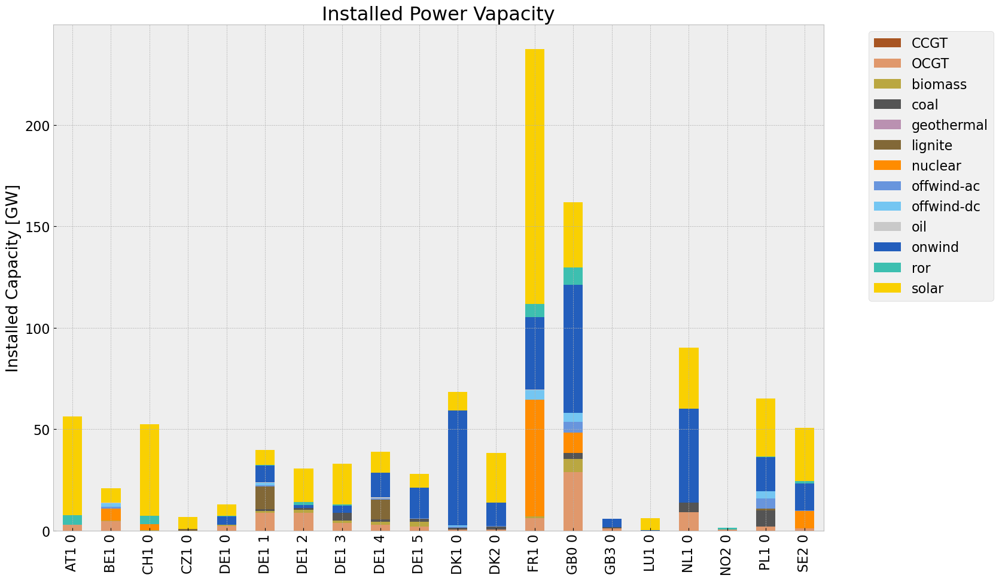

<Figure size 640x480 with 0 Axes>

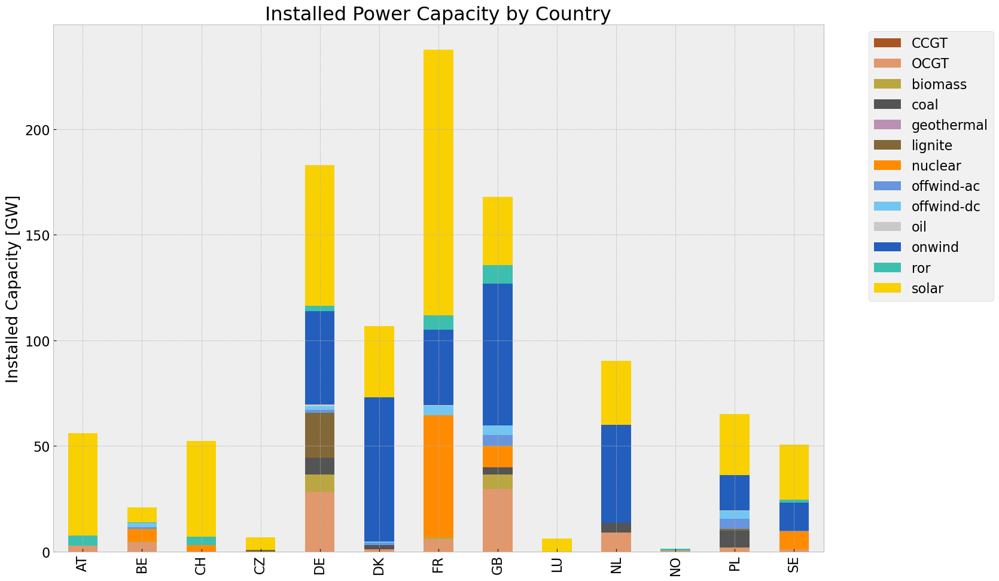

<Figure size 640x480 with 0 Axes>

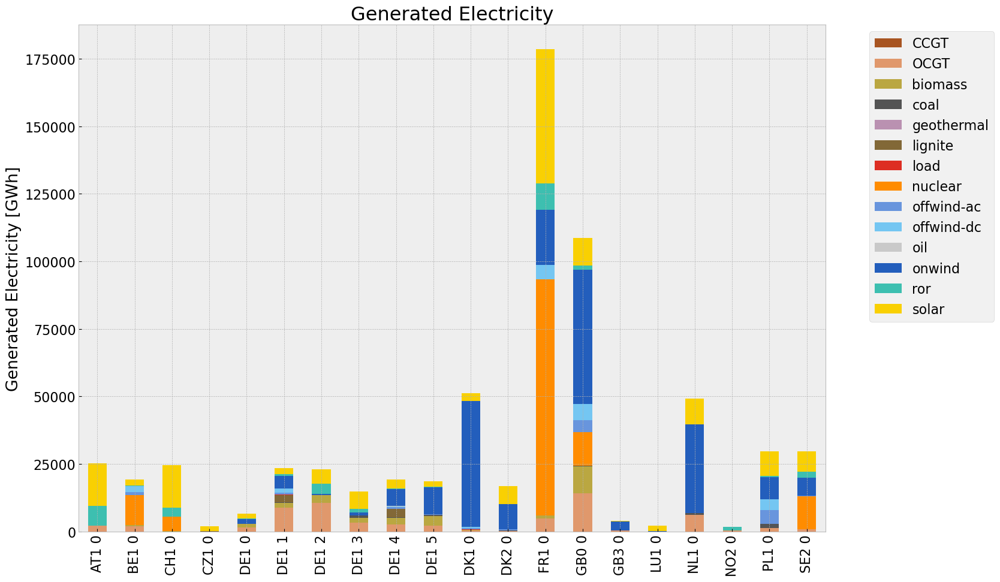

<Figure size 640x480 with 0 Axes>

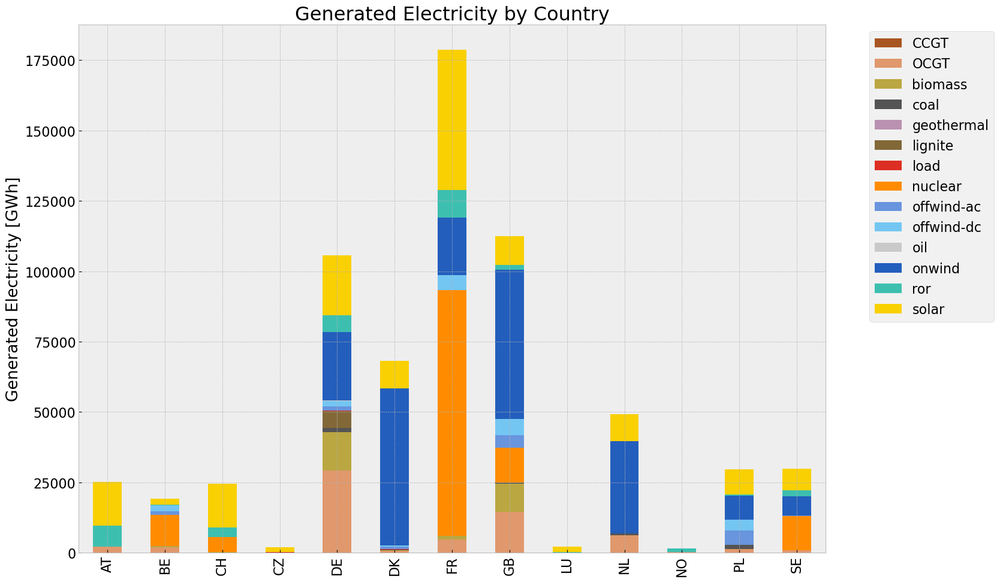

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9840\3440809909.py:23: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = p_country.groupby(n.generators.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9840\3440809909.py:40: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = sto_ctr.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9840\3440809909.py:45: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='3H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9840\3440809909.py:51: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, freq='3H')
c:\Users\Jere

,Generation in MWh,efficiency,emissions in Tonnes CO2/MWh,emissions in Tonnes CO2
carrier,,,,
CCGT,0.000000e+00,0.580000,0.1980,0.000000e+00
OCGT,6.206257e+07,0.451621,0.1980,2.720953e+07
biomass,2.550896e+07,0.468000,0.0000,0.000000e+00
coal,4.032794e+06,0.329908,0.3361,4.108484e+06
geothermal,0.000000e+00,1.000000,0.1200,0.000000e+00
lignite,6.224428e+06,0.337285,0.4069,7.509145e+06
load,6.578834e+05,1.000000,0.0000,0.000000e+00
nuclear,1.283679e+08,0.326600,0.0000,0.000000e+00
offwind-ac,1.334205e+07,1.000000,0.0000,0.000000e+00


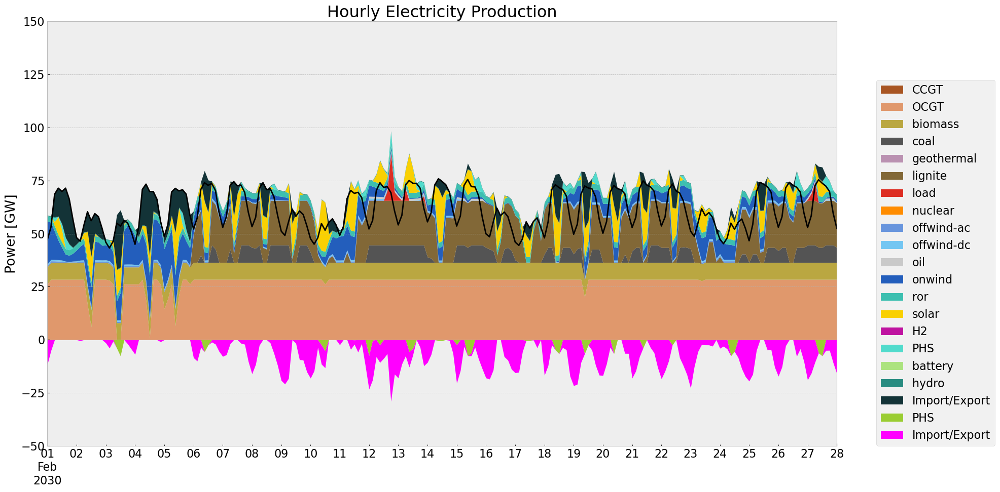

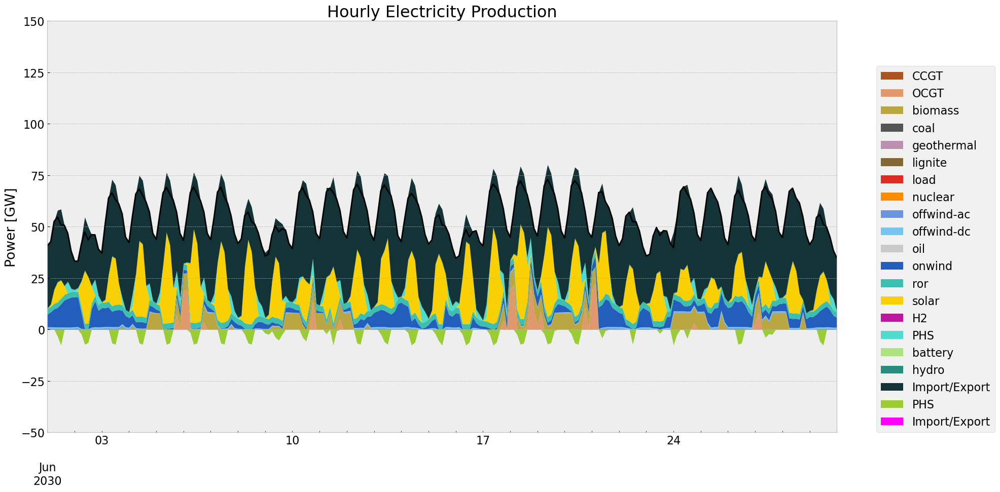

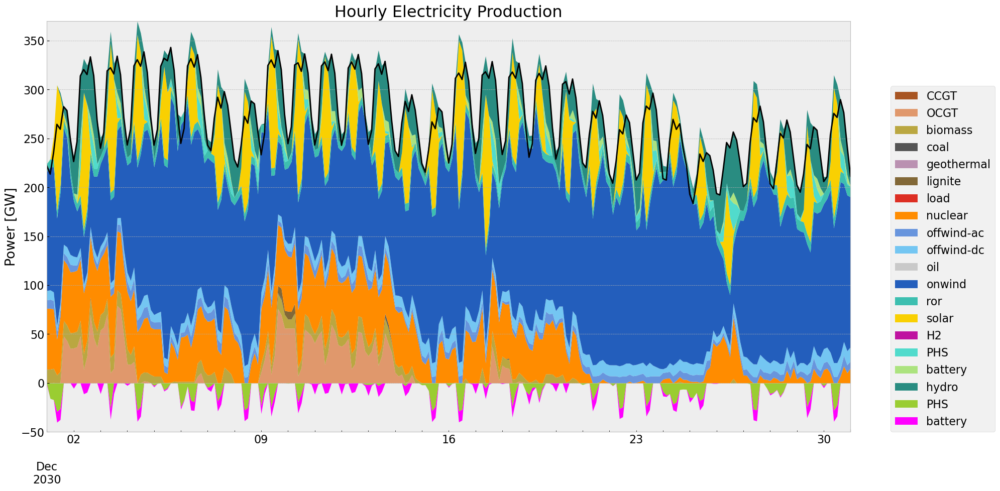

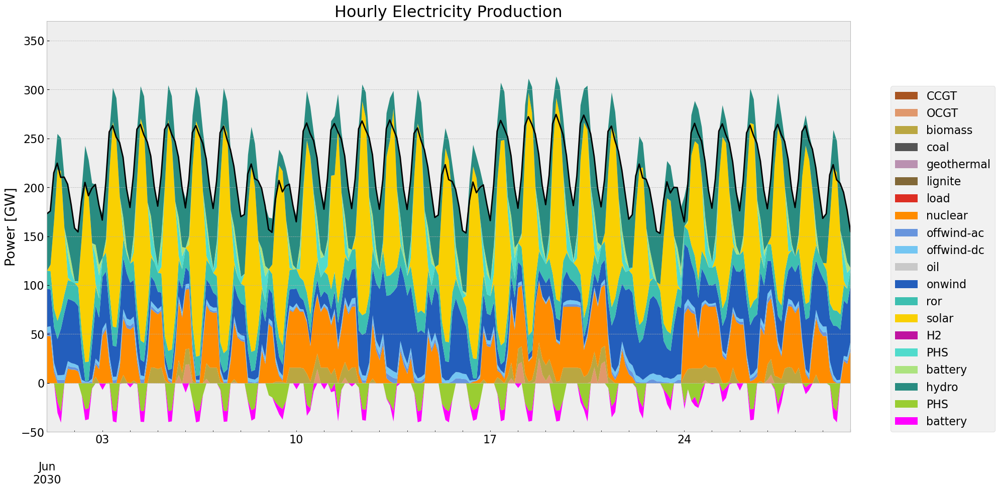

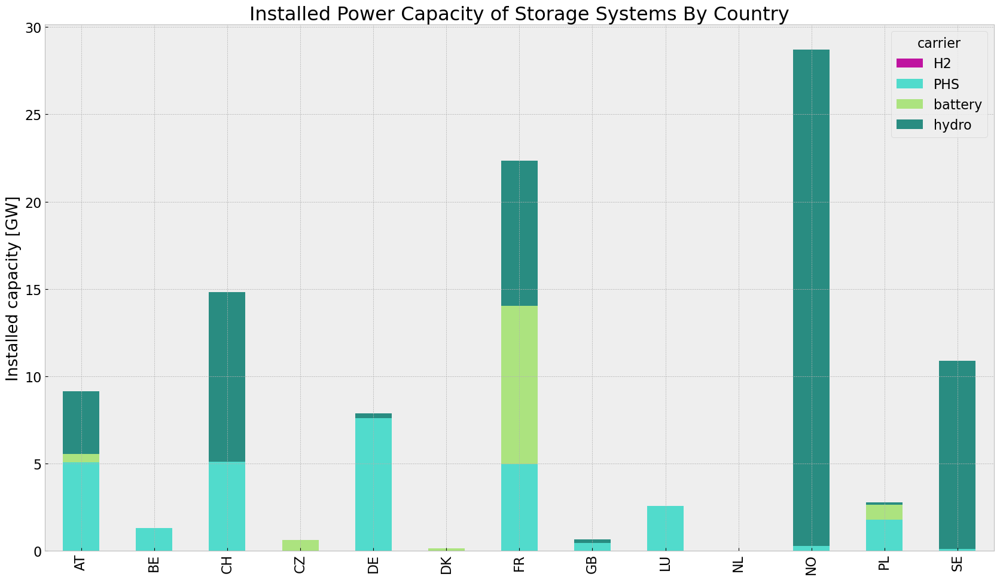

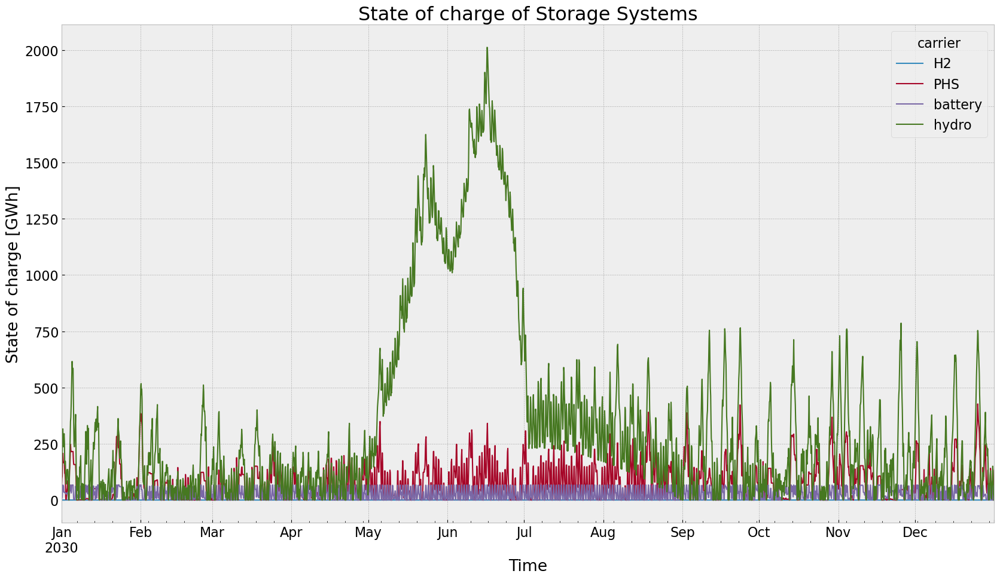

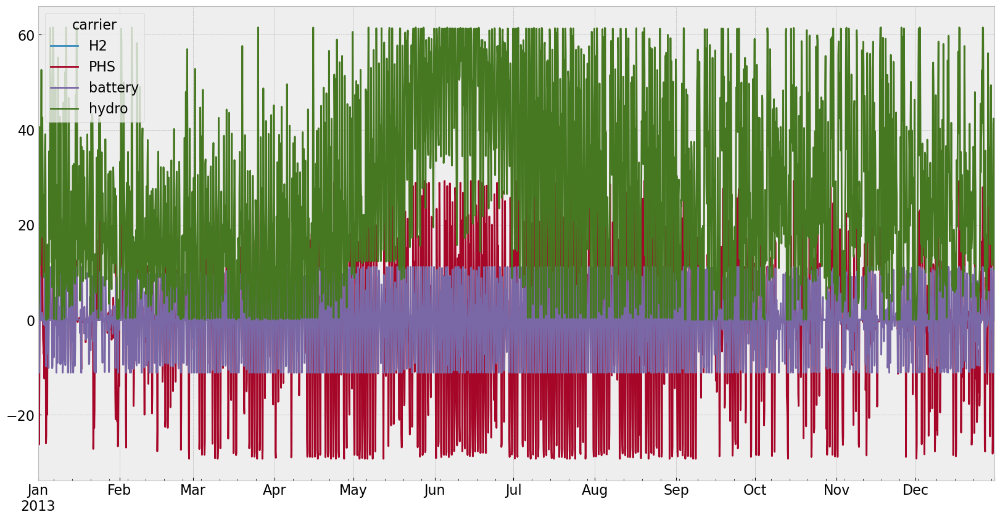

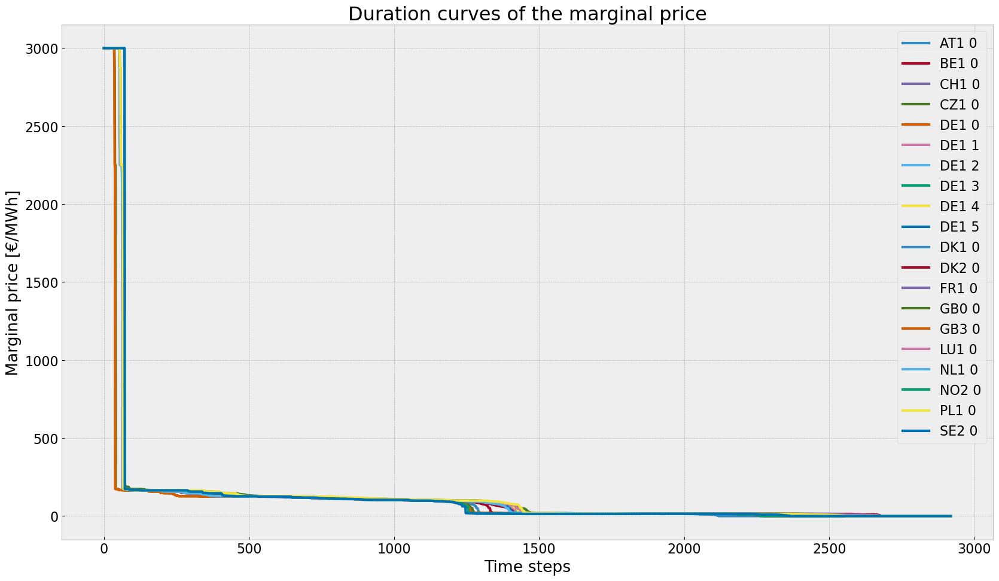

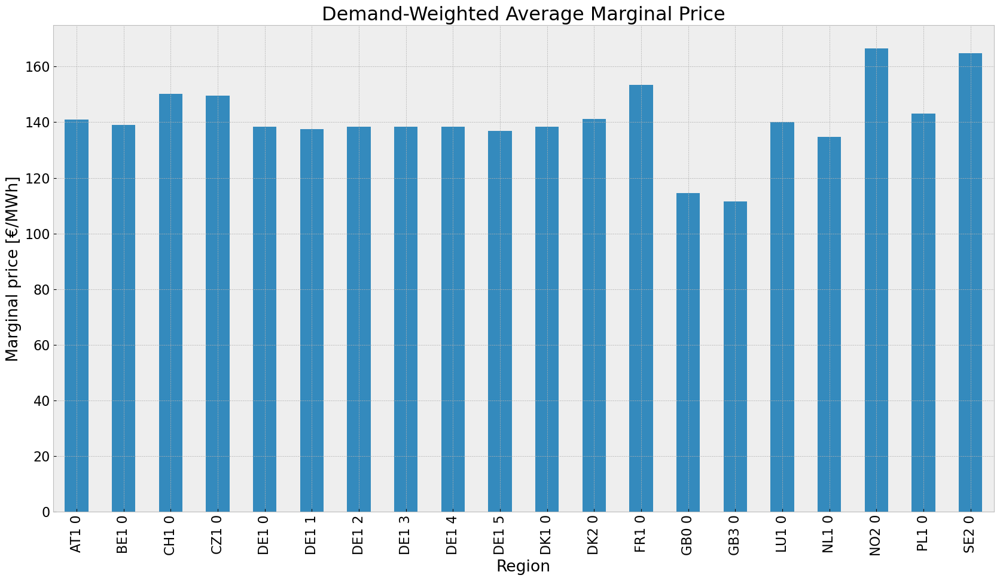

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


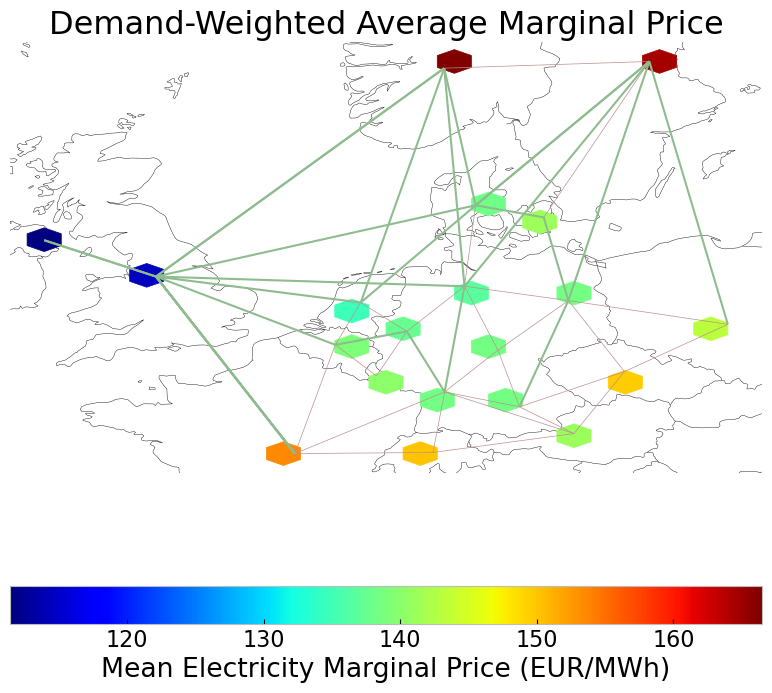

In [75]:
# Plotting
#installed cap
#capacities_noinv_roll = n3.generators.groupby(['bus', 'carrier']).p_nom_opt.sum()
#capacities_noinv_roll.fillna(0, inplace=True)
#gen = (capacities_noinv_roll.unstack()/1000).drop(columns=['load'],inplace=False)


capacities_inv_roll = inst_cap_table(n4, color_cap)
cap_inv_roll_country = inst_cap_table_country(n4, color_cap)

gen_inv_roll  = gen_power_table(n4,colors_gen_table)
gen_inv_roll_country = gen_power_table_country(n4,colors_gen_table)

#Snapshot Summer and Winter
#p = n3.generators_t.p.groupby(n.generators.carrier, axis=1).sum().div(1e3)
#sto = n3.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)    

gen_curve(n4, '2030-02-01', '2030-02-28', colors_gen,'DE')
gen_curve(n4, '2030-06-01', '2030-06-30', colors_gen,'DE')
#generation curve all countries
#winter
gen_curve_tot(n4, '2030-12-01', '2030-12-31', colors_gen)
#summer
gen_curve_tot(n4, '2030-06-01', '2030-06-30', colors_gen)

#installed storage unit & stores
store_inv_roll = inst_store_table(n4)

#State of Charge Storage unit
state_of_charge_plot(n4)
n4.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3).loc[pd.date_range(start="2013-01-01", end="2013-12-31",freq='3H')].plot(figsize=(20,10))


#Electricitty Price duration curve
price_dur_curve_plot(n4)

#avg electricity price
price_regions_table(n4)
price_regions(n4)

#Emission
em_inv_roll =em_table(n4)
em_inv_roll

In [76]:
#e_balance = n3.statistics.energy_balance(aggregate_time=False, aggregate_bus=False).loc[:, :, "AC", :]
#e_balance.head()
#e_balance.to_csv('energy_balance_DE_offwind.csv', sep=',', index=True, header=True, encoding='utf-8')

# Scenario Analysis

## Installed Capacity

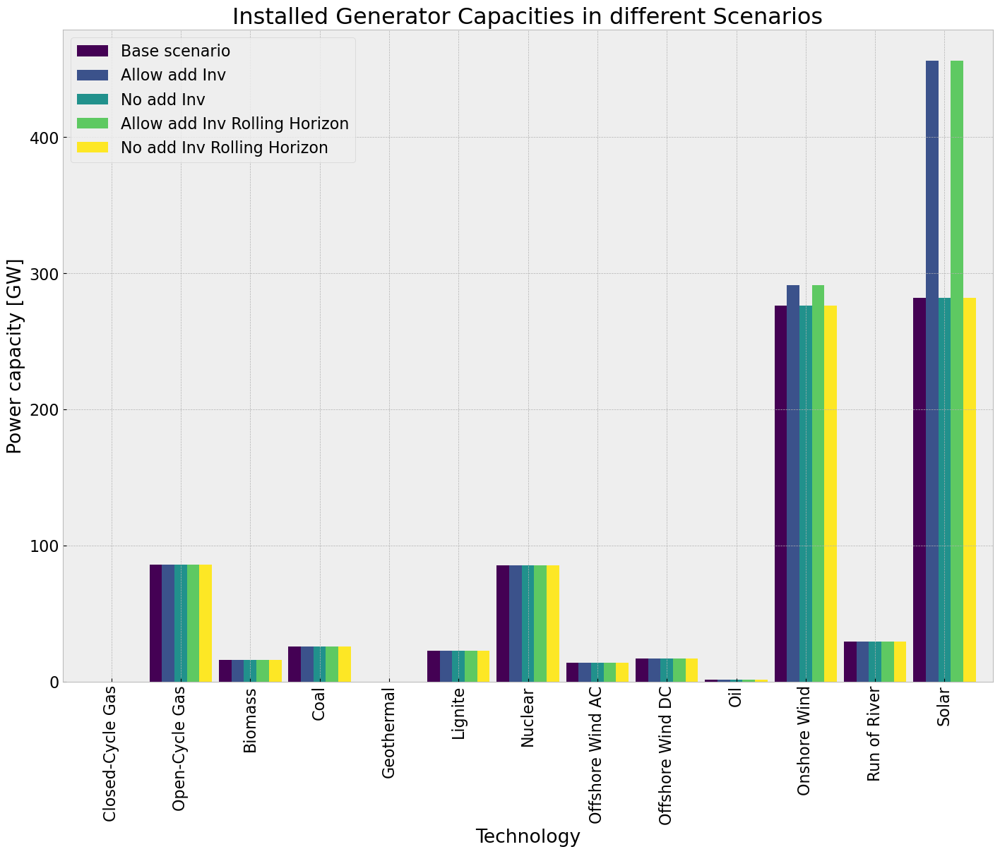

In [77]:
comp_inst_cap = pd.DataFrame(index=capacities_base.unstack().drop(columns=['load'],inplace=False).columns)

comp_inst_cap["Base scenario"] = capacities_base.groupby("carrier").sum().div(1e3).drop(index="load")
comp_inst_cap["Allow add Inv"] = capacities_inv.groupby("carrier").sum().div(1e3).drop(index="load")
comp_inst_cap["No add Inv"] = capacities_noinv.groupby("carrier").sum().div(1e3).drop(index="load")
comp_inst_cap["Allow add Inv Rolling Horizon"] = capacities_inv_roll.groupby("carrier").sum().div(1e3).drop(index="load")
comp_inst_cap["No add Inv Rolling Horizon"] = capacities_noinv_roll.groupby("carrier").sum().div(1e3).drop(index="load")

comp_inst_cap.rename(index = {"coal": "Coal"}, inplace=True)
comp_inst_cap.rename(index = {"OCGT": "Open-Cycle Gas"}, inplace=True)
comp_inst_cap.rename(index = {"CCGT": "Closed-Cycle Gas"}, inplace=True)
comp_inst_cap.rename(index = {"ror": "Run of River"}, inplace=True)
comp_inst_cap.rename(index = {"offwind-ac": "Offshore Wind AC"}, inplace=True)
comp_inst_cap.rename(index = {"offwind-dc": "Offshore Wind DC"}, inplace=True)
comp_inst_cap.rename(index = {"onwind": "Onshore Wind"}, inplace=True)
comp_inst_cap.rename(index = {"solar": "Solar"}, inplace=True)
comp_inst_cap.rename(index = {"oil": "Oil"}, inplace=True)
comp_inst_cap.rename(index = {"geothermal": "Geothermal"}, inplace=True)
comp_inst_cap.rename(index = {"nuclear": "Nuclear"}, inplace=True)
comp_inst_cap.rename(index = {"biomass": "Biomass"}, inplace=True)
comp_inst_cap.rename(index = {"lignite": "Lignite"}, inplace=True)

comp_inst_cap.fillna(0, inplace=True)

comp_inst_cap.plot.bar(figsize=(17,12),
                        color=cm.viridis(np.linspace(0, 1, len(comp_inst_cap.columns))),
                        grid=True,
                        xlabel="Technology",
                        ylabel="Power capacity [GW]",
                        title=f"Installed Generator Capacities in different Scenarios",
                        #ylim=[0,350],
                        width=0.9
)
plt.show()

### Analysis of extendable Generators

Extendable Generators: OCGT, Offshore Wind AC and DC, Onshore Wind, Solar

{'AC': '#70af1d', 'DC': '#8a1caf', 'biomass': '#baa741', 'coal': '#545454', 'lignite': '#826837', 'oil': '#c9c9c9', 'onwind': '#235ebc', 'nuclear': '#ff8c00', 'offwind-dc': '#74c6f2', 'offwind-ac': '#6895dd', 'OCGT': '#e0986c', 'CCGT': '#a85522', 'geothermal': '#ba91b1', 'solar': '#f9d002', 'hydro': '#298c81', 'PHS': '#51dbcc', 'ror': '#3dbfb0', '': '', 'battery': '#ace37f', 'H2': '#bf13a0', 'load': '#dd2e23'}


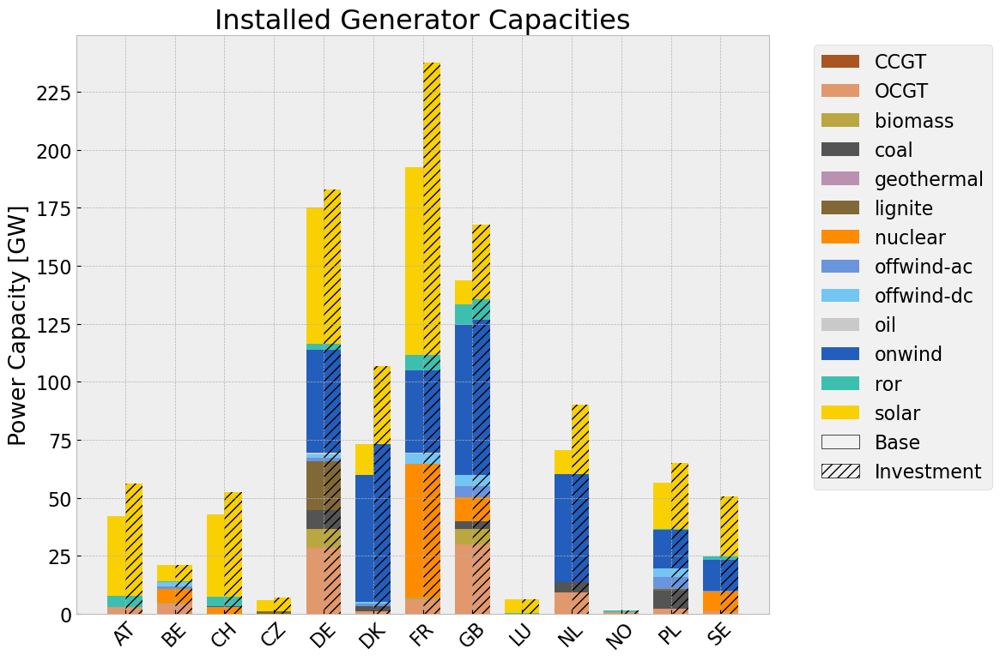

In [108]:
from matplotlib.patches import Patch

color_map = {row.name: row['color'] for _, row in n.carriers.iterrows()}
print(color_map)

base = cap_base_country
base.fillna(0, inplace=True)
inv = cap_inv_country
inv.fillna(0, inplace=True)

# Color mapping for generator types
color_map = {row.name: row['color'] for _, row in n.carriers.iterrows()}

# Setting up bar plot parameters
bar_width = 0.35
indices = np.arange(len(base.index))
base_indices = indices - bar_width / 2  # Shift slightly to the left
inv_indices = indices + bar_width / 2  # Shift slightly to the right

# Plot configuration
fig, ax = plt.subplots(figsize=(12, 8))

# Helper function to plot stacked bars with consistent colors
def plot_stack(ax, index, data, width, label_prefix, hatch_pattern):
    """Helper function to plot stacked bars."""
    bottom = np.zeros(len(index))
    for generator in data.columns:
        color = color_map.get(generator, "#7f7f7f")  # Default to grey if not specified
        ax.bar(index, data[generator], width, bottom=bottom, label=f'{generator}' if index is base_indices else "", color=color, hatch=hatch_pattern)
        bottom += data[generator]

# Plot the base DataFrame (no hatching)
plot_stack(ax, base_indices, base, bar_width, 'Base', '')

# Plot the inv DataFrame (with hatching)
plot_stack(ax, inv_indices, inv, bar_width, 'Inv', '///')

# Create custom legend entries for base and inv
custom_legend = [
    Patch(facecolor='none', edgecolor='black', label='Base', hatch=''),
    Patch(facecolor='none', edgecolor='black', label='Investment', hatch='///')
]

# Combine generator-specific legend entries with custom entries for base/inv
handles = ax.get_legend_handles_labels()[0] + custom_legend

# Add legend outside the chart to the right
ax.legend(handles=handles, bbox_to_anchor=(1.05, 1), loc='upper left')

# Adjust tick labels and grid
ax.set_title('Installed Generator Capacities')
ax.set_xticks(indices)
ax.set_xticklabels(base.index, rotation=45)

# Set the yticks
yticks = np.arange(0, inv.sum(axis=1).max() + 10, 25)
ax.set_yticks(yticks)


ax.set_ylabel('Power Capacity [GW]')
ax.grid(axis='y', linestyle='--', linewidth=0.5)

# Display the plot
plt.tight_layout()

# Save plot to the current working directory
filename = "analysis_cap_base_vs_inv_wind.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)


plt.show()

In [103]:
inv.sum(axis=1).max()

237.437205072785

## Power Generation

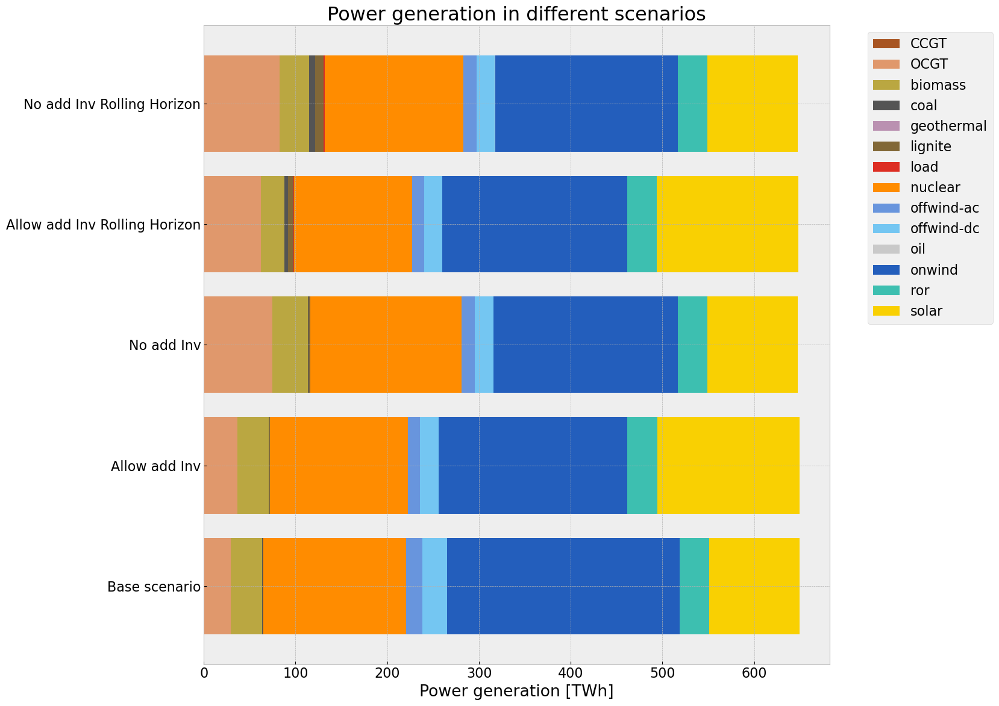

In [79]:
comp_gen_electr = pd.DataFrame(index = ["Base scenario", "Allow add Inv", "No add Inv", "Allow add Inv Rolling Horizon","No add Inv Rolling Horizon"],
                                columns = tech_list_gen_table)

comp_gen_electr.loc["Base scenario"] = gen_base.sum().div(1e3) # TWh/a
comp_gen_electr.loc["Allow add Inv"] = gen_inv.sum().div(1e3) # TWh/a
comp_gen_electr.loc["No add Inv"] = gen_noinv.sum().div(1e3) # TWh/a
comp_gen_electr.loc["Allow add Inv Rolling Horizon"] = gen_inv_roll.sum().div(1e3) # TWh/a
comp_gen_electr.loc["No add Inv Rolling Horizon"] = gen_noinv_roll.sum().div(1e3) # TWh/a



#comp_gen_electr.rename(columns = {"coal": "Coal"}, inplace=True)
#comp_gen_electr.rename(columns = {"gas": "Gas"}, inplace=True)
#comp_gen_electr.rename(columns = {"hydro": "Hydro"}, inplace=True)
#comp_gen_electr.rename(columns = {"offwind": "Offshore Wind"}, inplace=True)
#comp_gen_electr.rename(columns = {"onwind": "Onshore Wind"}, inplace=True)
#comp_gen_electr.rename(columns = {"solar": "Solar"}, inplace=True)
#comp_gen_electr.rename(columns = {"oil": "Oil"}, inplace=True)
#comp_gen_electr.rename(columns = {"geothermal": "Geothermal"}, inplace=True)
#comp_gen_electr.rename(columns = {"nuclear": "Nuclear"}, inplace=True)

comp_gen_electr.fillna(0, inplace=True)
comp_gen_electr.plot.barh(figsize=(17,12),
                        color=colors_gen_table,
                        grid=True,
                        stacked=True, 
                        ylabel="",
                        xlabel="Power generation [TWh]",
                        title=f"Power generation in different scenarios",
                        #xlim=[0,200],
                        width=0.8
)
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()

# Save plot to the current working directory
filename = "analysis_generation_wind.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)

plt.show()

## Installed Storage Capacities

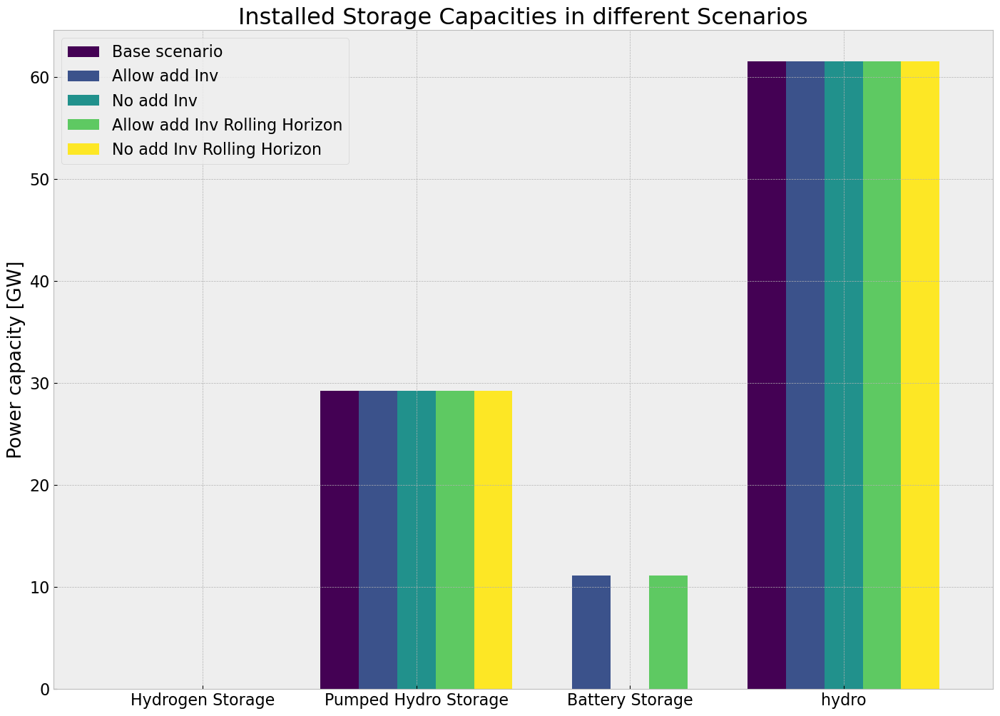

In [80]:
comp_inst_store = pd.DataFrame(index=store_base.unstack().columns)
comp_inst_store.index.name = ''

comp_inst_store["Base scenario"] = store_base.groupby("carrier").sum()
comp_inst_store["Allow add Inv"] = store_inv.groupby("carrier").sum()
comp_inst_store["No add Inv"] = store_noinv.groupby("carrier").sum()
comp_inst_store["Allow add Inv"] = store_inv_roll.groupby("carrier").sum()
comp_inst_store["Allow add Inv Rolling Horizon"] = store_inv_roll.groupby("carrier").sum()
comp_inst_store["No add Inv Rolling Horizon"] = store_noinv_roll.groupby("carrier").sum()

comp_inst_store.rename(index = {"battery": "Battery Storage"}, inplace=True)
comp_inst_store.rename(index = {"H2": "Hydrogen Storage"}, inplace=True)
comp_inst_store.rename(index = {"Hydro": "Reservoir & Dam"}, inplace=True)
comp_inst_store.rename(index = {"PHS": "Pumped Hydro Storage"}, inplace=True)


comp_inst_store.fillna(0, inplace=True)

comp_inst_store.plot.bar(figsize=(17,12),
                        color=cm.viridis(np.linspace(0, 1, len(comp_inst_store.columns))),
                        grid=True,
                        #xlabel="Technology",
                        ylabel="Power capacity [GW]",
                        title=f"Installed Storage Capacities in different Scenarios",
                        #ylim=[0,350],
                        width=0.9
)
plt.xticks(rotation=360, ha='center')
fig.tight_layout()
# Save plot to the current working directory
filename = "analysis_installed_cap_offwind.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)

plt.show()

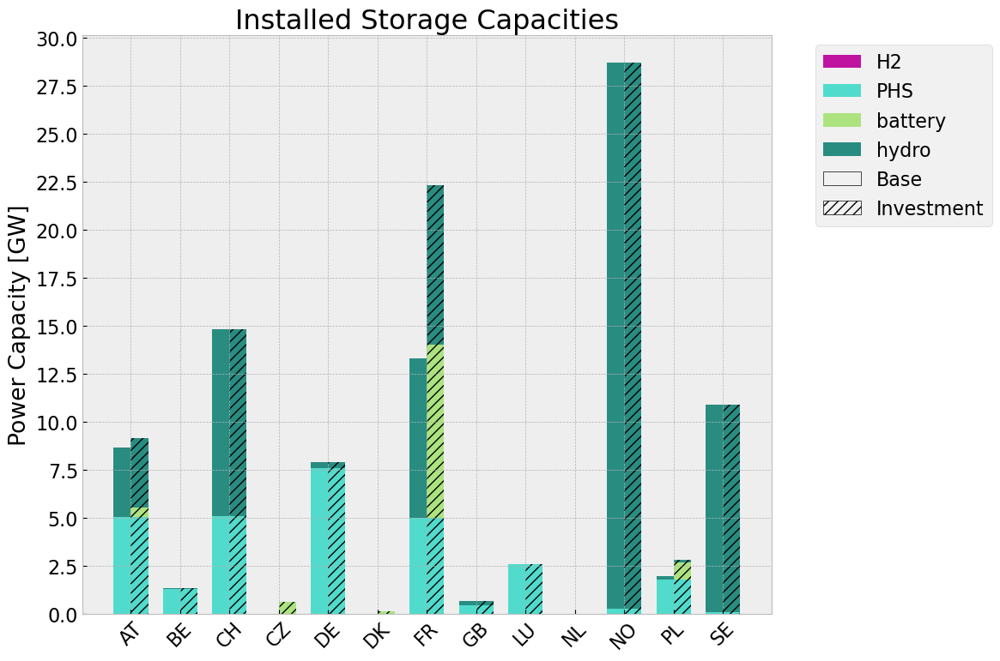

In [110]:
store_base_df = store_base.unstack()
store_inv_df = store_inv.unstack()

store_base_df.fillna(0, inplace=True)
store_inv_df.fillna(0, inplace=True)

# Setting up bar plot parameters
bar_width = 0.35
indices = np.arange(len(store_base_df.index))
base_indices = indices - bar_width / 2  # Shift slightly to the left
inv_indices = indices + bar_width / 2  # Shift slightly to the right

# Plot configuration
fig, ax = plt.subplots(figsize=(12, 8))

# Helper function to plot stacked bars with consistent colors
def plot_stack(ax, index, data, width, label_prefix, hatch_pattern):
    """Helper function to plot stacked bars."""
    bottom = np.zeros(len(index))
    for generator in data.columns:
        color = color_map.get(generator, "#7f7f7f")  # Default to grey if not specified
        ax.bar(index, data[generator], width, bottom=bottom, label=f'{generator}' if index is base_indices else "", color=color, hatch=hatch_pattern)
        bottom += data[generator]

# Plot the base DataFrame (no hatching)
plot_stack(ax, base_indices, store_base_df, bar_width, 'Base', '')

# Plot the inv DataFrame (with hatching)
plot_stack(ax, inv_indices, store_inv_df, bar_width, 'Inv', '///')

# Create custom legend entries for base and inv
custom_legend = [
    Patch(facecolor='none', edgecolor='black', label='Base', hatch=''),
    Patch(facecolor='none', edgecolor='black', label='Investment', hatch='///')
]

# Combine generator-specific legend entries with custom entries for base/inv
handles = ax.get_legend_handles_labels()[0] + custom_legend

# Add legend outside the chart to the right
ax.legend(handles=handles, bbox_to_anchor=(1.05, 1), loc='upper left')

# Set the yticks
yticks = np.arange(0, store_inv_df.sum(axis=1).max() + 2.5, 2.5)
ax.set_yticks(yticks)

# Adjust tick labels and grid
ax.set_title('Installed Storage Capacities')
ax.set_xticks(indices)
ax.set_xticklabels(base.index, rotation=45)
ax.set_ylabel('Power Capacity [GW]')
ax.grid(axis='y', linestyle='--', linewidth=0.5)

# Display the plot
fig.tight_layout()

# Save plot to the current working directory
filename = "analyis_storagecap_base_vs_inv_offwind.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)
plt.show()


## System Cost

In [82]:
tech_comp = system_cost_base.index.tolist()
comp_system_cost = pd.DataFrame(index = ["Base scenario", "Allow add Inv", "No add Inv", "Allow add Inv Rolling Horizon","No add Inv Rolling Horizon"],
                                columns =tech_comp)

#demand = n.snapshot_weightings.generators @ n.loads_t.p_set.sum(axis=1) # the same in each scenario

comp_system_cost.loc["Base scenario"] = system_cost_base # Million €/a
comp_system_cost.loc["Allow add Inv"] = system_cost_inv # Million €/a
#if tot_cost_0_PV > 0: 
#    comp_system_cost.loc["0% PV potential"] = system_cost_0_PV # Million €/a
#else: comp_system_cost.loc["0% PV potential"] = 0.0
#if tot_cost_20_PV > 0: 
#    comp_system_cost.loc["20% PV potential"] = system_cost_20_PV # Million €/a
#else: comp_system_cost.loc["20% PV potential"] = 0.0
comp_system_cost.loc["No add Inv"] = system_cost_noinv # Million €/a
comp_system_cost.loc["Allow add Inv Rolling Horizon"] = system_cost_inv_roll
comp_system_cost.loc["No add Inv Rolling Horizon"] = system_cost_noinv_roll # Million €/a

#if 'AC' in system_cost_base:
#   comp_system_cost.AC = comp_system_cost.AC-system_cost_base.AC # expenditure for already existing transmission lines

#comp_system_cost[comp_system_cost<0] = 0 # since we subtact the AC cost (for the 0% or 20%) 
comp_system_cost.drop('-', axis=1, inplace=True)
#comp_system_cost.iloc[0,0] = system_cost_base.AC


#comp_system_cost = comp_system_cost   #Million eur0/

#comp_system_cost.rename(columns = {"battery storage": "Battery storage"}, inplace=True)
#comp_system_cost.rename(columns = {"hydrogen storage underground": "Hydrogen storage underground"}, inplace=True)

comp_system_cost.fillna(0, inplace=True)
comp_system_cost = comp_system_cost.div(1e3) # Billion €

#move load shedding to the last col
# Specify the column name to move
column_to_move = 'Load shedding'

# Create a new list of column names without the column to move
new_columns = [col for col in comp_system_cost.columns if col != column_to_move]

# Append the column to move to the end
new_columns.append(column_to_move)

# Reorder the columns
comp_system_cost = comp_system_cost[new_columns]


C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9840\1748840201.py:5: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  if comp_system_cost.columns[i] == n.carriers.nice_name[j]:
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9840\1748840201.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  colors_comp.append(n.carriers.color[j])


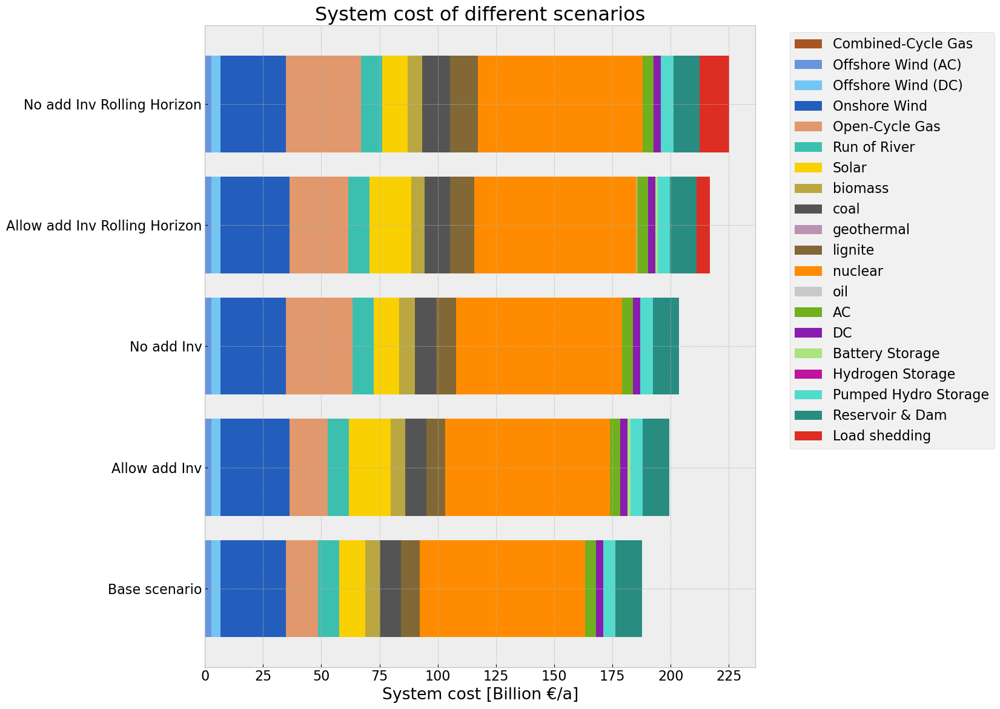

In [118]:
colors_comp = []

for i in range(len(comp_system_cost.columns)):
    for j in range(len(n.carriers.nice_name)):
        if comp_system_cost.columns[i] == n.carriers.nice_name[j]:
            colors_comp.append(n.carriers.color[j])
            #print(n.carriers.nice_name[j],comp_system_cost.columns[i],n.carriers.color[j])
            break  # break the inner loop once a match is found  



ax = comp_system_cost.plot.barh(figsize=(17,12),
                        color=colors_comp,
                        grid=True,
                        stacked=True,
                        ylabel="",
                        xlabel="System cost [Billion €/a]",
                        title=f"System cost of different scenarios",
                        #xlim=[0,100],
                        width=0.8
)
# Move legend outside of the plot
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()

# Set the xticks
xticks = np.arange(0, comp_system_cost.sum(axis = 1).max() + 10, 25)
ax.set_xticks(xticks)

# Save plot to the current working directory
filename = "analysis_system_cost_offwind.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)

plt.show()

## Curtailment

In [85]:
comp_curtailment = pd.DataFrame(index = ["Base scenario", "Allow add Inv", "No add Inv", "Allow add Inv Rolling Horizon","No add Inv Rolling Horizon"],
                                columns = stat_base.loc["Generator"].index)

comp_curtailment.loc["Base scenario"] = stat_base.loc["Generator"].Curtailment.div(1e6) # TWh
comp_curtailment.loc["Allow add Inv"] = stat_inv.loc["Generator"].Curtailment.div(1e6) # TWh
comp_curtailment.loc["No add Inv"] = stat_noinv.loc["Generator"].Curtailment.div(1e6) # TWh
comp_curtailment.loc["Allow add Inv Rolling Horizon"] = stat_inv_roll.loc["Generator"].Curtailment.div(1e6) # TWh
comp_curtailment.loc["No add Inv Rolling Horizon"] = stat_noinv_roll.loc["Generator"].Curtailment.div(1e6) # TWh

comp_curtailment.fillna(0, inplace=True)

In [86]:
color_curtailment=[]

for i in range(len(comp_curtailment.columns)):
    for j in range(len(n.carriers.nice_name)):
        if comp_curtailment.columns[i] == n.carriers.nice_name[j]:
            color_curtailment.append(n.carriers.color[j])
            #print(n.carriers.nice_name[j],comp_system_cost.columns[i],n.carriers.color[j])
            break  # break the inner loop once a match is found 

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9840\3109801822.py:5: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  if comp_curtailment.columns[i] == n.carriers.nice_name[j]:
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9840\3109801822.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  color_curtailment.append(n.carriers.color[j])


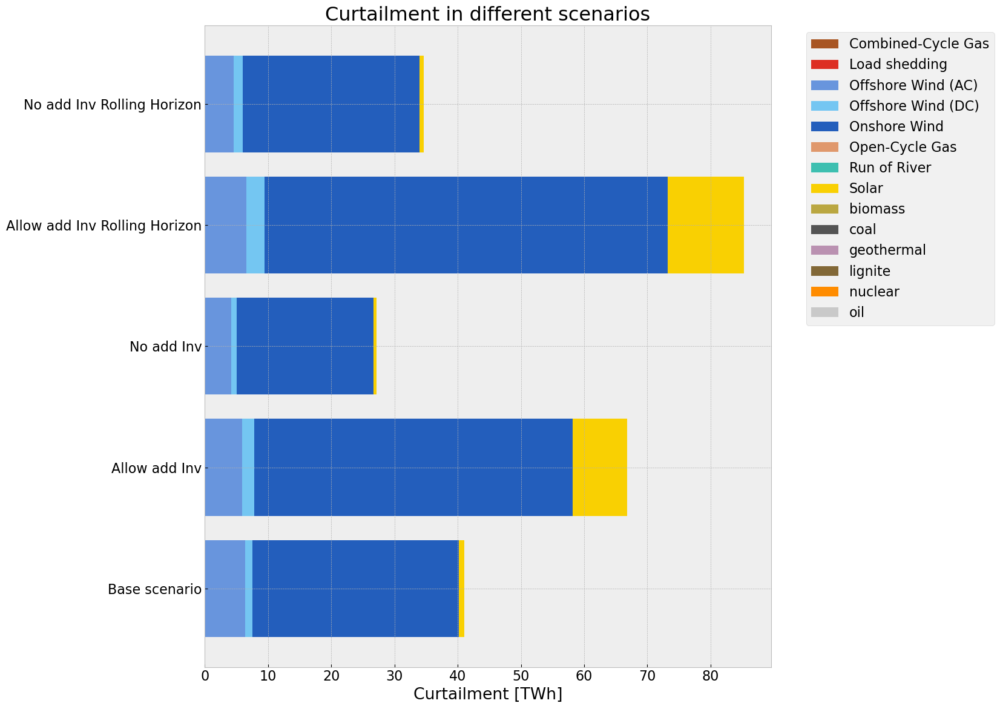

In [87]:
comp_curtailment.plot.barh(figsize=(17,12),
                        color=color_curtailment,
                        grid=True,
                        stacked=True, 
                        ylabel="",
                        xlabel="Curtailment [TWh]",
                        title=f"Curtailment in different scenarios",
                        #xlim=[0,120],
                        width=0.8
)
# Move legend outside of the plot
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()

# Save plot to the current working directory
filename = "analysis_curtailment_offwind.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)
plt.show()

## Emission

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9840\3124803761.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  colors_comp.append(n.carriers.color[j])


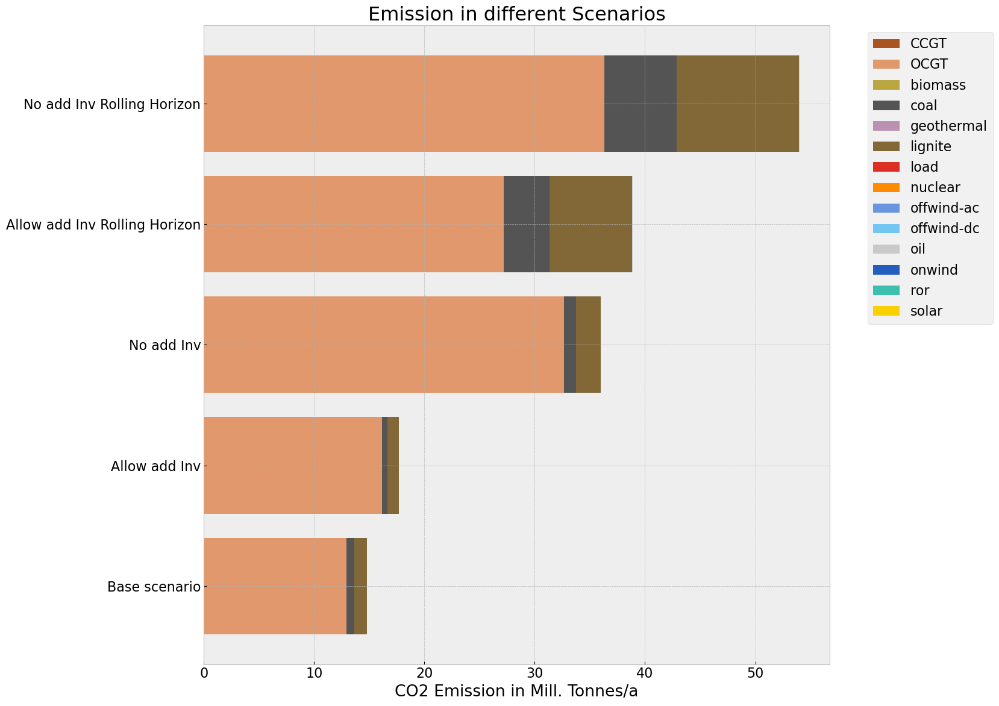

In [88]:
tech_comp = em_base.index.tolist()
comp_system_em = pd.DataFrame(index = ["Base scenario", "Allow add Inv", "No add Inv", "Allow add Inv Rolling Horizon","No add Inv Rolling Horizon"],
                                columns =tech_comp)

#demand = n.snapshot_weightings.generators @ n.loads_t.p_set.sum(axis=1) # the same in each scenario

comp_system_em.loc["Base scenario"] = em_base['emissions in Tonnes CO2']/1e6 # Mill. Tonnes CO2 /a
comp_system_em.loc["Allow add Inv"] = em_inv['emissions in Tonnes CO2'] /1e6 # Mill. Tonnes CO2 /a
comp_system_em.loc["No add Inv"] = em_noinv['emissions in Tonnes CO2'] /1e6 # Mill. Tonnes CO2 /a
comp_system_em.loc["Allow add Inv Rolling Horizon"] = em_inv_roll['emissions in Tonnes CO2'] /1e6 # Mill. Tonnes CO2 /a
comp_system_em.loc["No add Inv Rolling Horizon"] = em_noinv_roll['emissions in Tonnes CO2'] /1e6 # Mill. Tonnes CO2 /a

comp_system_em.fillna(0, inplace=True)

colors_comp = []

for i in range(len(comp_system_em.columns)):
    for j in range(len(n.carriers.index)):
        if comp_system_em.columns[i] == n.carriers.index[j]:
            colors_comp.append(n.carriers.color[j])
            #print(n.carriers.nice_name[j],comp_system_cost.columns[i],n.carriers.color[j])
            break  # break the inner loop once a match is found  



comp_system_em.plot.barh(figsize=(17,12),
                        color=colors_comp,
                        grid=True,
                        stacked=True,
                        ylabel="",
                        xlabel="CO2 Emission in Mill. Tonnes/a",
                        title=f"Emission in different Scenarios",
                        #xlim=[0,100],
                        width=0.8
)
#global_constraint
#plt.axvline(x=n.global_constraints.loc['CO2Limit','constant']/1e6, color='r', linestyle='-', linewidth=2, label='CO2 cap')
# Move legend outside of the plot
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()

# Save plot to the current working directory
filename = "analysis_emission_offwind.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)
plt.show()

## Transmission Lines

In [89]:
models = [n, n1]

In [90]:
for m in models:
    ac_df = m.lines
    ac_df['country'] = ac_df['bus0'].str[:2]
    ac_df = ac_df.groupby(['country', 'carrier']).s_nom_opt.sum()
    ac_df.fillna(0, inplace=True)
    ac_df = ac_df.unstack().div(1e3) #GVA
            
    #DC
    dc_df = m.links
    dc_df['country'] = dc_df['bus0'].str[:2]
    dc_df = dc_df.groupby(['country', 'carrier']).p_nom_opt.sum()
    dc_df.fillna(0, inplace=True)
    dc_df = dc_df.unstack().div(1e3) #GW

    #join
    trans_df = pd.concat([ac_df, dc_df], axis=1)
    trans_df.fillna(0, inplace=True)
    globals()[f'trans_{m.name}'] = trans_df

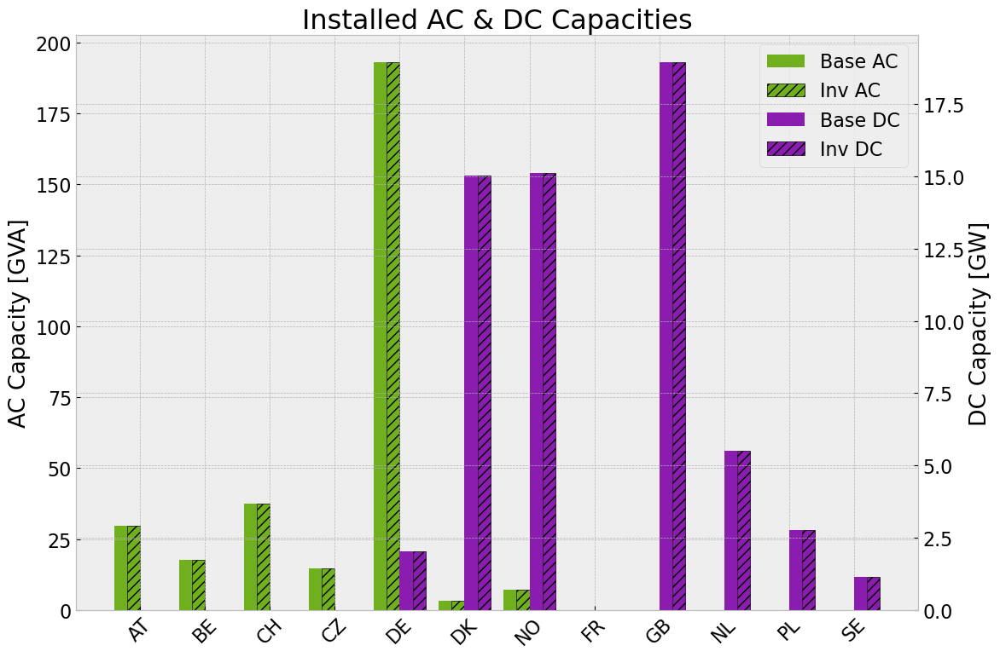

In [92]:
# Setting up bar plot parameters
bar_width = 0.2
indices = np.arange(len(trans_base_wind.index))
base_ac_indices = indices - bar_width * 1.5  # Shift slightly to the left
inv_ac_indices = indices - bar_width * 0.5  # Shift slightly to the right
base_dc_indices = indices + bar_width * 0.5
inv_dc_indices = indices + bar_width * 1.5

# Plot configuration
fig, ax = plt.subplots(figsize=(12, 8))

# Create secondary axis
ax2 = ax.twinx()

# Plot the base DataFrame (no hatching)
ax.bar(base_ac_indices, trans_base_wind.AC, bar_width, color = n.carriers.loc['AC','color'], label='Base AC')
ax2.bar(base_dc_indices, trans_base_wind.DC, bar_width, color = n.carriers.loc['DC','color'], label='Base DC')

# Plot the inv DataFrame (with hatching)
ax.bar(inv_ac_indices, trans_inv_wind.AC, bar_width, label='Inv AC', edgecolor = 'black', color = n.carriers.loc['AC','color'], hatch='///')
ax2.bar(inv_dc_indices, trans_inv_wind.DC, bar_width, label='Inv DC', edgecolor = 'black', color = n.carriers.loc['DC','color'], hatch='///')


# Create custom legend entries for base and inv
custom_legend = [
    Patch(facecolor='none', edgecolor='black', label='Base', hatch=''),
    Patch(facecolor='none', edgecolor='black', label='Investment', hatch='///')
]

# Combine generator-specific legend entries with custom entries for base/inv
handles = ax.get_legend_handles_labels()[0] + ax2.get_legend_handles_labels()[0]

# Add legend outside the chart to the right
ax.legend(handles=handles, bbox_to_anchor=(0.8, 1), loc='upper left')

# Adjust tick labels and grid
ax.set_title('Installed AC & DC Capacities')
ax.set_xticks(indices)
ax.set_xticklabels(trans_base_wind.index, rotation=45)
ax.set_ylabel('AC Capacity [GVA]')
ax2.set_ylabel('DC Capacity [GW]')
ax.grid(axis='y', linestyle='--', linewidth=0.5)

# Display the plot
fig.tight_layout()

# Save plot to the current working directory
filename = "analyis_trans_cap_base_vs_inv.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)
plt.show()

## Sensitivity Analysis

In [93]:
sens_reductionto = [0.25, reductionto, 0.75]

sens_duration = [
    int(duration-(0.5*duration)),
    duration,
    int(duration+(0.5*duration)) 
]

In [94]:
def sanitize_variable_name(name):
    """
    Sanitize a string to be used as a valid Python variable name.

    Args:
    name (str): The name to sanitize.

    Returns:
    str: A sanitized name.
    """
    return name.replace('.', '_')

In [96]:
# Assuming sens_reductionto and sens_duration are defined and iterable
for red in sens_reductionto:
    for dur in sens_duration:
        name = f'n_{red}_{dur}'

        # Skip iteration if both conditions are met
        if red == reductionto and dur == duration:
            continue

        # Sanitize the names to be valid Python variable names
        red_sanitized = sanitize_variable_name(str(red))
        dur_sanitized = sanitize_variable_name(str(dur))

        # Variable names for models
        inv_model_name = f'n_{red_sanitized}_{dur_sanitized}_inv'
        inv_roll_model_name = f'n_{red_sanitized}_{dur_sanitized}_inv_roll'
        noinv_model_name = f'n_{red_sanitized}_{dur_sanitized}_noinv'
        noinv_roll_model_name = f'n_{red_sanitized}_{dur_sanitized}_noinv_roll'

        # Create inv model with perfect foresight
        globals()[inv_model_name] = windscenario(n, cut_start, dur, red)
        allow_inv(globals()[inv_model_name], n)
        globals()[inv_model_name].name = inv_model_name
        print(globals()[inv_model_name].name)

        # Solve and export
        filename = f'{globals()[inv_model_name].name}.nc'
        output_path = os.path.join(os.getcwd(), filename)
        if os.path.isfile(output_path):
            globals()[inv_model_name] = import_nc_file(output_path)
        else:
            # globals()[inv_model_name].optimize(solver_name="gurobi")
            print(f'{globals()[inv_model_name].name}.nc does not exist in current wd')
            # globals()[inv_model_name].export_to_netcdf(output_path)

        # Create inv model rolling horizon
        globals()[inv_roll_model_name] = globals()[inv_model_name].copy()
        no_inv(globals()[inv_roll_model_name], globals()[inv_model_name])
        globals()[inv_roll_model_name].storage_units['cyclic_state_of_charge'] = False
        globals()[inv_roll_model_name].storage_units['cyclic_state_of_charge_per_period'] = False
        globals()[inv_roll_model_name].name = inv_roll_model_name
        print(globals()[inv_roll_model_name].name)

        # Solve with rolling horizon and export model
        filename = f'{globals()[inv_roll_model_name].name}.nc'
        output_path = os.path.join(os.getcwd(), filename)
        if os.path.isfile(output_path):
            globals()[inv_roll_model_name] = import_nc_file(output_path)
        else:
            # optimize.optimize_with_rolling_horizon(globals()[inv_roll_model_name], horizon=horizon, overlap=0, solver_name='gurobi')
            print(f'{globals()[inv_roll_model_name].name}.nc does not exist in current wd')
            # globals()[inv_roll_model_name].export_to_netcdf(output_path)

        # Create noinv model perfect foresight
        globals()[noinv_model_name] = windscenario(n, cut_start, dur, red)
        no_inv(globals()[noinv_model_name], n)
        globals()[noinv_model_name].name = noinv_model_name
        print(globals()[noinv_model_name].name)

        # Solve and export
        filename = f'{globals()[noinv_model_name].name}.nc'
        output_path = os.path.join(os.getcwd(), filename)
        if os.path.isfile(output_path):
            globals()[noinv_model_name] = import_nc_file(output_path)
        else:
            # globals()[noinv_model_name].optimize(solver_name="gurobi")
            print(f'{globals()[noinv_model_name].name}.nc does not exist in current wd')
            # globals()[noinv_model_name].export_to_netcdf(output_path)

        # Create noinv model rolling horizon
        globals()[noinv_roll_model_name] = globals()[noinv_model_name].copy()
        globals()[noinv_roll_model_name].storage_units['cyclic_state_of_charge'] = False
        globals()[noinv_roll_model_name].storage_units['cyclic_state_of_charge_per_period'] = False
        globals()[noinv_roll_model_name].name = noinv_roll_model_name
        print(globals()[noinv_roll_model_name].name)

        # Solve with rolling horizon and export model
        filename = f'{globals()[noinv_roll_model_name].name}.nc'
        output_path = os.path.join(os.getcwd(), filename)
        if os.path.isfile(output_path):
            globals()[noinv_roll_model_name] = import_nc_file(output_path)
        else:
            # optimize.optimize_with_rolling_horizon(globals()[noinv_roll_model_name], horizon=horizon, overlap=0, solver_name='gurobi')
            print(f'{globals()[noinv_roll_model_name].name}.nc does not exist in current wd')
            # globals()[noinv_roll_model_name].export_to_netcdf(output_path)

n_0_25_90_inv
n_0_25_90_inv.nc does not exist in current wd
n_0_25_90_inv_roll
n_0_25_90_inv_roll.nc does not exist in current wd
n_0_25_90_noinv
n_0_25_90_noinv.nc does not exist in current wd
n_0_25_90_noinv_roll
n_0_25_90_noinv_roll.nc does not exist in current wd
n_0_25_180_inv
n_0_25_180_inv.nc does not exist in current wd
n_0_25_180_inv_roll
n_0_25_180_inv_roll.nc does not exist in current wd
n_0_25_180_noinv
n_0_25_180_noinv.nc does not exist in current wd
n_0_25_180_noinv_roll
n_0_25_180_noinv_roll.nc does not exist in current wd
n_0_25_270_inv
n_0_25_270_inv.nc does not exist in current wd
n_0_25_270_inv_roll
n_0_25_270_inv_roll.nc does not exist in current wd
n_0_25_270_noinv
n_0_25_270_noinv.nc does not exist in current wd
n_0_25_270_noinv_roll
n_0_25_270_noinv_roll.nc does not exist in current wd
n_0_5_90_inv
n_0_5_90_inv.nc does not exist in current wd
n_0_5_90_inv_roll
n_0_5_90_inv_roll.nc does not exist in current wd
n_0_5_90_noinv
n_0_5_90_noinv.nc does not exist in cur